# Experiments

In [1]:
# !pip2 install pypolyagamma

from __future__ import absolute_import
from __future__ import division
from __future__ import print_function

import importlib
import os
import sys

from base.experiment import *
from logistic.env_logistic import *
from logistic.agent_logistic import *
from utils import *

import numpy as np
import numpy.linalg as npla
import scipy.linalg as spla
import pandas as pd
import plotnine as gg

#import importlib
#importlib.reload(logistic.agent_logistic)
#reload(sys.modules['logistic.agent_logistic'])

# Setup

Here $d=20$ and the number of arms is $A=10$. The number of timesteps is $T=1000$.

At the beginning $\theta\sim N(0,I_d)$ and $c\sim N(0,1)$ are generated. The reward given context $x\in \mathbb R^d$ is $\text{Bernoulli}(\sigma(\theta^\top x + c))$ where $\sigma(x) = \frac{e^x}{1+e^x}$. At each step $x_{t,1},\ldots, x_{t,A}\sim N(0,I_d/9)$ are randomly generated, and the algorithm picks one of the arms $1,\ldots, A$ and gets the corresponding stochastic reward.

If the algorithm chose actions $a_t$, regret is measured as $\max_{\{a_t^*\}} \sigma(\theta^\top x_{t,a_t^*}+c) - \sum_{t=1}^T \mathbb E \sigma(\theta^\top x_{t,a_t}+c)$, i.e., expected reward  against the best choice of $a_t^*$'s if $\theta$ were known.


In [2]:
#No bias for now.

def simple_compare(agents, num_articles, dim, var, n_steps, seed=0, verbosity=0):
    env = LogisticBandit(num_articles, dim+1, NormalDist(0,1,dim=dim+1), DistributionWithConstant(NormalDist(0,var,dim=dim)), seed=seed)
    experiment = ExperimentCompare(agents, env, n_steps,
                   seed=seed, verbosity=verbosity)
    experiment.run_experiment()
    results = []
    results.append(experiment.results)
    df = pd.DataFrame(results[0])
    cum_regrets = experiment.cum_regret
    #https://stackoverflow.com/questions/39092067/pandas-dataframe-convert-column-type-to-string-or-categorical
    df['agent_id'] = df.agent_id.astype('category')
    print(gg.ggplot(df)
     + gg.aes('t', 'cum_regret', color='agent_id', group='agent_id')
     + gg.geom_point()
     + gg.geom_line())
    print(gg.ggplot(df)
     + gg.aes('t', 'time', color='agent_id', group='agent_id')
     + gg.geom_point()
     + gg.geom_line())
    return results, df, cum_regrets

def simple_compares(make_agents, num_articles, dim, var, n_steps, seeds, verbosity=0):
    results_list = []
    df_list = []
    cum_regrets_list = []
    avg_regrets = np.zeros(len(make_agents))
    for seed in seeds:
        agents = [make_agent() for make_agent in make_agents]
        results, df, cum_regrets = simple_compare(agents, num_articles, dim, var, n_steps, seed=seed, verbosity=verbosity)
        results_list += [results]
        df_list += [df]
        cum_regrets_list += [cum_regrets]
        avg_regrets += cum_regrets
    avg_regrets = avg_regrets / len(seeds)
    return results_list, df_list, cum_regrets_list, avg_regrets    

def hyperparameter_sweep(make_agent_from_hyperparameters, hyperparam_list, dim, var, n_steps, seed=0, verbosity=0):
    agents = [make_agent_from_hyperparameters(hyperparam) for hyperparam in hyperparam_list]
    results, df, cum_regrets = simple_compare(agents, num_articles, dim, var, n_steps, seed=seed, verbosity=verbosity)
    
def hyperparameter_sweeps(make_agent_from_hyperparameters, hyperparam_list, dim, var, n_steps, seeds, verbosity=0):
    results_list = []
    df_list = []
    cum_regrets_list = []
    avg_regrets = np.zeros(len(hyperparam_list))
    for seed in range(seeds):
        agents = [make_agent_from_hyperparameters(hyperparam) for hyperparam in hyperparam_list]
        results, df, cum_regrets = simple_compare(agents, num_articles, dim, var, n_steps, seed=seed, verbosity=verbosity)
        results_list += [results]
        df_list += [df]
        cum_regrets_list += [cum_regrets]
        avg_regrets += cum_regrets
    avg_regrets = avg_regrets / seeds
    return results_list, df_list, cum_regrets_list, avg_regrets


In [3]:
num_articles = 10
dim = 20
var = 1.0/9
theta_mean = 0
theta_std = 1

time_limit= 0.1

verbosity=1

In [4]:
# We will tune the Langevin, SGLD, and SAGA-LD agents.

make_langevin_agent = lambda hypers: BasicLangevinTS(num_articles, dim+1, [0]*(dim+1), cov=None, 
                                              step_size=lambda t: hypers[0]/(1 + t * np.sqrt(dim*var)/dim), n_steps=9999,
                                              time = time_limit,
                                              init_pt=None, verbosity=verbosity)
#make_mala_agent = lambda: MalaTS(num_articles, dim, [0]*dim, cov=None, step_size=step_fn, n_steps=9999,
#                                 time = time_limit,
#                                     init_pt=None, verbosity=verbosity)
make_sgld_agent = lambda hypers: SGLDTS(num_articles, dim+1, [0]*(dim+1), cov=None, 
                                        step_size=lambda t: hypers[0]/(1 + t * np.sqrt(dim*var)/dim),
                                        batch_size = hypers[1],
                                        time=time_limit,
                                        n_steps=9999,
                                        init_pt=None, verbosity=verbosity)
make_sagald_agent = lambda hypers: SAGATS(num_articles, dim+1, [0]*(dim+1), cov=None, 
                                          step_size=lambda t: hypers[0]/(1 + t * np.sqrt(dim*var)/dim),
                                          batch_size = hypers[1],
                                          time=time_limit,
                                          n_steps=9999,
                                          init_pt=None, verbosity=verbosity)

# Untimed MALA agent is used as baseline.

make_mala_agent_untimed = lambda: MalaTS(num_articles, dim, [0]*dim, cov=None, 
                                         step_size=lambda t: 0.1/(1 + t * np.sqrt(dim*var)/dim), n_steps=500,
                                         init_pt=None, verbosity=verbosity)

# Use default settings for Laplace agent for now (would be nice to tune this too). Not time-restricted.
theta_mean = 0
theta_std = 1
epsilon1 = 0.01
epsilon2 = 0.05
alpha=0.2
beta=0.5
tol=0.0001
make_laplace_agent = lambda: LaplaceTSLogisticBandit(num_articles, dim+1, theta_mean, theta_std, epsilon1,
                                                      alpha,beta,tol, verbosity=verbosity)

# PG-TS has no parameters to tune

make_pgts_agent = lambda: PGTS_Stream(num_articles, dim, intercept=True, context_has_constant=True, 
                                      n_steps=9999, time = time_limit, verbosity=verbosity)

theta [ 0.44122749 -0.33087015  2.43077119 -0.25209213  0.10960984  1.58248112
 -0.9092324  -0.59163666  0.18760323 -0.32986996 -1.19276461 -0.20487651
 -0.35882895  0.6034716  -1.66478853 -0.70017904  1.15139101  1.85733101
 -1.51117956  0.64484751 -0.98060789]
Experiment: Step 0
 Sample: array([-0.44645673,  0.19443738,  0.02824125,  0.93256051,  0.21204332,
       -0.36794457,  2.1114884 , -1.02957349, -1.33628031, -0.61056736,
        0.52469426, -0.34930813, -0.44073846, -1.1212876 ,  1.47284473,
       -0.62337224, -1.08070195, -0.12253009, -0.8077431 , -0.23255622,
        1.33515034])
Experiment: Step 1
 Steps taken: 133
 Sample: array([-7.53318217, -0.96805283,  0.66042703, -0.06130333,  0.08642751,
       -2.81581897, -0.29845557,  0.58975682, -0.2578273 ,  0.34316473,
        0.28120942, -0.40213196, -0.71735182, -0.48453455,  1.39506586,
        0.91033082,  0.60074991, -1.24292328, -1.00859589,  0.05153587,
       -0.76838584])
Experiment: Step 2


/home/optml/holdenl/ts_tutorial/src/ts_tutorial/local/lib/python2.7/site-packages/pypolyagamma/__init__.py:15: UserWarning: PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will be replaced with a serial implementation.
  warn("PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will "
/home/optml/holdenl/ts_tutorial/src/ts_tutorial/local/lib/python2.7/site-packages/pypolyagamma/__init__.py:15: UserWarning: PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will be replaced with a serial implementation.
  warn("PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will "
/home/optml/holdenl/ts_tutorial/src/ts_tutorial/local/lib/python2.7/site-packages/pypolyagamma/__init__.py:15: UserWarning: PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will be replaced with a serial implementation.
  warn("PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will "
/home/optml/holdenl/ts_tutorial/src/ts_tutoria

 Steps taken: 165
 Sample: array([-2.22623406, -0.47298298, -1.95276865,  0.08769344,  0.76865956,
       -1.25856855, -0.11215408, -1.31799383,  0.5375996 ,  0.74046632,
       -0.00700698,  0.76711198,  0.83769646, -0.33041308, -1.04735875,
        0.3358152 , -1.0408225 , -0.35451998, -0.75409097,  1.07087766,
        0.01768391])
Experiment: Step 3
 Steps taken: 196
 Sample: array([-2.00671841, -0.99335234, -0.31864163,  1.08035297, -1.09334211,
        0.37555487, -0.17453627, -0.87922743, -1.07966148, -0.70687619,
       -2.58298628, -0.96958962,  0.98508805,  0.92257305,  0.06915109,
       -1.19102927,  2.33278011, -1.44725521,  0.32525228, -0.38220014,
        1.53584865])
Experiment: Step 4


/home/optml/holdenl/ts_tutorial/src/ts_tutorial/local/lib/python2.7/site-packages/pypolyagamma/__init__.py:15: UserWarning: PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will be replaced with a serial implementation.
  warn("PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will "
/home/optml/holdenl/ts_tutorial/src/ts_tutorial/local/lib/python2.7/site-packages/pypolyagamma/__init__.py:15: UserWarning: PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will be replaced with a serial implementation.
  warn("PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will "
/home/optml/holdenl/ts_tutorial/src/ts_tutorial/local/lib/python2.7/site-packages/pypolyagamma/__init__.py:15: UserWarning: PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will be replaced with a serial implementation.
  warn("PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will "
/home/optml/holdenl/ts_tutorial/src/ts_tutoria

 Steps taken: 225
 Sample: array([-2.66901105, -0.77353379, -0.6977441 , -0.73402244, -0.83280158,
       -0.01640189, -1.40609734, -0.62186039, -0.13243609, -0.12944241,
        0.5705059 ,  0.21851237,  1.2948647 ,  0.08702597, -2.23708668,
        0.23923796, -0.7477238 ,  0.6364902 ,  0.52216861,  0.55713469,
        0.83014901])
Experiment: Step 5
 Steps taken: 203
 Sample: array([-0.91599736, -0.15589124, -1.25083809, -1.51176069,  0.12580894,
       -0.17319978, -0.99768486,  0.61817335, -0.8983654 , -1.44759332,
        2.9251545 ,  0.03812522,  1.27174162,  0.32419335,  2.25370631,
       -0.40025689, -0.50155983, -1.37453907, -1.07568969,  1.15398495,
       -1.32764813])
Experiment: Step 6


/home/optml/holdenl/ts_tutorial/src/ts_tutorial/local/lib/python2.7/site-packages/pypolyagamma/__init__.py:15: UserWarning: PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will be replaced with a serial implementation.
  warn("PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will "
/home/optml/holdenl/ts_tutorial/src/ts_tutorial/local/lib/python2.7/site-packages/pypolyagamma/__init__.py:15: UserWarning: PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will be replaced with a serial implementation.
  warn("PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will "
/home/optml/holdenl/ts_tutorial/src/ts_tutorial/local/lib/python2.7/site-packages/pypolyagamma/__init__.py:15: UserWarning: PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will be replaced with a serial implementation.
  warn("PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will "
/home/optml/holdenl/ts_tutorial/src/ts_tutoria

 Steps taken: 225
 Sample: array([-1.2269601 , -0.3089148 , -0.68427781,  1.04534192,  0.04134472,
       -1.03531319, -1.97920806, -1.00391483, -0.245668  ,  0.25955289,
       -0.17888009,  1.58411607, -0.48983466,  1.48394506,  0.3515691 ,
        0.59514228,  0.93780437, -0.33185493,  2.03568413,  0.30955874,
       -1.1979211 ])
Experiment: Step 7
 Steps taken: 203
 Sample: array([-0.68723062, -0.87394424, -1.8674961 ,  0.22145806, -0.25089011,
       -0.65695747, -1.29179539, -1.37771058, -0.46376039, -1.21923903,
        1.00827198, -0.12283045, -0.35907351,  1.88272605,  2.2574843 ,
       -0.53222349, -1.71548671, -1.17261535,  0.00407262, -0.09868229,
        0.09994356])
Experiment: Step 8


/home/optml/holdenl/ts_tutorial/src/ts_tutorial/local/lib/python2.7/site-packages/pypolyagamma/__init__.py:15: UserWarning: PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will be replaced with a serial implementation.
  warn("PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will "
/home/optml/holdenl/ts_tutorial/src/ts_tutorial/local/lib/python2.7/site-packages/pypolyagamma/__init__.py:15: UserWarning: PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will be replaced with a serial implementation.
  warn("PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will "
/home/optml/holdenl/ts_tutorial/src/ts_tutorial/local/lib/python2.7/site-packages/pypolyagamma/__init__.py:15: UserWarning: PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will be replaced with a serial implementation.
  warn("PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will "
/home/optml/holdenl/ts_tutorial/src/ts_tutoria

 Steps taken: 223
 Sample: array([ 1.38909004, -0.66311212,  1.21815482, -1.14227814, -0.78479976,
       -1.17274086, -0.35289064, -1.18710408,  0.00609524,  2.91333584,
       -0.46886569, -0.61217259,  0.05491303,  1.01554426, -0.09283342,
       -0.33477855,  2.16888056,  1.55701711, -0.05530425,  0.99323362,
        1.21550779])
Experiment: Step 9
 Steps taken: 203
 Sample: array([-1.02946864,  0.70733653, -0.25495578,  0.89976113, -3.07345862,
        0.66407427,  0.33748089, -1.29623709,  0.04391457,  1.32220415,
       -0.05710521,  0.96642888,  1.4250494 ,  0.56020372,  0.80134741,
       -0.73352871,  0.48694687,  0.66021978, -0.62697224, -0.20967307,
        1.04331452])
Experiment: Step 10


/home/optml/holdenl/ts_tutorial/src/ts_tutorial/local/lib/python2.7/site-packages/pypolyagamma/__init__.py:15: UserWarning: PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will be replaced with a serial implementation.
  warn("PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will "
/home/optml/holdenl/ts_tutorial/src/ts_tutorial/local/lib/python2.7/site-packages/pypolyagamma/__init__.py:15: UserWarning: PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will be replaced with a serial implementation.
  warn("PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will "
/home/optml/holdenl/ts_tutorial/src/ts_tutorial/local/lib/python2.7/site-packages/pypolyagamma/__init__.py:15: UserWarning: PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will be replaced with a serial implementation.
  warn("PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will "
/home/optml/holdenl/ts_tutorial/src/ts_tutoria

 Steps taken: 230
 Sample: array([-7.69234511e-01,  1.59019303e+00, -8.08686867e-01, -1.36113336e+00,
       -1.22722428e+00, -9.84002696e-01, -9.80910906e-01, -1.15259593e+00,
       -2.01207383e-01,  1.73459242e+00,  4.47972666e-01, -1.04837277e-01,
        8.37836979e-04,  2.22013987e-01,  2.04554287e-01, -8.58309687e-01,
       -9.78225219e-01,  1.22106778e+00, -1.54235613e+00, -5.86771705e-01,
        7.60235659e-01])
Experiment: Step 11
 Steps taken: 223
 Sample: array([ 0.22132656, -2.36885449, -0.14215283, -1.5757911 , -1.24583914,
        0.5209637 , -0.0882369 , -1.73413933, -1.28325843,  2.00107245,
       -0.02034507,  0.59419473,  1.65321507,  1.20503413, -0.98525527,
       -1.31837944,  0.39124871,  0.80087929, -0.11039295, -0.04539392,
       -0.07457012])
Experiment: Step 12


/home/optml/holdenl/ts_tutorial/src/ts_tutorial/local/lib/python2.7/site-packages/pypolyagamma/__init__.py:15: UserWarning: PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will be replaced with a serial implementation.
  warn("PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will "
/home/optml/holdenl/ts_tutorial/src/ts_tutorial/local/lib/python2.7/site-packages/pypolyagamma/__init__.py:15: UserWarning: PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will be replaced with a serial implementation.
  warn("PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will "
/home/optml/holdenl/ts_tutorial/src/ts_tutorial/local/lib/python2.7/site-packages/pypolyagamma/__init__.py:15: UserWarning: PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will be replaced with a serial implementation.
  warn("PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will "
/home/optml/holdenl/ts_tutorial/src/ts_tutoria

 Steps taken: 246
 Sample: array([-1.3304808 ,  1.40178146, -0.90845757,  0.18813361, -0.19054915,
        0.17399697, -0.94429254, -1.58358204, -1.94367919, -0.1523231 ,
        0.99347273,  0.33160589,  0.67326466,  0.31129112, -0.38941054,
        0.04198671,  0.94449398,  1.14588129,  0.79487598, -1.60754233,
       -0.87434679])
Experiment: Step 13
 Steps taken: 222
 Sample: array([-0.51599086, -1.0407348 ,  1.12175102, -0.88799414,  0.72453202,
       -0.91673501, -1.52694755, -0.24186811, -0.44663604, -0.79687716,
       -0.74856666, -0.2491966 ,  0.2353379 ,  1.86846959,  0.425451  ,
       -0.64714001,  0.30080346,  0.98471913, -0.92951301,  0.32962396,
       -2.25436426])
Experiment: Step 14


/home/optml/holdenl/ts_tutorial/src/ts_tutorial/local/lib/python2.7/site-packages/pypolyagamma/__init__.py:15: UserWarning: PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will be replaced with a serial implementation.
  warn("PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will "
/home/optml/holdenl/ts_tutorial/src/ts_tutorial/local/lib/python2.7/site-packages/pypolyagamma/__init__.py:15: UserWarning: PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will be replaced with a serial implementation.
  warn("PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will "
/home/optml/holdenl/ts_tutorial/src/ts_tutorial/local/lib/python2.7/site-packages/pypolyagamma/__init__.py:15: UserWarning: PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will be replaced with a serial implementation.
  warn("PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will "
/home/optml/holdenl/ts_tutorial/src/ts_tutoria

 Steps taken: 245
 Sample: array([ 0.53347216, -0.50172013,  0.1059223 , -1.32925586, -0.20452188,
        0.3138777 , -0.07470995, -0.31538315,  0.69490543, -1.80611308,
        1.12520434,  0.22249053, -0.81750567,  0.38587689, -0.04513996,
        0.74078438,  2.10318215,  0.70407221, -1.36161224, -0.06814422,
       -0.21509394])
Experiment: Step 15
 Steps taken: 221
 Sample: array([ 1.67920421,  0.38438357, -0.72794577,  0.02277429, -0.82613259,
        0.39849404, -1.54132617,  1.24616021, -0.61106191,  1.21657615,
       -0.38417158,  0.87116663,  0.18363869, -1.08063227,  0.16723019,
        0.72890839,  0.01560483,  2.15459919,  0.56249995,  0.90737528,
        0.19807609])
Experiment: Step 16


/home/optml/holdenl/ts_tutorial/src/ts_tutorial/local/lib/python2.7/site-packages/pypolyagamma/__init__.py:15: UserWarning: PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will be replaced with a serial implementation.
  warn("PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will "
/home/optml/holdenl/ts_tutorial/src/ts_tutorial/local/lib/python2.7/site-packages/pypolyagamma/__init__.py:15: UserWarning: PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will be replaced with a serial implementation.
  warn("PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will "
/home/optml/holdenl/ts_tutorial/src/ts_tutorial/local/lib/python2.7/site-packages/pypolyagamma/__init__.py:15: UserWarning: PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will be replaced with a serial implementation.
  warn("PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will "
/home/optml/holdenl/ts_tutorial/src/ts_tutoria

 Steps taken: 242
 Sample: array([ 1.12483102, -0.26100095,  1.10494778, -0.93905964, -1.12868444,
        1.58380431,  0.20875679, -0.51042937, -0.2363304 , -0.75484188,
        1.64461888,  1.78956478,  0.59595066,  0.8218624 ,  0.05531151,
       -0.77198057,  1.57068786,  0.25121808,  0.33363854, -0.99125923,
       -0.42052019])
Experiment: Step 17
 Steps taken: 221
 Sample: array([ 0.01058335,  1.07899698,  1.21672282, -2.95501281, -1.73606546,
        0.6409347 , -0.11040137, -0.4209871 , -1.78805991,  0.06136822,
       -2.14383633, -1.36366029, -1.0394863 , -0.27110217,  0.14990104,
       -1.08913248,  0.11223925, -0.61442591, -0.29509035, -0.34555763,
        1.2912026 ])
Experiment: Step 18


/home/optml/holdenl/ts_tutorial/src/ts_tutorial/local/lib/python2.7/site-packages/pypolyagamma/__init__.py:15: UserWarning: PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will be replaced with a serial implementation.
  warn("PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will "
/home/optml/holdenl/ts_tutorial/src/ts_tutorial/local/lib/python2.7/site-packages/pypolyagamma/__init__.py:15: UserWarning: PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will be replaced with a serial implementation.
  warn("PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will "
/home/optml/holdenl/ts_tutorial/src/ts_tutorial/local/lib/python2.7/site-packages/pypolyagamma/__init__.py:15: UserWarning: PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will be replaced with a serial implementation.
  warn("PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will "
/home/optml/holdenl/ts_tutorial/src/ts_tutoria

 Steps taken: 243
 Sample: array([ 1.99162121, -0.94524122,  1.54808977,  0.04532885,  0.25035013,
       -0.26234571, -1.44632026,  1.26989493,  1.89896659,  2.73448836,
       -0.96665669, -1.0457096 ,  0.69167601, -1.20189174, -0.66694743,
       -1.02489144,  0.66408176, -0.23067209, -1.87479762,  1.04554419,
        1.45980311])
Experiment: Step 19
 Steps taken: 226
 Sample: array([ 0.36400664, -1.14473123, -0.11003744,  0.40590341,  1.16758072,
       -0.17672373, -0.57479578, -0.2337229 , -1.12956151,  1.25185601,
       -0.16300661,  1.40966656,  0.65243455,  0.12225048, -0.63118016,
       -0.90117274,  0.91617614,  1.11389112, -0.86529091,  0.63168782,
        0.41130975])
Experiment: Step 20


/home/optml/holdenl/ts_tutorial/src/ts_tutorial/local/lib/python2.7/site-packages/pypolyagamma/__init__.py:15: UserWarning: PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will be replaced with a serial implementation.
  warn("PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will "
/home/optml/holdenl/ts_tutorial/src/ts_tutorial/local/lib/python2.7/site-packages/pypolyagamma/__init__.py:15: UserWarning: PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will be replaced with a serial implementation.
  warn("PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will "
/home/optml/holdenl/ts_tutorial/src/ts_tutorial/local/lib/python2.7/site-packages/pypolyagamma/__init__.py:15: UserWarning: PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will be replaced with a serial implementation.
  warn("PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will "
/home/optml/holdenl/ts_tutorial/src/ts_tutoria

 Steps taken: 245
 Sample: array([-0.39223394, -1.14555742, -1.25526926, -1.34764257, -1.08417916,
        0.63196483, -0.89841272,  1.02688466, -1.02835553,  0.83630166,
        0.63294159,  0.35019102, -0.780582  ,  1.37330576,  0.68165153,
       -0.12562353,  1.72010856, -0.50793117,  0.75039365,  0.69257445,
        0.76718144])
Experiment: Step 21
 Steps taken: 217
 Sample: array([ 1.52610165,  0.4283032 ,  0.84243516, -1.25850815, -1.02741494,
       -0.43862255, -1.85304386, -0.0035638 , -0.84816709, -1.18034602,
       -1.29796356,  1.84413127,  0.06094057,  0.39783709,  0.9331838 ,
        0.43752283,  0.20514975,  1.40337186,  0.48801573,  1.95256773,
       -0.631589  ])
Experiment: Step 22


/home/optml/holdenl/ts_tutorial/src/ts_tutorial/local/lib/python2.7/site-packages/pypolyagamma/__init__.py:15: UserWarning: PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will be replaced with a serial implementation.
  warn("PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will "
/home/optml/holdenl/ts_tutorial/src/ts_tutorial/local/lib/python2.7/site-packages/pypolyagamma/__init__.py:15: UserWarning: PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will be replaced with a serial implementation.
  warn("PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will "
/home/optml/holdenl/ts_tutorial/src/ts_tutorial/local/lib/python2.7/site-packages/pypolyagamma/__init__.py:15: UserWarning: PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will be replaced with a serial implementation.
  warn("PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will "
/home/optml/holdenl/ts_tutorial/src/ts_tutoria

 Steps taken: 241
 Sample: array([-0.24041044, -0.83299594, -1.12492466, -1.6732243 , -0.16484224,
        0.33995787,  0.75303518,  0.25575762, -1.5888672 , -0.7819828 ,
       -0.67200102,  1.38047371,  2.33312924, -0.23631321,  0.17349559,
       -0.07793187, -0.60888144, -0.33164811, -0.99397702,  1.46090928,
       -0.66266657])
Experiment: Step 23
 Steps taken: 218
 Sample: array([ 0.66309538,  0.78651686, -0.25418798, -2.1563794 , -0.43353082,
       -0.17666482, -2.20931122, -0.98621482,  0.29489406,  2.27505778,
       -0.48352682,  1.35494975, -0.67733868, -1.02772841, -0.02983516,
        0.30377592,  0.00563216,  0.68608802, -0.49343709,  1.45535534,
        1.39942215])
Experiment: Step 24


/home/optml/holdenl/ts_tutorial/src/ts_tutorial/local/lib/python2.7/site-packages/pypolyagamma/__init__.py:15: UserWarning: PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will be replaced with a serial implementation.
  warn("PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will "
/home/optml/holdenl/ts_tutorial/src/ts_tutorial/local/lib/python2.7/site-packages/pypolyagamma/__init__.py:15: UserWarning: PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will be replaced with a serial implementation.
  warn("PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will "
/home/optml/holdenl/ts_tutorial/src/ts_tutorial/local/lib/python2.7/site-packages/pypolyagamma/__init__.py:15: UserWarning: PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will be replaced with a serial implementation.
  warn("PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will "
/home/optml/holdenl/ts_tutorial/src/ts_tutoria

 Steps taken: 239
 Sample: array([ 0.30087727, -0.31832511, -2.9410073 , -1.1296153 , -0.46194505,
        3.41418746, -2.35797172,  1.27014263,  0.30299213, -0.64662764,
       -1.26932068, -0.62809969,  0.50171203, -0.41527452,  1.78093822,
       -1.04686592, -1.12445734,  1.61952552,  0.44011691, -0.48810292,
        1.02464267])
Experiment: Step 25
 Steps taken: 217
 Sample: array([ 0.49899158, -0.64901149, -0.75805052, -1.08563246, -2.43703662,
       -0.42493489, -0.41843273, -1.05364643,  0.78671837,  0.6996931 ,
       -0.69372318,  1.08223274,  0.99245319, -0.21996303, -1.9136232 ,
        0.69639545,  1.4442003 ,  1.36523663, -0.02340726,  0.70775576,
        0.81432634])
Experiment: Step 26


/home/optml/holdenl/ts_tutorial/src/ts_tutorial/local/lib/python2.7/site-packages/pypolyagamma/__init__.py:15: UserWarning: PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will be replaced with a serial implementation.
  warn("PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will "
/home/optml/holdenl/ts_tutorial/src/ts_tutorial/local/lib/python2.7/site-packages/pypolyagamma/__init__.py:15: UserWarning: PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will be replaced with a serial implementation.
  warn("PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will "
/home/optml/holdenl/ts_tutorial/src/ts_tutorial/local/lib/python2.7/site-packages/pypolyagamma/__init__.py:15: UserWarning: PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will be replaced with a serial implementation.
  warn("PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will "
/home/optml/holdenl/ts_tutorial/src/ts_tutoria

 Steps taken: 239
 Sample: array([ 0.69120335, -0.04044457, -0.83377091, -1.84839854, -0.37849164,
        1.21294377, -0.4761304 ,  0.38343388, -0.43631265, -1.72383942,
        0.62226112, -0.43974229, -0.7923354 , -0.13717945,  0.6362136 ,
        0.70979213,  0.77601214,  0.92537718, -0.54818933,  1.23461977,
        0.3306324 ])
Experiment: Step 27
 Steps taken: 216
 Sample: array([ 0.73892373,  0.79610533,  0.27003556, -1.17617474,  1.39196079,
        0.78636244, -1.85619361, -0.722169  ,  0.5993063 , -0.11161638,
       -0.39748123, -0.24265991, -0.92674834,  0.00614114, -0.58246741,
       -0.53878676,  1.79327061,  1.22944674,  1.00724787,  0.75915903,
       -0.92350037])
Experiment: Step 28


/home/optml/holdenl/ts_tutorial/src/ts_tutorial/local/lib/python2.7/site-packages/pypolyagamma/__init__.py:15: UserWarning: PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will be replaced with a serial implementation.
  warn("PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will "
/home/optml/holdenl/ts_tutorial/src/ts_tutorial/local/lib/python2.7/site-packages/pypolyagamma/__init__.py:15: UserWarning: PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will be replaced with a serial implementation.
  warn("PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will "
/home/optml/holdenl/ts_tutorial/src/ts_tutorial/local/lib/python2.7/site-packages/pypolyagamma/__init__.py:15: UserWarning: PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will be replaced with a serial implementation.
  warn("PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will "
/home/optml/holdenl/ts_tutorial/src/ts_tutoria

 Steps taken: 238
 Sample: array([ 2.10663634, -1.55681706, -0.74040726, -1.54812851, -0.25627251,
        0.48167742, -0.5585034 ,  1.73325595,  1.86461466,  0.89081623,
        0.58731268,  1.00268649,  0.55993324, -0.32947411,  1.46903964,
       -0.41125976,  0.43991947,  1.12194322,  0.07688449,  0.36260346,
       -0.86540363])
Experiment: Step 29
 Steps taken: 215
 Sample: array([ 0.30304981, -2.11145567, -0.58079824, -0.2221725 , -1.47762513,
        0.52263958, -1.39485419,  0.02533729,  0.70089228,  1.55491058,
       -0.3983561 , -0.9687772 , -1.1427218 , -1.08811516,  0.77499113,
       -0.10671172,  0.18568083,  0.52702662, -0.16077824,  0.07062321,
        1.29310518])
Experiment: Step 30


/home/optml/holdenl/ts_tutorial/src/ts_tutorial/local/lib/python2.7/site-packages/pypolyagamma/__init__.py:15: UserWarning: PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will be replaced with a serial implementation.
  warn("PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will "
/home/optml/holdenl/ts_tutorial/src/ts_tutorial/local/lib/python2.7/site-packages/pypolyagamma/__init__.py:15: UserWarning: PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will be replaced with a serial implementation.
  warn("PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will "
/home/optml/holdenl/ts_tutorial/src/ts_tutorial/local/lib/python2.7/site-packages/pypolyagamma/__init__.py:15: UserWarning: PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will be replaced with a serial implementation.
  warn("PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will "
/home/optml/holdenl/ts_tutorial/src/ts_tutoria

 Steps taken: 237
 Sample: array([ 0.10629843, -1.4073972 ,  0.63006749, -0.14708285, -1.67941483,
        0.68528003, -2.0940441 , -0.89798333,  0.91770328,  0.22897067,
       -1.40965593, -0.22665382, -0.69543802,  0.35510803, -0.14245859,
       -1.00024941,  0.71837957,  0.40563045,  0.53294139,  1.02889981,
       -1.51075127])
Experiment: Step 31
 Steps taken: 214
 Sample: array([ 0.9961948 , -0.41180071, -0.53621981, -0.77724303, -1.28150561,
        1.27767768, -2.66028234, -0.71005463,  1.33727751, -0.46866001,
        0.19656058,  0.94600434, -2.1205303 , -0.00285794,  1.20075219,
        0.40535198,  0.13338911,  1.91223733,  0.44995446,  0.15062917,
       -1.01094018])
Experiment: Step 32


/home/optml/holdenl/ts_tutorial/src/ts_tutorial/local/lib/python2.7/site-packages/pypolyagamma/__init__.py:15: UserWarning: PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will be replaced with a serial implementation.
  warn("PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will "
/home/optml/holdenl/ts_tutorial/src/ts_tutorial/local/lib/python2.7/site-packages/pypolyagamma/__init__.py:15: UserWarning: PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will be replaced with a serial implementation.
  warn("PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will "
/home/optml/holdenl/ts_tutorial/src/ts_tutorial/local/lib/python2.7/site-packages/pypolyagamma/__init__.py:15: UserWarning: PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will be replaced with a serial implementation.
  warn("PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will "
/home/optml/holdenl/ts_tutorial/src/ts_tutoria

 Steps taken: 235
 Sample: array([ 0.43545691,  0.0729336 , -0.48098855,  0.02274302, -1.04093125,
       -0.4972232 ,  0.22303685, -0.06869519, -0.06044066, -0.00686244,
        1.03089858,  0.2603844 , -1.55721618, -0.25865033,  0.16008284,
       -0.8130155 , -0.18559613, -0.23781503,  0.21118396,  1.3132734 ,
       -1.21209399])
Experiment: Step 33
 Steps taken: 214
 Sample: array([ 0.93647888,  0.37590238,  0.30312512, -0.57802441, -2.57604217,
        0.80403353, -0.75073244, -0.29378803,  1.94924406, -1.67135938,
        0.09567609,  0.15987048,  1.0111747 , -0.20752011,  1.08662596,
       -0.60346016,  1.12737199, -0.26975513, -0.65349273,  0.66549831,
       -1.13049132])
Experiment: Step 34


/home/optml/holdenl/ts_tutorial/src/ts_tutorial/local/lib/python2.7/site-packages/pypolyagamma/__init__.py:15: UserWarning: PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will be replaced with a serial implementation.
  warn("PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will "
/home/optml/holdenl/ts_tutorial/src/ts_tutorial/local/lib/python2.7/site-packages/pypolyagamma/__init__.py:15: UserWarning: PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will be replaced with a serial implementation.
  warn("PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will "
/home/optml/holdenl/ts_tutorial/src/ts_tutorial/local/lib/python2.7/site-packages/pypolyagamma/__init__.py:15: UserWarning: PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will be replaced with a serial implementation.
  warn("PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will "
/home/optml/holdenl/ts_tutorial/src/ts_tutoria

 Steps taken: 234
 Sample: array([ 0.64670867, -0.29216224, -0.97972432, -1.14570652, -0.04663065,
        0.58567659, -0.58350344,  0.06324843,  0.42747031,  0.75895338,
       -0.46037872, -0.82783359,  0.10369426,  0.11131084,  0.37939972,
       -0.66129585, -0.08525925,  0.64619688, -0.45865418, -0.18976358,
       -0.36468599])
Experiment: Step 35
 Steps taken: 213
 Sample: array([ 1.09138448, -0.67036617,  0.14042898, -0.82496763, -0.55043484,
        1.93722548,  0.66919883,  0.29362257,  1.63758854,  0.63387485,
       -0.23802693,  0.95384351,  0.00858729, -0.37948407,  1.56470061,
        1.09447517,  0.78339923,  1.09199435, -0.42032595, -0.10267713,
       -1.47768052])
Experiment: Step 36


/home/optml/holdenl/ts_tutorial/src/ts_tutorial/local/lib/python2.7/site-packages/pypolyagamma/__init__.py:15: UserWarning: PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will be replaced with a serial implementation.
  warn("PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will "
/home/optml/holdenl/ts_tutorial/src/ts_tutorial/local/lib/python2.7/site-packages/pypolyagamma/__init__.py:15: UserWarning: PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will be replaced with a serial implementation.
  warn("PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will "
/home/optml/holdenl/ts_tutorial/src/ts_tutorial/local/lib/python2.7/site-packages/pypolyagamma/__init__.py:15: UserWarning: PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will be replaced with a serial implementation.
  warn("PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will "
/home/optml/holdenl/ts_tutorial/src/ts_tutoria

 Steps taken: 233
 Sample: array([ 0.94303809, -0.94026853, -0.49649563, -0.9316052 , -0.52501497,
       -0.71084019, -2.05440045,  0.5976111 ,  0.97629687,  0.37795466,
        0.95445489,  0.3224527 , -1.06711908, -0.03785573, -0.50078278,
       -0.79653451, -0.26459371,  0.13685498,  0.94221947,  0.3231136 ,
       -2.00308516])
Experiment: Step 37
 Steps taken: 224
 Sample: array([ 1.18238239, -0.65335827, -0.69867926,  0.20711635, -1.38253934,
        0.88705264, -2.25253208,  1.18717657,  1.15623703,  0.35950758,
        0.63242788,  2.29259709,  0.09122344,  0.19621247, -1.03379855,
       -1.11236958,  0.6610663 ,  0.7795834 ,  0.43670222,  0.1090316 ,
        1.46655635])
Experiment: Step 38


/home/optml/holdenl/ts_tutorial/src/ts_tutorial/local/lib/python2.7/site-packages/pypolyagamma/__init__.py:15: UserWarning: PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will be replaced with a serial implementation.
  warn("PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will "
/home/optml/holdenl/ts_tutorial/src/ts_tutorial/local/lib/python2.7/site-packages/pypolyagamma/__init__.py:15: UserWarning: PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will be replaced with a serial implementation.
  warn("PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will "
/home/optml/holdenl/ts_tutorial/src/ts_tutorial/local/lib/python2.7/site-packages/pypolyagamma/__init__.py:15: UserWarning: PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will be replaced with a serial implementation.
  warn("PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will "
/home/optml/holdenl/ts_tutorial/src/ts_tutoria

 Steps taken: 234
 Sample: array([-0.2667424 , -1.94308501, -0.27135173, -0.60077294, -1.28699175,
        0.01995167, -2.44718172, -0.74368578,  1.0709599 , -0.43969625,
       -0.78066452,  1.24922515,  0.64694267, -1.0653722 , -0.0869161 ,
        0.68867055, -1.63061516,  0.02432628, -0.31619617,  0.15518801,
       -1.91998601])
Experiment: Step 39
 Steps taken: 211
 Sample: array([ 0.4032969 ,  0.16428809, -1.46606502, -0.92794634, -1.71156674,
        0.51267121, -3.22580358, -0.55409778,  1.31147057, -0.32222062,
       -1.18886647,  0.89849561, -0.76898222, -0.2713726 ,  0.15781435,
       -0.37305961,  1.97939778,  1.11455219,  0.36927901,  1.01986397,
       -0.72516859])
Experiment: Step 40


/home/optml/holdenl/ts_tutorial/src/ts_tutorial/local/lib/python2.7/site-packages/pypolyagamma/__init__.py:15: UserWarning: PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will be replaced with a serial implementation.
  warn("PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will "
/home/optml/holdenl/ts_tutorial/src/ts_tutorial/local/lib/python2.7/site-packages/pypolyagamma/__init__.py:15: UserWarning: PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will be replaced with a serial implementation.
  warn("PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will "
/home/optml/holdenl/ts_tutorial/src/ts_tutorial/local/lib/python2.7/site-packages/pypolyagamma/__init__.py:15: UserWarning: PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will be replaced with a serial implementation.
  warn("PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will "
/home/optml/holdenl/ts_tutorial/src/ts_tutoria

 Steps taken: 234
 Sample: array([ 0.9960714 , -0.54711029,  0.97527085, -0.83198877, -0.56859758,
       -0.50625859, -1.12777018,  0.11267261,  0.70477247, -0.18508872,
       -1.53511716,  0.08692648, -0.82408388, -0.46037543,  0.59559332,
        0.43068426,  0.55623001, -0.25156599, -0.85393386,  0.67455772,
       -1.98104521])
Experiment: Step 41
 Steps taken: 211
 Sample: array([ 1.14425876e+00, -2.33679722e-01, -3.75504665e-02, -1.35730501e+00,
        5.01866621e-01, -3.76606074e-02, -9.26935221e-01, -1.09550220e-02,
       -8.74177484e-02,  3.70431626e-01, -1.42538825e+00,  1.34585841e+00,
        8.12355135e-01,  8.83052869e-01,  3.47440784e-02, -3.19870469e-01,
       -9.63660895e-04, -3.30820556e-03,  4.43802783e-01, -2.91290201e-02,
        2.72602104e-01])
Experiment: Step 42


/home/optml/holdenl/ts_tutorial/src/ts_tutorial/local/lib/python2.7/site-packages/pypolyagamma/__init__.py:15: UserWarning: PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will be replaced with a serial implementation.
  warn("PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will "
/home/optml/holdenl/ts_tutorial/src/ts_tutorial/local/lib/python2.7/site-packages/pypolyagamma/__init__.py:15: UserWarning: PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will be replaced with a serial implementation.
  warn("PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will "
/home/optml/holdenl/ts_tutorial/src/ts_tutorial/local/lib/python2.7/site-packages/pypolyagamma/__init__.py:15: UserWarning: PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will be replaced with a serial implementation.
  warn("PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will "
/home/optml/holdenl/ts_tutorial/src/ts_tutoria

 Steps taken: 232
 Sample: array([ 0.69152763, -1.17308077, -0.4255715 , -0.66236592, -0.56094013,
        0.86135785, -2.04562211,  0.97571743,  0.06161812, -1.17875884,
        0.49274944, -0.42846764,  0.20003878, -0.75106111,  0.04812488,
       -0.16494703,  0.76766737, -0.36536557, -0.32925875,  1.14042597,
       -1.84657207])
Experiment: Step 43
 Steps taken: 225
 Sample: array([ 1.22067486, -0.38073283, -0.51406071,  0.62186473, -0.73497484,
        1.91745037, -0.05362566, -0.53834154,  1.83026036,  0.26580599,
       -1.15807184, -0.4474543 , -1.50201204,  0.15462986,  1.00990361,
       -0.27756187,  1.17503335,  1.64384106, -1.84145306,  0.61396266,
        1.14236792])
Experiment: Step 44


/home/optml/holdenl/ts_tutorial/src/ts_tutorial/local/lib/python2.7/site-packages/pypolyagamma/__init__.py:15: UserWarning: PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will be replaced with a serial implementation.
  warn("PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will "
/home/optml/holdenl/ts_tutorial/src/ts_tutorial/local/lib/python2.7/site-packages/pypolyagamma/__init__.py:15: UserWarning: PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will be replaced with a serial implementation.
  warn("PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will "
/home/optml/holdenl/ts_tutorial/src/ts_tutorial/local/lib/python2.7/site-packages/pypolyagamma/__init__.py:15: UserWarning: PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will be replaced with a serial implementation.
  warn("PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will "
/home/optml/holdenl/ts_tutorial/src/ts_tutoria

 Steps taken: 230
 Sample: array([ 0.11414713, -1.08733135,  0.58336797, -0.38996348, -0.86392926,
        3.2284969 , -1.29406681, -0.60762808, -0.08982655,  0.48444538,
       -1.76099799,  0.35521015, -0.06336961,  0.28110078,  0.32521297,
        0.29091433, -0.60272576, -0.28047628, -0.43721357, -0.12027399,
       -0.2510585 ])
Experiment: Step 45
 Steps taken: 209
 Sample: array([ 0.53887465,  0.27451139, -0.72562049, -0.65152518, -0.08305831,
        2.06905195, -2.10799459, -0.04862583,  0.2562923 ,  0.95498435,
        0.00277455,  0.53678754,  0.01620576, -0.31665342, -1.53677444,
       -0.08214697, -0.16296801,  0.88941673, -0.6746602 ,  0.64124853,
        0.31908062])
Experiment: Step 46


/home/optml/holdenl/ts_tutorial/src/ts_tutorial/local/lib/python2.7/site-packages/pypolyagamma/__init__.py:15: UserWarning: PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will be replaced with a serial implementation.
  warn("PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will "
/home/optml/holdenl/ts_tutorial/src/ts_tutorial/local/lib/python2.7/site-packages/pypolyagamma/__init__.py:15: UserWarning: PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will be replaced with a serial implementation.
  warn("PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will "
/home/optml/holdenl/ts_tutorial/src/ts_tutorial/local/lib/python2.7/site-packages/pypolyagamma/__init__.py:15: UserWarning: PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will be replaced with a serial implementation.
  warn("PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will "
/home/optml/holdenl/ts_tutorial/src/ts_tutoria

 Steps taken: 230
 Sample: array([ 0.79670562,  0.12672576,  0.35225853, -0.72138266,  0.16893775,
        2.71706612, -1.89628497, -1.04752104,  0.88127854, -0.24791628,
       -0.09452178,  2.51829596, -0.73221315,  0.18959141,  0.33763109,
        0.63109625,  1.42478439,  1.02338975, -0.26378672,  0.2106079 ,
       -1.15553617])
Experiment: Step 47
 Steps taken: 210
 Sample: array([ 2.00338049e+00, -6.45041257e-01, -8.66081364e-01, -1.38793106e+00,
       -2.05924416e+00,  2.25680967e-01, -1.00769713e+00,  3.53235696e-01,
        1.02107158e+00,  1.28379554e+00, -5.35798909e-01,  7.77236074e-01,
       -2.40168113e-01,  7.19406809e-03,  4.75669766e-01,  1.00426792e+00,
        1.02892210e+00,  7.60972694e-04, -1.01040703e+00,  6.64074477e-01,
       -2.65227187e-01])
Experiment: Step 48


/home/optml/holdenl/ts_tutorial/src/ts_tutorial/local/lib/python2.7/site-packages/pypolyagamma/__init__.py:15: UserWarning: PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will be replaced with a serial implementation.
  warn("PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will "
/home/optml/holdenl/ts_tutorial/src/ts_tutorial/local/lib/python2.7/site-packages/pypolyagamma/__init__.py:15: UserWarning: PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will be replaced with a serial implementation.
  warn("PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will "
/home/optml/holdenl/ts_tutorial/src/ts_tutorial/local/lib/python2.7/site-packages/pypolyagamma/__init__.py:15: UserWarning: PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will be replaced with a serial implementation.
  warn("PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will "
/home/optml/holdenl/ts_tutorial/src/ts_tutoria

 Steps taken: 231
 Sample: array([ 0.27877406, -0.61571266,  0.60983224, -1.59052481, -1.40223826,
        0.63045925, -0.23662667, -0.29077923, -1.06811948,  0.71466121,
       -2.45674887,  0.46824956, -1.56674466, -0.6946247 , -0.186114  ,
        0.26832092,  0.26571138,  0.40421825, -0.33608392, -0.80109871,
       -1.33468055])
Experiment: Step 49
 Steps taken: 210
 Sample: array([ 0.47001866, -1.65250869,  0.28949879, -0.90327451, -1.41754128,
        1.45733348,  0.14278324, -1.1976365 ,  0.56789274,  0.51294508,
       -0.98680286,  1.49442631, -0.42909113, -0.73509474,  0.42947033,
        0.20261765,  0.6569326 ,  1.62587365, -1.28504574,  0.1597317 ,
        0.73531049])
Experiment: Step 50


/home/optml/holdenl/ts_tutorial/src/ts_tutorial/local/lib/python2.7/site-packages/pypolyagamma/__init__.py:15: UserWarning: PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will be replaced with a serial implementation.
  warn("PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will "
/home/optml/holdenl/ts_tutorial/src/ts_tutorial/local/lib/python2.7/site-packages/pypolyagamma/__init__.py:15: UserWarning: PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will be replaced with a serial implementation.
  warn("PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will "
/home/optml/holdenl/ts_tutorial/src/ts_tutorial/local/lib/python2.7/site-packages/pypolyagamma/__init__.py:15: UserWarning: PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will be replaced with a serial implementation.
  warn("PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will "
/home/optml/holdenl/ts_tutorial/src/ts_tutoria

 Steps taken: 228
 Sample: array([ 0.75375482, -1.6069635 , -0.62809874, -2.27995317, -1.01890643,
        1.29434369, -1.28636882,  0.25755504,  0.21987686,  0.04677308,
       -0.67224273, -0.2545911 , -1.82621038, -0.16407757, -0.09725637,
       -0.32649438,  0.12562273,  0.28411295, -1.3447604 ,  0.48760389,
       -1.10001524])
Experiment: Step 51
 Steps taken: 206
 Sample: array([ 1.17359565, -1.14724297, -0.10155317, -1.24384792, -0.3211998 ,
        0.66898297, -3.11819675,  0.23968213,  1.29173923,  0.38841836,
       -1.52716217,  1.52712917, -1.59254827, -0.59844731, -1.28845135,
       -0.30260286,  1.48459359,  0.72000097,  0.46259926,  0.73148891,
       -0.52862828])
Experiment: Step 52


/home/optml/holdenl/ts_tutorial/src/ts_tutorial/local/lib/python2.7/site-packages/pypolyagamma/__init__.py:15: UserWarning: PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will be replaced with a serial implementation.
  warn("PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will "
/home/optml/holdenl/ts_tutorial/src/ts_tutorial/local/lib/python2.7/site-packages/pypolyagamma/__init__.py:15: UserWarning: PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will be replaced with a serial implementation.
  warn("PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will "
/home/optml/holdenl/ts_tutorial/src/ts_tutorial/local/lib/python2.7/site-packages/pypolyagamma/__init__.py:15: UserWarning: PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will be replaced with a serial implementation.
  warn("PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will "
/home/optml/holdenl/ts_tutorial/src/ts_tutoria

 Steps taken: 229
 Sample: array([ 0.7526685 , -0.26398673, -0.14774912, -1.62236774, -0.89977825,
        1.292299  ,  1.30062299,  0.03962087,  0.60391443,  1.41697091,
       -1.19802977,  0.68742635, -0.33442458,  0.3837122 ,  0.46997599,
       -0.67742046,  1.98491967, -0.03426412, -0.43203827,  1.84002053,
       -0.60274783])
Experiment: Step 53
 Steps taken: 207
 Sample: array([ 0.28017811, -0.68270734, -0.36641463, -1.67165476, -0.35931236,
        3.07187692, -0.4289692 ,  0.51515089,  0.38001644,  1.81021742,
       -1.45491197,  1.06145997,  0.20523123, -0.91939327,  0.13571898,
        0.5557071 ,  0.14018133, -0.37315263, -0.01037651,  1.34325311,
       -0.58869126])
Experiment: Step 54


/home/optml/holdenl/ts_tutorial/src/ts_tutorial/local/lib/python2.7/site-packages/pypolyagamma/__init__.py:15: UserWarning: PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will be replaced with a serial implementation.
  warn("PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will "
/home/optml/holdenl/ts_tutorial/src/ts_tutorial/local/lib/python2.7/site-packages/pypolyagamma/__init__.py:15: UserWarning: PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will be replaced with a serial implementation.
  warn("PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will "
/home/optml/holdenl/ts_tutorial/src/ts_tutorial/local/lib/python2.7/site-packages/pypolyagamma/__init__.py:15: UserWarning: PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will be replaced with a serial implementation.
  warn("PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will "
/home/optml/holdenl/ts_tutorial/src/ts_tutoria

 Steps taken: 229
 Sample: array([ 0.34180117, -2.54107081, -0.693942  , -0.75154764, -0.69860273,
        1.557077  , -2.10309936,  0.49879576,  0.67422645,  0.3857156 ,
       -1.26684777,  0.05217691, -0.78890127, -0.31668835, -0.10891052,
       -1.20374796, -1.12198632,  0.0400232 , -0.28890761,  0.76721322,
       -0.15468204])
Experiment: Step 55
 Steps taken: 207
 Sample: array([ 0.33659009, -3.15611393,  0.48422719, -1.67772653,  1.37707018,
        2.05776177, -0.96277157,  0.24091755,  0.49317152, -0.57515276,
       -1.59815341,  0.30793063, -1.39209407, -0.95822963, -0.10920471,
        0.01390679,  0.49535817,  0.3918638 , -2.01838344, -0.08490899,
       -0.34762873])
Experiment: Step 56


/home/optml/holdenl/ts_tutorial/src/ts_tutorial/local/lib/python2.7/site-packages/pypolyagamma/__init__.py:15: UserWarning: PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will be replaced with a serial implementation.
  warn("PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will "
/home/optml/holdenl/ts_tutorial/src/ts_tutorial/local/lib/python2.7/site-packages/pypolyagamma/__init__.py:15: UserWarning: PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will be replaced with a serial implementation.
  warn("PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will "
/home/optml/holdenl/ts_tutorial/src/ts_tutorial/local/lib/python2.7/site-packages/pypolyagamma/__init__.py:15: UserWarning: PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will be replaced with a serial implementation.
  warn("PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will "
/home/optml/holdenl/ts_tutorial/src/ts_tutoria

 Steps taken: 227
 Sample: array([ 0.79517138, -0.32482417,  0.258487  , -0.63472138,  0.58141457,
        0.89334308, -0.50520834,  0.66516979,  1.32379183, -0.28414558,
        0.26477342,  0.48608428, -0.05922582,  0.38628816, -0.11338072,
       -0.26526416, -0.02011639,  1.15812262, -0.39735268, -0.3240744 ,
       -0.60473023])
Experiment: Step 57
 Steps taken: 222
 Sample: array([ 0.07256517, -0.84707249, -0.10787888, -0.14605586, -2.21436034,
        1.37458445, -1.37422496, -0.36615096,  1.52960868,  0.49373717,
       -1.46455917,  0.51432805, -0.21785015,  0.30918825,  1.49035195,
        0.76718804, -0.1979291 ,  0.35431768, -2.53761202,  0.28295992,
       -1.03022852])
Experiment: Step 58


/home/optml/holdenl/ts_tutorial/src/ts_tutorial/local/lib/python2.7/site-packages/pypolyagamma/__init__.py:15: UserWarning: PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will be replaced with a serial implementation.
  warn("PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will "
/home/optml/holdenl/ts_tutorial/src/ts_tutorial/local/lib/python2.7/site-packages/pypolyagamma/__init__.py:15: UserWarning: PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will be replaced with a serial implementation.
  warn("PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will "
/home/optml/holdenl/ts_tutorial/src/ts_tutorial/local/lib/python2.7/site-packages/pypolyagamma/__init__.py:15: UserWarning: PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will be replaced with a serial implementation.
  warn("PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will "
/home/optml/holdenl/ts_tutorial/src/ts_tutoria

 Steps taken: 225
 Sample: array([ 1.04371534,  0.52492289,  0.11783875,  0.15165567,  0.20321292,
        3.06956666, -1.27867072,  1.50341644, -0.05375938, -1.37474965,
       -0.6385687 ,  1.00886674, -1.16327498, -0.92225071, -0.12340933,
       -0.15022869,  1.21067003,  0.20026619, -1.27934285,  0.78403072,
       -0.45756812])
Experiment: Step 59
 Steps taken: 204
 Sample: array([ 0.47158817, -1.8047827 ,  0.45799983,  0.00368223, -0.03113723,
        1.46009374, -1.17011527, -0.32094174,  1.44724218, -1.25385816,
       -0.67644709,  0.7776532 , -0.02696771,  0.4467227 ,  0.74525567,
        1.55350105, -0.28330152,  0.70734413, -1.33384227,  0.32847588,
       -1.10810223])
Experiment: Step 60


/home/optml/holdenl/ts_tutorial/src/ts_tutorial/local/lib/python2.7/site-packages/pypolyagamma/__init__.py:15: UserWarning: PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will be replaced with a serial implementation.
  warn("PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will "
/home/optml/holdenl/ts_tutorial/src/ts_tutorial/local/lib/python2.7/site-packages/pypolyagamma/__init__.py:15: UserWarning: PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will be replaced with a serial implementation.
  warn("PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will "
/home/optml/holdenl/ts_tutorial/src/ts_tutorial/local/lib/python2.7/site-packages/pypolyagamma/__init__.py:15: UserWarning: PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will be replaced with a serial implementation.
  warn("PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will "
/home/optml/holdenl/ts_tutorial/src/ts_tutoria

 Steps taken: 225
 Sample: array([ 1.22863131, -2.48032608,  0.3900288 , -1.546681  , -0.8487314 ,
        0.64044916, -1.47821145,  0.82072586,  1.74963985, -0.20907669,
       -1.79901329, -1.67277243,  0.54405819,  0.21918667, -0.99507269,
       -1.16900104, -0.94499098,  0.85115368, -0.37964024, -0.34703491,
       -0.86572202])
Experiment: Step 61
 Steps taken: 205
 Sample: array([-0.24569857,  0.31461208, -1.12722369, -0.24708613, -1.2663324 ,
        0.49706893, -1.80989533,  0.14268079,  0.42755513, -1.5844234 ,
       -3.18941498,  0.61776093, -1.88870942,  0.78521203, -2.94238714,
       -0.33833387, -0.30106089, -0.246448  , -1.16789652, -0.50019641,
       -0.66886558])
Experiment: Step 62


/home/optml/holdenl/ts_tutorial/src/ts_tutorial/local/lib/python2.7/site-packages/pypolyagamma/__init__.py:15: UserWarning: PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will be replaced with a serial implementation.
  warn("PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will "
/home/optml/holdenl/ts_tutorial/src/ts_tutorial/local/lib/python2.7/site-packages/pypolyagamma/__init__.py:15: UserWarning: PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will be replaced with a serial implementation.
  warn("PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will "
/home/optml/holdenl/ts_tutorial/src/ts_tutorial/local/lib/python2.7/site-packages/pypolyagamma/__init__.py:15: UserWarning: PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will be replaced with a serial implementation.
  warn("PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will "
/home/optml/holdenl/ts_tutorial/src/ts_tutoria

 Steps taken: 225
 Sample: array([ 0.34093626, -0.27549536, -0.1501163 , -2.65637361, -0.51061893,
        0.99392569, -0.28805135,  0.23988483,  1.19899034, -0.42438005,
       -1.00932077,  0.91072186, -0.22375048,  0.58870477,  0.28154969,
       -1.4557379 ,  0.50983318, -1.10474127, -0.37645633, -1.19876154,
       -2.14727425])
Experiment: Step 63
 Steps taken: 205
 Sample: array([ 1.062188  ,  0.54122137, -1.4234543 , -0.4607517 , -1.60193297,
        0.90009677, -1.685373  ,  0.71481748,  1.99576598, -1.02907684,
       -0.61011069,  0.02458153,  0.29043496, -1.8708335 , -1.80675169,
       -0.51029812,  0.49255806, -0.52978436, -1.37402276, -0.35620032,
       -0.28329285])
Experiment: Step 64


/home/optml/holdenl/ts_tutorial/src/ts_tutorial/local/lib/python2.7/site-packages/pypolyagamma/__init__.py:15: UserWarning: PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will be replaced with a serial implementation.
  warn("PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will "
/home/optml/holdenl/ts_tutorial/src/ts_tutorial/local/lib/python2.7/site-packages/pypolyagamma/__init__.py:15: UserWarning: PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will be replaced with a serial implementation.
  warn("PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will "
/home/optml/holdenl/ts_tutorial/src/ts_tutorial/local/lib/python2.7/site-packages/pypolyagamma/__init__.py:15: UserWarning: PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will be replaced with a serial implementation.
  warn("PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will "
/home/optml/holdenl/ts_tutorial/src/ts_tutoria

 Steps taken: 222
 Sample: array([ 1.2171111 , -1.21024262, -0.85122588, -1.04400486, -0.78463541,
        2.44440887, -0.40879631,  0.40912191,  1.17932295,  1.17053033,
       -1.08683226,  1.16561586, -0.58509572, -0.49836833, -0.05997061,
       -0.50200661,  1.09853663, -0.10418154, -0.94106019, -1.62894365,
       -1.75579402])
Experiment: Step 65
 Steps taken: 205
 Sample: array([ 0.47458545, -0.61474406, -0.12180344, -0.91506676, -0.82610202,
       -0.04121212, -0.47679682, -0.1825147 ,  1.28403556, -0.246262  ,
       -1.29945566,  0.7524794 ,  0.2139564 , -0.93106662, -0.58437533,
        0.79773932,  0.15730165, -0.3531652 , -0.6635532 , -1.07422245,
       -1.07968516])
Experiment: Step 66


/home/optml/holdenl/ts_tutorial/src/ts_tutorial/local/lib/python2.7/site-packages/pypolyagamma/__init__.py:15: UserWarning: PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will be replaced with a serial implementation.
  warn("PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will "
/home/optml/holdenl/ts_tutorial/src/ts_tutorial/local/lib/python2.7/site-packages/pypolyagamma/__init__.py:15: UserWarning: PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will be replaced with a serial implementation.
  warn("PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will "
/home/optml/holdenl/ts_tutorial/src/ts_tutorial/local/lib/python2.7/site-packages/pypolyagamma/__init__.py:15: UserWarning: PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will be replaced with a serial implementation.
  warn("PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will "
/home/optml/holdenl/ts_tutorial/src/ts_tutoria

 Steps taken: 223
 Sample: array([ 0.83686007, -1.63538262,  0.34208739, -1.65666467,  0.22387309,
        0.50358829, -1.53292156, -0.53429392,  0.37652763, -0.92318564,
       -0.52688319, -0.14509017, -0.65583407, -0.67126457, -0.87594019,
        0.03549352,  0.41205356,  0.23944418, -1.30522175,  0.27338335,
       -0.90571137])
Experiment: Step 67
 Steps taken: 203
 Sample: array([ 0.66989765, -0.72964314,  0.24294535, -1.33979932, -1.21841638,
        2.35360438, -1.24516955,  0.91619368,  0.50202781,  0.02007918,
       -1.04116753, -1.05692743, -0.96603087, -0.49327215,  0.9815961 ,
       -0.53907643,  0.74226632, -0.56559909,  0.03416345,  0.8690135 ,
       -1.48457512])
Experiment: Step 68


/home/optml/holdenl/ts_tutorial/src/ts_tutorial/local/lib/python2.7/site-packages/pypolyagamma/__init__.py:15: UserWarning: PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will be replaced with a serial implementation.
  warn("PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will "
/home/optml/holdenl/ts_tutorial/src/ts_tutorial/local/lib/python2.7/site-packages/pypolyagamma/__init__.py:15: UserWarning: PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will be replaced with a serial implementation.
  warn("PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will "
/home/optml/holdenl/ts_tutorial/src/ts_tutorial/local/lib/python2.7/site-packages/pypolyagamma/__init__.py:15: UserWarning: PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will be replaced with a serial implementation.
  warn("PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will "
/home/optml/holdenl/ts_tutorial/src/ts_tutoria

 Steps taken: 223
 Sample: array([ 0.33897328, -0.34760398, -0.70242086,  0.14409521,  0.10825553,
        1.73937526, -1.66988635,  0.74234428,  0.72980787, -0.73006893,
       -0.89985386,  1.28676089, -0.24228479, -1.1853582 , -0.36210518,
       -0.28663164,  0.15917247,  0.14094292, -1.10310002,  0.29173374,
       -1.88886259])
Experiment: Step 69
 Steps taken: 203
 Sample: array([ 0.29094403,  0.56560896, -0.59231333, -0.82102661, -1.61803963,
        0.74277436, -2.06560506,  1.78220322,  1.0396361 ,  0.86244676,
       -0.74912962, -0.04783454, -1.18849375, -0.17459169, -0.58421605,
       -0.4897172 ,  0.39568671, -0.31120582, -0.63988424,  0.45736924,
       -0.30187113])
Experiment: Step 70


/home/optml/holdenl/ts_tutorial/src/ts_tutorial/local/lib/python2.7/site-packages/pypolyagamma/__init__.py:15: UserWarning: PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will be replaced with a serial implementation.
  warn("PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will "
/home/optml/holdenl/ts_tutorial/src/ts_tutorial/local/lib/python2.7/site-packages/pypolyagamma/__init__.py:15: UserWarning: PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will be replaced with a serial implementation.
  warn("PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will "
/home/optml/holdenl/ts_tutorial/src/ts_tutorial/local/lib/python2.7/site-packages/pypolyagamma/__init__.py:15: UserWarning: PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will be replaced with a serial implementation.
  warn("PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will "
/home/optml/holdenl/ts_tutorial/src/ts_tutoria

 Steps taken: 222
 Sample: array([ 0.2488748 , -1.02575369,  1.40245774, -0.89768867,  0.07501548,
        0.33648913, -1.69965364,  0.61378188,  0.93842086, -1.09683017,
       -0.42451475,  1.13584393, -0.21251882, -0.13209119, -0.1805168 ,
       -0.62835314,  0.02475923,  0.18572049, -1.17467158,  0.4930036 ,
       -1.15443759])
Experiment: Step 71
 Steps taken: 239
 Sample: array([ 0.67734579, -0.92340796,  0.63887926, -1.06916455, -0.07665113,
        1.3536347 , -0.34968705,  1.35261467,  0.73521031,  0.81458154,
       -1.70342622,  1.43902295, -1.46434871, -0.50595945, -1.26971832,
        0.23391436, -0.02178821,  0.36137764, -1.22050711,  0.52090512,
       -1.12915804])
Experiment: Step 72


/home/optml/holdenl/ts_tutorial/src/ts_tutorial/local/lib/python2.7/site-packages/pypolyagamma/__init__.py:15: UserWarning: PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will be replaced with a serial implementation.
  warn("PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will "
/home/optml/holdenl/ts_tutorial/src/ts_tutorial/local/lib/python2.7/site-packages/pypolyagamma/__init__.py:15: UserWarning: PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will be replaced with a serial implementation.
  warn("PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will "
/home/optml/holdenl/ts_tutorial/src/ts_tutorial/local/lib/python2.7/site-packages/pypolyagamma/__init__.py:15: UserWarning: PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will be replaced with a serial implementation.
  warn("PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will "
/home/optml/holdenl/ts_tutorial/src/ts_tutoria

 Steps taken: 194
 Sample: array([ 1.33025482, -0.68085694,  0.26178082, -0.46538099, -0.97359351,
        0.29846448, -1.80056236,  1.17070652,  1.00809652, -0.96147925,
       -0.32378338,  1.30892864, -0.94168742, -0.26184145, -1.07545987,
       -0.06901909,  0.84775888,  1.4423607 , -0.33794208, -0.5725328 ,
       -1.71530968])
Experiment: Step 73
 Steps taken: 200
 Sample: array([ 0.55121486, -0.48560539,  1.74728029, -1.22667784, -1.87605814,
       -0.0458205 , -1.66624969, -1.2630689 ,  0.89509739, -0.4036    ,
       -2.60853932,  0.52646661, -1.2697598 ,  0.23597208, -1.01007581,
       -0.1256225 ,  0.55060703,  1.07609116, -0.74994884,  0.0884145 ,
       -0.89577093])
Experiment: Step 74


/home/optml/holdenl/ts_tutorial/src/ts_tutorial/local/lib/python2.7/site-packages/pypolyagamma/__init__.py:15: UserWarning: PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will be replaced with a serial implementation.
  warn("PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will "
/home/optml/holdenl/ts_tutorial/src/ts_tutorial/local/lib/python2.7/site-packages/pypolyagamma/__init__.py:15: UserWarning: PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will be replaced with a serial implementation.
  warn("PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will "
/home/optml/holdenl/ts_tutorial/src/ts_tutorial/local/lib/python2.7/site-packages/pypolyagamma/__init__.py:15: UserWarning: PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will be replaced with a serial implementation.
  warn("PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will "
/home/optml/holdenl/ts_tutorial/src/ts_tutoria

 Steps taken: 220
 Sample: array([ 0.66845519, -1.20191156,  0.21265053, -1.07649112, -0.8993697 ,
        1.64956846, -1.10543419,  0.52285025,  1.16321257,  0.3668332 ,
       -1.83359969,  0.00322402, -1.03868495, -0.65036967, -1.40314958,
        0.22035137, -0.16290388,  1.17806386, -1.19562972,  0.67092169,
       -1.67688508])
Experiment: Step 75
 Steps taken: 198
 Sample: array([ 0.4540262 ,  0.16384405,  0.57778126, -1.02195003, -1.73809667,
        0.54210736, -1.37166401, -0.15845878, -0.08211515,  0.56104048,
       -1.6288729 ,  0.02087078,  0.21948353, -0.09278585, -0.41488418,
        0.14622833,  0.27274992,  0.87854204, -0.42191747,  0.00558651,
       -1.53836959])
Experiment: Step 76


/home/optml/holdenl/ts_tutorial/src/ts_tutorial/local/lib/python2.7/site-packages/pypolyagamma/__init__.py:15: UserWarning: PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will be replaced with a serial implementation.
  warn("PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will "
/home/optml/holdenl/ts_tutorial/src/ts_tutorial/local/lib/python2.7/site-packages/pypolyagamma/__init__.py:15: UserWarning: PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will be replaced with a serial implementation.
  warn("PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will "
/home/optml/holdenl/ts_tutorial/src/ts_tutorial/local/lib/python2.7/site-packages/pypolyagamma/__init__.py:15: UserWarning: PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will be replaced with a serial implementation.
  warn("PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will "
/home/optml/holdenl/ts_tutorial/src/ts_tutoria

 Steps taken: 220
 Sample: array([ 0.2755551 , -0.97318037, -0.59289808, -0.81968529, -1.93363402,
        0.81239194, -1.69024837, -0.53238639,  2.4107869 , -0.18156078,
       -1.325987  ,  2.20509991,  0.27423964, -1.20792708, -0.89787388,
        0.38252052,  0.46210209,  0.05274664,  1.37571069, -0.29282012,
       -2.27369767])
Experiment: Step 77
 Steps taken: 197
 Sample: array([ 1.41189819, -1.41486795,  1.32443366, -1.23690054,  0.06453283,
        0.64638373, -1.12877178,  0.7008548 ,  1.36617661,  0.06204807,
       -1.45773611, -0.24464351,  0.08212179, -1.08227363, -1.60630042,
       -0.54812291,  0.34458586, -0.13908429, -1.7374357 ,  0.4153721 ,
       -0.65785532])
Experiment: Step 78


/home/optml/holdenl/ts_tutorial/src/ts_tutorial/local/lib/python2.7/site-packages/pypolyagamma/__init__.py:15: UserWarning: PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will be replaced with a serial implementation.
  warn("PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will "
/home/optml/holdenl/ts_tutorial/src/ts_tutorial/local/lib/python2.7/site-packages/pypolyagamma/__init__.py:15: UserWarning: PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will be replaced with a serial implementation.
  warn("PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will "
/home/optml/holdenl/ts_tutorial/src/ts_tutorial/local/lib/python2.7/site-packages/pypolyagamma/__init__.py:15: UserWarning: PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will be replaced with a serial implementation.
  warn("PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will "
/home/optml/holdenl/ts_tutorial/src/ts_tutoria

 Steps taken: 218
 Sample: array([ 0.80161448, -2.13975049,  0.12991054, -0.27758308,  0.13575108,
        0.94476037, -2.36498914,  0.41883019,  0.73203527,  0.97080795,
       -1.10717891,  0.70446415, -0.77535508,  0.17338027, -1.35375892,
       -1.03363985,  2.01756494,  0.80482026, -0.83067685,  1.17288625,
       -0.68344239])
Experiment: Step 79
 Steps taken: 199
 Sample: array([ 0.82822929, -1.35483879, -0.03406962, -1.84719248, -1.35467237,
        1.98906514, -1.01703636,  0.61589692,  0.60254647,  0.2438387 ,
       -0.12655037,  0.52813257, -1.4652255 , -0.87465155, -1.10489823,
       -0.47944126,  0.05432758,  0.63151298, -1.41791239,  0.63148044,
       -0.29367188])
Experiment: Step 80


/home/optml/holdenl/ts_tutorial/src/ts_tutorial/local/lib/python2.7/site-packages/pypolyagamma/__init__.py:15: UserWarning: PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will be replaced with a serial implementation.
  warn("PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will "
/home/optml/holdenl/ts_tutorial/src/ts_tutorial/local/lib/python2.7/site-packages/pypolyagamma/__init__.py:15: UserWarning: PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will be replaced with a serial implementation.
  warn("PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will "
/home/optml/holdenl/ts_tutorial/src/ts_tutorial/local/lib/python2.7/site-packages/pypolyagamma/__init__.py:15: UserWarning: PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will be replaced with a serial implementation.
  warn("PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will "
/home/optml/holdenl/ts_tutorial/src/ts_tutoria

 Steps taken: 218
 Sample: array([ 0.70327805, -1.19794903,  0.90976606, -1.15487013,  0.19255257,
        1.20636895, -0.75456646,  0.39000334,  2.0621607 ,  0.65697743,
       -1.09726718,  0.61389857, -0.99168377,  0.64612773, -1.06456151,
       -0.01283794,  1.49166006,  1.93515998, -0.99819423, -1.29084084,
       -0.89554713])
Experiment: Step 81
 Steps taken: 198
 Sample: array([ 1.02187464, -0.88910514,  0.96439904, -0.53362457,  0.12791809,
        1.14982561, -0.48889973,  0.19291804,  0.70666659,  0.5326237 ,
       -0.19491375,  0.28930678,  0.61846271,  0.56934072, -0.01911867,
       -0.27231262,  1.01892721,  0.84153113, -1.08818653, -0.22365634,
       -1.65955913])
Experiment: Step 82


/home/optml/holdenl/ts_tutorial/src/ts_tutorial/local/lib/python2.7/site-packages/pypolyagamma/__init__.py:15: UserWarning: PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will be replaced with a serial implementation.
  warn("PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will "
/home/optml/holdenl/ts_tutorial/src/ts_tutorial/local/lib/python2.7/site-packages/pypolyagamma/__init__.py:15: UserWarning: PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will be replaced with a serial implementation.
  warn("PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will "
/home/optml/holdenl/ts_tutorial/src/ts_tutorial/local/lib/python2.7/site-packages/pypolyagamma/__init__.py:15: UserWarning: PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will be replaced with a serial implementation.
  warn("PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will "
/home/optml/holdenl/ts_tutorial/src/ts_tutoria

 Steps taken: 232
 Sample: array([ 0.35664919, -1.8012528 ,  0.61372946, -1.57883936, -1.30767758,
        0.3860582 , -0.42891497,  0.17227047,  1.79599938, -0.64423123,
       -1.68352457, -0.34595635, -0.66655018, -1.24540334, -0.8750583 ,
        1.40051969,  0.90162761, -0.29102018, -1.89899157,  0.87933027,
       -1.02736429])
Experiment: Step 83
 Steps taken: 198
 Sample: array([ 0.66044848, -1.72805771,  0.84079579, -1.75935281, -0.10918556,
        1.18222648, -0.29523293, -0.82871629,  0.50467568, -0.12451989,
       -0.29043117,  0.54765568, -1.61468595, -0.02851079, -2.01884793,
       -0.6675809 , -0.31593476, -0.24190825, -1.78718566,  0.0046293 ,
        0.01016046])
Experiment: Step 84


/home/optml/holdenl/ts_tutorial/src/ts_tutorial/local/lib/python2.7/site-packages/pypolyagamma/__init__.py:15: UserWarning: PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will be replaced with a serial implementation.
  warn("PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will "
/home/optml/holdenl/ts_tutorial/src/ts_tutorial/local/lib/python2.7/site-packages/pypolyagamma/__init__.py:15: UserWarning: PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will be replaced with a serial implementation.
  warn("PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will "
/home/optml/holdenl/ts_tutorial/src/ts_tutorial/local/lib/python2.7/site-packages/pypolyagamma/__init__.py:15: UserWarning: PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will be replaced with a serial implementation.
  warn("PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will "
/home/optml/holdenl/ts_tutorial/src/ts_tutoria

 Steps taken: 217
 Sample: array([ 0.28551313,  0.62152819,  1.77664473, -0.49326729, -0.87594811,
        1.14133579, -0.86228925,  1.13841338,  1.25019485, -0.39836404,
       -1.19152719,  0.0147033 , -0.26627806, -0.17534171, -1.13955473,
       -0.91436853,  1.35310846,  0.75333161, -1.36671259,  0.63721416,
       -1.33578198])
Experiment: Step 85
 Steps taken: 197
 Sample: array([ 0.27555972, -0.3743527 ,  1.2288305 , -0.71357153, -0.31502736,
        1.6464711 , -0.66343794,  0.54376071,  0.00757852, -0.62240211,
       -0.28331372,  0.65049335, -1.04647971, -0.16349418,  0.64853596,
       -0.16378734,  0.14569277, -0.13541054, -1.31490169,  1.23442406,
       -0.10663742])
Experiment: Step 86


/home/optml/holdenl/ts_tutorial/src/ts_tutorial/local/lib/python2.7/site-packages/pypolyagamma/__init__.py:15: UserWarning: PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will be replaced with a serial implementation.
  warn("PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will "
/home/optml/holdenl/ts_tutorial/src/ts_tutorial/local/lib/python2.7/site-packages/pypolyagamma/__init__.py:15: UserWarning: PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will be replaced with a serial implementation.
  warn("PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will "
/home/optml/holdenl/ts_tutorial/src/ts_tutorial/local/lib/python2.7/site-packages/pypolyagamma/__init__.py:15: UserWarning: PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will be replaced with a serial implementation.
  warn("PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will "
/home/optml/holdenl/ts_tutorial/src/ts_tutoria

 Steps taken: 215
 Sample: array([ 0.48377551, -2.02653789,  0.39713893, -0.98588454,  0.66354793,
        0.74685551, -0.51073189, -0.06568985,  1.22919205, -0.64763256,
       -1.72457047,  0.31973048, -0.58525142, -0.23186751,  0.28468412,
        0.91052716,  0.74451862,  2.0025654 , -2.06431177, -0.26367001,
       -0.19454113])
Experiment: Step 87
 Steps taken: 198
 Sample: array([ 0.88812446, -0.44386755,  1.73205202, -0.85496215,  0.3470959 ,
        0.25881108, -0.05207495,  0.3876216 ,  0.94831689, -0.74195754,
       -1.64228132, -0.4058262 , -0.17848955,  2.00099905, -1.79991767,
       -0.01830305,  2.39150441,  0.82721288, -0.68363137, -0.3528738 ,
       -1.22620021])
Experiment: Step 88


/home/optml/holdenl/ts_tutorial/src/ts_tutorial/local/lib/python2.7/site-packages/pypolyagamma/__init__.py:15: UserWarning: PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will be replaced with a serial implementation.
  warn("PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will "
/home/optml/holdenl/ts_tutorial/src/ts_tutorial/local/lib/python2.7/site-packages/pypolyagamma/__init__.py:15: UserWarning: PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will be replaced with a serial implementation.
  warn("PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will "
/home/optml/holdenl/ts_tutorial/src/ts_tutorial/local/lib/python2.7/site-packages/pypolyagamma/__init__.py:15: UserWarning: PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will be replaced with a serial implementation.
  warn("PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will "
/home/optml/holdenl/ts_tutorial/src/ts_tutoria

 Steps taken: 229
 Sample: array([ 0.45125427, -1.39114286,  1.58239122, -1.04584303, -0.34963879,
        0.67935924, -1.40247958,  0.01985015,  1.85135889, -0.04358668,
       -0.4599337 ,  0.36099855, -0.29565884,  0.15706565, -0.92233917,
       -0.29857727,  1.3507765 ,  0.99236632, -1.52552599,  0.41132941,
       -1.38702231])
Experiment: Step 89
 Steps taken: 197
 Sample: array([-0.01528716, -2.39924392,  0.94274608, -1.14328654, -0.66916264,
        0.48808943, -1.22729672,  0.0190391 ,  1.91150036,  0.11317743,
       -1.52050498,  0.59674654, -0.83806116,  0.41575617, -0.69988412,
        0.80427724,  0.34128134, -0.2888966 , -1.15751281, -0.37034213,
       -0.05143684])
Experiment: Step 90


/home/optml/holdenl/ts_tutorial/src/ts_tutorial/local/lib/python2.7/site-packages/pypolyagamma/__init__.py:15: UserWarning: PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will be replaced with a serial implementation.
  warn("PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will "
/home/optml/holdenl/ts_tutorial/src/ts_tutorial/local/lib/python2.7/site-packages/pypolyagamma/__init__.py:15: UserWarning: PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will be replaced with a serial implementation.
  warn("PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will "
/home/optml/holdenl/ts_tutorial/src/ts_tutorial/local/lib/python2.7/site-packages/pypolyagamma/__init__.py:15: UserWarning: PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will be replaced with a serial implementation.
  warn("PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will "
/home/optml/holdenl/ts_tutorial/src/ts_tutoria

 Steps taken: 215
 Sample: array([ 1.16845256,  0.54880875,  0.90491197,  0.30382918, -0.30674316,
        0.95640957, -0.03255103,  0.54762408,  0.24465152,  0.10638893,
       -0.4297031 , -0.56877977, -0.13304374, -0.16749197, -0.70935554,
       -0.20401694,  0.50298533,  0.34662115, -0.64928567,  0.81275801,
       -0.23515568])
Experiment: Step 91
 Steps taken: 221
 Sample: array([ 0.58928538, -1.49044098,  0.86136176, -1.3870122 ,  0.53192734,
        1.91365822, -0.48944748,  0.48407995,  1.81932584, -0.30533724,
       -0.68049812, -0.60335542, -0.06174621, -1.50646584, -0.44284174,
       -1.13159048,  0.54459598,  0.54559146, -1.93461555, -0.07120961,
        0.20002302])
Experiment: Step 92


/home/optml/holdenl/ts_tutorial/src/ts_tutorial/local/lib/python2.7/site-packages/pypolyagamma/__init__.py:15: UserWarning: PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will be replaced with a serial implementation.
  warn("PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will "
/home/optml/holdenl/ts_tutorial/src/ts_tutorial/local/lib/python2.7/site-packages/pypolyagamma/__init__.py:15: UserWarning: PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will be replaced with a serial implementation.
  warn("PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will "
/home/optml/holdenl/ts_tutorial/src/ts_tutorial/local/lib/python2.7/site-packages/pypolyagamma/__init__.py:15: UserWarning: PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will be replaced with a serial implementation.
  warn("PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will "
/home/optml/holdenl/ts_tutorial/src/ts_tutoria

 Steps taken: 223
 Sample: array([ 0.78637727, -2.0969702 ,  1.0157097 , -1.70900491, -0.85701751,
        0.19468404, -0.41844383, -0.36353177,  1.02038312,  0.08674886,
        0.32791625,  0.57989973, -0.49300311,  0.24274506, -0.34845715,
       -0.43945405,  1.24055441,  0.34212601, -1.48940112,  0.36224196,
        0.07048179])
Experiment: Step 93
 Steps taken: 192
 Sample: array([ 1.3804928 , -1.47208663,  1.54259489, -0.30521472, -0.36929816,
        0.53937998,  0.1944617 ,  0.60481838,  0.69873093,  0.71951595,
       -1.47801539,  0.3707576 , -0.45928619,  0.32266929,  1.3217611 ,
        2.10971679,  1.20150592,  0.99530173, -1.98138928,  1.00561118,
       -2.35523951])
Experiment: Step 94


/home/optml/holdenl/ts_tutorial/src/ts_tutorial/local/lib/python2.7/site-packages/pypolyagamma/__init__.py:15: UserWarning: PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will be replaced with a serial implementation.
  warn("PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will "
/home/optml/holdenl/ts_tutorial/src/ts_tutorial/local/lib/python2.7/site-packages/pypolyagamma/__init__.py:15: UserWarning: PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will be replaced with a serial implementation.
  warn("PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will "
/home/optml/holdenl/ts_tutorial/src/ts_tutorial/local/lib/python2.7/site-packages/pypolyagamma/__init__.py:15: UserWarning: PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will be replaced with a serial implementation.
  warn("PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will "
/home/optml/holdenl/ts_tutorial/src/ts_tutoria

 Steps taken: 214
 Sample: array([ 0.7444816 , -0.51505765,  1.30717993,  0.11191559, -0.04609447,
        1.4068463 , -1.38831184,  0.64643584,  1.25456078,  0.11214297,
       -0.08262212,  0.58619493,  0.58293576, -1.26670594, -0.71437043,
        0.62564574,  1.45313486,  1.39983278, -1.77445844,  0.099791  ,
        0.10920921])
Experiment: Step 95
 Steps taken: 197
 Sample: array([ 1.44263708, -1.10611942,  2.14662534, -1.37891751,  0.46800942,
       -0.09147462, -3.03997861,  0.76759524, -0.35582625,  0.32649332,
       -1.23621843, -0.74150911, -0.47990005,  0.4792355 , -1.38762819,
        0.45755206,  0.73951916,  1.06285235, -1.6918332 ,  1.76380852,
       -0.38382751])
Experiment: Step 96


/home/optml/holdenl/ts_tutorial/src/ts_tutorial/local/lib/python2.7/site-packages/pypolyagamma/__init__.py:15: UserWarning: PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will be replaced with a serial implementation.
  warn("PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will "
/home/optml/holdenl/ts_tutorial/src/ts_tutorial/local/lib/python2.7/site-packages/pypolyagamma/__init__.py:15: UserWarning: PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will be replaced with a serial implementation.
  warn("PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will "
/home/optml/holdenl/ts_tutorial/src/ts_tutorial/local/lib/python2.7/site-packages/pypolyagamma/__init__.py:15: UserWarning: PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will be replaced with a serial implementation.
  warn("PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will "
/home/optml/holdenl/ts_tutorial/src/ts_tutoria

 Steps taken: 212
 Sample: array([ 0.71036395, -0.97648783,  2.28224315, -0.87105709, -0.57700633,
       -0.19203059, -1.1734906 ,  1.05221459, -0.14199259, -0.4789867 ,
       -0.58841339,  0.58222843, -0.51231434,  0.76974081, -0.81028919,
       -0.5396235 ,  1.2458903 ,  1.15452407, -1.06608944,  0.2359641 ,
       -1.6214735 ])
Experiment: Step 97
 Steps taken: 208
 Sample: array([ 0.48078953,  0.14840053,  1.1488272 , -0.54447606, -0.53470308,
        1.42232419, -0.97278161,  1.08642274,  1.55810269, -0.34136708,
       -0.64625909,  0.77899231, -1.26914483,  0.70880949, -1.21494565,
       -0.07665158,  0.65188519,  1.89477804, -1.26547854,  0.87682623,
       -2.96504844])
Experiment: Step 98


/home/optml/holdenl/ts_tutorial/src/ts_tutorial/local/lib/python2.7/site-packages/pypolyagamma/__init__.py:15: UserWarning: PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will be replaced with a serial implementation.
  warn("PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will "
/home/optml/holdenl/ts_tutorial/src/ts_tutorial/local/lib/python2.7/site-packages/pypolyagamma/__init__.py:15: UserWarning: PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will be replaced with a serial implementation.
  warn("PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will "
/home/optml/holdenl/ts_tutorial/src/ts_tutorial/local/lib/python2.7/site-packages/pypolyagamma/__init__.py:15: UserWarning: PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will be replaced with a serial implementation.
  warn("PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will "
/home/optml/holdenl/ts_tutorial/src/ts_tutoria

 Steps taken: 213
 Sample: array([ 0.22687507, -0.91148388,  1.41140264, -1.42250755, -0.89789355,
        1.11459917, -0.19360972,  1.33792625,  0.92701398, -0.40868989,
       -0.70756957,  0.5852862 , -0.68607916, -0.71556389, -1.40139045,
       -0.64790634,  1.93031071,  1.12177681, -0.45666347,  0.27380677,
       -0.82420638])
Experiment: Step 99
 Steps taken: 195
 Sample: array([ 1.20187655, -1.6123716 ,  0.04634428, -0.65099588,  1.04235048,
        0.24887447, -1.19560994,  0.54220305,  1.12224578, -0.33208068,
        0.29366595, -0.56484568, -0.28521668, -0.08790306, -0.08255421,
        1.14956722,  0.25097827,  1.1442445 , -1.72047036, -0.25270971,
        0.20194861])
Experiment: Step 100


/home/optml/holdenl/ts_tutorial/src/ts_tutorial/local/lib/python2.7/site-packages/pypolyagamma/__init__.py:15: UserWarning: PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will be replaced with a serial implementation.
  warn("PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will "
/home/optml/holdenl/ts_tutorial/src/ts_tutorial/local/lib/python2.7/site-packages/pypolyagamma/__init__.py:15: UserWarning: PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will be replaced with a serial implementation.
  warn("PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will "
/home/optml/holdenl/ts_tutorial/src/ts_tutorial/local/lib/python2.7/site-packages/pypolyagamma/__init__.py:15: UserWarning: PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will be replaced with a serial implementation.
  warn("PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will "
/home/optml/holdenl/ts_tutorial/src/ts_tutoria

 Steps taken: 228
 Sample: array([ 0.75492949, -1.42787873,  1.04866231, -0.48679435, -1.1210145 ,
        0.45598177, -1.37100993, -0.36517171,  0.46248583, -0.32011364,
       -0.79316066, -0.17036779,  0.23998763,  0.37188741, -1.58406409,
        0.15432725,  0.36464975,  0.63185156, -1.40238361, -0.07405108,
       -1.39066239])
Experiment: Step 101
 Steps taken: 196
 Sample: array([ 1.08798196, -2.57780923,  1.63838447, -0.63968823,  0.56047283,
        0.89475179, -0.79940047,  0.8493129 ,  1.53234807, -0.73910325,
       -1.0653099 , -0.56682845, -0.23056918, -0.0689048 , -1.52838735,
        0.2808455 ,  1.78149178,  1.29681349, -2.65504358,  0.17041418,
        0.58966219])
Experiment: Step 102


/home/optml/holdenl/ts_tutorial/src/ts_tutorial/local/lib/python2.7/site-packages/pypolyagamma/__init__.py:15: UserWarning: PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will be replaced with a serial implementation.
  warn("PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will "
/home/optml/holdenl/ts_tutorial/src/ts_tutorial/local/lib/python2.7/site-packages/pypolyagamma/__init__.py:15: UserWarning: PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will be replaced with a serial implementation.
  warn("PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will "
/home/optml/holdenl/ts_tutorial/src/ts_tutorial/local/lib/python2.7/site-packages/pypolyagamma/__init__.py:15: UserWarning: PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will be replaced with a serial implementation.
  warn("PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will "
/home/optml/holdenl/ts_tutorial/src/ts_tutoria

 Steps taken: 225
 Sample: array([ 0.47935922, -1.1513033 ,  0.95709231, -1.15525524, -0.90213673,
        1.51761432, -1.50722001,  0.85767262,  0.52653494, -0.15952815,
       -0.8476068 , -0.43178307, -0.28719121, -0.03844099, -1.01128118,
       -1.04954179,  0.65684214,  0.51806822, -1.52916317,  0.72562372,
       -1.27704782])
Experiment: Step 103
 Steps taken: 195
 Sample: array([ 0.66196546, -0.54329577,  1.30324904, -1.00901124, -1.25557712,
        2.0128754 , -0.25817992,  0.27628268,  2.07660921,  0.21053173,
       -1.34467632,  0.65842126,  0.18010982,  1.28813218, -0.91519182,
        0.43598463,  2.08293344,  0.96048419, -2.11871088,  0.20555907,
       -0.28525605])
Experiment: Step 104


/home/optml/holdenl/ts_tutorial/src/ts_tutorial/local/lib/python2.7/site-packages/pypolyagamma/__init__.py:15: UserWarning: PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will be replaced with a serial implementation.
  warn("PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will "
/home/optml/holdenl/ts_tutorial/src/ts_tutorial/local/lib/python2.7/site-packages/pypolyagamma/__init__.py:15: UserWarning: PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will be replaced with a serial implementation.
  warn("PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will "
/home/optml/holdenl/ts_tutorial/src/ts_tutorial/local/lib/python2.7/site-packages/pypolyagamma/__init__.py:15: UserWarning: PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will be replaced with a serial implementation.
  warn("PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will "
/home/optml/holdenl/ts_tutorial/src/ts_tutoria

 Steps taken: 211
 Sample: array([ 0.16231988, -0.5478259 ,  1.54925836, -2.25344596, -0.3608044 ,
        0.13895081, -1.42599783,  0.30014805,  0.67953769, -0.73215258,
       -1.58285554, -1.21448412, -0.22669517,  0.13900278,  0.1161773 ,
        0.06157229,  0.70186551,  0.98097653, -1.91627129,  0.71023016,
       -1.20641527])
Experiment: Step 105
 Steps taken: 193
 Sample: array([ 1.08076133, -1.95129922,  0.61090404, -0.29023271,  0.35911986,
        0.29980489, -1.04741911,  0.90521569,  1.55908586, -0.18574567,
       -1.00791241, -0.78470478,  0.02815408,  0.53796315, -0.99167498,
        0.40141186,  0.95264626,  0.58945564, -0.26180596,  0.62877353,
       -1.73485931])
Experiment: Step 106


/home/optml/holdenl/ts_tutorial/src/ts_tutorial/local/lib/python2.7/site-packages/pypolyagamma/__init__.py:15: UserWarning: PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will be replaced with a serial implementation.
  warn("PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will "
/home/optml/holdenl/ts_tutorial/src/ts_tutorial/local/lib/python2.7/site-packages/pypolyagamma/__init__.py:15: UserWarning: PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will be replaced with a serial implementation.
  warn("PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will "
/home/optml/holdenl/ts_tutorial/src/ts_tutorial/local/lib/python2.7/site-packages/pypolyagamma/__init__.py:15: UserWarning: PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will be replaced with a serial implementation.
  warn("PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will "
/home/optml/holdenl/ts_tutorial/src/ts_tutoria

 Steps taken: 210
 Sample: array([ 1.01052998, -0.34373804,  0.52543706, -0.17037832, -0.13632893,
        0.88252916, -0.28549525,  0.82738352,  0.47607617,  0.78927759,
       -1.63890909,  0.1481887 ,  0.43470744,  1.3250802 , -0.9648903 ,
       -0.04422728,  2.02361802,  1.83821909, -1.15913555,  1.33566417,
       -1.84994116])
Experiment: Step 107
 Steps taken: 194
 Sample: array([ 1.07907275,  0.24257123,  0.45077374, -1.18574777,  0.16711934,
        0.54565931,  0.1042719 ,  0.11052508,  0.93907209, -0.47835876,
        0.13082545, -0.36192946, -1.24820982,  0.29458558,  0.51899543,
       -0.24267551,  2.03261837,  1.75756071, -1.35415046,  0.08041201,
       -0.11026618])
Experiment: Step 108


/home/optml/holdenl/ts_tutorial/src/ts_tutorial/local/lib/python2.7/site-packages/pypolyagamma/__init__.py:15: UserWarning: PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will be replaced with a serial implementation.
  warn("PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will "
/home/optml/holdenl/ts_tutorial/src/ts_tutorial/local/lib/python2.7/site-packages/pypolyagamma/__init__.py:15: UserWarning: PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will be replaced with a serial implementation.
  warn("PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will "
/home/optml/holdenl/ts_tutorial/src/ts_tutorial/local/lib/python2.7/site-packages/pypolyagamma/__init__.py:15: UserWarning: PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will be replaced with a serial implementation.
  warn("PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will "
/home/optml/holdenl/ts_tutorial/src/ts_tutoria

 Steps taken: 209
 Sample: array([ 0.75598669, -1.44147389,  1.04243098, -1.02485007, -1.00544309,
       -0.43398252, -0.10348117,  1.09762069,  0.17114807, -0.78524546,
       -0.86935279, -1.4782516 ,  0.28401942,  0.50433171,  0.56901986,
       -0.64013019,  1.379873  ,  1.43985832, -2.12190685,  0.52139333,
       -0.43308504])
Experiment: Step 109
 Steps taken: 211
 Sample: array([ 1.0185093 , -0.09830525,  1.05839242, -0.58763002, -0.3707571 ,
        1.02364535, -0.33346766,  0.35932375,  1.18670073, -0.86904754,
       -0.19076097,  0.11046496, -0.30638307,  0.32650007,  0.01001037,
        0.39538247,  0.57568419,  1.19585259, -2.05232442,  0.24292548,
       -0.99054858])
Experiment: Step 110


/home/optml/holdenl/ts_tutorial/src/ts_tutorial/local/lib/python2.7/site-packages/pypolyagamma/__init__.py:15: UserWarning: PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will be replaced with a serial implementation.
  warn("PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will "
/home/optml/holdenl/ts_tutorial/src/ts_tutorial/local/lib/python2.7/site-packages/pypolyagamma/__init__.py:15: UserWarning: PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will be replaced with a serial implementation.
  warn("PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will "
/home/optml/holdenl/ts_tutorial/src/ts_tutorial/local/lib/python2.7/site-packages/pypolyagamma/__init__.py:15: UserWarning: PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will be replaced with a serial implementation.
  warn("PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will "
/home/optml/holdenl/ts_tutorial/src/ts_tutoria

 Steps taken: 209
 Sample: array([ 0.48439823,  0.30643924, -0.16457236, -0.66202405,  0.28214703,
        1.2116612 , -1.05341243,  0.75612704,  1.14388484, -0.37061019,
       -0.99338051,  0.64470297, -0.53419541,  0.99516063, -0.44238678,
       -0.0491399 ,  1.38976521,  0.59326624, -1.55577139,  0.33492803,
       -0.76316307])
Experiment: Step 111
 Steps taken: 205
 Sample: array([ 0.53798904, -1.96201242,  1.15842379, -0.82246321,  0.566123  ,
        0.40029788, -1.50037726,  0.59749033,  0.27169436,  0.47949996,
       -1.78481501, -0.34569317, -1.03489948,  0.36481689,  0.37025975,
       -0.22829336,  1.00652175,  0.81962573, -0.50707142,  0.69716759,
       -2.74801843])
Experiment: Step 112


/home/optml/holdenl/ts_tutorial/src/ts_tutorial/local/lib/python2.7/site-packages/pypolyagamma/__init__.py:15: UserWarning: PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will be replaced with a serial implementation.
  warn("PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will "
/home/optml/holdenl/ts_tutorial/src/ts_tutorial/local/lib/python2.7/site-packages/pypolyagamma/__init__.py:15: UserWarning: PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will be replaced with a serial implementation.
  warn("PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will "
/home/optml/holdenl/ts_tutorial/src/ts_tutorial/local/lib/python2.7/site-packages/pypolyagamma/__init__.py:15: UserWarning: PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will be replaced with a serial implementation.
  warn("PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will "
/home/optml/holdenl/ts_tutorial/src/ts_tutoria

 Steps taken: 209
 Sample: array([ 1.03905609,  0.4746059 ,  0.42637249, -0.40158546,  0.11401809,
        1.04913977, -0.43841907,  0.43272365,  0.48680945, -0.03439832,
       -0.31163826, -0.43653681, -0.46154679,  0.74111917, -0.06954313,
        1.43696709,  0.55941258, -0.49247576, -2.21381129, -0.19206901,
       -0.64522368])
Experiment: Step 113
 Steps taken: 220
 Sample: array([ 0.86186723, -1.31487546,  0.78333391, -0.96750066, -0.32237396,
        0.29895583, -1.19450407,  1.68048419,  0.50426428, -0.304199  ,
       -1.25131077,  0.43782533, -0.32601895,  0.14976776, -0.51568052,
       -0.01171506,  0.4093681 ,  0.19205054, -0.81751688, -0.20272932,
       -0.228002  ])
Experiment: Step 114


/home/optml/holdenl/ts_tutorial/src/ts_tutorial/local/lib/python2.7/site-packages/pypolyagamma/__init__.py:15: UserWarning: PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will be replaced with a serial implementation.
  warn("PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will "
/home/optml/holdenl/ts_tutorial/src/ts_tutorial/local/lib/python2.7/site-packages/pypolyagamma/__init__.py:15: UserWarning: PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will be replaced with a serial implementation.
  warn("PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will "
/home/optml/holdenl/ts_tutorial/src/ts_tutorial/local/lib/python2.7/site-packages/pypolyagamma/__init__.py:15: UserWarning: PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will be replaced with a serial implementation.
  warn("PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will "
/home/optml/holdenl/ts_tutorial/src/ts_tutoria

 Steps taken: 211
 Sample: array([ 0.76239036,  0.0331693 ,  1.78452422,  0.08881955, -0.37136812,
        0.29206398, -0.78102345,  1.02988572,  0.99599095, -0.24304656,
       -0.22520592,  0.15362192,  1.11743258,  0.28818801, -1.14464613,
        0.41326591,  1.54181226,  1.50120519, -2.13177381,  0.7875899 ,
       -2.20526706])
Experiment: Step 115
 Steps taken: 191
 Sample: array([ 0.66595852, -0.49480843, -0.48226447, -0.69959767,  0.14448685,
       -0.04130197, -2.48897114,  0.03892896,  0.97374237,  0.91669293,
       -0.52857288,  0.36111088, -1.83619834,  0.63368097, -1.31731668,
        0.36794108,  0.48453365,  0.36174315, -1.6777022 ,  0.78544751,
       -1.0293201 ])
Experiment: Step 116


/home/optml/holdenl/ts_tutorial/src/ts_tutorial/local/lib/python2.7/site-packages/pypolyagamma/__init__.py:15: UserWarning: PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will be replaced with a serial implementation.
  warn("PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will "
/home/optml/holdenl/ts_tutorial/src/ts_tutorial/local/lib/python2.7/site-packages/pypolyagamma/__init__.py:15: UserWarning: PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will be replaced with a serial implementation.
  warn("PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will "
/home/optml/holdenl/ts_tutorial/src/ts_tutorial/local/lib/python2.7/site-packages/pypolyagamma/__init__.py:15: UserWarning: PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will be replaced with a serial implementation.
  warn("PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will "
/home/optml/holdenl/ts_tutorial/src/ts_tutoria

 Steps taken: 206
 Sample: array([ 0.63119427, -1.78825239,  0.8946315 , -0.86527429, -0.45480408,
        0.43177048,  0.73333645,  0.79408092, -0.01231862, -0.57002335,
       -0.36981374,  0.85131985, -1.07741652,  0.10755769, -0.61961943,
       -0.06687126,  2.16046879,  1.88926813, -0.72744392,  0.45052338,
       -0.78768775])
Experiment: Step 117
 Steps taken: 191
 Sample: array([ 0.70722528, -1.44141502,  1.07290325, -0.29675859,  0.14553204,
        1.32110163, -0.2421808 ,  1.25441736,  1.7965746 ,  0.31056526,
       -0.84184771,  0.47680055, -0.43826615, -0.13372594, -0.58056297,
        1.88872749,  1.14818159,  1.03845184, -1.64661793,  0.95248164,
        0.00559663])
Experiment: Step 118


/home/optml/holdenl/ts_tutorial/src/ts_tutorial/local/lib/python2.7/site-packages/pypolyagamma/__init__.py:15: UserWarning: PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will be replaced with a serial implementation.
  warn("PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will "
/home/optml/holdenl/ts_tutorial/src/ts_tutorial/local/lib/python2.7/site-packages/pypolyagamma/__init__.py:15: UserWarning: PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will be replaced with a serial implementation.
  warn("PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will "
/home/optml/holdenl/ts_tutorial/src/ts_tutorial/local/lib/python2.7/site-packages/pypolyagamma/__init__.py:15: UserWarning: PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will be replaced with a serial implementation.
  warn("PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will "
/home/optml/holdenl/ts_tutorial/src/ts_tutoria

 Steps taken: 207
 Sample: array([ 0.90397538,  0.04281118,  0.12054621, -0.7408989 ,  0.56480322,
        0.68071921, -1.7410744 ,  0.48964317,  0.20017716, -0.13626657,
       -0.99749893, -0.30587673, -0.08254762,  1.21959517, -0.66344192,
        0.60931741,  0.8088579 ,  1.30886569, -1.95274894,  0.48852731,
       -2.15077034])
Experiment: Step 119
 Steps taken: 190
 Sample: array([ 1.42517607, -0.4765127 , -0.71702974, -0.55834278,  0.19740499,
        1.08984306, -1.39802749, -0.40020359,  1.78594571, -0.00190245,
        0.42248412, -0.64764047,  0.09918145,  0.63679517, -1.64814122,
       -0.78851262, -0.4824166 ,  1.26540597, -1.56875448,  0.3619146 ,
       -1.2017032 ])
Experiment: Step 120


/home/optml/holdenl/ts_tutorial/src/ts_tutorial/local/lib/python2.7/site-packages/pypolyagamma/__init__.py:15: UserWarning: PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will be replaced with a serial implementation.
  warn("PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will "
/home/optml/holdenl/ts_tutorial/src/ts_tutorial/local/lib/python2.7/site-packages/pypolyagamma/__init__.py:15: UserWarning: PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will be replaced with a serial implementation.
  warn("PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will "
/home/optml/holdenl/ts_tutorial/src/ts_tutorial/local/lib/python2.7/site-packages/pypolyagamma/__init__.py:15: UserWarning: PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will be replaced with a serial implementation.
  warn("PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will "
/home/optml/holdenl/ts_tutorial/src/ts_tutoria

 Steps taken: 220
 Sample: array([ 0.93025346, -0.42360685,  1.24255607, -0.86574249, -0.24180928,
        0.52982975, -1.66093079,  0.76523331,  0.5312087 ,  0.7318334 ,
       -0.48021594,  0.39946935, -0.83626802, -0.36773406, -0.71327752,
        0.55253016, -0.52773841,  1.51997537, -1.35303535,  0.01712211,
       -1.41839499])
Experiment: Step 121
 Steps taken: 190
 Sample: array([ 0.79843026, -0.64465241,  1.60429449, -0.1963428 ,  1.14687802,
        0.96167218, -0.97883081,  0.93098287,  0.84097135,  0.97124847,
       -1.09767297,  1.15661603, -0.14242181,  0.34838194, -0.0720527 ,
        0.13923887,  1.06084928, -0.25666275, -2.00946302,  1.011826  ,
       -2.74855373])
Experiment: Step 122


/home/optml/holdenl/ts_tutorial/src/ts_tutorial/local/lib/python2.7/site-packages/pypolyagamma/__init__.py:15: UserWarning: PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will be replaced with a serial implementation.
  warn("PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will "
/home/optml/holdenl/ts_tutorial/src/ts_tutorial/local/lib/python2.7/site-packages/pypolyagamma/__init__.py:15: UserWarning: PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will be replaced with a serial implementation.
  warn("PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will "
/home/optml/holdenl/ts_tutorial/src/ts_tutorial/local/lib/python2.7/site-packages/pypolyagamma/__init__.py:15: UserWarning: PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will be replaced with a serial implementation.
  warn("PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will "
/home/optml/holdenl/ts_tutorial/src/ts_tutoria

 Steps taken: 218
 Sample: array([ 1.01046252, -1.45779499,  1.58311551, -0.89970639,  0.9347137 ,
        1.17050797,  0.22598064,  0.05249511, -1.05481901,  0.27888026,
       -1.49801511,  0.44146538, -0.54881581,  0.8420862 , -1.34928212,
        0.9185445 ,  1.81489437,  0.85967624, -2.00124865,  0.74042116,
       -1.52985695])
Experiment: Step 123
 Steps taken: 189
 Sample: array([ 0.74338767, -1.75461272,  0.51836425, -1.55823492, -0.42770775,
        0.54244755, -1.8783941 , -0.0479685 ,  1.60727153,  0.89600261,
        0.00296412,  0.92364232, -0.96683357, -0.49920082, -0.33456283,
        0.89034906,  1.14462623,  0.27210653, -0.7973992 ,  1.27388353,
       -1.26956804])
Experiment: Step 124


/home/optml/holdenl/ts_tutorial/src/ts_tutorial/local/lib/python2.7/site-packages/pypolyagamma/__init__.py:15: UserWarning: PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will be replaced with a serial implementation.
  warn("PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will "
/home/optml/holdenl/ts_tutorial/src/ts_tutorial/local/lib/python2.7/site-packages/pypolyagamma/__init__.py:15: UserWarning: PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will be replaced with a serial implementation.
  warn("PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will "
/home/optml/holdenl/ts_tutorial/src/ts_tutorial/local/lib/python2.7/site-packages/pypolyagamma/__init__.py:15: UserWarning: PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will be replaced with a serial implementation.
  warn("PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will "
/home/optml/holdenl/ts_tutorial/src/ts_tutoria

 Steps taken: 203
 Sample: array([ 1.30879597e+00, -2.08234032e-01, -3.60704865e-02, -1.01065236e+00,
        5.85517258e-01,  6.67329860e-01, -1.23487469e+00,  9.18539420e-01,
        2.32047975e-02,  1.68844923e-03, -4.76052585e-01,  2.12292794e-02,
       -8.32806027e-01,  1.88724069e-01, -4.29527537e-01,  1.14923467e-02,
        6.26390359e-01,  8.42495528e-02, -2.36631661e+00,  3.77646911e-02,
       -2.06980916e+00])
Experiment: Step 125
 Steps taken: 189
 Sample: array([ 0.99624516, -0.34827674, -0.13573726, -0.9199611 ,  0.50877718,
        1.26181635,  0.33743358,  1.0446667 ,  0.40874018,  0.12359028,
       -1.3843199 ,  0.07409703, -2.07010553,  0.17591582, -0.26230568,
       -0.01889862,  0.04420702, -0.08554007, -2.32809329,  0.77675725,
       -0.77813886])
Experiment: Step 126


/home/optml/holdenl/ts_tutorial/src/ts_tutorial/local/lib/python2.7/site-packages/pypolyagamma/__init__.py:15: UserWarning: PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will be replaced with a serial implementation.
  warn("PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will "
/home/optml/holdenl/ts_tutorial/src/ts_tutorial/local/lib/python2.7/site-packages/pypolyagamma/__init__.py:15: UserWarning: PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will be replaced with a serial implementation.
  warn("PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will "
/home/optml/holdenl/ts_tutorial/src/ts_tutorial/local/lib/python2.7/site-packages/pypolyagamma/__init__.py:15: UserWarning: PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will be replaced with a serial implementation.
  warn("PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will "
/home/optml/holdenl/ts_tutorial/src/ts_tutoria

 Steps taken: 202
 Sample: array([ 0.75261418, -0.25744516,  0.56828014, -0.80994332, -0.07511871,
        1.29406688, -0.31531186,  0.50639222,  0.78123261,  0.87043996,
       -0.6004167 ,  0.6547359 , -0.47387485, -0.1087797 ,  0.76425111,
        0.94321147,  1.46489559,  0.49118139, -3.47723337,  0.56932634,
       -0.79646131])
Experiment: Step 127
 Steps taken: 187
 Sample: array([ 0.4020097 , -1.61992244,  0.61638202, -0.73362567, -0.52973609,
        0.55381445, -0.74113398, -0.53993443,  1.76544481,  0.09018504,
       -1.30622755, -0.58543017, -0.66962814, -0.67315634, -0.29758308,
       -0.05654178,  0.61857791,  1.12390275, -1.06550509,  0.77340236,
       -0.50772791])
Experiment: Step 128


/home/optml/holdenl/ts_tutorial/src/ts_tutorial/local/lib/python2.7/site-packages/pypolyagamma/__init__.py:15: UserWarning: PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will be replaced with a serial implementation.
  warn("PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will "
/home/optml/holdenl/ts_tutorial/src/ts_tutorial/local/lib/python2.7/site-packages/pypolyagamma/__init__.py:15: UserWarning: PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will be replaced with a serial implementation.
  warn("PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will "
/home/optml/holdenl/ts_tutorial/src/ts_tutorial/local/lib/python2.7/site-packages/pypolyagamma/__init__.py:15: UserWarning: PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will be replaced with a serial implementation.
  warn("PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will "
/home/optml/holdenl/ts_tutorial/src/ts_tutoria

 Steps taken: 202
 Sample: array([ 1.02052463,  0.43706817,  0.67593024, -1.06827283, -0.15498216,
        0.71360584, -0.35763982, -0.24182678,  1.04699857,  0.0966645 ,
       -0.15730408,  0.18573987, -1.26014658,  1.4986213 , -0.69081548,
        0.02614545,  0.05221487,  0.38515846, -1.57551945,  1.2568501 ,
       -2.14010914])
Experiment: Step 129
 Steps taken: 186
 Sample: array([ 0.88643952, -1.21092998,  0.53203942, -1.32152006,  0.19845703,
        0.71188381, -0.23520195,  0.56806107,  2.273641  , -0.66876261,
       -0.21647724,  0.84529065,  0.47991985, -0.46860069, -0.05790911,
       -0.1318327 ,  0.06354775,  0.81862587, -2.2291968 ,  0.52258591,
       -1.28571149])
Experiment: Step 130


/home/optml/holdenl/ts_tutorial/src/ts_tutorial/local/lib/python2.7/site-packages/pypolyagamma/__init__.py:15: UserWarning: PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will be replaced with a serial implementation.
  warn("PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will "
/home/optml/holdenl/ts_tutorial/src/ts_tutorial/local/lib/python2.7/site-packages/pypolyagamma/__init__.py:15: UserWarning: PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will be replaced with a serial implementation.
  warn("PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will "
/home/optml/holdenl/ts_tutorial/src/ts_tutorial/local/lib/python2.7/site-packages/pypolyagamma/__init__.py:15: UserWarning: PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will be replaced with a serial implementation.
  warn("PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will "
/home/optml/holdenl/ts_tutorial/src/ts_tutoria

 Steps taken: 200
 Sample: array([ 1.30851157, -0.68400888,  0.97126027, -0.22238913, -0.65723135,
       -0.02015476, -0.98073811,  0.40986374,  0.73763454, -0.40458391,
       -0.20133085,  1.13450974,  0.5985165 ,  1.18177706, -1.44930299,
        0.60774508,  1.53227133,  0.41400676, -1.82235723, -0.15033819,
       -1.72774104])
Experiment: Step 131
 Steps taken: 211
 Sample: array([ 0.5513687 ,  0.06161795,  2.2098346 , -1.98664845, -1.2888115 ,
        0.08680641, -1.03304817,  0.2807423 ,  0.76409899, -0.1978029 ,
       -0.03302816,  1.13661582, -1.77582794, -0.57642959, -0.19994161,
       -1.66659904,  2.74605137,  0.44599117, -1.53950784,  2.30084187,
       -2.39727974])
Experiment: Step 132


/home/optml/holdenl/ts_tutorial/src/ts_tutorial/local/lib/python2.7/site-packages/pypolyagamma/__init__.py:15: UserWarning: PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will be replaced with a serial implementation.
  warn("PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will "
/home/optml/holdenl/ts_tutorial/src/ts_tutorial/local/lib/python2.7/site-packages/pypolyagamma/__init__.py:15: UserWarning: PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will be replaced with a serial implementation.
  warn("PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will "
/home/optml/holdenl/ts_tutorial/src/ts_tutorial/local/lib/python2.7/site-packages/pypolyagamma/__init__.py:15: UserWarning: PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will be replaced with a serial implementation.
  warn("PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will "
/home/optml/holdenl/ts_tutorial/src/ts_tutoria

 Steps taken: 203
 Sample: array([ 1.44733029, -1.6245117 ,  1.73209999,  0.17285039, -0.01573841,
        1.27367166, -0.45132257,  0.20449986, -0.62495767, -0.09207017,
       -0.91988045, -0.27001431, -0.58864324,  0.03254231, -0.04370237,
        0.75751058,  1.27009987,  0.92808719, -1.95939188,  1.41859776,
       -1.31320959])
Experiment: Step 133
 Steps taken: 203
 Sample: array([ 1.1146471 ,  0.2642376 ,  0.43441391, -0.61208257,  0.26653649,
        1.00354347,  1.10004844,  0.59628062,  1.45082679,  0.01734552,
       -0.47379247,  0.15099785, -0.86467747,  0.69935411, -0.4962286 ,
        0.38216126,  1.27377448,  1.27179787, -2.49184112,  0.81279409,
       -1.82992294])
Experiment: Step 134


/home/optml/holdenl/ts_tutorial/src/ts_tutorial/local/lib/python2.7/site-packages/pypolyagamma/__init__.py:15: UserWarning: PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will be replaced with a serial implementation.
  warn("PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will "
/home/optml/holdenl/ts_tutorial/src/ts_tutorial/local/lib/python2.7/site-packages/pypolyagamma/__init__.py:15: UserWarning: PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will be replaced with a serial implementation.
  warn("PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will "
/home/optml/holdenl/ts_tutorial/src/ts_tutorial/local/lib/python2.7/site-packages/pypolyagamma/__init__.py:15: UserWarning: PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will be replaced with a serial implementation.
  warn("PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will "
/home/optml/holdenl/ts_tutorial/src/ts_tutoria

 Steps taken: 199
 Sample: array([ 0.89918511, -0.58923154,  1.54982191, -0.89159413, -0.9029677 ,
        0.81632502, -1.10352505, -0.44381689,  0.95925129, -0.25143989,
        0.90597657,  0.36918288, -1.80413809, -0.10599897, -1.44746558,
       -0.0159704 ,  0.43386443,  1.48874104, -2.04677838,  0.65277887,
       -0.89653824])
Experiment: Step 135
 Steps taken: 184
 Sample: array([ 1.05801508, -0.088054  ,  2.38833689, -0.27921799, -0.36928792,
        1.61337452, -1.02949495,  0.57010705, -0.10504207, -0.96410678,
        0.13005234,  0.79424087,  0.44201695,  0.22853351, -0.37843434,
       -0.23755133,  1.83134246,  1.34311829, -1.50705029,  1.14473996,
       -2.18362146])
Experiment: Step 136


/home/optml/holdenl/ts_tutorial/src/ts_tutorial/local/lib/python2.7/site-packages/pypolyagamma/__init__.py:15: UserWarning: PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will be replaced with a serial implementation.
  warn("PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will "
/home/optml/holdenl/ts_tutorial/src/ts_tutorial/local/lib/python2.7/site-packages/pypolyagamma/__init__.py:15: UserWarning: PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will be replaced with a serial implementation.
  warn("PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will "
/home/optml/holdenl/ts_tutorial/src/ts_tutorial/local/lib/python2.7/site-packages/pypolyagamma/__init__.py:15: UserWarning: PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will be replaced with a serial implementation.
  warn("PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will "
/home/optml/holdenl/ts_tutorial/src/ts_tutoria

 Steps taken: 199
 Sample: array([ 0.68877468, -1.01985407,  0.9633573 , -1.53479595, -0.88914305,
        0.8632119 , -1.31450999,  0.36376269,  2.23558113,  0.4488423 ,
       -0.37917194,  1.02994792, -1.12044632, -0.38161758, -0.3339643 ,
        0.12854296,  0.76453572,  0.54400282, -0.62647631,  0.62637573,
       -0.83697109])
Experiment: Step 137
 Steps taken: 184
 Sample: array([ 0.38419782, -1.02905141,  0.59913843, -0.54320544,  0.01274398,
        1.33694774, -1.55932035, -0.07176416,  0.75983164, -0.52114055,
       -0.01276353,  0.2071561 ,  0.02593084,  1.12239115, -0.57364566,
        0.28460984,  1.33181105,  0.88324333, -2.34251776,  1.11788048,
       -1.91214848])
Experiment: Step 138


/home/optml/holdenl/ts_tutorial/src/ts_tutorial/local/lib/python2.7/site-packages/pypolyagamma/__init__.py:15: UserWarning: PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will be replaced with a serial implementation.
  warn("PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will "
/home/optml/holdenl/ts_tutorial/src/ts_tutorial/local/lib/python2.7/site-packages/pypolyagamma/__init__.py:15: UserWarning: PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will be replaced with a serial implementation.
  warn("PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will "
/home/optml/holdenl/ts_tutorial/src/ts_tutorial/local/lib/python2.7/site-packages/pypolyagamma/__init__.py:15: UserWarning: PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will be replaced with a serial implementation.
  warn("PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will "
/home/optml/holdenl/ts_tutorial/src/ts_tutoria

 Steps taken: 199
 Sample: array([ 0.98387641, -0.10207846,  2.01389711, -1.08142684,  1.13931978,
        0.02028402,  0.36831465, -0.19248857, -0.0270623 ,  0.53032958,
        0.05843517,  0.25258955, -0.18630339,  0.95702512, -0.23733469,
       -1.15967288, -0.048239  ,  1.33515804, -1.63246912,  0.56184095,
       -1.23979364])
Experiment: Step 139
 Steps taken: 183
 Sample: array([ 0.94313283, -1.61466736,  1.51259108, -1.73239856,  0.86672127,
        0.0141867 , -1.41036991,  0.67755762, -0.06026573, -0.26183312,
       -1.00511388,  0.97966348,  0.15028823,  0.39008982, -0.28136324,
        0.52843928, -0.10631299,  0.04338303, -1.06994117,  0.50137767,
       -1.32070797])
Experiment: Step 140


/home/optml/holdenl/ts_tutorial/src/ts_tutorial/local/lib/python2.7/site-packages/pypolyagamma/__init__.py:15: UserWarning: PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will be replaced with a serial implementation.
  warn("PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will "
/home/optml/holdenl/ts_tutorial/src/ts_tutorial/local/lib/python2.7/site-packages/pypolyagamma/__init__.py:15: UserWarning: PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will be replaced with a serial implementation.
  warn("PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will "
/home/optml/holdenl/ts_tutorial/src/ts_tutorial/local/lib/python2.7/site-packages/pypolyagamma/__init__.py:15: UserWarning: PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will be replaced with a serial implementation.
  warn("PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will "
/home/optml/holdenl/ts_tutorial/src/ts_tutoria

 Steps taken: 197
 Sample: array([ 0.47640733, -0.876753  ,  1.30682931, -0.41254762, -0.68414417,
       -0.10114763, -0.13001919, -0.02304448,  1.01511771, -0.19260249,
        0.49753556,  1.01256304,  0.49842314, -0.53195951, -0.1682836 ,
       -0.15389694,  0.52943482,  1.28788672, -1.78030034,  0.91228985,
       -1.42194224])
Experiment: Step 141
 Steps taken: 183
 Sample: array([ 1.1568409 , -1.04880597,  1.68942104, -0.62577339,  0.05604903,
        0.901493  , -0.9502823 ,  0.83634996,  1.3506011 ,  1.14160204,
        0.54209741,  0.46457519, -0.94057601, -0.66260049, -0.96682194,
       -0.70590016,  1.18417602,  2.89584982, -0.94948544,  0.62182709,
       -1.51312413])
Experiment: Step 142


/home/optml/holdenl/ts_tutorial/src/ts_tutorial/local/lib/python2.7/site-packages/pypolyagamma/__init__.py:15: UserWarning: PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will be replaced with a serial implementation.
  warn("PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will "
/home/optml/holdenl/ts_tutorial/src/ts_tutorial/local/lib/python2.7/site-packages/pypolyagamma/__init__.py:15: UserWarning: PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will be replaced with a serial implementation.
  warn("PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will "
/home/optml/holdenl/ts_tutorial/src/ts_tutorial/local/lib/python2.7/site-packages/pypolyagamma/__init__.py:15: UserWarning: PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will be replaced with a serial implementation.
  warn("PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will "
/home/optml/holdenl/ts_tutorial/src/ts_tutoria

 Steps taken: 201
 Sample: array([ 0.86636108, -0.98502495,  0.55875054, -0.1470015 ,  0.52532759,
        1.27912532, -0.29068008,  0.51412095,  0.63284086, -0.19132907,
        0.03013915, -0.0921014 , -0.52381944,  0.11952397, -0.53701258,
       -0.42080086, -0.27386073,  1.1857233 , -1.0152213 ,  0.13915626,
       -0.32736039])
Experiment: Step 143
 Steps taken: 200
 Sample: array([ 0.59305074, -0.44467103,  1.42953602, -0.24827568,  0.07793732,
        1.50165192, -0.89481498, -0.16759986,  1.11843281, -0.50325242,
       -0.82791427,  0.7115193 , -1.04706454,  0.72930989, -0.56373775,
       -0.12021216, -0.09065385,  0.74900922, -3.2718165 ,  0.6988157 ,
       -0.53264905])
Experiment: Step 144


/home/optml/holdenl/ts_tutorial/src/ts_tutorial/local/lib/python2.7/site-packages/pypolyagamma/__init__.py:15: UserWarning: PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will be replaced with a serial implementation.
  warn("PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will "
/home/optml/holdenl/ts_tutorial/src/ts_tutorial/local/lib/python2.7/site-packages/pypolyagamma/__init__.py:15: UserWarning: PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will be replaced with a serial implementation.
  warn("PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will "
/home/optml/holdenl/ts_tutorial/src/ts_tutorial/local/lib/python2.7/site-packages/pypolyagamma/__init__.py:15: UserWarning: PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will be replaced with a serial implementation.
  warn("PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will "
/home/optml/holdenl/ts_tutorial/src/ts_tutoria

 Steps taken: 196
 Sample: array([ 1.07971493, -1.69093918,  1.45917825, -0.75743611,  0.00487731,
       -0.12009756,  0.32962051,  0.20297803,  0.59979925,  0.29642121,
       -0.23065783,  0.85272238, -1.16631946,  1.02803334, -1.4631003 ,
        0.99098337,  0.81014372,  0.50972547, -0.34728327,  1.56749173,
       -0.66748306])
Experiment: Step 145
 Steps taken: 181
 Sample: array([ 1.16026232, -0.52124326,  0.03146338, -0.39223098, -0.61459173,
        1.16914996, -0.19789126, -0.33005313,  0.78820216,  0.74856892,
       -1.09906925, -1.19014151, -1.40548802, -0.22222054, -2.0456394 ,
       -0.42385827,  0.63599657,  0.44416856, -2.03079598,  0.71760724,
       -0.5691432 ])
Experiment: Step 146


/home/optml/holdenl/ts_tutorial/src/ts_tutorial/local/lib/python2.7/site-packages/pypolyagamma/__init__.py:15: UserWarning: PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will be replaced with a serial implementation.
  warn("PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will "
/home/optml/holdenl/ts_tutorial/src/ts_tutorial/local/lib/python2.7/site-packages/pypolyagamma/__init__.py:15: UserWarning: PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will be replaced with a serial implementation.
  warn("PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will "
/home/optml/holdenl/ts_tutorial/src/ts_tutorial/local/lib/python2.7/site-packages/pypolyagamma/__init__.py:15: UserWarning: PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will be replaced with a serial implementation.
  warn("PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will "
/home/optml/holdenl/ts_tutorial/src/ts_tutoria

 Steps taken: 195
 Sample: array([ 1.25322948, -0.43724742,  1.54621132, -0.60197406,  0.54807461,
        0.19758552, -1.20689386,  0.63468701,  1.52922166, -0.13851851,
        0.00873966, -0.35643875, -1.87367527,  0.0409046 , -0.46967067,
       -1.37513088,  0.68258964,  2.44393165, -3.57793283, -1.07766701,
       -0.30262439])
Experiment: Step 147
 Steps taken: 182
 Sample: array([ 7.11191489e-01, -9.26292258e-01,  1.22419175e+00, -7.24929823e-01,
       -8.24278406e-01,  4.49175762e-01, -3.50706578e-01, -1.82336636e-01,
        1.05250453e+00, -2.11301470e-01, -1.91429702e-01, -6.30421236e-04,
       -1.28973121e+00,  7.73624752e-01, -1.10960072e+00, -6.16986131e-01,
        6.07518266e-01,  5.94086709e-01, -1.09364933e+00,  1.15655267e+00,
       -1.27342449e+00])
Experiment: Step 148


/home/optml/holdenl/ts_tutorial/src/ts_tutorial/local/lib/python2.7/site-packages/pypolyagamma/__init__.py:15: UserWarning: PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will be replaced with a serial implementation.
  warn("PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will "
/home/optml/holdenl/ts_tutorial/src/ts_tutorial/local/lib/python2.7/site-packages/pypolyagamma/__init__.py:15: UserWarning: PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will be replaced with a serial implementation.
  warn("PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will "
/home/optml/holdenl/ts_tutorial/src/ts_tutorial/local/lib/python2.7/site-packages/pypolyagamma/__init__.py:15: UserWarning: PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will be replaced with a serial implementation.
  warn("PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will "
/home/optml/holdenl/ts_tutorial/src/ts_tutoria

 Steps taken: 195
 Sample: array([ 0.91389946, -1.29627803,  1.53429904, -0.91362516, -0.68027002,
        0.30589147, -1.07203695, -0.81884298,  0.45998362, -0.19478138,
       -0.93970888,  0.90481658, -0.83293015, -0.70589997, -1.17893717,
        0.48188526,  0.38243953,  1.78057156, -2.35560102, -0.17435028,
       -0.46260964])
Experiment: Step 149
 Steps taken: 179
 Sample: array([ 0.76082524, -1.64221771,  1.21760765, -1.2131803 , -0.67646819,
        0.59408393, -0.75641838,  0.702555  ,  2.41409985,  0.39379957,
        0.09445787,  0.44838453, -0.55611416, -0.33719579, -0.87667345,
        0.14854813,  0.92827086,  1.25699625, -1.44159364,  1.3562492 ,
       -0.10893808])
Experiment: Step 150


/home/optml/holdenl/ts_tutorial/src/ts_tutorial/local/lib/python2.7/site-packages/pypolyagamma/__init__.py:15: UserWarning: PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will be replaced with a serial implementation.
  warn("PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will "
/home/optml/holdenl/ts_tutorial/src/ts_tutorial/local/lib/python2.7/site-packages/pypolyagamma/__init__.py:15: UserWarning: PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will be replaced with a serial implementation.
  warn("PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will "
/home/optml/holdenl/ts_tutorial/src/ts_tutorial/local/lib/python2.7/site-packages/pypolyagamma/__init__.py:15: UserWarning: PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will be replaced with a serial implementation.
  warn("PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will "
/home/optml/holdenl/ts_tutorial/src/ts_tutoria

 Steps taken: 195
 Sample: array([ 1.20198648, -0.3687487 ,  1.33151061, -0.27007276,  0.3212961 ,
        0.91731289, -0.54043186, -0.09714052,  0.74724042, -1.03078549,
       -0.00720613, -1.75105428, -0.75715285,  0.08759894,  0.6976518 ,
       -0.57834671,  0.86212384,  1.65317841, -0.39566519,  1.23743705,
       -1.14857947])
Experiment: Step 151
 Steps taken: 180
 Sample: array([ 0.61782747, -0.11580591,  1.56373239, -1.20981694, -0.19854379,
       -0.20057426, -0.5583771 , -0.27528164,  0.73806557,  0.45269567,
       -0.22294671,  0.66749622, -0.77561803,  0.42614989, -0.53109004,
        0.41939299,  1.05775256,  0.04697072, -1.41080247,  1.28315778,
       -1.47930003])
Experiment: Step 152


/home/optml/holdenl/ts_tutorial/src/ts_tutorial/local/lib/python2.7/site-packages/pypolyagamma/__init__.py:15: UserWarning: PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will be replaced with a serial implementation.
  warn("PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will "
/home/optml/holdenl/ts_tutorial/src/ts_tutorial/local/lib/python2.7/site-packages/pypolyagamma/__init__.py:15: UserWarning: PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will be replaced with a serial implementation.
  warn("PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will "
/home/optml/holdenl/ts_tutorial/src/ts_tutorial/local/lib/python2.7/site-packages/pypolyagamma/__init__.py:15: UserWarning: PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will be replaced with a serial implementation.
  warn("PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will "
/home/optml/holdenl/ts_tutorial/src/ts_tutoria

 Steps taken: 206
 Sample: array([ 1.09818679, -1.56462253,  2.41902188, -0.7684192 , -0.76490045,
        0.69855974,  0.02277231,  0.31666046,  0.4931824 , -0.73748641,
        0.11153303, -0.86802411, -0.9428494 ,  0.08068073, -0.49349166,
        1.22851155,  0.24861928,  1.33399517, -2.32423096,  0.84703508,
       -2.00763721])
Experiment: Step 153
 Steps taken: 180
 Sample: array([ 1.06010449, -0.37182131,  2.39378459, -1.06817305,  0.19201169,
        0.19638655, -1.00800019,  0.5917827 ,  1.19981196, -1.00820735,
        0.02666788,  0.32867126, -1.12530061,  0.91991215, -0.97580127,
       -0.55672844,  1.01905647,  1.41999403, -2.33957412,  0.56050461,
       -0.53242321])
Experiment: Step 154


/home/optml/holdenl/ts_tutorial/src/ts_tutorial/local/lib/python2.7/site-packages/pypolyagamma/__init__.py:15: UserWarning: PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will be replaced with a serial implementation.
  warn("PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will "
/home/optml/holdenl/ts_tutorial/src/ts_tutorial/local/lib/python2.7/site-packages/pypolyagamma/__init__.py:15: UserWarning: PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will be replaced with a serial implementation.
  warn("PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will "
/home/optml/holdenl/ts_tutorial/src/ts_tutorial/local/lib/python2.7/site-packages/pypolyagamma/__init__.py:15: UserWarning: PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will be replaced with a serial implementation.
  warn("PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will "
/home/optml/holdenl/ts_tutorial/src/ts_tutoria

 Steps taken: 207
 Sample: array([ 1.59521267e+00, -2.02851362e-01,  6.30614399e-01, -3.96528360e-02,
        1.02256540e+00, -2.13859193e-01, -3.52363079e-01,  4.56799529e-01,
        7.68916329e-01, -2.52205181e-01, -3.23864886e-01, -5.78305012e-01,
       -9.09541629e-01, -5.63030711e-01, -1.20554968e+00, -1.90461639e-03,
       -2.56479118e-01,  1.28825403e+00, -2.30746477e+00,  4.63297583e-01,
       -2.17602004e-01])
Experiment: Step 155
 Steps taken: 196
 Sample: array([ 1.16141636, -0.94008103,  1.03498509, -0.80103791, -0.25284599,
        0.55502792, -1.73125489,  0.81955968,  1.38931302, -1.07953371,
        0.18344953, -0.29693659, -0.95304269, -0.45430808, -0.89600117,
        0.43653367,  1.1220801 ,  1.7327532 , -1.11367829,  1.33651433,
       -0.87414843])
Experiment: Step 156


/home/optml/holdenl/ts_tutorial/src/ts_tutorial/local/lib/python2.7/site-packages/pypolyagamma/__init__.py:15: UserWarning: PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will be replaced with a serial implementation.
  warn("PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will "
/home/optml/holdenl/ts_tutorial/src/ts_tutorial/local/lib/python2.7/site-packages/pypolyagamma/__init__.py:15: UserWarning: PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will be replaced with a serial implementation.
  warn("PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will "
/home/optml/holdenl/ts_tutorial/src/ts_tutorial/local/lib/python2.7/site-packages/pypolyagamma/__init__.py:15: UserWarning: PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will be replaced with a serial implementation.
  warn("PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will "
/home/optml/holdenl/ts_tutorial/src/ts_tutoria

 Steps taken: 193
 Sample: array([ 0.8118242 , -1.36114578,  0.37506407, -0.07168045, -0.16697618,
        0.03275312, -0.22084412,  0.86735558,  0.20400017, -0.07715587,
       -0.70438669,  0.06695495, -0.20834021, -0.26978893, -1.84389956,
       -0.26710306,  1.20923013,  0.72719623, -0.97653131,  0.85812066,
       -0.94475347])
Experiment: Step 157
 Steps taken: 177
 Sample: array([ 1.15965514,  0.44874589,  1.18226333,  0.1142002 ,  0.36384841,
        0.03419888, -0.68776642,  0.86620524,  0.6804106 , -0.38780262,
        1.17608632, -0.25247801, -0.87768409, -1.2263965 , -0.15046998,
        0.48750487,  0.91607421,  0.82031392, -1.59624158,  0.25751621,
       -1.26426616])
Experiment: Step 158


/home/optml/holdenl/ts_tutorial/src/ts_tutorial/local/lib/python2.7/site-packages/pypolyagamma/__init__.py:15: UserWarning: PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will be replaced with a serial implementation.
  warn("PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will "
/home/optml/holdenl/ts_tutorial/src/ts_tutorial/local/lib/python2.7/site-packages/pypolyagamma/__init__.py:15: UserWarning: PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will be replaced with a serial implementation.
  warn("PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will "
/home/optml/holdenl/ts_tutorial/src/ts_tutorial/local/lib/python2.7/site-packages/pypolyagamma/__init__.py:15: UserWarning: PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will be replaced with a serial implementation.
  warn("PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will "
/home/optml/holdenl/ts_tutorial/src/ts_tutoria

 Steps taken: 193
 Sample: array([ 0.34853951, -0.42485111,  0.97986627, -1.38138569, -0.28911647,
        1.05037698, -1.18766717,  0.7363194 ,  0.71266451, -0.80536448,
       -0.29579921,  0.68384085, -0.78217549,  0.33855566, -0.2711449 ,
        0.42312051,  0.46471116,  0.22960425, -1.41473942,  0.35208057,
       -2.7068045 ])
Experiment: Step 159
 Steps taken: 180
 Sample: array([ 0.81251656,  0.27191935,  0.99273609,  0.00967736, -0.07839623,
        1.36335131, -1.44575648,  0.74546024,  0.80008667,  0.02703143,
       -0.50149771,  1.60791039,  0.24523453,  1.20206507, -1.67712925,
       -0.24109997,  0.27960884,  1.29188872, -1.75143827,  0.28630441,
       -2.47797186])
Experiment: Step 160


/home/optml/holdenl/ts_tutorial/src/ts_tutorial/local/lib/python2.7/site-packages/pypolyagamma/__init__.py:15: UserWarning: PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will be replaced with a serial implementation.
  warn("PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will "
/home/optml/holdenl/ts_tutorial/src/ts_tutorial/local/lib/python2.7/site-packages/pypolyagamma/__init__.py:15: UserWarning: PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will be replaced with a serial implementation.
  warn("PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will "
/home/optml/holdenl/ts_tutorial/src/ts_tutorial/local/lib/python2.7/site-packages/pypolyagamma/__init__.py:15: UserWarning: PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will be replaced with a serial implementation.
  warn("PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will "
/home/optml/holdenl/ts_tutorial/src/ts_tutoria

 Steps taken: 191
 Sample: array([ 0.90354549, -1.7152383 ,  1.88441553,  0.09471256,  0.24776831,
        0.05239166, -0.67679684, -0.22381166,  0.63923117, -0.06410526,
       -0.34043089, -0.14698137, -0.55912186,  0.36371924, -0.80556919,
       -0.37869827,  0.61402472,  1.5122673 , -0.33428201,  0.39938836,
       -0.58169832])
Experiment: Step 161
 Steps taken: 179
 Sample: array([ 0.90592343, -0.4839165 ,  1.87459589, -1.36543949,  0.82022066,
        0.96655247, -0.08460841,  0.4277829 ,  0.85015149, -0.40847572,
       -1.15682263,  0.33547004, -1.03429169, -0.09022287, -0.16361626,
        0.64960163, -0.41913237,  1.57587024, -1.31869288,  0.3067425 ,
       -1.18409582])
Experiment: Step 162


/home/optml/holdenl/ts_tutorial/src/ts_tutorial/local/lib/python2.7/site-packages/pypolyagamma/__init__.py:15: UserWarning: PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will be replaced with a serial implementation.
  warn("PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will "
/home/optml/holdenl/ts_tutorial/src/ts_tutorial/local/lib/python2.7/site-packages/pypolyagamma/__init__.py:15: UserWarning: PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will be replaced with a serial implementation.
  warn("PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will "
/home/optml/holdenl/ts_tutorial/src/ts_tutorial/local/lib/python2.7/site-packages/pypolyagamma/__init__.py:15: UserWarning: PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will be replaced with a serial implementation.
  warn("PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will "
/home/optml/holdenl/ts_tutorial/src/ts_tutoria

 Steps taken: 191
 Sample: array([ 1.09868858, -0.34619291,  0.5636958 , -1.03425215,  0.07230976,
        0.76581701, -0.84727325, -0.6568977 ,  0.95752414, -0.70707625,
       -0.3384544 , -0.30427046, -1.21533683, -0.31520734, -1.33687952,
        0.82985268,  0.68194281,  0.42667565, -1.09489693,  0.3665809 ,
       -1.0681371 ])
Experiment: Step 163
 Steps taken: 194
 Sample: array([ 0.44670646, -0.92521138,  1.45783462,  0.12837454,  0.46789551,
        0.16624033, -0.85104396,  0.40850493,  1.24571116,  0.19222801,
        0.58728965, -0.36253195, -0.51448875,  0.46016666, -1.26046261,
        0.55268311,  1.04218934,  1.44022168, -1.91932538,  0.79145721,
       -1.98545765])
Experiment: Step 164


/home/optml/holdenl/ts_tutorial/src/ts_tutorial/local/lib/python2.7/site-packages/pypolyagamma/__init__.py:15: UserWarning: PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will be replaced with a serial implementation.
  warn("PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will "
/home/optml/holdenl/ts_tutorial/src/ts_tutorial/local/lib/python2.7/site-packages/pypolyagamma/__init__.py:15: UserWarning: PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will be replaced with a serial implementation.
  warn("PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will "
/home/optml/holdenl/ts_tutorial/src/ts_tutorial/local/lib/python2.7/site-packages/pypolyagamma/__init__.py:15: UserWarning: PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will be replaced with a serial implementation.
  warn("PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will "
/home/optml/holdenl/ts_tutorial/src/ts_tutoria

 Steps taken: 201
 Sample: array([ 1.17386209e+00, -1.15297244e+00,  8.42471671e-01, -8.54160981e-01,
        7.48728485e-01, -3.77743669e-02, -1.13727768e+00, -6.38591941e-04,
        3.79131709e-01,  2.60455606e-01, -1.16815471e-01,  9.59241155e-01,
       -1.32170692e+00,  4.06546374e-01,  1.41201531e-01,  7.79981013e-01,
        3.27864651e-01,  3.10646260e-01, -8.83170541e-01,  7.89695184e-01,
       -7.90096694e-01])
Experiment: Step 165
 Steps taken: 190
 Sample: array([ 1.13975255, -0.54962783,  1.09171355, -0.75214524,  0.69579292,
        0.51573721,  0.21637801, -0.61008953,  1.79182483,  0.08926283,
       -0.64665429,  0.34038486, -1.27369611, -0.01128205, -0.4347462 ,
       -1.04071041,  0.51530614,  0.93312079, -1.49935153,  1.41786685,
       -0.83888722])
Experiment: Step 166


/home/optml/holdenl/ts_tutorial/src/ts_tutorial/local/lib/python2.7/site-packages/pypolyagamma/__init__.py:15: UserWarning: PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will be replaced with a serial implementation.
  warn("PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will "
/home/optml/holdenl/ts_tutorial/src/ts_tutorial/local/lib/python2.7/site-packages/pypolyagamma/__init__.py:15: UserWarning: PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will be replaced with a serial implementation.
  warn("PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will "
/home/optml/holdenl/ts_tutorial/src/ts_tutorial/local/lib/python2.7/site-packages/pypolyagamma/__init__.py:15: UserWarning: PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will be replaced with a serial implementation.
  warn("PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will "
/home/optml/holdenl/ts_tutorial/src/ts_tutoria

 Steps taken: 194
 Sample: array([ 1.03002513, -1.53938192,  1.38159199, -0.78044894, -0.140658  ,
        0.02559535,  0.34709169,  0.43983665,  0.85362841,  0.30840395,
       -0.61785706,  1.12014357, -1.56052863,  0.81375517, -0.76737635,
       -0.78442225,  0.50835237,  1.18242031, -1.32722292,  0.52599524,
       -1.45888459])
Experiment: Step 167
 Steps taken: 175
 Sample: array([ 0.66256232, -1.43329126,  1.42367656,  0.02058963, -0.1843316 ,
        0.18099106,  0.55068317,  0.50151621,  0.33977622,  0.85637349,
       -1.00594111,  0.42485817, -1.41176975,  0.01060084, -0.29959946,
        0.22931675,  0.88985764,  1.40188304, -1.74544927,  0.80554409,
       -1.69862423])
Experiment: Step 168


/home/optml/holdenl/ts_tutorial/src/ts_tutorial/local/lib/python2.7/site-packages/pypolyagamma/__init__.py:15: UserWarning: PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will be replaced with a serial implementation.
  warn("PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will "
/home/optml/holdenl/ts_tutorial/src/ts_tutorial/local/lib/python2.7/site-packages/pypolyagamma/__init__.py:15: UserWarning: PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will be replaced with a serial implementation.
  warn("PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will "
/home/optml/holdenl/ts_tutorial/src/ts_tutorial/local/lib/python2.7/site-packages/pypolyagamma/__init__.py:15: UserWarning: PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will be replaced with a serial implementation.
  warn("PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will "
/home/optml/holdenl/ts_tutorial/src/ts_tutoria

 Steps taken: 190
 Sample: array([ 1.22620141,  0.72673301,  0.89799172, -0.44824233,  0.39247259,
        0.00712203, -0.64239194,  0.22054779,  0.75436103,  0.85843415,
        0.06159142, -0.28455559, -0.605988  ,  0.77956604, -1.25099987,
       -1.05862413,  1.50884587,  0.09858998, -2.28685754,  0.58894967,
       -1.17701775])
Experiment: Step 169
 Steps taken: 176
 Sample: array([ 1.04274897, -0.49679191,  1.86221444, -0.28724287, -0.10657937,
       -0.39209184, -0.91966456, -0.10914937,  0.15250483, -0.66329817,
       -0.19792581, -0.80185177, -0.55152182,  0.43300192, -0.67239   ,
        1.11713743,  0.18816136,  1.61533979, -2.05751221,  0.93202703,
       -1.78724148])
Experiment: Step 170


/home/optml/holdenl/ts_tutorial/src/ts_tutorial/local/lib/python2.7/site-packages/pypolyagamma/__init__.py:15: UserWarning: PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will be replaced with a serial implementation.
  warn("PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will "
/home/optml/holdenl/ts_tutorial/src/ts_tutorial/local/lib/python2.7/site-packages/pypolyagamma/__init__.py:15: UserWarning: PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will be replaced with a serial implementation.
  warn("PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will "
/home/optml/holdenl/ts_tutorial/src/ts_tutorial/local/lib/python2.7/site-packages/pypolyagamma/__init__.py:15: UserWarning: PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will be replaced with a serial implementation.
  warn("PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will "
/home/optml/holdenl/ts_tutorial/src/ts_tutoria

 Steps taken: 189
 Sample: array([ 0.91006325, -1.4625242 ,  1.25264493,  0.22332956,  0.87394701,
        1.77904987, -0.57265274,  0.2307169 ,  0.39046812,  0.22629586,
       -0.10740812, -0.21537234,  1.06203179,  0.63553498, -1.45342858,
        0.37944257,  0.58059767,  0.53260251, -2.12626688,  0.05024973,
       -0.68061865])
Experiment: Step 171
 Steps taken: 176
 Sample: array([ 0.78887355, -1.42860439,  1.97493064, -1.60697607, -0.40757924,
       -0.54572423, -0.5969315 , -0.29507217,  0.40256565, -0.46376666,
        0.22651428,  0.4453162 , -0.79655261,  0.35762843, -0.44447602,
       -0.04891632,  0.17340161,  0.79466066, -1.78816717,  1.18431726,
       -1.51420871])
Experiment: Step 172


/home/optml/holdenl/ts_tutorial/src/ts_tutorial/local/lib/python2.7/site-packages/pypolyagamma/__init__.py:15: UserWarning: PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will be replaced with a serial implementation.
  warn("PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will "
/home/optml/holdenl/ts_tutorial/src/ts_tutorial/local/lib/python2.7/site-packages/pypolyagamma/__init__.py:15: UserWarning: PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will be replaced with a serial implementation.
  warn("PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will "
/home/optml/holdenl/ts_tutorial/src/ts_tutorial/local/lib/python2.7/site-packages/pypolyagamma/__init__.py:15: UserWarning: PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will be replaced with a serial implementation.
  warn("PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will "
/home/optml/holdenl/ts_tutorial/src/ts_tutoria

 Steps taken: 189
 Sample: array([ 0.56087534,  0.68566073,  1.0240667 , -1.32437917,  0.06717334,
        1.37580511, -0.60342783, -0.60324877,  0.8033902 , -0.25636989,
        0.09173659,  0.4154503 , -1.69749826,  0.20237227, -0.62601977,
       -0.54159952,  1.16693763,  0.66782063, -1.03044293,  0.48190033,
       -1.36711367])
Experiment: Step 173
 Steps taken: 176
 Sample: array([ 0.6024788 , -0.39663694,  1.41711562, -0.76146399,  0.19238296,
        0.19161166, -0.91454304, -0.53773665,  0.60226306, -0.16660888,
       -0.70556653,  1.41984181, -0.22636397,  1.18816648, -0.31592082,
       -0.47975737,  0.24364367, -0.15426176, -1.0427235 , -0.39734748,
       -2.03518276])
Experiment: Step 174


/home/optml/holdenl/ts_tutorial/src/ts_tutorial/local/lib/python2.7/site-packages/pypolyagamma/__init__.py:15: UserWarning: PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will be replaced with a serial implementation.
  warn("PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will "
/home/optml/holdenl/ts_tutorial/src/ts_tutorial/local/lib/python2.7/site-packages/pypolyagamma/__init__.py:15: UserWarning: PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will be replaced with a serial implementation.
  warn("PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will "
/home/optml/holdenl/ts_tutorial/src/ts_tutorial/local/lib/python2.7/site-packages/pypolyagamma/__init__.py:15: UserWarning: PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will be replaced with a serial implementation.
  warn("PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will "
/home/optml/holdenl/ts_tutorial/src/ts_tutoria

 Steps taken: 188
 Sample: array([ 0.80942563, -0.19412465,  0.27112486,  0.23875421,  0.48809487,
        1.64422102, -0.36482416, -0.2715395 ,  1.45143494,  0.06390742,
        0.43296004,  1.14638624, -1.32639582,  0.72936815, -0.85197107,
        0.16449354,  0.76694604,  1.56043549, -0.98465273,  0.25553583,
       -2.04226952])
Experiment: Step 175
 Steps taken: 190
 Sample: array([ 0.5820415 ,  0.28983714,  0.9760564 , -0.98173055,  0.32143729,
        1.53028382, -0.53176513, -0.44614446,  0.31702519, -0.68953093,
       -1.18071193,  0.51509588, -1.58710799,  0.04303228, -0.72233376,
        0.34734034,  0.42056849,  0.57597302, -1.76995835,  0.41001282,
       -2.32170332])
Experiment: Step 176


/home/optml/holdenl/ts_tutorial/src/ts_tutorial/local/lib/python2.7/site-packages/pypolyagamma/__init__.py:15: UserWarning: PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will be replaced with a serial implementation.
  warn("PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will "
/home/optml/holdenl/ts_tutorial/src/ts_tutorial/local/lib/python2.7/site-packages/pypolyagamma/__init__.py:15: UserWarning: PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will be replaced with a serial implementation.
  warn("PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will "
/home/optml/holdenl/ts_tutorial/src/ts_tutorial/local/lib/python2.7/site-packages/pypolyagamma/__init__.py:15: UserWarning: PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will be replaced with a serial implementation.
  warn("PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will "
/home/optml/holdenl/ts_tutorial/src/ts_tutoria

 Steps taken: 201
 Sample: array([ 0.67757986, -0.32064231,  1.66052884, -1.22333079, -0.10991812,
        1.6041389 , -0.76181333,  0.30336997,  1.79243227, -0.54818767,
        0.22390195, -0.06696701, -1.39799264,  0.00804648, -0.44666972,
        0.2088685 ,  0.65876163,  0.93868191, -1.6767716 , -0.05545184,
       -0.91727928])
Experiment: Step 177
 Steps taken: 181
 Sample: array([ 0.99130674,  0.19063364,  1.03054552, -0.63852775, -1.07009299,
        1.99754799, -0.97900329, -0.64002511,  1.42942155, -0.59459529,
        0.47912886, -0.43602126, -2.1831746 ,  0.42373235, -0.64508727,
        0.28058389, -0.38711557,  1.51306563, -1.11594066,  0.02381565,
       -1.07214611])
Experiment: Step 178


/home/optml/holdenl/ts_tutorial/src/ts_tutorial/local/lib/python2.7/site-packages/pypolyagamma/__init__.py:15: UserWarning: PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will be replaced with a serial implementation.
  warn("PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will "
/home/optml/holdenl/ts_tutorial/src/ts_tutorial/local/lib/python2.7/site-packages/pypolyagamma/__init__.py:15: UserWarning: PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will be replaced with a serial implementation.
  warn("PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will "
/home/optml/holdenl/ts_tutorial/src/ts_tutorial/local/lib/python2.7/site-packages/pypolyagamma/__init__.py:15: UserWarning: PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will be replaced with a serial implementation.
  warn("PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will "
/home/optml/holdenl/ts_tutorial/src/ts_tutoria

 Steps taken: 200
 Sample: array([ 0.96721711, -1.33763261,  0.91845739, -0.83065457, -0.20140444,
        0.51694578, -1.41344226, -0.20616433,  0.00719001, -0.69442805,
        0.854068  , -0.05105098, -0.28444648, -0.60649805, -1.24344842,
       -0.29758563,  0.7947303 ,  0.91997111, -1.6117111 ,  1.06799271,
       -1.29572577])
Experiment: Step 179
 Steps taken: 173
 Sample: array([ 0.52837562,  0.13093669,  1.97953349,  0.18630354, -0.48873381,
        0.92673072, -1.14670304, -0.55931425,  0.98479896,  0.06497716,
        0.13194268,  0.2433455 , -0.56055963,  0.29427797, -0.88368909,
        0.05765505,  0.2095154 ,  1.73801194, -0.33502549,  0.38506288,
       -1.89120032])
Experiment: Step 180


/home/optml/holdenl/ts_tutorial/src/ts_tutorial/local/lib/python2.7/site-packages/pypolyagamma/__init__.py:15: UserWarning: PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will be replaced with a serial implementation.
  warn("PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will "
/home/optml/holdenl/ts_tutorial/src/ts_tutorial/local/lib/python2.7/site-packages/pypolyagamma/__init__.py:15: UserWarning: PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will be replaced with a serial implementation.
  warn("PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will "
/home/optml/holdenl/ts_tutorial/src/ts_tutorial/local/lib/python2.7/site-packages/pypolyagamma/__init__.py:15: UserWarning: PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will be replaced with a serial implementation.
  warn("PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will "
/home/optml/holdenl/ts_tutorial/src/ts_tutoria

 Steps taken: 187
 Sample: array([ 1.02274571,  0.0343181 ,  1.6472727 , -0.63497402, -0.24381368,
        0.90544636, -0.37259589, -0.79256561,  0.43209351, -0.02368967,
       -0.48670347,  0.26050186, -1.07403954,  1.08561083, -0.8565001 ,
        0.02547201,  0.25732424,  0.26045357, -1.1468801 ,  1.14813778,
       -1.78229949])
Experiment: Step 181
 Steps taken: 173
 Sample: array([ 0.29703056,  0.02019588,  1.35930999,  0.00878998, -0.17968812,
        0.89883545, -0.86363849, -0.46042368,  1.81972378, -0.34728365,
       -0.52098306,  0.55293057, -1.32818495,  0.20838593, -1.8423939 ,
        0.23062472, -0.5584568 ,  1.60508455, -1.06564799,  0.74124096,
       -0.77885709])
Experiment: Step 182


/home/optml/holdenl/ts_tutorial/src/ts_tutorial/local/lib/python2.7/site-packages/pypolyagamma/__init__.py:15: UserWarning: PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will be replaced with a serial implementation.
  warn("PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will "
/home/optml/holdenl/ts_tutorial/src/ts_tutorial/local/lib/python2.7/site-packages/pypolyagamma/__init__.py:15: UserWarning: PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will be replaced with a serial implementation.
  warn("PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will "
/home/optml/holdenl/ts_tutorial/src/ts_tutorial/local/lib/python2.7/site-packages/pypolyagamma/__init__.py:15: UserWarning: PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will be replaced with a serial implementation.
  warn("PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will "
/home/optml/holdenl/ts_tutorial/src/ts_tutoria

 Steps taken: 186
 Sample: array([ 0.70145076, -0.84562152,  1.12166261, -0.48927486,  0.38560213,
        0.18900931, -1.2723136 , -0.19392298,  0.84405884, -0.57600586,
        0.44125416,  1.17669073, -0.83836145, -0.2463057 , -1.43160638,
        0.77454023, -0.03576282,  0.87649366, -2.2946549 ,  0.74560005,
       -1.20816595])
Experiment: Step 183
 Steps taken: 182
 Sample: array([ 1.26815248, -0.11571612,  1.1780332 , -0.664175  ,  0.46590526,
        0.33626857, -0.0457219 ,  0.61514386,  0.69044996, -1.43284048,
        0.34701073,  0.27278485, -1.03421966, -0.04328928, -0.62923475,
       -0.31567002,  0.1104876 ,  0.64178392, -1.75667785,  0.12767686,
       -1.32424955])
Experiment: Step 184


/home/optml/holdenl/ts_tutorial/src/ts_tutorial/local/lib/python2.7/site-packages/pypolyagamma/__init__.py:15: UserWarning: PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will be replaced with a serial implementation.
  warn("PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will "
/home/optml/holdenl/ts_tutorial/src/ts_tutorial/local/lib/python2.7/site-packages/pypolyagamma/__init__.py:15: UserWarning: PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will be replaced with a serial implementation.
  warn("PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will "
/home/optml/holdenl/ts_tutorial/src/ts_tutorial/local/lib/python2.7/site-packages/pypolyagamma/__init__.py:15: UserWarning: PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will be replaced with a serial implementation.
  warn("PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will "
/home/optml/holdenl/ts_tutorial/src/ts_tutoria

 Steps taken: 185
 Sample: array([ 0.73802307, -1.01356478,  0.35181005, -0.26420738,  0.3695352 ,
        0.64976256, -0.50099218, -0.47258788,  0.93991234,  0.588767  ,
       -0.5535357 ,  1.17133669, -0.11728961, -0.00305694, -0.66360015,
       -0.22683357,  0.11157735,  1.56620373, -0.96695588,  0.99772257,
       -0.4199703 ])
Experiment: Step 185
 Steps taken: 182
 Sample: array([ 0.8490863 , -0.20270117,  1.84126612, -1.00976232,  0.30286759,
        0.78720965, -0.71639389,  0.59109751,  0.67259306,  0.25398346,
       -0.05466108,  0.57927138, -0.72382755,  1.33092295, -0.62813201,
        0.10962205, -0.24160801,  0.89081022, -1.02248519,  1.64142059,
       -2.20756446])
Experiment: Step 186


/home/optml/holdenl/ts_tutorial/src/ts_tutorial/local/lib/python2.7/site-packages/pypolyagamma/__init__.py:15: UserWarning: PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will be replaced with a serial implementation.
  warn("PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will "
/home/optml/holdenl/ts_tutorial/src/ts_tutorial/local/lib/python2.7/site-packages/pypolyagamma/__init__.py:15: UserWarning: PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will be replaced with a serial implementation.
  warn("PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will "
/home/optml/holdenl/ts_tutorial/src/ts_tutorial/local/lib/python2.7/site-packages/pypolyagamma/__init__.py:15: UserWarning: PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will be replaced with a serial implementation.
  warn("PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will "
/home/optml/holdenl/ts_tutorial/src/ts_tutoria

 Steps taken: 199
 Sample: array([ 0.80061457,  0.06630601,  0.90975429, -0.5225466 ,  0.31949805,
        0.55708199,  0.22064972, -0.53533204,  1.23938557,  0.62250353,
       -0.09520267, -0.28728007,  0.07343128,  0.65900044, -1.40244869,
        0.16036739,  2.14106039,  1.45045666, -1.37097348,  1.18150121,
       -1.68132422])
Experiment: Step 187
 Steps taken: 181
 Sample: array([ 1.08721013, -0.07998203,  2.26507228, -0.67005567,  0.14546244,
        1.34755409, -0.3591741 , -0.37358882,  0.44573104, -0.00866605,
       -0.05540431,  1.19094317, -0.69629032,  0.16031306, -1.92091879,
       -0.30678503,  0.95234883,  1.19390979, -1.35800648,  1.77782087,
       -1.10169448])
Experiment: Step 188


/home/optml/holdenl/ts_tutorial/src/ts_tutorial/local/lib/python2.7/site-packages/pypolyagamma/__init__.py:15: UserWarning: PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will be replaced with a serial implementation.
  warn("PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will "
/home/optml/holdenl/ts_tutorial/src/ts_tutorial/local/lib/python2.7/site-packages/pypolyagamma/__init__.py:15: UserWarning: PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will be replaced with a serial implementation.
  warn("PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will "
/home/optml/holdenl/ts_tutorial/src/ts_tutorial/local/lib/python2.7/site-packages/pypolyagamma/__init__.py:15: UserWarning: PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will be replaced with a serial implementation.
  warn("PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will "
/home/optml/holdenl/ts_tutorial/src/ts_tutoria

 Steps taken: 185
 Sample: array([ 1.66892466, -1.24378889,  0.63220084, -0.53461439,  0.39624896,
        1.36328241, -0.49078064, -0.68606145,  0.55725215,  0.88220492,
        1.29307943,  0.57179709, -0.28348528,  0.82982315, -0.6674573 ,
        0.24254639,  0.76104089,  0.82415975, -0.91689917,  0.22266869,
       -0.9814231 ])
Experiment: Step 189
 Steps taken: 171
 Sample: array([ 0.89424504, -0.98242742,  1.5007569 , -0.24781965, -0.61314565,
        1.20380612, -0.69785498,  0.46249323,  0.89073349, -0.04922787,
       -0.62757629,  0.55452199, -0.31846553,  0.14790198, -1.28003983,
        1.56717924, -0.15642012,  0.25617476, -1.46779113,  2.01931353,
       -2.14939341])
Experiment: Step 190


/home/optml/holdenl/ts_tutorial/src/ts_tutorial/local/lib/python2.7/site-packages/pypolyagamma/__init__.py:15: UserWarning: PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will be replaced with a serial implementation.
  warn("PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will "
/home/optml/holdenl/ts_tutorial/src/ts_tutorial/local/lib/python2.7/site-packages/pypolyagamma/__init__.py:15: UserWarning: PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will be replaced with a serial implementation.
  warn("PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will "
/home/optml/holdenl/ts_tutorial/src/ts_tutorial/local/lib/python2.7/site-packages/pypolyagamma/__init__.py:15: UserWarning: PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will be replaced with a serial implementation.
  warn("PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will "
/home/optml/holdenl/ts_tutorial/src/ts_tutoria

 Steps taken: 184
 Sample: array([ 1.17676693, -1.24339038,  1.17416768, -1.09663146, -0.9120167 ,
        0.7559833 , -0.48392081, -1.06624189,  0.02237837,  0.0479598 ,
       -0.20569013,  0.3384788 , -1.7124399 ,  0.63733164, -0.74918318,
       -0.35008476,  1.12806641,  0.21152102, -1.48391055,  1.36930017,
       -1.88529352])
Experiment: Step 191
 Steps taken: 172
 Sample: array([ 1.09234703, -0.76233051,  1.14901008, -1.34152197, -0.16305224,
        2.30980045, -0.75341954,  0.3214668 ,  0.43362314,  0.54101639,
       -0.38007873, -0.05491496, -1.44742244,  0.57190388, -1.03742946,
       -0.19868576,  0.9283492 ,  0.05853406, -1.85105981,  0.4649819 ,
       -1.40451945])
Experiment: Step 192


/home/optml/holdenl/ts_tutorial/src/ts_tutorial/local/lib/python2.7/site-packages/pypolyagamma/__init__.py:15: UserWarning: PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will be replaced with a serial implementation.
  warn("PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will "
/home/optml/holdenl/ts_tutorial/src/ts_tutorial/local/lib/python2.7/site-packages/pypolyagamma/__init__.py:15: UserWarning: PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will be replaced with a serial implementation.
  warn("PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will "
/home/optml/holdenl/ts_tutorial/src/ts_tutorial/local/lib/python2.7/site-packages/pypolyagamma/__init__.py:15: UserWarning: PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will be replaced with a serial implementation.
  warn("PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will "
/home/optml/holdenl/ts_tutorial/src/ts_tutoria

 Steps taken: 184
 Sample: array([ 0.74772195,  0.04976135,  1.01934683, -0.8399159 ,  0.83386346,
        1.61452516, -0.75677801, -0.56592196,  0.60973441, -0.16781017,
        0.63347034,  0.01841587,  0.03476081,  0.39207355, -0.68425918,
        0.056987  ,  0.58463393,  0.62555055, -1.5165138 ,  1.52748297,
       -2.02160796])
Experiment: Step 193
 Steps taken: 171
 Sample: array([ 1.09547285, -0.8040155 ,  1.35593783, -0.47511721,  0.52491305,
        1.81781761, -0.68398328,  0.80687939,  0.05383536,  0.23377828,
        0.57926865,  0.83672459, -0.31254179,  0.28662132, -1.29412775,
       -0.43466547,  0.89614124,  1.33052804, -1.02460428,  1.01461664,
       -1.93470917])
Experiment: Step 194


/home/optml/holdenl/ts_tutorial/src/ts_tutorial/local/lib/python2.7/site-packages/pypolyagamma/__init__.py:15: UserWarning: PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will be replaced with a serial implementation.
  warn("PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will "
/home/optml/holdenl/ts_tutorial/src/ts_tutorial/local/lib/python2.7/site-packages/pypolyagamma/__init__.py:15: UserWarning: PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will be replaced with a serial implementation.
  warn("PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will "
/home/optml/holdenl/ts_tutorial/src/ts_tutorial/local/lib/python2.7/site-packages/pypolyagamma/__init__.py:15: UserWarning: PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will be replaced with a serial implementation.
  warn("PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will "
/home/optml/holdenl/ts_tutorial/src/ts_tutoria

 Steps taken: 184
 Sample: array([ 1.44035024, -0.60577419,  0.90723115, -0.54294619,  0.31264886,
        0.21838319,  0.79726407, -0.27725158,  0.618791  ,  1.11120595,
        0.44168265, -0.06049952, -0.20166171,  0.24319796, -0.1387987 ,
        0.66912991,  0.16045442,  1.16539615, -1.69387041,  1.20985748,
       -1.48071654])
Experiment: Step 195
 Steps taken: 180
 Sample: array([ 0.87814954, -1.75767774,  0.89904216, -0.85177647, -0.45599448,
        0.51422553, -0.38561252, -0.16073458,  0.88182526,  0.9333215 ,
        0.02724476,  1.08648402, -1.10908499,  0.32247607, -1.29860449,
       -0.4141528 ,  0.60577822,  0.68459646, -1.00608945, -0.06428702,
       -0.86889336])
Experiment: Step 196


/home/optml/holdenl/ts_tutorial/src/ts_tutorial/local/lib/python2.7/site-packages/pypolyagamma/__init__.py:15: UserWarning: PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will be replaced with a serial implementation.
  warn("PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will "
/home/optml/holdenl/ts_tutorial/src/ts_tutorial/local/lib/python2.7/site-packages/pypolyagamma/__init__.py:15: UserWarning: PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will be replaced with a serial implementation.
  warn("PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will "
/home/optml/holdenl/ts_tutorial/src/ts_tutorial/local/lib/python2.7/site-packages/pypolyagamma/__init__.py:15: UserWarning: PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will be replaced with a serial implementation.
  warn("PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will "
/home/optml/holdenl/ts_tutorial/src/ts_tutoria

 Steps taken: 216
 Sample: array([ 0.69606307, -0.68857909,  0.67019667, -1.09398222, -0.00750723,
        0.7266101 , -0.87461373, -0.1816938 , -0.91386729, -0.09793553,
       -0.09075538,  0.42570783, -1.36862675,  0.2152021 , -1.01577546,
        0.49388442,  0.93511767,  0.27878408, -1.03594895,  0.25797126,
       -1.52441234])
Experiment: Step 197
 Steps taken: 182
 Sample: array([ 0.79574753, -1.39914244,  0.91539155, -0.41150901, -0.40231129,
        0.60154191, -0.44442884, -0.44166591,  0.68033625, -0.41218093,
       -0.46045258,  0.58935839, -0.89454817,  0.38455298, -1.02436361,
       -0.01081746,  1.86201378,  0.32528204, -0.9477263 ,  0.75792034,
       -1.62965346])
Experiment: Step 198


/home/optml/holdenl/ts_tutorial/src/ts_tutorial/local/lib/python2.7/site-packages/pypolyagamma/__init__.py:15: UserWarning: PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will be replaced with a serial implementation.
  warn("PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will "
/home/optml/holdenl/ts_tutorial/src/ts_tutorial/local/lib/python2.7/site-packages/pypolyagamma/__init__.py:15: UserWarning: PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will be replaced with a serial implementation.
  warn("PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will "
/home/optml/holdenl/ts_tutorial/src/ts_tutorial/local/lib/python2.7/site-packages/pypolyagamma/__init__.py:15: UserWarning: PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will be replaced with a serial implementation.
  warn("PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will "
/home/optml/holdenl/ts_tutorial/src/ts_tutoria

 Steps taken: 182
 Sample: array([ 0.90994819, -1.46481419,  1.09006925, -1.2358076 ,  0.09242123,
        0.69936562, -1.07997772,  0.58665219,  1.28990474,  0.5425107 ,
        0.67327405,  1.11335182, -0.79632904, -0.54774683, -0.32667776,
        0.39629135,  0.40188974,  1.30349524, -2.14957686,  0.16135445,
       -0.58342111])
Experiment: Step 199
 Steps taken: 169
 Sample: array([ 1.13069846, -1.00398862,  1.68321051, -0.18601972,  1.00491536,
        1.74882788, -2.00992501, -0.09443212,  0.4583927 , -0.46527555,
       -0.20200327,  0.31392513, -1.1049315 ,  0.43505774, -1.12873399,
       -1.63108255, -0.19869901,  1.12106604, -1.25069109,  0.42155513,
       -1.15357507])


/home/optml/holdenl/ts_tutorial/src/ts_tutorial/local/lib/python2.7/site-packages/pypolyagamma/__init__.py:15: UserWarning: PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will be replaced with a serial implementation.
  warn("PyPolyaGamma was not installed with OpenMP. Calls to 'pgdrawvpar' will "


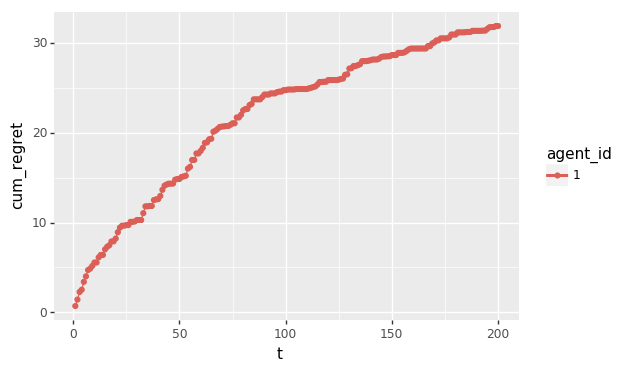

<ggplot: (8730292101137)>


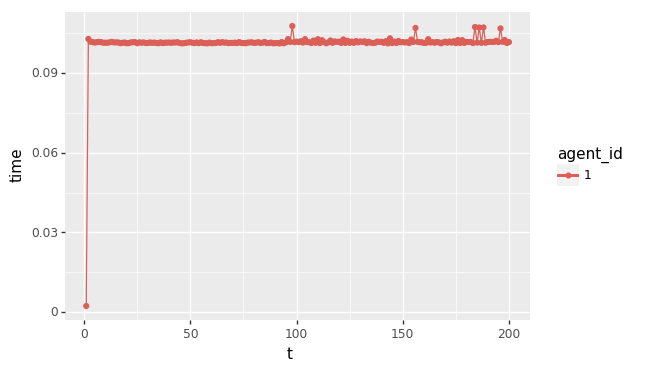

<ggplot: (8730389966385)>


([     action_id agent_id  cum_optimal  cum_regret  instant_regret    t  \
  0            1        1     0.934462    0.702558        0.702558    1   
  1            2        1     1.898287    1.420081        0.717524    2   
  2            3        1     2.865022    2.263300        0.843218    3   
  3            4        1     3.811325    2.515843        0.252543    4   
  4            5        1     4.763875    3.390703        0.874860    5   
  5            6        1     5.731881    4.006663        0.615961    6   
  6            7        1     6.687672    4.710063        0.703400    7   
  7            8        1     7.546968    4.868025        0.157962    8   
  8            9        1     8.544798    5.170756        0.302731    9   
  9           10        1     9.519990    5.546232        0.375476   10   
  10          11        1    10.469989    5.546232        0.000000   11   
  11          12        1    11.352615    6.122444        0.576213   12   
  12          13        1

In [5]:
simple_compare([make_pgts_agent()], num_articles, dim, var, 200, seed=5, verbosity=verbosity)

theta [ 1.76405235  0.40015721  0.97873798  2.2408932   1.86755799 -0.97727788
  0.95008842 -0.15135721 -0.10321885  0.4105985   0.14404357  1.45427351
  0.76103773  0.12167502  0.44386323  0.33367433  1.49407907 -0.20515826
  0.3130677  -0.85409574 -2.55298982]
Experiment: Step 0
 Sample: array([ 0.64013153, -1.61695604, -0.02432612, -0.73803091,  0.2799246 ,
       -0.09815039,  0.91017891,  0.31721822,  0.78632796, -0.4664191 ,
       -0.94444626, -0.41004969, -0.01702041,  0.37915174,  2.25930895,
       -0.04225715, -0.955945  , -0.34598178, -0.46359597,  0.48148147,
       -1.54079701])
 Steps taken: 0
 Sample: array([ 0.06326199,  0.15650654,  0.23218104, -0.59731607, -0.23792173,
       -1.42406091, -0.49331988, -0.54286148,  0.41605005, -1.15618243,
        0.7811981 ,  1.49448454, -2.06998503,  0.42625873,  0.67690804,
       -0.63743703, -0.39727181, -0.13288058, -0.29779088, -0.30901297,
       -1.67600381])
 Steps taken: 0
 Sample: array([ 1.15233156,  1.07961859, -0.81336

 Sample: array([ 1.43363982,  0.02672482, -0.79007486, -0.89457881,  0.5489215 ,
       -1.28219258,  0.8936443 ,  0.8964631 , -1.25870469,  0.24347969,
       -0.18732476,  1.36959089, -0.56194998, -1.67897427, -0.77953208,
        0.37901569,  0.48399622, -0.3097682 , -0.81759832,  1.59241308,
        0.80873722])
 Steps taken: 1185
Experiment: Step 5
 Sample: array([-0.30757414,  0.41379289,  0.74633276,  0.22170838,  0.85242358,
        1.70931781,  0.23427364,  0.26091349,  0.02382357,  1.55270533,
        1.17894377,  0.39081981,  0.66241836,  0.21198945, -0.21149229,
        0.02869536,  2.55358763, -0.84715944, -2.19432063,  0.91774341,
       -0.06622832])
 Steps taken: 1180
 Sample: array([ 1.088256  ,  0.19954254,  1.93882414, -0.1822207 ,  1.22619151,
       -2.1055213 , -0.42028069,  0.65877608,  1.50233585, -1.19010011,
       -1.68686301, -0.31294753, -0.43055773,  0.45957799,  0.65441409,
        0.7869836 , -0.7303075 ,  1.22673517, -1.6832482 ,  0.92327972,
        1.

 Sample: array([ 2.14742156,  1.01951672, -0.86037061,  0.19824739,  0.50794877,
       -0.24012984,  1.56245318, -0.33949346,  1.40216124, -1.26352008,
       -0.31127715,  0.69990909,  0.7579774 , -0.63542006,  0.85340497,
       -0.16383817, -0.48407844,  1.66577929,  0.68552959,  0.10148674,
       -1.55090868])
 Steps taken: 1139
 Sample: array([ 0.35512859, -0.58314024,  1.9244772 ,  0.50144983, -0.23961057,
       -1.65768484, -2.58939316,  1.84735454,  0.50936641,  0.12647004,
        0.41964963, -0.55034401,  0.28416391,  0.22303879, -0.17004573,
       -0.49085821, -1.5494995 , -1.37196754,  0.87960573, -1.9162015 ,
       -1.13330812])
 Steps taken: 1157
Experiment: Step 10
 Sample: array([-0.50079647,  1.68802589, -0.23817709, -0.82423636,  0.12777433,
       -1.59207383, -0.54050385,  0.61049889,  0.48967122, -0.21884861,
       -0.45933144, -0.47107848, -0.9585891 ,  0.53998909,  1.3931464 ,
       -0.92867592, -1.71107858,  0.21847286, -0.08411556, -1.31657258,
        0

 Sample: array([ 0.50525873,  0.3339752 , -0.24237955,  0.25823352,  0.0904076 ,
       -0.04926826,  0.36332951, -0.03776968, -0.94731619, -0.86604431,
       -0.36385214,  1.08393805,  0.3424064 ,  0.36568146, -0.43831194,
       -0.42911056,  0.77126447,  0.04568363,  0.55161972, -0.92651944,
       -1.15196934])
 Steps taken: 1108
Experiment: Step 15
 Sample: array([ 0.28243213, -1.11129793,  3.49591562, -1.51007934, -0.63749441,
       -0.71878466,  0.94576566,  0.07733995,  1.10955704, -1.70470079,
        0.02488999, -0.80437366, -0.90217952,  0.71132146, -2.0523159 ,
        2.53811013,  1.58963293, -1.90576965,  1.99231516,  0.98802675,
       -0.65155306])
 Steps taken: 1110
 Sample: array([ 1.50687182, -0.40181771,  0.44081627, -0.12487795, -0.56925836,
        0.43863329, -0.30925682,  0.67821883, -0.00520766, -0.51503549,
       -0.39326141, -0.64568264, -1.91876498,  0.41186867, -0.45921273,
        0.26922139,  0.21930437,  0.15800442, -0.58504265,  0.501856  ,
       -1

 Sample: array([ 1.52652397,  0.89982694, -0.3329051 , -0.51539911, -0.91451035,
        0.56115917,  1.41375267,  0.46012273, -0.67892025, -1.04012154,
        0.17309683, -0.88320939, -1.49627198, -1.38903033,  0.92377291,
       -0.37805064,  1.45593319, -1.59030904, -1.03721283, -0.31301518,
        0.64111623])
 Steps taken: 1078
 Sample: array([ 1.69496155,  1.10937411,  0.58352727,  2.19665272,  0.11569393,
       -0.01122579,  0.20882323, -1.9484489 ,  0.41473595,  0.31616251,
        0.3176811 , -1.21306284,  0.41947397, -0.60650645,  0.17852635,
        0.50020441,  0.17434741, -0.85145121,  1.57840701,  0.17056315,
       -1.32187956])
 Steps taken: 1085
 Sample: array([ 2.09226686, -0.19845757,  1.22552584, -2.3682676 ,  0.00515707,
        0.57411782,  0.05663658, -0.22968262,  1.00317456,  0.70373685,
       -0.91857765,  1.08942131, -0.45057154,  1.1962124 , -0.85570926,
       -0.22808288,  1.25838096, -2.05211998,  1.01688435, -0.64953641,
        0.69834661])
 Steps t

 Sample: array([ 1.95359121,  0.29530287,  1.49783387,  0.98842695, -0.35243911,
       -0.5874592 , -1.0294907 , -0.54456256, -0.6207287 ,  0.46017439,
        0.8148134 , -0.59456036,  0.98268028,  0.19579943, -0.70151244,
       -0.12204902,  0.74073755,  0.58910196, -0.10185276, -1.0860645 ,
       -0.36542413])
 Steps taken: 1034
 Sample: array([ 2.94083703, -2.65966501,  1.29852307,  0.99646154,  1.29943016,
        0.92703324,  0.30736273,  0.32654165,  0.4596538 ,  0.55338247,
       -0.46967407,  1.49559556, -1.03349621,  0.28140179, -1.38019273,
        2.1779107 , -0.71827897, -0.47996065, -1.37122502, -2.09152267,
        0.64413543])
 Steps taken: 1045
 Sample: array([ 2.0032976 , -0.01253529,  0.97651238,  0.92252127, -2.22052209,
        0.38339377, -2.11894526,  0.99314659,  1.44490006,  2.20791714,
        0.14417624, -0.32488287,  0.20788836, -0.62411366,  0.40830477,
       -0.77610159,  0.17422184, -0.97806033,  0.33717108, -0.31407446,
       -1.02455067])
 Steps t

 Sample: array([ 0.62339225,  1.17860778, -0.01075344, -0.13214112,  1.50009299,
       -1.23124962,  0.78843642,  1.1720359 , -0.88034603,  0.33001999,
        0.99273491, -1.51805013,  0.01179946,  0.93082173, -0.04421251,
        0.18394694,  0.91831619, -0.53101142,  0.17675129, -1.6376995 ,
        2.45972032])
 Steps taken: 992
 Sample: array([ 1.47505255,  2.3037855 , -0.29468833,  1.04813344, -0.06036745,
       -1.03508925, -1.77044978,  1.09752438,  1.60080172,  0.06107448,
       -1.07105936, -0.02370298,  0.7751631 , -0.90289075, -1.40148431,
        0.57715036, -0.13761167, -0.23297424, -1.174932  , -0.64865503,
        0.18431417])
 Steps taken: 988
 Sample: array([ 1.42707131, -2.1776099 , -0.25247721,  1.12758567,  0.57364069,
        0.46827158, -0.81887385,  0.52693325,  0.08925194, -0.31150496,
       -0.31785483, -0.60022503, -0.87394348,  0.19705112,  0.08783394,
        0.43093478, -0.48031361,  0.87916956, -0.92676732, -0.35373114,
       -0.90618368])
 Steps tak

 Sample: array([ 1.96637219,  0.78577719,  0.13603525,  2.82288321,  0.93655162,
        0.58280983, -1.23627174,  0.79016204, -1.0400399 ,  0.4606325 ,
        0.51573488,  0.38984391, -0.76241999, -0.04918899, -1.1287209 ,
       -0.11360127,  0.83559432,  2.35947244,  0.20842764, -0.57086647,
       -0.46553218])
 Steps taken: 776
 Sample: array([ 1.28192105,  0.47348357,  1.59601917,  0.75804068, -0.12447895,
       -0.16275114, -1.74398723, -0.91990813,  0.14134431, -0.5361085 ,
       -0.79763838, -0.89296866, -0.12289713, -0.37710533, -0.7573482 ,
       -0.60348668,  0.74140945,  0.94896186, -1.07166895,  0.51897597,
       -0.22071792])
 Steps taken: 776
 Sample: array([ 1.08067001e+00, -9.28363723e-01,  8.26756365e-01, -5.44732885e-01,
       -9.24166934e-03,  1.73905114e-01, -1.64325560e+00,  2.17619391e+00,
        2.23951922e-01, -8.09353087e-01,  6.47650820e-01, -3.26768430e-01,
       -1.35189090e+00, -2.86935551e-01,  4.07983431e-01, -6.13215005e-01,
        4.71723795e

 Sample: array([ 1.84101781,  0.93591397,  1.5337682 ,  0.46898903,  0.5329327 ,
       -1.54520524, -0.25753829, -0.80091004,  0.50492707, -1.01168177,
        0.78919475,  0.43874258, -0.06601763, -0.56477487, -0.07906098,
        0.1235142 ,  0.79123618,  0.05783372, -0.92787642, -0.99243816,
        0.53563493])
 Steps taken: 772
 Sample: array([ 1.44587628,  1.99727246,  2.24277805,  1.32749116, -0.66372034,
        0.53215726, -0.46964511, -0.39343822,  0.07375046,  0.8060499 ,
       -0.8639074 , -0.9333395 ,  0.15067745,  0.64344364, -0.44184901,
       -0.23164883, -0.77993675,  0.37901501, -0.56044798, -1.72670788,
        0.23739524])
 Steps taken: 781
 Sample: array([ 1.74097785, -1.46273796,  1.38898704,  0.0184227 ,  0.56435087,
       -2.14576168, -0.97089575,  0.4864499 ,  0.27622926, -2.48952944,
       -1.12624022, -0.22300816,  0.06943259, -1.56661369,  0.42101395,
        0.42423529,  0.55712264, -1.24932472, -0.68113667,  0.21471849,
       -1.055206  ])
 Steps tak

 Sample: array([ 1.35999359,  2.7829267 ,  1.25429116,  1.15648442,  1.77020317,
        1.49122058, -1.07357342, -0.7235016 ,  0.91580718,  0.4901673 ,
       -1.25768126, -0.61239442, -0.01088772,  0.45263389, -1.3912215 ,
        0.47198865, -0.17877289,  0.1698943 , -1.55878916,  0.30307149,
        1.17374122])
 Steps taken: 773
 Sample: array([ 2.33888961,  0.22146544,  1.07300916,  1.1630739 , -0.62670995,
        0.3960572 , -1.3752163 , -1.60242808,  1.32658016, -1.09467077,
       -0.06023486, -0.35235847, -1.97856602,  0.15723757, -0.10285074,
       -0.90919648, -1.26056815, -0.68068692,  1.77588809, -0.1568431 ,
        0.06051073])
 Steps taken: 780
 Sample: array([ 0.48519928,  1.68557411,  0.92791337,  0.58827154,  1.8257485 ,
       -0.83253508, -1.57303473,  1.94322089,  0.15114804,  0.18775808,
       -0.19322432, -0.22327707,  0.03610814,  0.59313076, -0.65004872,
       -0.76502401,  0.58275514,  0.75924102, -1.74659916, -0.99223646,
       -0.57913661])
 Steps tak

 Sample: array([ 1.74912546,  1.84205707,  0.79035241,  0.49130508, -1.19537249,
        0.66146028,  0.27463419,  0.24117678, -1.32160159, -1.64036866,
       -0.33920439,  0.8881146 ,  0.92733845, -1.2232186 , -0.8773668 ,
        0.75589619, -0.34059482,  0.978717  , -0.30925   , -0.28077568,
       -0.59654855])
 Steps taken: 769
 Sample: array([ 0.91256053,  1.03616917,  0.43797141,  1.12579781,  2.77074451,
       -0.68543957, -1.7340013 ,  0.251076  , -1.63362252, -1.7843667 ,
        1.29979804,  0.08017831, -0.42870863, -0.59149919,  1.03060585,
       -0.10031298,  1.50186186,  0.64143179,  0.3271983 , -1.1883034 ,
        0.30085103])
 Steps taken: 783
 Sample: array([ 2.45242007, -0.77236853,  0.16710026,  0.90531775,  1.49988936,
       -0.89474063,  1.3448552 , -0.7686799 ,  1.29349115, -0.5123786 ,
        2.0090177 , -0.0056343 , -1.09609118, -0.11177021, -1.82904895,
        0.01106334, -0.35215137,  1.40208005,  1.43147845, -0.04609842,
        0.95063847])
 Steps tak

 Sample: array([ 1.30954144, -0.25910471,  1.21738516, -0.36799425,  3.95389414,
        0.26518961, -2.50238541,  1.84079163, -0.19559499,  0.75588407,
       -0.11925786,  0.57841765,  0.2751909 , -1.90441702, -0.24415573,
       -0.1353513 , -0.30215105,  1.09366507, -0.58042211,  0.02454493,
        0.7811771 ])
 Steps taken: 773
 Sample: array([ 2.42451978,  0.06981829,  1.79551603,  0.86252806, -0.26452458,
       -0.10965283,  1.74235106, -0.49360713,  1.0942509 , -0.03057136,
        0.21437795, -0.01941601, -1.04113164,  0.44339276,  0.24829594,
       -0.89290576,  1.78538255,  1.31328416, -1.09857161,  0.10238122,
       -1.63480773])
 Steps taken: 776
Experiment: Step 56
 Sample: array([ 1.39902941, -0.04272786,  1.27647653,  1.15990952,  0.55205551,
       -2.04061246, -0.10047435,  0.27430338, -0.33558013,  0.36920522,
       -0.14736735,  0.54692345, -0.28916533, -1.24818558,  2.06609714,
        1.20128089,  2.87353455, -1.20794413,  1.91060516, -0.25511924,
       -0.2

 Sample: array([ 2.41217676, -0.85458216,  0.6385773 ,  1.05911388, -1.90504335,
       -0.25194121,  0.88347892, -0.4140942 , -1.28320559,  0.50994034,
        1.20699522,  0.41030898,  0.55771864,  0.68826319, -0.31367583,
        0.59024262,  1.78229287,  2.52136198,  1.67134113,  0.59083018,
       -0.78678313])
 Steps taken: 775
Experiment: Step 61
 Sample: array([ 1.79218711, -0.80552177,  0.06351752,  1.43791389,  1.29499517,
       -1.18619736, -0.18704373,  1.04744938,  0.54606208,  0.80655197,
       -0.15611546,  1.73500377, -1.38091333,  0.59492223,  0.78894958,
       -0.03565778,  1.32275618, -2.05589124, -0.04303698, -0.48471582,
        0.33839314])
 Steps taken: 779
 Sample: array([ 1.56994022,  0.95977693,  1.66401793,  0.37149669,  0.50357894,
       -0.5469207 , -0.65341991,  0.80247002,  0.42799477,  0.50379281,
       -1.27186288, -1.99331806,  0.36250103,  0.79251126, -0.34771456,
        2.50619964,  1.91664291,  1.44311918, -1.17883817, -0.73191621,
        0.1

 Sample: array([ 0.61681958, -0.4053676 , -1.01623218,  1.90084268,  0.31746047,
       -0.55697006, -0.04286842,  2.0175003 , -0.26224132, -0.24254995,
       -0.20890413,  0.75322405,  0.92766298,  1.43737711, -0.0052777 ,
       -0.70322407,  1.37736506, -1.53503682, -0.09357192, -1.79077664,
       -1.0673769 ])
 Steps taken: 769
 Sample: array([ 1.94618899,  1.23411251,  0.87257956,  1.79139331,  1.02388071,
       -0.5130109 ,  1.72813444, -0.02923219, -0.12900959,  0.94374276,
       -0.16217055,  0.39814896,  1.24258746,  0.45666738, -1.20908072,
       -0.78199737,  0.34715451,  0.951905  ,  0.17370485,  0.10700192,
       -1.25709347])
 Steps taken: 779
Experiment: Step 66
 Sample: array([ 0.89522443,  0.04885964,  0.77241392,  0.09504513,  0.3572874 ,
       -0.58627056, -1.7886838 ,  0.17585878, -0.48175663,  0.33207215,
        0.93107531,  1.09477643,  0.07484057,  0.30985463,  0.01348748,
        0.23508141,  2.07699987,  0.59325052,  0.23600844, -0.3677218 ,
       -0.3

 Sample: array([ 2.02692439, -1.04266077, -0.50601478,  1.6299484 , -1.50721386,
        0.14330067,  0.71121011, -0.70338689,  1.32111869, -0.58470805,
       -0.14446123, -0.00821762,  0.03829006,  0.60152298, -0.23482703,
       -0.40451014,  0.9323687 ,  0.11075579,  1.10697092, -0.65501596,
       -1.58038458])
 Steps taken: 768
Experiment: Step 71
 Sample: array([ 1.20329374,  0.84431563,  1.6382326 ,  0.40634978,  2.1384532 ,
        0.0580584 , -0.30069132,  0.8112611 , -0.9440953 ,  0.68650604,
       -0.21456819,  2.68350464,  1.0590358 ,  0.93458485,  1.90464589,
        1.05110649,  1.42380677, -1.74279193, -0.03411695,  0.16033124,
       -0.27737111])
 Steps taken: 770
 Sample: array([ 0.99876031,  0.25669151,  0.50701973,  2.66048619,  0.03163637,
       -0.15255821,  0.55389899,  0.0090899 ,  1.08429319, -0.12189423,
        0.52214996, -1.76651924,  1.24359781, -0.63501947,  0.44803006,
        0.71998731,  0.97280628,  1.32797885,  0.38205497, -0.6175621 ,
       -1.2

 Sample: array([ 1.12717756, -0.10486052, -0.63924897,  1.4480177 ,  0.61649781,
       -0.30576125,  0.47354572,  0.85837844, -0.59839728,  0.55564051,
        0.79810849, -1.11758847,  0.42016789,  2.04666886, -0.34898301,
       -0.7785182 ,  1.16693834,  0.22403837, -0.40326596, -1.10067195,
       -0.74055016])
 Steps taken: 766
 Sample: array([ 2.25986872e+00,  1.93284492e-01,  6.04049006e-01, -3.92925368e-01,
       -3.99957693e-01,  1.04190083e-03,  9.07408852e-01, -6.99856050e-01,
        9.71067597e-01, -3.59531001e-02, -4.72438507e-01, -1.12380577e-01,
        5.75935165e-01, -4.86985728e-01,  8.65894626e-01,  5.47257526e-02,
       -7.31364011e-01,  6.47994918e-01,  5.36354722e-01, -4.62884291e-01,
       -1.72236948e+00])
 Steps taken: 777
Experiment: Step 76
 Sample: array([ 0.86756686,  1.30948654,  1.3203666 ,  0.85694522, -0.97393847,
       -0.27252739,  0.44310113, -1.80161706, -1.77200336, -0.86448967,
       -0.17730101,  0.76150215, -0.53710684, -1.88241835,  0.96

 Sample: array([ 1.86049374, -1.49658403, -1.34245635,  1.22978558,  0.56085461,
        0.85708044, -0.58009515,  1.22354456, -1.10243539, -0.34346288,
       -0.2620949 , -0.7320826 , -0.00375688,  0.27666696,  1.31152828,
       -0.13539546,  1.55039723, -0.34915242, -2.07555421, -0.55512582,
       -1.96833088])
 Steps taken: 771
 Sample: array([ 1.02653747, -0.20544174,  0.15442283,  0.59010352,  2.83123367,
       -1.17830594, -0.62912253,  0.03853457, -0.15441911,  0.69239096,
       -0.76375778,  0.82019146, -0.73822223,  1.21942388, -0.28016166,
       -0.96464059,  0.29746417, -0.85461038, -0.87416737, -1.53040132,
       -1.26846875])
 Steps taken: 781
 Sample: array([ 2.90020024, -1.41933274,  1.16672701,  1.29350907, -0.82526997,
        0.41582277,  0.11628954, -1.28739462, -0.27075803, -0.06525775,
       -0.40348551,  1.83990853,  0.47621159,  0.94246079,  0.51160295,
       -0.41742395,  0.32545256, -0.56143039,  1.53984007, -2.26991012,
        0.72404979])
 Steps tak

 Sample: array([ 1.45713372,  0.6255347 ,  1.00740384,  0.92203763,  1.96107477,
       -0.26833502, -1.41703097,  0.18306802, -0.67082963, -0.97867955,
        0.92916503,  0.67308836,  1.40560423, -0.45755974,  0.51125528,
        0.62798501,  2.2124413 ,  1.32735626, -1.15796855, -1.19398727,
       -2.08123702])
 Steps taken: 767
 Sample: array([ 2.16577551,  1.50843727,  0.5794684 , -0.01302216, -0.20693746,
        0.24576694,  0.35991415,  0.32139596, -0.9654585 , -0.71175604,
       -0.85035047,  0.21363276,  1.10302937,  0.60549071, -0.49665178,
        0.24074629,  0.16712111, -0.77024101, -1.16497435, -0.4583505 ,
       -1.62817351])
 Steps taken: 776
 Sample: array([ 0.70729334, -0.21176122, -0.74880062,  1.57791419,  0.70343527,
       -0.45856249,  0.10567232,  2.02723769,  0.4492244 ,  0.36624575,
        0.23547517,  1.04636207,  1.02522696,  1.05479491, -0.7410562 ,
        0.77513125, -0.68735438, -0.65745059,  0.1109117 , -0.85336614,
       -0.784481  ])
 Steps tak

 Sample: array([ 1.28836741,  0.38470891,  0.23834349,  1.60615887, -1.48633938,
        0.27198448,  0.8386419 , -1.60305515,  1.18724799, -1.6570426 ,
       -1.69620803,  2.59907094, -0.33674039, -0.86477079,  0.86796322,
        1.08953196,  1.45040728, -1.60828052,  0.62521663, -0.55128038,
        0.30155301])
 Steps taken: 766
 Sample: array([ 1.12448111,  2.84370477,  1.08365847,  1.27741563,  0.46097388,
        0.34371034,  0.28805082, -0.66822345,  0.62660418, -0.89975536,
       -0.25220303, -0.00389677,  0.59328916, -0.52756767, -0.2818099 ,
        0.67870146, -0.28790644,  1.84073456, -0.2559749 , -0.13690424,
       -0.658315  ])
 Steps taken: 775
 Sample: array([ 1.93554589,  1.15680679,  0.71270647,  0.35872861,  0.23901092,
       -0.78791677, -1.09665176,  1.48865355, -0.92085276, -0.76388196,
       -0.2236056 ,  0.60645819,  1.88155923,  1.32644776,  0.48236961,
        0.63300299,  0.69934265, -1.13088246, -0.93064764, -0.25476154,
       -0.24654276])
 Steps tak

 Sample: array([ 1.26736945,  0.73399513,  2.07322015,  1.39707656,  2.37076201,
       -1.15812585,  0.29907202,  0.31630998, -0.7463443 , -1.07616438,
        0.76130496, -0.2015993 ,  0.80173524,  0.67288508, -0.46768576,
        0.33452104,  0.39068644,  0.98343082, -0.68792612, -0.90855052,
       -1.90836963])
 Steps taken: 770
 Sample: array([ 1.64217644, -0.03863304, -0.09484931,  0.41468562, -1.1347859 ,
       -0.71104421,  1.01734465,  0.10229213, -0.42473595, -0.92687088,
       -0.32689301,  1.13655978,  0.39539431,  1.21928937,  0.39668179,
        0.20727064,  1.43282549, -0.40696103, -1.378986  , -0.31758401,
       -0.5701422 ])
 Steps taken: 774
 Sample: array([ 0.55631395, -1.34442906,  2.06250914,  0.54575807,  0.19960639,
       -0.58484247, -0.79207133,  2.41586549, -0.58112234,  0.26396384,
        0.25003819, -0.07216289,  0.14491295,  0.47956457, -0.14891446,
       -0.77867394,  0.92541952, -0.66916407,  0.37439835,  0.01783189,
       -2.53775077])
 Steps tak

 Sample: array([ 1.84405762,  1.1543326 ,  0.77269291,  0.18347364, -0.4921116 ,
       -0.94714224, -0.00271896,  0.36629089, -0.25353942, -0.19842007,
       -0.13364106,  0.76518413, -0.15026311,  0.31254171,  0.54633762,
        0.91163248,  0.56676961, -0.91702939, -0.62191362,  0.07210633,
       -0.27749304])
 Steps taken: 762
 Sample: array([ 1.19950423,  0.13448301, -0.42121089,  1.46829557,  0.58832614,
       -0.72416143,  0.91205472,  1.52014308,  0.45076856,  1.00463948,
       -1.49365998,  0.00504155, -0.27774932,  0.21885062,  0.42678454,
       -0.47856636,  0.14367522, -0.65457264,  0.73137914, -1.24041793,
       -0.41746788])
 Steps taken: 772
 Sample: array([ 1.53668111, -0.83609741,  0.50167579,  0.72056246, -1.10183249,
       -0.53889593,  1.78803101, -0.39553716,  2.36664728,  0.0072448 ,
        2.06500742,  0.29582266,  1.29706054, -0.58364895,  0.26177027,
        0.40946804,  2.05352282,  0.72465112,  1.14116858,  0.92791595,
       -1.21777688])
 Steps tak

 Sample: array([ 0.72884151, -1.04919769,  0.13652342,  1.10091653,  1.09507876,
        0.28774923, -0.89842557,  2.10620882, -0.06045777, -0.94812568,
        0.94520974,  0.50517497,  0.79559504,  0.21128267, -0.82285954,
        0.09346332,  0.38158928, -0.03254268,  0.33253563, -0.87502424,
       -1.25363504])
 Steps taken: 767
 Sample: array([ 2.84165249, -1.37946322,  0.79506014,  1.50150136,  0.96239803,
       -0.41059427,  1.04740564,  0.72034869,  0.8894226 , -0.07287226,
        0.95829516, -0.03324981, -1.63504366,  1.846329  ,  0.14063763,
       -0.32292977,  0.35296086,  0.19208385,  0.07610971, -0.03047154,
       -0.12406349])
 Steps taken: 774
Experiment: Step 106
 Sample: array([ 1.37943599e+00,  8.23430299e-01,  1.24217687e+00,  1.16398474e+00,
        2.53722173e-01, -1.41173777e+00, -1.74937644e-01,  3.63572543e-01,
       -1.11909812e-01, -2.04740746e-01, -7.94291995e-01,  1.49667372e+00,
        1.39632033e-01,  9.59031105e-01,  1.78661267e+00,  7.17428941e-02

 Sample: array([ 1.70542348, -0.07663803,  0.95711239,  0.4051965 , -0.05239059,
       -0.56127178,  0.61744846,  0.4594361 ,  0.04904767, -0.39307059,
       -0.79516076,  0.21078948,  0.42749018, -0.46387244, -0.12117079,
       -0.01806345, -0.39914708, -1.15788335, -0.53812621,  0.15936655,
       -0.30697206])
 Steps taken: 694
 Sample: array([ 1.48813452,  1.00580411,  1.38972209,  1.18552712,  1.21672091,
       -0.45477112,  1.35930956,  1.12172663, -0.68710472, -0.22214616,
        0.14839119,  0.34929401,  1.13255828,  0.02329771,  0.1936752 ,
       -0.42614748,  0.08099007, -1.06903498, -0.43475442,  0.02981385,
       -0.48314031])
 Steps taken: 715
 Sample: array([ 1.87432481,  0.20524823, -0.33878113,  1.53808292, -0.22545101,
        0.1505843 ,  1.82638656,  0.66393169,  0.17295437,  0.04742259,
        0.35536944, -0.21843464, -0.17437058, -0.32088854,  0.45559282,
       -0.02079935,  0.94895366,  0.29450824,  0.94187644,  0.37419573,
       -0.72288484])
 Steps tak

 Sample: array([ 1.4857174 ,  0.60036878,  0.79142004,  0.07175009,  1.73546402,
       -1.45912116,  0.77785584,  0.27916911,  0.31399731, -0.14057141,
       -0.10057281, -0.14880073,  1.0012452 ,  0.11599759, -0.59208542,
        1.09161563,  1.53315545, -0.16248779, -0.5000943 , -1.34367641,
       -1.49452997])
 Steps taken: 771
 Sample: array([ 1.70355053,  0.49096629,  1.72955724,  1.50444938,  0.53145383,
       -0.3563355 ,  0.85830007, -0.49593077,  1.71299235,  0.46118627,
       -0.01239385, -0.34052793,  0.78049048,  0.84121848,  1.12151365,
        0.79518825,  0.91446706,  0.3981032 , -1.0113349 , -0.68718254,
       -0.8446666 ])
 Steps taken: 779
 Sample: array([ 2.00375969,  0.17704264,  0.86792754,  1.65440292,  0.60744352,
       -1.25357419,  1.02250289,  1.80939535,  0.12819185,  0.89594849,
       -0.30789476,  0.77613994,  0.74802568, -1.35256179, -0.49895429,
       -0.76860491,  1.32964514, -0.79672348, -0.03884881, -1.02385773,
       -0.72429715])
 Steps tak

 Sample: array([ 1.86973532,  0.55139683,  0.79808564,  1.52889259,  1.22130619,
       -0.27236456, -0.1676014 , -0.10300124, -1.1496392 ,  1.05323396,
       -0.01999108, -0.03432709,  1.01778022,  0.32586054, -0.29636166,
       -0.61645575,  1.51378095,  0.3989456 ,  0.33646459, -0.56231827,
       -0.37771048])
 Steps taken: 763
 Sample: array([ 1.52741212,  1.24145701,  2.21372198,  0.63335274, -0.27317829,
       -0.61567023,  0.81847766, -0.13293203,  0.80730408, -1.61700255,
       -0.18821026,  0.62054203,  0.3656882 , -0.91530524,  0.69968629,
        0.67578198,  1.41405088,  0.57543865, -0.09684143, -0.56046256,
       -1.10382513])
 Steps taken: 777
 Sample: array([ 1.92817018,  2.47005066,  1.26243959,  0.70658278,  0.68365085,
        0.1992687 , -0.65706669,  0.25124292,  0.04887652, -0.33886691,
       -0.3518773 , -0.84002441,  0.16754097, -0.80345119,  1.14012404,
        1.44282706,  0.57220462, -1.61287876, -0.62588735, -0.73774355,
       -1.95425369])
 Steps tak

 Sample: array([ 1.55628288, -0.32427655,  0.37482688,  1.25504676,  0.62970258,
        0.18003364, -0.11155998, -0.76235504, -0.02533343, -2.22583775,
       -0.29960391,  0.23201559, -0.00316054, -0.99483349, -0.61704202,
        1.69732185,  0.03949359,  0.59432557, -0.43641038, -0.83310518,
       -1.11337946])
 Steps taken: 768
 Sample: array([ 2.16727553, -0.06943339,  0.07116338,  0.40271311, -0.57288183,
        0.11642291,  0.03032848, -0.04441703,  1.64632624, -1.51932193,
        0.07492487,  0.40889881,  1.43977046,  1.52907445,  0.83984737,
        0.99928334,  1.54743974, -1.04333845, -0.1078764 ,  0.04112845,
       -1.42949406])
 Steps taken: 776
 Sample: array([ 0.94016277, -0.87475832,  0.43403412,  2.16254669,  2.30633988,
       -0.37370355, -1.00321566,  1.30674451, -0.13929115,  0.06915227,
        0.03544251,  0.40884434,  1.68366607,  0.35414077, -0.26807832,
        0.56186614,  0.71971782, -1.05136033,  0.93232731, -1.50357951,
       -1.02395405])
 Steps tak

 Sample: array([ 1.33802826, -0.70936177,  0.90535435, -0.28146153, -1.15292462,
        1.2110329 ,  0.07311459, -0.87891282,  0.77245839, -1.53478609,
       -0.44094852,  0.57866368, -0.51005815,  0.41129862,  1.98640426,
        0.54453442, -0.03553596,  0.1352791 , -1.05960192, -0.33284925,
       -1.77137834])
 Steps taken: 769
 Sample: array([ 0.82213203, -0.92213691,  1.23816652,  3.66456894,  1.82685429,
       -1.45971467, -0.31318734,  0.92572757, -0.21840386,  1.31521248,
        0.54469488,  0.15303149,  0.28161383, -0.33414532, -1.40601616,
        0.15626451,  0.95984762, -0.16815158,  0.6642342 , -0.84517051,
       -1.03071401])
 Steps taken: 775
 Sample: array([ 2.00367618, -0.52140667, -0.12211494,  0.02675359,  1.05449503,
        0.13777629,  0.79518568, -0.36805992,  0.13657283,  0.13810446,
        1.68726031,  2.04127314,  0.15203746,  1.12446025, -0.36908366,
       -0.19619872, -1.16532893,  0.29721149,  1.13595454,  0.65946822,
       -1.64978487])
 Steps tak

 Sample: array([ 0.93629931, -0.12922536, -0.0059359 ,  1.31552497, -0.30813027,
       -0.96584769,  0.78971516,  1.83080068, -0.51774239, -0.34177872,
        0.06060661,  1.825143  ,  0.73082232, -0.26733237, -0.23071727,
       -0.58435465, -0.01562164, -0.86688706, -1.33345622, -0.83206567,
       -2.31431754])
 Steps taken: 763
 Sample: array([ 2.3361203 ,  0.06249813, -0.03710248,  2.33374804,  1.27964638,
       -0.41140933,  0.82711611, -2.69085003, -0.29522501,  0.50848094,
        1.05337513, -0.30912914,  0.37936256,  1.25569083, -0.47250824,
       -0.11267309,  0.14043611, -0.05605423,  2.1072708 , -0.62855374,
       -1.42379537])
 Steps taken: 776
Experiment: Step 136
 Sample: array([ 2.64716767,  0.37363425,  1.16329083,  0.27477114,  1.16715723,
       -0.68767026,  0.85124675,  0.03323619,  0.91305504,  0.27015107,
        0.56428253,  2.51229293,  0.14067318,  0.77073015,  1.97252187,
       -0.46517807,  1.77198549, -0.96031057,  1.55053224,  1.51990346,
        0.

 Sample: array([ 2.47078396,  0.43167468, -0.82691823,  2.07032247,  0.75192869,
        0.23120794,  1.4228759 , -0.69238159,  0.5657448 ,  1.75491758,
        1.66418331,  0.38783227, -0.6469901 ,  1.86498235,  0.69523099,
        0.11404063,  1.00552722,  1.12743071,  1.28009005, -0.57179114,
       -1.5680498 ])
 Steps taken: 767
Experiment: Step 141
 Sample: array([ 1.89373609,  0.38304225, -0.0823115 ,  1.31019211, -0.26152233,
       -0.32341892,  1.03080509,  0.30157288, -0.45759633,  0.78925623,
       -0.41072438,  1.53494485,  1.60744086,  1.28269797,  1.43071102,
       -0.34679772,  1.66727207, -0.20146827,  1.09913727, -0.14032573,
       -0.67021148])
 Steps taken: 773
 Sample: array([ 2.05969442, -0.34660701,  0.19014268,  0.48809677,  0.1740869 ,
        1.0057269 ,  1.26292382, -0.18787485,  1.10939474, -0.07138828,
       -1.29202746, -1.1456082 ,  0.89881336, -0.63208231, -0.29585236,
        0.42455046, -0.04773406,  0.89996887,  0.94097913, -1.23949597,
       -1.

 Sample: array([ 1.22335226, -0.819649  ,  0.40397174,  1.64257874,  1.35983552,
       -1.24918296,  1.1511734 ,  0.27853851,  0.49580796,  0.25490958,
       -0.80598753,  0.01725346, -0.3758126 ,  0.13437814, -0.66586633,
       -0.56625963,  0.87479256, -1.17615018,  1.06311758,  0.1374693 ,
       -1.45420118])
 Steps taken: 767
 Sample: array([ 2.24129106,  0.45568809,  0.54333238,  2.77892583,  1.38559976,
       -2.1126164 ,  0.63660831,  1.06588221,  1.02485021, -0.20489987,
       -0.84830041,  0.90986281, -1.26825086,  1.5758242 ,  0.3564377 ,
        0.03537661,  0.76758034, -0.33350534,  0.69943503, -1.14602619,
       -1.74289333])
 Steps taken: 774
Experiment: Step 146
 Sample: array([ 1.59910869,  1.74381904,  2.97484603,  2.61096361, -0.01691223,
       -1.02931713, -0.54249373, -0.4253869 ,  0.32207031,  0.33183933,
       -1.23666558,  2.15010476,  0.23755563, -0.16772416,  0.44657137,
        1.18976092,  1.9884838 , -0.65025995,  1.52595787,  0.88902522,
       -0.

 Sample: array([ 1.65800903,  0.28592868,  0.69535418,  1.31772058,  0.50548325,
        0.42250403,  0.12184555,  0.26313079,  0.1338165 , -1.17828953,
       -1.68276976,  0.94024632,  1.28301616,  0.73348466,  0.34471334,
       -0.12119714,  0.31985913, -1.17541501, -1.40731569,  1.07938735,
       -1.28842429])
 Steps taken: 768
 Sample: array([ 1.20777373, -0.38433387,  0.53967362,  1.91276478,  1.25095091,
       -0.9053144 ,  0.85803883,  0.69829705,  0.19122829,  0.66667016,
        0.20493983,  0.64420578,  0.19296261,  0.61457967, -0.32438056,
        0.01569421, -0.08645035, -1.40321848, -0.45671896, -0.94318687,
       -1.09624908])
 Steps taken: 775
 Sample: array([ 1.93671175,  0.95115335,  1.18256053,  1.45359873,  0.20103843,
       -0.99418601,  2.0059335 ,  0.21554146,  0.89095964,  0.06244669,
        1.06691087,  1.54630911,  0.84896068,  0.80339897, -0.81771288,
        0.71498168,  0.04129565,  0.28293074,  0.86652926, -0.51617278,
       -1.05871318])
 Steps tak

 Sample: array([ 1.7011421 , -0.31924899, -0.27465805,  1.06950809,  1.36050922,
        0.54176353,  0.25540963,  0.69839369,  0.92728103, -0.87053135,
       -0.63597367,  1.48086361,  1.19299634,  0.01373225, -0.39693492,
        1.04801852, -0.1470622 , -1.03428151, -0.04409781, -0.97107088,
       -1.44703085])
 Steps taken: 767
 Sample: array([ 1.72959046, -1.50681423,  1.28385258,  2.05598987,  0.85046604,
       -1.11921153,  0.95955625, -0.54512193,  0.62844283,  0.87894276,
        1.33493959,  2.17025277,  0.69552975,  0.95120412, -0.43095935,
       -0.34991222, -0.28848463,  1.30412811,  0.2210808 , -0.78296537,
       -1.60634075])
 Steps taken: 776
Experiment: Step 156
 Sample: array([ 1.9677829 ,  1.91355873,  1.0429986 ,  0.89867512,  1.75234233,
        0.84965098,  0.3967426 , -0.25336635,  0.41233163,  0.52589836,
        0.46608674,  1.06002162, -0.25387332,  0.34808026, -0.15154559,
        1.31726452,  4.13139953,  0.54994956,  0.88366079,  1.2144039 ,
       -0.

 Sample: array([ 1.62570667, -0.28342783,  2.79686574,  1.47295597,  0.68194151,
        0.43878743,  0.4354702 , -0.24394361, -1.42648142,  0.34059393,
       -0.39880819,  0.48760376,  0.26952792, -0.26990836, -0.53952454,
       -0.65977586,  0.76738908, -1.68979844, -0.53251967, -0.96169377,
       -2.08776343])
 Steps taken: 766
 Sample: array([ 1.49626522,  0.12625883,  0.22441356,  0.48854054,  0.15497064,
       -2.14171216,  0.35918902,  1.26798527, -0.12165902, -0.19189206,
        0.67717657,  0.95153687,  0.90743922,  0.2690242 , -0.74627665,
        0.29861013, -0.73781302, -1.12213846, -0.21610605, -1.35253495,
       -1.66558633])
 Steps taken: 769
 Sample: array([ 2.75607099, -0.82573515, -0.01329149,  1.11047096,  2.08757951,
       -0.82972748,  2.06612931, -0.81371982, -0.41517829, -0.17767284,
        0.91682164,  0.47059534, -0.68340069,  0.41289499, -1.65160915,
        0.01120047,  0.11662847, -0.37506404,  1.58294146, -1.54271864,
       -1.61364526])
 Steps tak

 Sample: array([ 1.71430822, -0.13190946,  1.79851323,  0.90273645,  1.28107703,
        0.39077714,  0.30315424,  0.0154808 , -0.09308345, -1.07610288,
        0.76058306,  0.7182728 ,  0.79435058, -0.09818485, -0.92028063,
       -0.10479153,  0.32547717,  1.1152608 , -0.47639789, -0.60073787,
       -2.0471246 ])
 Steps taken: 766
 Sample: array([ 1.92008356, -0.41787089,  0.86103826, -0.34623075,  0.16227949,
        0.71487245, -0.56818892,  0.78013994,  0.51530985, -0.59651338,
        0.91648172,  0.47641303,  0.29878421, -0.02763398,  0.33789917,
        1.2723209 ,  1.10864097, -0.16643624,  0.6070133 , -0.1393041 ,
       -2.05618661])
 Steps taken: 774
 Sample: array([ 1.10897955, -1.63973193, -0.42821225,  1.67380102,  0.42399082,
       -1.17788686, -0.42181452,  0.76123975,  0.80249545,  0.00354947,
       -0.07904937,  0.24783589,  1.44535636,  0.87987951,  0.51317405,
        0.26295016,  0.71198861, -0.60460318,  0.43304426, -0.99101548,
       -2.08905683])
 Steps tak

 Sample: array([ 1.97754188,  0.3051856 ,  0.8374923 ,  0.99636713,  0.06586715,
        0.80689742,  1.06807186, -0.36039578,  0.32638632,  0.01285312,
        0.05606901,  2.18179527,  0.53590069, -0.70335722,  1.76397915,
        0.18660685,  0.62166254, -0.60912012, -1.21682718, -0.21502784,
       -1.77593319])
 Steps taken: 771
 Sample: array([ 1.7627639 , -0.53524652,  0.2504413 ,  1.08642994,  0.65203063,
       -1.24743329,  0.93502187,  0.04714295,  0.44793832,  0.65543699,
       -0.12683437, -0.36865146,  1.27400198,  0.07334243, -0.22229064,
        0.13832076,  0.46900167, -1.51391386, -0.62556533, -0.8753934 ,
       -1.66854621])
 Steps taken: 774
 Sample: array([ 2.65358045, -0.71429154,  0.01569287,  1.33153963,  0.52664033,
       -1.38191502,  1.13106476, -0.84208086,  0.18806997,  0.58797687,
        1.77127413,  0.50078149,  1.19300726,  0.30441797, -0.14704742,
        0.12888315,  0.57715025,  0.20240343,  2.05537866, -1.25546542,
       -1.36075784])
 Steps tak

 Sample: array([ 1.40580602,  0.77659825, -0.76890874,  1.82056648,  1.49105926,
       -1.36267537,  0.97686168,  0.69103446,  0.87587579,  1.65848349,
       -0.575025  ,  0.83598828,  0.92079522,  1.24499577,  0.47493145,
        0.91419368,  0.30357657, -0.15437078, -0.1878732 , -0.43497815,
       -0.98355084])
 Steps taken: 765
 Sample: array([ 2.71544257e+00,  3.04812853e-01,  2.25849616e-01,  2.29485473e-01,
        3.60150353e-01, -1.46934205e+00,  1.50400016e+00,  7.44810500e-01,
        1.22305676e+00, -3.60380207e-01,  2.68084414e-03,  6.04677493e-01,
       -7.45114916e-01,  1.00458204e-01, -8.25098304e-01, -1.03646237e-01,
        1.64804657e-01,  4.08359668e-01,  1.53945228e+00, -2.93623448e-01,
       -1.95194772e+00])
 Steps taken: 771
Experiment: Step 176
 Sample: array([ 1.70562479,  1.00304859,  0.81277703, -0.13651335,  1.33491939,
       -0.13552601,  0.47597344,  1.80158583, -0.34476135, -0.39955718,
       -0.60763332,  1.52432168,  1.46939233,  0.82058622,  1.2

 Sample: array([ 2.11348561, -0.39408823,  2.22677712,  0.64862396,  2.01230482,
       -1.17039917,  1.4976932 ,  0.40094198,  0.24936121, -0.51403007,
        0.38235259,  0.01469961,  0.25971594,  0.65154756, -0.38317746,
        0.3678157 , -0.08571835, -0.33103805, -0.79611747, -0.21101128,
       -2.77569581])
 Steps taken: 766
 Sample: array([ 1.25222645,  0.17157765,  0.09581622,  1.54622199,  1.19868772,
       -1.41465237, -0.18320203,  0.7645763 ,  0.3313509 ,  1.30990951,
        0.4031264 ,  0.13472156, -0.16774267,  0.19576839, -0.16981456,
       -0.10900109,  0.95017327, -0.85595358, -0.18973024, -1.32918985,
       -1.49337874])
 Steps taken: 771
 Sample: array([ 2.60716443, -1.99269579,  0.55121745,  1.68319114,  0.25672191,
       -0.72688372,  1.43146661,  0.38407996,  1.14396474,  0.02992022,
        1.07472695,  1.62122698, -0.42389153,  1.09540766, -0.8968622 ,
        0.80172045,  0.79436449, -0.54591362,  1.18637866, -0.61711656,
       -1.47368966])
 Steps tak

 Sample: array([ 1.70861759,  0.38576987,  0.16816425,  0.90855581,  0.06339349,
        0.45342583,  0.01049932, -1.0539919 ,  0.73047123,  0.09934021,
       -0.13707921,  0.53988834,  0.511658  ,  0.18417254, -0.678213  ,
        1.24124895,  1.56987762,  2.13066228,  1.49822801, -1.15216025,
       -2.2613487 ])
 Steps taken: 759
 Sample: array([ 2.22401168, -0.18802742,  1.43025053,  0.66792285,  0.27939235,
        0.5617004 , -0.06336836,  0.62297511, -0.3314248 , -0.23713427,
       -0.33705164,  1.19881433,  0.94935323,  0.89897442,  1.3062051 ,
        0.99726101,  0.83454206, -0.39700559, -0.69731938,  0.82684295,
       -1.40161853])
 Steps taken: 777
 Sample: array([ 1.45119427, -0.44614642,  0.53023932,  1.05799418,  1.1137818 ,
       -0.65547864,  0.11788845,  0.50217097,  0.70252952,  0.5431331 ,
       -0.02226761,  0.68079802,  1.52526406,  0.99439928,  0.16450246,
        0.41630052,  0.57093591, -0.7590056 ,  0.05308034, -1.18891619,
       -1.95233574])
 Steps tak

 Sample: array([ 1.97476515e+00,  4.49226461e-01,  8.33506496e-01,  1.89368313e+00,
        7.86558806e-01,  5.86368484e-01,  3.12128381e-01, -7.24860049e-01,
       -2.21143008e-01, -7.90578054e-01,  3.51321027e-01,  8.88561726e-01,
       -5.25882172e-01, -5.84538932e-01,  1.10439819e+00,  2.21329121e-01,
        5.28716741e-01, -1.17351094e-03, -5.74753918e-02,  3.42722867e-02,
       -2.29000326e+00])
 Steps taken: 767
 Sample: array([ 1.80502117,  0.31707375,  1.27547506,  1.28629126,  0.80602836,
       -1.1861753 ,  0.04240395, -0.48573582,  0.17740055,  0.44565474,
       -0.43810795,  0.94724442,  0.58719164, -0.34170495,  0.36706326,
       -0.47757824,  0.8195061 ,  0.28352918, -0.38027569, -2.04246869,
       -0.31870709])
 Steps taken: 770
 Sample: array([ 2.40241216, -0.34604436,  2.94792955,  2.59597843,  0.56146114,
        0.28938693,  0.56112427,  0.09360301,  1.12446898,  0.43279096,
        0.52943901,  1.45689584,  0.23527209,  0.57886403,  0.81439804,
       -0.12

 Sample: array([ 2.07395115, -0.7190954 ,  0.31884549,  1.91363438,  0.87773043,
        0.49714613,  1.29878433,  2.09276174,  0.08993979, -0.5093065 ,
        0.61592617,  0.79812095,  1.08139183,  0.92984914, -0.86700081,
       -0.12124802,  0.48502126,  0.81327949,  0.52596443, -0.57133376,
       -2.03510667])
 Steps taken: 767
 Sample: array([ 1.74478183, -0.54390872,  0.3415433 ,  0.8583228 ,  0.07432348,
       -0.43737609,  0.24771459,  0.76777159,  0.04868695,  0.69036728,
        0.79692605,  1.26789154,  0.43003028,  0.26610427,  1.05973253,
        1.7194921 , -0.52945758, -0.75190186, -0.67761797,  0.04448405,
       -1.87105815])
 Steps taken: 769
 Sample: array([ 1.39497989, -1.37020901, -0.08437715,  2.60093881,  0.68591877,
       -1.32868462,  1.02740037,  1.11428292, -0.04280423,  1.82282018,
       -0.38829082,  1.68944897,  0.02046695,  0.72549408, -0.47924303,
       -0.14272763,  0.86153759, -0.48292361,  0.14833561, -1.21142759,
       -0.99328839])
 Steps tak

 Sample: array([ 1.65373159, -0.36253625, -0.42488206,  0.61660963,  0.03492421,
       -0.65397188, -0.39783908,  0.65842445, -0.9366337 ,  1.37951082,
       -0.93293496,  0.38079415,  0.52356227,  0.79892926,  0.95700722,
        0.86384801,  1.69794045,  0.04111983,  1.86226967, -1.13590724,
       -0.86462444])
 Steps taken: 767
 Sample: array([ 1.53549688, -0.28096938,  1.56000184,  1.00048836,  2.13314904,
       -1.25158599, -0.30849436, -0.40966995, -0.00337946, -0.48080606,
        1.43449417,  1.44506176,  1.02716524,  0.22200906, -1.24487391,
        1.3454041 ,  2.01672857,  0.39566901,  1.4917286 , -0.06764852,
       -2.68756291])
 Steps taken: 770
 Sample: array([ 2.08672624, -0.04997378,  1.49557431, -0.02652223,  0.72423253,
        0.32741929,  1.24014107,  0.72485875, -0.81458504, -0.56853583,
        0.86543986,  0.19416767,  0.85730407,  1.56664353,  1.32429871,
        0.19622213, -0.15753254,  0.01617585, -0.2512362 , -0.15041407,
       -0.68074386])
 Steps tak

 Sample: array([ 1.67420206,  0.38165903,  1.77489567,  0.92785366,  1.12234767,
        0.33321281, -0.08630328, -0.36383242,  1.57326442, -1.43406788,
        0.25183179,  1.01933057,  1.77985772, -0.56927297,  0.34902538,
        0.53753211,  1.31664443,  0.56419123,  1.10320338, -0.98598534,
       -1.79776788])
 Steps taken: 755
 Sample: array([ 2.01492373, -0.76461078,  0.79772008,  1.3935567 , -0.94306963,
        1.35674445,  1.21656672,  0.36667028, -0.09691206, -0.26408355,
        0.04150062, -0.33283878,  0.05799619, -0.09456606,  0.09223756,
        0.15773227,  0.29857473, -0.48496454,  0.10649271, -1.21190936,
       -1.0001768 ])
 Steps taken: 775
 Sample: array([ 1.41610954, -0.06945717,  0.36159939,  2.21875755,  1.60661333,
       -0.19175047,  0.82885508,  0.35283413,  1.12468641,  1.08004708,
        0.08852624, -0.46953667,  0.98413671, -0.57194442,  0.36420481,
       -0.06073972, -0.05434033, -1.28500148,  1.32776665, -1.37993837,
       -0.50837487])
 Steps tak

 Sample: array([ 1.3761616 ,  0.24335274,  1.65457523,  0.55503396,  1.77641729,
       -0.43227797, -0.48266728,  0.11153797, -0.10707444, -0.47897751,
        0.17121758,  0.72719233,  1.52854912,  1.19535234,  0.31445463,
        0.20613884,  2.1440549 , -0.16586819,  0.57248032,  1.21516732,
       -0.70606574])
 Steps taken: 759
 Sample: array([ 1.68666477e+00, -9.86692586e-01,  9.36145364e-01,  9.57519914e-01,
        1.64178971e+00, -2.60552770e-01,  1.01334309e+00,  3.75331756e-01,
        1.46747228e+00, -7.41271763e-04, -3.27885310e-01,  8.14012610e-01,
        8.73306185e-01,  5.43194798e-01, -3.09496888e-01,  7.55184336e-01,
        1.38362273e+00,  1.84831544e+00,  1.49826696e+00, -9.88136855e-01,
       -2.30727074e+00])
 Steps taken: 775
 Sample: array([ 1.89729334,  0.26173001,  0.02587762,  0.83289922,  0.47722022,
        0.81680181,  0.49329151,  0.49024603, -0.28827211, -0.68770073,
       -0.58071977,  0.88530209,  0.66474221,  0.01087062, -0.11331683,
        0.53

 Sample: array([ 3.08749634, -0.86987003,  0.36136972,  1.10505528, -0.33023825,
       -1.82985403,  1.41074187, -2.24992864, -0.93856394, -0.73836592,
        0.56314121, -0.49375917,  0.49325262,  0.26354304,  0.72708989,
       -0.06920298,  0.3050878 ,  1.18211044,  1.23617626,  0.42392315,
       -1.65155657])
 Steps taken: 762
Experiment: Step 215
 Sample: array([ 1.12028366, -0.64309723,  1.25555332, -0.52751382,  2.00288259,
       -0.91709812, -0.13054787, -0.99607224, -0.13198584,  0.20976352,
        0.22947276,  0.93349836,  1.07626175,  0.6300856 ,  0.44035944,
        0.36577224,  1.39449587, -0.54146994,  0.73968712, -0.86056199,
       -0.50993566])
 Steps taken: 773
 Sample: array([ 1.36797962,  0.13774018,  0.44470864,  1.69965799,  0.87349992,
       -0.95157931,  0.45863744, -0.21873812, -0.00801347, -0.90802571,
        0.35575893,  1.53000913,  1.34254158,  0.32286696,  0.31000143,
        1.9410835 ,  1.562255  , -0.02320426,  0.1832215 , -0.59169833,
       -2.

 Sample: array([ 1.59313161,  0.04490087,  1.14505512, -0.06129908,  1.0210989 ,
       -0.63970033,  0.8030323 ,  0.67669018, -1.58846642,  0.52712591,
       -0.20526933,  0.48040553,  0.66761351,  0.74506329,  0.16413452,
       -0.39397376,  2.0850579 , -1.08334345,  0.37481867,  0.79692174,
        0.12505122])
 Steps taken: 761
 Sample: array([ 1.76004091,  0.078541  ,  1.16456861,  0.32064327,  0.01548064,
        0.8769995 ,  0.35155627, -1.02467827,  1.16007951, -0.31967522,
       -0.82174708,  0.00870355,  0.64623043,  0.42639049, -0.35186924,
        0.25588819, -0.15707557,  1.31790952,  0.40509008, -0.51909262,
       -1.40699786])
 Steps taken: 774
 Sample: array([ 1.85839363, -0.20589649, -0.1194871 ,  1.02259131,  0.95708608,
       -0.91266316,  1.16838194, -0.68681918, -0.10435089, -0.60884933,
        0.44550861,  1.04216715,  0.24151279,  0.56226524, -0.05124765,
        0.78609619,  0.23413816, -1.24596322,  1.03753126, -0.20185836,
       -1.00063758])
 Steps tak

 Sample: array([ 2.44273507,  0.00527926,  1.4939116 ,  1.94838634, -0.19802045,
       -1.94779486,  1.53181682, -0.54269557, -0.17796195,  0.35231168,
        0.36547514,  1.92903039,  1.60009013,  0.29124064, -1.00659438,
       -0.27643858,  0.02671355,  0.32732516, -0.40051864, -0.9691758 ,
       -1.2649191 ])
 Steps taken: 759
Experiment: Step 225
 Sample: array([ 0.94308431, -0.94395613,  1.06621093,  0.64537001,  1.23828889,
       -0.02657732, -0.43143151,  0.9406865 , -0.60555712,  0.31868857,
       -0.8138271 ,  1.23950252,  0.8858499 ,  0.12164462,  0.50348252,
        0.33777184,  1.51354005, -0.32602935,  0.87444761,  0.05512089,
       -0.34309919])
 Steps taken: 771
 Sample: array([ 2.39129598,  0.09365403,  1.19572688, -0.44779912,  0.3741635 ,
       -0.88222692,  0.26360309, -0.48986977,  0.26400425, -1.35912383,
        0.26882268,  0.3515051 ,  0.68351771,  0.72938576, -0.55979294,
        1.10017104,  1.2861453 ,  0.27046929,  0.48478101, -0.59563568,
       -2.

 Sample: array([ 1.38398575, -0.09858411,  0.30958464,  2.32981864,  1.91590204,
       -1.72973126,  0.34042706,  1.73757583, -0.18041527,  0.5813128 ,
        0.16415715,  2.33565585,  0.80795954, -0.23084078, -0.61667628,
        0.4557553 ,  1.1745948 , -0.9500656 , -0.14352759, -1.02105478,
       -1.83225695])
 Steps taken: 766
 Sample: array([ 2.65370933e+00,  3.58259375e-01,  1.07723415e+00,  1.49288628e+00,
        9.90930764e-01, -2.43438439e+00,  1.04645318e+00,  2.67510937e-01,
        6.87445493e-01, -2.66991433e-01, -8.10417043e-02,  1.68195384e+00,
        1.18033326e-03,  2.92352362e-01,  6.46772033e-01,  1.66651411e+00,
        5.63082918e-01,  7.33660725e-01,  5.65559585e-01, -2.55063241e-01,
       -1.56247687e+00])
 Steps taken: 775
Experiment: Step 230
 Sample: array([ 1.4437657 , -0.02176825,  0.27274051,  0.64164749,  0.29186619,
       -0.05386336,  1.09071266, -0.07118181, -1.42682811,  0.02375297,
        0.20327749,  0.78243728,  1.66545617, -0.36876702,  0.7

 Sample: array([ 1.94183287, -0.33566607,  1.50644277,  0.46115482,  0.72291304,
        0.01335358,  0.35668584,  0.04421008,  0.76368091,  0.36127905,
       -0.30742636,  0.37578032,  1.17004763,  0.32244826,  1.48656514,
        0.03247996, -0.26917685,  0.45782606,  0.44913156,  0.26628146,
       -2.45121149])
 Steps taken: 760
 Sample: array([ 1.75804706, -0.58768549, -0.73080657,  1.88393922,  1.58775177,
       -1.23436893,  0.4467939 , -0.22198149,  0.64264041,  0.60436537,
       -0.57598941,  1.02834434,  0.31007718, -0.67583412, -0.33838966,
        0.33256106,  0.5093209 ,  0.75901061,  0.77603922, -1.54230656,
       -2.24566002])
 Steps taken: 771
 Sample: array([ 2.20804025, -0.39974098,  0.69640314,  1.05309005,  1.51093709,
       -2.5098016 ,  1.51501028, -1.06043553,  0.92946145,  1.79940501,
       -0.01230602,  0.67083099, -0.21366529,  1.13686919, -0.16788274,
       -0.25932704,  2.17634731, -0.24138927,  0.69963688, -2.1647771 ,
       -2.71616916])
 Steps tak

 Sample: array([ 1.77592204,  1.1658062 ,  1.85461247,  1.18562015,  0.95393812,
       -0.45114927,  1.55876822,  0.98089062,  0.12282221, -1.1177265 ,
        0.10426451,  1.89145297,  1.25429129,  0.83970087,  0.73086077,
        0.72905389,  0.6860763 , -0.01983072,  0.18180936, -1.70620113,
       -2.01557605])
 Steps taken: 747
 Sample: array([ 1.64216141, -0.74192264,  1.1941653 ,  0.54890296,  1.6532321 ,
        0.05340398,  0.60382141, -0.54091808, -0.50409763, -0.80480595,
       -0.37678877, -0.14694822,  1.20817132, -0.05098194, -0.18671756,
        0.62494482,  0.07722174, -0.40218869,  0.49512499, -0.37546074,
       -1.62616742])
 Steps taken: 747
 Sample: array([ 1.73163556, -0.58404091,  0.86594358,  1.13996069,  1.39527258,
       -1.24411996,  0.36662298,  0.81811571,  1.10557846,  0.96487485,
       -0.80076879,  0.29727512,  0.56917788, -0.24579401, -0.55487422,
       -0.02653629, -0.51542736, -0.16660181,  0.0981163 , -0.81983675,
       -1.83479853])
 Steps tak

 Sample: array([ 1.35737611, -0.21730104,  1.64713341,  2.13067664,  1.95882177,
       -0.65896171,  0.61354485,  0.53660043, -0.53469752,  0.30088278,
       -0.32920796,  0.41081945,  0.22103448,  1.20492482,  0.52710597,
        0.70082266,  0.1252976 , -0.14392984, -0.07689489, -1.49022964,
       -1.5665514 ])
 Steps taken: 760
 Sample: array([ 1.62697264, -1.40614811,  0.84399819,  1.33963071,  1.3210945 ,
       -1.00199907,  1.36099176,  0.61466743, -0.54449495,  0.59030283,
       -0.0535281 ,  0.99691114,  0.81269327,  0.70282514, -0.23585126,
        0.75251957,  0.18792537, -0.76995223, -0.55019171, -1.22545138,
       -2.74637939])
 Steps taken: 774
 Sample: array([ 2.32076855, -0.33601736,  0.80698562,  1.19264652,  2.12145991,
       -0.99788049,  0.85527184, -0.91854893,  0.21258753,  0.04933957,
        2.07044174,  1.640051  ,  0.24017388, -0.51899705, -1.38417395,
        0.98537702,  0.57551758,  1.0352384 , -0.50568417, -0.94524428,
       -2.72189832])
 Steps tak

 Sample: array([ 1.57875537, -0.31616838,  0.47092327,  1.68039292,  2.24035531,
       -0.39359623,  0.51657521,  0.25378419, -0.34039199,  0.88811748,
       -0.42667516,  1.09543501,  0.75767178,  0.17048288, -0.60193867,
       -0.24351626,  0.7360744 , -1.00642961,  0.06854828, -2.24349363,
       -1.79446207])
 Steps taken: 755
 Sample: array([ 2.35865942,  0.88929533,  1.47956167,  0.27201703,  0.98871439,
       -0.21822268,  0.76683708, -0.60596374,  1.05204985,  0.46983015,
        0.59207017,  1.13708668,  0.45417448, -0.53599779,  0.3345256 ,
        0.85415678,  1.37112442, -0.34657185,  1.41270982, -0.47550375,
        0.03809231])
 Steps taken: 752
Experiment: Step 250
 Sample: array([ 1.12547108, -0.09511948, -0.5391782 ,  0.21515308,  1.42830902,
       -1.19714842,  0.21942242, -0.51678434, -0.47367671,  0.43418956,
        0.40077422,  0.47288969,  0.8359451 ,  0.86856969,  0.18200597,
        0.07708208,  2.87752031, -1.3714536 ,  1.3146862 , -0.88968832,
       -0.

 Sample: array([ 1.88016744, -1.03294764,  0.60841681,  0.65614551,  0.84503227,
       -0.44212186,  1.32831496,  0.20459923, -0.69874702, -1.40428387,
        0.24050181, -0.01188276,  0.52209993,  0.5479514 ,  1.03861491,
        0.4057947 , -0.55235927, -1.13765995,  0.35432247,  0.03164136,
       -2.64031826])
 Steps taken: 759
 Sample: array([ 1.48323620e+00, -4.78288381e-01,  7.38006645e-01,  2.04428347e+00,
        1.97293638e+00, -3.44836306e-01,  1.23290546e+00,  1.19168616e+00,
       -1.10036700e+00,  2.26038359e-01,  6.63785026e-01,  7.14720999e-01,
        1.16185808e+00, -7.19463666e-01,  2.52357159e-01, -4.23772734e-01,
        9.75587857e-01, -1.00816251e+00,  1.47210286e-03, -2.63354693e+00,
       -2.60496569e+00])
 Steps taken: 772
 Sample: array([ 2.31584963, -1.1092894 ,  1.0330435 ,  1.31348222,  1.00729502,
       -1.36876642,  0.55277039, -0.26848048,  0.64572411, -1.27293905,
        0.8138657 ,  0.47966722, -0.64569233, -0.20961957, -0.56657537,
        1.12

 Sample: array([ 1.7833636 ,  0.72184384,  1.66114932,  1.66569718,  1.1386257 ,
        0.04447   ,  1.21528205,  1.25705394,  0.0562466 , -0.51917161,
        0.80667078,  0.99393166,  0.4862828 , -0.13523109, -0.79767743,
        0.99254887,  1.43969138,  0.71411992,  0.42757985, -0.4334246 ,
       -3.34677592])
 Steps taken: 749
 Sample: array([ 2.13804081, -0.36642613,  2.03345697,  1.46285499,  0.45750738,
        0.7017832 ,  1.18470904, -0.68636825,  0.56503877, -0.45526963,
       -0.26279878,  0.72634647,  0.77580406,  0.03891308,  1.07981952,
        1.28873504,  0.42658939, -0.69133345,  0.2612155 , -0.18561044,
       -1.68754795])
 Steps taken: 768
 Sample: array([ 1.47146686, -0.16562081,  0.02714351,  1.58945778,  1.73098046,
       -1.33429907,  0.62081526, -0.4380455 , -0.37438797, -0.47972399,
       -0.44057472,  0.75914413,  0.69761814,  0.05951841,  0.8200352 ,
       -0.99925959, -0.47390246, -0.63687377, -0.34857727, -0.8566727 ,
       -2.26280442])
 Steps tak

 Sample: array([ 1.76107985e+00, -3.24220087e-01,  8.59923755e-01,  9.90306336e-01,
        2.45479047e+00, -7.63200370e-01,  7.99804839e-01, -6.99792960e-01,
       -3.02492254e-01, -1.44742927e-01, -1.39561254e+00,  1.26182108e+00,
       -2.22108763e-01,  1.94498834e-04,  4.63788550e-02,  5.40667653e-01,
        1.45750707e+00,  1.05303523e-01,  1.16023200e+00, -5.80753000e-01,
       -4.38402558e-01])
 Steps taken: 757
 Sample: array([ 1.50401774,  0.5090431 ,  0.76915238,  0.84235344,  0.31473762,
        0.04575838,  0.5610867 , -0.54677852,  0.44923651, -0.54053284,
       -0.4379153 ,  0.8885187 ,  1.01528623, -0.56177005, -0.00257176,
        0.26439171, -0.31850954, -0.2552762 ,  0.1931274 , -1.07804381,
       -1.8984733 ])
 Steps taken: 767
 Sample: array([ 2.25004515e+00,  2.24778370e-01,  1.35059857e+00,  1.81741227e+00,
        1.39699064e+00, -1.80751704e+00,  9.04440481e-01,  3.83161822e-04,
        3.75952285e-01,  2.93394331e-01, -9.50334321e-01,  1.05797793e-01,
   

 Sample: array([ 2.35240352, -0.67569182,  0.53562824,  0.36382583,  1.89285325,
       -1.19612672,  1.35841431, -0.49796318, -0.13296661,  0.15518919,
        0.35527426, -0.55319784,  0.31111723,  1.34352702, -0.39396804,
       -0.89091489,  0.85002642,  0.57573388,  0.42141019, -0.18773344,
       -1.60254404])
 Steps taken: 753
Experiment: Step 269
 Sample: array([ 1.91072531, -0.48888995,  0.52728622,  1.41859355,  1.97995386,
        0.03020063,  0.11802672, -0.07282764, -1.25393844,  0.00766879,
       -0.57422513,  0.46862614,  2.4618005 , -0.1350503 ,  0.00739515,
        0.8111285 ,  1.70479626,  0.83332719,  1.14011865,  0.02729293,
       -1.65064546])
 Steps taken: 763
 Sample: array([ 1.51245762,  1.23441846,  0.62654346,  1.30331941,  1.30200901,
       -0.4805586 ,  0.64449136,  0.43183865,  0.20639028, -0.63500853,
        0.87561521,  1.33298941,  0.7066986 ,  0.54540216,  0.63667311,
        0.80480608,  0.98418848,  0.48664098, -0.04959987, -0.73772247,
       -1.

 Sample: array([ 1.42994921, -0.65337671, -0.42081707,  1.75184915,  2.70947988,
       -0.84266534,  0.66154341,  0.49538902,  0.45197183,  1.33104757,
       -0.50984398,  1.42085533,  2.43639524,  1.00082013, -0.42437629,
       -0.53211963, -0.11120872, -0.1772757 , -0.64251413, -1.90826731,
       -1.93475565])
 Steps taken: 755
 Sample: array([ 2.36687622, -0.4770634 ,  1.47448047,  0.42050778,  1.22178265,
       -1.83604056,  0.58450202, -1.44864226,  0.43655028,  0.81774958,
        0.74081372,  0.45947852,  0.99052008, -1.03144444,  0.79871063,
        1.48686667,  0.62142421,  0.97001912, -0.35412333, -0.97264685,
       -1.53630349])
 Steps taken: 766
Experiment: Step 274
 Sample: array([ 1.1553733 ,  0.52376296,  2.33254488,  0.74160217,  2.04559661,
       -0.2125081 , -0.88506529,  0.58035935, -0.57841096, -1.1124649 ,
       -0.45735653,  1.39014467,  0.28992669,  0.77286398,  1.03908648,
        0.25492547,  1.3709516 ,  0.31888828,  0.90397623,  0.16460497,
       -1.

 Sample: array([ 2.08215564,  0.85573902,  1.10971286,  1.09363273,  1.22765845,
       -0.20054441,  0.78543412, -1.11827517,  0.96475948,  0.29888412,
        1.37613948,  0.68350554,  0.08410755,  0.10853368, -0.14990086,
        0.19125981,  0.44037391,  0.56184765,  0.98728954, -0.2320669 ,
       -1.84724735])
 Steps taken: 720
Experiment: Step 279
 Sample: array([ 1.00709361, -0.5779113 ,  1.03785815,  0.47737781,  2.66995673,
       -1.00669052,  0.75230575,  0.20625782, -1.0419185 , -0.60679824,
       -0.41797225,  0.64955538,  1.97843439,  0.61688767,  1.14761634,
        1.01614494,  2.30295667, -0.15155033,  0.96108832,  0.38576564,
       -1.11734606])
 Steps taken: 743
 Sample: array([ 1.9575692 ,  0.05725507,  0.49705078,  1.59897767,  0.84344515,
        0.41516902,  0.33117892,  1.89187104, -0.64077417, -0.01330154,
        0.16338752,  1.80354848,  1.31956034, -0.20542421,  0.06426309,
        0.50244964,  3.05853688,  1.15486713,  0.38877811, -0.22583734,
       -2.

 Sample: array([ 1.74180137, -0.16004381,  1.11791732,  0.53618332,  0.54093147,
        0.34470088,  0.31224717,  0.06678992, -0.51052443, -0.91225411,
       -0.25734583,  0.67728586,  1.76373143,  0.33243284,  0.44467205,
        0.36498655,  2.14469816, -0.31307508,  1.16360773,  0.94677395,
       -1.39027166])
 Steps taken: 732
 Sample: array([ 1.53049927,  0.26520274,  1.52814805,  1.78814455,  1.06758351,
       -0.17196122,  1.53766148, -0.01476569,  0.14829837, -0.78543389,
       -0.0159814 ,  0.93175388,  0.75202048, -0.2957727 , -0.73772656,
       -0.31107765,  0.80642069,  1.85773722, -0.36058709, -1.02894883,
       -2.59940308])
 Steps taken: 747
 Sample: array([ 1.7495651 ,  0.28959358,  1.74165234,  1.43779052,  1.5517185 ,
        0.29706441,  1.1696315 , -1.08022467, -0.9114153 , -0.28962459,
        0.36473181,  0.11190312, -0.07513706, -0.7291439 ,  1.14309386,
        1.11718248,  0.49043598, -0.21779145,  0.11554755, -0.69071907,
       -2.36851016])
 Steps tak

 Sample: array([ 2.09018152,  0.10493304,  2.4435031 ,  3.12183014,  1.1484501 ,
       -0.493429  ,  1.35985404, -0.53176373,  0.22117272,  0.25799191,
        0.18458978,  1.06677281,  1.38691054,  0.17332924,  0.2777979 ,
        1.07076045,  2.24863667,  0.29499699, -0.38498336, -1.30544006,
       -1.55897333])
 Steps taken: 734
 Sample: array([ 1.91790497,  0.04440757,  0.58508605,  1.88122327,  1.39096526,
        0.21458996,  0.27277788,  0.24180082, -0.18626518,  0.45070749,
       -0.00645083,  1.27135924,  0.3717505 , -0.08556857,  1.00382489,
        0.84607125, -0.72098645,  0.13895626,  0.00729493,  0.13003766,
       -1.90451177])
 Steps taken: 743
 Sample: array([ 1.81183013, -0.9307925 ,  0.55694756,  1.34343187,  2.02319886,
       -0.63658597,  1.32800554, -0.39141939, -0.77047573,  1.19028441,
       -1.06999983,  1.56550703, -0.05778883,  0.03641641, -0.2509233 ,
       -1.08138075, -0.23899789,  0.36539618, -0.52455093, -2.00704808,
       -0.75938763])
 Steps tak

 Sample: array([ 1.30094955, -0.11700964,  0.40270119,  0.82561826,  1.477236  ,
       -0.13944071,  0.9415174 ,  1.28761574, -1.25814893,  0.44656178,
       -0.50278636,  0.24820203,  0.1268931 ,  0.36687611,  0.55210761,
        1.11822281,  2.29610861, -0.3005077 ,  0.63298919,  0.24116683,
       -1.64685538])
 Steps taken: 734
 Sample: array([ 1.90646003,  0.1146241 ,  0.45395669,  1.80391595,  0.73594412,
        0.04279636,  0.72552036,  0.3080617 ,  0.62077692, -0.90837277,
        0.82436075,  1.20791899,  0.27585649,  0.51005393, -0.68565596,
        0.09926376,  1.14284314,  0.60031365, -0.22408859, -0.60355993,
       -2.36744923])
 Steps taken: 746
 Sample: array([ 1.84956342,  0.39601732,  1.76694858,  1.62820232,  0.50429118,
       -0.64971612,  0.66681232, -0.97224022, -0.28351182,  0.48832334,
       -0.34750973,  0.29311116, -0.13951977, -0.19520641,  1.6535574 ,
        0.91462554,  1.14175006, -1.30181675,  0.44727425, -0.10254594,
       -1.63471551])
 Steps tak

 Sample: array([ 1.42528556,  0.11036799,  0.9392599 ,  1.06952942,  0.79120689,
        1.05924971,  1.47421851, -1.19099439,  1.0460261 , -0.20215176,
        0.02757471,  1.2701636 ,  1.04965901, -0.98365183,  0.42808045,
       -0.04875142,  1.59078854,  1.19351918,  0.5353026 , -1.62565528,
       -2.66419606])
 Steps taken: 728
 Sample: array([ 1.97160824,  0.06406598,  0.96725504,  0.83123609,  0.80989814,
        0.64196764,  0.86951298, -0.32628812,  0.39824629, -0.07923496,
        0.37222818,  0.01627304,  0.98546234, -0.79923053,  1.01529871,
        0.51463216,  0.31367906,  0.12859206,  0.83981927, -0.866853  ,
       -0.67874055])
 Steps taken: 740
 Sample: array([ 2.03317464, -0.94006477,  0.19502909,  1.46174301,  1.66383382,
       -1.56520063,  0.64582446, -0.01930159, -0.37862067,  0.57456452,
        0.4023891 , -0.05167052,  1.63736135, -0.74303865, -0.44266644,
       -0.31047392, -0.13563839, -0.91348452,  0.55454278, -1.36941558,
       -1.61076658])
 Steps tak

 Sample: array([ 1.78713237, -0.35464444,  0.72334291,  1.18841156,  0.73447151,
        0.26422299,  0.0729439 ,  0.05221547,  0.25337791,  0.35026623,
       -0.46905165,  1.19541362,  0.6010169 , -1.05818028,  0.59479636,
        1.0369765 ,  0.13838159, -1.51011957, -0.9802309 ,  0.17974144,
       -1.58430233])
 Steps taken: 736
 Sample: array([ 1.69533061e+00, -6.02037269e-01,  2.17954848e-01,  5.93269019e-01,
        1.06589430e+00, -1.44684297e+00,  7.27875507e-01,  2.69250624e-01,
        1.55319207e-03,  4.79162029e-01, -9.06628409e-01,  1.59834048e+00,
        7.73040464e-01, -3.03087016e-01, -6.91785000e-01, -6.61093016e-01,
        6.31762810e-01, -1.43490781e+00,  1.25251826e-01, -1.24348397e+00,
       -1.49413602e+00])
 Steps taken: 742
 Sample: array([ 2.38776794, -0.69931001,  1.64508587,  1.30064828,  2.2080015 ,
       -0.69285201,  1.08856157, -0.44866937,  0.70658804,  0.38558002,
        0.17008425,  1.68759537,  0.48824929, -0.88379679,  0.21076249,
       -0.36

 Sample: array([ 1.84151816,  0.05219655,  0.655536  ,  1.92067063,  0.43493057,
        0.65483271,  1.07383602, -0.71519563, -0.19789354, -0.23915638,
       -0.46552365,  0.93619041, -0.19070133,  0.86268646, -1.51655962,
        0.40065791,  1.00826114,  1.06070141,  0.47334036, -1.43672375,
       -2.52225151])
 Steps taken: 720
 Sample: array([ 1.99277653, -0.82524395,  1.05509791,  1.8484745 ,  1.17327259,
        0.13765675,  0.06493992,  1.12041864, -0.56707895, -0.14254215,
       -0.52892235, -0.26402749,  0.23744758,  0.4866628 ,  0.42208593,
        1.78608079,  0.34688934, -0.42942028,  0.77171778, -0.29118356,
       -1.61992663])
 Steps taken: 734
 Sample: array([ 1.07672905, -0.93688547,  0.63912268,  1.74707672,  1.68691419,
       -0.74637926,  0.68074817,  1.10806389, -0.67988731,  1.47539028,
       -0.12857699,  0.32863204, -0.49478164,  0.80239354,  0.61061756,
        0.75642386,  0.1759075 , -1.63853608, -0.52146113, -1.3840004 ,
       -2.37470552])
 Steps tak

 Sample: array([ 1.67452927,  0.1464085 ,  1.37436679,  2.25763332,  0.54186735,
        0.00552709,  1.14153621,  0.36590848, -1.33660236, -0.30159456,
       -0.59324724,  0.20831661,  0.69538335,  0.09651094,  0.49502567,
        1.41753426,  0.23105525, -0.47660077, -0.44315794, -0.09197135,
       -1.33723698])
 Steps taken: 728
 Sample: array([ 1.82730386, -0.04302746,  0.39588577,  0.13336944,  2.08343205,
       -1.52405151,  1.13254604,  1.26939292,  0.4289931 , -0.26479193,
       -0.43041483,  0.66338359,  0.3182905 , -0.59820669, -0.70964762,
       -0.18041092,  0.40041369, -0.75525416, -0.10838643, -1.06256702,
       -2.12500024])
 Steps taken: 738
 Sample: array([ 2.55524802, -1.07283278,  0.25592576,  0.99504343,  1.013368  ,
       -0.62557885,  0.67500584, -0.7369489 , -0.62303423,  0.19501996,
        0.23646504,  1.29266174,  1.37530716,  0.33297939, -0.4352791 ,
        0.07284146,  0.3862372 ,  1.59104758,  0.07565892, -1.01228326,
       -0.97538617])
 Steps tak

 Sample: array([ 1.76300763,  0.26459037,  1.07278842,  1.6209455 ,  1.21242288,
        0.38954823,  0.943633  , -0.06533776,  1.23453487, -0.96763855,
       -0.2127152 ,  0.71082113,  1.26950277,  0.90704673, -1.25279672,
       -0.09197015,  0.83018849,  0.3440225 ,  0.35632619, -1.38952128,
       -2.92092118])
 Steps taken: 729
 Sample: array([ 1.81484722, -0.64135287,  1.21170321,  1.13791506,  0.60507986,
       -0.06121082,  0.56612333, -0.88657576, -0.05985362,  0.45641602,
       -0.38780162,  0.98328685,  1.15114316, -0.03637446,  0.39511278,
        1.71887661,  0.62596167, -0.50850702,  0.70283551, -0.29770437,
       -2.26908508])
 Steps taken: 731
 Sample: array([ 1.68994788, -1.19627104, -0.27360404,  2.24180398,  2.72199066,
       -0.5618558 , -0.07709194,  1.65949503, -0.24079782,  1.42950493,
       -1.52453049,  0.99371499,  0.90481972, -0.49362845,  0.5578192 ,
        0.31763135,  0.48377597, -1.30080268,  0.43139391, -1.19744702,
       -1.67710713])
 Steps tak

 Sample: array([ 1.54097111, -0.40048057,  1.37638519,  1.71809135,  2.02497931,
       -0.63418362,  0.09637393,  0.01316871, -0.31187626, -0.59628687,
       -0.45175531,  1.69241711,  0.37559309,  0.78718195,  0.63866196,
        0.3894251 ,  1.16312659, -0.05028699,  1.24523975, -0.7710735 ,
       -1.04170514])
 Steps taken: 729
 Sample: array([ 1.64321865,  1.0190751 ,  0.42160202,  2.25585247, -0.40794768,
       -0.17889462,  0.84394646, -0.61017625,  0.39011823,  0.03003352,
       -1.0295048 ,  0.72141506,  0.4670587 ,  0.77693801, -0.54054237,
        0.28392215, -0.24234993,  0.14572329,  0.10181938, -0.65556211,
       -1.89382865])
 Steps taken: 738
 Sample: array([ 1.58357835e+00,  1.88005674e-01,  1.60549325e+00,  5.58243208e-01,
        7.98878676e-01,  2.87755795e-01,  3.25697464e-01,  4.84228226e-01,
       -4.36458782e-01, -7.47771719e-02, -6.15276582e-01,  8.31108355e-04,
        8.46916845e-01,  5.33595776e-01,  1.49166204e+00,  1.11807864e+00,
        8.19998667e

 Sample: array([ 2.02109292,  0.15993737,  0.26317745,  2.15517334,  1.54003417,
       -1.38639025,  1.13757708, -0.24700801,  1.22670362, -0.39720237,
       -0.17571394,  0.3912397 , -0.10179754,  0.46939896,  0.35769437,
        0.84017827,  0.40741641,  0.76728619, -0.66902711, -0.12372711,
       -2.1090951 ])
 Steps taken: 727
Experiment: Step 329
 Sample: array([ 1.32366537, -0.80739933,  0.01690405,  1.52962891,  1.57448692,
       -0.12420424, -0.14403908, -0.90942077,  0.02257303, -0.51237151,
        0.1309961 ,  0.46702492,  2.17360269,  0.69967253,  1.04884098,
        0.79623073,  2.20173893, -0.07335205,  0.7489083 , -1.05585998,
       -0.79031229])
 Steps taken: 739
 Sample: array([ 1.84845344,  0.50502269,  0.0029619 ,  1.40987548,  0.31812952,
       -0.21201922,  0.32811768, -0.58942543,  1.50170578, -0.81849084,
        0.55107255,  0.45149313, -0.08162329,  0.20341223, -0.30371916,
       -0.11731154,  2.5112581 ,  1.86410486,  0.18115893, -0.55375108,
       -2.

 Sample: array([ 1.80998091,  0.33870983,  0.19890001,  1.46602038,  1.86114515,
       -0.90160658,  0.87607963,  0.08182462, -0.3029145 ,  1.34341856,
        0.28258522,  0.76268162,  1.35370968, -0.56133153, -0.30197863,
        0.00553783, -0.23972541,  0.38278632,  0.50273347, -1.20332131,
       -2.85805487])
 Steps taken: 728
 Sample: array([ 2.75630833, -1.08372236,  2.12311605,  2.90254322,  1.48047393,
       -1.59042517,  0.93436619, -1.20525034,  0.64690119,  1.09253084,
        0.6678358 ,  1.47960863,  0.35974239, -0.96216065, -0.1507166 ,
        0.36123893,  2.08305995,  0.22385636,  0.01040301, -1.77164802,
       -3.79996259])
 Steps taken: 730
Experiment: Step 334
 Sample: array([ 1.48342915,  1.12680906,  0.99466166,  1.49493478,  2.03082754,
       -0.40810282,  0.38787942, -0.84403402, -0.76760434,  0.35240448,
        0.04516515,  1.33523003,  1.26294524,  0.93472242,  0.26326331,
        0.79003278,  1.79047626, -0.74540976,  1.74920441,  0.02778109,
       -2.

 Sample: array([ 2.13789058,  0.36409894,  1.25939012,  1.14147346,  1.72041889,
        0.69491624,  0.96931065,  0.10552197, -0.41267189,  0.51617154,
       -0.20807304,  0.05460941,  1.21990138, -0.45721573,  1.1828584 ,
        1.32305982,  1.41207356,  0.62045985,  0.03828158, -1.13683665,
       -2.25368213])
 Steps taken: 728
 Sample: array([ 2.10067003,  0.42234721,  0.50439244,  1.44292517,  1.65660965,
        0.26248102,  0.40415544,  0.62988926,  0.77287198, -0.21187196,
        0.86223148,  1.50674921,  1.97304436, -0.6330578 ,  0.14429086,
       -0.78881081,  0.46610875, -0.33430885,  0.42540301, -0.78055583,
       -1.15397164])
 Steps taken: 726
 Sample: array([ 2.584375  , -1.17924572,  1.73926965,  0.8139745 ,  0.37943423,
       -1.30204334,  1.94293796, -0.3553605 ,  0.33590171,  0.84979174,
        1.38716462,  0.36266588, -1.15652362,  0.06026797,  0.05302197,
        0.40175673,  1.05511483,  1.08928408,  1.06786906, -1.58152306,
       -0.59395305])
 Steps tak

 Sample: array([ 1.27316637, -0.1598233 ,  1.07556955,  1.65461271,  0.65200585,
        0.35186121,  0.78975479,  0.28704539,  0.66623309, -0.47982687,
       -0.14362406,  0.35282683,  0.22277859,  0.98606724, -0.84018409,
       -0.21940454,  0.66276649,  0.40309962,  0.23385231, -1.13583606,
       -2.16428275])
 Steps taken: 727
 Sample: array([ 2.05227377, -0.12527604,  1.44611489,  1.65235266,  2.2398337 ,
       -0.3889575 ,  0.29216848, -0.50335193, -0.09841871,  0.35127133,
       -0.42663121,  0.96852637,  0.67484376, -1.11617285,  0.46871684,
        1.25406493,  0.79131375, -0.8448038 , -0.44148787, -0.8741322 ,
       -1.91147254])
 Steps taken: 735
 Sample: array([ 1.47730297, -0.94774281,  0.54599669,  1.26370999,  1.20456796,
       -0.99977764,  0.8283249 ,  1.3848492 ,  0.60928027, -0.32213097,
        0.25577289,  0.69864064,  0.63942311, -0.47525596, -0.63070846,
       -0.42016417,  0.46037419, -0.65880018, -0.32174913, -1.45832375,
       -1.68879134])
 Steps tak

 Sample: array([ 2.5997706 , -0.89241521,  1.54319898,  1.41549673,  1.29323325,
       -0.64532176,  1.02558695, -0.11364868,  0.47170293, -0.10879196,
        0.08566106,  0.61965617,  0.48324304,  0.07871096,  0.87366598,
        0.89116408,  0.69268853,  0.23110113,  1.69268435,  0.43069203,
       -1.66712389])
 Steps taken: 725
 Sample: array([ 1.50312431,  0.11858071,  1.04472367,  2.52006078,  1.80424729,
       -1.60638348,  1.45801893,  0.03241497,  0.48903483,  0.56321543,
        0.28804862,  0.46620584,  1.02557839, -0.12429003, -0.49969958,
       -0.03226801,  0.55103198, -0.64078824,  0.13316864, -1.18740217,
       -1.93872784])
 Steps taken: 723
 Sample: array([ 2.4191508 ,  0.60389665,  2.16325218,  0.76419938,  1.71824513,
       -0.5482991 ,  1.96411597,  0.11272174, -0.12724743,  0.44923035,
        0.23346239,  1.51164517,  0.26643869,  0.00496162, -0.31020483,
        1.06975395,  0.17216986, -0.28745295,  0.72354677,  0.77949503,
       -2.21099346])
 Steps tak

 Sample: array([ 1.81971384,  0.54584989,  0.44373338,  1.59025511,  1.79740423,
       -0.90418744,  0.71542606, -0.99278254,  0.93751049,  0.6965555 ,
        1.03714837, -0.11511256,  1.65449234,  0.13345967,  0.03527568,
       -0.50071697,  1.64357965,  1.06702265, -0.02967112, -1.73670986,
       -1.68413214])
 Steps taken: 723
 Sample: array([ 1.65977998,  1.08831218,  1.63286097,  1.25511857,  2.08665614,
       -0.71565155,  1.59089579,  0.05289403, -0.31355345, -0.55990587,
       -0.45189022,  0.20722106,  0.88282853,  0.51320083,  1.06210506,
        1.66261794,  1.2016273 ,  0.43709807,  0.27501642, -0.21260719,
       -2.09026744])
 Steps taken: 732
 Sample: array([ 1.49582814,  0.42367253,  0.73841128,  1.92347028,  2.42818945,
       -0.87414213,  1.07370762,  0.77919194, -0.63379148,  0.46683961,
       -0.40186694,  0.33340155,  1.60343674,  0.53040179, -0.88400666,
       -0.1012937 , -0.90361179,  0.40508179,  0.65423392, -1.13341463,
       -2.18924291])
 Steps tak

 Sample: array([ 2.06400426,  0.23244871,  0.62179307,  2.13350945,  1.1712404 ,
        0.07626207,  0.8674682 ,  0.25760591,  0.60424617,  0.04706771,
       -0.42782979,  0.84367123,  0.91289289,  0.18100315, -0.07791418,
        0.6390441 ,  0.1006794 , -0.42487118,  0.61593325, -1.14245653,
       -2.05591063])
 Steps taken: 724
 Sample: array([ 1.51708961,  0.05308816, -0.21484976,  2.2576045 ,  2.37124434,
       -1.30999626,  0.51352409,  0.33739345, -0.2470238 ,  0.03993162,
        0.22548282,  1.1071575 ,  0.1550956 , -0.11736003, -0.238298  ,
       -0.22244002, -0.14938422, -0.50571928,  0.22460855, -1.86007174,
       -0.91670035])
 Steps taken: 729
 Sample: array([ 2.5815476 ,  0.12823166,  0.95578419,  1.49068409,  0.73242259,
       -0.59923037,  1.65588145, -1.5405853 ,  1.48489545,  0.19738562,
       -0.37703857,  2.10360291, -0.32108122,  0.2054077 , -0.16189917,
        0.07672078,  1.05979648,  0.45398019,  0.19907   , -1.71895398,
       -2.00169586])
 Steps tak

 Sample: array([ 1.59431845,  0.14513159,  1.34162011,  1.61721484,  0.86004235,
       -0.35365604,  0.61213645,  0.06604893,  1.18648783,  0.29758647,
       -0.03560267,  0.57226426,  1.72267141, -0.45976575,  0.8534677 ,
        0.1878506 ,  1.25866464,  1.34262798,  0.18511041, -1.37987804,
       -1.22615386])
 Steps taken: 728
 Sample: array([ 1.9109358 ,  0.38263852,  1.20970472,  1.54275866,  2.1722309 ,
       -0.95270615,  0.1347687 ,  0.45209344,  0.42604112,  0.15982418,
       -0.57141245,  0.72424655,  0.71747916,  0.32168158,  1.01321282,
        0.10216669, -0.15473007, -1.00430953,  0.4437631 , -0.87335374,
       -2.03635364])
 Steps taken: 722
 Sample: array([ 1.5658351 ,  0.30027789, -0.16071743,  1.79182587,  2.27395227,
       -0.60017747,  1.60609849,  0.72583381,  0.65349566,  0.37998741,
       -0.38083761,  1.51031654,  0.68404752,  0.80626365, -0.01524775,
       -0.09152632,  0.85401581, -0.60588419,  0.58679258, -1.10599781,
       -1.91867295])
 Steps tak

 Sample: array([ 1.68013969, -0.1785714 ,  1.74283129,  1.88110133,  1.22037777,
       -0.15752735,  1.17338418,  0.02373453,  0.22870895,  0.67831019,
        0.04267614,  0.04095975,  1.33422269,  0.23412062, -0.36313662,
        0.21256106,  0.34168564,  0.12835427, -0.10335304, -0.29940304,
       -3.06098792])
 Steps taken: 723
 Sample: array([ 1.54500842, -0.58353075,  0.65662895,  2.24071499,  2.13047658,
       -0.69731637,  1.56928947,  0.96726593, -0.054177  ,  0.77524413,
       -0.00656636,  0.90409047,  1.26689869, -0.30652527,  0.45984676,
       -0.49220929, -0.050468  , -1.09738965,  0.87703886, -1.58504771,
       -1.23064976])
 Steps taken: 729
 Sample: array([ 2.45680345,  0.5673351 ,  2.17855625,  1.23901037,  0.83661364,
       -1.20496897,  1.69382116, -0.84385646, -0.14516962, -0.54149131,
        0.62906383,  2.7824746 ,  0.24301848, -1.36842115,  0.4911508 ,
        0.53251036,  1.36609212,  1.07325897,  0.00332369, -0.33659385,
       -2.46556614])
 Steps tak

 Sample: array([ 1.6614535 , -0.06077312,  0.89312455,  1.61002879,  1.75394699,
       -0.36079226,  0.7966933 ,  0.25851407,  0.76556868, -1.53700758,
        0.09389496,  0.80261507,  0.74104509,  0.81777648, -0.13368412,
        0.25480888, -0.0828141 ,  0.07478813, -0.16070655, -1.33672504,
       -2.15357773])
 Steps taken: 716
 Sample: array([ 1.92426886, -0.50074016,  0.76323454,  1.12508757,  1.1011958 ,
       -0.85728707, -0.17904535,  0.73094763, -0.06853911,  0.8001361 ,
       -0.49724066,  1.09105296,  0.59776678,  0.98780629,  0.84137407,
        2.30234736,  0.82614528, -0.12611339, -0.17705205, -0.45933978,
       -2.03357774])
 Steps taken: 728
 Sample: array([ 1.86719361,  0.37611084,  0.29412273,  1.06656699,  2.31680484,
       -1.57486021,  0.46948615,  0.56109036,  1.01513033, -0.53678397,
       -0.76728828,  0.59539815,  0.75198393, -1.11062564, -0.83520056,
        0.01211998, -0.35501854, -0.10453996,  0.08074446, -1.86077122,
       -1.9534284 ])
 Steps tak

 Sample: array([ 1.67840573, -0.25709699,  0.22855487,  1.84665267,  1.46998354,
        0.12166536, -0.07232504, -0.8190842 , -0.55957953,  0.00496291,
       -0.08996885,  0.87615621,  1.15586476, -0.53383896,  0.82076207,
        0.54301328,  1.13826316, -0.07254536,  1.07312506, -0.72775627,
       -1.25584411])
 Steps taken: 724
 Sample: array([ 1.75878501, -0.69431273,  1.05027112,  1.95300493,  0.08621346,
        0.244503  ,  0.04632967, -0.34317052,  0.38390431,  0.43273174,
       -0.58087992,  0.76951188,  1.22947129,  1.18808814, -0.26503255,
        0.79267105,  1.44144211, -0.07627677, -1.09098215,  0.33448835,
       -1.90967915])
 Steps taken: 732
 Sample: array([ 1.89259477,  0.32933738,  0.93046855,  1.46619952,  1.51183629,
       -0.47367557,  0.49353369, -1.26815326,  0.35385475, -0.4181712 ,
       -0.0473167 ,  1.26597701,  0.85484813, -0.37357347,  1.01419752,
        0.55656518,  0.43044561, -0.07527474,  0.15707608, -1.44198031,
       -3.55352856])
 Steps tak

 Sample: array([ 1.93124808, -0.10804885,  0.01577065,  1.74804772,  0.21518782,
       -0.17175544,  0.81674604, -0.31440756,  0.82683211, -0.18817243,
       -0.52988658,  0.41955868,  1.26049194,  0.59009524, -0.24236315,
        0.13676547,  1.25537643,  0.67170822, -0.03487588, -0.70939349,
       -2.47067066])
 Steps taken: 723
 Sample: array([ 2.24724633,  0.85352869,  1.00102605,  1.99393061,  1.30759211,
       -0.02139885,  0.66335734,  0.21568032, -0.21218924,  0.51193927,
       -0.40462219,  0.80856389,  0.53304078, -0.26847595,  0.53672597,
        1.05223592, -0.13086201, -0.52320509,  0.08367883, -0.11198672,
       -1.70950755])
 Steps taken: 733
 Sample: array([ 1.85644736,  0.05043951,  0.77311216,  1.58669695,  1.97459166,
       -1.69491643,  0.45274196,  0.2006159 ,  0.82446912,  0.94297889,
       -0.74518365,  0.49921532,  1.02596702, -0.06830302, -0.62077693,
        0.38891464, -0.26131662, -1.3782124 ,  0.02967709, -0.9114967 ,
       -1.55217666])
 Steps tak

 Sample: array([ 1.69242866e+00,  6.45759185e-01,  4.31547982e-01,  8.36163350e-01,
        2.04008389e+00, -3.28361878e-01, -8.07680791e-01,  1.58713966e-03,
       -8.39020805e-01, -2.86712468e-01,  4.63480379e-01,  1.42745629e+00,
        1.21496789e+00,  2.79396009e-01,  1.31102965e+00,  9.99369748e-01,
        1.70957893e+00, -3.37023520e-01,  6.03217639e-01,  6.81569803e-01,
       -1.34911221e+00])
 Steps taken: 723
 Sample: array([ 1.48244816, -0.234992  ,  1.59934573,  2.34951157,  1.58302367,
       -1.08432185,  0.31336019, -1.26618162,  0.83678203,  0.28764225,
        0.71254074,  1.35871365,  0.64520278,  0.14768258,  0.52194069,
        0.45402848,  0.61037064,  1.29088846,  0.73796754, -0.84162935,
       -2.17627426])
 Steps taken: 721
 Sample: array([ 1.98406821,  0.76971984,  1.74196351,  0.23024618,  0.63091509,
       -1.12058774, -0.14939474, -0.46431239, -1.64504763, -0.31357832,
        0.3789961 ,  1.07037015,  0.4601594 ,  0.27417469,  0.72186057,
        1.30

 Sample: array([ 2.29180798e+00, -1.45441966e-01,  4.94280102e-01,  2.40418419e+00,
        1.27644427e+00, -1.81116615e+00,  9.01054718e-01,  1.04193655e+00,
        1.64249968e+00,  8.14472710e-02,  1.28774019e+00,  1.86078470e+00,
       -2.40991236e-01,  3.62141251e-04,  5.48404683e-01,  1.80186876e-01,
        5.93943797e-01,  2.11294329e-01,  6.90512614e-01, -7.11264025e-01,
       -2.37923938e+00])
 Steps taken: 695
Experiment: Step 393
 Sample: array([ 1.48818972,  0.35422063,  0.43939455,  2.5013278 ,  2.1400779 ,
       -1.01283822,  1.08721123, -1.22121554, -1.04883488, -0.24440998,
       -0.91073022,  1.9586893 ,  1.34168757, -0.26134152,  1.6488565 ,
        0.8465318 ,  2.30265313,  0.34265722,  0.75060428, -0.02674741,
       -1.39519156])
 Steps taken: 697
 Sample: array([ 2.07381698,  0.40137772,  0.01857665,  0.76584041,  0.67480494,
        0.19646983, -0.3129188 , -1.05125367,  1.13253408, -0.9402267 ,
        0.11668788,  2.04227107, -0.09874734, -0.0237615 , -0.9

 Sample: array([ 1.80658563, -0.31677578,  1.03504171,  1.32121643,  2.93598321,
       -1.80136752,  1.04006757,  0.21889072, -0.57916496,  0.18704078,
       -0.25107516,  1.49438075,  0.46426151,  1.11026792, -0.2766394 ,
       -0.13318954,  0.67316035, -0.30561066,  0.50760159, -1.40836613,
       -2.4519284 ])
 Steps taken: 714
 Sample: array([ 2.43032448,  0.50677315,  2.74101677,  2.38132351,  2.04679108,
       -2.25139562,  1.33984355,  0.52978758,  0.38743844,  1.21290263,
        0.21661964,  1.58719012,  0.02395028,  0.03693207,  0.09562515,
        2.4086272 , -0.33709633,  1.21343813,  1.39084743, -1.84319085,
       -2.38762994])
 Steps taken: 728
Experiment: Step 398
 Sample: array([ 1.67503054, -0.62130775,  0.44704281,  1.58030784,  1.71807203,
        0.25192022,  0.71744652, -0.01263801, -1.17340146, -1.31505471,
       -0.24706877,  1.71203409,  0.57674526,  1.21347118,  1.14430205,
        0.52314649,  1.14990738,  0.2198226 ,  0.64683164, -0.00404734,
       -0.

 Sample: array([ 1.86844865,  0.37912704,  1.45126767,  1.49772177,  0.75221856,
       -0.30636285,  1.14909721, -0.56324712, -0.02552377,  0.33069624,
       -0.05090514,  0.16622711, -0.20008556,  0.38903448, -0.51907653,
        1.15659899,  0.6834003 , -0.34889321, -0.34515051, -0.75315103,
       -1.65179681])
 Steps taken: 716
 Sample: array([ 1.8891932 ,  0.13963322,  0.06151138,  1.44892554,  2.18658446,
       -0.83477726,  1.39125688,  0.40248717,  0.25257085,  0.30294337,
       -0.74440762,  1.19073909,  0.95558104, -0.01863871,  0.03337982,
       -0.44147496,  0.74771359, -0.23619819, -0.27572241, -0.87431519,
       -0.31888491])
 Steps taken: 715
 Sample: array([ 3.15152717, -0.1183377 ,  0.51479541,  1.95910498,  2.20954152,
       -2.43029629,  1.33127021, -0.4716655 , -0.33131079, -0.71937022,
        0.26925528,  0.75024993, -0.17056057,  0.29334454,  0.12872274,
        1.29703117,  0.72397398,  1.27409573,  0.60305493, -1.15502993,
       -3.77025261])
 Steps tak

 Sample: array([ 1.50260307, -0.83574111,  0.40277834,  2.39618092,  2.59184288,
       -1.99031816,  1.49103355,  0.87475069, -0.93522755,  1.18429077,
       -0.35691731,  1.20131533,  0.60646368, -0.52161573, -0.49317508,
        0.33059749,  0.73149106, -0.40098388,  0.15541749, -0.54696046,
       -1.34126805])
 Steps taken: 723
 Sample: array([ 2.79913235,  0.1570223 ,  1.01537989,  1.76551144,  1.70204433,
       -0.4886644 ,  1.10214197, -0.79009279, -0.18066299,  0.3299792 ,
        0.78926827,  0.72594413, -0.06085448, -0.04667105,  0.65216528,
       -0.67446345, -0.66789555,  1.19147886,  1.03826541, -1.36002893,
       -0.88087409])
 Steps taken: 729
Experiment: Step 408
 Sample: array([ 1.53172502, -0.68585101,  1.45802102,  1.47702105,  1.53642765,
       -0.2734624 , -0.05975387, -0.68748602, -0.87299213, -0.68231609,
       -1.22630738,  0.88167908,  2.09663822, -0.09717603,  0.62450071,
        1.00039265,  1.95015582, -0.36939175,  1.09863866, -0.60509914,
       -0.

 Sample: array([ 2.12361532, -0.77345837,  1.60908168,  1.34528899,  1.57350305,
       -1.9033528 ,  0.00595156, -0.71699672,  0.46095517,  0.71030377,
        0.94489167,  1.20057035, -0.72750832,  0.4199089 , -0.32015153,
        0.38422366,  1.59862409,  0.56805348,  0.79790085, -0.88905341,
       -2.0151878 ])
 Steps taken: 717
Experiment: Step 413
 Sample: array([ 1.47655466,  0.32524394,  0.08202791,  1.632165  ,  1.79850931,
       -1.04100473,  0.06923335, -0.27095201, -1.2813164 , -0.29338702,
        0.33566109,  1.6536574 ,  1.86473491,  0.16812171,  1.56681059,
        0.76677917,  0.88671328, -0.21846931,  0.80604108,  0.25900512,
       -1.48704937])
 Steps taken: 711
 Sample: array([ 1.99733312, -0.32291715,  0.9498867 ,  1.71992046,  1.05128766,
        0.29100108,  0.40257199, -0.47797196,  0.45383391, -0.03818142,
        0.09253275,  1.12480645,  1.09320388,  0.30385046,  0.00578415,
        1.16708869,  1.20728214,  0.6631843 , -0.12031673, -0.56406637,
       -1.

 Sample: array([ 2.24202882,  0.46017483,  0.53735155,  1.51475773,  1.38854879,
       -1.66428311,  1.33627148, -0.53766136, -0.1646669 ,  0.93648888,
       -0.08192633,  1.247143  ,  1.32107856, -0.65377151,  0.76881232,
       -0.53948389,  0.90578851, -1.36327623,  0.97423117, -1.04970798,
       -2.17758211])
 Steps taken: 720
 Sample: array([ 2.05430709, -0.09529466,  1.45216836,  0.70915322,  1.45353711,
       -0.57101905,  1.70993464,  0.30746487, -0.55630487, -0.03360624,
        0.64019354,  1.25200466,  0.30481801, -0.35768243,  0.50587496,
        0.01346264,  1.47330429, -0.0195503 ,  0.30590323, -0.85668926,
       -2.04160971])
 Steps taken: 726
Experiment: Step 418
 Sample: array([ 1.60773455, -0.08348166,  0.67179674,  0.4788558 ,  2.0885394 ,
       -0.89820465,  0.41731667, -0.93060077, -1.13142815,  0.81619241,
        0.80106576,  0.92520349,  0.46237931,  1.96225803,  1.3555258 ,
        0.26565688,  2.22498581, -0.03877132,  1.25285516,  0.02355564,
       -0.

 Sample: array([ 2.40901197, -0.75242529,  1.98023241,  1.26653665,  1.79261617,
       -1.69931549,  1.12239403, -0.65143879, -1.68180927,  0.02984107,
        0.85135699,  0.4977421 , -0.00333472, -0.46425751, -0.19909534,
       -0.34688294, -0.05526741,  0.16787201,  1.08171234, -1.56596738,
       -1.95010979])
 Steps taken: 718
Experiment: Step 423
 Sample: array([ 1.27107489, -0.26578338,  1.07071872,  1.43317069,  2.24268733,
       -1.00671871,  0.57518386, -0.08285474, -0.53449003,  0.22003133,
       -0.05292625,  1.32071349,  1.92474084,  0.19476669,  0.9692684 ,
        0.71800148,  2.60251909,  0.21600223,  0.58562694,  0.43719299,
       -1.59496488])
 Steps taken: 725
 Sample: array([ 1.9940463 , -0.59975071,  1.24724773,  1.1361099 ,  1.51454976,
       -0.64705928,  0.3102018 , -1.38325914,  1.30114661,  0.71106493,
        0.38119147,  1.1487255 ,  0.76424617,  0.14046081, -1.10082311,
        0.62240881,  1.57429629,  0.14116129,  0.73952568, -1.16050396,
       -1.

 Sample: array([ 2.28971742,  0.85098925,  0.26149504,  1.26041458,  1.29244456,
       -0.61313546,  1.19607306, -0.20568576, -0.17336271,  0.64794926,
       -0.39795569,  0.88696661,  1.59464252,  0.098508  ,  0.48490568,
        0.64899371,  0.95037509,  0.80285515, -0.08288507, -0.40666889,
       -2.25736608])
 Steps taken: 723
 Sample: array([ 2.7417864 ,  1.23625334,  2.89877228,  1.71136261,  0.91907667,
       -1.04576246,  1.08280879, -0.22752273, -1.18496223,  1.7376132 ,
        0.90093048,  1.16326316, -0.16843651, -0.2950438 ,  0.29148621,
        0.56153131,  0.08396578,  0.89008385, -0.3825074 , -0.39888721,
       -3.34587127])
 Steps taken: 728
Experiment: Step 428
 Sample: array([ 1.4731872 , -0.21426728,  0.59812935,  2.12613653,  1.58857331,
       -0.89315817, -0.31059561, -1.33520228, -0.10024912,  0.16562991,
       -0.14498159,  1.48744299,  1.24423398,  0.58382517,  0.95295114,
        0.84383153,  1.88652796, -1.13394107,  1.27027766, -0.38279279,
       -1.

 Sample: array([ 2.05880431,  0.34389332,  1.36150846,  1.71827178,  1.14278412,
       -1.18697045,  0.56945094, -0.2905904 , -0.45269123,  1.62297398,
        1.67860119,  2.13494333, -0.41180192,  0.58195287,  0.09310248,
        0.74328743,  1.40981457,  0.5562663 ,  0.45870588, -0.68916923,
       -2.78298739])
 Steps taken: 721
Experiment: Step 433
 Sample: array([ 1.55047396, -0.04804957,  1.08829978,  0.93255076,  2.18898851,
       -1.11099399,  0.36548066, -1.23350776, -1.19489049,  0.0036918 ,
       -0.30250975,  1.11551296,  1.86352062,  0.09312808,  0.88498129,
        0.55989054,  1.96110271,  0.24758982,  0.37028983, -0.45849215,
       -1.72714322])
 Steps taken: 728
 Sample: array([ 1.71161708, -0.063302  ,  1.09539991,  1.31370928,  1.58608664,
        0.04615789, -0.05823333, -0.35674622,  0.54551932,  0.42845504,
        0.14761745,  1.76734233,  2.19680582,  0.08095895, -0.20473565,
        0.56620731,  0.85840763,  0.83702037,  0.35048589, -1.74102901,
       -2.

 Sample: array([ 1.68773922, -0.48093995, -0.90715881,  1.86988676,  1.88261159,
       -1.61891451,  1.47235323,  0.24274311, -0.40983065,  1.06543111,
       -0.62776476,  0.56800855, -0.00877079, -0.25190999, -0.16018413,
       -0.01175621,  0.77547636, -1.2096172 , -0.06739739, -0.2782799 ,
       -2.64250962])
 Steps taken: 703
 Sample: array([ 2.19976823, -0.02732693,  0.31350348,  1.24722414,  1.22059838,
       -1.21464925,  1.10243177,  0.37352822,  0.51553775, -1.05994825,
        1.12246023,  1.17635775, -0.31182189,  0.01268351,  0.41394887,
        0.7135713 ,  0.27406749,  0.98999856,  1.88644775, -1.19566471,
       -2.96798079])
 Steps taken: 729
Experiment: Step 438
 Sample: array([ 1.74985363,  0.32854554,  1.2729181 ,  0.82254562,  0.603585  ,
       -0.79906829, -0.02458308, -0.77416101, -0.68263167,  0.25367735,
        0.08129338,  0.83001869,  1.5277335 ,  0.71100198,  0.40792805,
        0.03242424,  1.77643011, -0.73323443,  0.49216027, -0.1633514 ,
       -1.

 Sample: array([ 2.4902001 ,  0.12199717,  1.51123825,  1.91666322,  2.05510899,
       -0.21949255,  1.15785524, -0.41701569,  0.34316896,  1.63307463,
        1.50154473,  1.4172728 , -0.44401691, -0.02952642,  0.4735808 ,
        1.55885854,  0.58003398,  0.2951108 , -0.32790064, -0.34018033,
       -3.17617826])
 Steps taken: 720
Experiment: Step 443
 Sample: array([ 1.70868741,  0.18160098,  0.60497812,  1.28777259,  1.35769388,
       -0.60957099, -0.12267439, -0.89039646, -0.43043787, -0.42564465,
       -0.64737804,  0.74346722,  1.22070999,  0.19653168,  0.85401126,
        0.38223123,  1.07553308,  0.21676989,  1.36378024, -0.40598293,
       -1.95565891])
 Steps taken: 727
 Sample: array([ 2.33656481, -0.24062025,  0.91041553,  2.02473648,  1.5780824 ,
       -0.17323868,  0.10066523,  0.25882613, -0.39773779, -0.98990315,
        1.09303974,  1.5515657 ,  0.12276802,  0.89591383, -0.7189538 ,
        0.30740085,  1.90180165, -0.02111332, -0.07663424, -0.95282804,
       -2.

 Sample: array([ 1.57350004,  0.36641448,  0.99947293,  2.41037121,  1.69260635,
       -1.89751394,  1.78935707,  0.11686318,  0.25546744,  0.61869014,
       -0.79326502,  0.39198289,  0.66218452, -0.29918015, -0.22216065,
       -0.67056432,  1.26966204, -0.87815302,  0.5989214 , -0.37443956,
       -2.6836156 ])
 Steps taken: 706
 Sample: array([ 1.97575401,  0.29373166,  0.6111395 ,  1.77859151,  0.82572751,
       -1.18368363,  1.5388406 , -0.1431383 ,  0.38118353, -0.19084444,
       -0.0619001 ,  1.13042157,  0.35332478, -0.58071149,  0.43423308,
        0.91102851,  0.80948104,  0.24015571, -0.160589  , -0.83779417,
       -1.4061051 ])
 Steps taken: 724
Experiment: Step 448
 Sample: array([ 1.90018705,  0.0553843 ,  0.53050405,  0.76092703,  1.89448976,
       -1.20296392,  0.64121046,  0.04590983, -0.36805407, -0.24792687,
       -0.85952367,  0.54511623,  1.29891247,  0.63564258,  1.65467672,
        0.25891671,  1.43690082,  0.51179478,  1.23261397, -0.22948721,
       -1.

 Sample: array([ 1.84771831,  0.49054487,  1.30760323,  1.84331811,  1.48761131,
       -1.57898505,  0.32609985,  0.06235988, -0.77385567,  0.63310094,
       -0.36219623,  1.52247107, -0.36727095,  0.86331388,  0.04698682,
        0.95190399,  0.08151692, -1.08089305,  0.4968596 , -0.35898813,
       -2.11123327])
 Steps taken: 718
 Sample: array([ 1.3178746 , -0.17978758, -0.28417337,  2.2105452 ,  1.44107663,
       -2.48142195,  0.82493513,  0.15658024,  0.12079655,  0.38028013,
        0.30081796,  0.93367248,  0.93831452, -0.48140471, -1.01293781,
       -0.44459271,  0.22976706, -0.50750108,  0.02224182, -1.17013166,
       -3.01811263])
 Steps taken: 719
 Sample: array([ 2.60262015,  0.81667364,  0.96516011,  1.25105406,  0.70991756,
       -1.28659973,  1.81618044, -0.85563319,  0.0219388 , -0.34274926,
        1.84643875,  0.39985401, -1.46173562, -0.87964921,  0.12485352,
        0.68363423,  1.14493848,  1.38342478, -0.32695087, -1.24268069,
       -2.68769252])
 Steps tak

 Sample: array([ 1.87007413, -0.20627977, -0.2697248 ,  1.35959335,  1.37136011,
       -2.28637587,  1.00771832,  0.23702458, -0.68809142,  0.4138656 ,
       -0.77025653,  1.08515296,  0.24933196, -0.20576045, -0.51694308,
       -0.37318519,  0.22230328, -1.18655746,  0.51231108, -1.92485714,
       -2.01855885])
 Steps taken: 717
 Sample: array([ 2.54545062, -0.60236265,  2.00646409,  0.65040677, -0.05642497,
       -1.16453373,  1.70937129, -1.22362592,  0.43950809,  1.27339862,
        0.38393816,  1.17034225,  0.00963486,  0.18811644,  0.74795777,
        0.92907716,  0.68321748,  0.43849826,  0.09566252,  0.21832954,
       -2.3371789 ])
 Steps taken: 723
Experiment: Step 458
 Sample: array([ 1.85713864, -0.0370494 ,  0.19562674,  1.32391626,  1.7206351 ,
       -1.18494142, -0.6220739 , -0.43321823, -0.24537655, -0.36141559,
       -0.65530621,  1.12594941,  1.31902846,  0.84915649,  0.36066198,
        0.59050399,  1.84000845, -0.0512548 ,  1.4806905 , -0.89067688,
       -1.

 Sample: array([ 2.39979123,  0.72006   ,  1.97876449,  1.46929869,  0.2171451 ,
       -1.41930419,  0.17635933, -0.86245264,  0.03683934,  0.64756281,
        0.52213238,  0.74319853, -0.34256602, -0.24475468,  0.41528004,
        0.69323713,  1.11701906,  1.67526053, -0.51772239, -0.46910423,
       -2.07120772])
 Steps taken: 715
Experiment: Step 463
 Sample: array([ 1.79681183,  0.00275096,  1.34184563,  1.87433433,  1.63608463,
       -0.54668209, -0.14517693, -1.11754041, -0.28949156,  0.40744562,
        0.27073314,  0.25704964,  0.21853157,  0.1554077 ,  0.4300677 ,
       -0.16037181,  1.26237314, -1.1006724 , -0.1598412 , -0.926076  ,
       -2.21195299])
 Steps taken: 723
 Sample: array([ 2.12084975,  0.16699922,  0.74539107,  1.6536442 ,  1.32005672,
       -0.56397877,  0.77669985,  0.33462317,  1.2358949 , -0.00570938,
        0.17937233,  0.74598801,  0.95816929,  0.55896378, -0.35730001,
       -0.07574522, -0.06031057,  0.84672152,  0.68068163, -1.98043267,
       -2.

 Sample: array([ 1.93518797,  0.31949875,  0.09580636,  1.68802702,  1.88896374,
        0.14925631,  0.76337233, -0.30759625, -1.13217528, -0.35755369,
        0.23840764,  1.3993236 ,  0.82675194, -0.12404737,  1.227315  ,
       -0.02395295,  1.08218052,  0.09060889,  0.84339928, -0.65341613,
       -1.26936697])
 Steps taken: 640
 Sample: array([ 1.8964265 , -0.22707442,  1.42633756,  1.27183089,  0.71961127,
       -0.95313172,  0.34107045,  0.16962369,  0.38083879,  0.41536422,
        0.84499489,  0.76198905,  0.94981615,  0.64026511,  0.26704454,
        0.7399214 ,  1.02761502,  0.58069584, -1.08656189, -2.15642566,
       -1.42447712])
 Steps taken: 659
 Sample: array([ 2.13468894,  0.31487388,  1.45096128,  1.81974166,  0.80002862,
        0.10890611,  0.37725346, -1.0834627 ,  0.33741442,  1.21550465,
        0.27409306,  0.54658435, -0.20544813,  0.23237697, -0.16994191,
        0.37873294,  1.12094514,  0.59553439,  0.20886299, -0.96052969,
       -2.60092763])
 Steps tak

 Sample: array([ 1.63003171e+00,  9.82489531e-01,  1.50637494e+00,  2.33152716e+00,
        6.56377705e-01, -1.13879545e+00,  1.63647708e+00, -9.15001896e-01,
        9.84623482e-01, -4.53125517e-01,  3.01909714e-01,  1.44983435e+00,
        8.91871166e-01,  3.94289094e-01,  1.54928293e-01, -3.54878383e-05,
        4.63788471e-01,  9.59186714e-01,  2.09554633e-01, -1.92141804e-01,
       -2.86126466e+00])
 Steps taken: 713
 Sample: array([ 1.78143157, -1.17438765,  0.64185868,  0.79209304,  1.48754312,
       -0.79905124, -0.26907086, -0.47310569, -1.00335801,  0.06093198,
       -0.68747928, -0.03851317,  0.56097741,  0.46028414,  0.85079904,
        0.29780449,  0.32737618, -0.41238548, -0.152411  , -0.37606787,
       -2.67018178])
 Steps taken: 706
 Sample: array([ 1.50839132,  0.71894458, -0.46144401,  0.94069606,  1.32043408,
       -1.33356467,  1.02863491,  0.93188299,  0.2667389 ,  0.95395621,
       -0.64997264,  1.41867332,  0.64800198,  0.77148532, -0.46277031,
        0.34

 Sample: array([ 2.0370452 ,  0.58668522,  0.91822928,  1.65210332,  1.14203262,
       -0.81078763,  0.83541566, -0.27431917, -0.5474569 ,  0.89874808,
       -0.53552571,  0.12843994,  1.24047214, -0.85398489,  1.03324464,
        0.44288448,  0.87367432, -0.22391276,  0.4948266 ,  0.42810243,
       -1.31376506])
 Steps taken: 713
 Sample: array([ 1.5970977 ,  0.09572491,  1.11154371,  2.27760692,  0.76608278,
       -0.31749761,  0.27413649, -0.55630284,  0.62277179, -1.32928106,
       -0.5315792 , -0.03343856,  1.42851838,  1.37548754, -0.44461289,
       -0.57648368,  0.40291354, -0.62620181,  0.35400382, -1.09518188,
       -1.77472544])
 Steps taken: 720
 Sample: array([ 1.98908066,  1.18274803,  0.87648077,  1.61588747,  1.05585961,
       -0.46922124,  0.96352362,  0.61741871,  0.61301483,  0.55604168,
       -0.61687191,  0.51294923, -0.14767647, -0.38674793,  0.72294813,
        0.96883755,  0.72254245,  0.12419535, -0.18493422, -0.71198636,
       -1.13307639])
 Steps tak

 Sample: array([ 1.73922102,  0.11562007,  1.18242146,  1.59412716,  1.17935297,
        0.21439439, -0.07998632,  0.2809712 ,  0.36772891, -0.58514649,
        0.3371098 ,  0.70530373,  0.71907005,  0.49338812, -0.34134078,
       -0.16019651, -0.24990635,  0.7248638 ,  0.22257172, -0.80273587,
       -2.12719412])
 Steps taken: 715
 Sample: array([ 1.72410939, -0.10969295,  1.05903097,  0.99655261,  0.86537496,
       -0.11659991,  1.22899632, -0.42389821,  0.07191345,  0.874605  ,
       -0.27704837,  0.72143763,  0.30003526,  0.27876239,  0.14304942,
        0.6586524 ,  0.13365544, -0.55187709, -0.03647827, -1.14606015,
       -2.35747016])
 Steps taken: 723
 Sample: array([ 1.58375985,  0.66198498,  0.50225568,  1.65183393,  1.86273734,
       -0.90400327,  1.23050587,  1.41819844,  0.26964747, -0.0168272 ,
       -0.70984681,  0.08845572,  1.21192668, -1.17492736, -0.64592034,
       -0.10396612,  0.91187384, -0.01457345,  0.36745789, -1.29705314,
       -2.66892572])
 Steps tak

 Sample: array([ 1.8297378 ,  0.38037482,  0.50303345,  1.66793749,  1.14382542,
       -1.27456962,  0.28541762, -0.52627494,  0.39814553,  1.14253848,
       -0.38836149,  1.02401976,  0.83902565,  0.02621601,  0.14116195,
        0.67776519,  1.20030695, -1.40211196,  1.07027614, -1.52698457,
       -2.97165947])
 Steps taken: 712
 Sample: array([ 1.7933706 ,  0.58318212,  0.10471143,  1.45948907,  1.75671963,
       -2.00128086,  2.42123249,  0.53121832, -0.41996459,  1.30327963,
       -0.55427173,  1.54284918,  0.26884435, -0.17149446,  0.68414747,
        1.09503232,  0.60795378, -0.69429733,  0.5822169 , -0.54641998,
       -2.23812396])
 Steps taken: 721
 Sample: array([ 1.89346697,  0.28562599,  1.65136485,  2.29256394,  1.06216674,
       -0.40474075,  1.94506795,  0.0229708 ,  1.37894095, -0.44943176,
        0.2620249 ,  1.92591587, -1.03369755,  0.60839235,  0.12457472,
        0.77694623,  0.72429095, -0.31980992,  0.74060468,  0.41545711,
       -2.00266239])
 Steps tak

 Sample: array([ 1.51901043,  0.32401956,  0.03059822,  2.05854684,  1.61986624,
       -0.9453455 ,  1.10922478,  0.36166429, -0.89706736,  0.19164719,
       -1.0154886 ,  0.47633163,  0.99875826,  0.08618317, -0.26123837,
       -0.05954069,  0.68157947, -1.44595015,  0.75783443, -0.94184744,
       -1.65893266])
 Steps taken: 705
 Sample: array([ 2.33715562,  0.62998354,  0.74068567,  1.05778496,  1.47286093,
       -1.37831306,  1.95651686, -0.98594289, -0.06345075,  0.64319412,
        0.04213513,  0.86840415,  0.15256702, -0.0775015 , -0.21484419,
        1.8220706 ,  0.97479642,  1.69167709, -0.01862731, -0.152904  ,
       -2.48175028])
 Steps taken: 718
Experiment: Step 494
 Sample: array([ 1.56501068,  0.08351043,  0.91594291,  1.17817314,  1.66759282,
       -0.93746577,  0.23553514, -0.54872377, -1.06648194,  0.10720203,
       -0.77666386,  1.31525236, -0.0980377 ,  0.23373305,  0.870728  ,
        0.81203233,  1.50797705, -0.2017882 ,  0.69451714,  0.1891758 ,
       -1.

 Sample: array([ 2.3679794 ,  0.42261332,  1.54676444,  1.35126096,  1.32327528,
       -0.88526187,  1.25110471, -0.93708323,  0.63971181,  0.18351692,
        0.63248211,  1.66105843, -1.86472634, -0.77707874,  0.52605205,
        0.78156781,  0.59905605,  1.2344474 ,  0.36893501, -0.53551491,
       -2.5483492 ])
 Steps taken: 639
Experiment: Step 499
 Sample: array([ 1.79407476e+00,  1.13100991e-02,  1.22785411e+00,  1.47866615e+00,
        2.10210237e+00,  1.28122659e-01,  3.62709251e-01, -1.12582688e+00,
       -1.10976991e-01, -2.55740111e-01, -2.06396693e-03,  8.29311702e-01,
        2.73667747e-01,  8.87431191e-01,  1.05557424e+00,  4.56005340e-01,
        1.37221651e+00, -8.89980514e-01,  3.98288672e-01, -9.66049276e-01,
       -1.29896719e+00])
 Steps taken: 647
 Sample: array([ 1.89038546, -1.11404675,  0.56949057,  2.31347343,  1.1902701 ,
       -0.99397005,  0.06772538, -1.1821236 ,  0.23546312,  0.06523636,
        0.50342376,  0.24463548,  1.14946794,  0.26875078, -0.2

 Sample: array([ 1.78809442,  0.39680817, -0.2792202 ,  1.56230751,  2.02419176,
       -0.95662467,  0.90138379,  0.6009402 , -0.04009869,  0.82171136,
       -0.39050793,  0.32668609,  1.47033291, -0.34715033,  0.16993495,
       -0.58367463,  0.27601991, -0.68416576,  1.11967618, -0.81898663,
       -2.47059094])
 Steps taken: 711
 Sample: array([ 1.93048926,  0.578107  ,  1.50288388,  1.46494379,  0.88651333,
       -1.33478015,  0.6729973 , -0.47836583,  0.45497353,  0.39903485,
        0.8544882 ,  0.44778733,  0.46411932, -0.2999446 , -0.35418329,
        0.84876473, -0.19818866, -0.0495713 ,  1.22502259, -0.35362527,
       -2.21987052])
 Steps taken: 721
Experiment: Step 504
 Sample: array([ 1.33277822,  0.15541538,  1.21312637,  1.26593656,  2.13922167,
       -0.77658189,  0.53283308,  0.43817555, -1.11137977, -0.42314696,
       -0.57741909,  1.07740289,  0.94859178, -0.06359834,  1.41867213,
        0.39192284,  1.83382022, -1.92767559,  0.57537797, -0.00451772,
       -0.

 Sample: array([ 2.04601044,  0.40490035,  0.50352423,  1.66263943,  1.1495099 ,
       -1.88397401,  0.22167762, -0.38443552, -0.26156607,  0.199422  ,
        0.19669152,  1.95009345,  1.80537133,  0.01949316, -0.16445882,
        0.21995454,  0.46894042,  0.49928255,  0.54859004, -1.20861317,
       -2.76460536])
 Steps taken: 708
Experiment: Step 509
 Sample: array([ 1.44318061,  0.1144623 ,  0.92924584,  1.38602148,  2.42322588,
        0.05679085,  0.61925704, -1.06128882, -0.71248463, -0.60687052,
       -0.71287097,  1.06357463,  1.31409462,  0.19999356,  1.32726398,
        0.40199731,  2.02046988, -1.06141053,  0.67774118, -0.73087009,
       -1.68753797])
 Steps taken: 717
 Sample: array([ 1.80169312,  0.3676314 ,  1.06926621,  1.80822491,  1.21365453,
        0.13982338,  0.67960783, -0.7887695 ,  0.59996161, -0.50076315,
       -0.02420448,  1.6891894 ,  1.02021037, -0.24533589,  0.49426415,
       -0.07895886,  1.64292471,  1.41332575,  0.47778742, -1.00528216,
       -2.

 Sample: array([ 1.86640471,  0.92809697,  0.44010866,  0.91873539,  1.17585336,
       -0.22294085,  0.6612749 , -0.20093165, -1.56801728, -0.25860107,
       -0.45642628,  0.91731428,  0.63120707, -0.3631303 ,  1.16716154,
        1.00023003,  1.68705506, -0.95224489, -0.08193116, -1.19873368,
       -1.53240509])
 Steps taken: 706
 Sample: array([ 2.25502477, -0.98492053,  1.60415336,  2.48623917,  1.34918606,
        0.27557864,  0.39098186, -1.09341036,  0.73651757, -0.85314275,
       -0.0400005 ,  0.4902907 ,  0.8871516 ,  0.547718  ,  0.35687549,
       -0.50454204,  0.92925836, -0.52718065, -0.01888761, -0.97635705,
       -3.57148047])
 Steps taken: 718
 Sample: array([ 1.65209042, -0.05761777,  0.71836554,  2.12873208,  1.35847729,
       -1.5156049 ,  0.3600315 ,  0.05621134,  0.31795253,  0.52423304,
       -1.58382396,  1.22359725, -0.40707922,  0.29392299,  0.61623991,
        2.74093566,  2.05483113, -0.27130924, -0.19754147, -0.36292527,
       -2.19013112])
 Steps tak

 Sample: array([ 2.36157776,  0.85059619,  2.08484753,  2.08033166,  1.02295174,
       -0.75182359,  1.21669495, -0.77914481,  0.42746329,  0.29127631,
        0.61016476,  0.97132189,  0.29303323, -0.03488616,  0.1798735 ,
        0.19957001,  0.09829662,  0.26665003, -0.11097285, -0.96591956,
       -2.77104539])
 Steps taken: 709
Experiment: Step 519
 Sample: array([ 1.60953856, -0.36970557,  0.85629659,  1.51732201,  1.66748739,
       -0.51508834,  0.67949522, -0.92767229, -1.07228484,  0.22771905,
        0.58864512,  0.82926353,  0.85100528, -0.08902023,  0.93536683,
        0.38218316,  0.77770897, -0.36153691,  1.15046847, -0.61149292,
       -1.93957358])
 Steps taken: 718
 Sample: array([ 1.71642455,  0.52580144,  0.49514545,  1.97315483,  1.42419591,
       -0.0955928 , -0.38884605, -0.57036604,  0.41285131,  0.58653844,
        0.17254712,  0.52352288,  0.75057556,  1.28208331, -0.59018874,
        0.38560194,  0.79465867, -0.12533359, -0.50977628, -1.03524595,
       -2.

 Sample: array([ 1.7821247 ,  0.64654533,  0.42098909,  1.10749705,  1.58924245,
       -2.26438255,  1.20815176,  0.01382079, -0.03261841,  0.05350793,
       -0.91586052,  0.9022044 , -0.02902306, -0.36254   ,  0.743001  ,
        0.43551051, -0.24303222, -0.09509489,  0.33542716, -1.15064049,
       -2.41312755])
 Steps taken: 710
 Sample: array([ 2.09181186,  0.95497604,  1.61225614,  2.30393132,  0.96507019,
       -1.13592894,  0.77233364, -1.34345205, -0.69657937,  0.02855801,
        0.48009264,  0.9417423 ,  0.01450082,  0.04846012, -0.72938988,
        0.26214158,  0.16011369,  0.1247407 ,  0.41640282, -0.29616793,
       -2.19959556])
 Steps taken: 710
Experiment: Step 524
 Sample: array([ 1.69203532,  0.35529296,  0.68687329,  1.89937731,  1.47694415,
       -0.80097884,  0.41100456, -0.03923878, -0.77095493,  0.13614826,
       -0.09297534,  1.03290117,  1.22141066,  0.59874679,  0.59506474,
        0.14601558,  0.36444472,  0.37779729,  0.5356224 , -0.24439784,
       -1.

 Sample: array([ 2.24445641, -0.08946302,  1.13330074,  2.1642263 ,  0.90157591,
       -0.3801521 ,  2.34582206,  0.82447636,  0.08191292,  0.37753004,
        0.27221043,  1.37597629,  0.39424922, -0.33814113, -0.58675042,
        1.35400923,  1.32901974,  0.13586514,  0.9359001 ,  0.44890683,
       -2.57719873])
 Steps taken: 708
Experiment: Step 529
 Sample: array([ 1.45091631,  1.05262753,  1.30331189,  1.82624703,  1.25020005,
        0.15038816,  0.08298322,  0.34795556, -1.24930713,  0.68797958,
        0.01264609,  1.00133426,  0.6682366 ,  0.18752949,  0.81164135,
        0.3109722 ,  1.04264512, -0.21165457,  1.71106971,  0.06337386,
       -2.17894561])
 Steps taken: 708
 Sample: array([ 1.85521487,  0.10438164,  1.17837703,  1.31367286,  1.59269863,
       -0.16359532,  0.30243282, -0.22521829,  0.10798637,  0.29167884,
        0.05276733,  0.90902099, -0.02060743,  0.98504726, -0.80214284,
       -1.0378307 ,  0.99740066,  0.75059149,  0.62362159, -0.30637433,
       -2.

 Sample: array([ 2.05992737,  0.94887422,  0.57066421,  1.49389612,  1.53105324,
       -1.6007274 ,  1.90888941,  0.67902826, -0.62978401,  0.22682341,
       -0.45308403,  0.75494351, -0.02511838, -0.76427301, -0.11639683,
        0.5573006 , -0.50750848, -0.36117824, -0.17992355, -0.52944967,
       -1.1146049 ])
 Steps taken: 707
 Sample: array([ 1.84327863,  0.06295352,  0.42286085,  1.3521611 ,  2.27137801,
       -1.92752886,  1.01245387,  0.00941162, -0.58264464,  0.65263287,
        1.04680987,  1.47274373,  0.87267256, -0.16647707,  0.45429382,
        1.25237784,  1.60814555,  0.65550505,  1.14500618,  0.00372594,
       -2.48516061])
 Steps taken: 708
Experiment: Step 534
 Sample: array([ 1.61592005,  0.60576582,  1.57880489,  1.531271  ,  1.73809565,
       -0.73438318,  0.73057436, -0.71116942, -1.7976304 , -0.3453921 ,
        0.10379272,  1.2689393 ,  0.55209168,  0.81602104,  0.89162986,
        0.20589567,  1.37570707, -0.76861657,  1.15430521, -0.34723813,
       -2.

 Sample: array([ 2.39709498,  0.44663498,  0.63381677,  0.9653482 ,  1.24880276,
       -0.26872679,  0.61643895, -0.96561458,  0.66266494, -0.83760415,
        1.15409817,  1.48238883,  0.19828831, -0.37386062,  0.31967815,
        1.12274332,  0.40877945,  1.26525756,  1.1690759 , -0.5083057 ,
       -1.69038889])
 Steps taken: 706
Experiment: Step 539
 Sample: array([ 1.92457725e+00,  3.38602870e-01,  7.19851542e-02,  1.78966139e+00,
        1.19260704e+00, -2.57451626e-01,  4.92558731e-01, -7.90053787e-02,
       -2.85514773e-01,  1.09448639e-01, -3.49289291e-01,  7.12069993e-04,
        1.46086095e+00,  3.69948230e-01,  7.90100909e-01, -3.21565316e-01,
        1.15758354e+00, -5.18589223e-01,  1.41492379e+00, -4.93044207e-01,
       -1.31658951e+00])
 Steps taken: 711
 Sample: array([ 1.719994  , -0.40044829,  2.01552237,  1.61433969,  0.5144338 ,
        0.059668  ,  0.21579998, -0.64464317,  0.844731  , -0.28769675,
       -0.26800965,  0.80344128,  1.1548925 , -0.29675846, -0.4

 Sample: array([ 1.80689126,  1.15290039,  0.15878696,  1.48246339,  2.52611374,
       -0.88868529,  1.27152897, -0.02546856, -0.34727093,  0.19141356,
       -0.77155215,  0.80458177,  0.23944564, -0.32820918,  0.31207956,
        0.54314529, -0.31849168, -0.5616954 ,  0.98678618, -0.77887163,
       -2.4677959 ])
 Steps taken: 708
 Sample: array([ 1.91371162,  1.16016616,  0.9012138 ,  2.89059995,  0.92997417,
       -1.51025706,  0.74573746, -0.29974569,  0.85065142, -0.40042708,
       -0.04001925,  1.84519984,  0.23120911,  0.50287402,  0.69036473,
        0.73379872,  1.09370299,  1.05974471,  1.02804562,  0.64188648,
       -2.22543927])
 Steps taken: 711
Experiment: Step 544
 Sample: array([ 1.4844028 ,  0.58161106,  0.25972351,  1.99200955,  1.63884388,
       -0.1600651 ,  1.16185298, -0.61391639, -0.91111516,  0.23340881,
        0.44339873,  1.73762342,  0.85609486,  0.03985547,  1.36175115,
        0.41180278,  1.03366603, -0.49247015,  1.20820456, -0.39262805,
       -1.

 Sample: array([ 1.92852078,  0.75353042,  1.14862739,  1.37993264,  1.54112123,
       -0.49818956,  1.18743775,  0.38669532, -0.01475959,  0.28305701,
       -0.02215775,  0.2727255 ,  0.99738741,  0.53191741,  0.56481364,
        0.60117396, -0.17739433,  0.31011767,  0.35723368, -0.38979772,
       -2.53407624])
 Steps taken: 709
 Sample: array([ 1.44267109,  0.26497539,  0.02894306,  2.01901187,  2.0572932 ,
       -0.1742366 ,  0.90255313,  0.52073735,  0.24335365,  0.9239714 ,
       -0.02054864,  0.5935522 ,  0.12983929, -0.37548581, -0.04241479,
       -0.292406  ,  0.85728219, -0.36457687,  0.18760447, -0.73932289,
       -1.86731437])
 Steps taken: 705
 Sample: array([ 2.33816231,  0.01202123,  1.1509875 ,  1.34425792,  1.00742742,
       -1.39877057,  0.46289348,  0.23477845,  0.91143989,  0.76235422,
        0.17807613,  1.42559498,  0.38249647, -0.19827153,  1.04321403,
        0.95072851,  0.87229375,  0.97991646,  0.90817114, -0.97165784,
       -2.69276105])
 Steps tak

 Sample: array([ 2.15964278, -0.4828709 ,  1.35350442,  2.53392024,  1.75764524,
       -0.06441964,  0.54269016, -0.60785987,  0.45670489,  0.14259569,
       -0.01647506,  1.52010672,  0.90345596,  0.63469959,  0.29793607,
       -0.41044159,  1.08226936,  0.99929254, -0.26735762, -1.10327068,
       -1.83777744])
 Steps taken: 703
 Sample: array([ 1.77869209,  0.72537465,  1.76665793,  1.40739055,  0.84144196,
       -0.54278133,  1.16327043,  0.34185809, -0.21036011,  0.71123013,
       -0.88300131,  1.53331799,  1.27322232,  0.60719498, -0.00486663,
        0.99801052,  0.25713374,  0.03238872, -0.22569721, -0.74639746,
       -1.93601177])
 Steps taken: 701
 Sample: array([ 1.2816008 ,  0.24831075, -0.03786497,  1.95602775,  2.10984712,
       -1.30918943,  0.86139087,  0.92047428, -0.79621847,  0.51647832,
        0.32850789,  1.00887026,  1.1605307 , -0.04293384, -0.38661817,
       -0.17797271,  0.6234309 , -0.57860167,  0.40923086, -0.97706886,
       -2.66232495])
 Steps tak

 Sample: array([ 1.97584978,  0.64270951,  1.14052702,  1.40360678,  1.2407131 ,
       -1.10242127,  0.37720088, -0.75979119,  0.35819152,  0.73056938,
        0.1380932 ,  0.56831223,  0.46975092, -0.22915893,  0.24394095,
        0.72644786,  0.97817992, -1.4000709 ,  0.16704693, -0.99116325,
       -2.03641419])
 Steps taken: 698
 Sample: array([ 1.9110143 ,  1.1429661 , -0.19342228,  1.95695832,  2.12608785,
       -1.47885959,  0.69202549,  0.78230947, -1.0626257 , -0.29306302,
       -0.51389597,  0.0377022 ,  0.88724973, -0.02683467, -0.4458911 ,
        0.13838896, -0.02808902, -1.08386406,  0.53086702,  0.00759127,
       -2.23355135])
 Steps taken: 716
 Sample: array([ 2.12580489,  0.38173888,  0.66957589,  1.53712531,  2.01676322,
       -1.14122739,  1.82103304, -0.58986155, -0.12411928,  0.0144555 ,
        0.54933612,  1.35411636,  0.44315905,  0.64751363,  1.88457903,
        0.05103586,  1.0819894 ,  1.64609557, -0.27262124, -0.53252457,
       -3.07128112])
 Steps tak

 Sample: array([ 1.99947105, -0.14907779,  0.75039133,  1.48803017,  1.21343938,
       -1.86120225,  1.44326286, -0.27977857, -0.43978855,  0.24463117,
        0.03801692,  0.25503006,  0.70952679, -0.52793446,  0.06612934,
        0.17549399,  0.43131914, -0.36101249,  0.61153716, -0.68034746,
       -1.94938957])
 Steps taken: 707
 Sample: array([ 2.18090548,  0.50475933,  1.72201353,  1.97360762,  1.54639565,
       -0.7721979 , -0.07237958, -0.90138803,  0.04608574,  0.22191033,
        0.40972336,  1.09873469,  0.99870152,  0.60451355,  0.09721381,
        0.65465373,  0.79584915, -0.01931164, -0.11316867, -0.66705905,
       -1.89521749])
 Steps taken: 713
Experiment: Step 564
 Sample: array([ 1.44924759,  0.29835027,  1.0122734 ,  2.01575126,  1.73872535,
       -0.82367346,  0.7488983 , -0.68904405, -0.94480825, -0.59887257,
       -0.47737407,  1.17873047,  0.50649914,  0.33147389,  1.34043738,
       -0.68666062,  0.94208795, -1.03458066, -0.13317676, -1.12707778,
       -2.

 Sample: array([ 2.54095978,  0.87029765,  1.86964372,  1.19061623,  0.17329175,
       -0.1298161 ,  1.35549988, -1.35837639, -0.07896263, -0.50836474,
       -0.75856957,  0.85397703,  0.42957309,  0.1130887 , -0.02397363,
        1.15301323, -0.04231717,  0.95002128,  0.20571983, -0.72840842,
       -2.35524841])
 Steps taken: 693
Experiment: Step 569
 Sample: array([ 1.69139975,  0.08063395,  0.8524226 ,  2.01044612,  1.61713155,
       -0.93811581,  0.38043688, -0.65202403, -0.50936093, -0.61790171,
       -0.34584182,  0.29544499,  0.27782962, -0.62384521, -0.14688607,
        0.12539116,  1.63094926, -0.44079869,  0.41322541,  0.2495598 ,
       -1.28569243])
 Steps taken: 709
 Sample: array([ 2.07442985,  0.07774615,  1.37182272,  2.10928674,  0.99296718,
        0.61220358,  0.54182852, -0.34494655,  0.25660761, -0.06753592,
       -0.28710569,  1.01775082,  0.61755081,  0.49741711, -0.86912297,
        0.66315592,  0.5370202 ,  1.82117536, -0.02552732, -1.30806891,
       -2.

 Sample: array([ 2.06834803,  0.5143326 , -0.50357263,  1.94413658,  2.04344881,
       -1.64613719,  1.70681625,  0.68569908,  0.08370174,  0.45179292,
        0.22465409,  0.08813482,  0.61943674,  0.1113071 , -0.80642209,
       -0.39452077,  0.17870878, -0.61731341,  0.55424129,  0.16609714,
       -1.65295922])
 Steps taken: 704
 Sample: array([ 2.11215492,  0.76478141,  1.81638575,  2.39774119,  2.30343801,
       -0.48466744,  1.63011342, -1.12945009,  0.05558827,  0.66734756,
        0.48878761,  2.00582054, -1.18714417, -0.240791  ,  0.05753009,
        0.71256949,  0.773898  ,  0.42967683, -0.13186845, -1.7748816 ,
       -3.30328507])
 Steps taken: 712
Experiment: Step 574
 Sample: array([ 1.7312013 , -0.05456479,  0.6826248 ,  2.04832085,  1.52747461,
       -0.33802087,  0.95014288, -0.22840846, -1.37627959,  0.1515655 ,
       -0.42179273,  1.7817162 ,  0.87305334, -0.67221165,  1.48921284,
        0.26640562,  1.47247806, -0.58750186,  0.96023531, -0.04912883,
       -3.

 Sample: array([ 1.87203518,  0.12827052,  0.91245579,  1.23079246,  1.59895793,
       -0.12599042,  0.95698171, -0.71220796,  0.23172578,  0.15025794,
       -0.25413393,  0.29778975,  0.21641296,  0.90129144,  0.38752998,
        0.31781126,  1.08142182, -0.08180613,  0.13443451, -0.84679598,
       -1.38511986])
 Steps taken: 709
 Sample: array([ 1.89298332,  0.54052275, -0.16421518,  1.51065172,  1.16095551,
       -0.6270029 ,  1.54626925, -0.04541208, -0.55214582,  0.10687592,
       -0.56072536,  1.06062223,  0.49737182,  0.08289675,  0.26662593,
        0.04501649,  0.71402078,  0.03272143,  0.46789076, -0.29469966,
       -1.95216647])
 Steps taken: 711
 Sample: array([ 1.97688733, -0.21503281,  1.10603117,  1.24214506,  1.01261742,
       -1.6467019 ,  0.55209167, -0.65660525, -0.14982544, -0.5192414 ,
       -0.46016826,  2.52654238,  1.00906769, -0.11691262,  0.29283969,
        0.52992942,  0.59430529,  0.60087022, -0.05397235, -0.11731795,
       -2.48928588])
 Steps tak

 Sample: array([ 1.83513878,  0.52124267,  1.55921698,  1.45941682,  0.87323402,
       -0.96509851,  0.4765035 , -0.45794253,  0.80667298,  0.66653295,
        0.10286602,  1.2554114 ,  0.48278132,  0.01903438, -1.00775831,
       -0.83603184,  0.16431722,  0.91609172, -0.38207928, -0.89682011,
       -1.84101475])
 Steps taken: 704
 Sample: array([ 1.86068632, -0.03067194,  1.54330432,  1.45488078,  1.23961734,
       -1.6337551 ,  0.61298042, -0.5635123 , -0.08656726,  0.22731681,
       -1.20612889,  0.55948115,  0.77082839,  0.33832034,  0.6490609 ,
        0.6608044 ,  0.7324405 , -0.58547775, -0.14402114, -1.13851124,
       -1.86497264])
 Steps taken: 704
 Sample: array([ 1.7222849 ,  0.92955529,  0.25330813,  1.73245143,  1.74053267,
       -1.71877734,  0.68978247, -0.30743165,  0.03088205, -0.0199408 ,
       -0.55827985,  0.20213451,  0.99978524,  0.29208566,  0.12670276,
        0.60874251, -0.21949876, -1.23460866,  1.1057178 , -0.06245964,
       -2.18770535])
 Steps tak

 Sample: array([ 2.14892532, -0.11816167,  0.11340221,  1.87669055,  1.60811413,
       -0.16085867,  0.10906674,  0.2050512 ,  0.18395655,  0.81176471,
       -0.2348583 ,  0.88494552,  0.4959575 , -0.11959341,  0.38293362,
        0.96694112,  0.03301664, -0.07666198,  0.3530085 , -0.63565397,
       -1.82670326])
 Steps taken: 694
 Sample: array([ 1.40762656,  0.20108523,  0.00323871,  1.47201329,  1.69653158,
       -1.42533632,  1.08045426,  0.62377926, -0.65242394,  0.19239374,
       -0.25185692,  1.03625028,  0.2448031 ,  0.0678215 , -0.00914167,
        0.36415111,  1.080968  ,  0.08491893,  1.29928176, -0.2832984 ,
       -1.72728065])
 Steps taken: 708
 Sample: array([ 2.6814355 ,  0.3596114 ,  1.21989701,  1.18031531,  1.21127923,
        0.15027342,  1.45592067, -0.19562135, -0.79906535,  0.62527568,
        0.16315943,  1.04435811,  0.24997599, -0.33146973, -0.50674135,
        1.17444686, -0.13425672,  0.36633298,  0.09483864, -0.01319472,
       -1.72496571])
 Steps tak

 Sample: array([ 1.49111923, -0.0753428 ,  0.25077098,  1.93391591,  1.09838603,
       -1.41443285,  0.17396456,  0.60395375, -0.86079939,  0.5125541 ,
       -1.67618864,  0.66464524,  0.98757766,  0.4182102 ,  0.04271542,
       -0.02776386,  0.31726349, -0.82483987,  0.26149276, -0.31176076,
       -2.14402127])
 Steps taken: 704
 Sample: array([ 2.58035295e+00,  4.65025903e-01,  1.84231527e+00,  1.52544812e+00,
        1.04356565e+00, -1.05598887e+00,  1.39543570e+00, -1.09850836e+00,
       -4.43434636e-02,  7.70683952e-01,  6.14164747e-01,  1.28952817e+00,
        6.23342997e-01, -3.82615466e-01,  7.86117064e-02, -3.99509772e-02,
        6.24032868e-01,  7.41184861e-04,  5.86669588e-01, -1.61758348e+00,
       -2.76054706e+00])
 Steps taken: 711
Experiment: Step 594
 Sample: array([ 1.54081225,  0.67749848,  0.41852323,  1.61382407,  1.0392046 ,
       -0.30121147,  0.82018423, -0.25613007, -0.29445564,  0.2435582 ,
        0.04205471,  0.70269289,  0.85180186,  0.34954775,  0.9

 Sample: array([ 1.55774925,  0.27605052,  0.57669327,  2.40572454,  1.08451328,
       -0.56760649, -0.16096434,  0.17137345,  0.56935349,  0.61877067,
        0.18067775,  0.87614815,  0.44512962,  0.25183479,  0.89760252,
        1.40543136,  0.7365025 , -0.53762322,  0.06278796, -1.5114128 ,
       -2.26991927])
 Steps taken: 701
 Sample: array([ 1.87392098,  0.64187399,  0.1389968 ,  1.72508612,  2.06672056,
       -1.48928857,  1.01894681,  0.60424547, -0.49640757,  0.08376643,
        0.30636676,  1.46840223,  0.44333876, -0.28218487,  0.74273915,
        0.16901101,  0.59301616, -0.70959411,  0.86995582, -0.41080763,
       -1.9128764 ])
 Steps taken: 708
 Sample: array([ 2.28572233, -0.11173009,  1.11812856,  1.36019954,  1.84750269,
       -0.70294871,  0.99692443, -0.52471507, -0.22621636, -0.36429848,
        0.63829181,  2.18581329, -0.22586326,  0.42118034,  0.48424253,
        0.0372203 ,  0.82578734,  0.44881285,  0.83369809, -0.06037158,
       -2.55953779])
 Steps tak

 Sample: array([ 2.27498112, -0.12730306,  0.97396268,  1.87833685,  1.34122861,
       -0.37570196,  0.34088113,  0.03218385,  0.18507138, -0.48056327,
        0.93136641,  0.68163931,  1.00573064,  0.64512414, -0.62173149,
        0.82568477,  0.25676989,  0.59280896, -0.03896655, -0.72699504,
       -3.36410004])
 Steps taken: 702
 Sample: array([ 2.15930546,  1.19819432,  1.25283023,  0.80583629,  1.43753701,
       -0.48677824,  0.20054432,  0.45433819, -0.06265713,  0.08437939,
       -0.34299216,  0.35376815,  0.03999952,  1.26446747,  0.91619068,
        1.70598099,  1.47550468,  0.20369034, -0.13388726, -1.85679162,
       -1.47358347])
 Steps taken: 701
 Sample: array([ 1.92942182,  0.04425869, -0.48029671,  1.26254752,  1.20397051,
       -1.49392033,  1.52438135,  0.06505793, -0.3040263 ,  0.00615918,
       -0.48068924,  0.96522245,  1.04845871, -0.27190646, -0.42372266,
        0.51431904,  1.78573045,  0.41601438,  0.34903777, -0.70438771,
       -1.49693862])
 Steps tak

 Sample: array([ 1.69668401,  0.49708555,  1.15713203,  1.40107826,  1.63798872,
       -0.38613923,  0.46350587, -0.6460528 , -0.18551938, -0.40910747,
       -0.68841437,  0.4006529 ,  0.15094184,  0.67637379, -0.08613725,
        0.28695739,  0.69070508,  0.07757934, -0.23929571, -0.58529803,
       -2.21571686])
 Steps taken: 700
 Sample: array([ 2.03946549,  1.45128978,  0.70948368,  1.16548855,  1.06966689,
       -2.07435454,  1.13971207, -0.05519132, -0.56507577, -0.38513184,
       -1.24769261,  1.07916884,  0.56521163, -0.34311931, -0.53201102,
        0.97781784, -0.06550662, -0.19923777,  1.185964  , -1.15850348,
       -2.01372551])
 Steps taken: 707
 Sample: array([ 2.27825918, -0.071478  ,  0.97960226,  1.4302625 ,  1.54615748,
       -1.61090561,  2.13299205,  0.36727809, -0.354314  ,  0.35609309,
        0.47068756,  0.78468024,  0.75133295, -0.50988818,  0.42669068,
       -0.34054386,  1.76487822,  0.6522342 ,  0.48066405,  0.35425027,
       -3.09917228])
 Steps tak

 Sample: array([ 1.95059509,  0.14649068,  0.89103657,  2.22774371,  1.52220156,
        0.3169912 ,  0.38678835,  0.04691766,  1.36785626, -0.94938874,
       -0.36633965,  0.70034174,  0.58749477,  0.31571575, -0.15455105,
        0.15615717,  0.76713927,  0.65282132,  0.15994851, -0.82933198,
       -1.67987419])
 Steps taken: 697
 Sample: array([ 1.6352938 ,  0.46462962,  0.96586376,  1.98514938,  1.95969629,
       -0.38970555,  0.38712971,  0.25221345,  0.2731531 , -0.10317519,
       -0.18979001,  0.63089535,  0.21995517,  0.60216075,  0.07287784,
        0.86248293,  0.44444343, -0.92634167,  0.19821811, -1.16417148,
       -1.8119369 ])
 Steps taken: 707
 Sample: array([ 1.52971822,  0.37267668, -0.17671744,  1.78370929,  1.74934213,
       -0.67798097,  1.09690264,  0.51074663, -0.44238384,  0.40961348,
       -0.04952684,  0.5844716 ,  1.32441955, -0.24016417, -0.28898132,
        0.32974514,  0.99599531, -0.20210657,  0.76311827, -1.56984922,
       -1.63472454])
 Steps tak

 Sample: array([ 1.92215324, -0.0292758 ,  0.97626254,  2.10935445,  1.11072365,
       -0.3510534 ,  0.26034877,  0.31323069, -0.09473812,  0.72544638,
       -0.57696114,  1.23301621,  0.94799864,  0.24757377,  0.01041116,
        0.73728505,  0.53074979, -0.75326196, -0.53547764, -0.32462299,
       -1.4933309 ])
 Steps taken: 699
 Sample: array([ 1.68321463,  0.67712817, -0.53857817,  1.97572836,  1.25732961,
       -1.01049581,  1.87434578,  0.2895719 , -0.55480714,  1.4752504 ,
       -0.51556537,  0.50917329,  1.38242871, -0.20062083,  0.25271125,
        0.06039765,  0.77683337, -0.21067651,  0.75134615, -0.3005345 ,
       -2.11632733])
 Steps taken: 705
 Sample: array([ 1.95524842,  1.89420169,  0.84626811,  1.50541629,  1.18065752,
       -0.90270011,  0.63823279,  0.27833148,  0.56724589, -0.44184145,
        0.3870332 ,  1.19645477,  0.09102888, -0.24602969,  0.55222564,
        0.45277646,  0.43004076,  0.34468544, -0.02492832, -0.28410005,
       -2.08059348])
 Steps tak

 Sample: array([ 1.90627323,  0.5665529 ,  0.63977141,  1.33346337,  0.83385501,
       -1.76966113,  1.58840819, -0.27969626,  0.33193254,  1.12880088,
        0.09904638,  0.17460562,  1.22740986, -0.06184867, -0.15272263,
       -0.7769368 ,  0.96720895, -0.86079357,  0.85458613, -0.842594  ,
       -1.83603121])
 Steps taken: 703
 Sample: array([ 2.43514518,  1.68065326,  1.78509907,  1.73739803,  1.31547806,
       -1.15052436,  1.97291104, -0.43866903, -0.1515228 ,  0.62123639,
       -0.68380094,  1.98383232, -0.09276688, -1.01531766, -0.72883578,
        0.72207786,  1.1734194 ,  0.57865213,  0.88711576, -0.22106246,
       -1.92572871])
 Steps taken: 700
Experiment: Step 624
 Sample: array([ 1.91322079,  0.91315849,  0.51927173,  2.90287186,  1.22752299,
       -0.32996631,  0.38779793, -0.06798855, -0.36799126, -0.21276485,
        0.16596377,  1.58270232,  0.89827639,  0.05098526,  0.07991717,
        0.7676457 ,  0.9958306 , -0.34040103,  0.41381798, -1.15348912,
       -1.

 Sample: array([ 2.4917838 , -0.3732678 ,  0.55115365,  1.01945311,  1.59960434,
       -1.01853461,  1.34001767, -0.98997897, -0.75007499, -0.01697395,
        0.99094612,  1.95833131, -0.23922227,  0.74502663,  0.63289776,
        1.08876701,  0.64141619,  0.69886302,  1.14994523,  0.32846654,
       -2.08644925])
 Steps taken: 701
Experiment: Step 629
 Sample: array([ 1.54349414,  0.62913858,  0.55630962,  1.59707429,  2.11053415,
       -0.17782297,  0.32879068, -0.409956  , -0.88141547,  0.50108702,
        1.05333039,  0.93865078,  1.2633105 ,  0.23123139,  1.05499031,
        0.22598226,  1.412034  , -0.04662176,  1.51391725, -0.77862473,
       -1.07213699])
 Steps taken: 706
 Sample: array([ 1.81544318, -0.70012465,  1.219402  ,  2.68937372,  2.15101802,
       -1.55415725,  0.6955093 , -0.60487864,  0.32112632,  0.1606127 ,
        0.43338639,  0.87952631,  0.98298202,  1.81607175,  0.17041452,
        0.34059481,  1.07300061,  0.80019192, -0.08206746, -0.97381986,
       -2.

 Sample: array([ 1.56224194,  1.09263841,  0.64226909,  1.80158889,  1.24921318,
       -0.89538479,  0.66812576,  0.05141589, -0.62503423, -0.02663301,
       -0.11427453,  0.31338599,  1.18502008,  0.09509904,  0.67850304,
        0.40883084,  1.42831009, -0.3450819 ,  1.21899965, -0.10245863,
       -1.64851874])
 Steps taken: 700
 Sample: array([ 1.9215775 ,  0.04877414,  0.0202748 ,  2.6584609 ,  0.98435458,
        0.0537446 ,  1.04724535, -0.42996806,  0.05546124, -0.04103678,
        0.20172992,  1.05688892,  1.20186773,  0.5014074 , -0.37698384,
        0.41081942,  0.46629799,  0.4934353 ,  0.37000514, -0.43269698,
       -2.30944054])
 Steps taken: 703
 Sample: array([ 1.78773142,  0.26817872,  0.50164432,  2.16847646,  1.00194604,
       -0.32291928,  0.6134894 ,  0.21466905, -0.39462295,  0.31787912,
       -0.61939994,  0.39384093,  0.28055522,  0.47278896,  0.70086684,
        1.72060731,  1.36539789, -0.01868955, -0.91800769, -1.34188705,
       -1.97763334])
 Steps tak

 Sample: array([ 1.99166941, -0.26772863,  1.30715357,  2.41714919,  0.96091881,
        0.45911295,  1.22205978, -0.81393098, -0.08040481,  0.92997921,
       -0.39000637,  0.80432176, -0.09129577,  0.58367244, -0.13540129,
        0.49370182,  0.15916805,  0.9958526 , -0.22205412, -0.9322473 ,
       -2.71428057])
 Steps taken: 703
 Sample: array([ 1.73760915,  0.28737247,  0.8950872 ,  1.6164855 ,  1.53384682,
       -0.61132151,  0.17093149, -0.01693882, -0.46924767,  1.22229612,
        0.28547191,  0.75515125,  0.5835946 , -0.03426808,  0.53545872,
        1.14458865,  0.7225887 , -0.83105888,  0.94995669, -0.84685588,
       -1.98190204])
 Steps taken: 697
 Sample: array([ 1.4826402 ,  0.63268691,  0.67351687,  2.26854751,  2.0208812 ,
       -1.1860016 ,  2.00949531,  0.98222788, -0.65232537,  1.52454221,
       -0.86971809,  0.73994379,  0.98410046, -0.78402728, -0.23336492,
       -0.15690871,  0.30331342, -1.06663391,  0.80174052, -0.70099529,
       -1.95151085])
 Steps tak

 Sample: array([ 1.91222456,  0.58590658,  1.25482295,  1.98253709,  1.3908866 ,
       -0.49013062,  1.07097025, -0.19293265, -0.38663832, -0.20062416,
       -0.30217875,  1.07977175,  0.79581753,  0.83146451,  1.48812001,
        0.58150165,  0.75706345, -0.11616618,  0.75354763, -0.54026297,
       -2.36812436])
 Steps taken: 701
 Sample: array([ 1.78322544, -0.077178  ,  0.94557376,  2.63055205,  2.21818641,
       -0.38549   ,  0.76821308, -0.25173589,  0.68670738,  0.75149339,
        0.36489778,  0.77811987,  0.66039513,  0.58436882,  0.66499872,
        0.35726304,  1.34905956,  0.89929151,  0.53137787, -1.28013121,
       -3.22095915])
 Steps taken: 705
 Sample: array([ 1.8587314 ,  0.56095846,  1.43536242,  2.01591906,  1.9713596 ,
       -0.22265205, -0.08868967, -0.26107754, -0.29308718,  0.28438924,
       -0.56556825,  1.14704099,  0.04446901, -0.05061887,  1.16582134,
        0.33648005,  1.2576579 , -0.20032102,  0.1498083 , -0.7504613 ,
       -1.81242325])
 Steps tak

 Sample: array([ 2.25128556,  1.02391167,  0.95079355,  1.74425144,  0.69284567,
       -0.73101557,  0.37079704, -0.67336634, -0.12705167, -0.57315984,
       -0.10040106,  0.63856416,  0.00297412, -0.27269964,  0.84535884,
        0.35940378,  0.31205389,  0.80501971,  0.01912152, -0.36858376,
       -2.0597378 ])
 Steps taken: 701
Experiment: Step 649
 Sample: array([ 2.06303149,  0.12925134,  0.96653849,  1.75723986,  1.12283812,
       -0.61360003,  0.47671179, -0.62283839, -0.45809492, -0.23555134,
       -0.41264708,  1.64319339,  0.78659687, -0.1578128 ,  1.17140666,
        0.15237634,  1.15701326, -0.72992639,  0.30631851, -0.10911442,
       -1.50670898])
 Steps taken: 706
 Sample: array([ 1.75408085,  0.1903687 ,  1.17198859,  2.2292806 , -0.29791958,
       -0.69249585,  0.94241716,  0.01680333,  0.76752142,  0.07648297,
        0.46092669,  1.135269  ,  1.03163419,  0.68116456,  0.3399879 ,
       -0.56814108,  0.52243511,  0.19506247,  0.39311586, -2.12998511,
       -2.

 Sample: array([ 1.45480166,  0.10886227,  0.49194699,  1.94456383,  2.1475949 ,
       -1.00299562,  1.11451937,  0.25728757, -1.25871699,  0.40926037,
       -0.71965967,  1.27158594,  1.3702833 , -0.36756161,  0.01383276,
       -0.12766773,  1.12695531, -0.40188013,  0.84300778, -0.54270566,
       -2.5803325 ])
 Steps taken: 699
 Sample: array([ 2.24208359, -0.10587885,  1.39672529,  1.57910941,  0.93143093,
       -0.99220973,  1.56398288, -0.37016762, -0.48097712,  1.07113745,
        0.30060572,  1.71457705,  0.66767371,  0.87317717,  0.2806564 ,
        0.70246013,  1.48068819,  0.2218237 , -0.23874137, -0.20652291,
       -2.56059177])
 Steps taken: 695
Experiment: Step 654
 Sample: array([ 1.96610313,  0.8495059 ,  1.31185097,  1.67073489,  1.85574958,
        0.15804608,  0.63982746,  0.06514302, -1.27865559, -0.12895213,
        0.29424829, -0.29798225,  0.70504263, -0.14182202,  1.03056704,
        0.82387353,  1.83030677, -0.22998634,  0.68815561,  0.02442653,
       -2.

 Sample: array([ 2.6774686 ,  1.10485283,  1.12177573,  0.68188669,  1.17981439,
       -0.47378206,  0.99685142, -0.32239377,  0.89859098, -0.12922753,
        0.55115745,  0.55909208,  0.70086427, -0.25583617,  0.34332539,
        0.56174692,  1.75472337,  1.29745363,  0.48252619, -0.60028383,
       -2.7485138 ])
 Steps taken: 695
Experiment: Step 659
 Sample: array([ 1.87549591, -0.24475026,  1.04217669,  0.8488868 ,  1.90229326,
       -1.15157561, -0.06290241, -0.35744102, -0.79517704, -0.27561734,
       -0.47630969,  0.49308664,  1.32348176,  0.28575284,  0.93265391,
        0.91581379,  1.5703416 , -0.46055892,  0.31300103, -0.45906289,
       -2.04879181])
 Steps taken: 700
 Sample: array([ 1.84631767,  0.43077675,  0.90396694,  1.95470637,  1.53041674,
       -0.36787284,  0.48409249,  0.1421286 ,  0.49872145, -0.76790047,
        1.08943215,  1.04342335,  1.90820898,  0.36884496,  0.3598537 ,
       -0.68135448,  0.93755004, -0.15199022, -0.65644711, -0.8617943 ,
       -2.

 Sample: array([ 1.27328899,  0.00776855,  0.08373353,  2.33021174,  1.12898035,
       -1.65711594,  1.28468417,  0.31138594, -0.17279328,  1.22253224,
       -0.46479474,  1.08698757,  1.40691148,  0.971584  ,  0.00557579,
       -0.28915248, -0.0428178 , -0.60199151,  1.2908629 , -1.63347912,
       -1.94476715])
 Steps taken: 692
 Sample: array([ 2.15614544,  0.8016418 ,  1.39352749,  0.96544554,  1.00142203,
       -0.94617216,  1.02353316, -1.21100243, -0.01435846, -0.85314817,
        0.9399523 ,  0.84621185,  0.78204001,  0.2307359 ,  0.40417748,
        0.84544423,  0.99406225, -0.05136863, -0.32841693, -0.52735164,
       -2.32837331])
 Steps taken: 690
Experiment: Step 664
 Sample: array([ 2.12800578, -0.07814146,  1.0831972 ,  2.729647  ,  1.03521889,
       -0.5522907 ,  0.97373103, -0.60011412, -1.04631963, -0.32782663,
        0.70303188,  0.63549172,  0.87785301,  0.29953724,  0.77532397,
        0.28532861,  0.97092871, -0.21181073,  0.36302393, -0.30374961,
       -1.

 Sample: array([ 1.45030007,  0.65829425,  1.75837061,  1.6148481 ,  1.61576747,
       -1.4359078 ,  0.11603036, -0.04799137, -0.17426371,  0.83645343,
       -0.56157913,  0.6308481 ,  0.42890985, -0.52767894,  0.37512862,
        1.57201377,  0.53048297,  0.33978327,  0.25613239, -0.79081978,
       -2.42496557])
 Steps taken: 697
 Sample: array([ 1.85805941,  0.81956154, -0.32324246,  1.47940956,  1.6290554 ,
       -1.34175133,  1.35458936,  0.22735654, -0.89477204,  0.71188246,
       -0.78922714,  0.42392181,  0.57959197,  0.59038407,  0.31407393,
        0.26896131, -0.16500862,  0.22518638,  1.56197323,  0.08755683,
       -2.02631285])
 Steps taken: 698
 Sample: array([ 2.73819617,  0.21703982,  1.01415684,  1.12850451,  1.04677397,
       -0.55677871,  0.81271119, -0.71376362,  0.28197877,  0.14337897,
        0.79724592,  1.56415211, -0.71727114, -0.1867647 ,  0.95624662,
        0.73688056,  1.46580219,  1.18740983,  0.59726939, -1.01261644,
       -2.79732815])
 Steps tak

 Sample: array([ 1.91239413, -0.06495071, -0.22190103,  1.06673742,  1.70008292,
       -0.46903502,  1.09362736,  0.69463689, -0.22402884,  0.05698187,
       -0.10374243,  1.27226154,  1.42668334,  0.4727458 ,  0.44783461,
        0.70681043,  1.32698686,  0.27225713,  0.55388418, -0.63236879,
       -1.96444831])
 Steps taken: 697
 Sample: array([ 2.16715768,  0.74151102,  2.13223429,  1.79929585,  1.31713671,
       -0.75838911,  1.76677888, -0.22913244,  0.41022054, -0.48480357,
        0.99252235,  1.29636659,  0.47714722, -0.50520151,  0.72187453,
        0.92111214,  0.54423256,  0.83034825, -0.08944207, -0.18256615,
       -2.87563747])
 Steps taken: 701
Experiment: Step 674
 Sample: array([ 1.7215645 , -0.36275076,  1.66527142,  1.2993813 ,  1.72259958,
       -0.82902984,  1.24519715, -0.43608282, -0.68038055,  0.79950273,
        0.14582586,  1.14226812,  0.47023625, -0.44587755,  0.43114224,
        1.1162549 ,  1.235736  ,  0.22256635,  1.72435041, -1.11302691,
       -1.

 Sample: array([ 1.97788942,  0.10255664,  1.04576675,  1.89060886,  0.78085959,
       -1.38794716,  1.46989897, -0.51235752,  1.01458887,  0.68717985,
       -0.305748  ,  1.46436678,  0.18260612,  0.11124374, -0.20502984,
        0.97596447,  1.45581477,  0.94085548,  1.17765073, -1.05955559,
       -2.54512286])
 Steps taken: 696
Experiment: Step 679
 Sample: array([ 1.81233781e+00, -1.81298623e-02,  1.46878234e+00,  1.95002635e+00,
        2.92709964e-01, -9.09985538e-02, -4.72690837e-01, -1.22418593e+00,
       -1.30335566e+00, -1.68868330e-01,  6.71911502e-04,  1.20359047e+00,
        4.60075631e-01,  6.47134123e-02,  1.82023482e+00,  1.14206782e-01,
        1.68650528e+00, -1.43078846e-01,  7.13833150e-01, -7.04380112e-01,
       -2.24050771e+00])
 Steps taken: 703
 Sample: array([ 2.07642698,  0.37565712,  0.50156716,  2.41651272,  1.52153875,
       -0.3421639 ,  0.50069032, -0.68491809,  0.69452637,  0.63723529,
        1.24736957,  0.36728088,  0.96188623,  1.18959989, -0.3

 Sample: array([ 1.52177101, -0.05083114,  0.0171806 ,  2.18655251,  1.77586414,
       -1.94398249,  1.26123317,  1.53463097, -0.61289502,  0.91697471,
       -0.88431744,  0.74727512,  1.29830398,  1.14583006, -0.37267356,
       -0.17603142,  1.82650971, -0.26223206,  1.29766263, -1.36493439,
       -2.41049336])
 Steps taken: 696
 Sample: array([ 2.33637565,  0.6340706 ,  1.55001299,  0.77144553,  1.20680803,
       -0.40205941,  1.04125638, -0.02146368,  0.49458194, -0.42904093,
        0.72563564,  0.57689885,  0.23029374, -0.07633407,  0.76209323,
        1.12412416,  1.79071391,  0.91607257, -0.18307693, -0.71305601,
       -2.41276041])
 Steps taken: 698
Experiment: Step 684
 Sample: array([ 1.35884775,  0.71052293,  1.14411268,  1.92339894,  0.83287743,
       -0.35703215, -0.08903974, -0.86110365, -0.38977064, -0.06897897,
       -0.08423225,  0.48598261,  1.17291935,  0.07198508,  0.91989202,
        0.53596888,  1.82270625,  0.12010824,  1.17953207,  0.48974263,
       -1.

 Sample: array([ 1.77391727,  0.51212469,  1.08084942,  0.88519274,  1.358002  ,
       -0.36886428,  0.84280954, -0.96434646,  0.10278151,  0.50923246,
       -0.66759012,  1.43284444,  0.345577  ,  0.02735318,  0.36501483,
        0.28092135,  1.06103181, -0.96107223,  0.51165061, -1.45253054,
       -1.7737504 ])
 Steps taken: 693
 Sample: array([ 1.54708427e+00,  6.92085656e-01, -1.78492606e-02,  1.72743164e+00,
        1.66621461e+00, -1.12206285e+00,  1.17974673e+00,  2.16605377e-03,
       -4.68716534e-01,  1.00243267e+00, -5.93489343e-01,  1.41376500e+00,
        1.64644682e+00,  2.51953574e-01, -2.78799774e-01,  3.53886062e-01,
        6.15910546e-01, -4.96303771e-01,  9.93084683e-01, -6.46599255e-01,
       -3.18500277e+00])
 Steps taken: 695
 Sample: array([ 2.41286833,  0.2540592 ,  1.85737356,  0.94804332,  1.1396356 ,
       -0.71045324,  1.01662764, -0.74598569, -0.7509046 , -0.02210209,
        0.73922305,  1.21767106,  0.95004967, -1.18628147,  0.23909662,
        1.23

 Sample: array([ 2.11410643e+00, -6.92089412e-01,  7.83631273e-01,  1.44852011e+00,
        1.69637312e+00,  6.98456089e-01, -4.52032493e-03,  3.41998747e-01,
       -3.93599144e-02,  3.37467550e-01,  5.65379323e-01,  9.95767299e-01,
        9.67038271e-01,  7.08830664e-01, -7.71785350e-01,  1.94091960e-03,
        5.68809930e-01,  9.90409128e-01,  4.90946512e-01, -2.36513440e-01,
       -2.17411527e+00])
 Steps taken: 690
 Sample: array([ 1.58802136,  0.40218503,  0.94530477,  1.27265488,  1.75630053,
       -0.52172435,  0.26091324,  0.51478523, -0.66188366,  0.51024823,
       -0.69027866,  1.05111711, -0.24056706,  0.20503761,  0.40756249,
        0.61121132,  1.00413535, -0.06359312,  1.26808866, -0.38866939,
       -2.59926633])
 Steps taken: 701
 Sample: array([ 2.00175962,  0.11248585, -0.24743727,  1.22280703,  1.75338497,
       -0.67439578,  2.25221587,  0.43942057, -0.44648678,  0.83169582,
       -0.52870034,  1.3289163 ,  0.67114643, -0.21252558, -0.996334  ,
       -0.01

 Sample: array([ 1.59794488,  0.64482876,  0.66906892,  2.0784147 ,  1.15560995,
        0.39840812,  0.57995316,  0.99254333, -0.77761059,  0.3577799 ,
       -0.42229867,  1.54749106,  0.27796467,  0.32148693,  1.03501295,
        0.44929331,  1.35844966,  0.09721145,  0.78526599, -0.40074114,
       -0.86127139])
 Steps taken: 693
 Sample: array([ 2.01025478, -0.3205835 ,  0.69827028,  2.41587495,  1.50404923,
       -0.1364494 , -0.08561658, -1.11845387, -0.12041124, -0.04338531,
        0.8280673 ,  0.95690699,  1.0923795 , -0.28688129,  0.74030672,
        0.80564088,  0.66535032,  0.67379249,  1.08864027, -1.03565485,
       -1.45370144])
 Steps taken: 702
 Sample: array([ 2.11631826,  0.22569719,  0.67239606,  1.46546923,  1.48782783,
       -0.17006851,  0.69243325, -0.63194384, -0.15119985, -0.03362015,
        0.6827812 ,  0.55646956, -0.01529393,  0.81091547, -0.45481637,
        0.64459626,  0.69753209, -0.6529232 ,  0.17794542, -0.6217235 ,
       -1.93344904])
 Steps tak

 Sample: array([ 1.97319645, -0.30739384,  1.28184505,  1.74649276,  0.87779265,
        0.75963564,  0.44828983, -0.7396175 ,  0.93382293,  0.31855183,
       -0.62871808,  1.00379202,  1.30925097,  0.16998794, -0.26576597,
        0.28866744,  0.5031781 ,  0.63559498,  0.27548749, -1.54066638,
       -1.73510564])
 Steps taken: 690
 Sample: array([ 1.90018457,  0.30691484,  1.33340171,  1.52185824,  0.88088156,
       -0.60305781,  0.56135924, -0.3562556 ,  0.22654319,  0.23490289,
       -0.29375965,  0.61258062,  0.19658441,  0.36985308,  0.04553902,
        0.7742575 ,  1.08910862,  0.15048563,  0.16211462, -0.12407468,
       -1.65626266])
 Steps taken: 697
 Sample: array([ 1.42909612,  0.73985979,  1.03579266,  2.14930822,  2.25961827,
       -1.92233184,  1.7448277 ,  0.23728828, -0.3982805 ,  0.48845383,
       -0.74172938,  0.27459519,  0.49031333,  0.23435099,  0.00941115,
        0.36122124,  0.27290626, -1.2360306 ,  1.36862083, -0.1400057 ,
       -2.63299089])
 Steps tak

 Sample: array([ 2.21210072,  0.240259  ,  0.74536774,  2.26822557,  1.67069696,
       -0.82493496,  1.66896738,  0.16837102, -0.06298702,  0.766678  ,
        0.12297792,  0.68558986,  0.77024406, -0.06087023,  0.55179594,
        0.96551229,  0.71692762, -0.38323966, -0.10756255, -0.18045782,
       -1.47335796])
 Steps taken: 686
 Sample: array([ 2.03956109,  1.04142357, -0.18336544,  1.29239631,  1.59705081,
       -1.48542124,  1.44498048,  0.46731533, -0.49231507,  0.35516513,
       -0.47874331,  1.17446659,  1.29124745,  0.20817772,  1.05520117,
       -0.0760722 ,  0.24198486, -0.27757549,  0.54452386, -1.05912873,
       -2.14337133])
 Steps taken: 698
 Sample: array([ 2.65790317,  1.21984269,  1.3587974 ,  1.57681916,  1.0781652 ,
       -0.76209833,  0.26684012, -0.03197118, -0.22543989,  1.5160228 ,
       -0.27528314,  1.45219378,  0.69314024, -0.34055715,  1.51647433,
        1.24128089,  0.79288098,  1.49064939,  0.52930972, -0.4700519 ,
       -2.34158815])
 Steps tak

 Sample: array([ 1.69562859,  0.58323811,  0.07063067,  2.40511121,  1.25572544,
       -1.11231299,  0.97868416,  0.28113191, -0.84185915, -0.00862749,
       -0.37006433,  2.02976464,  0.24072182,  0.58064669, -0.14366561,
        0.75951742,  0.96259458, -0.05183519,  0.36449874, -0.72439085,
       -2.37829006])
 Steps taken: 697
 Sample: array([ 2.20084639, -0.10354868,  1.07430769,  1.85321514,  1.95291169,
       -0.03563824, -0.3049079 ,  0.01929692,  0.27337735,  0.12321551,
        0.26351111,  0.47541241,  0.18502184,  0.2821332 ,  0.07226487,
        0.21549632,  0.37449436,  0.06750042,  0.16930523, -0.92617072,
       -1.62409667])
 Steps taken: 702
Experiment: Step 714
 Sample: array([ 1.95772157,  0.82291777,  0.78196908,  2.30673143,  1.56008971,
       -0.6533076 ,  0.07566313,  0.75490212, -1.63128579, -0.18572091,
       -0.20259119,  1.55867319,  0.54063719,  0.01904539,  1.2887701 ,
        0.06358326,  1.33319253, -0.08819445,  0.91099186, -0.73376695,
       -1.

 Sample: array([ 1.7355426 , -0.10850651,  1.45478705,  1.89589255,  1.00519694,
       -0.7813479 ,  0.82652636,  0.17742011, -0.34364412,  1.33476741,
       -0.77864818,  1.00590194,  0.46556255, -0.13085743,  0.33694363,
        0.74329549,  0.8003715 , -0.41583787,  0.28204017, -1.2378828 ,
       -1.72691477])
 Steps taken: 694
 Sample: array([ 2.09187784,  0.34572414,  1.66494196,  1.57778161,  1.50728422,
       -0.7832024 ,  1.11267335,  0.59185144,  0.01268388, -0.01726546,
        0.02167351,  0.90025184,  1.2146232 ,  0.48090202, -1.13837047,
       -0.30796982,  0.66141073,  0.02049168,  0.71542186, -0.17635913,
       -2.46589116])
 Steps taken: 703
 Sample: array([ 1.85127738, -0.22616395,  1.84353508,  2.08236367,  1.24037899,
       -1.22538781,  0.38757983, -0.32440548,  0.8583973 ,  0.35030291,
        0.24124226,  1.78132324,  0.80113155, -0.2734976 , -0.52779851,
        1.1027816 ,  0.89140968,  0.06331021,  1.08474871, -0.54976212,
       -1.58150208])
 Steps tak

 Sample: array([ 2.14152085,  0.83999691,  0.96053391,  2.21214952,  1.74605349,
        0.28138283,  1.05890986,  0.05461045,  0.22643534,  0.9008892 ,
        0.22386729,  1.06726387,  0.85949352,  0.57448418, -0.40304559,
        0.13344066, -0.87904374,  0.75081359,  1.72156817, -1.08161348,
       -2.10283819])
 Steps taken: 688
 Sample: array([ 2.00745595,  0.41476145,  0.76245517,  1.97103377,  1.9312131 ,
        0.20538944,  0.04916383,  0.50489991, -0.08078175,  0.62554462,
       -0.08806454,  1.09116057,  0.64984161, -0.12765317,  0.51332471,
        0.67392698,  1.89285522, -0.6341881 , -0.07213523, -0.51735313,
       -1.80332797])
 Steps taken: 702
 Sample: array([ 1.38002416,  0.1330296 ,  0.89000017,  2.20737304,  1.99595275,
       -1.45242759,  1.90105793,  0.56525998,  0.40025112,  1.43827564,
       -0.50626045,  0.54339482,  1.78027065,  0.86989454, -0.40283211,
        0.98199163,  1.43902677, -1.18366572,  1.10349812, -1.64365564,
       -2.38550917])
 Steps tak

 Sample: array([ 2.20626883,  1.11635081,  0.66867118,  2.14319842,  0.51984814,
        0.03547394,  0.86842378,  0.51725967,  0.1575794 ,  1.06267775,
       -1.13981287,  1.43274366, -0.08884387, -0.15166884,  1.27401263,
        0.36115255,  0.93627956, -0.51303805, -0.12952286, -0.31713971,
       -1.82885314])
 Steps taken: 693
 Sample: array([ 1.8387297 ,  0.50895684,  0.59507085,  1.68882275,  1.84545338,
       -1.27427123,  0.91061978,  0.51026599, -0.59381128,  0.34839722,
       -1.78946567,  1.13359665,  0.87458415, -0.01195178, -0.24829006,
        0.5654638 ,  1.02300701, -0.21949528,  1.17560306, -0.98177044,
       -2.52928417])
 Steps taken: 696
 Sample: array([ 2.20890789,  1.23957273, -0.08521743,  1.99926881,  1.30951276,
       -0.68143142,  0.0078832 ,  0.30329485, -0.64335845,  0.07876956,
        0.43817851,  0.9129837 ,  0.56111743,  0.16235876,  0.58082106,
        1.36592045,  1.4581955 , -0.80085884,  0.50863404, -1.12040737,
       -1.91658982])
 Steps tak

 Sample: array([ 2.31147877,  0.06141864,  1.1543418 ,  3.0300959 ,  1.18260057,
       -0.62210057,  1.51602485, -0.48159348,  0.51486832,  0.08750241,
        1.23075161,  0.9191044 ,  1.03711413, -0.14982051, -0.96340409,
        0.42531845,  1.07360592, -0.00705023, -0.4499683 , -0.87878025,
       -2.46235441])
 Steps taken: 693
 Sample: array([ 2.03412248,  0.36348088,  0.81370509,  1.83583007,  1.36301298,
       -0.95371807,  1.4976653 ,  0.29967693,  0.18206924,  0.55675711,
       -0.26887851,  0.76198362,  0.71415225,  1.03673455, -0.55486304,
        0.67316158,  0.31661353, -0.85803712,  0.01573285, -1.12009143,
       -2.45878654])
 Steps taken: 698
 Sample: array([ 1.7743975 ,  0.77675266,  0.29178313,  2.3522264 ,  2.46666425,
       -1.34583136,  1.2057188 ,  0.13483261, -1.46873126,  0.66378349,
       -0.6731273 ,  1.35464611,  0.68485914,  0.47392332,  0.08640592,
        0.07825027,  0.8406179 , -0.27699011,  1.21647576,  0.13953524,
       -2.45720529])
 Steps tak

 Sample: array([ 1.74490383,  0.33582693,  0.69284657,  1.40072614,  2.11016268,
       -0.70350159,  1.08435686,  0.59391747,  0.25059391,  0.47001223,
       -0.49255549,  1.05044094,  0.11107717,  0.52737612,  0.42063532,
        0.1406402 ,  1.017078  , -0.56846676,  0.20677511, -0.91053071,
       -2.27872148])
 Steps taken: 625
 Sample: array([ 1.69616675,  1.23712992,  0.25912354,  3.0000326 ,  1.99819807,
       -1.48426379,  1.35026907,  0.98354315, -0.79389264,  1.08036307,
       -0.91375563,  1.41029027,  0.69194082,  0.00860698,  0.09981673,
       -0.31582954,  0.61414208,  0.1582654 ,  0.67813933, -1.08650427,
       -1.88779802])
 Steps taken: 621
 Sample: array([ 2.20480247, -0.49564838,  1.13740248,  1.90581564,  0.45285223,
       -0.61815608,  1.55720642,  0.83803671, -0.64610787,  0.08003959,
        1.13439533,  1.36982277,  0.51957342, -0.38630727,  1.27358478,
       -0.20111352,  1.33244892, -0.58330057,  0.49968049,  0.10078169,
       -2.37328087])
 Steps tak

 Sample: array([ 1.84396033,  0.30742199,  1.1359517 ,  2.04910641,  1.20449224,
        0.14761335,  1.23571644, -0.35797145,  0.72283692,  0.33189607,
        0.89283976,  0.47172678,  1.48568453, -0.45363197, -0.03428798,
        0.07730879,  0.99711995,  1.99190529,  0.55789345, -1.78110166,
       -3.06385468])
 Steps taken: 690
 Sample: array([ 1.98165746,  0.6036544 ,  0.95985933,  1.3267458 ,  1.68207006,
       -0.91040823,  1.25102204, -0.1360039 ,  0.23392604,  1.45308127,
       -1.19239451,  0.7346149 ,  0.28420518,  0.46839663,  0.23747912,
        0.76343982,  1.24255452, -1.2072067 ,  0.41134955, -0.79729082,
       -1.48120707])
 Steps taken: 694
 Sample: array([ 1.59219286,  0.64365954,  0.87387042,  1.5119872 ,  1.32202393,
       -0.79317851,  0.9236029 ,  0.0215357 ,  0.22560007, -0.19032185,
       -1.26142328,  0.38664325,  0.96875931,  0.08495671, -0.20610532,
       -0.30851036,  1.04798063, -0.71141993,  1.10558095, -0.28252882,
       -2.57829979])
 Steps tak

 Sample: array([ 2.12022022,  0.42845996,  0.61333811,  1.52998399,  1.52765741,
       -0.41823804,  0.76277572, -0.09467056, -0.14161347,  0.4970683 ,
       -0.11762369,  1.10190069, -0.14191236, -0.28486871,  0.21898591,
        0.7702583 ,  1.26275749, -0.27826586,  0.63453087, -1.54077748,
       -2.06797423])
 Steps taken: 690
 Sample: array([ 1.73765509,  1.01629727,  0.56308572,  1.88355032,  1.76441285,
       -1.3875426 ,  0.85896061,  0.50304703, -0.7817602 ,  0.79707288,
        0.13151875,  0.50621653,  0.85678093, -0.12894755, -0.11822873,
       -0.47849688,  0.92092198,  0.25935001,  0.61547817, -1.33055395,
       -1.249161  ])
 Steps taken: 697
 Sample: array([ 1.95076363,  0.77166042,  1.32389369,  1.74419468,  1.59947697,
       -0.90204209,  1.24449587,  0.59634077,  0.00317741,  0.31429745,
        0.6113402 ,  1.45095746,  0.28382585, -0.40717374,  1.40111039,
        0.36272758,  1.6401817 ,  0.15695042,  0.72980026, -0.49448846,
       -1.74085873])
 Steps tak

 Sample: array([ 1.71430084, -0.45361339,  1.46004272,  1.22683496,  0.78127399,
        0.08138596,  0.78576801, -0.7920478 ,  1.14927812, -1.23365696,
        0.16834493,  0.22564243,  1.43271598,  0.8307778 , -0.60274059,
       -0.42526165,  0.24094476,  0.62874707,  0.44115602, -0.61476327,
       -2.51784647])
 Steps taken: 692
 Sample: array([ 2.07529746,  0.82080957,  0.9410912 ,  2.16920016,  2.13934552,
       -0.47543481,  1.10104987,  0.78174149,  0.8751288 ,  0.42096107,
       -0.54034522,  0.68812373,  0.80111431,  0.70064155,  1.26767831,
        0.82186801,  1.37559443, -0.74539081, -0.14311206, -1.27235027,
       -2.18786525])
 Steps taken: 699
 Sample: array([ 1.42056864,  0.60372661,  0.65776009,  1.92077298,  1.69989156,
       -1.21201851,  1.31964496,  0.89817608, -1.11649097,  0.12256724,
       -0.45071559,  1.23195452,  0.41628994,  0.55016172, -0.11182469,
        0.85030711,  0.58180585, -0.34597849,  0.33620199, -0.840392  ,
       -2.07400546])
 Steps tak

 Sample: array([ 1.8729594 ,  0.29031513,  0.64438179,  1.22536809,  1.24098716,
       -0.77872016,  0.35427986, -0.8555629 ,  0.83780109,  0.54101271,
       -0.3455527 ,  0.76224935,  0.21338534, -0.34063085,  0.22618028,
        1.04979461,  0.88369229, -0.89078615,  0.59419135, -0.60384738,
       -1.15497866])
 Steps taken: 692
 Sample: array([ 1.73096939,  0.73626834,  0.08272001,  1.3997564 ,  2.02353418,
       -0.30221484,  0.54370683,  0.66337205,  0.15268147,  0.4952554 ,
       -0.9477771 ,  0.56354346,  1.61723237,  0.41208522, -0.43160666,
        0.13590369,  0.7390324 , -0.70772157,  0.54455624, -1.0106242 ,
       -2.69453153])
 Steps taken: 699
 Sample: array([ 2.22707642, -0.17455966,  1.23752371,  1.95671892,  0.63580897,
       -0.77650313,  0.66028496, -0.78615021, -0.35080708, -0.66007875,
        0.65351675,  1.40420179,  0.37554798, -0.23434225,  0.80014177,
        0.91849087,  0.9071732 ,  0.52146107,  1.21446323, -1.08374327,
       -1.78779527])
 Steps tak

 Sample: array([ 2.10468132,  0.37365408,  0.1927109 ,  2.05276112,  1.58655805,
       -1.77129838,  1.24057439,  0.89956712, -0.76274645,  0.81313928,
        0.61578419,  1.18116845,  0.56724456, -0.09313974, -0.74132165,
        0.64603826,  0.43391354, -0.3639294 ,  0.85138955, -0.86054549,
       -1.994606  ])
 Steps taken: 689
 Sample: array([ 2.29740841,  0.43320864,  1.69894758,  1.66150415,  1.46342434,
       -1.89046925,  1.35487784, -0.40801495,  0.49090113, -1.07755157,
        0.63626159,  1.13020921,  0.71897818, -0.76268956,  1.1851904 ,
        0.60988602,  0.71360696, -0.27350916,  1.31505157, -1.48145026,
       -1.58570885])
 Steps taken: 693
Experiment: Step 764
 Sample: array([ 1.71943206,  0.63963176,  1.14307121,  1.6111922 ,  0.84589552,
       -0.76188591,  0.80122613, -0.73050458, -0.97662773,  0.22631169,
        0.2960555 ,  0.95841038,  1.32537406,  0.1595872 ,  0.85359263,
       -0.46939959,  1.5103432 , -0.19818871,  0.81873183, -1.31686721,
       -1.

 Sample: array([ 1.77878529,  0.06955857,  1.54442178,  2.24808318,  2.04375326,
       -0.64670043,  1.02855289, -0.20116587,  0.70246257, -0.08109551,
       -0.07758416,  0.46632576, -0.04103132, -0.14719636,  0.73207331,
        1.09692895,  1.10229722, -0.99605745,  0.11420123, -0.97463087,
       -2.59774217])
 Steps taken: 688
 Sample: array([ 1.72455465,  1.07695487,  0.70040615,  1.67788766,  1.50705363,
       -1.73241275,  1.23758111,  0.28055454, -0.19181636,  1.26341755,
       -0.09284214,  0.81109579,  1.69806537,  0.06768491,  0.86710754,
        0.17089956,  0.27419955, -0.66458539,  0.93763251, -1.20839176,
       -2.55967281])
 Steps taken: 689
 Sample: array([ 2.45367777,  0.16824375,  1.02368229,  1.9679126 ,  2.27183231,
       -0.74707921,  0.11779488, -0.90137748,  0.46681901,  0.13250393,
        0.22339554,  1.69030903,  1.18395872, -0.32316281, -0.43955602,
       -0.30698778,  0.83558878,  0.02519929,  0.0124298 , -0.32638751,
       -2.44561486])
 Steps tak

 Sample: array([ 1.89401591, -0.62852805,  0.25025255,  2.19958003,  0.26993717,
        0.03298928,  0.88971946, -0.52299925,  0.17005946,  0.5946301 ,
        0.33828053,  0.9393746 ,  1.94005123,  0.78650315,  0.69695283,
       -0.37586726,  0.81282851,  0.30495628,  0.37881124, -0.93401974,
       -2.05981947])
 Steps taken: 689
 Sample: array([ 1.98927912,  0.21504015,  0.93457403,  1.25844713,  1.97992284,
       -0.15797922,  0.11855097,  0.70834566, -0.48461944,  0.86152071,
       -0.49858528,  1.27234947,  0.92156384,  0.09544056,  0.78859818,
        0.70248643,  2.4366249 , -0.11861073, -0.23113221, -0.49348195,
       -1.26974157])
 Steps taken: 694
 Sample: array([ 1.68662938,  0.67593419,  0.66135147,  1.79474919,  1.96376637,
       -2.18571924,  2.16590347,  0.30580547, -0.43288696,  0.67739805,
       -0.71492793,  1.08265662,  0.66687329,  0.36175863,  0.7968943 ,
        0.40621865,  0.69421919,  0.32549862,  0.56350194, -0.29668397,
       -1.91472866])
 Steps tak

 Sample: array([ 2.04422308, -0.20652429,  1.15094332,  1.99362367,  1.12517372,
       -0.39402072,  0.23305473, -0.18305624, -0.84731483, -0.28782166,
       -0.11283001,  1.07643604,  1.95380597,  0.23398232,  1.50530638,
        0.27844239,  0.6301588 , -0.08367779,  0.54218498, -0.46929836,
       -1.57246593])
 Steps taken: 687
 Sample: array([ 2.26842013, -0.3877376 ,  1.37331066,  3.25584261,  0.68827191,
       -0.05478178,  0.45485148,  0.54750773,  1.00174902,  1.55704913,
        0.19075391,  0.36439538,  0.9433641 ,  0.68638809,  0.25109401,
        0.39899979,  0.7569388 ,  1.30649565,  0.57466497, -1.74339575,
       -3.08508629])
 Steps taken: 697
 Sample: array([ 2.04193325,  0.69870811,  0.72173462,  1.9652278 ,  1.60097787,
       -0.56643637,  0.37758548,  0.31824414, -0.1900962 ,  0.19358504,
        0.69561218,  0.33866667, -0.01917295, -0.08305941,  0.2754895 ,
        1.2704622 ,  0.6072434 , -0.30316131,  0.15078957, -1.29709359,
       -2.38592707])
 Steps tak

 Sample: array([ 2.08945338,  0.11590879,  0.78570836,  1.3622026 ,  1.4967596 ,
       -1.08918595,  1.55101241,  0.80632377,  0.09883414,  0.48223669,
        0.18731281,  1.42865284,  0.2001986 , -0.27245227,  0.7393077 ,
        0.50613798,  1.37037758,  0.28125454,  1.00272469, -1.03886422,
       -1.84764316])
 Steps taken: 685
Experiment: Step 783
 Sample: array([ 1.92631454,  0.10205435,  1.23286193,  2.30019387,  1.59423291,
       -0.91494455, -0.02053147, -0.41551985, -0.85958872, -0.3011237 ,
       -0.06074452,  1.36084521,  1.25116701, -0.23905839,  0.33690066,
        0.09061675,  0.94640175,  0.0216457 ,  0.3477821 , -0.85697926,
       -1.22038776])
 Steps taken: 694
 Sample: array([ 2.22380034, -0.33977246,  0.74224086,  1.50687465,  1.29039047,
       -1.04221994,  0.77891474, -0.56191328,  1.54969175,  0.5562275 ,
       -0.20962904,  0.98606581,  0.43881652,  0.50893923,  0.05805233,
        0.0419357 ,  0.68287833,  1.21733656,  1.71427016, -1.41765377,
       -2.

 Sample: array([ 1.49777298,  0.49526922,  1.1874143 ,  2.05394989,  1.79513487,
       -0.96778425,  1.12121679, -0.12845994, -1.16251927, -0.44370714,
        0.77900152,  1.50791715,  0.19638139,  0.26499371,  0.90712123,
        0.56585894,  1.59265758, -0.73311781,  0.73284144, -0.24864485,
       -2.00750548])
 Steps taken: 687
 Sample: array([ 2.25828535, -0.52987639,  0.64097425,  1.76310158,  1.65688172,
       -1.83902008,  0.26315049, -0.07124942,  1.36101184,  0.22566633,
       -0.2243706 ,  0.6408817 ,  0.09530991,  0.36829041, -0.76258933,
       -0.46320959,  1.3006862 ,  1.53963372,  0.67443067, -0.97558029,
       -2.09559755])
 Steps taken: 696
 Sample: array([ 1.83187129,  0.3458804 ,  0.97102561,  1.62234921,  1.40768362,
       -1.11633471,  0.1784367 , -0.39189952, -0.14636524,  0.27759592,
       -0.16229145,  1.17687124,  0.92327045,  0.17644397,  0.58409174,
        1.41006743,  0.13614608,  0.10660608,  0.67651959, -0.37814672,
       -1.81328495])
 Steps tak

 Sample: array([ 1.72980716,  0.19515826,  0.93844583,  2.58461318,  1.91654512,
        0.27766248,  0.7259624 , -0.32548164,  0.41307818,  0.04402768,
        0.67090398,  0.74212832,  0.86187381,  0.05088375,  0.49180049,
        0.93516705,  0.43975349,  0.16851273,  0.51075427, -2.33156091,
       -2.32719396])
 Steps taken: 689
 Sample: array([ 1.85275085,  0.13967543,  1.25223448,  2.21273202,  1.31094509,
       -0.42942438,  0.53011681, -0.04214591,  0.14989866,  0.16999885,
       -0.6496357 ,  0.40355998, -0.1969331 ,  0.82534339,  0.63446849,
        0.81244098,  0.58676368,  0.05440773, -0.05656126, -0.33467212,
       -2.75767902])
 Steps taken: 697
 Sample: array([ 1.73423306,  0.07739185, -0.04798479,  1.55272329,  1.81531956,
       -1.32969851,  1.67823101, -0.01094049, -0.10592573,  1.06824561,
       -0.2866161 ,  0.48178413,  0.92301252,  0.55875598, -0.19689548,
       -0.41959695,  0.49538227, -0.13847087,  0.22786026, -0.33853257,
       -2.29648135])
 Steps tak

 Sample: array([ 2.07449959,  0.69003455,  2.09049276,  2.05269174,  1.86060941,
        0.19330747,  0.22682062, -0.17747242, -0.36386918,  1.29283047,
       -0.69831058,  0.23331674,  1.36463142, -0.30864998,  0.23359319,
        1.58285964,  0.45326232, -0.48981723, -0.01464149, -0.74144124,
       -2.49567536])
 Steps taken: 687
 Sample: array([ 1.78710387,  0.65850801,  0.87338308,  2.18434746,  1.97419498,
       -1.94145363,  1.97309523,  0.06980611, -0.82362138,  0.34907626,
       -0.54053416,  0.39566739,  1.04826553,  0.5373068 ,  0.59999377,
        0.5803313 ,  1.03504754, -0.19110475,  0.18792302, -0.4680212 ,
       -2.84658624])
 Steps taken: 695
 Sample: array([ 2.58116532, -0.07303915,  0.479664  ,  1.75719993,  0.39572565,
       -1.15600646,  1.2402547 , -0.09362246,  1.0756605 , -0.93753977,
        0.08104705,  1.64960638,  0.33789251,  0.32845814,  0.29089415,
        0.37235213,  1.3054199 ,  0.07183209,  0.16644245, -0.83861311,
       -1.33676142])
 Steps tak

 Sample: array([ 1.91715728,  0.70459275,  0.19671054,  2.13457833,  1.98487142,
       -2.01673926,  1.30594705, -0.20949199, -1.11528713,  1.18094505,
       -0.30889897,  0.20329803,  0.72939685, -0.30393364,  0.62507795,
        0.24440423,  1.64088055, -0.41550053,  1.12847388, -0.25864395,
       -1.44241913])
 Steps taken: 687
 Sample: array([ 2.146143  ,  0.81381907,  1.95546358,  2.12778633,  0.92635955,
       -1.41602847,  1.27404183,  0.1584788 , -0.10747508, -0.32633535,
        0.51849398,  1.4043063 ,  1.29098054,  0.36459214,  1.08809363,
        0.94141604,  0.61343812,  0.0568634 ,  0.35716421, -0.49568376,
       -2.2603762 ])
 Steps taken: 693
Experiment: Step 804
 Sample: array([ 1.64546863, -0.46706474,  1.01095218,  2.82689619,  1.59535433,
       -0.80412143,  0.49463672, -0.43328562, -0.94895206, -0.15523653,
        0.18788591,  1.91074784,  1.51252395,  0.13820822,  0.88835792,
       -0.03082056,  1.95792287, -0.33189411,  0.27629364, -0.63399746,
       -1.

 Sample: array([ 2.21264304,  0.79580931,  1.57334713,  2.10420392,  0.91013863,
       -0.15550786,  1.05605557,  0.72056506, -0.02527206,  0.84757998,
       -0.60583643,  0.89188288,  0.30675197, -0.21049845, -0.35996258,
        1.08414568,  1.18060439, -1.10397238,  1.19400031, -0.90227537,
       -1.16099543])
 Steps taken: 689
 Sample: array([ 1.56909358,  0.61533497,  0.99332373,  1.84237985,  1.25919091,
       -1.46979476,  1.29670131,  0.63352214, -0.80456606,  0.85284565,
       -0.41909695,  1.71577334,  0.81159598,  0.29528251, -0.14332029,
        0.1672789 ,  0.86915265, -0.01257555,  0.9998369 , -0.87557528,
       -2.41198345])
 Steps taken: 693
 Sample: array([ 2.29718669,  0.14041836,  0.76766703,  1.33790684,  1.35509224,
       -1.04275273,  1.08225716, -0.67960722,  0.34132243, -0.74041525,
        1.40754127,  0.69095747,  1.24574173, -0.52127171,  0.88534297,
        0.72327758,  0.83493414, -0.25135523,  0.58169658, -0.88881475,
       -2.3162863 ])
 Steps tak

 Sample: array([ 1.51837482,  0.10509883, -0.3959591 ,  1.54281863,  1.33652865,
       -1.26326794,  0.67461248,  1.18367691, -0.81131755,  0.57099853,
       -0.4721252 ,  1.18652208,  0.4185836 ,  0.39280361, -0.15607557,
       -0.09889416,  0.25038327, -0.65120931,  0.42065084, -1.09463138,
       -1.7612317 ])
 Steps taken: 687
 Sample: array([ 1.83489048,  0.70351933,  2.0508409 ,  2.52648818,  1.59526504,
       -1.55708332,  1.02685641, -0.68429127, -0.15471612,  0.33148187,
        0.65103401,  0.74236738,  0.43660872, -0.05765531, -0.68536538,
        1.22296579,  2.02996277,  1.24259497, -0.18909487, -1.41141219,
       -2.41544683])
 Steps taken: 697
Experiment: Step 814
 Sample: array([ 1.50292835,  0.90933145,  1.02463278,  1.87723673,  1.83089203,
       -0.67490936,  0.29176794, -0.3628706 , -0.49815709, -0.58014636,
        0.01511185,  1.47095113,  0.54112526,  0.50486429,  1.01877913,
        0.53715429,  1.35579332,  0.10932127,  0.5774643 , -0.66066396,
       -1.

 Sample: array([ 1.98241584, -0.10177832,  0.8599619 ,  1.30260135,  2.3572748 ,
       -1.44052663,  0.14170422, -0.37377135, -1.4410396 ,  0.99614157,
       -0.0098085 ,  0.97544072,  0.14937579, -0.1135119 ,  0.80531255,
        1.12434371,  1.2371118 ,  0.42037209,  0.08202207, -0.99563621,
       -2.57707958])
 Steps taken: 684
 Sample: array([ 1.592828  ,  0.41820309,  0.13608995,  1.98656199,  1.99446261,
       -1.84464248,  2.24999402,  0.09529324, -0.83924453,  0.11681677,
       -0.14070514,  0.67149258, -0.13124718,  0.14467227, -0.28444396,
       -0.13793341,  0.33937888,  0.11025051,  1.13609631, -0.62955677,
       -2.57074204])
 Steps taken: 694
 Sample: array([ 2.09629306,  0.07527682,  0.54300563,  0.81576486,  1.42544336,
       -1.13135372,  1.04507677, -0.36037231,  0.46755426,  0.60939384,
        0.18486062,  0.66737819,  0.81162   , -0.08151627,  0.59839978,
        0.5062488 ,  0.77532534,  0.06214085,  0.37545214, -0.06466893,
       -2.14259886])
 Steps tak

 Sample: array([ 2.03091915,  0.52847404,  0.80076339,  1.88608676,  1.17892375,
        0.73335547,  0.67951727,  0.13140071,  0.83128057,  0.157605  ,
        0.85833644,  0.88842383,  1.2881033 ,  0.10244228,  0.14189828,
       -0.23570007,  0.91218249,  1.04252766, -0.59482167, -0.43304172,
       -2.78883018])
 Steps taken: 683
 Sample: array([ 2.27828514, -0.20620695,  1.25140754,  2.04750384,  2.29509942,
       -1.45124988,  0.49702835,  0.46168774,  0.71887003,  0.76659739,
       -0.11790982,  1.28703047,  0.93152182,  0.66281243,  0.3963844 ,
        0.95079376,  0.4238198 , -0.58723938,  0.17287065, -1.23928903,
       -3.12311261])
 Steps taken: 682
 Sample: array([ 1.98066493,  1.04569716, -0.25938968,  2.116282  ,  1.0090052 ,
       -1.21114976,  1.70506042, -0.60204615, -0.69596335, -0.26126878,
       -0.58006107,  1.76220044,  0.46904015,  0.61545036, -1.39185708,
       -0.40178225,  0.89089759,  0.54916006,  0.51504613, -1.12756117,
       -2.0572317 ])
 Steps tak

 Sample: array([ 1.85039564, -1.03520955,  0.57172743,  2.62429628,  1.55047454,
       -0.42117058,  0.4366912 , -0.34698899, -0.76052572,  0.11484852,
       -0.12295316,  1.57758008,  2.03430237,  0.63395118,  1.4283961 ,
        0.33547208,  1.57157839,  0.08860559,  0.10036741, -0.5337903 ,
       -1.0184088 ])
 Steps taken: 687
 Sample: array([ 2.18645648, -0.18042168, -0.74349851,  2.0718137 ,  2.0089669 ,
       -1.06181776,  0.55336547,  0.27256277,  0.83232715,  0.16608639,
       -0.3956496 ,  0.80695802,  0.86298782,  0.46846398, -0.19337206,
        0.37106487,  1.26088435,  0.74020031,  0.6406715 , -1.19996695,
       -1.05081079])
 Steps taken: 691
 Sample: array([ 1.99674963, -0.14186485,  1.04035726,  2.09186533,  0.9400665 ,
       -1.07082288,  1.06939267, -0.16721918, -0.12360875,  0.85569488,
       -0.04568251,  0.65760159,  0.1120342 ,  0.22456077, -0.20929072,
        1.35898002,  1.54945646, -0.22918926,  0.58171734, -0.96143588,
       -0.88643009])
 Steps tak

 Sample: array([ 2.16557775, -0.94461688,  1.40343154,  1.08860008,  1.23495564,
       -1.52218107,  0.77903416,  1.43073911,  0.19202405,  0.95610984,
        0.73698505,  1.93240277,  0.52943959,  0.27062475,  0.38988998,
        1.10593147,  0.83016775, -0.12492475,  0.25588156, -1.29077203,
       -2.71096847])
 Steps taken: 609
Experiment: Step 833
 Sample: array([ 1.76737197,  0.26609819,  1.61512357,  2.58495095,  1.61844457,
       -0.20110246,  0.51942063,  0.14238968, -0.33530794,  0.2396889 ,
       -0.29559932,  0.24857651,  0.48999415,  0.25094167,  1.36610608,
        0.61436127,  1.67348005, -0.48904623,  0.68654047, -0.38728575,
       -0.45386235])
 Steps taken: 632
 Sample: array([ 1.81916674,  0.11883596,  1.34038819,  1.91208532,  0.67025461,
       -0.32256761,  1.22308029, -0.66123533, -0.14102839,  0.6927966 ,
       -0.06949992,  0.68293809,  1.50906275,  0.51266975,  0.19264617,
        0.97518072,  0.62415018,  1.31409738, -0.26628713, -1.38665193,
       -2.

 Sample: array([ 1.49161211,  1.45542883,  0.51079027,  1.96051343,  1.51862482,
       -1.51724193,  1.04807861,  0.45683086,  0.09739268,  1.00608262,
       -0.22246846,  0.93154579,  0.70125433, -0.0704534 , -0.28199563,
       -0.56036982,  0.9297393 , -1.03606246,  0.03924019, -1.5467567 ,
       -2.40493463])
 Steps taken: 701
 Sample: array([ 2.29017256,  0.80179568,  2.2080427 ,  1.27984192,  1.53729453,
       -1.4434597 ,  0.89138374,  0.7240026 ,  0.87129684,  0.13649624,
        0.77240875,  2.13760597,  0.00699518,  0.08694466,  0.36817014,
        1.10541676,  1.3798939 ,  0.66467715,  0.96500304, -0.461246  ,
       -2.71226246])
 Steps taken: 713
Experiment: Step 838
 Sample: array([ 2.34781541,  0.38778565,  0.92841598,  2.23692217,  1.63048796,
        0.25242426,  0.73732926,  0.33582234, -0.29450744, -0.196397  ,
        0.11982891,  1.26704716,  0.13269497,  0.63289699, -0.17491784,
        0.94044209,  0.54550982,  0.0882887 ,  0.32989081, -1.14253371,
       -1.

 Sample: array([ 2.27438556,  0.51852165,  0.68438557,  1.1901177 ,  1.08120718,
       -0.73186017,  0.2175361 ,  0.79650114,  0.11580648, -0.15305745,
        0.19963116,  0.34745445,  0.46189754, -0.10046723,  0.41992418,
        0.6269097 ,  1.58149949,  0.70680186,  0.48086962, -0.63382687,
       -1.67332234])
 Steps taken: 712
 Sample: array([ 1.69715929,  1.11332741, -0.09379715,  1.62229595,  2.0561526 ,
       -0.69367639,  1.42988055,  0.71166171, -0.61384137,  0.15982727,
       -0.50769991,  1.5747577 ,  1.100034  ,  0.90778868,  0.13077528,
       -0.14124433,  0.03956197, -0.23642922,  0.42566471, -0.72899438,
       -2.08458883])
 Steps taken: 718
 Sample: array([ 2.43324256,  0.96778738,  0.99873323,  1.38390394,  1.25219586,
       -1.60939289,  0.76708996,  0.02965965,  0.28582021, -0.42463749,
        0.13824674,  0.67633264,  0.4254419 , -0.07616544,  0.67003524,
        0.82177999,  0.56838783,  0.38415108, -0.2612816 , -1.25942724,
       -2.34364341])
 Steps tak

 Sample: array([ 1.905708  ,  0.88057302,  0.42059664,  1.6024613 ,  1.64434247,
       -0.95183781,  1.28897013,  0.8327792 , -0.92833273,  0.39430566,
       -0.11980522,  1.12153794,  1.37018679,  0.80940536, -0.0090106 ,
       -0.06454547,  1.0238992 , -0.35185792,  0.59443854, -1.53598487,
       -1.1633172 ])
 Steps taken: 707
 Sample: array([ 1.99688203,  0.69094632,  1.37279652,  1.79826064,  1.21416695,
       -1.03882246,  1.07971497,  0.18977234,  0.77612311,  0.27417608,
        1.06960471,  0.51108731,  0.36030251, -0.47659117,  0.90506789,
        0.34293857,  1.27924757,  0.22955983,  0.34640786, -1.0300912 ,
       -1.64964571])
 Steps taken: 713
Experiment: Step 848
 Sample: array([ 1.90410103,  1.00896023,  1.01133802,  2.41247486,  1.52448441,
       -0.63207672,  1.2020298 , -0.3508458 ,  0.24743104,  0.44610124,
       -0.20668067,  1.11139139,  0.81635453, -0.30023247,  1.55870716,
       -0.08068564,  2.1127394 , -0.40066663,  0.6232259 ,  0.41346852,
       -1.

 Sample: array([ 2.16978978,  0.34433898,  0.62339614,  1.22506988,  1.91339185,
       -0.11408783,  0.31705134,  0.16992873,  0.03861359,  0.26567427,
       -1.02074888,  0.54286654,  1.11081953,  0.39149204,  0.29581985,
        0.63670206,  1.15736546, -0.22705788,  0.33663812, -0.71411414,
       -1.73185916])
 Steps taken: 706
 Sample: array([ 2.05412212,  0.55408811, -0.09799004,  1.87684875,  1.67720848,
       -0.80117388,  2.31063144, -0.53851321, -0.12518152,  0.82356683,
       -0.03269969,  1.21662627,  1.06800639,  0.32826299, -0.30673134,
        0.33686189,  0.80752113, -0.61106779, -0.09327901, -1.04308628,
       -1.16450289])
 Steps taken: 700
 Sample: array([ 2.23080737,  0.51212087,  0.54232233,  1.99714409,  1.60022193,
       -0.8338779 ,  0.64916087, -0.01873007,  0.32518355,  0.39740149,
        0.41889809,  0.94265474,  0.0867014 , -0.15612002,  0.76504124,
        0.51068995,  0.48743701,  0.54413967,  0.03295994,  0.23353921,
       -1.20459956])
 Steps tak

 Sample: array([ 1.7209443 , -0.22893566,  1.06112766,  2.62996449,  1.37221686,
       -0.29835234,  0.56881585, -1.29605804,  0.98418049,  0.91569637,
        0.77809534,  1.43015175,  1.45455603,  0.97282391, -0.12418003,
        0.08605276,  0.9056771 ,  0.7927894 ,  0.5926214 , -1.22610519,
       -3.29912496])
 Steps taken: 699
 Sample: array([ 2.1992767 ,  0.55943404,  1.44313915,  2.49761696,  2.24066072,
       -1.02987753,  0.09648402,  0.0361315 ,  0.43612099,  0.89447174,
       -0.44020455,  0.69344111,  0.39940031,  0.16329119,  0.63385372,
        0.47075805,  1.50041433, -0.0332174 ,  0.13116672,  0.02484304,
       -1.72589146])
 Steps taken: 712
 Sample: array([ 1.73761514,  0.77015296,  0.58904401,  1.91664409,  1.70836328,
       -2.03652885,  1.2180855 ,  1.00619268, -0.8492463 , -0.20720322,
       -0.6355837 ,  1.24474484,  1.20950025,  0.31271225,  0.80682978,
        0.53486367,  0.21407562,  0.15920652,  0.4274877 , -0.86736967,
       -2.69742625])
 Steps tak

 Sample: array([ 1.93230705,  0.44154189,  0.49570113,  1.2656148 ,  2.2542144 ,
       -0.17948244,  0.47766073, -0.2994003 ,  0.59975265,  0.18990804,
       -0.13589793,  0.74415672,  0.38992678,  0.49769263,  0.73043937,
        0.84872998,  1.21539845,  0.45080926,  0.61415925, -1.13441242,
       -1.84604677])
 Steps taken: 708
 Sample: array([ 1.88728684,  0.73703059,  0.39221617,  2.08676573,  1.48712903,
       -0.87918896,  1.67563099, -0.19498251, -1.08128422,  0.39686019,
       -0.51264214,  1.05512117,  0.4914689 ,  0.06682407,  0.00924497,
       -0.07153852,  0.79610911, -0.50471278,  1.0010967 , -1.09987893,
       -1.88824578])
 Steps taken: 714
 Sample: array([ 2.3569027 ,  1.1471091 ,  0.90946193,  1.70161538,  1.28053119,
       -1.71796249,  0.38857663,  0.94892882,  0.24069318,  0.11864257,
       -0.7265346 ,  1.31060561,  0.62623134, -0.31375018,  0.39910709,
        0.31504121,  0.87057409,  0.53272211, -0.01181807, -0.12914431,
       -1.70926451])
 Steps tak

 Sample: array([ 1.91051021,  0.50091146,  0.39501548,  1.61627569,  1.61306194,
       -1.18522396,  1.14303298,  0.40423219, -1.47311277,  1.13710424,
       -1.03559904,  0.99187232,  0.5475985 , -0.67651191,  0.90311133,
        0.19226456,  1.49381539,  0.37472129, -0.00952597, -0.59023451,
       -2.26173755])
 Steps taken: 709
 Sample: array([ 2.23473081,  0.33998727,  0.34959777,  1.84569254,  1.16114627,
       -0.12356606,  0.74486435, -0.16772928, -0.34673245, -0.65612712,
        0.77947975,  0.9924702 ,  1.23271029,  0.44436769,  0.29732135,
        0.90915995,  1.40666085,  0.7311844 ,  0.24337772, -0.19900378,
       -2.09527186])
 Steps taken: 715
Experiment: Step 868
 Sample: array([ 1.99912003,  0.13000893,  0.71875193,  2.28823273,  1.20764319,
       -0.32006409,  0.05976684, -0.23318666, -0.94563727, -0.04825224,
        0.15120889,  0.46114143,  0.87323905,  0.14674527,  0.24785518,
       -0.20254818,  1.53652338, -0.66423492,  0.90365394, -0.00554899,
       -1.

 Sample: array([ 2.39498348,  0.62395017,  0.68911288,  1.85303429,  1.47726825,
       -1.05789027,  1.26669505, -0.66266327, -0.72450152,  0.02705677,
        1.0289379 ,  1.51872752,  0.84435258,  0.4830617 ,  1.39900269,
        0.48418325,  1.65610147, -0.04148053,  0.04101035, -0.8540486 ,
       -2.12620956])
 Steps taken: 707
Experiment: Step 873
 Sample: array([ 2.22884264,  0.58152527,  1.44506286,  1.76746168,  0.67883299,
        0.27102453,  0.21393689,  0.05540077, -0.22269995, -0.54557893,
       -0.44018232,  0.31178178,  1.0752816 ,  0.38442941,  1.21468447,
       -0.25045432,  1.46489757, -0.47141657, -0.03910227, -0.27950164,
       -1.3720492 ])
 Steps taken: 714
 Sample: array([ 1.98046492, -0.46651761,  0.49000551,  2.80895103,  1.63614426,
        0.40088798,  0.58743764, -1.60236896,  0.61547054,  0.12589969,
        0.49758805,  0.26663778,  1.65948953,  0.62690737, -0.60484485,
        0.35591936,  1.10055732, -0.58780395,  0.18605075, -1.30022923,
       -2.

 Sample: array([ 1.36504975,  0.93721227, -0.20908374,  2.01818062,  2.07846875,
       -1.21009766,  1.41007455,  0.38390029, -0.56505654,  0.11772455,
       -0.0467144 ,  1.39069585,  0.83120553,  0.37457323,  0.33320738,
        0.68662815,  0.03692192, -0.13286179,  0.6025494 , -0.99029612,
       -2.09950359])
 Steps taken: 698
 Sample: array([ 2.29258466, -0.55728817,  2.25646469,  1.70761177,  1.38921238,
       -1.67780586,  0.37097659,  0.03968234,  0.51638112,  0.04912034,
        0.54010249,  1.14716031,  1.17342361,  0.05287306,  0.60418768,
        1.16124475,  1.36977022,  0.02960417,  0.96290967, -1.10023615,
       -1.773519  ])
 Steps taken: 709
Experiment: Step 878
 Sample: array([ 1.90817048, -0.03204985,  1.16071897,  1.11926909,  2.23756452,
       -1.08294661,  0.60096811, -0.96054617, -1.34224817,  0.20530314,
        0.29162907,  0.67810912,  1.0067561 ,  0.03217848,  0.57529349,
        0.28693008,  1.35927444, -0.30402916, -0.15317407, -1.43932138,
       -1.

 Sample: array([ 2.37853434,  0.32871496,  2.13199467,  1.46156121,  0.61995212,
       -1.94025101,  1.26403507, -0.22235904,  0.66291828,  0.72443485,
       -0.43011112,  1.56998645,  0.13001139, -0.09045163,  1.29377122,
        0.27170559,  0.89010114,  0.83548558,  0.2494573 , -0.23460062,
       -1.44132946])
 Steps taken: 705
Experiment: Step 883
 Sample: array([ 1.97296457, -0.84125976,  1.05200388,  1.74538502,  1.29920839,
        0.04559463,  0.8127682 , -0.07767635, -0.59370116,  0.03713539,
        0.31991222,  1.64837821,  1.18343288,  0.28568301,  1.76502204,
        0.25093324,  0.61563147,  0.13801125,  0.68543119, -0.82480529,
       -1.08765207])
 Steps taken: 708
 Sample: array([ 1.96204148,  0.21314061,  1.30702786,  3.02428394,  1.01749876,
       -0.93935717,  0.99690865, -1.44585403,  0.51066363, -0.1855041 ,
        0.48662734,  0.8166053 ,  0.90605879,  0.65419593,  0.1175827 ,
        1.02246352,  1.53301043,  0.71778414,  0.53314691, -1.27176856,
       -2.

 Sample: array([ 1.86499063,  0.95022574,  0.58162021,  1.57953338,  0.95894105,
       -1.01349939,  1.26685137,  1.1178248 , -0.0508791 ,  0.83459614,
       -0.54121389,  1.33635596,  1.16231042, -1.55520213,  0.5558897 ,
        0.73911514,  1.26546738, -0.38211721,  0.89302198, -1.04876883,
       -2.23905392])
 Steps taken: 702
 Sample: array([ 2.18534265, -0.32500676,  1.21239417,  1.63635197,  1.0756496 ,
       -1.0314167 ,  1.01774482, -0.6480789 ,  0.58864429,  0.41872729,
        0.58655404,  2.27262581,  0.0604889 , -0.4897326 ,  1.25339197,
        1.96696331,  1.59323222,  0.34862303,  0.02227056, -0.72525574,
       -2.61914312])
 Steps taken: 707
Experiment: Step 888
 Sample: array([ 1.78312218,  1.08715943,  1.56591563,  1.89468043,  1.78257826,
       -0.13689245,  0.46071717,  0.22319214, -0.50629312,  0.53155252,
       -0.61252174,  0.82868393,  1.45152116,  0.91426996,  0.99061066,
       -0.3119864 ,  1.74704768, -0.30836347,  1.03804677, -0.20820248,
       -1.

 Sample: array([ 1.95247873,  0.29512727,  0.76030815,  2.36001852,  1.69053241,
       -1.50146666,  1.0343602 , -0.19086224, -0.60409055,  0.48281821,
        0.93526645,  1.0040391 ,  1.03408681,  0.1988704 ,  0.36419563,
        0.62631009,  1.52413692,  0.27992255,  0.54734549, -0.87659171,
       -3.09407964])
 Steps taken: 705
Experiment: Step 893
 Sample: array([ 1.94022329,  0.20412789,  1.46360152,  1.96653213,  1.38322161,
       -0.35347916, -0.44853067, -0.44832102, -0.7917117 ,  0.14270468,
        0.20645793,  0.81576087,  1.92770335,  0.06119164,  0.83418351,
        0.18558345,  0.75193229,  0.42369024,  0.07535305, -0.2761881 ,
       -1.02404901])
 Steps taken: 711
 Sample: array([ 2.00658421,  0.2049642 ,  0.63437202,  2.05030865,  0.99187833,
       -0.70319651,  0.52592282, -0.81824797,  0.95972608,  0.90685267,
        0.89076125,  0.55192995,  0.02613321,  0.2644834 ,  0.09249752,
        0.02293264,  0.52089166,  0.96941616,  0.44468118, -1.30128898,
       -2.

 Sample: array([ 2.02466614,  0.64445876,  0.64816869,  2.44436711,  2.33839808,
       -0.31741104,  0.37720238, -0.38840228, -0.96857827, -0.50244786,
       -0.55445432,  0.52172206,  0.92605491,  0.22560549,  0.93895948,
        0.27304756,  1.28323278,  0.2460921 ,  0.73422915, -0.55609956,
       -1.64793882])
 Steps taken: 684
 Sample: array([ 1.94303163,  0.12875249,  0.56742154,  3.05538194,  1.64181276,
       -0.08836412,  0.81583437, -0.39061531,  0.65739903, -0.38766668,
        0.54006281,  1.06151406,  1.01216836,  0.18634373, -0.63349484,
        0.56062156,  1.19615182, -0.40825901, -0.40071769, -1.36089868,
       -2.72049044])
 Steps taken: 708
 Sample: array([ 1.95237599, -0.05425429,  0.56333291,  1.98874183,  1.11221112,
       -0.47201885,  0.96686471, -0.35123103, -0.24893161,  0.47626976,
       -1.09409091,  0.839524  ,  0.3018775 , -0.2106208 ,  1.07363226,
        0.61946736,  1.38090348, -0.22910773,  0.25118475, -1.77482739,
       -2.07981653])
 Steps tak

 Sample: array([ 2.20794311,  0.28186152,  1.45309534,  1.72668644,  1.61758079,
       -1.2957965 ,  0.68612492, -0.68629804,  1.50441182,  0.25579396,
        0.1397031 ,  2.49788583, -0.06645562, -0.32087518,  1.32662273,
        0.76336936,  0.44570796,  0.75702274,  0.9635085 , -0.92832093,
       -2.20377431])
 Steps taken: 701
Experiment: Step 903
 Sample: array([ 1.35690924, -0.37698355,  1.20191681,  2.02618392,  1.36306628,
       -0.2639005 ,  0.51376634,  0.2207132 , -0.13844267,  0.19144452,
       -0.33299287,  1.34580374,  1.26137547,  0.31448217,  0.51981888,
        0.75617524,  1.94836744, -0.0421823 ,  1.67112423, -0.31172306,
       -1.91153336])
 Steps taken: 687
 Sample: array([ 1.83987808, -0.20217396,  0.01060061,  2.31715355,  1.15788445,
       -1.3545255 ,  1.32367638, -0.54749883,  0.52652291,  0.87950383,
        0.24285411,  0.12969516,  1.18380756,  0.2032223 ,  0.24784198,
       -0.17042988,  0.77027958,  0.35363755,  0.54084304, -1.75071275,
       -3.

 Sample: array([ 1.69047046,  0.7260773 ,  1.2206984 ,  1.55031643,  1.40366537,
       -0.12323503,  0.20469633, -0.33248749, -0.5029721 ,  0.99106621,
       -0.01861218,  1.30955464,  1.55930642, -0.47080197,  1.10778166,
        0.86864379,  1.89966585, -0.40712501,  0.39283063,  0.30056989,
       -2.7522576 ])
 Steps taken: 698
 Sample: array([ 1.79847428,  0.07248166,  1.12964336,  2.66803096,  0.97791735,
       -0.52186423,  0.11762449, -0.23614322,  0.45943842, -0.07186818,
       -0.4994404 ,  0.65896625,  1.28825635,  0.4329638 , -0.51290725,
       -0.11896964,  0.67802872, -0.36230714,  0.18988909, -1.21639994,
       -2.64806684])
 Steps taken: 706
 Sample: array([ 2.03746643, -0.40204859,  0.87649975,  1.40889535,  1.68886134,
       -0.54816058,  1.80236422, -0.02939404, -0.18071895,  0.49845858,
       -0.10436656,  1.86780244,  0.29168797, -1.20728959,  0.85877176,
        0.38235408,  1.45390003,  0.23692815,  0.07134768, -1.20175203,
       -2.75198845])
 Steps tak

 Sample: array([ 1.92748762,  0.32115075,  2.04325573,  2.06417401,  1.3185172 ,
       -0.2820007 ,  1.03173613, -0.61683758,  0.94909272,  0.50642923,
        0.41321131,  0.4947806 ,  0.59239526,  0.20551984, -0.17405137,
        1.27474153,  1.03980411, -0.20206199,  0.10830705, -1.44375277,
       -2.85615944])
 Steps taken: 695
 Sample: array([ 2.07807033,  0.7459415 ,  1.31472001,  1.16151443,  1.52630136,
       -0.86610963,  1.28249281, -0.17898521, -0.04323787,  0.54547135,
        0.32877406,  1.52804336,  0.17486941,  0.331242  , -0.48712577,
        0.84300644,  0.87382213, -0.18889569,  0.45116526, -1.17516919,
       -2.46921094])
 Steps taken: 705
 Sample: array([ 1.353681  ,  0.39887008,  0.01968729,  2.38327084,  3.03057989,
       -1.10976614,  2.07121138,  0.42711307, -0.08711406,  0.39717918,
       -0.73208848,  1.2575572 ,  1.32244895,  0.38401872, -0.12321479,
       -0.09021484,  0.72251177, -0.66925947,  0.32086671, -1.20663413,
       -2.73877236])
 Steps tak

 Sample: array([ 1.3413512 ,  0.58399836,  1.05290161,  2.95319056,  1.87898696,
       -0.50086968,  0.48385335, -0.19211857, -0.20802912,  0.34385183,
        0.12537852,  1.55375971,  1.21829024,  0.21735746,  1.05712448,
        0.54654325,  1.43899313, -0.97044845,  0.44521687, -0.61694579,
       -2.61324771])
 Steps taken: 691
 Sample: array([ 1.750966  , -0.34152298,  0.24219395,  3.30574598,  1.9983769 ,
       -0.55904861,  1.11914458, -0.33851078,  0.26904582,  0.43074744,
        0.32421119,  0.60576701,  2.29852226,  0.18712298,  0.8756287 ,
        0.17008169,  1.53482281,  0.84508388,  0.13047501, -0.91119366,
       -2.79293843])
 Steps taken: 705
 Sample: array([ 1.75692696,  0.81980478,  1.31026866,  1.3072819 ,  0.92078225,
       -0.60661898,  0.85860836,  0.67814927, -0.18491073,  0.77771616,
        0.2967657 ,  0.28473777, -0.54220821, -0.42777933,  0.83383072,
        1.37376392,  1.19871434, -0.24983456, -0.10834817, -1.25401581,
       -1.95860871])
 Steps tak

 Sample: array([ 1.92641833,  0.42486743,  1.4170165 ,  2.81486798,  0.37020078,
       -0.37474836,  0.68615248, -0.58246253, -0.20666364,  1.57015154,
        0.30148612,  0.9571347 ,  0.89501646, -0.09409994, -0.11539368,
        0.78878891,  0.35473218,  0.66528519,  0.09701676, -0.86124807,
       -3.19192001])
 Steps taken: 694
 Sample: array([ 2.26418023, -0.03344067,  0.59017965,  2.18490533,  1.50012994,
       -0.42035457,  0.62209277,  0.24621121,  1.16254268,  0.82688184,
        0.12769277,  0.34904551,  0.53286313,  0.84937428,  0.85531865,
        0.84967565,  0.38006521, -0.00379834, -0.06670981, -0.74780756,
       -1.86720752])
 Steps taken: 704
 Sample: array([ 1.81804803,  0.20976955,  0.77476956,  2.54763132,  1.63358539,
       -0.69600699,  2.1736615 ,  0.5584796 , -0.49707588,  1.07146796,
        0.14817499,  1.66133365,  1.99215717, -0.33414824, -0.23202932,
        0.37733452,  0.76406683, -0.95968115,  0.42575016, -1.20862406,
       -1.45063689])
 Steps tak

 Sample: array([ 2.1344192 , -0.2488503 ,  1.47854826,  1.73026899,  1.67621075,
       -1.16105907,  0.10222631,  0.67830046, -0.35383083,  0.57772228,
       -0.21804134,  1.03800812,  1.53993243,  0.56019619,  0.13792541,
        1.05232981,  1.71361595, -0.00270402,  0.47924653, -1.05678301,
       -1.83527351])
 Steps taken: 690
 Sample: array([ 2.18704313,  0.13530678,  1.34254347,  3.06572977,  0.62908808,
       -0.33040544,  1.11884469, -0.11471265,  1.07520264,  0.60374834,
        0.44302316,  1.61445445,  1.24136507,  0.22727251,  0.28649514,
       -0.37487148,  0.69413425,  0.77318828,  0.02802927, -0.58209842,
       -2.86735069])
 Steps taken: 695
 Sample: array([ 1.90246413, -0.02595196,  0.81805345,  0.91903369,  1.26649343,
       -0.88571884,  0.35543655,  0.37087294,  0.03727044,  0.28296693,
        0.27973876,  0.12356578, -0.19003495,  0.26097777,  0.36547547,
        0.18494057,  0.88817462,  0.1616014 ,  0.29558403, -0.91399877,
       -2.04261624])
 Steps tak

 Sample: array([ 1.83547175,  0.69975048,  0.97718196,  2.39537667,  0.77299428,
       -1.67254596,  1.08691752, -0.49363065,  0.36916073,  1.55522062,
        0.15827423,  0.892518  ,  1.02962412,  0.36696909,  0.14961584,
        0.8806952 ,  0.87258431,  1.03666043,  0.37894107, -0.78857558,
       -2.616036  ])
 Steps taken: 700
 Sample: array([ 1.88361484,  0.56000092,  0.8258534 ,  2.71266674,  1.78992418,
       -0.64169058,  0.3043014 ,  0.17124814,  0.04302792,  0.45399549,
       -0.21144352,  0.91387906, -0.19472146,  0.17693712, -0.16343376,
        1.176215  ,  1.62147171, -1.20933952,  0.33559063, -1.10109787,
       -2.49673785])
 Steps taken: 704
 Sample: array([ 1.54073732,  0.52049151,  1.23539692,  2.0715567 ,  1.22846332,
       -1.84134838,  1.55872066,  0.79103048,  0.16222376,  0.63733784,
       -0.87338793,  0.64210536,  1.37767172,  0.86485729, -0.27661274,
        0.24137664,  1.09117334, -0.59807591,  0.64824077, -1.38761997,
       -2.6432929 ])
 Steps tak

 Sample: array([ 1.67135891,  0.31943252,  0.1861066 ,  2.13529873,  1.47658872,
       -0.82432461,  0.10033724,  0.20806285, -0.43417598,  0.44472223,
        0.26463487,  0.74658733,  0.42285797, -0.67385955,  0.82069449,
        0.13946787,  1.7076858 , -0.27216449,  0.91761771, -0.60921116,
       -0.71968679])
 Steps taken: 692
 Sample: array([ 1.72036419,  1.1112395 , -0.00859145,  3.03607559,  1.48501576,
       -0.36115606,  1.56056101, -1.14527253,  1.01557914,  0.39025782,
        0.86921853,  1.4183057 ,  1.12394642, -0.07525882, -0.26676592,
        0.23185518,  1.19350499,  0.24160966,  0.91199305, -0.165334  ,
       -3.23195525])
 Steps taken: 708
 Sample: array([ 2.07809875,  0.18698313,  0.72294918,  2.22916965,  2.47196312,
       -1.24083838,  0.68099421, -0.17437873, -0.13790281,  0.38935369,
       -0.24176901,  1.11698727,  0.92822363, -0.18957485, -0.17196528,
        0.77050076,  0.7796032 , -0.33100117,  0.21273785, -0.46635056,
       -2.60346735])
 Steps tak

 Sample: array([ 2.18292817,  0.36874364,  0.66727643,  3.31591998,  1.75947447,
       -0.64152832,  2.48585365, -0.36971892,  1.26894364, -0.09489746,
        0.0994158 ,  0.90609198,  1.36323349,  0.83322072,  0.54744375,
        0.12300368, -0.15206896,  0.72047926, -0.47119841, -1.87805517,
       -2.65548635])
 Steps taken: 690
 Sample: array([ 2.09389356,  0.61706876,  0.23410139,  2.46601014,  1.90737172,
       -0.43284984,  0.92748985, -0.49834579,  0.04192366,  0.28866411,
       -0.38905229,  1.27266374,  0.56261734,  0.11868127,  1.32343257,
        1.1155375 ,  1.02081443, -0.78602459,  0.36535266, -1.12488749,
       -2.13086011])
 Steps taken: 702
 Sample: array([ 1.71476102,  0.46421462,  0.29882928,  2.0457397 ,  2.75328362,
       -1.8614661 ,  0.47328818,  0.3958356 , -0.8867853 ,  0.2617651 ,
       -0.28300977,  1.05658381,  0.71358095,  0.19304189, -0.26119599,
        0.09729387,  1.65849621, -0.0135189 , -0.14481647, -1.23164917,
       -1.95691805])
 Steps tak

 Sample: array([ 1.84245705, -0.09089003,  1.29314154,  1.20020779,  1.79771256,
       -0.45041623,  0.09499529,  0.19407021, -0.66199308, -0.15495656,
       -0.563575  ,  0.74555264,  0.78328984,  0.92606876,  1.18135073,
        0.87384349,  0.61672956, -0.22367567,  0.90298056, -0.91638231,
       -1.3806904 ])
 Steps taken: 689
 Sample: array([ 1.94380487, -0.81440693,  0.7433881 ,  2.49575766,  1.03773796,
       -0.5847199 ,  1.28442951, -0.09633715,  0.27095434,  0.29574398,
       -0.587089  ,  0.74724946,  1.15558044,  0.85636167,  0.10586601,
        0.08498344,  0.64953055,  0.38025126, -0.19038654, -0.93150366,
       -2.32736617])
 Steps taken: 702
 Sample: array([ 2.1312343 ,  0.86069214,  1.48949836,  1.46070297,  2.01440094,
       -0.44393708,  0.30390607, -0.65717766,  0.85061821,  0.72100409,
       -0.56571048,  0.32276434,  0.12840529,  0.1048182 ,  0.76000971,
        0.53796223,  0.92616506, -0.16807769,  0.2941636 , -0.96505722,
       -2.04863958])
 Steps tak

 Sample: array([ 1.96223580e+00,  6.17850193e-01,  1.16945585e+00,  1.69177740e+00,
        1.62594710e+00, -1.84214155e+00,  1.20800950e+00,  6.17295164e-03,
       -2.40627899e-03,  1.01191294e+00,  6.56881576e-01,  2.57443543e+00,
        6.49862255e-02,  6.02025189e-02,  1.27213754e+00,  9.73756690e-01,
        1.30804959e+00,  3.44004830e-02,  5.49685951e-01, -1.20030749e+00,
       -2.69182579e+00])
 Steps taken: 680
Experiment: Step 953
 Sample: array([ 1.7509929 ,  0.67981517,  0.67743568,  2.24775268,  1.90098958,
       -0.88835845,  0.29495875, -0.24453057, -0.10411811,  1.06192339,
        0.09495236,  1.05928577,  0.84753209, -0.14929719,  1.42081875,
        0.33396146,  0.65062111, -0.60186126,  0.46233459, -1.58871278,
       -1.30593591])
 Steps taken: 686
 Sample: array([ 1.56268534,  0.04741801,  1.73348885,  2.81375   ,  1.27274019,
       -0.3383648 ,  0.89205884, -0.37540226,  0.88499742, -0.01230551,
        0.2343868 ,  0.56919376,  1.13862995,  1.33162069, -0.1

 Sample: array([ 1.63747232,  0.48380494, -0.02554591,  2.09837819,  1.87685489,
       -1.47356478,  1.64887236,  0.81511963, -0.34511387,  1.00045913,
       -0.45846955,  0.35743239,  0.66869948, -0.48761899, -0.68281987,
       -0.18603884,  1.65355859, -0.2973007 ,  0.82324602, -1.47868498,
       -1.37107944])
 Steps taken: 692
 Sample: array([ 2.27970446,  0.13340307,  1.93131996,  1.41852354,  1.18284936,
       -0.7065937 ,  0.79009618, -0.13627571,  0.97351302, -0.75764648,
        0.29887223,  1.36601319,  0.82863479, -0.93260242,  1.53540666,
        0.38553776,  0.21113939, -0.14233331,  0.52877182, -1.48406357,
       -2.67488276])
 Steps taken: 698
Experiment: Step 958
 Sample: array([ 1.94352431, -0.01441356,  1.72877375,  1.76978404,  1.1690508 ,
        0.01834739,  0.83562788,  0.54446687, -0.64904578,  0.42872942,
       -0.11771149,  0.23172135,  0.47392953,  0.17248077,  0.18914529,
        0.48311419,  1.50489759, -0.20832995,  0.35613046, -1.37778138,
       -1.

 Sample: array([ 1.92128858,  0.0606423 ,  0.92808206,  1.86532101,  1.9164678 ,
       -0.24382721,  0.94732524,  0.02129192,  0.60311174,  0.51463079,
       -0.12317538,  0.98868671,  0.43610705,  0.63115793,  0.27918385,
        0.11341596,  1.09388452, -1.40050812,  0.18681675, -0.48287103,
       -2.15773283])
 Steps taken: 688
 Sample: array([ 1.36076588,  0.45784634,  1.11413536,  1.46185511,  1.82851106,
       -2.0257771 ,  1.87036935,  0.41206338, -0.45802549,  0.60973636,
       -0.51582734,  1.47453052,  1.74656546,  0.5855202 ,  0.21072181,
        0.19343729, -0.12951341, -0.22315737, -0.15462211, -1.48282976,
       -2.18702754])
 Steps taken: 697
 Sample: array([ 2.37734007,  0.61574692,  1.51012431,  1.65306566,  1.90414076,
       -1.08690318,  0.82746162,  0.00990381,  0.80648673,  0.72421129,
        0.73447462,  1.55758979,  1.27649644,  0.58857479,  1.2133522 ,
       -0.42387938,  1.33463431,  0.88890002,  0.04376956, -0.69771551,
       -1.84689045])
 Steps tak

 Sample: array([ 1.83939495,  0.22726272,  0.64041944,  1.81111658,  1.1030665 ,
       -0.40278833,  1.74834703,  0.34141423,  1.4032456 , -1.12294177,
        0.31809795,  1.32386386,  1.25641565,  0.20334683, -0.07662829,
       -0.26828972,  0.5202711 ,  0.51723284,  0.71350819, -0.66115056,
       -2.97247747])
 Steps taken: 683
 Sample: array([ 1.72609435,  0.31846519,  1.55100264,  1.88564784,  1.21921192,
       -0.74031358,  0.20632414,  0.2742049 , -0.31830275, -0.04555706,
       -0.37979351,  1.28956191,  0.01014557, -0.05097498,  0.94851115,
        0.47967448,  1.17818197,  0.24713412,  0.92290343, -0.94974813,
       -2.0491877 ])
 Steps taken: 701
 Sample: array([ 1.54127313,  0.72569092,  0.97038365,  2.23165696,  2.04687599,
       -1.47626968,  1.66603218,  0.3213771 , -0.09437374,  0.58608835,
       -0.37248018,  1.30716506,  1.36693091,  0.19638879,  0.02800174,
       -0.15697182,  1.40133745, -0.17389535,  0.14246757, -1.6918327 ,
       -2.10328862])
 Steps tak

 Sample: array([ 1.95631823,  0.89170904,  0.29507666,  2.36676392,  1.39097091,
       -0.80515063, -0.08011982, -0.58173442, -0.5820892 , -0.07174997,
       -1.08484562,  0.92881657,  0.9060033 ,  0.05356246,  0.38989861,
        0.04828395,  0.60734293, -0.50945941,  1.01164613, -0.7064288 ,
       -1.95713177])
 Steps taken: 687
 Sample: array([ 2.05681784, -0.28518614,  0.4202743 ,  2.35879222,  1.52065843,
       -0.82694551,  1.38443002, -0.49032331,  0.66794709,  0.02074337,
       -0.14909659,  0.69725092,  0.11703942,  0.58858952,  0.23308208,
        0.32035846,  0.83512334,  0.56936254, -0.25167675, -1.15538984,
       -3.12918309])
 Steps taken: 702
 Sample: array([ 1.96443365,  0.75542619,  0.55801675,  1.26431069,  2.05884299,
       -0.88728571,  0.6100448 , -0.04941262, -0.32430482,  1.54429462,
       -0.67605572,  0.43443663,  0.2488548 , -0.44332891,  0.43184855,
        0.478794  ,  1.05270104, -0.18448682, -0.23513994, -0.90947911,
       -1.63912535])
 Steps tak

 Sample: array([ 2.32458366,  0.34866734,  0.71544463,  1.04281261,  1.03412953,
       -1.37791769,  0.70949209,  0.6333801 ,  0.716399  ,  0.33342889,
       -0.77140105,  1.11379608,  0.79989301, -0.30044764, -0.05012626,
        0.95643399,  0.6606338 ,  0.28335236, -0.15918316, -0.78599144,
       -2.1095342 ])
 Steps taken: 688
Experiment: Step 977
 Sample: array([ 1.7709273 ,  0.64562647,  1.39920933,  1.17759519,  0.93508035,
       -0.29566206,  0.5669444 ,  0.21037005, -0.32633512,  0.65831201,
       -0.32256244,  1.16855739,  0.87310752,  0.08147684,  0.17533942,
        1.01973699,  1.83247244, -0.5483595 ,  0.83242178, -0.29675073,
       -1.88297111])
 Steps taken: 697
 Sample: array([ 2.25126787,  0.12220079,  1.0923117 ,  1.86833353,  0.83481071,
       -0.74609802,  1.25063122, -0.75998057,  0.25913687,  0.09923114,
       -0.23311723,  1.65808268,  0.55905666,  1.21279158, -0.34764171,
        0.05531936,  1.79539859,  0.04690173, -0.80774953, -1.01283393,
       -1.

 Sample: array([ 1.83774278,  0.22702325,  0.27169188,  1.72477326,  1.03530804,
       -0.16609975,  0.41120849, -0.17582155, -0.72047315,  0.83663491,
        0.12933142,  0.10153704,  0.79542105,  0.06422707,  0.84341036,
        0.311206  ,  1.12915907,  0.13553006,  0.76901019, -0.63556432,
       -1.33515097])
 Steps taken: 685
 Sample: array([ 2.00277342,  0.05400307,  1.03651394,  2.47342156,  2.23801326,
       -0.98413948,  1.33627864, -0.39852935,  1.35628537,  0.2627911 ,
       -0.21945415,  0.61262189,  0.64049837,  0.71141576,  0.12996772,
       -0.6717908 ,  0.78062052,  0.80424382,  0.41046365, -0.81915233,
       -2.43333467])
 Steps taken: 691
 Sample: array([ 2.2860711 ,  0.5928074 ,  0.45572752,  1.82138719,  1.59283171,
       -0.87732855,  1.43462931,  0.32282782, -0.64916729,  0.59708972,
       -0.35048716,  1.2615002 ,  0.16657512,  0.42379745,  0.29099671,
        0.60291445,  0.6200773 , -0.31032491,  0.13067555, -1.34325745,
       -1.29322604])
 Steps tak

 Sample: array([ 2.48271209,  1.17120503,  0.48576937,  1.75343344,  1.15759771,
       -2.11631342,  1.36241821, -0.71545694,  0.33517484, -0.44250453,
        0.10825139,  1.07894346,  1.92520556, -0.27651228,  0.73475718,
        1.48165378,  0.63372033,  0.65933352,  0.2442559 , -0.83512695,
       -2.78098842])
 Steps taken: 692
Experiment: Step 987
 Sample: array([ 1.76569882,  0.28887515,  1.29183586,  1.70068816,  1.2595198 ,
       -0.49817967,  1.35843666, -0.49479336, -0.37126679,  0.75505106,
        0.17661581,  0.22772816,  1.12970685,  0.02373158,  0.79713045,
        0.16105442,  1.34555637, -0.54808218,  0.79814211, -0.6203528 ,
       -1.66796245])
 Steps taken: 699
 Sample: array([ 1.8364091 , -0.26196174,  0.67617586,  3.15592429,  1.09573872,
       -0.57818477,  0.56740061, -0.23164917,  0.53701625,  0.20071613,
        0.05202321,  0.90512656,  0.66433028, -0.31029491,  0.26172281,
        0.8132103 ,  1.44672578,  0.43803856, -0.25299331, -1.11529968,
       -3.

 Sample: array([ 1.88586891, -0.39762672,  1.17411802,  1.25005229,  1.23886895,
        0.2845856 ,  0.29931523, -0.3815989 , -1.15827416,  0.12480363,
       -0.37667814,  0.82498871,  1.75641243,  0.43394099,  1.26276204,
        0.12195865,  2.52900067, -0.56625746,  0.3356592 , -0.95608654,
       -2.18468121])
 Steps taken: 691
 Sample: array([ 2.09531544,  0.28926949,  0.45908204,  2.10127877,  1.78035328,
       -1.08676399,  1.43729315, -0.5038883 , -0.3698726 ,  0.50594409,
       -0.65734041,  0.7375769 ,  1.26420568,  0.52652864,  0.03742587,
        0.48830216,  1.24764381, -0.06206347,  1.01509885, -1.29525389,
       -2.64360275])
 Steps taken: 700
 Sample: array([ 2.08934034,  1.04581889,  0.14752884,  1.53260927,  0.80020638,
       -1.84142954,  0.50790557, -0.27475529,  0.05767779,  0.27820512,
       -0.69643752,  0.66452403,  0.34541988,  0.03509964,  0.8244827 ,
        0.41067996,  1.72386   , -0.49025049, -0.03184977, -0.65825075,
       -2.00107311])
 Steps tak

 Sample: array([ 1.64199889, -0.12850894,  0.93916678,  1.87947214,  1.61380231,
       -1.66414818,  1.25812822, -1.44009831,  0.82342953, -0.00710698,
        0.22306791,  0.52942568,  1.25370527, -0.30013022,  0.16309291,
        0.93012291,  0.70671048,  0.37182148,  0.24325193, -1.13474832,
       -2.30570424])
 Steps taken: 690
 Sample: array([ 1.79767026,  0.45100151,  0.57982274,  1.91821756,  1.38343648,
       -0.50375582,  0.59609629,  0.35547589, -0.25323986,  0.5157464 ,
        0.30575964,  0.75449812, -0.23283482,  0.42085155,  0.60221146,
        0.30259993,  0.95574991,  0.06018229,  0.45283043, -1.22467366,
       -2.27662474])
 Steps taken: 698
 Sample: array([ 2.10041048,  1.12111187,  0.4284245 ,  1.65804546,  2.17781978,
       -1.28753502,  2.11084536,  0.63512339, -0.44045946, -0.03940267,
       -0.76657296,  0.53906832,  1.2975734 ,  0.33195722,  0.5260752 ,
       -0.5099049 , -0.51799507,  0.29568484, -0.09149984, -1.08503669,
       -2.04580304])
 Steps tak

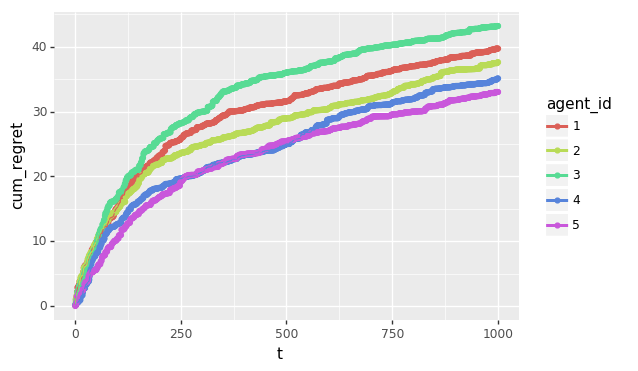

<ggplot: (8730286314145)>


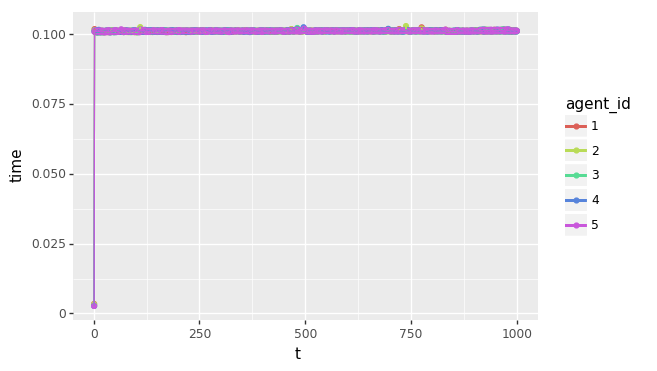

<ggplot: (8730389759205)>
theta [ 1.62434536 -0.61175641 -0.52817175 -1.07296862  0.86540763 -2.3015387
  1.74481176 -0.7612069   0.3190391  -0.24937038  1.46210794 -2.06014071
 -0.3224172  -0.38405435  1.13376944 -1.09989127 -0.17242821 -0.87785842
  0.04221375  0.58281521 -1.10061918]
Experiment: Step 0
 Sample: array([-1.65072127, -0.89055558, -1.1191154 ,  1.9560789 , -0.3264995 ,
       -1.34267579,  1.11438298, -0.58652394, -1.23685338,  0.87583893,
        0.62336218, -0.43495668,  1.40754   ,  0.12910158,  1.6169496 ,
        0.50274088,  1.55880554,  0.1094027 , -1.2197444 ,  2.44936865,
       -0.54577417])
 Steps taken: 0
 Sample: array([-0.19883786, -0.7003985 , -0.20339445,  0.24266944,  0.20183018,
        0.66102029,  1.79215821, -0.12046457, -1.23312074, -1.18231813,
       -0.66575452, -1.67419581,  0.82502982, -0.49821356, -0.31098498,
       -0.00189148, -1.39662042, -0.86131636,  0.67471153,  0.61853913,
       -0.44317193])
 Steps taken: 0
 Sample: array([ 1.810534

 Sample: array([ 0.1938496 , -0.25223983, -0.94920319,  1.41204405,  1.37510751,
        1.19665672, -0.94587549,  1.6602458 ,  1.32499454, -1.11836665,
        0.36927146, -1.93896597,  1.01865953,  0.65772951,  1.1777685 ,
        1.30457294,  0.87814025, -0.71583968, -0.32839317, -0.31223603,
       -0.41791397])
 Steps taken: 1227
Experiment: Step 5
 Sample: array([ 0.39542012, -0.71024167, -0.5789393 ,  2.78513264,  0.78370369,
       -0.42266734,  0.78843538,  1.84707767,  0.33369499,  0.65826995,
       -0.6060349 , -1.04131325,  0.13696674, -0.50463704,  0.3523262 ,
       -0.3770701 , -0.45773786, -0.56479019,  2.20911055,  0.39051643,
       -1.03551852])
 Steps taken: 1228
 Sample: array([ 0.56253992,  0.04785884,  0.30806208, -0.26390667,  0.66887827,
       -1.12092722,  0.09958635,  1.19854516,  0.81317212,  1.50108536,
       -1.68964483, -1.37519128,  0.60376312, -0.89131113,  0.46256069,
       -1.48331165, -1.05309594, -0.8377812 ,  0.4024603 , -0.19421458,
        0.

 Sample: array([ 1.05801031, -0.02376325, -1.46874994, -0.62708487,  0.98069684,
        0.89445602, -0.31726725, -0.12116115, -0.05586495, -2.2012693 ,
       -0.06944574, -0.98761542, -0.69511919, -1.02318136,  2.29141603,
        0.54461558, -0.9851813 ,  0.04976642,  2.09597777,  0.46977045,
        0.84947928])
 Steps taken: 1175
Experiment: Step 10
 Sample: array([ 0.1716997 , -1.02581503,  0.53535128, -0.41305891,  0.11839274,
       -1.54194253,  0.15317696, -1.78503455,  0.1924328 , -0.48595578,
        0.43078111, -0.62813496, -1.18356545, -0.04161345,  0.58621723,
        0.5778685 , -1.22474618,  0.42036664,  0.16105225,  0.46641679,
       -2.59429584])
 Steps taken: 1160
 Sample: array([ 1.8227276 , -1.62922856, -0.06878328, -3.38779443,  1.27069582,
       -0.13179078,  0.08507916, -0.63716928, -1.09528316,  0.1734843 ,
        0.05592335, -0.97510884, -0.33252782, -1.56777939,  0.2764493 ,
        1.2469724 ,  1.70039709, -0.4098477 , -0.32686219,  0.57564352,
       -0

 Sample: array([ 0.97309142,  0.13266241, -0.62127432,  2.13544504,  1.58572197,
       -1.53761785,  1.14212491,  0.3335886 , -1.37490193,  0.09545554,
       -0.0905199 ,  0.00360655, -1.01070975, -1.19103448,  0.69591128,
       -0.18063632, -0.17196918,  1.03089014,  0.96538198, -1.66729737,
        1.74743526])
 Steps taken: 1142
 Sample: array([ 0.63853941,  1.15415808, -1.47502821,  0.34434819,  0.54920473,
       -0.5014582 ,  1.79494167,  0.69779177, -0.19993276, -1.17502376,
        0.42311933, -1.98867773, -0.49117502, -1.48667918,  1.2371427 ,
       -0.85117993,  1.89634456, -0.13996341, -1.09283738, -0.3942478 ,
       -1.10736645])
 Steps taken: 1135
Experiment: Step 15
 Sample: array([ 1.2956961 , -0.2201669 ,  0.50212162, -1.08023318,  0.35549028,
        1.22872588,  0.35777774, -1.194977  , -1.46308389, -0.10665017,
        1.67965599, -0.6727488 , -1.05160504, -0.13670536, -1.0346721 ,
        0.16186397, -1.43683117, -0.22989505, -1.02812849, -0.39807516,
        0

 Sample: array([ 0.78053599, -0.246016  , -1.00732595,  0.53716059,  0.10087376,
        0.52207256,  0.2418648 ,  0.77521904,  1.84141968,  0.23600989,
        0.12541706, -1.88747515, -1.01176098, -0.60831825, -0.67677135,
        1.24027518,  0.6797311 , -0.55514203,  0.43169747,  0.6467077 ,
       -0.01069245])
 Steps taken: 1112
Experiment: Step 20
 Sample: array([ 2.74598985,  0.15466614,  1.86295666, -0.21104239, -0.48855868,
        0.1932046 , -0.51096663, -0.13548024,  0.74603007,  1.04737531,
        1.61804935, -0.60948143, -1.95562295,  0.38996599,  0.04139804,
       -1.254313  , -0.651892  , -0.29653416, -0.43177053,  0.61079503,
        0.35859996])
 Steps taken: 1092
 Sample: array([ 0.66537805,  1.73599736, -0.92676795,  1.69491967, -0.23593085,
       -1.55865905,  0.42879355,  0.60497184, -1.40037008,  0.2281894 ,
       -1.28645875, -0.33903307, -1.12116086, -1.99420379, -0.45254753,
       -0.87484993, -1.43710546, -0.91173165, -1.01626665, -0.62164537,
        1

 Sample: array([ 0.17292829, -0.32557368, -1.81136859,  3.0161901 , -0.78068514,
       -2.57436363, -0.25275334, -1.10148784,  0.93165806, -1.22224596,
       -0.61463617,  0.44679422,  0.13157991, -1.68290916, -0.3643369 ,
        0.57578691, -0.24421607,  0.12852057,  1.36154392,  0.75842992,
       -0.56718076])
 Steps taken: 1076
 Sample: array([ 0.53603072, -1.46163398, -1.37876286,  1.56014257,  0.15154941,
       -0.3713239 ,  1.05813779, -1.10637929, -1.59469893, -1.66545942,
       -0.99685115, -3.41887142,  0.67675218, -0.19729545,  0.23151824,
       -2.04419277,  2.04843671, -0.95338856,  0.61331286,  0.40747404,
        0.17430905])
 Steps taken: 1082
Experiment: Step 25
 Sample: array([ 1.54279596,  0.59357628, -0.24997233, -1.24026956, -0.99139658,
       -2.91766397,  0.2072826 , -0.02843016, -0.58506405, -0.65255808,
        2.57067214, -1.06917625, -0.96065705, -0.40580299, -0.08288023,
        0.36253512, -0.88356708,  0.15190375,  0.57632414,  0.82534358,
       -1

 Sample: array([ 0.89028202, -1.29432778, -0.76322911, -0.23481638,  1.47704496,
       -0.34368754,  1.4544101 , -0.22139472,  0.81947932, -1.33388436,
        0.64567106, -1.64173252, -0.59268045, -0.43826043,  0.94462009,
       -0.40052238,  2.41666029, -0.85801114, -0.87554797,  0.98709337,
       -0.19009065])
 Steps taken: 1022
Experiment: Step 30
 Sample: array([-0.05897751, -0.22943019,  0.64239156, -0.40546291, -0.56583513,
       -1.30866807,  1.45571785,  0.67769221, -0.71385628,  0.77812098,
        0.71661296, -0.48431261, -0.14854054, -0.60669204, -0.39761084,
       -2.82118507, -2.76121496, -1.30743207,  0.66251366,  1.65411353,
       -0.55008154])
 Steps taken: 1005
 Sample: array([ 1.54859172, -0.0189188 , -0.29465105,  1.21185919,  1.31400005,
       -2.51347734,  1.29837876, -0.11162265, -0.63372683, -1.00515096,
        0.97546564, -0.47669504, -0.48922258,  1.1643309 , -0.32479431,
       -1.37089005,  1.2276691 ,  0.37505069, -0.240765  ,  0.21403425,
        0

 Sample: array([ 0.44267735, -0.81499254, -0.78332071, -1.14827054,  0.56051519,
       -1.11962654,  0.62866364,  0.01336274, -1.27309303,  0.18269956,
        0.58705206, -1.57702999,  0.50712477,  0.39865914,  0.04806727,
       -0.55532935, -1.32905806, -0.45434035, -1.25190853,  0.28266036,
        0.6107943 ])
 Steps taken: 802
 Sample: array([ 1.65442997,  0.13697398, -0.94594877,  0.29844248, -0.252321  ,
       -1.08431551,  0.93645801,  0.25084153, -0.54757875, -1.3594219 ,
        0.09792682, -0.07456655, -0.17006526,  0.85198354, -1.52176306,
       -0.54062712, -0.10384367, -1.51543276,  0.46140128,  0.43880495,
        0.91876102])
 Steps taken: 813
 Sample: array([ 1.98121199, -0.03290045, -0.17275893, -0.4038093 , -0.03113669,
       -1.65006666,  0.81117906, -1.68064565, -0.51962959,  0.63025861,
        0.36393911, -0.73814569, -1.01193589,  1.5449859 ,  0.12655863,
       -0.19962692,  0.37840383,  0.96852261, -0.58380846,  0.59252978,
       -1.23028063])
 Steps tak

 Sample: array([ 1.15386783,  0.38819913, -1.17753325,  0.32092579, -0.02854853,
       -1.25277617,  1.16252442, -1.66557431, -1.46591634,  0.36346878,
       -0.70915664, -0.48264303,  1.14192703, -1.68157058, -0.57269061,
       -0.79764794,  1.33554434, -0.24722973,  0.37804616,  0.30491654,
        1.75019994])
 Steps taken: 802
 Sample: array([ 1.44639842, -0.05869245,  0.30705734, -1.53695454, -0.70540198,
       -0.76051972, -1.50512975, -2.63765891,  0.67685465, -0.39509863,
        0.79365779, -0.72188831, -1.06855859,  1.18499054,  1.27140598,
        0.41377458,  0.46064654, -0.9797681 , -0.18267344,  0.43957029,
       -0.04330997])
 Steps taken: 812
 Sample: array([ 1.25975977,  1.33734856,  0.05348194,  1.36306655,  0.81936541,
       -1.44988857,  1.45022958,  0.06464423,  1.94164603,  0.22173515,
        2.36690382, -1.06059716,  0.81772652,  0.40578758,  0.35925845,
        0.36878341, -0.72548672, -0.82750236,  0.74918841, -0.11266818,
       -0.58753176])
 Steps tak

 Sample: array([ 1.9913355 ,  0.95458346,  1.22118352, -1.58258665,  1.47403033,
       -1.6843116 , -0.48150638, -0.62394036,  0.78335455, -1.52104901,
        0.44280284, -0.59087505,  1.62158297,  1.06815379,  0.33490093,
       -1.97528235,  0.69721928,  0.13501599, -1.02929096,  0.09728132,
       -1.23338761])
 Steps taken: 799
 Sample: array([ 1.88423469, -1.01161583,  0.76669738,  0.72727233, -0.12068297,
       -3.17724382,  0.9912053 ,  0.36652438,  0.14227294,  0.86819919,
        1.17356064,  0.64624863,  0.13201914,  0.74164229, -1.48648463,
       -0.13154623, -0.12082114, -0.92739743, -0.54585161,  1.27887809,
        0.89769122])
 Steps taken: 806
 Sample: array([ 0.44707002, -0.26130549,  0.35171063, -0.57232223, -0.27823202,
       -2.72415143,  0.65085437,  1.02793195,  0.37273781, -1.53796092,
        0.39380138, -0.40324765,  0.64078946, -0.47248272,  2.17148185,
       -0.39661679,  0.24365828,  0.78851764,  0.94169052,  1.71307338,
        1.33297106])
 Steps tak

 Sample: array([ 1.94150428,  0.74904065, -0.54837209, -1.17021984,  0.22227982,
       -1.69164258,  1.42056068,  0.31961728,  0.99937861, -0.63395812,
        0.30880406, -1.82845773, -0.45415757,  0.75410794,  1.22074819,
        0.0763427 ,  1.81198859, -0.7359176 ,  1.30675519,  0.62665911,
        0.03331645])
 Steps taken: 795
 Sample: array([ 2.07206079, -2.18108768, -0.32350407, -0.51619788,  1.58952962,
        0.05180187,  0.8359229 , -0.94189614, -0.60306403, -1.31222565,
        1.41952367, -0.67606993, -0.8658827 ,  1.37262095,  0.15320326,
       -0.33814152, -0.01245224, -0.54947957, -1.04967247,  0.40805047,
       -0.11692022])
 Steps taken: 813
 Sample: array([ 0.90651938,  0.37890009, -0.9107984 ,  0.3868569 , -0.0292034 ,
       -1.22174417,  1.29475671,  0.19795885,  1.33654789,  0.33695333,
        0.33982955,  0.58019249, -0.21013198, -0.05494564,  0.3842894 ,
        0.08395669,  0.67816504,  0.81964098,  0.90039195, -0.55149978,
        0.47188206])
 Steps tak

 Sample: array([ 1.46040972, -1.38831226,  0.23439192, -0.04373156,  0.09587491,
       -1.48375404, -0.93765715, -0.62664957, -1.39957848, -1.95183914,
        1.80392846, -1.69159364,  1.24226418,  0.77260208,  0.54247512,
       -1.23756676, -1.00442842, -0.071822  , -0.75175194,  0.42938402,
       -1.90130513])
 Steps taken: 790
 Sample: array([ 1.80986572,  0.29927466, -1.61124106,  0.12266526,  0.17389744,
       -1.3291622 ,  0.26471288,  0.90437285,  1.37048154,  0.11230586,
        1.53108942, -0.71582618,  1.22676811,  0.68003866, -0.10694769,
       -1.35269729, -0.29454694,  1.69001324,  0.69809003,  0.89945203,
       -0.38038881])
 Steps taken: 810
 Sample: array([ 1.30315273, -1.11695201, -0.52541572, -1.1668242 ,  0.78740259,
       -0.89372815,  0.43472109,  0.10195835,  1.40946057, -1.14652029,
        1.74678732, -1.60664089, -0.72561562,  0.87123333,  1.3454783 ,
        0.01603081, -0.17566506,  0.54759932,  0.81189788, -0.42954567,
        0.62184439])
 Steps tak

 Sample: array([ 2.15600923,  0.63788771, -0.8708437 ,  0.29800556, -0.20132168,
       -1.85084859,  1.28876226, -0.90167246, -0.84845685,  0.49143952,
        1.80461979,  0.87962731,  0.2000409 , -1.08397738, -0.09004486,
       -1.11086416,  2.13058296,  0.14894099, -0.85311739, -0.0838635 ,
        0.39694391])
 Steps taken: 790
 Sample: array([ 2.62311185, -1.28358285, -0.08170181,  0.52419964,  0.84815252,
       -1.09577555,  1.15809694, -0.01144861,  0.4411647 ,  1.35329355,
        0.93742036,  0.05501118,  0.51364234,  1.10073887, -0.92776203,
       -0.7492961 ,  0.50333297,  0.56734651,  1.55036308, -1.28220101,
       -1.08209567])
 Steps taken: 806
 Sample: array([ 1.74746108, -1.4368046 ,  0.0911648 ,  1.75675898,  0.64200243,
       -0.57200892,  1.12728736, -0.92302625, -0.241408  ,  2.98695244,
        0.3332923 , -0.87758115,  0.17684358,  1.54274224, -1.97261916,
       -0.7596564 ,  1.03565104, -0.66164008, -0.37066639,  0.76661368,
       -0.83412789])
 Steps tak

 Sample: array([ 0.75051699,  0.40549216, -0.53072484, -0.65359431, -0.31587411,
       -0.78724722, -0.45260321, -1.00103189,  0.47434131,  0.34355321,
        0.81714303, -0.98955976, -0.4965017 , -0.59731919, -0.17023566,
       -0.28133978, -1.02536703, -1.57125559, -0.13056786,  1.01359168,
       -0.87863471])
 Steps taken: 765
 Sample: array([ 1.48975728,  0.59706508, -0.92144862, -0.18084201,  0.52506153,
       -0.00789978,  1.20509567, -0.14479534,  1.20391372, -1.85486855,
        1.99378759, -1.36186638, -1.38285217, -1.82839618,  0.80741008,
       -0.98679582,  1.68165711,  0.84812759,  0.44198565,  0.49795755,
        0.90552101])
 Steps taken: 787
 Sample: array([ 1.37239697, -0.57154803,  1.14969038, -0.93722278,  0.30047135,
       -1.80633273,  0.91525658,  0.20697916, -0.37875581, -1.298936  ,
        0.66701311, -0.56343442, -0.72980223, -0.2229138 ,  1.64336924,
       -0.8556584 ,  0.76460626,  0.00368842, -1.47820469, -0.15903966,
       -0.66095326])
 Steps tak

 Sample: array([ 1.35206061,  0.54920347, -0.34853429, -0.23459066, -0.23159614,
       -1.95876138,  1.84607161, -1.19990185, -0.63599982,  0.63998986,
        0.29333578, -0.01336925, -0.47903401, -0.33522678, -0.33504601,
       -1.60311656,  1.73002212, -0.14021873, -0.73903202,  1.29802857,
       -0.46751896])
 Steps taken: 802
 Sample: array([ 1.74017529, -1.40443797,  0.34885357, -1.66294058, -0.15830898,
       -1.5076817 ,  1.20174528, -0.42397096, -0.52360328, -0.4972634 ,
        0.94557278,  0.229525  , -0.98890816,  0.26425991,  2.04428211,
       -0.6114689 ,  0.49300949,  0.19027149, -0.62392401,  0.6770671 ,
       -1.90292525])
 Steps taken: 813
 Sample: array([ 2.29235182, -0.19667584, -2.06048221,  0.1910269 ,  0.16681919,
       -0.85053812,  0.76817202, -1.13080304,  1.19504418, -0.99500441,
        1.03993384, -0.32022934, -1.12425027, -0.04162172, -0.63143187,
       -2.2898491 ,  0.66411507, -0.89243494,  1.54465596,  1.16247229,
       -0.12004347])
 Steps tak

 Sample: array([ 2.40516679, -2.4699326 , -0.81531812, -1.59240757,  1.307106  ,
       -1.40014776,  0.30549245, -2.16838038, -1.08582085, -0.74013268,
        1.5797132 , -0.61935035,  1.08524467,  1.44058134,  1.90811522,
        0.87728818,  0.95552418,  0.96797424, -1.53015232,  1.62608807,
       -1.11947644])
 Steps taken: 797
 Sample: array([ 1.66421589,  0.10897342,  1.07848269,  0.84668277, -0.90991791,
       -1.54460757,  0.83113934, -0.54983981,  1.61219715, -0.17178878,
       -0.21497597, -0.75296292,  0.89445841,  0.74925909, -0.47427016,
       -1.06773422,  0.17669157, -2.31798752,  1.87881675,  0.90085285,
        1.53837659])
 Steps taken: 812
 Sample: array([ 0.63819096,  0.72819698, -2.66496774,  0.80072997, -0.08670716,
       -1.03298877,  2.56975736, -1.22656785,  0.99034707, -2.57992639,
        0.35504786, -1.38492644, -0.18673156, -1.81968166,  0.81034795,
       -0.15437409,  0.53990759, -1.60560727, -0.39875614,  1.556418  ,
        1.0618073 ])
 Steps tak

 Sample: array([ 1.41005142, -1.86797336, -0.91687168,  0.46826787, -0.39802363,
       -0.43519308,  0.96548361,  0.46111739, -0.69677124,  0.38014684,
        1.31520245, -0.82021893, -0.1231106 ,  0.18719598, -1.02567244,
        0.02929214,  0.01370316, -0.75980958, -0.28887409, -0.8183976 ,
        1.09683132])
 Steps taken: 800
 Sample: array([ 1.58516013, -0.01535652,  0.50676286, -1.20634418, -0.24224199,
       -1.43291873,  1.22995221, -1.25221431, -0.83721367,  0.387958  ,
        0.32948881,  0.34138981,  1.22949005,  1.4939254 ,  1.93711945,
       -0.44064367,  1.55047927, -0.35812038, -0.28233406, -0.08228849,
       -1.40227276])
 Steps taken: 808
 Sample: array([ 1.08431615,  0.5117753 ,  0.17503561, -0.15183133, -0.10449435,
       -2.72702962,  1.0397685 , -2.0301617 ,  1.32333357, -0.82284357,
        1.17385858, -0.28068728,  0.61749209,  0.11590283,  0.09292524,
       -1.2667585 ,  0.15813888, -1.63112405,  1.35707399, -0.33640637,
       -0.9171788 ])
 Steps tak

 Sample: array([ 1.74789576, -0.26776356, -1.15424294, -1.39615757, -1.37555704,
       -2.00996228,  1.53640368,  0.62015542,  1.42667739, -1.68738937,
        0.60120569, -1.02690947,  0.62530994, -1.78907838,  0.76459327,
       -1.32871988, -0.11345414,  0.17264834, -0.94699066, -0.09176235,
       -0.55941411])
 Steps taken: 803
 Sample: array([ 1.20261265, -0.22027282, -1.10405811,  0.47974018,  0.85454639,
       -2.05539885,  1.91963814, -1.49152661,  0.24133177,  0.69517705,
        1.44482779, -2.05697068, -0.78242098,  1.31137606, -0.41823943,
       -0.52992811,  1.53943076, -1.04217846,  0.32829808,  1.16708174,
       -1.70055559])
 Steps taken: 807
 Sample: array([ 1.38257979, -0.57287452, -0.266573  , -0.36034177, -0.52890317,
       -1.49504789,  0.52915902, -0.62917142, -0.38013741, -0.82296248,
       -0.58910998, -0.89307155, -0.16256503,  0.6853997 ,  2.15782085,
       -0.2978963 , -0.1709413 , -0.38487786,  1.27486485,  1.00163983,
       -1.32383323])
 Steps tak

 Sample: array([ 1.87297935, -0.06897463, -0.62763308,  1.51347588,  0.43606409,
       -2.13067927,  2.8110073 , -1.28308882, -1.30367754,  0.59449559,
        1.32503082, -0.0260885 ,  0.04918564, -0.15921152,  0.12155985,
        0.45047462,  1.08742094, -0.02438973,  1.47340338,  0.07082943,
        1.01715312])
 Steps taken: 793
 Sample: array([ 1.62509854, -0.73500884, -0.28936409, -1.96555487, -0.08769041,
       -0.2911097 ,  1.04192717, -3.24576463, -0.76288206, -0.55086137,
       -0.21519961, -0.27715597,  0.22315191,  1.16923434,  1.59646702,
       -0.36178248,  1.64158704, -0.2701049 ,  0.51684876,  0.09068161,
       -0.07812465])
 Steps taken: 811
 Sample: array([ 1.15396075, -0.59483897,  0.65532281,  0.63638058,  0.24178463,
       -1.87493185,  1.46359674, -1.45214146,  0.43301156, -1.27316392,
        0.14796748, -0.0081644 ,  1.22038217,  0.53985636, -0.34507264,
       -0.40556323, -0.87601187, -0.57483672,  1.38423041,  1.22129277,
       -0.03604099])
 Steps tak

 Sample: array([ 1.67057381, -0.30922647,  0.06088887, -1.80410755, -0.44007111,
       -1.17723524,  0.09428026, -1.91737313, -0.68991362, -0.56297658,
        1.63850258, -0.70212096, -1.07556269,  1.32334998, -0.43103063,
       -0.23690108, -0.49692149, -0.2839103 , -0.23876569,  1.4811182 ,
       -2.0705768 ])
 Steps taken: 798
 Sample: array([ 0.5643098 , -0.27460483,  0.87153271, -0.09647336,  0.60368336,
       -2.63081784,  1.18377974, -1.37741281,  1.26348965, -0.88081247,
        1.26182313, -0.67350617,  0.57669574, -0.79750279,  0.29007386,
       -0.76980723, -1.08634999, -1.35265574,  2.19706472, -0.07670697,
        0.11243824])
 Steps taken: 805
 Sample: array([ 1.26866159,  0.48515628, -0.99744076, -1.51189426,  0.66433151,
       -2.68248872,  1.47003435, -0.23569694,  0.84211574, -1.46249173,
        0.11043821, -1.72044382,  1.38795112, -0.05121226,  0.1887345 ,
       -0.97540471, -0.26911419, -0.76980466,  0.31653698, -0.32899398,
        0.01114509])
 Steps tak

 Sample: array([ 2.11976694, -0.31295717,  0.16641979,  0.04871183,  0.60112921,
       -3.10914242,  0.61253156, -0.21476116, -0.52838947,  1.01842382,
        0.44566325, -1.87812691,  2.16346639, -0.70807198, -0.18656874,
       -0.8115731 ,  2.02544686, -1.31549736,  0.24164147,  0.11793033,
        0.4699826 ])
 Steps taken: 803
 Sample: array([ 1.8098108 , -0.32335316, -1.13501458, -1.04365089,  1.13700038,
       -0.82685966,  0.55734678, -1.585184  , -0.23175739, -0.39696916,
        0.61750038,  0.36667351, -0.15523098, -0.17305224,  0.97724047,
       -0.98730799,  0.48660181, -0.50135525, -0.27944478,  1.0671761 ,
       -0.85338157])
 Steps taken: 808
 Sample: array([ 0.99824756, -1.56506176, -0.01250859,  0.2046359 ,  0.59447353,
       -1.80539645,  2.02822812, -1.84217832,  0.97781323, -1.0173957 ,
        1.00769098, -0.53765826,  0.32620223,  1.49937278,  0.4788345 ,
       -1.12388862, -0.69961237, -1.05767614,  0.66586956,  1.06692678,
        0.66947797])
 Steps tak

 Sample: array([ 1.46339726, -1.57250639,  0.43773876, -0.95618719, -1.22858897,
       -0.33250065,  0.59798667, -1.44922948,  1.14309816,  0.55461266,
        1.67249662, -1.62860336,  0.70528182, -0.81150673,  0.26715307,
       -1.04206638, -0.86296825, -0.31066239,  0.40024135,  1.00065318,
       -0.50560683])
 Steps taken: 793
 Sample: array([ 1.70394258, -1.82902321, -0.04977152, -0.14901314,  0.85249039,
       -1.18883444,  0.00634679, -0.4749657 , -0.00498806,  0.51289447,
        0.68894129, -1.376891  ,  0.93598862,  0.06972644,  1.42842607,
       -0.66233004,  0.03761981, -1.17616689, -0.07316511,  0.19402562,
        0.29898556])
 Steps taken: 800
 Sample: array([ 1.36410107,  0.18485946, -0.2656762 , -0.42714877,  1.48342039,
       -0.0115578 ,  2.31113917, -1.13281663,  0.84811714, -0.50790705,
        0.98328922, -1.95103378, -0.33991344,  0.88199008,  1.54029627,
       -0.49949945,  0.18172817, -1.38689764, -0.20279419, -1.14765501,
       -1.95673795])
 Steps tak

 Sample: array([ 1.03660206,  0.01470638,  0.04361652,  0.30348474, -0.37443513,
       -1.74904802,  0.74170346, -0.38971497,  1.09808349, -0.91941356,
        0.87062495, -0.94907218,  0.04402752,  0.63177691,  0.97538108,
       -2.08923047, -0.02896051, -0.76179567, -0.12563124,  1.68126473,
        0.07136375])
 Steps taken: 802
Experiment: Step 110
 Sample: array([ 1.8947109 , -1.54084293, -0.92286573, -0.84883308, -0.44788187,
       -1.07479262,  1.103362  , -0.91902285,  1.52632395,  0.31245683,
        1.19375509, -0.03532866,  0.33327524, -0.97455318,  1.35615224,
       -0.58923583,  0.13631568, -1.21522919,  0.28789075,  0.04579825,
       -1.39514038])
 Steps taken: 802
 Sample: array([ 1.41508743, -1.97765854, -1.33648577,  0.56065977,  0.7039798 ,
       -0.95376699,  0.81133838, -1.46441148, -0.33680665, -0.44016965,
        0.63987637, -0.77460627, -0.16100192, -0.61785166,  0.28623006,
       -0.86838063,  1.60622584,  0.52643897,  0.03338279,  0.70903178,
        0.

 Sample: array([ 1.59193993,  0.26219815,  0.93978497, -1.06340744,  1.61155777,
       -1.30412453,  1.97419763,  0.4857151 ,  1.0479346 ,  0.59149277,
        1.56230429, -0.8932997 , -0.39762287,  0.93765635,  0.6182999 ,
       -0.10261389, -0.39184735, -2.29466607,  0.82728989, -0.19267884,
        0.10254196])
 Steps taken: 803
 Sample: array([ 0.45299285,  1.23302403, -1.46686142,  0.51812367, -1.01536837,
       -1.05620307,  2.03047265,  1.32420938,  0.74956564, -1.1440418 ,
        1.39414876, -1.27587556, -1.05479165, -0.92010667,  0.66591786,
       -1.21569492,  0.56400187, -1.11094957, -0.07400302,  1.05253466,
        1.18061063])
 Steps taken: 804
Experiment: Step 115
 Sample: array([ 1.23983385, -0.45978677,  0.24853461, -0.73698514, -0.09121851,
       -0.2836168 ,  0.24681922, -1.16399077,  1.613646  ,  1.09101694,
        0.65893166, -1.77501409,  0.95563965, -1.16369282,  0.93219364,
       -0.21377527, -1.21948614, -0.77587858, -0.47173933,  1.22159039,
       -0.

 Sample: array([ 1.02289373, -0.04404188,  0.05764187, -0.20512612, -1.37057213,
       -0.87244516,  1.52766086,  0.54057158,  0.70912935,  0.64681177,
        0.35624481, -2.15374496,  0.35189084,  1.12491068, -0.14501776,
       -1.72371786,  0.52973744, -1.21126243, -0.43458476,  1.21120602,
        0.41420117])
 Steps taken: 790
Experiment: Step 120
 Sample: array([ 1.40762393, -1.21331309, -0.09699088, -1.11420569, -0.43907659,
       -2.12001122,  0.31705313, -0.60414143,  1.3129571 , -0.56168894,
        0.89818906, -1.81676276, -1.14860003, -0.82108325,  0.16203037,
        1.38812432, -0.58987836, -0.1356827 , -0.814963  ,  0.68457596,
       -0.88004691])
 Steps taken: 800
 Sample: array([ 0.89324036, -0.51549116,  0.22649115, -0.11118328, -0.48228996,
       -2.73831002,  1.44062336, -0.22927877,  0.19862205, -0.00664126,
        1.91808516, -1.55528319,  0.11487293, -1.31920857, -0.14650387,
       -0.47456084,  0.21562892, -1.49837793,  0.35847316, -0.66137487,
        1.

 Sample: array([ 1.45983664, -0.71288283,  0.62147596,  0.90239018,  0.33344828,
       -1.27809307,  2.32670901, -0.64777818,  0.27533458,  0.46066661,
        0.06282632, -1.97272024,  0.91090701,  0.63747549, -0.06227605,
       -0.59895805,  0.06388553, -1.98048368, -0.0704699 ,  0.77560542,
        0.18512262])
 Steps taken: 795
 Sample: array([ 0.85038263,  0.90671116, -1.30920818,  1.00380651, -1.29261068,
       -0.26933914,  1.62594688, -0.02807556,  1.03976473,  0.10455103,
        0.42540194, -2.4595906 , -1.21486996,  0.60304023,  0.13316729,
       -0.54853376,  0.29972073, -0.16279195,  0.23108064,  1.63715538,
        0.32280382])
 Steps taken: 810
Experiment: Step 125
 Sample: array([ 1.79931116, -0.32046985, -1.46535094, -1.44009426,  0.07966303,
       -0.36990081,  0.56944582, -0.2608575 ,  0.37623455,  0.14475434,
        1.41311429, -0.6952628 ,  1.19032342,  0.18842059,  0.69126499,
       -0.30204349, -0.30692815, -1.63181937, -1.07099789, -0.12159074,
       -0.

 Sample: array([ 1.33115623,  0.5339918 ,  0.09339062, -0.12858985,  0.87003156,
       -1.39646341,  0.55819295, -0.62470441,  0.07195178,  0.03506763,
        1.5397718 , -0.71983464, -1.86034744,  1.11706551,  2.07939575,
       -0.53756948, -0.76740202, -0.65509557, -0.27468397,  0.46845525,
       -0.27126047])
 Steps taken: 788
 Sample: array([ 1.40754531,  0.34212597,  0.30967362,  0.20570695, -1.55308569,
       -2.43506235,  0.80492941, -0.32753911,  1.05787941, -0.14109046,
        0.07013953, -2.28097742,  0.07760535,  0.08307548, -0.3792578 ,
       -1.55362178,  0.43353714, -1.58193595,  0.37792209,  0.98816487,
       -0.26990725])
 Steps taken: 802
 Sample: array([ 1.13798101, -0.01254939, -1.99879117,  0.79718558, -0.69182339,
        0.11352131,  0.59874557, -0.0409558 ,  0.89932354, -0.865207  ,
        0.16789584, -0.83299535, -0.68811397, -0.86369031,  0.17815282,
       -0.96648583,  0.29224069, -0.05725009, -0.29872443,  1.11371938,
       -0.08635339])
 Steps tak

 Sample: array([ 1.90811328,  1.35566104, -1.78088754, -0.1908557 ,  0.06114363,
       -1.7699663 ,  1.8560907 , -0.39848644,  1.19714378,  0.5041855 ,
        0.6011617 , -2.32095581, -0.31631683, -0.28343997,  1.27850448,
       -1.27154083,  0.19131222, -0.54617245, -0.21820305, -0.71421052,
        0.75625042])
 Steps taken: 799
 Sample: array([ 1.77376334e+00,  5.22546050e-01,  9.48519761e-01, -3.50878379e-01,
        1.15050358e-03, -2.86508473e-01, -1.54719562e-01, -1.19343719e+00,
       -1.60578368e-01, -2.70269859e+00,  3.38697085e+00, -1.41831245e+00,
       -7.82178610e-01, -2.14785840e-01,  1.43448903e+00,  2.80015662e-01,
        2.39212253e-01,  3.95271225e-01, -5.68679857e-01,  4.99854659e-01,
       -6.20377197e-01])
 Steps taken: 800
 Sample: array([ 1.89987451, -0.48216672,  0.94215936,  0.84775699,  0.91475103,
       -0.64581045,  0.38815664, -0.53866395, -0.1781067 ,  0.26729925,
       -0.15300708, -1.8117131 , -0.7776785 , -0.41248808, -0.23733084,
       -1.67

 Sample: array([ 1.32607012, -0.73726888, -0.13408153, -0.26631661, -0.77978788,
       -0.92330768,  1.07801947, -1.38724441,  1.90716692, -1.03920001,
        2.75606413, -0.56465508, -0.56378317, -2.03526803,  0.80943718,
       -0.1542615 , -0.42554213, -0.94487777, -1.16651252,  0.00541863,
       -1.40716739])
 Steps taken: 801
 Sample: array([ 1.3583859 , -0.23622485, -1.56023242,  0.21463651,  1.06390563,
       -1.2507329 ,  0.91948628,  0.05799062, -0.4590759 , -0.4527424 ,
        2.23779577, -0.65428383,  1.07125221,  0.18425576,  0.57274   ,
       -0.3928928 ,  0.83247118,  0.82306289,  0.35773621, -0.22106944,
        1.14958659])
 Steps taken: 809
 Sample: array([ 2.22745096, -1.3754099 ,  0.0288247 , -0.48405361, -0.16888025,
       -0.35913156,  0.23337362, -0.91798189,  0.58529861,  0.63770263,
        2.45612071, -0.23980776, -0.37143493, -0.19565244,  0.86114309,
       -0.37034612,  2.01859986, -0.62228904,  0.10440234,  0.6152057 ,
       -1.5109145 ])
 Steps tak

 Sample: array([ 1.23612466, -0.53648827, -1.53553643, -0.35374219,  0.39358446,
       -2.39777926,  1.91158706, -1.40546463,  0.20098131, -0.56426176,
        2.37601605, -0.79975742,  0.26641221, -0.58885957, -1.12683239,
       -0.68764247,  0.22803081, -0.10377904,  0.82347697,  0.3369667 ,
        1.47591609])
 Steps taken: 803
 Sample: array([ 1.21349159,  0.82164438,  0.56093716, -1.15444231,  0.08989414,
       -1.26978396,  0.56370816, -0.9150783 , -0.88918272, -0.37861293,
        0.63549821, -1.4948365 ,  0.44565765,  0.28558853,  1.77837109,
       -0.76663616,  0.80581694, -0.74103976, -0.06215935,  0.59378328,
       -1.11033907])
 Steps taken: 806
 Sample: array([ 1.48624567, -0.80373499,  0.57918739,  0.33497342,  0.45669136,
       -0.90667608,  1.50094806, -1.35669029,  0.60085246, -0.4784865 ,
        0.77750448, -1.13435679,  0.296326  ,  0.94376024, -0.6577376 ,
       -0.95768541, -0.56298897, -1.38512846,  0.65224363,  0.04499117,
       -0.72252307])
 Steps tak

 Sample: array([ 1.44296514, -1.24166473,  0.53561335, -1.0546214 , -0.64904376,
       -1.19233106,  2.12872749, -1.29455064,  2.45037108, -0.14483446,
        2.66507514, -0.00300759,  0.96086967, -1.39361473,  1.26615701,
       -1.00847405, -1.07466216, -1.31896592, -0.43370374,  0.70903694,
       -1.0123739 ])
 Steps taken: 797
 Sample: array([ 1.4828336 , -1.41055901, -1.86282727,  1.5631671 ,  0.17487104,
       -0.64623383,  0.8932395 , -1.130401  , -0.94314372,  0.29146482,
        1.4081963 , -0.27318205,  1.03407345,  0.0216889 , -1.44701121,
       -0.09935676, -0.58640404,  0.00520383,  0.26447863,  0.51268847,
        1.26985683])
 Steps taken: 803
 Sample: array([ 1.73440012, -0.12509641,  1.60254186, -0.25142056, -0.29584488,
       -0.97873918,  0.97899786, -2.09988789, -0.73864874, -1.64467448,
        3.28697922, -1.67507569,  0.40269546, -1.09650565,  1.33497316,
       -1.15972662,  0.29197836,  0.40627166, -0.12816658,  0.89126061,
        0.269031  ])
 Steps tak

 Sample: array([ 1.59038246, -1.59929971,  0.18836613, -0.48832647,  0.90896078,
       -3.19808203,  1.17324235, -0.17218811,  1.72388562,  0.45592788,
        0.32734268, -1.57563582,  0.25848291, -1.35749021,  1.54667303,
       -0.60199793, -0.11866103,  0.674333  ,  0.66052254, -1.17460068,
        1.00123521])
 Steps taken: 801
 Sample: array([ 1.83145897, -0.28656803,  0.02102385, -0.35379787, -0.08074411,
       -0.77541029, -0.25872514, -0.10306181, -1.14102362, -0.71653821,
        2.93684863, -0.91288854, -0.54444641,  1.14754457,  1.11667866,
        0.09714308,  0.97084055, -0.42431885, -1.74959863,  0.46481651,
       -2.36671204])
 Steps taken: 793
 Sample: array([ 1.72949439, -0.47970917,  0.84358657,  0.44051274,  0.80929077,
       -1.47986975,  1.39320216, -0.69829167,  3.24259809, -0.0973203 ,
       -0.04739827, -0.6992907 , -0.95087262,  1.36201963,  0.3828901 ,
       -2.20578441, -2.01850398, -1.85515692,  0.30403479,  1.5853033 ,
       -0.02375246])
 Steps tak

 Sample: array([ 1.76431676, -0.27336502, -0.29618308, -1.20975712,  0.99131448,
        0.43850344, -0.15508213, -0.14449753,  0.74723882, -0.41231664,
        1.82056938, -0.88849264,  0.08551517,  1.13637911,  0.6641666 ,
       -1.72849983,  1.2829425 ,  0.18499039, -0.23001603,  1.63860978,
       -0.26097375])
 Steps taken: 793
 Sample: array([ 1.70009985,  1.76992378, -0.18130609,  0.12522503,  0.93676047,
       -1.43269322,  1.07833178, -0.88710769,  0.79184826, -0.29470994,
        1.19670986, -1.24546846, -0.07560854,  0.22712153, -0.32931653,
       -1.7461751 , -0.37692026, -0.01714321,  0.61587575,  1.40336568,
        0.19325577])
 Steps taken: 799
 Sample: array([ 1.66831012, -0.40482395, -0.25787487,  1.12524509, -1.66075887,
       -1.57032329,  0.55403823,  0.04110501,  0.56324571, -0.53385571,
        1.35020428, -1.27178996,  0.37195755, -0.84869628,  1.38588799,
       -0.66297663, -0.25932335, -1.37836735, -0.40109791,  0.29974345,
        0.06574506])
 Steps tak

 Sample: array([ 1.72985571, -0.55660169, -0.24512897,  1.82959484,  0.69861983,
       -2.10347267,  1.71914976, -0.80577165,  0.35765302,  1.5331681 ,
        1.85787396, -1.37376793,  0.35082251, -0.51263776,  0.73974521,
       -1.26556512, -0.12446087, -1.27354041,  1.15027937,  0.09675651,
        1.93282105])
 Steps taken: 793
 Sample: array([ 1.14817522,  0.43637988,  0.41981126, -0.43031442,  0.50946545,
       -1.063666  ,  0.16448128, -0.99330829, -0.71875195, -0.54065182,
        1.39244475, -1.56659553, -1.54055891,  0.37681367,  1.88756888,
       -1.58368582,  1.17912866,  0.41816014, -0.27610103,  1.30078226,
       -0.73540839])
 Steps taken: 802
 Sample: array([ 1.72825061, -0.16367541,  0.99140816, -0.45973124,  1.59695018,
       -2.65999585,  1.1310382 , -0.55985844,  1.27410375, -0.55655944,
       -0.23851815, -1.45296998,  0.72844353,  0.6330587 , -0.43736599,
       -0.32458451, -0.42445034, -1.0152189 ,  2.07014803,  1.44785965,
       -1.34261423])
 Steps tak

 Sample: array([ 1.42071723, -0.71970588, -0.69111887, -1.09978   , -0.84840633,
       -1.03855868, -1.02046523, -0.59830658,  0.78205408,  0.54371583,
        1.48700071, -0.36249389,  0.05402108, -2.0494573 ,  0.7640877 ,
       -0.7397219 ,  0.24151874,  0.08646285, -0.7484435 ,  1.21553617,
       -1.64599977])
 Steps taken: 787
 Sample: array([ 1.22834981,  0.27059986, -1.13337562,  0.23243354,  0.22639837,
       -2.10033166,  1.38128853, -2.07731761, -0.62635984, -0.14194926,
        0.76237962, -1.59218824,  1.14995544, -0.66518584, -0.1182073 ,
       -1.88470417, -0.9489098 , -0.39504703,  0.05198004,  0.49454344,
       -0.41249028])
 Steps taken: 801
 Sample: array([ 1.77500910e+00, -3.07920714e-01, -4.62430564e-01, -3.62848133e-01,
        5.29184950e-01, -2.95900708e+00,  1.36378728e+00,  4.17288515e-01,
       -1.74998698e+00, -1.00811528e+00,  1.71999231e+00, -1.69008681e+00,
        2.30524599e-01,  5.12874119e-05,  2.20481440e+00, -8.02590533e-01,
        3.20913118e

 Sample: array([ 0.52487528,  0.01125126, -1.79739482,  1.30597206, -1.02421928,
       -2.43941467,  0.39570391, -0.88068422,  0.06286025, -1.28183923,
        0.64296418, -1.43424912, -0.62906808, -0.5392831 ,  1.15205318,
       -0.49902396,  1.5984584 , -0.10819558,  0.47729048,  1.17272596,
        0.77597426])
 Steps taken: 797
Experiment: Step 174
 Sample: array([ 1.64512918, -1.20378292,  0.0924256 , -1.07335985,  1.00368905,
       -0.82644762,  0.76488437, -1.09386888,  1.85573279, -0.58479353,
        2.02857768, -1.20613414,  1.20393971, -0.1152175 ,  1.58419456,
       -0.65091412, -1.23119502, -0.2203931 , -0.45375744,  0.48441455,
       -0.11331233])
 Steps taken: 801
 Sample: array([ 1.87463959, -0.47969863, -0.83626071, -0.05438324,  0.85967345,
       -2.68431153,  1.34977707, -0.45474395,  0.77871615,  0.33521626,
        0.7555277 , -0.77410134,  0.29602459, -1.00427523,  1.72332292,
       -0.1269053 ,  0.10009092, -1.80181595,  0.71562975, -0.44508069,
       -0.

 Sample: array([ 1.07147593, -0.45816954, -0.59130791, -1.30494745,  0.69939117,
       -1.69826454,  1.02174961, -0.37209125,  0.62957336, -0.45659881,
        1.20462041, -1.25139703,  0.07609122,  0.57779455, -0.45758296,
       -0.90805984,  0.38042347, -1.77614395,  0.77466679,  0.62741182,
       -0.73536646])
 Steps taken: 795
 Sample: array([ 1.2476392 , -0.7753603 , -0.63408912,  0.30442549,  0.01537143,
       -0.49788294,  0.17921198, -0.74952272,  1.83241044, -0.04615001,
       -0.1502678 , -1.90806344, -0.30460742, -0.31987225, -0.07596059,
       -0.08685293,  1.27997398, -0.88092201,  0.71271291,  0.83057252,
        0.63879107])
 Steps taken: 806
Experiment: Step 179
 Sample: array([ 1.32141034, -0.57822578, -1.5769415 , -0.47562614,  0.30375055,
       -0.61784821,  1.04956847, -0.55285883,  0.84344837, -1.17385163,
        0.66569687, -0.06324338, -0.04069984, -1.24344921,  0.18127039,
        0.48757425, -1.27476538, -1.10810301,  0.06019822,  0.61688817,
       -0.

 Sample: array([ 1.82878582,  0.21793886,  0.40826588, -0.53044615,  0.8294135 ,
       -0.4438296 , -0.29875589, -0.40835265, -0.67279546, -1.08976125,
        1.83567419, -1.54932278,  0.58828985,  0.1567357 ,  0.41155191,
       -0.43619083,  0.36808066, -0.66587608, -0.43310252,  0.27691419,
       -1.26308535])
 Steps taken: 798
 Sample: array([ 1.20554863,  0.19325612, -0.34404855, -0.36031854, -0.37192097,
       -1.68275641,  1.95304837, -0.81114742,  1.33647099, -0.12647288,
        0.222696  , -0.60185988,  0.18313247,  0.0204462 , -0.79088026,
       -1.72426413, -0.41893595, -0.7875749 ,  0.46837384,  0.61229467,
        0.70923034])
 Steps taken: 807
 Sample: array([ 1.13151023, -0.73505452, -0.88232959, -0.23915969, -0.39949516,
       -2.29565548,  0.86554315, -0.16272302,  0.28710178, -1.47018673,
        1.5241219 , -0.77095322, -0.83250672, -0.83998221,  1.30074116,
       -1.53181845,  0.6775244 , -0.0639625 , -0.20497121,  0.20250436,
       -0.10677969])
 Steps tak

 Sample: array([ 1.63929665, -0.39669595, -0.06924202, -0.00895104,  1.83951304,
       -0.73309089,  2.11282578, -0.3030121 , -1.28992172,  0.85283716,
        0.75306143, -1.62151625,  1.7349603 ,  0.15427896,  1.44267774,
       -0.18147729,  0.70172127, -0.38547701,  0.15719422,  0.66558012,
        0.7364332 ])
 Steps taken: 787
 Sample: array([ 1.8060486 , -0.39798336, -0.4882128 , -0.65149142,  1.13334205,
       -1.11503046,  0.41684964, -1.60999524, -0.87445569, -0.04039931,
        3.92636946, -1.30875948,  1.00401475, -0.77584833,  0.4304949 ,
        0.31370701,  0.05597446, -0.98288509, -0.49926952,  1.06041851,
       -1.13412687])
 Steps taken: 803
 Sample: array([ 1.21749306, -0.06596231,  0.90503126, -0.02283648,  1.25766322,
       -1.55439644,  2.80047618, -1.32786929,  0.53931538, -0.22959435,
        0.80069152, -1.15925237,  0.23573507,  0.15589575,  0.43492816,
       -1.39932819,  0.76324532, -0.34562222,  0.05095942, -0.38569542,
        0.5592815 ])
 Steps tak

 Sample: array([ 1.49658961e+00, -1.02799683e+00, -2.28399211e-01, -5.24839850e-01,
        9.99640680e-01, -6.42615556e-01,  2.93695867e-01, -8.03344710e-01,
       -3.71939940e-01, -7.14797568e-01,  1.96022909e+00, -2.24235819e+00,
        5.70718760e-05,  1.81257047e-01,  1.20117584e+00, -7.18469204e-01,
        2.36323727e-01, -3.27615178e-01, -7.19605810e-01,  6.44562100e-01,
       -6.43265211e-01])
 Steps taken: 795
 Sample: array([ 1.40471114, -0.32193193,  0.13529994, -0.023427  ,  1.19450653,
       -1.8641304 ,  1.33386569, -0.90482807,  0.73885753, -0.12525635,
        0.35027095, -1.65359219, -0.63317248, -0.76639686,  0.12573112,
       -0.05019937, -0.0621573 , -0.6932331 ,  0.87239766, -0.1591129 ,
        0.77893172])
 Steps taken: 796
 Sample: array([ 0.77033198, -0.01157749, -1.16904357, -0.22053235,  0.02404562,
       -0.6041151 ,  1.62390532, -0.86933439, -0.39311157, -1.31631456,
        0.58364659, -1.60116685, -0.15595576, -0.1265996 ,  0.3665505 ,
       -1.60

 Sample: array([ 1.79905219,  0.34387717, -0.22510974,  0.58386004,  0.49910075,
       -1.13746489,  1.22777656, -0.72317862, -0.63521872, -0.27519891,
        1.212685  , -1.77378581,  0.83820266, -0.12623977,  1.04935107,
       -1.84625845,  0.01520539,  0.35035396,  1.45024815, -0.85807484,
       -0.90810881])
 Steps taken: 789
 Sample: array([ 1.64186627, -1.32141147, -0.27864666, -0.47553792,  1.00897814,
       -1.58440583, -0.09477597, -2.02672124, -0.21758244, -0.8112259 ,
        2.73845437, -2.85207168, -0.64357722,  0.24863727,  0.98162911,
       -1.21248806,  0.03104795, -0.93992431, -1.33474105,  0.48679911,
       -1.43990493])
 Steps taken: 805
 Sample: array([ 1.21685149, -0.39067452,  0.082868  , -0.44836133,  1.34844689,
       -0.5756161 ,  1.96136232, -0.8516877 ,  1.19764715, -1.43989227,
        1.39413226, -2.26595547,  0.04056446,  1.06689132,  0.24510648,
       -2.20916273,  0.13352974, -2.51386526,  0.46918683,  0.52836226,
       -0.08319033])
 Steps tak

 Sample: array([ 1.17777034, -0.26174473,  0.75409898,  0.28374623,  0.88640276,
       -1.86610961,  0.60581978, -0.51446169, -0.5282155 ,  0.24880924,
        1.75160574, -2.29707779, -0.85012808, -0.54345647,  1.31595414,
       -1.50749313, -0.01688756, -0.30620536, -1.24381625,  0.56544712,
       -0.6666006 ])
 Steps taken: 776
 Sample: array([ 1.3598237 , -0.87704496, -0.10320939, -1.17786215,  0.87401245,
       -1.75005402,  2.45547639, -1.14038464,  1.12628208, -0.48524691,
        1.39625681, -2.32185011,  0.02219594,  0.12127537,  0.6740459 ,
       -1.53688749,  0.0828358 , -1.39773708,  0.91879377, -0.81902858,
        0.29563568])
 Steps taken: 792
 Sample: array([ 0.74873492,  0.7028685 , -0.14589025,  1.22880719, -0.82855878,
       -2.10941364,  0.92959155, -0.21266666,  1.69920098, -0.87857404,
        1.84943532, -1.44720483, -0.17716483,  0.28036816, -0.37344784,
       -1.21452442,  0.52592406, -2.00546036,  0.34479379,  0.46527847,
        1.30176974])
 Steps tak

 Sample: array([ 1.61127625, -0.6615496 ,  1.48099254, -0.17692391,  1.06468838,
       -2.37578765,  1.10806006, -0.3929369 ,  0.08506299,  0.15899337,
        1.42917112, -1.00704922,  0.05455886,  0.15995064,  0.06688258,
       -0.73961273, -0.37005756, -1.01930443,  0.62249635,  0.23763592,
       -0.73787253])
 Steps taken: 796
 Sample: array([ 1.49161414, -0.13971491, -1.21753934, -0.68072945, -0.01527029,
       -0.07682553, -0.02215972, -1.0482861 ,  0.65155438, -1.16639527,
        1.8605957 , -0.31214806,  0.86718343, -0.30085162,  0.4591948 ,
       -2.01177197, -0.2263482 , -0.91639177, -0.3563124 ,  0.34148482,
        1.26805323])
 Steps taken: 795
Experiment: Step 209
 Sample: array([ 1.8492633 , -2.59469182, -1.14974994, -2.33986192, -0.4028104 ,
       -1.30378742,  1.85236981, -1.01470332,  0.31018397,  1.12722371,
        3.21420016,  0.23993545, -0.20981876,  0.11709493,  1.36786282,
       -0.19988788,  0.98733673, -0.21549394, -1.22941166,  1.13599768,
       -0.

 Sample: array([ 1.22292441, -1.36568669, -0.1035074 , -1.31950396,  1.0378646 ,
       -1.10348999,  0.74961665,  0.29971827, -0.69936436, -0.87570856,
        2.64192742, -2.11330361,  0.89743615,  0.03192783,  1.62690607,
       -0.71691644,  0.49959239, -0.56221041, -0.72619139,  1.88589354,
       -0.0720488 ])
 Steps taken: 791
 Sample: array([ 1.04836035, -0.31280222,  2.04621714,  0.03720403,  1.45670447,
       -2.98295   ,  1.56565531, -0.88216689,  1.57110274,  0.06318715,
        0.97967764, -1.74197114,  0.09504853,  0.42724864, -0.44945107,
       -2.56905321, -0.43953284, -1.18818466,  0.59579512, -0.40814283,
       -0.70444474])
 Steps taken: 799
 Sample: array([ 1.17549566,  0.87347532, -0.88996505, -0.93886219, -0.94649201,
       -0.28716975,  0.4163186 , -0.54887446,  0.50275664, -0.89421912,
        1.23486256, -1.72915768,  0.03057316, -0.44494357,  0.33480848,
       -0.94816838,  0.96459836, -0.56854623,  0.52487493,  0.9257232 ,
        0.53170245])
 Steps tak

 Sample: array([ 1.73637424, -0.06806257, -0.59446391,  0.17824297, -0.06519943,
       -0.70412989,  1.16369179, -1.15621989, -0.44046518, -0.98346874,
        2.44720238, -1.7092395 ,  0.793119  , -0.58554597,  0.50312991,
       -0.79067286,  0.49524569, -0.23913297, -0.14319526,  0.28135512,
        0.72413511])
 Steps taken: 790
 Sample: array([ 1.44422152, -0.66012936,  0.77333322, -1.59427433,  0.56574257,
       -2.19014194,  0.54689227, -0.87877788,  0.13941362,  0.10358604,
        2.85526417, -0.68662469, -0.62201364,  0.20768552,  0.5111934 ,
       -0.56423668,  0.26529815, -1.10571764, -0.6531453 ,  0.7686596 ,
       -0.37944594])
 Steps taken: 801
 Sample: array([ 1.22864297, -0.38347509,  0.43297219, -1.73406679,  1.16523618,
       -1.78922888,  1.10375357, -1.10186194,  0.99490567, -0.9350568 ,
        0.67260805, -1.72806675, -0.32248162,  0.01409996, -0.9205044 ,
       -0.54255909,  0.42913989, -1.77059064, -0.05830574,  1.2962228 ,
       -0.50485767])
 Steps tak

 Sample: array([ 1.60376389, -1.78048271, -1.99497583, -1.31279241, -0.51387486,
       -1.04593567,  0.92617819, -1.40714739,  0.27179508, -0.2380559 ,
        2.4915121 , -1.51486914,  0.90845114, -0.63304943,  0.70574239,
        0.97127146, -1.19220987, -1.177257  ,  0.25206431,  1.04286226,
       -0.22609536])
 Steps taken: 791
 Sample: array([ 1.57593243, -0.43459184, -0.48281422, -0.76015223,  1.04279546,
       -0.68587283,  1.54614787, -1.20205516, -0.15946903, -0.00355875,
        2.00185761, -1.63772675, -0.03365747, -0.40821526,  0.15879106,
       -0.58761766, -0.34762158, -1.25164437,  0.69841453, -0.47533605,
       -0.18817542])
 Steps taken: 800
 Sample: array([ 1.76054662, -1.36914228, -0.02535641, -0.30208163,  0.99254435,
       -2.11368913,  0.27436306,  0.10153489, -0.29409921,  0.5623491 ,
        1.88195738, -1.84463108, -0.47230812, -0.48368616,  0.14986857,
       -2.4347234 ,  1.11124725, -0.22666476, -1.02465905,  1.01850236,
       -1.00074721])
 Steps tak

 Sample: array([ 1.49096965,  0.43189638, -0.66115795,  0.69647162, -0.56042222,
       -2.04638759,  0.11706508, -0.04635809,  0.59273241, -1.06153709,
        1.81872607, -1.88897984,  0.22523156, -0.62172189,  0.53072161,
       -1.24659977,  0.56938807, -1.04808716, -0.61012505,  0.30586413,
        0.1994982 ])
 Steps taken: 789
Experiment: Step 228
 Sample: array([ 1.34629088,  0.51256147,  0.09141932, -1.54066118, -0.0441396 ,
       -1.1784952 ,  1.8166721 , -0.8602535 ,  0.47322491, -0.08063802,
        2.5550141 , -0.48414611,  0.30773341, -0.77944356,  0.16263714,
       -0.91271025, -1.12063544, -0.37704094,  0.26626992, -0.00896844,
       -1.01891157])
 Steps taken: 797
 Sample: array([ 1.96671408, -0.52609077, -1.05512868, -0.86572173,  0.38696024,
       -2.22719597,  1.94896252, -1.50479856,  1.10212835,  0.17235885,
        1.69260841, -0.39270329, -1.21652576,  0.97939457, -1.0891731 ,
       -1.28525173, -1.11525399, -0.7693539 ,  0.87985706, -0.03999491,
        0.

 Sample: array([ 1.04219276, -1.31406765,  0.89372968, -1.59874844, -0.38086224,
       -1.97269002,  1.51520376, -1.14752606,  0.52243876, -0.44223495,
        0.66977307, -1.58232106, -0.75314815,  0.62885485,  0.46414816,
       -0.54931116, -0.19230911, -2.15553599,  1.83499308,  0.12942278,
        0.23972656])
 Steps taken: 787
 Sample: array([ 1.4870329 , -0.62380216, -0.31203683, -0.87484884, -0.22275239,
       -1.93238266,  0.77834392, -0.29003695,  0.84007028, -0.68187713,
        2.66760842, -2.04912832,  0.88711419, -0.42597554,  0.27881585,
       -0.15989983,  0.94345404, -0.97882712,  0.93559143,  0.99594166,
        0.29493213])
 Steps taken: 803
Experiment: Step 233
 Sample: array([ 1.97215367, -0.72262777, -1.22858802, -0.66890314,  0.81519493,
       -1.81714894,  0.47832796, -0.06395787, -0.11319734, -0.18840233,
        3.02043734, -0.8411739 , -0.05388514, -0.35489191, -0.97267257,
       -0.2571691 ,  0.70916226, -1.59668474,  0.21782401,  1.61481893,
       -0.

 Sample: array([ 1.16380184,  0.63050687, -0.47415982, -0.44549208, -0.6207567 ,
       -1.49468268,  0.85020033,  0.06730787,  0.54811254, -0.94525792,
        2.1453823 , -1.14213761,  0.16901299, -0.46340618,  0.80773976,
       -1.93321598, -0.93678756, -1.36608959,  0.09099515,  0.59403196,
        1.23579107])
 Steps taken: 795
Experiment: Step 238
 Sample: array([ 1.78293326, -0.57506224, -0.89652271, -1.75234884, -0.4466654 ,
       -1.1575626 ,  1.08149399, -1.49657999,  0.3721469 , -1.57149925,
        1.14988755, -0.97404519, -0.86591696, -0.68923179,  0.21403965,
       -0.35490956, -1.32520433, -1.47912536, -0.14611211,  1.07008495,
       -1.17089859])
 Steps taken: 797
 Sample: array([ 1.68452907, -0.31894739, -1.34433108, -0.64296351,  0.24917348,
       -1.72138101,  1.47328047, -1.34385395, -0.19270084,  0.20590607,
        0.60337558, -0.51291219,  0.33206926, -0.06499292,  0.85001409,
       -0.68395402,  0.52793763,  0.4623888 , -0.20193281, -0.60256123,
       -0.

 Sample: array([ 1.58754776, -0.60671113, -1.45571528, -0.61001116,  0.60773341,
       -2.34840218, -0.03705506, -2.33337871,  0.27108552, -1.11848387,
        1.88562905, -0.84406155, -0.04427887,  0.70148597,  0.17581279,
       -0.56080401, -1.13706222, -0.7313592 , -0.48373975,  0.24079601,
       -1.1229688 ])
 Steps taken: 789
 Sample: array([ 1.53434466, -0.53663557,  0.1061353 ,  0.22997971,  0.51133943,
       -2.34878007,  1.00995738, -1.23605848,  0.89756285,  0.0651964 ,
        1.05106393, -1.05861226,  0.45715619, -0.42651596,  1.16075642,
       -0.86673497,  0.40302723, -0.02632686,  0.24301059, -0.23044985,
       -0.39338319])
 Steps taken: 781
 Sample: array([ 1.49256305, -1.20779063,  0.6088654 , -2.07310049,  0.20619011,
       -0.69832931, -0.24961348, -1.07167218, -0.43755187,  0.51480442,
        2.23080576, -3.62639689,  0.18342536,  0.02817412,  0.55782745,
       -2.22238635,  0.4825355 ,  0.54804461,  0.08844391,  0.7069287 ,
       -0.51639414])
 Steps tak

 Sample: array([ 0.97744178,  0.10421109, -0.55142811, -0.689693  ,  0.61986831,
       -2.56339338,  1.05007939,  0.1914294 ,  0.91676423, -2.20068357,
        1.4283768 , -2.05121241, -0.64647358, -0.38164437,  0.5120891 ,
       -1.06603934, -0.69943197, -0.53416745,  0.79926351,  1.09262621,
        0.21805983])
 Steps taken: 785
Experiment: Step 248
 Sample: array([ 1.61591394, -0.70808023, -0.54583788, -1.27781953, -0.46241935,
       -1.98711173,  0.48630667, -2.63344458,  0.98350332,  0.41123055,
        3.03544737, -0.77040452, -0.50423991,  0.78728066,  0.57958507,
       -1.09144079, -0.99001664, -0.31952651,  0.25399623,  1.64025957,
       -0.91536758])
 Steps taken: 797
 Sample: array([ 1.56964283, -1.28585424, -1.78932928,  0.15381531,  0.1935641 ,
       -1.79944158,  1.01168586, -1.002462  ,  0.253252  , -1.36449581,
        1.49469762, -0.98223241, -0.28009646, -0.34110742,  0.90526317,
       -0.91071184,  0.14002077, -1.18865816, -0.43918732, -0.76668499,
       -0.

 Sample: array([ 1.48255009, -1.59541035, -0.04950086, -1.09303222,  0.16064636,
       -2.36395744,  0.6106716 , -0.78464476,  0.16112822, -1.32370203,
        2.38002215, -1.48053697,  0.80796833, -0.47812479, -1.59125674,
       -1.66249447, -0.73452898, -0.50358828, -1.54267179,  0.82707987,
       -1.32742721])
 Steps taken: 784
 Sample: array([ 1.71729093, -0.92591432, -1.3502052 , -0.46879855,  0.69358038,
       -0.90603638,  1.56472899, -0.56739669,  0.17121255, -1.25210549,
        2.27459881, -1.85045715,  0.12705417,  0.15995236,  2.13445594,
       -2.23033111,  0.82065012, -1.07965944, -0.64700289, -0.31642895,
       -0.5424487 ])
 Steps taken: 797
 Sample: array([ 1.82617324, -0.58221032, -0.13332502, -1.30175853,  0.81984532,
       -1.80840125,  0.67620424, -2.06280409,  0.9674718 , -0.14463386,
        1.92787079, -1.77543981,  1.37869722,  0.24916978, -0.29275193,
       -1.1022182 , -0.25102846, -0.90077366, -0.00576167,  0.32534013,
       -0.2669727 ])
 Steps tak

 Sample: array([ 1.30329309, -0.43462609, -1.3116964 , -0.75403995, -0.15877198,
       -2.81932572,  1.60318379, -1.23827089, -0.1941638 , -0.45431166,
        1.20877904, -1.22572185, -0.89506949,  0.82193274,  0.72549488,
       -1.18788641, -0.6018891 , -0.74112762, -1.1508806 , -0.01933597,
        0.45423074])
 Steps taken: 782
 Sample: array([ 1.26230758, -0.4833271 ,  0.1790305 , -0.51660617,  0.69746233,
       -2.53378415,  0.84490443, -1.54558085,  1.08328038, -1.21360513,
        2.06424381, -1.96669174, -0.74679274, -0.08505177, -0.30156233,
       -1.68065087,  0.78701257,  0.05508615, -0.98386886,  0.59447093,
       -0.47737192])
 Steps taken: 793
 Sample: array([ 1.5599787 , -1.30528356,  0.28930547, -0.94255821,  1.65467688,
       -1.04214853,  1.00865071, -1.14721947,  2.10364907,  0.97113911,
       -0.00585641, -1.65158576, -1.28227698,  0.24168938,  1.03225471,
       -0.58055151, -0.61764579, -1.12750257,  1.17178933,  1.16695904,
       -0.60634901])
 Steps tak

 Sample: array([ 1.68632982, -0.66932209,  0.2546984 , -0.59192109,  0.0910136 ,
       -0.87012889,  0.71409238, -1.24919472,  0.54465884, -0.45465799,
        2.47705995, -0.30039017, -0.14850558, -0.16919011,  0.70843525,
       -0.90793924, -1.84874037, -1.39075978, -0.47161233, -0.12640544,
       -1.09373553])
 Steps taken: 796
 Sample: array([ 1.60682355, -1.37923462, -1.14141172, -0.85769958,  0.66627222,
       -2.45941773,  2.02671621,  0.37940084,  0.32980152, -0.66456331,
        1.28301371, -1.47987732, -0.38763865,  1.08489131,  1.64845301,
       -1.36978296,  0.73732655, -0.23675726, -0.22614144, -0.01553787,
        0.12071071])
 Steps taken: 797
 Sample: array([ 1.10065506, -1.55776882, -0.02845005, -1.19056222, -0.09740074,
       -1.04819055,  0.81249296, -0.97680462,  0.39986506, -1.1659959 ,
        3.04087227, -3.11348963, -0.36363454,  0.31381668,  0.67284532,
       -0.76337312,  1.60270439, -0.57603611, -0.47599927,  1.44368946,
       -0.87601106])
 Steps tak

 Sample: array([ 1.73750257e+00, -1.69999812e-02, -1.86610089e+00, -1.43165114e+00,
        1.33721250e-03, -2.09744217e+00,  2.65655924e+00, -6.52595856e-01,
       -4.72055332e-01, -1.71492105e-01,  3.25825809e-01, -1.02448820e+00,
       -4.39497204e-01,  5.74311973e-01, -2.44509136e-02, -7.14390658e-01,
        5.18296445e-01, -4.07339504e-01, -3.99464254e-01, -4.91989093e-01,
       -1.13373267e+00])
 Steps taken: 784
 Sample: array([ 1.86474171, -0.67425047, -0.2982855 , -1.1074738 ,  1.1420923 ,
       -1.21027329,  0.97083328, -1.91076881,  0.16367707, -0.06125182,
        1.17121605, -1.45364023, -0.42756088, -0.68718358,  0.0024468 ,
       -1.55236814,  0.55268867, -0.56018006, -1.09344907, -0.05258718,
       -1.81410294])
 Steps taken: 786
 Sample: array([ 1.25988005, -0.04142523,  0.60959238, -1.22849729,  1.30201959,
       -1.85757134,  1.52454344, -0.97899218,  0.41062086, -0.20835174,
       -0.19671433, -1.49962145, -0.29440522,  0.54089969,  1.4134037 ,
       -2.29

 Sample: array([ 1.4516287 , -0.4464391 , -1.44870404, -0.44202624,  0.56552246,
       -2.06106249,  1.05791888, -0.93481623,  0.68443608, -0.03152789,
        2.73452652, -1.36303879,  1.7991996 , -0.36025471, -1.40040966,
       -0.71977852, -0.64949963, -0.31864676,  0.99303106,  0.40081991,
       -0.91581252])
 Steps taken: 766
 Sample: array([ 1.24087486, -0.3252469 , -1.81356276, -0.70089346,  0.70434667,
       -1.19179039,  2.51410486, -0.39394359,  1.19291038, -0.64152031,
        1.58211657, -2.2337082 ,  1.29795287,  0.20061892,  1.60128915,
       -1.38389585,  0.46910377,  0.52957581, -0.02456072, -0.33656409,
        1.19144837])
 Steps taken: 781
 Sample: array([ 1.27296802, -0.41521195,  0.74549552, -2.18692642,  0.82478651,
       -3.01723765,  0.26587584, -0.68225395, -0.27753644,  0.90897087,
        1.12865454, -0.62662451, -1.09300549, -1.34399713,  1.49278925,
       -0.84762149,  0.38705175, -0.20247892, -0.47402679,  0.07375428,
       -0.49365004])
 Steps tak

 Sample: array([ 1.118599  ,  0.17959688, -0.51570437,  0.56614788,  0.07987797,
       -1.56772825,  1.21859439, -0.89407187,  0.10415488, -0.80792821,
        1.30083039, -2.01276527,  0.3137846 , -0.18204852,  0.66245016,
       -1.24899721,  0.16429312,  0.26239039,  0.84638959, -0.48146482,
        0.46194362])
 Steps taken: 757
 Sample: array([ 1.84115585, -1.16932843, -0.11889208, -0.6438305 ,  2.33638572,
       -1.9622282 ,  0.87485117, -0.75996793,  0.64903278, -0.6861689 ,
        1.79713248, -1.51829562,  0.20979588, -0.02346336,  0.54479426,
       -0.21368041,  2.0842887 , -1.6307785 , -0.80881206,  1.0031652 ,
       -0.08436592])
 Steps taken: 764
 Sample: array([ 1.1524797 , -0.35954121, -1.02854278, -0.20943448,  1.22725381,
       -1.05096914,  1.60356709, -1.36230795,  0.63571088,  0.62649735,
        1.6353954 , -1.26018818, -0.86272304,  0.13530071,  0.80443017,
       -0.62980217, -0.08216398, -1.17643358,  1.78136571,  0.39391914,
        0.2153038 ])
 Steps tak

 Sample: array([ 1.85528884, -1.59250554,  0.04305038, -0.88425198,  1.53870231,
       -1.91671088,  0.22642173, -0.26542087, -0.09165735, -0.31254219,
        1.69461274, -2.42916255, -0.65189956,  0.45469393, -1.21846073,
       -0.57400353,  0.85168674, -0.88435944, -0.31073744,  0.5237822 ,
       -0.83410595])
 Steps taken: 753
 Sample: array([ 1.75712499, -0.1069503 , -0.29655991, -1.96851737,  2.1556087 ,
       -2.13323298,  2.16909009, -0.95938848,  0.80407262, -0.81998672,
        0.9947489 , -2.60652516, -0.27790716,  0.86640165,  0.17343836,
       -0.81598356,  0.08314542, -1.18488021,  0.00909774,  0.26429538,
       -0.59467536])
 Steps taken: 770
 Sample: array([ 1.1491068 ,  0.4984575 , -0.64193004, -0.50243798, -0.31143112,
       -1.70562301,  1.90687821, -1.7432503 ,  1.1741341 , -0.6493568 ,
        1.55401158, -2.04552116, -0.27282523,  0.79503925,  1.34246884,
       -1.05942756, -0.32858101, -1.90888171,  1.05314141,  0.6733027 ,
        0.17940687])
 Steps tak

 Sample: array([ 1.30463932,  0.534543  , -1.47996194, -0.49372521,  0.84821397,
       -1.27166138,  1.77174629, -1.25342482,  0.56260348, -1.57693144,
        1.23157205, -1.35951157, -0.00328916, -0.35238361, -0.6832819 ,
       -1.61323832,  0.57712226,  0.63880133, -0.15622649, -0.67701956,
       -0.07950359])
 Steps taken: 758
 Sample: array([ 2.0355502 , -1.96360549, -0.51529657, -0.19556842,  0.20926143,
       -1.89570444,  0.72079867, -1.25487371,  0.0133344 ,  0.49648535,
        2.36567894, -2.3976612 ,  0.22394813, -0.32148637,  0.24785965,
       -1.55854057,  1.73076581, -1.14374412, -0.24636232,  0.3298942 ,
       -1.63269668])
 Steps taken: 756
 Sample: array([ 1.87473418, -0.45710858,  1.48008578, -0.95992516,  1.88054513,
       -1.46572916,  2.34599588, -1.27016453,  1.12642225, -0.01219012,
       -0.05061541, -1.06245952, -1.39286189,  0.64647918,  0.40870238,
       -0.40096436, -0.53117355, -0.97588833,  0.4005003 , -0.17011086,
        0.42302494])
 Steps tak

 Sample: array([ 1.84392908,  0.24141183,  0.71848663, -0.71603239,  1.57154312,
       -2.1577511 ,  1.53283575, -1.93898376,  0.164049  ,  1.0331384 ,
        2.30921824, -1.37472337, -0.87289975, -0.17922185,  1.87896067,
       -1.90697514,  1.33378627,  0.2751871 , -0.49169687,  0.700982  ,
       -1.30957728])
 Steps taken: 751
 Sample: array([ 1.51121785, -0.13637334,  0.23576589, -0.17317523,  2.3857588 ,
       -1.52225394,  1.14899033, -2.2159004 ,  0.09540363, -0.37306354,
        1.11511511, -1.42730244,  0.27936634,  0.07287737,  0.1051388 ,
       -0.73784791,  0.48275624, -1.07478945,  0.7487117 , -0.97295028,
       -0.59137203])
 Steps taken: 755
 Sample: array([ 1.11470479, -0.43558643,  0.40534494, -0.82574643, -0.33487466,
       -2.77972469,  1.58786028, -0.50497121, -0.04052218, -1.54914584,
        1.87775813, -2.11374739, -0.67450679,  0.77892611,  1.23542853,
       -1.66666075,  0.58492621,  0.15601006,  1.60933984,  2.06186751,
        0.58735691])
 Steps tak

 Sample: array([ 1.31949329, -0.87929364, -1.56738764, -0.9999488 , -0.83806242,
       -2.6784506 ,  2.11668973, -0.8381889 ,  0.84625066, -0.45004391,
        1.82863982, -1.33591704,  0.80099963,  0.37653004,  0.28489684,
       -0.98851187, -0.1453471 , -0.95723033,  0.45116129, -0.22820063,
        0.06524083])
 Steps taken: 734
 Sample: array([ 1.41779368, -1.37402678,  0.37068107, -0.7533065 ,  0.39460633,
       -1.441026  ,  1.39754574, -0.76335624, -0.42204585, -0.36169896,
        2.21159414, -2.04941786, -0.55899931, -0.51036562,  1.11929372,
       -0.49349717,  1.04161129, -0.64178732, -0.02597646,  0.97359437,
        0.19235129])
 Steps taken: 760
 Sample: array([ 1.24231994, -0.47471645,  0.95900215, -1.43464751,  1.43562756,
       -1.27532411,  1.61701666, -1.25402264,  1.207509  , -0.26149295,
        0.2298273 , -1.57847059,  0.87778998,  0.16476445,  0.43837043,
       -1.74485413,  0.51203848, -1.56808208,  0.14034867,  1.04046435,
       -0.15049509])
 Steps tak

 Sample: array([ 1.44688172, -0.17475387,  0.15325579, -0.95998663,  1.30136235,
       -1.58064366,  0.66670295, -1.40063079,  0.03415784,  0.38066317,
        1.41592927, -1.88542154, -0.87443557,  0.0484211 ,  0.37882691,
       -1.63179891,  0.77292272, -0.69958641,  0.02591258,  1.10299517,
       -1.01216698])
 Steps taken: 753
 Sample: array([ 1.37148935, -0.92128994,  0.09620537, -1.03864159,  0.82118666,
       -1.65633535,  1.3181925 , -0.90901902,  0.81482908, -0.53938956,
        0.95270669, -2.16495014, -0.43440557,  0.11820315,  0.09349366,
       -0.20725478, -0.29004508, -0.67096111,  0.85703466,  0.12054663,
       -0.20346451])
 Steps taken: 762
 Sample: array([ 1.89932759, -0.12972914, -0.85577556, -0.41576974,  0.32537106,
       -2.06563768,  0.17132395, -1.02172061,  1.15917332, -0.52127954,
        1.03453082, -0.9459226 ,  0.48795125, -0.72995097,  1.58099267,
       -1.4211414 ,  0.99122984, -0.47798978,  0.5432606 ,  0.51551977,
        0.66587425])
 Steps tak

 Sample: array([ 1.84539337,  0.32581323,  0.52168794, -1.16442119,  0.7453055 ,
       -2.21116877,  1.68758894, -0.74961226,  0.9565607 , -1.35532012,
        1.24706416, -1.81778349,  0.66390597, -0.43694615,  1.30806497,
       -1.30605811,  0.09938593, -0.67247001,  0.53677147,  1.39110401,
       -0.89285053])
 Steps taken: 756
 Sample: array([ 1.40316142, -0.01436146, -0.60930405, -0.45577316, -0.77692615,
       -2.03239202,  0.71145122, -0.37822396,  0.72242261, -1.43668172,
        2.0973465 , -1.41580004,  0.61271356,  1.0838671 ,  1.80859035,
       -2.45532355, -1.18828877, -2.11702215,  0.48006264,  0.83353024,
       -0.2775565 ])
 Steps taken: 763
Experiment: Step 309
 Sample: array([ 0.9903631 , -0.78294192, -0.57116568, -1.05775806, -0.18485071,
       -1.6194807 ,  1.48909377, -1.78177098,  1.1302665 , -0.55725011,
        2.50163587, -0.92831993,  0.77188944, -0.7445611 , -0.00804306,
       -0.41703654, -0.18774693, -0.32728042, -0.65827913,  1.57351652,
       -1.

 Sample: array([ 1.60820984,  0.36957037,  0.20876353, -1.06338688, -0.40274188,
       -1.64942086,  1.06735846, -0.59704275,  0.48461787, -0.63243017,
        2.14932491, -1.42679817, -0.82280978,  0.28986152,  1.14772705,
       -0.82202706, -0.44752591, -2.03965207,  0.36291716,  1.00559368,
       -0.7884138 ])
 Steps taken: 758
Experiment: Step 314
 Sample: array([ 2.06409519, -0.2885435 , -0.31979981, -0.9182171 , -0.32308514,
       -2.29151951,  0.93297731, -0.69387184,  0.97015745,  0.15710022,
        1.60135488, -1.3486847 , -0.76599569,  0.86299985,  0.15781025,
       -0.9541594 , -1.16540771, -1.90169672,  0.68140272,  0.58374636,
       -0.45048577])
 Steps taken: 770
 Sample: array([ 1.56279095, -0.52003125, -0.79803265, -0.56105189,  1.1397104 ,
       -1.95380606,  1.34566262, -0.47719609, -0.63299098, -0.90470505,
        0.62383709, -1.08800157,  1.45267261, -1.24031142,  1.22429847,
       -0.84562531, -0.72122721,  0.27599403, -0.22201483, -0.03494666,
       -0.

 Sample: array([ 1.39404888, -1.31096999,  0.40467636, -1.30567864,  0.88737124,
       -1.33321602,  1.16198106, -1.52897497,  0.91700729, -0.34849311,
        1.52565999, -1.28157575,  0.85421479,  0.3023394 ,  0.13172501,
       -1.52877468,  0.08645942, -1.74799416,  0.34905843, -0.62203278,
       -0.2889555 ])
 Steps taken: 753
 Sample: array([ 1.18273787,  1.16665011, -0.66033982, -0.2650268 , -0.19849725,
       -3.00789671,  1.52681021, -0.05640087,  0.76044386, -0.5271591 ,
        1.53839084, -1.3681353 ,  0.39636116,  0.91393177,  0.96019253,
       -1.67208481, -0.26407563, -1.14668713,  0.48478988,  1.08089724,
       -0.26992387])
 Steps taken: 754
Experiment: Step 319
 Sample: array([ 1.85234063, -0.95496361, -0.20996985, -0.34389018,  0.40333179,
       -1.41068429,  1.00224676, -1.05770287,  0.40436312,  0.13255152,
        2.38734178, -0.95841389,  0.44000936, -0.32914536, -0.66766628,
       -1.30401492,  0.2735119 ,  0.54065688, -0.45362783,  0.94988183,
       -1.

 Sample: array([ 2.11779559, -0.82257541, -0.51452382, -0.42696172,  1.29235625,
       -1.70013871,  1.1043092 ,  0.12773412,  0.22540476,  0.02070656,
        1.69752154, -1.28582971, -0.2805171 ,  0.28134055, -0.38409999,
       -1.60910949,  1.23077308, -0.58745768, -0.69926307,  1.15654656,
       -0.68178494])
 Steps taken: 757
 Sample: array([ 1.28444603, -0.38207753, -0.7930556 , -0.63659408,  0.81231698,
       -2.69005428,  1.39485864, -1.51317381,  0.77475596, -0.03113565,
        0.32421139, -2.76818146,  0.43981911,  0.28611698,  0.04230927,
       -1.52856949,  0.35334133, -1.56636862, -0.04945058, -0.01977645,
       -0.40670067])
 Steps taken: 758
 Sample: array([ 0.80111337,  0.06354501, -0.76234621, -0.34668616, -0.1159327 ,
       -3.15894807,  0.69035014, -0.21129287,  0.43897392, -1.24758676,
        1.75217428, -1.64988503,  0.26920127,  0.06893956,  0.44952276,
       -1.41833626,  0.11736983, -1.38793349,  1.17373824, -0.38932267,
        0.58196082])
 Steps tak

 Sample: array([ 1.5930446 ,  0.07779754, -0.43610653, -0.32989998,  1.25760741,
       -2.19410668,  1.65882951, -0.39045553,  0.41004457, -1.16543318,
        2.01573643, -1.28106096, -0.521524  , -0.782021  ,  0.75011678,
       -0.73115885, -1.04792457, -0.8116949 ,  0.66592443, -0.48783047,
        0.40482569])
 Steps taken: 753
 Sample: array([ 1.89220529, -0.48047982, -0.41932975, -2.16841571,  0.60746568,
       -1.68379351,  0.88146694,  0.16097239,  0.10646547,  0.59123853,
        2.74148728, -2.31964011, -0.37479346,  0.40135692,  0.41044163,
       -1.39355824,  0.44166667, -0.70860148, -0.22061802, -0.23937745,
        0.40193362])
 Steps taken: 756
 Sample: array([ 1.5835898 , -0.65771106,  0.51697386, -1.21920827,  2.40219957,
       -1.8476889 ,  1.52444821, -1.32606237,  0.77213623,  0.06227542,
        0.36115566, -1.67358999, -0.24553656, -0.84735424, -0.03068351,
       -0.37069272, -0.43288141, -1.31078941,  1.29829573,  0.20607289,
       -0.7727294 ])
 Steps tak

 Sample: array([ 1.84560097, -1.48587552, -0.45570869, -1.34594435,  0.28676529,
       -0.96968393,  0.52648253, -1.23175847,  0.19707512, -0.1969416 ,
        2.50233313, -1.4586792 ,  0.56169505, -0.40223174, -0.22706807,
       -0.91050975, -0.37857154,  0.07281863,  0.63541571,  0.98866759,
       -0.62163894])
 Steps taken: 749
 Sample: array([ 1.80480503,  0.82548677, -0.4136419 ,  1.1284081 , -0.82118646,
       -1.32515607,  2.10993645, -0.26113472, -0.22549729, -0.8375353 ,
        1.13833622, -1.5121125 , -0.07664225, -0.82553988,  0.97038871,
       -1.41078728,  0.24625289, -0.07103392,  0.03254034, -0.43210645,
        0.3024451 ])
 Steps taken: 763
 Sample: array([ 1.1957316 , -0.30642113,  0.02394581, -1.49728997,  1.4946772 ,
       -2.10989003,  0.7649243 , -0.31568211,  0.01853049, -0.12642599,
        1.6176723 , -2.40057073, -1.18875215, -0.93329425,  0.37988719,
       -2.0105658 ,  0.572717  ,  0.2559596 , -0.46314213,  0.22031125,
       -0.39403651])
 Steps tak

 Sample: array([ 1.56507762, -0.43040758, -1.30737001, -0.71197002,  0.19059339,
       -1.50764644,  2.38703829, -1.3382186 , -0.52670712, -0.30111462,
        2.5099916 , -1.66088273,  0.67100229, -1.09831555,  0.74023997,
       -1.99295587, -1.30158013, -0.17382119, -1.66977589,  0.15417464,
        0.02693388])
 Steps taken: 752
 Sample: array([ 1.72250323, -1.13959797,  0.37588059, -1.60071987,  1.13621363,
       -1.71362494,  0.83806888, -1.04570335, -0.06052902, -0.18026571,
        0.96420464, -3.24343951,  0.22610926, -0.80214442,  0.61219279,
       -1.72815244,  1.17635965,  0.1127686 , -0.72908976,  0.8626106 ,
       -0.32813554])
 Steps taken: 756
 Sample: array([ 1.69805102, -0.53319799,  0.04220449,  0.10153834,  0.85427421,
       -1.92290435,  1.21396123, -0.49744052,  0.86049243, -0.9809094 ,
        0.6424387 , -1.01882333,  0.29950967, -0.47737684,  0.76097654,
       -0.56389425, -0.62035936, -0.67773878,  0.9390136 ,  0.22818485,
       -0.18966657])
 Steps tak

 Sample: array([ 1.73652367, -1.34643628, -1.74432126, -0.9195543 , -0.99110921,
       -2.37840462,  0.42961138, -2.1695891 , -0.92036491, -0.87286686,
        2.30109868, -1.54974407, -0.2115659 , -0.60394914, -1.02976018,
       -0.49679725, -0.90164169, -0.83638192,  0.05970511,  0.59975874,
       -0.87812695])
 Steps taken: 747
 Sample: array([ 1.6912214 ,  0.09477584, -0.98464318,  0.63633968,  0.32422871,
       -2.38433325,  2.70067466, -2.10056475, -0.65472547,  0.23321651,
        0.91447065, -1.4991771 ,  0.30864651, -0.09345819,  0.49894107,
       -0.9959657 , -0.04376647,  0.12154265, -0.64198025, -0.23071675,
       -0.23018633])
 Steps taken: 746
 Sample: array([ 1.73991281, -0.87362189, -0.24802174, -1.78401722,  0.82986748,
       -2.10153663,  0.97316772, -1.20489641,  0.80936356,  1.01405294,
        1.74688417, -2.3704273 , -1.40950745, -0.14151265, -0.04760952,
       -0.84951281,  0.1395121 , -1.24844256, -1.56057138,  0.27515832,
        0.15405113])
 Steps tak

 Sample: array([ 1.85372005,  0.33961016, -0.81454661, -0.92293003,  0.11216591,
       -1.45289561,  1.02850115,  0.10007843,  0.92828409, -0.58154454,
        0.79896331, -1.45587805,  1.00010107, -0.35824464, -0.22634761,
       -1.67928861,  1.17739154, -2.05312073,  0.99679402,  0.82303903,
       -1.10589359])
 Steps taken: 745
Experiment: Step 348
 Sample: array([ 1.73193856, -1.73529189, -0.19028796, -1.3164506 , -0.99812656,
       -1.89627592,  0.3424847 , -1.41124983,  1.33783928,  0.65444346,
        2.10516912, -1.74133161,  0.77633234,  0.73376059, -0.4680703 ,
       -1.12411362,  0.17858994, -0.63384778, -0.95931594,  0.32941427,
       -1.58794953])
 Steps taken: 751
 Sample: array([ 1.62512981,  0.16074163, -1.20836674, -0.25299223,  0.66099406,
       -1.39224255,  2.03540623, -0.66906231,  0.46208613, -1.23191018,
        1.7647384 , -1.03996939, -0.01764577, -0.39390443,  0.11074211,
       -0.3802268 , -0.6583421 , -0.3545959 , -0.45114065, -0.01359192,
       -0.

 Sample: array([ 1.89183973, -0.46486213,  0.25070835, -1.30847655,  0.3365468 ,
       -1.37799073,  1.4875936 , -0.9043949 ,  0.33652043,  0.41302502,
        0.46671862, -2.05585259,  0.02282881, -0.31375477,  0.70867584,
       -1.14822412,  0.39278493, -1.42681669,  0.32323839,  0.12674285,
       -0.47038792])
 Steps taken: 751
 Sample: array([ 1.54022889, -0.19645126,  0.49098808, -1.81400741,  0.33005627,
       -1.57326769,  1.09911444, -0.52425156,  0.18400563, -1.22845723,
        1.85886488, -1.65233197,  0.48987457, -0.49576463,  1.7140415 ,
       -2.44011418,  0.57588866, -0.8046173 , -0.68265197,  0.59452172,
        0.81121106])
 Steps taken: 754
Experiment: Step 353
 Sample: array([ 1.97192421, -1.44056683, -0.92997975, -1.16061266,  0.23621315,
       -1.33802904,  1.39681608, -0.77244332,  0.36056001, -0.47001769,
        1.67495316, -1.71754769,  0.13467882,  0.52161137,  0.81475334,
       -0.18048398, -0.49859846, -1.76028151,  0.46036711, -0.12213849,
       -0.

 Sample: array([ 1.2631248 ,  0.4220009 , -0.95260011, -1.08480599,  0.26944649,
       -2.88341057,  1.78193382, -0.28466561,  0.87732701, -0.09306847,
        2.72510515, -2.24443734,  0.20313857, -0.51246678,  0.73750906,
       -0.21062138, -0.35920373, -1.23441659,  0.03814217,  1.39329229,
       -0.0409658 ])
 Steps taken: 738
Experiment: Step 358
 Sample: array([ 1.18540911, -0.91291911, -0.94073378, -0.84928936,  0.06457223,
       -1.97346666,  0.88548309, -1.3171891 , -0.10656851, -0.03917139,
        2.70306735, -2.07501818,  0.76813855,  0.04930336,  0.0773793 ,
       -1.56335728,  0.3423403 , -0.38014788, -0.43593732,  0.20479355,
       -0.98272258])
 Steps taken: 754
 Sample: array([ 1.79946857,  0.38439663, -0.43615897, -0.01902153,  0.31593449,
       -0.99566145,  1.56528694, -0.27783062,  0.3883774 , -1.414894  ,
        1.57861762, -1.66596741, -0.82356453,  0.92364925,  0.48527817,
       -0.49953679, -0.89723069, -0.5395362 ,  0.25500768, -0.17570087,
        0.

 Sample: array([ 1.7117424 , -1.3671666 , -1.51016726, -2.10526625,  0.60047882,
       -3.10197423,  0.74063799, -2.39199462, -0.25982679,  0.0418741 ,
        2.36858538, -2.08583263, -0.21688456, -0.08233434,  0.39287165,
       -0.95267123, -0.03655915,  0.71921557,  0.48751765,  1.9003011 ,
       -1.38428422])
 Steps taken: 751
 Sample: array([ 1.82328149, -0.80675225, -0.79217862, -0.55347002, -0.17555324,
       -2.0610199 ,  1.3619273 , -1.22133946, -0.20915642, -0.46944462,
        0.383401  , -1.68723942, -0.56075956,  0.06426888,  0.47939015,
       -0.39516211, -0.57815987, -0.62167359,  0.77803254,  0.12504619,
        0.56545777])
 Steps taken: 750
 Sample: array([ 1.87609636, -0.79472777, -0.45556542, -0.94681108,  1.27952343,
       -1.63060078,  0.00786351,  0.36742945,  0.70687051, -0.36689855,
        2.38336921, -3.04552056,  0.63690785,  1.16210307,  1.65744607,
       -1.38415531,  0.50707912, -0.90366105, -0.3021791 ,  1.0614754 ,
       -1.41489801])
 Steps tak

 Sample: array([ 2.30870981, -0.1493257 ,  0.16905873, -0.02061523, -0.10025287,
       -1.95807246,  0.9806203 , -0.31102102,  0.62816545, -1.04848945,
        0.09951011, -1.08986231,  0.69598086,  0.25455927,  1.16096612,
       -1.23218492, -0.69640283, -0.1934654 , -0.2173785 ,  0.87829065,
        0.77201422])
 Steps taken: 747
 Sample: array([ 1.42627188, -1.7302201 , -0.67561732, -0.81664296,  0.62568949,
       -1.5424274 ,  0.433654  , -0.83612191, -0.42229366, -1.28767061,
        2.72072534, -1.82088927, -0.72352517,  0.07829039,  0.20472452,
       -1.78245289,  1.89662616, -0.79055189, -0.96156779,  0.78303738,
       -1.86744071])
 Steps taken: 750
 Sample: array([ 1.98315156, -0.65604964,  0.06037644, -2.03411735,  1.26065297,
       -2.88263164,  0.96181786, -1.40838505,  0.00989301, -0.33063215,
        0.28090891, -2.95786848,  0.96401854, -0.14019383,  1.3200184 ,
        0.13860007, -0.03607552, -1.74844395, -0.48761817, -0.67022114,
       -1.53788272])
 Steps tak

 Sample: array([ 1.28549603, -0.51091483, -0.20490072, -0.35017866, -0.42307804,
       -1.77600216,  0.33494829, -1.18327014,  0.43325915, -0.50523164,
        2.31362003, -1.70427097,  0.07905546, -0.33981677, -0.25200514,
       -1.39869373, -0.61222803, -0.94535397,  0.03673539,  0.91072273,
       -1.44361598])
 Steps taken: 743
 Sample: array([ 1.66711404,  0.63466256, -1.47286921, -0.74338039,  0.0940893 ,
       -0.81080829,  1.37274797, -1.54790573,  0.49752994, -0.86499602,
        1.51276658, -0.20492481, -1.27802865, -0.77612243,  1.55472358,
       -0.99339612, -0.1202171 , -0.29486431, -0.21231085,  0.74518032,
        0.05171174])
 Steps taken: 753
 Sample: array([ 1.59706554, -1.05214077, -0.17751321, -1.52507044,  1.86887362,
       -2.3479677 ,  1.16319435, -1.18256855, -0.94023173,  0.02315181,
        1.36575648, -2.65369166, -0.7633923 ,  0.96321589,  0.48890475,
       -1.20864656,  1.49334495, -0.34946457,  0.13424601,  0.27197233,
       -0.78302009])
 Steps tak

 Sample: array([ 1.75848128, -0.17029091, -0.92956457, -0.13746758,  0.04635369,
       -1.40126584,  1.68121978, -0.85391329, -0.29368508, -0.59353568,
        0.57185525, -1.78757068,  0.46118056,  0.2462576 , -0.30632194,
       -0.55829485, -0.78626743,  0.14110489, -1.0715995 ,  0.1971005 ,
       -1.52819997])
 Steps taken: 749
 Sample: array([ 1.91082098, -1.4215165 ,  0.293375  , -0.74329997,  0.76048039,
       -2.36692806,  1.13873587, -0.20523407, -1.01972348, -0.60390106,
        1.06082485, -1.9839025 ,  1.14210891,  0.63473662,  0.36226852,
       -0.35105594,  1.20023456, -1.1175387 , -0.92353775,  0.95069786,
       -0.79965809])
 Steps taken: 749
 Sample: array([ 1.67110985,  0.48612196,  0.80037028, -1.22804706,  0.55472241,
       -2.5774567 ,  1.18945824, -1.10485449,  1.23380265,  0.25373062,
        0.93426074, -1.30960425,  0.15948577, -0.41956032, -0.81085335,
       -1.07708911, -0.54351106, -0.9274119 , -0.76877271, -0.23269574,
       -0.81243069])
 Steps tak

 Sample: array([ 1.70784321, -0.30040819, -0.1141729 , -0.31853004,  1.97666058,
       -2.58223971,  0.50045317, -0.60429182,  0.07366905, -0.4816667 ,
        2.24592193, -2.17340664,  0.6619573 , -0.7684601 , -0.27716541,
       -1.00242906,  1.05361826, -0.36686559, -1.41848031,  1.50647804,
       -1.43075873])
 Steps taken: 737
 Sample: array([ 1.96827589,  0.04797554,  1.02306694, -0.94713873,  1.20386243,
       -1.66091633,  1.6271682 , -1.81757281, -0.034671  , -0.07704928,
        0.51869546, -1.7561397 , -0.8932828 , -0.47803898,  0.59513579,
       -0.13452156,  0.60088395, -1.0999064 ,  0.07316185,  0.46893122,
       -0.41734462])
 Steps taken: 751
 Sample: array([ 1.75746754,  0.79739203, -0.26975624, -0.4267122 ,  0.20515257,
       -2.37524536,  0.33059116, -0.706092  ,  0.61862641, -0.92833544,
        1.30890409, -1.83415831,  0.23160728, -0.45580651,  1.5409811 ,
       -0.82810519,  0.25788109, -1.06110147, -0.33013808,  0.04210762,
       -0.24098085])
 Steps tak

 Sample: array([ 1.32544676, -0.30643401, -0.08845101, -0.17768499,  1.13954555,
       -2.34436749,  1.40010333, -0.93399854,  1.20073728, -1.4661234 ,
        2.64042686, -2.59699795,  0.22177798, -0.11601495,  0.3627387 ,
       -2.03888004,  0.09661295, -0.05219561, -0.0936093 , -0.04912486,
        0.99609617])
 Steps taken: 739
 Sample: array([ 2.06062639e+00, -7.18712176e-01,  4.39975638e-01, -1.16591316e+00,
        1.07463372e+00, -2.61795306e+00,  5.21679339e-01, -1.97947096e-01,
       -1.93693295e-03, -4.26896383e-01,  1.77812578e+00, -2.20804147e+00,
       -5.64478633e-01, -1.09984472e+00, -7.98896480e-01, -6.58406753e-01,
        1.61662102e+00,  3.16020008e-01, -6.05373020e-01,  1.50081659e+00,
       -6.28863817e-01])
 Steps taken: 744
 Sample: array([ 1.78914456, -1.12220154,  0.26864168, -1.24193044,  1.06075136,
       -0.33686001,  1.82898801, -0.98934882,  0.43926929, -0.55655978,
        0.7987591 , -1.79013955,  0.32684119, -0.20723822,  0.68599419,
       -0.53

 Sample: array([ 1.79169819, -1.13172351, -1.13332216, -0.05930294, -0.89701999,
       -3.08207224,  0.89037817, -1.17751243, -0.35318027, -0.97536303,
        1.58143893, -1.64062622,  0.7014681 , -0.61201407, -0.52593118,
       -0.71048629,  0.29698348, -0.42319996, -1.03581496,  0.19415836,
       -1.3698252 ])
 Steps taken: 740
 Sample: array([ 1.81833706e+00,  4.28631815e-04, -6.23659083e-01, -8.80816214e-01,
        6.71976459e-01, -1.93266536e+00,  1.19829611e+00, -4.39009771e-01,
        2.81159661e-01, -7.77435149e-01,  7.80954817e-01, -2.18903767e+00,
       -9.66032212e-01,  3.00870485e-02, -1.94193203e-01, -3.93731381e-02,
       -3.40371157e-01, -1.51108078e-01,  4.85102197e-01,  8.10158679e-01,
        5.42957163e-01])
 Steps taken: 750
 Sample: array([ 1.96716737, -1.05182321, -0.28951836, -1.16883168,  1.04426196,
       -1.36602769,  0.64659823, -1.63875636, -0.66132791,  0.32016349,
        1.62703981, -2.76432945, -0.180328  , -0.96437311,  0.51633209,
       -0.95

 Sample: array([ 1.46648608,  0.33389174, -1.26383923, -1.14862484,  0.00836113,
       -1.65743063,  1.51995471, -0.29542189,  0.35064658, -0.48888187,
        0.62008529, -1.67870784,  0.83156139,  0.34960839,  0.00619085,
       -0.67851214, -0.1221215 , -0.86336074,  1.11064061,  0.77474085,
        0.0512089 ])
 Steps taken: 736
Experiment: Step 398
 Sample: array([ 1.80700458, -1.01641835, -0.05105372, -1.08343372, -0.28605693,
       -1.87425096,  0.32567772, -1.21759514,  0.33602386,  0.13248045,
        1.58154267, -0.65273499,  0.24109305, -0.29818164,  1.51086466,
       -0.99455665,  0.46898082, -1.32380689,  0.25795431,  0.90099334,
       -0.34661447])
 Steps taken: 746
 Sample: array([ 1.40048799e+00, -4.85584339e-01, -6.89932799e-01, -7.02153142e-01,
        1.02898181e+00, -1.87429812e+00,  1.59746110e+00, -3.48255610e-01,
        9.08979355e-01, -1.49636266e+00,  1.80041644e+00, -1.71886095e+00,
        3.02685292e-01, -2.18278246e-01,  5.38049404e-01, -1.04309245e+00

 Sample: array([ 1.52119366, -0.78612744,  1.35169794, -1.95307529,  0.08008473,
       -2.35416023,  1.43817778, -0.46449041,  0.6825555 , -1.02610324,
        1.2618079 , -1.79815355, -0.45633433, -0.85463471,  0.94530806,
       -1.00452139, -0.2068265 , -0.71113106,  0.38095418,  0.19564142,
       -0.13485019])
 Steps taken: 732
 Sample: array([ 1.50493999,  0.03271171, -0.2952133 , -0.1279919 , -0.59185994,
       -1.50615448,  1.32861026, -0.12248949, -0.33479336,  1.09872   ,
        1.05017633, -2.18842747, -0.5682018 , -0.34373507,  0.68390092,
       -1.21663878, -0.38306223,  0.08411584,  1.22103388,  1.27936173,
       -0.19987644])
 Steps taken: 744
Experiment: Step 403
 Sample: array([ 1.72463966, -1.23280448,  0.34119082, -0.85729853, -0.07946004,
       -1.28439231,  1.01982711, -0.23560582,  0.32607235,  0.20287733,
        2.33309303, -1.05033765,  0.15421648,  0.23569976,  0.00461045,
       -0.84116072, -0.09798931,  0.36189251,  0.87942789,  1.12372875,
       -1.

 Sample: array([ 1.59192503, -0.099882  , -0.1859508 , -0.6122146 , -0.21523279,
       -2.16999163,  1.46784139, -0.71412374, -0.11531256, -0.38394684,
        1.56220164, -1.74355886, -0.52811742,  0.0630468 ,  0.9461973 ,
       -1.65818452,  1.73360176, -1.77833297,  0.16631117,  0.14872217,
        0.40144731])
 Steps taken: 741
Experiment: Step 408
 Sample: array([ 1.95251091, -0.93841185, -0.17507606, -1.28343791, -0.14188796,
       -1.51243682,  1.23444541, -2.25813094,  0.08625629, -0.74132436,
        2.30940528, -1.83018782,  0.31602956, -0.31235   , -0.25063564,
       -1.34879633,  1.11917479, -0.43764637,  0.20420636,  0.56947363,
       -2.19046407])
 Steps taken: 738
 Sample: array([ 1.8024541 ,  0.17846764,  0.11692673,  0.45959465,  0.86246885,
       -1.78087861,  1.68793276, -1.43836237, -1.29118216,  0.28238845,
        2.39883722, -2.27654803, -0.16783667,  0.38462718,  0.32935246,
       -0.58386268, -0.36674543, -1.3358193 , -0.31158454,  1.39755997,
       -0.

 Sample: array([ 1.62036209e+00, -1.17199737e+00,  1.20232341e+00, -1.00371941e+00,
        1.32613971e+00, -3.20125759e+00,  2.00662195e+00, -9.71682142e-01,
        1.12888271e+00, -4.38697243e-02,  1.29794074e+00, -3.41843799e+00,
       -2.43027468e-03, -1.13155951e+00,  7.59643281e-01, -1.17152500e+00,
       -6.62826267e-01, -1.88685673e+00, -2.74520839e-02,  6.35818321e-01,
        4.59939658e-01])
 Steps taken: 745
 Sample: array([ 1.6473068 ,  0.23246734, -1.0560883 , -1.16921054,  0.83980413,
       -0.99800996,  0.85329404, -0.87381078, -0.21180862, -1.15995638,
        1.34654422, -3.04820327, -0.07522782, -0.18421052,  0.22313478,
       -0.19220541,  0.23114539, -0.61421972,  0.32934442,  0.76524136,
        0.85069655])
 Steps taken: 745
Experiment: Step 413
 Sample: array([ 1.35614027, -1.10845714, -0.82213771, -0.93627518, -0.34478319,
       -1.85646315,  1.61500485, -1.46211136,  0.69733312, -0.66707406,
        2.24357013, -1.94916016, -0.61041198, -0.54115684, -0.1

 Sample: array([ 1.97672081, -0.13322894,  0.32723602, -1.28834724,  1.32811503,
       -1.44275409,  0.26321501, -1.28644766, -0.02131444,  0.63931661,
        1.05295097, -1.11667528,  0.06298733, -0.24970556,  0.09277185,
       -1.16526749,  1.37686184, -0.25249965, -0.86913339,  0.28729766,
       -0.92186324])
 Steps taken: 737
 Sample: array([ 1.62130815,  0.40310322,  0.29307025, -0.99663005,  2.45670732,
       -2.38592869,  0.80639215, -0.36919735,  1.18650985, -0.38195144,
        0.8746643 , -1.69323667,  0.47906326, -0.01882545,  0.28450045,
       -1.57022412, -0.15474165, -0.59530599,  0.23532228,  0.69480273,
       -0.25474027])
 Steps taken: 749
 Sample: array([ 1.82535836,  1.0439424 , -0.5035132 , -0.63132203, -0.13044475,
       -1.83120513,  0.55519549, -0.69472708, -0.49466872, -1.08565553,
        1.96405605, -1.34107357, -0.93314504, -0.59985791,  1.04410789,
       -1.24795925,  0.03623535, -1.4714738 ,  0.55485041,  0.2245254 ,
        0.17335481])
 Steps tak

 Sample: array([ 1.60182189, -0.0221737 , -0.04355219,  0.51242865,  0.04912584,
       -2.10926826,  1.84515986, -0.59030297, -0.20586915, -1.37468212,
        2.44324273, -1.80751636,  0.73587826, -0.17075794,  0.45228915,
       -0.87003605, -0.05798918, -0.71463683, -0.00536307,  0.49947582,
       -0.49742977])
 Steps taken: 734
 Sample: array([ 2.35028884, -1.71643442,  0.21780091, -0.82861273,  0.98701418,
       -1.31790012,  0.02294244, -0.72089898, -0.03168298, -0.3111259 ,
        1.71264328, -2.40168755,  0.34943608, -0.57164695,  0.6111367 ,
       -1.72604511,  1.67066374, -0.70035694,  0.58487761,  0.96726516,
       -1.63740742])
 Steps taken: 744
 Sample: array([ 1.53347871, -0.97622631,  0.88167011, -1.35497891,  0.67837084,
       -3.21519204,  1.8966886 , -1.10025056,  1.11724873,  0.19666573,
        1.60193388, -1.43967928,  0.34574995, -0.48662365,  0.69242814,
       -0.66094819,  0.10362879, -0.12970324,  1.32548584, -0.65790333,
       -0.59859154])
 Steps tak

 Sample: array([ 1.76365396, -1.57009579,  1.50139747, -0.46419178,  1.9814563 ,
       -2.75878388,  0.25740102, -0.72215209,  0.37896536,  0.01626326,
        1.69771334, -2.70431516, -0.58696375, -0.27517043,  0.49352204,
       -2.02810281,  2.1479033 , -0.93278021, -1.17683105,  0.64885515,
       -0.79909466])
 Steps taken: 732
 Sample: array([ 1.42770353,  0.17572844,  0.53006015, -0.431079  ,  2.03045898,
       -2.51321586,  1.94362355, -0.74132836,  1.15349385,  0.39867724,
        1.01253973, -2.48375666, -0.20750736, -0.69812696,  0.2797395 ,
       -0.92150817, -0.54320454, -1.69549158,  1.18730094,  0.4023517 ,
       -0.09766057])
 Steps taken: 746
 Sample: array([ 1.60057843, -0.58339834,  0.38800167, -1.66991925,  0.24006944,
       -2.70242857,  0.45927804,  0.52017552,  0.78139658, -1.50217098,
        1.35371787, -2.11621556,  0.28632037, -1.0604481 ,  0.63827228,
       -0.56087737,  0.34681996, -1.08680451,  0.14208392,  1.82734735,
       -0.19425839])
 Steps tak

 Sample: array([ 1.55828491,  0.66404446, -1.20455903,  0.05317873,  0.48292294,
       -1.96031965,  1.13437968, -0.44395821,  0.41409671, -1.34107358,
        0.93158581, -1.76679305,  0.73097095, -0.53442646,  0.80034295,
       -2.10107074, -0.11925372, -0.67265479, -0.52494875,  0.67844211,
        0.05284799])
 Steps taken: 733
 Sample: array([ 2.12671791, -0.97221896, -0.13642556, -0.93292384,  1.52249165,
       -1.45245521,  0.88479169, -1.14659974,  0.19460768, -0.26376282,
        1.30032476, -1.98098174, -1.33271884, -0.14881464, -0.28014816,
       -2.45566509,  0.51921237, -1.38650291,  0.1835028 ,  1.92934501,
       -0.78865792])
 Steps taken: 743
 Sample: array([ 1.43772736, -1.88287349, -0.26067428, -0.66414217,  1.13645506,
       -2.40020766,  1.4780433 , -1.38102988,  0.44506871, -0.60110374,
        0.45099235, -2.24006407, -0.14735646,  1.28521813, -0.37894393,
       -1.1897431 , -0.27736297, -1.44320393,  0.83935636,  0.37184141,
       -0.92289962])
 Steps tak

 Sample: array([ 1.62738435,  0.01208369, -0.72514453, -0.42581753,  1.53928981,
       -1.36021638,  0.6368281 , -1.06986634, -0.97831986,  0.03125522,
        1.15177166, -1.24340877, -0.38322447, -0.01498858,  0.08328839,
       -1.5573478 ,  1.28168759, -0.63287953, -1.71048163,  0.907309  ,
       -0.55755176])
 Steps taken: 737
 Sample: array([ 1.4294685 ,  0.39598334,  0.15334528, -0.95120092,  1.87435799,
       -1.1728636 ,  1.72395198, -0.64837796,  1.15866411, -0.25977083,
        1.03482278, -2.25966811,  0.78405644,  0.17736103, -0.73490509,
       -1.38470827, -0.28147988, -0.72206957, -0.20927231, -0.00557641,
       -1.78429534])
 Steps taken: 735
 Sample: array([ 1.42974174, -0.37361016, -0.72730744, -0.13116763, -0.18091255,
       -2.16439252,  0.70420729, -0.86717938,  0.24811463, -1.19219701,
        1.6605018 , -1.50598355,  0.18428376, -0.48183795,  1.1508827 ,
       -1.04290686,  0.46125048, -0.96143318,  0.03885005,  0.8607169 ,
       -0.63947518])
 Steps tak

 Sample: array([ 1.86037848, -0.33382607, -0.26306791, -0.15860541,  0.51281762,
       -2.22122771,  1.79115063, -1.59264106,  0.29767717, -0.7025222 ,
        1.01364529, -2.11087304,  0.28438468, -0.4787111 , -0.47690858,
       -1.09245174, -0.11651518, -0.4635662 , -0.36279122,  0.26707164,
       -0.4368709 ])
 Steps taken: 736
 Sample: array([ 1.7905239 , -1.6112039 , -0.27016113, -0.8212072 ,  0.67436795,
       -2.13967448,  0.95426148, -0.67011164, -1.1427824 , -0.01489322,
        1.70894337, -2.52499128, -0.87191687, -0.89775163,  1.26568924,
       -1.89183593,  0.99047565, -0.84988628, -0.49145736,  0.47582491,
       -0.14349165])
 Steps taken: 748
 Sample: array([ 1.3934697 ,  0.13761946, -0.20910785, -1.63660685, -0.13438463,
       -1.94336393,  2.6747298 , -1.20106505,  0.28235786,  0.68532888,
        1.08020546, -1.3416622 ,  0.25138475, -0.05483639,  0.57391325,
       -1.65295989, -0.69573156, -1.40848852, -0.41225976,  0.76531401,
       -0.39636944])
 Steps tak

 Sample: array([ 1.56948047, -0.99755871,  0.71118701, -1.52155995,  1.64335989,
       -0.77406464,  1.48675832, -1.33018752, -0.67950917,  0.3083119 ,
        1.63088419, -1.54034117, -0.59989074, -0.58895662,  1.26360333,
       -1.36366794,  0.33496517, -1.32821597, -0.77780175,  0.00555268,
       -0.80676872])
 Steps taken: 738
 Sample: array([ 1.29368111, -0.56141421,  0.84286978, -1.13660561,  1.32299599,
       -1.2886274 ,  2.05277465, -1.58551962,  0.81950468,  0.32997661,
        1.79098665, -1.74167595, -0.34891151, -0.21407013,  0.56832764,
       -1.77859112,  0.1700521 , -1.79828457,  0.44733492, -0.92752591,
       -0.64577948])
 Steps taken: 744
 Sample: array([ 1.09974253,  0.05339958, -0.55186487, -1.01806669,  0.61357934,
       -3.28212912,  1.73689117,  0.50353135,  0.72411948, -1.38632141,
        1.37607383, -2.05180635,  0.83748915, -0.84380099,  0.85992065,
       -1.09387453,  1.26970743, -1.31494998,  0.10567098,  0.51127433,
       -0.02756765])
 Steps tak

 Sample: array([ 1.82440590e+00,  1.90469539e-03,  6.93594205e-01, -5.57009405e-01,
        1.50653085e+00, -1.38236826e+00,  2.36202089e+00, -5.22484903e-01,
        8.00909445e-01,  3.60840422e-01,  5.47395317e-01, -1.23237469e+00,
       -2.03108122e-01, -7.33599887e-01,  6.59302253e-01, -6.31456936e-01,
        2.39899689e-01, -6.64795248e-01,  1.80441718e-01,  2.14998145e-01,
       -2.60093543e-01])
 Steps taken: 735
 Sample: array([ 1.21844349,  0.71742834, -0.99697876, -0.31246329, -0.99037377,
       -2.16845311,  1.22527985, -1.1564598 ,  0.69188983, -0.94567156,
        1.86503048, -2.73403797,  0.96982459, -0.77555449,  0.7053052 ,
       -0.2840357 , -0.06774422, -1.6121327 ,  0.92111483,  1.32145539,
        0.35779723])
 Steps taken: 740
Experiment: Step 453
 Sample: array([ 1.62819092, -1.51135789,  0.12774949, -0.72536151, -0.53948598,
       -1.66448617,  0.98031224, -1.9680048 ,  1.37957015, -0.11884276,
        1.11422084, -0.70497943, -0.43910517, -0.45521143,  0.3

 Sample: array([ 1.95091885, -0.29730518, -0.6520699 , -1.57671921,  1.07730582,
       -2.15989624,  1.37967374, -1.36333903, -0.96478911, -0.31972304,
        1.10097013, -1.32555026, -1.41087447, -1.79780214,  0.7799923 ,
       -1.59451985,  1.55791683, -2.67202287, -0.39572767,  1.25924959,
        0.13919481])
 Steps taken: 739
 Sample: array([ 1.76661392, -0.5252918 ,  0.56378069, -1.39935563,  1.57436214,
       -1.57857901,  2.47906682, -1.27590672,  1.47414654, -0.27231749,
        0.09203377, -0.93172338,  0.41414659, -0.33487283,  0.27782775,
       -1.31364158,  0.06940472, -0.74154968,  0.52120399, -0.38314302,
       -1.26638893])
 Steps taken: 741
 Sample: array([ 1.78182674,  0.57188908, -1.28720287, -1.05401746,  0.53472936,
       -2.04230317,  0.45239788, -1.01126832,  0.83538461, -0.58439474,
        1.20312261, -1.61613344,  0.64304965, -0.60014231,  1.17912225,
       -1.16227384, -0.08454267, -1.22021458, -0.10982072,  1.41074952,
       -0.37080388])
 Steps tak

 Sample: array([ 1.47294141,  0.27739798, -0.36669568, -0.23585923,  0.1500918 ,
       -1.31359949,  2.19284651, -0.95616325, -0.29463651, -0.29789509,
        1.0245211 , -1.01798235, -0.2642215 , -0.14863079, -0.09657485,
       -0.63393358, -0.33305297,  0.07544731, -0.84329475,  0.36198101,
        0.50327533])
 Steps taken: 734
 Sample: array([ 1.96722399, -0.90510499,  0.55676494, -1.08580074,  1.93276804,
       -0.88860656,  1.38202872, -0.83522051, -0.32605846,  0.91110246,
        1.67013887, -2.9316568 ,  0.28223236, -1.5763141 ,  0.41963282,
       -1.76671298,  1.21105081, -0.34726439, -0.34254178,  1.48233389,
        0.23578124])
 Steps taken: 745
 Sample: array([ 1.85242081,  0.13707485, -0.29992355, -0.91236221,  1.5962578 ,
       -2.05345516,  1.13962612, -0.78344321,  0.02020691, -1.02040101,
        1.47702877, -1.90290277,  0.59234733, -0.82395841,  0.65191768,
       -0.82226659,  0.70755201, -0.50619626,  0.51741447,  0.98758127,
       -0.34085881])
 Steps tak

 Sample: array([ 1.64701917, -1.16930856,  0.35860926, -1.51033619, -0.71773671,
       -1.95194016,  0.80122716, -1.60978264,  0.76314882, -0.9115241 ,
        1.58749545, -1.70670057, -0.42098247, -0.41367523,  0.57982175,
       -1.76195538, -1.1518676 , -1.28014912, -0.08927797, -0.00919225,
       -1.21243495])
 Steps taken: 736
 Sample: array([ 1.3468793 , -0.69004021, -1.03045717,  0.5341064 ,  0.77100679,
       -1.36736267,  1.91322988, -1.83581543, -0.16452269, -1.36592117,
        2.64692777, -2.87811375, -0.31816294, -0.2442853 ,  0.87367892,
       -1.22136651, -1.44816271, -1.06581624, -0.38927555,  0.25001263,
        0.70942541])
 Steps taken: 744
 Sample: array([ 1.28643631, -0.98111079, -0.26176021, -1.21010018,  1.52153541,
       -2.1339175 ,  1.07886017, -0.96200136, -0.47876938, -0.54928734,
        1.96798445, -1.79356576, -0.60348279,  0.19172532,  0.46754821,
       -1.23354682,  1.72203915, -0.67137753, -0.58908812, -0.14491664,
       -0.41849577])
 Steps tak

 Sample: array([ 1.46706322, -0.11121492, -0.80900341, -1.34168773,  0.18747106,
       -1.14274017,  2.02947205, -0.38152499,  0.68303062,  0.14697202,
        1.20996399, -1.45546823, -0.98340957, -0.6480836 ,  0.8654552 ,
       -0.56627622, -0.19147656, -1.35485188,  0.42865959,  0.79851012,
       -0.87340599])
 Steps taken: 728
Experiment: Step 472
 Sample: array([ 1.68527706, -1.31608356, -0.79214022, -0.70462414, -0.40420567,
       -0.71641587,  2.02361394, -1.90080448,  0.04389575, -0.64837534,
        2.25855626, -2.50247779, -0.04651879, -0.84821837, -0.90590593,
       -1.12885483, -1.06999617, -0.57940661, -0.12629012,  0.08007105,
       -1.23068638])
 Steps taken: 737
 Sample: array([ 1.9478508 ,  0.41807815, -1.05025097, -0.03326609,  1.04980898,
       -1.99578007,  1.57487747, -1.44090533,  0.17730484, -0.96201005,
        1.06806632, -2.42312229,  0.13177199,  0.44486069,  0.86362525,
       -1.05139465,  0.6946247 ,  0.49831348, -0.6755544 ,  1.10938183,
       -0.

 Sample: array([ 1.9544729 , -0.31450667,  0.30333711, -0.43709211,  0.66822539,
       -1.48103224,  0.98780522, -1.02468254,  0.33270388,  0.10042925,
        0.37615186, -2.93059523,  0.0084871 ,  0.67102658,  0.29957308,
       -1.09741615, -0.28262475, -0.38814087,  0.3200349 , -0.47178931,
       -0.61054798])
 Steps taken: 725
 Sample: array([ 1.31897354,  0.07077987, -0.76094917, -1.8092567 ,  0.78477302,
       -2.70579011,  1.47428402, -0.25507064,  0.33926159, -0.943705  ,
        2.05799744, -1.76155518, -0.53061226,  0.34766089,  1.13886334,
       -1.77768168,  0.82705594, -1.15635077,  0.10721909,  1.26960168,
        0.10254748])
 Steps taken: 737
Experiment: Step 477
 Sample: array([ 1.75344218, -1.15343154, -0.95736219, -0.73564453, -0.36190492,
       -2.13098849,  1.24260595, -0.41006817,  0.19240139, -0.52071419,
        1.66489082, -1.85247564,  0.75000442,  0.16260909,  0.21957921,
       -0.18295737, -0.41475216, -0.18266285,  0.19422167,  0.22582479,
       -0.

 Sample: array([ 1.43579906, -0.39548981,  0.0993276 , -1.626568  ,  0.74480513,
       -1.46026847,  1.17356806, -0.5180873 , -0.19458197,  0.19459016,
        1.68271396, -1.61573978, -0.57307607, -0.10666543,  0.79118642,
       -2.13595539,  1.1779673 , -0.80023244, -0.58194779,  1.06716433,
       -0.63688106])
 Steps taken: 728
 Sample: array([ 1.58808813, -0.24438706,  0.84716238, -0.73463242,  2.18585276,
       -1.74434911,  2.41307756, -0.32826928,  0.98921124,  0.17316516,
        0.88017274, -1.51571233,  0.57590693,  0.11303104,  0.96229766,
       -1.04850814, -0.55472399, -0.25978376,  1.00631758,  0.15189369,
       -1.05913028])
 Steps taken: 738
 Sample: array([ 1.26303845,  0.61757973,  0.26569464, -1.06476678,  0.33125485,
       -2.15926508,  1.0575992 , -0.63737621,  0.10516166, -1.06073202,
        1.5052981 , -2.10397079,  0.12713881,  0.40052876,  1.6520996 ,
       -1.58546243,  0.49084519, -1.88340323,  0.99806109,  0.59895512,
       -0.16672699])
 Steps tak

 Sample: array([ 1.53649325,  0.23484837, -0.75818606, -0.06637669,  0.36663819,
       -1.69230562,  1.49807095, -1.49922413, -0.10995467, -0.62548397,
        1.49719507, -2.06110016,  0.45528101, -0.22195551,  0.23907324,
       -2.1992616 ,  0.20203812, -0.32539635, -0.20928935, -0.12317581,
       -1.2369578 ])
 Steps taken: 725
 Sample: array([ 1.78772139, -0.08383019,  0.03805532, -1.24706296,  0.5605128 ,
       -1.81150414,  0.97513418, -2.62691678, -1.50089588,  0.91259587,
        1.26631461, -3.25245715, -1.01716125, -0.40890984,  0.54692167,
       -0.34110214,  0.77758987, -0.75378835, -0.59632423,  0.04199761,
       -1.21734253])
 Steps taken: 741
 Sample: array([ 1.83894942, -0.25738589,  1.60294032, -1.15122767,  1.03329017,
       -1.74291839,  2.00650945, -0.06311389,  0.9958285 , -0.40627104,
        1.43068215, -1.94081334,  0.09961049, -0.74916988,  1.48904342,
       -1.75376964, -0.79190509, -0.70670431,  0.91056143,  0.01571437,
       -0.96426241])
 Steps tak

 Sample: array([ 1.52645677, -1.73681107,  0.1750414 , -1.00084686,  1.1409526 ,
       -1.73076328,  1.11604686, -1.08193064, -0.83704034, -0.7017614 ,
        2.3720934 , -1.54447174,  0.02231172,  0.46859892,  0.20191565,
       -0.90601941,  1.967664  , -0.94535151, -1.00379124,  1.34810708,
       -0.74035488])
 Steps taken: 727
 Sample: array([ 1.61181545,  0.07404873,  0.66677244, -0.42795206,  0.55102217,
       -1.59147411,  1.23405143, -1.18321617,  0.61397005, -0.37045039,
        1.17476658, -2.09249021, -0.32241924,  0.68688503, -0.56488111,
       -0.59157255, -0.62859026, -1.41345756,  1.25639529, -0.09623126,
       -0.23466338])
 Steps taken: 742
 Sample: array([ 1.47212281,  0.29594237, -0.23397778, -0.31683152, -0.19911223,
       -2.61845739,  0.98417249, -0.26830389,  0.1148    , -1.0779462 ,
        1.81097865, -2.16212063, -0.01177389,  0.53696445,  0.56771222,
       -1.82864741,  0.5280042 , -0.15124021,  1.25019608,  0.66797289,
       -0.6486737 ])
 Steps tak

 Sample: array([ 1.51624819, -1.20276108,  0.04543234, -1.29374061,  1.96328563,
       -2.62317494,  2.30318987, -1.88189768,  0.59088528,  0.50693531,
        1.23582718, -2.49789444, -0.05536791, -0.99156291,  0.07252268,
       -1.77929282, -0.54219267, -1.51736934,  1.69661125,  0.8515081 ,
       -1.11573768])
 Steps taken: 724
 Sample: array([ 1.25262089, -0.39433305, -0.92385793, -0.85666689, -1.06822835,
       -2.00847391,  0.81130858, -0.73671661, -0.08923181, -1.0416067 ,
        1.48211409, -1.29513221,  0.37977328, -0.22198263,  1.06427543,
       -1.78139391,  0.14015938, -0.97578522,  1.37992433,  1.49470993,
       -0.40056261])
 Steps taken: 741
Experiment: Step 497
 Sample: array([ 1.79397411, -1.36400912,  0.45881866, -1.35979416, -0.73762514,
       -2.4384153 ,  1.03061176, -1.42321934,  1.29552225, -0.5133019 ,
        1.73220763, -1.6920077 ,  0.10194168, -1.18783978,  0.82360158,
       -0.94223984, -0.50258982, -0.63669433, -0.85666081,  0.89982331,
       -1.

 Sample: array([ 1.95576206, -0.31987342,  0.52068701, -1.30930407,  0.45920374,
       -0.8976302 ,  1.06711431, -1.81155682, -0.76439058, -0.53312623,
        2.18822212, -2.38806362, -0.30371407, -1.25372164,  0.34013712,
       -2.04521907,  0.36647536, -0.81575422, -0.62682553,  1.83843965,
       -1.48708403])
 Steps taken: 728
 Sample: array([ 1.63451898,  0.89571945, -0.61439615, -0.85018966,  0.17726518,
       -2.74328424,  2.32996954, -1.62482866,  0.79790946,  0.58534311,
        0.77704764, -1.44289644,  0.42710916, -0.41826122, -0.33447884,
       -1.48637138,  0.55226982, -0.37428785, -0.62229376,  0.72751644,
       -1.40784129])
 Steps taken: 736
 Sample: array([ 1.7688603 , -0.60073265,  0.23655779, -1.21093563,  0.61099848,
       -2.33542634,  1.0201107 , -0.21538174, -0.24042918, -0.66267345,
        2.58313423, -1.78678855, -0.20871531, -0.408342  ,  0.38125163,
       -1.7202072 ,  0.00727988, -0.61247252,  1.47749122,  0.74892099,
       -0.11411523])
 Steps tak

 Sample: array([ 1.79810153e+00, -3.13468997e-01,  6.98212688e-02, -1.06745831e+00,
        1.06745334e+00, -1.58284824e+00,  2.07169901e+00, -7.15309490e-01,
        1.22078336e+00, -4.14794536e-01,  9.95676302e-01, -2.23955101e+00,
       -1.97329888e-01,  2.08718824e-03,  2.44086860e-01, -7.16150115e-01,
        4.70015204e-02, -9.84388389e-01,  6.47638569e-01,  8.56140237e-02,
       -1.27994449e+00])
 Steps taken: 726
 Sample: array([ 1.73590463,  0.23715335, -0.08905746, -1.07198382, -0.46740566,
       -1.83650255,  1.26499091, -0.88336646, -0.20742385, -0.20241813,
        1.26968007, -1.37005162,  1.12353166,  0.78635383,  0.39542191,
       -0.78188514,  0.27740899, -1.1690394 ,  1.11060358,  1.28570163,
        0.76316888])
 Steps taken: 732
Experiment: Step 507
 Sample: array([ 2.15206078, -1.40549454,  0.64018635, -0.68623281, -0.79708939,
       -1.32465181,  1.0661911 , -0.74101579,  0.43584102, -0.14678017,
        1.58821475, -1.52343734,  0.39795083, -2.08521919,  0.0

 Sample: array([ 1.8065102 ,  0.12898574, -1.26899367, -1.06743008,  0.59893013,
       -0.99006897,  1.67837517, -1.19936845, -0.52059071,  0.01973472,
        2.07155989, -1.83286918, -0.88103824,  0.00597593,  0.43713851,
       -1.53835656,  1.22216897, -0.49613995, -0.03846902,  0.00994763,
        0.01980724])
 Steps taken: 726
 Sample: array([ 1.69686121e+00,  8.30059416e-01,  1.35470403e-01, -8.01916345e-01,
        7.42614791e-01, -1.60511656e+00,  2.45379621e+00, -1.36419211e+00,
       -1.59598183e-01,  1.12457190e+00,  8.88943257e-01, -1.83977405e+00,
       -9.63628996e-01,  1.76764153e-03,  7.69392243e-01, -1.26016561e+00,
       -7.84244895e-01, -1.48027697e+00,  4.72718978e-01,  6.72039633e-03,
       -1.66180706e+00])
 Steps taken: 736
 Sample: array([ 1.41042668,  0.01652408, -0.62858806, -1.14256211,  0.07136415,
       -2.26059133,  1.2503538 , -1.63996611,  0.07921791, -0.03664721,
        0.32582952, -1.97346031, -0.13730552,  0.06779057,  1.15580521,
       -0.95

 Sample: array([ 1.84784615,  0.09755558,  0.08165453, -0.12954808, -0.07110057,
       -1.40978878,  1.59450781, -0.65854399,  1.33764136, -1.02304114,
        1.15724683, -1.83473333, -0.68240945, -1.44267166,  0.20617669,
       -1.0037152 , -0.67646764, -0.22828816, -0.16889545,  0.92756651,
       -0.57272906])
 Steps taken: 720
 Sample: array([ 1.69346962, -0.22486426,  0.30713569, -0.27811004,  0.53257872,
       -1.06529402,  0.82965262, -1.10805671, -0.40263355,  0.31273449,
        2.17139925, -2.47654544, -1.36027071, -0.37784473, -0.35729961,
       -2.01512179,  1.12722517, -0.65981309, -0.3102553 ,  0.16022918,
       -0.92243105])
 Steps taken: 732
 Sample: array([ 1.71819024,  0.65169631, -0.19645654, -1.03624698,  1.08731602,
       -2.23882343,  1.95987195, -0.62018492, -0.40714269,  0.13993115,
        1.6503087 , -2.63802373,  0.34801655, -0.16590376,  0.94154154,
       -0.65663787, -0.0749004 , -0.43211552,  0.98163191,  0.13370836,
       -0.7145948 ])
 Steps tak

 Sample: array([ 1.61556303, -1.28509384,  0.14921919, -1.19182454,  1.69766929,
       -1.23207901,  0.95254621, -2.21381788, -0.75704832,  0.4910934 ,
        1.87972718, -2.24395945, -0.28232122, -0.11986535,  0.46923263,
       -1.2701959 ,  2.07961079, -0.63890614, -0.30140114,  0.90837391,
       -1.16734203])
 Steps taken: 728
 Sample: array([ 1.60133223,  0.55417078,  0.4449127 , -0.84019135,  1.15413276,
       -1.2090685 ,  2.85279245, -0.59396854,  0.29445506,  0.02238322,
        0.89894263, -1.61074907, -0.01266427, -0.39738917,  0.25472015,
       -1.28189673, -0.92289417, -0.97108204,  0.57378861, -0.13546757,
       -0.66586691])
 Steps taken: 730
 Sample: array([ 1.49220393, -0.52384761, -1.15817567, -0.19938669, -0.33505216,
       -2.27434244,  0.90510457, -0.63465529,  0.22528813, -1.06591313,
        1.3814348 , -2.42721834,  0.14865282,  0.07826343,  1.67598429,
       -1.71829709, -0.12668507, -1.44843474,  0.07395503,  0.45716567,
       -0.61866696])
 Steps tak

 Sample: array([ 1.84701553, -0.61143   , -0.79425567, -0.46618857,  0.71596144,
       -1.86165539,  1.2576238 , -0.38743009, -0.39975253, -1.11755666,
        1.99254511, -1.65575863,  0.66998765, -0.76221038,  0.11535285,
       -0.94446667, -0.10625304, -0.63143133, -0.40702827,  1.08138234,
       -1.02312244])
 Steps taken: 725
 Sample: array([ 1.98512021,  0.07353684, -0.14250505, -0.77879967,  1.44936398,
       -1.2071601 ,  0.5924143 , -1.46788322, -0.0609181 , -0.04163504,
        1.32851383, -2.37249542, -0.80911208, -0.11402809, -0.2593916 ,
       -1.07694658,  1.36494253,  0.34028447, -0.23058752,  0.8535962 ,
       -1.67028547])
 Steps taken: 721
 Sample: array([ 1.72784371,  0.38025337,  0.07149538,  0.05179895,  1.11399004,
       -1.76586227,  2.1112627 , -0.35154118,  0.54053134, -0.45660573,
        1.02580533, -1.9440369 , -0.70002626, -0.29510353,  0.15505808,
       -0.32026828, -0.04818035, -1.01733881,  0.83769864, -0.27479399,
       -1.43041647])
 Steps tak

 Sample: array([ 1.58356665, -1.11907856, -1.32539144, -1.73707583,  0.4112712 ,
       -1.51134766,  2.18460411, -0.90463968,  1.23584502, -0.19055744,
        1.87748554, -1.90829175,  0.1261869 , -0.86912619,  0.55269989,
       -1.25874539,  0.01587459, -1.17547632,  0.11492315,  0.2822    ,
       -1.06322006])
 Steps taken: 706
 Sample: array([ 1.64598956, -0.27874111, -1.45814781, -0.32630766,  0.3337185 ,
       -1.72070282,  0.84116196, -1.28524721, -0.56251399, -1.05667583,
        1.99406454, -1.82889726,  0.55159646, -0.66790639, -0.38999793,
       -1.06903402,  0.11516594,  0.1750928 , -0.66170593,  0.96088389,
       -0.90944683])
 Steps taken: 739
 Sample: array([ 1.97023439, -1.67242375,  0.25332783, -0.68690553,  1.25188975,
       -1.97056182,  0.4470048 ,  0.61909097,  0.25432274, -0.34596664,
        1.37160063, -2.28927339, -0.3976762 , -0.4460534 ,  0.76875817,
       -1.87358924,  1.27077579, -0.85894162, -0.12064757,  0.46353928,
        0.66217759])
 Steps tak

 Sample: array([ 1.37130202,  0.5901893 , -1.10871309, -0.61999276,  0.79262692,
       -1.71306196,  0.878866  , -0.51051581,  0.73208602, -1.05040022,
        2.53232861, -2.05691239,  0.33834631,  0.18487897,  0.01734049,
       -1.58694154,  0.02356921, -0.59952644, -0.01555565,  0.98150483,
       -0.63350457])
 Steps taken: 724
 Sample: array([ 1.60317868, -0.71854667, -0.00392303, -0.47523129,  1.12428905,
       -1.4212826 ,  0.46029822, -1.14859677, -0.43798431, -0.03884695,
        1.97760994, -2.62617288, -0.71756264,  0.62286441,  0.17797537,
       -1.50622829,  1.29649934, -1.138024  ,  0.16807169,  0.43401624,
       -0.93378311])
 Steps taken: 731
 Sample: array([ 1.60183356e+00, -8.89382748e-03,  9.21083163e-02, -7.13796315e-01,
        6.80974184e-01, -2.70911893e+00,  2.15749468e+00, -9.67723688e-01,
        2.69351544e-01,  6.45465456e-01,  1.32757121e+00, -2.38977976e+00,
        2.28758243e-01,  1.91158955e-03,  1.00544175e-02, -2.34832095e-01,
       -7.86647554e

 Sample: array([ 1.48581775, -1.03028689, -1.93271845, -1.03383946, -0.84331128,
       -1.93545271,  1.05434197, -1.34143272,  0.57100409, -0.75383825,
        1.96346561, -1.01747628, -0.16509216, -0.52392074,  0.04471044,
       -0.06454047, -1.23169626,  0.05140949,  0.79998022,  0.13776591,
       -1.579315  ])
 Steps taken: 722
 Sample: array([ 1.92688189, -0.77546194, -0.85714289, -0.76486058, -0.27111117,
       -2.1138444 ,  1.33202287, -0.9107859 ,  0.35068357, -0.69878632,
        2.04643752, -1.51045832, -0.56473154,  0.13808917,  0.74204573,
       -2.23601618, -0.01220351, -0.12349317,  0.62071443,  1.64597104,
       -0.12936463])
 Steps taken: 728
 Sample: array([ 1.88131055, -1.62178907,  0.03452704, -1.75769662,  2.41252909,
       -2.06912883,  2.68366958, -0.88224013, -0.22222481,  0.65582901,
        1.99401358, -2.17490185, -0.47305163,  0.45141239,  0.41467521,
       -1.48206519,  1.84153674, -0.90183178, -0.4705076 ,  0.3351363 ,
       -0.63435474])
 Steps tak

 Sample: array([ 1.81012005e+00,  4.12407063e-01, -1.88514059e+00, -6.83081519e-01,
        5.62234343e-02, -1.04137152e+00,  1.87738175e+00, -9.31957899e-01,
        6.75860379e-01, -1.92210374e-01,  1.14163213e+00, -2.41366276e+00,
        2.84363937e-01, -1.22718206e-03,  1.28144457e+00, -1.18945732e+00,
        4.95236953e-01, -4.04085580e-01,  3.75406185e-02, -1.56536409e-02,
       -4.58806880e-01])
 Steps taken: 728
 Sample: array([ 1.514797  , -1.31856807,  0.67626591, -0.50224306,  1.7138513 ,
       -2.57387559,  1.32201027, -1.2132628 , -0.58186485, -0.64995107,
        1.26087805, -1.50195941,  0.11778076, -0.36684979, -0.15718313,
       -1.82932064,  1.53938062, -0.87274431, -0.73694858,  1.03071372,
       -1.18036721])
 Steps taken: 731
 Sample: array([ 1.65460884, -0.38875785,  0.24853614, -0.4842482 ,  1.31757252,
       -1.81978377,  1.94614634, -1.13498105,  0.74473961, -0.72263648,
        1.00597366, -2.5509707 ,  0.1025379 , -0.88005657,  0.05022023,
       -0.56

 Sample: array([ 1.64443677, -1.19164866, -0.42668183, -0.81196715, -0.26959085,
       -1.78618004,  1.48372625, -0.52971594,  0.18711918, -0.40873821,
        2.39133682, -1.63481634,  0.46470163, -0.59468956,  0.50895292,
       -1.0817851 ,  0.07114345, -0.89331817, -0.93640569,  0.61776656,
       -1.46036123])
 Steps taken: 716
 Sample: array([ 1.71814551, -0.06772863, -1.14895827, -1.81142815,  1.44933929,
       -1.03951037,  1.78741837, -1.66244814, -0.60499379, -0.64020594,
        1.99323564, -2.0350406 ,  0.87690281,  0.86947487,  0.31768811,
       -1.13677497, -0.13830814,  0.18685306, -0.2163714 ,  1.35494506,
       -1.20377518])
 Steps taken: 720
 Sample: array([ 1.48912298, -1.20483117, -0.79278727, -1.29999294,  0.36716965,
       -1.08675919,  1.69759607, -0.68793241, -0.82856099, -1.03910227,
        0.8667495 , -2.37347442, -0.05357414,  0.36725831,  0.83002222,
       -2.18890043,  0.607997  , -1.00087678, -0.27647143,  0.0985282 ,
       -0.29904622])
 Steps tak

 Sample: array([ 2.21572183, -1.1280684 , -0.70588286,  0.12401135,  0.07951041,
       -1.7092437 ,  1.36362563, -1.40913858, -0.50344491, -0.71803513,
        0.95592006, -1.48349807,  0.80859232,  0.46473971, -0.41160357,
        0.0858724 , -1.03339799, -0.05065804, -0.34682876,  0.38590607,
       -0.4581922 ])
 Steps taken: 694
 Sample: array([ 1.72541968, -0.66989857, -0.27832438, -1.16880957,  1.55108735,
       -2.50081878,  1.07642288, -0.61685694, -0.81150222,  0.03256307,
        2.11576183, -1.88144615, -1.23006103, -0.93518781,  0.39049135,
       -2.37430994,  0.51323328, -0.60473627, -0.82658145, -0.59466534,
       -1.47430099])
 Steps taken: 697
 Sample: array([ 1.6114849 , -0.66641752,  0.61190033, -1.17493517, -0.19691336,
       -2.0588548 ,  2.10948191, -0.95165619,  0.51810232, -0.04489943,
        1.23476382, -1.96965286,  0.0775609 , -0.63665469,  0.4731417 ,
       -2.23028463,  0.01570799, -1.26776983, -0.30162084,  0.7112213 ,
       -0.86859212])
 Steps tak

 Sample: array([ 1.64031216, -0.57916809,  0.48217523, -2.26737148,  0.89166427,
       -1.91881457,  2.25976177, -0.30081618, -0.0512881 , -0.0035196 ,
        1.85436814, -2.16539067,  0.04232551, -1.05719553, -0.2326861 ,
       -0.56458453,  0.49904813, -1.83439401,  0.1769082 ,  0.58318573,
       -1.12479897])
 Steps taken: 690
 Sample: array([ 1.43429951,  0.09065118,  0.79903496, -0.82096214,  0.74702396,
       -1.69859567,  2.69973774, -1.61190075, -0.07251393,  0.3278943 ,
        0.66864596, -2.2418395 ,  0.04047964,  0.05787169,  0.02665536,
       -1.32711577, -0.46783612, -0.95664199,  1.52410457,  0.19140057,
       -1.54943146])
 Steps taken: 696
 Sample: array([ 1.77687067, -0.38169659, -1.23293612, -0.67365361,  0.6132961 ,
       -2.51190812,  0.60871249, -0.99249893,  0.21628562, -0.9662687 ,
        1.33457819, -1.29605405, -0.14108086,  0.3067152 ,  0.12840169,
       -1.23535797,  0.5458339 , -0.73056317,  0.73089291,  0.69479206,
        0.61140747])
 Steps tak

 Sample: array([ 1.84927892,  0.87476678, -0.7256613 ,  0.56236698,  0.95411349,
       -1.49731855,  2.55632831, -1.53044991,  0.38773447, -1.03729395,
        1.63895946, -2.09392706,  0.7020165 ,  0.34081168,  0.71740723,
       -0.70869081, -0.29921561, -0.67930564, -0.71456105,  1.20312728,
       -0.90058338])
 Steps taken: 688
 Sample: array([ 1.82069163, -0.47690785,  0.54411816, -1.06988624,  1.3839229 ,
       -1.61207808,  1.39076684, -0.69010378,  0.42519887,  0.5261036 ,
        1.74221961, -2.00106439, -0.28980125,  0.44325225, -0.39371184,
       -2.25743918,  0.65987246, -0.98417519, -0.14987588,  0.27028718,
       -0.14712955])
 Steps taken: 693
 Sample: array([ 1.45494455,  0.27277587,  0.78114575, -1.74580585,  0.57741203,
       -2.77886284,  1.84483414, -0.54546345,  0.71093223,  0.28945852,
        1.02582395, -2.3189431 , -0.70718334,  0.16412178,  0.58574931,
       -1.52987913, -0.75121526, -0.96475281,  0.54007286,  0.78542289,
       -1.46921618])
 Steps tak

 Sample: array([ 1.53643906, -0.72431736, -0.04176901, -0.72780046,  1.88056932,
       -1.61768255,  2.29551711, -1.22228925,  0.4150679 , -0.73706477,
        1.63157559, -2.15654724,  0.6721854 , -1.73889972,  0.75656276,
       -2.1953015 ,  1.02836918, -0.77549621, -0.70616632, -0.459822  ,
       -0.17956643])
 Steps taken: 698
 Sample: array([ 1.56391311,  0.4376598 ,  1.03998518, -0.56712854,  1.39109734,
       -1.69133932,  2.43755395, -0.29397273,  0.5217874 ,  0.8340615 ,
        1.87476211, -2.15372583,  0.01856791, -0.08840621,  0.20938661,
       -0.63956726, -0.55667865, -1.43335914,  1.9030293 ,  0.85601765,
       -1.34160994])
 Steps taken: 698
 Sample: array([ 1.25690433,  0.07442215, -0.36704403, -0.21471162, -0.20575543,
       -3.42894563,  0.89049371,  0.84346694,  0.40454917,  0.01948954,
        1.60423368, -2.38389357,  0.44533614, -0.60203328,  1.45025568,
       -1.28527431,  1.04973082, -1.10099107,  0.33322712,  0.56211118,
       -0.68070679])
 Steps tak

 Sample: array([ 2.06982889, -0.45136883, -0.33841198, -0.14539441,  1.23442355,
       -2.08180383,  0.56559173, -1.78424469,  1.71137731, -0.50646942,
        0.82963519, -1.97834609, -0.25308869, -0.17670313,  1.0508963 ,
       -0.59792942, -1.02199332, -0.07351643,  1.55797734,  0.62900889,
       -0.48466383])
 Steps taken: 694
 Sample: array([ 1.30690346,  0.01411232, -0.36984876, -0.78104504, -0.50323599,
       -2.98146727,  0.83100464, -0.1367356 ,  0.22742923, -0.35991975,
        1.91666385, -1.47367802,  1.14147487, -0.32837844,  0.96844727,
       -1.32143082,  1.38496196, -0.9387265 ,  0.62240498,  1.15767784,
       -0.22929774])
 Steps taken: 700
Experiment: Step 577
 Sample: array([ 1.67285783, -1.63858021, -0.48603472, -1.63402946, -0.3598621 ,
       -0.95674616,  0.89735118, -1.05114672,  0.4574352 ,  0.91049354,
        3.05336328, -1.77336419,  0.40998692,  0.56204345,  1.74440204,
       -0.85924391, -0.83859105, -1.12168133,  0.61982927,  0.51527802,
       -1.

 Sample: array([ 1.84087676, -1.05687199,  0.1081193 , -1.12709053,  1.1899575 ,
       -1.28618786,  1.19012962, -0.75717376, -1.48200478,  0.17626929,
        1.9094681 , -1.34164885, -0.73055562, -0.40584462, -0.55950066,
       -1.60031009, -0.03573228, -1.09394508,  0.79352163,  0.47927541,
       -1.56462278])
 Steps taken: 687
 Sample: array([ 1.91675888,  1.34288542, -0.24798466, -1.48125578,  1.7565371 ,
       -1.73676677,  2.48677907, -0.66982828,  0.94527117, -0.32652021,
        0.34912877, -1.74232381,  0.04837279,  0.3020244 , -0.06840196,
       -1.18401243, -0.48127436, -0.84282413,  0.41502824, -0.17875771,
       -1.58944255])
 Steps taken: 704
 Sample: array([ 1.00463099, -0.08437018, -0.87741862, -0.22731499,  0.00351439,
       -3.25385424,  1.63665032, -0.56943382,  0.55948595, -1.08368238,
        1.98223769, -3.48043536,  0.39845076,  0.30378165,  1.18091424,
       -1.33093249,  1.06255352, -0.92587643,  0.76142945,  0.65993412,
       -0.23726687])
 Steps tak

 Sample: array([ 1.74722248,  0.42052866, -0.34903864, -0.40336946,  0.34652258,
       -1.39640865,  0.85025382, -1.47864815,  0.87838511, -0.75233628,
        1.9509545 , -1.6289325 ,  0.19815317, -0.1923905 ,  2.05971207,
       -1.30991759, -0.56519742, -0.67712251,  0.29946261,  0.27365504,
       -0.84982963])
 Steps taken: 686
 Sample: array([ 2.09368108, -1.58477415,  0.09234767, -1.01031165,  0.70549027,
       -1.06805701,  1.25641595, -0.86089831, -0.21811695,  0.47469648,
        0.59362934, -2.42995448,  0.46951061, -0.85993793,  0.23871949,
       -1.82873346,  0.21906076, -0.84936082, -0.99066991, -0.61970682,
       -0.77593841])
 Steps taken: 704
 Sample: array([ 1.78226999,  0.39762289,  0.49889366, -0.59424748,  1.20894353,
       -2.52933578,  1.760537  , -0.61593438,  0.01894184, -0.5018061 ,
        1.34573012, -2.00396542,  0.44631268,  0.60140792,  1.05530155,
       -1.36185872, -0.69968246, -0.09598876,  0.9952367 ,  0.40077364,
       -1.86194818])
 Steps tak

 Sample: array([ 1.61631219, -0.51901342,  0.33522568, -1.01535065,  1.13358288,
       -1.65748704,  1.32036946, -1.0188966 , -0.4022115 , -0.10382355,
        1.47931486, -2.15241384, -0.98792547,  0.09620193,  0.5217398 ,
       -2.29309634,  0.73649271, -0.78578069, -0.47320513,  0.69047568,
       -0.88992884])
 Steps taken: 686
 Sample: array([ 2.12837758,  0.5226034 ,  0.69425908,  0.32419407,  1.56182857,
       -1.87673483,  1.11491183, -1.03091211,  0.70152972, -0.36652074,
        0.892161  , -2.05968164, -0.8024619 ,  0.27346014,  0.19327621,
       -0.42668365, -1.29457813, -0.11840805,  1.25915935,  0.73428881,
        0.11304638])
 Steps taken: 705
 Sample: array([ 1.82486675, -0.19245135, -0.56421063, -1.11991039, -0.45958134,
       -2.19229222,  0.0436692 , -1.53206942,  1.19525461, -0.50924914,
        1.17778993, -2.37486248,  0.39922288,  0.14909733,  0.9662875 ,
       -1.36755475,  0.82068995, -1.370384  ,  0.46121983,  1.34706309,
       -0.7618812 ])
 Steps tak

 Sample: array([ 1.73662305, -0.01755443,  0.40567581, -1.04903621,  1.6439772 ,
       -1.64814813,  2.49276532, -1.2468546 ,  1.06465851, -0.15918563,
        1.70641789, -2.83420597, -1.02242124,  0.19386641, -0.60529529,
       -1.58750445, -0.78811736, -0.88914655,  1.69719582, -0.92692496,
       -0.54026453])
 Steps taken: 691
 Sample: array([ 1.43595284, -0.69356274, -0.80043478, -0.90059515, -0.25569677,
       -2.70536094,  0.55660511, -0.27151933,  0.57060404, -1.50007642,
        1.70423729, -2.65359717, -0.04224467, -0.78704984,  1.54712689,
       -1.19203039,  0.78950929, -0.24253604, -0.42797754,  0.79231806,
       -1.7705752 ])
 Steps taken: 697
Experiment: Step 597
 Sample: array([ 1.69768455, -0.42810653, -0.21342503, -1.3168752 , -0.3351136 ,
       -0.92946671,  1.4432403 , -1.0441483 ,  0.58001962, -0.24151201,
        1.81885876, -2.01140401,  0.44126614, -0.92570182,  0.05928509,
       -0.4959174 , -0.57070004, -1.03803324, -0.00824849,  0.81533872,
       -1.

 Sample: array([ 1.6658136 ,  0.59398741, -0.08374065, -0.59641909, -0.52406091,
       -2.14571121,  1.19032068, -0.93831098,  0.7678065 , -0.72956566,
        1.71674632, -1.55375283,  0.45998494,  0.08844466,  1.44367363,
       -0.68589376, -0.45902401, -1.8922722 ,  1.02242565,  1.12816708,
       -1.04235901])
 Steps taken: 689
Experiment: Step 602
 Sample: array([ 1.93173744, -0.34950655, -0.800582  , -1.17974201, -0.15036731,
       -1.06163578,  2.1910261 ,  0.0632135 ,  0.11466003,  0.35504077,
        1.58136409, -2.09219061, -0.39347434, -0.9403055 ,  0.72345911,
       -1.25994317, -0.00520813, -0.8636688 ,  0.66748181, -1.36295639,
       -1.65661706])
 Steps taken: 701
 Sample: array([ 1.68785287e+00,  7.35336098e-01, -1.37366873e+00,  2.64756913e-01,
        4.53561561e-01, -1.30245652e+00,  2.14334878e+00, -1.59589117e+00,
        7.90100508e-01, -8.40684531e-01,  8.99347577e-01, -2.57776158e+00,
        9.93173679e-01, -6.12786396e-01,  1.26525745e+00, -2.00979733e+00

 Sample: array([ 1.55731   ,  0.38125368,  0.82491129, -1.05789178,  1.42226069,
       -2.88839376,  2.03557675, -0.48757525,  0.7777639 , -0.22189482,
        1.29281413, -1.99467916, -0.46709579,  0.58541797,  0.64024337,
       -0.80579839, -1.02346438, -1.56637452,  0.76141345,  0.50054641,
       -1.94029473])
 Steps taken: 699
 Sample: array([ 1.87088538,  1.26604854, -1.17857388,  0.14888429,  0.04518058,
       -2.34840774,  0.84501242, -1.1388644 ,  0.27629695,  0.06924981,
        1.44444858, -2.04590453,  0.27747043, -0.32860655, -0.10571528,
       -1.3767865 ,  1.17444813, -1.47985632,  0.06366261,  1.36833213,
       -1.01873327])
 Steps taken: 693
Experiment: Step 607
 Sample: array([ 1.87395141, -0.10363329, -0.46083849, -1.01905355, -0.86276141,
       -1.31968877,  1.65661093, -1.431852  ,  1.11166926, -0.63454238,
        2.65646865, -1.51906211,  0.33638543, -0.12478321,  0.26373964,
       -1.23636536, -0.75279855, -0.35434561,  1.21798537,  0.62347923,
       -1.

 Sample: array([ 1.82599673,  0.50114632,  0.33051026, -1.11761727,  1.95923379,
       -2.31431912,  1.44638216, -0.5859191 ,  0.03684152, -0.33094846,
        1.34649647, -2.00700825, -0.21523235, -0.70788022, -0.24047875,
       -0.98485003,  0.79142629,  0.1264625 , -0.49276585,  1.09247712,
       -0.87505358])
 Steps taken: 691
 Sample: array([ 1.90636622,  0.46391171,  0.59821336, -0.19509094,  0.80013772,
       -1.52270738,  2.37158208, -0.56312279,  1.08380473,  0.0601542 ,
        1.57405397, -2.79915194, -0.51734625, -0.38738675,  0.68214622,
       -0.99518617, -0.27730522, -0.62075854, -0.02979097, -0.92948926,
       -0.88330756])
 Steps taken: 696
 Sample: array([ 1.13562258,  0.68703405, -1.08517977, -0.51029498, -0.5923416 ,
       -3.61935166,  1.24166984, -0.69294952, -0.36425557, -0.67533858,
        1.47520581, -1.60834562,  0.55178754, -0.34194197,  1.088925  ,
       -1.78727664,  0.70088216, -1.2400895 ,  1.2366187 ,  1.32475858,
       -0.51462832])
 Steps tak

 Sample: array([ 1.63589962,  0.45720538, -0.71828464,  0.6675362 ,  0.96260134,
       -2.30798463,  1.40177296, -1.41956863,  0.60576251, -1.71945625,
        1.18756008, -2.466967  ,  0.83947448, -0.2033972 ,  0.88883279,
       -0.82143585, -0.6228579 , -0.25927645,  0.28810317,  0.63575124,
       -0.0303166 ])
 Steps taken: 685
 Sample: array([ 1.44894377, -0.39876218, -0.93486906, -1.35286257,  0.40266899,
       -2.41813513,  1.08493123, -0.532621  , -0.00450576, -0.33547204,
        2.04920281, -2.2061041 , -0.38606986, -0.6059407 , -0.06305277,
       -1.68819471,  0.48183931, -0.58198291, -0.59812746,  0.25274091,
        0.16504803])
 Steps taken: 690
 Sample: array([ 1.87697623,  0.39675453, -0.7967108 , -0.16926509,  1.16718   ,
       -2.09071039,  2.17783193, -1.2212236 ,  1.00296122,  0.85182217,
        1.19978986, -1.59307848, -0.09616521,  0.86215998, -0.14916225,
       -0.55780154, -0.4118306 , -0.11980493,  0.33965214, -0.42663597,
       -0.81527132])
 Steps tak

 Sample: array([ 1.88312232, -0.85146464,  0.28540729, -0.8843924 ,  1.94379209,
       -1.23168204,  0.92207319, -2.16376786,  0.17773069,  0.53977551,
        1.58065467, -1.70688091, -0.74686225, -0.44309863,  0.85250555,
       -1.86736111,  0.3488977 , -0.26657807, -0.12204076,  1.0902816 ,
       -0.63008013])
 Steps taken: 686
 Sample: array([ 1.96697948,  0.52290821,  0.44350757, -1.02240608,  1.38888967,
       -1.14754547,  2.4324204 , -1.11484143,  1.30180465, -0.03014384,
        1.71833671, -2.0901564 , -0.84463229, -0.020825  , -0.29881507,
       -1.75961877,  0.13968224, -0.39828222,  0.28163835,  0.3332496 ,
       -0.70106715])
 Steps taken: 696
 Sample: array([ 1.66957077,  0.75685144, -0.08576893, -0.13936766,  0.07650797,
       -2.41256536,  0.76581348, -0.3677769 ,  0.55011074, -0.8704734 ,
        1.96523168, -1.43491184, -0.67956958, -1.16848632,  1.57161919,
       -0.8183268 , -1.05070593, -1.27111986,  0.41250239,  0.90047692,
       -0.33589478])
 Steps tak

 Sample: array([ 1.75385419, -0.05231931,  0.82353926, -0.91309353,  0.70562006,
       -2.16075508,  1.80141901,  0.15206512,  1.14012781, -0.4552167 ,
        1.15379921, -1.61023717, -0.32274627, -0.43374364,  0.54139785,
       -1.23994897,  0.54649042, -0.42196828,  0.82991654, -0.01522623,
        0.32733247])
 Steps taken: 691
 Sample: array([ 1.95204365,  0.93325752, -0.33661533, -0.33674185, -0.28636822,
       -2.44114051,  0.7514909 , -0.00658959,  0.74488121, -0.8708981 ,
        0.87812433, -1.87401641, -0.49730801, -0.41861013,  0.99322011,
       -1.6184601 ,  0.18529703, -1.06913669,  0.68828654,  0.97523507,
       -0.0441815 ])
 Steps taken: 703
Experiment: Step 627
 Sample: array([ 1.94573526, -1.1317923 , -0.10668115, -1.00186968, -0.71317912,
       -0.51925922,  1.32564695, -1.81318777,  0.73545069,  0.1669345 ,
        2.50593073, -1.95063249, -0.02483921, -1.00982102,  0.98352292,
       -1.07146191, -0.34750153,  0.01933914, -0.45672175, -0.03675781,
       -1.

 Sample: array([ 1.65503092,  0.01646378, -1.59759915, -0.38054965,  0.20569247,
       -2.15044581,  0.55412249, -0.54556808,  0.03010728, -1.37370245,
        1.48155947, -2.06839007,  0.33310057, -1.22207609,  1.43537372,
       -1.41732099,  0.75106971, -1.09366513, -0.23143313, -0.25059685,
       -0.31370399])
 Steps taken: 689
Experiment: Step 632
 Sample: array([ 1.69827101, -0.6924189 , -0.3440677 , -1.29697432,  0.00285601,
       -1.54465218,  2.34285568, -1.02910209, -0.0796226 ,  0.62705487,
        1.91510969, -1.99710859, -0.0890939 , -0.57020843,  0.76226599,
       -1.32641274,  1.2877047 ,  0.04277508,  1.26549658,  0.17731083,
       -1.14514024])
 Steps taken: 691
 Sample: array([ 1.91225679, -0.51369513, -1.46503182,  0.44336512,  0.72386631,
       -1.55361227,  1.11079182, -1.11487316,  0.18360405, -0.86991278,
        1.76684166, -1.90687453,  0.97851954,  0.39274569,  1.48345446,
       -1.46773903, -1.53450845, -0.16475088,  0.81498   ,  0.53613485,
       -0.

 Sample: array([ 1.83979284, -0.40503033, -0.8668809 , -1.89429021, -0.43201115,
       -1.3372114 ,  1.83938326, -1.83709062,  0.17963574, -0.47723886,
        2.58004616, -1.73696237,  0.58162551, -0.91917653,  0.14714594,
        0.22213197, -0.25387658, -0.81089833, -0.09715751, -0.0130817 ,
       -0.77721115])
 Steps taken: 683
 Sample: array([ 1.87608281,  0.33123799, -0.06530669, -0.19583192,  0.0779301 ,
       -2.10626598,  2.33843398, -1.35708098, -0.07016997, -0.75388971,
        1.36872244, -2.80131867,  0.13612554,  0.30362539,  0.66480713,
       -0.56155002,  0.23686322, -0.48322875,  0.10693249,  0.32652324,
       -1.66147544])
 Steps taken: 691
 Sample: array([ 1.98958409, -0.60190465,  0.49950325, -1.1674879 ,  1.59459316,
       -1.73973187,  1.3078269 , -1.2242366 ,  0.74781647,  0.20158064,
        1.45013446, -1.32501729, -0.57301481, -1.20833949, -0.14927519,
       -1.57572684,  0.69508269, -0.42467262, -0.04189654,  0.36249619,
       -1.37404023])
 Steps tak

 Sample: array([ 2.08987223, -0.81342361, -0.57582127, -1.0395681 ,  0.96357837,
       -1.02648667,  1.90258084, -1.48147174,  0.30477398, -0.54519278,
        0.87484604, -2.65089327,  0.41170696,  0.53739206,  0.20214327,
       -1.23308658, -0.902138  , -1.00038354, -0.26368892,  0.8472432 ,
        0.10865899])
 Steps taken: 685
 Sample: array([ 2.12420703, -0.76351304,  0.01499221, -1.26224019,  1.34498334,
       -1.19897096,  0.59349105, -1.07878113, -0.01070883,  0.49904174,
        0.62448021, -1.54115607, -0.454653  , -0.31511089, -0.69141408,
       -1.82625687,  0.99473658, -0.61464691,  0.07136147,  1.12707617,
        0.05272908])
 Steps taken: 674
 Sample: array([ 1.76724363, -0.4458846 ,  1.08109007, -0.55608401,  2.22279659,
       -1.1685316 ,  2.10056427, -0.78045838,  0.48271747, -1.04324388,
        0.62615669, -2.28517234,  0.58877126,  0.09861868, -0.47418431,
       -1.11014815, -0.25073803, -1.24206457,  1.47169538,  0.18772024,
       -1.77435086])
 Steps tak

 Sample: array([ 1.74876717, -0.00261232,  0.17425112, -1.76123734,  0.41962611,
       -2.1782435 ,  0.99814349, -1.63176457,  0.25521609, -0.29838904,
        2.2803583 , -1.11702944, -0.43278425, -0.36417515, -0.02616277,
       -0.9826581 ,  0.27927974, -0.95778958,  0.14481105,  0.78543043,
       -1.94341054])
 Steps taken: 681
 Sample: array([ 1.68552065, -0.11881883, -0.75541692, -0.49234813, -0.09987633,
       -1.757244  ,  1.49374074, -1.19759782,  0.01454102, -0.61532153,
        1.48656561, -2.77093447, -0.15631926, -0.34748397,  0.32897189,
       -1.06924915, -0.73863068, -1.48968956,  0.52020676,  0.4551731 ,
        0.01565465])
 Steps taken: 693
 Sample: array([ 1.69517913, -1.37194606, -0.01459513, -0.9057146 ,  1.19837185,
       -1.53076432,  1.7200702 , -0.74539308,  0.06180083,  0.25895586,
        1.42902708, -0.92644356, -0.19031248, -0.39391192,  0.08935822,
       -1.00284221,  0.32618457, -0.72374836,  0.0025446 ,  0.46419279,
       -0.87096606])
 Steps tak

 Sample: array([ 1.8382954 , -0.20327357, -0.43054997,  0.32880669,  0.85431025,
       -1.27285035,  2.24833696, -1.18443347,  0.43039672, -0.4318791 ,
        1.43446513, -1.32506744,  1.21320913,  0.0227969 ,  0.11632513,
       -0.81469473, -0.28349182, -0.55648937,  0.24757813, -0.54964849,
       -0.23453743])
 Steps taken: 691
 Sample: array([ 1.88597808, -0.68995908, -0.51371295, -0.76740562,  1.25293864,
       -1.57572296,  1.57590342, -1.86229753, -0.22904935,  0.00569081,
        1.74429095, -1.49683213, -0.19841021,  0.04571158,  0.39593453,
       -1.79970936,  0.79724033, -0.66190012,  0.10220627, -0.36276264,
       -0.05758787])
 Steps taken: 696
 Sample: array([ 1.42207352,  0.17368802,  0.53619279, -1.76076392,  1.83789541,
       -1.92124295,  2.39182916, -1.00277372,  0.84237748, -0.43178609,
        0.80397968, -1.72691305, -0.15454611,  0.3375547 , -0.01505601,
       -1.22145227, -1.17668315, -0.5100557 , -0.0963845 , -0.27636307,
       -1.55800355])
 Steps tak

 Sample: array([ 1.35388638, -0.2179547 , -0.55667069, -1.67294211, -0.28078664,
       -1.75135471,  0.8805964 , -1.33415685,  0.67688703, -0.22412065,
        2.12393689, -1.48449538, -0.00309945, -1.39657897,  0.57428075,
       -1.88317347, -1.02889157, -1.50351795,  0.06458491, -0.05736572,
       -1.23775208])
 Steps taken: 688
 Sample: array([ 1.88538470e+00,  8.70554110e-04, -7.15665158e-01, -4.65061202e-02,
        6.06318975e-01, -1.31659685e+00,  1.76484756e+00, -8.07315542e-01,
        3.37245889e-01, -5.65644163e-01,  1.64544942e+00, -1.86752052e+00,
       -1.42757055e-01, -2.06685495e-01,  1.09931212e+00, -1.29175538e+00,
       -3.60132167e-01,  3.94897859e-02,  1.84419150e-01,  1.77165448e-01,
        4.51211349e-01])
 Steps taken: 688
 Sample: array([ 1.76912996, -0.93276083,  0.57173462, -0.72756881,  0.94072748,
       -1.52500974,  1.4677635 , -1.18834068, -0.2534889 , -0.03560098,
        1.37285966, -2.1231646 , -0.28211156, -0.54797317,  0.94203641,
       -1.02

 Sample: array([ 1.62537777, -0.22221818, -0.08916736, -0.93772928,  0.4364862 ,
       -3.20340955,  1.28759804, -1.33082822,  0.02503266, -0.41052231,
        1.11121783, -1.67707767,  0.45562301,  0.69144143,  0.58661589,
       -0.46497249,  0.93705142, -0.28263998,  0.58944725,  0.50270423,
       -0.81788309])
 Steps taken: 684
Experiment: Step 662
 Sample: array([ 1.48208446, -0.23632144,  0.0341229 , -1.72581522, -0.33017324,
       -0.60285998,  1.21014669, -1.17459358,  0.56756762, -0.64256148,
        2.31797802, -2.09392201,  0.34402771, -0.58355254,  0.43316581,
       -1.17776672, -0.6142207 ,  0.20135578, -0.64271368,  0.25113186,
       -2.10156935])
 Steps taken: 679
 Sample: array([ 1.63532421, -0.08381687, -0.46168842, -0.82373869,  0.53190681,
       -1.81682528,  2.08560991, -1.43846937,  0.13692733, -0.76607847,
        2.02554764, -2.38107403,  1.15220178,  0.41646489,  0.59605312,
       -1.46730733,  0.29637054,  0.14036236,  0.41155574, -0.02149579,
        0.

 Sample: array([ 1.68461864, -0.51332692,  0.22701872, -0.92759158,  1.4527739 ,
       -2.21941006,  2.08811946, -0.79702419,  0.46749063,  0.23114202,
        0.4729373 , -1.89244699,  0.87115384,  0.80729963, -0.0850144 ,
       -2.07697623, -0.9767291 , -0.64786221,  0.35383812,  0.54215266,
       -0.86682495])
 Steps taken: 684
 Sample: array([ 1.55963662, -0.06047086, -0.39361246, -1.1282477 ,  0.00239926,
       -2.39915872,  1.21618543, -1.17502658,  0.08991579, -0.57291921,
        2.04750142, -1.93219303,  0.03421852, -0.72118024,  1.61774723,
       -1.50052161,  0.90592123, -0.71923111,  1.28228916,  1.09456504,
       -0.19267097])
 Steps taken: 693
Experiment: Step 667
 Sample: array([ 1.66725905, -0.58195175, -0.61040644, -1.4368431 , -0.08352449,
       -1.27603497,  1.17514232, -0.80959142,  1.73368532, -0.92247829,
        2.16745329, -1.68068901, -0.44422363, -0.22042034,  0.9752588 ,
       -1.33740638, -0.88686543, -0.8792515 ,  0.2881846 ,  0.01986776,
       -0.

 Sample: array([ 1.45963405, -0.66638195,  0.73069457, -1.27523158,  1.07844702,
       -1.51179301,  1.52042427, -1.61800452, -0.25365226,  0.27042659,
        1.64961777, -1.95655284, -0.46266864, -1.5871215 ,  0.28536473,
       -1.41267196,  0.28729045, -0.98813843, -0.82689914,  1.66479178,
       -1.84168666])
 Steps taken: 691
 Sample: array([ 1.58720203, -0.79793439,  1.01645306, -1.4193409 ,  2.14655252,
       -2.58238246,  1.69799773, -0.4848616 ,  0.87360477,  0.54257214,
        1.65029564, -1.42439194, -0.36213599, -0.2770889 ,  0.54456176,
       -1.61775734,  0.03969592, -1.00476757,  0.71973483,  0.96846047,
       -0.82316773])
 Steps taken: 695
 Sample: array([ 1.3859644 ,  0.45988122,  0.14767061, -1.14376851, -0.13959511,
       -2.35437319,  0.91366672, -1.5750079 ,  0.32418249, -0.493435  ,
        1.60079239, -1.53068523,  0.48600099, -0.75259046,  1.55453938,
       -0.95223135,  0.47902351, -1.80243951,  1.03626583,  0.71575376,
        1.18077849])
 Steps tak

 Sample: array([ 1.80993963, -1.11965864,  0.12892422, -0.85692563,  1.23647393,
       -2.18277738,  1.90296451, -1.74941734,  0.88952245,  0.07542831,
        0.80848245, -1.69726814,  0.39300875,  0.16776056,  0.06882836,
       -2.05108999, -0.11748655, -0.22234272,  0.57844021,  0.68603869,
       -1.05743638])
 Steps taken: 682
 Sample: array([ 1.46424635,  0.44632003, -0.31166765, -0.50775564, -0.17712247,
       -2.12789259,  1.66721432, -1.0285843 ,  0.49840233, -0.00949242,
        1.32980954, -1.77175645,  0.00364932,  0.22737238,  0.30741108,
       -1.18599161,  0.07734692, -1.0014345 ,  0.2104692 ,  0.90024308,
       -0.07481773])
 Steps taken: 696
Experiment: Step 677
 Sample: array([ 2.29497621,  0.46116654,  0.07852564, -1.69321085, -0.32365613,
       -1.36286194,  0.81325295, -1.62137121,  0.40323488, -0.08190837,
        2.45774504, -1.57651988,  0.20218777, -1.42653147, -0.25577141,
       -0.42750657,  0.70390909, -1.73674565,  0.03367834,  0.45941309,
       -1.

 Sample: array([ 1.0695634 , -0.30020291, -0.96433275, -0.65111358,  0.16032813,
       -2.30921287,  1.85151439, -1.18653747,  0.08628123, -0.5726526 ,
        1.27956036, -2.20655199, -0.10118993, -0.05438031,  0.90608698,
       -1.83972848,  0.63906651, -0.38063806,  1.51455679,  1.07490043,
       -0.64772616])
 Steps taken: 682
Experiment: Step 682
 Sample: array([ 1.89784124, -0.56885102,  0.37139327, -0.82956845, -0.79491877,
       -2.04345009,  1.2198878 , -1.25541297,  0.11755746, -0.82741731,
        2.65115894, -1.66248664, -0.14869085, -1.14106638,  1.02087474,
       -0.54897081, -0.80639577, -0.4200889 ,  0.99634892,  0.41035202,
       -0.8921174 ])
 Steps taken: 693
 Sample: array([ 1.86419204,  0.97193944, -0.62146752, -0.00752979, -0.54055127,
       -1.68231406,  0.65112552, -0.8943714 ,  0.22528941, -0.55519827,
        0.83680799, -1.43279876,  0.27895701, -0.27211696,  0.23876865,
       -0.98213886, -0.67994564, -0.26617634, -0.75707382,  0.19973386,
        0.

 Sample: array([ 1.42013953, -1.12925363,  0.08455429, -0.76211205, -0.42383738,
       -1.52593143,  0.93578633, -1.44494634,  0.5442981 , -0.29124644,
        1.59204094, -1.58356377,  0.15979014, -0.56368804,  1.11806442,
       -1.10220249,  0.69725238, -0.19959081,  1.38449147,  0.34112004,
       -2.09822158])
 Steps taken: 679
 Sample: array([ 1.79250688, -0.32755476, -0.01393599, -0.78477565,  0.57447388,
       -0.84619317,  1.61600347, -1.46436606, -0.09930977, -0.45225138,
        1.11382631, -0.55899289,  0.60564783, -0.6444967 ,  0.67992001,
       -1.71264547,  0.14156416,  0.04032691, -0.16927359,  0.32996345,
       -0.78913888])
 Steps taken: 693
 Sample: array([ 1.69395540e+00, -4.84461037e-01, -5.62139968e-02, -3.34396747e-01,
        5.45837902e-01, -1.17828019e+00,  1.79429578e+00, -1.08550947e+00,
       -3.02698943e-01, -1.05177764e+00,  2.22104548e+00, -3.10004893e+00,
        9.68345072e-04,  1.29809957e-01,  7.00330912e-01, -1.80146371e+00,
        7.44420496e

 Sample: array([ 1.95554393,  0.07039473,  0.11081966, -1.64271754, -0.37826273,
       -1.72550549,  1.27720583, -0.65450121,  0.9446441 , -0.55158966,
        1.58764975, -1.57585174,  0.33681703, -0.97243223,  0.73017641,
       -1.59504677,  0.58977463, -1.45852584,  1.17623697,  1.34830831,
       -0.78386153])
 Steps taken: 685
Experiment: Step 692
 Sample: array([ 1.66534398, -0.88580998, -1.08498237, -1.36370715,  0.46272397,
       -0.81570759,  1.54188066, -1.49952151,  0.43719629, -0.14978753,
        1.56504973, -2.56649038,  0.29716975, -0.30159796,  0.60329493,
       -0.63256317,  0.11540174, -1.14241313,  0.83086683, -0.04876047,
       -0.79796072])
 Steps taken: 694
 Sample: array([ 1.77554908, -0.09630217, -0.7317334 , -0.31101218,  0.11852814,
       -0.91854331,  1.36165189, -0.64996752, -0.05834154, -0.85280281,
        0.61522337, -1.65035385,  0.86783835, -0.32070672,  0.83558213,
       -1.04488087,  0.01541466,  0.11264767,  0.07857266,  0.98740901,
       -0.

 Sample: array([ 1.21863709, -1.04841159, -0.11680744, -1.37731819,  0.10707877,
       -1.55469382,  1.72688446, -1.35042548,  0.88988624, -0.67063057,
        2.27673135, -1.77298314, -0.23380142, -1.3896073 ,  0.10403429,
       -1.30054469, -0.56952241, -0.61549135,  0.00425178,  0.49968684,
       -1.48218462])
 Steps taken: 686
 Sample: array([ 2.21550877,  0.04972481, -0.33380866, -0.01382619, -0.25987344,
       -2.05200103,  1.70427328, -0.95528344, -0.16486439, -0.91647019,
        2.26908456, -1.6501251 ,  0.70821789, -0.06374865, -0.26217348,
       -1.29381601, -1.33289763, -0.60772162,  0.34155984,  0.80920635,
        0.04038518])
 Steps taken: 683
 Sample: array([ 1.59395712, -0.3210769 , -0.72329059, -1.51404614,  0.64456729,
       -1.617352  ,  0.65589616, -0.93125201, -0.04294853, -0.15769899,
        1.24400777, -2.07755798, -0.43887185, -0.06757005,  0.37038885,
       -1.96268225,  0.27649953, -0.2851214 , -0.37231318,  0.86285812,
       -0.23909623])
 Steps tak

 Sample: array([ 1.55612061,  0.01110941, -0.6439848 , -0.53231395,  0.43725469,
       -2.31652635,  1.57517391, -1.35868666,  0.97113109, -1.16240038,
        1.29198291, -2.13946578,  0.29200039, -1.12520607,  0.69468562,
       -1.63842693, -0.36975435,  0.17640983, -0.10653888,  0.11116644,
        0.1150936 ])
 Steps taken: 686
 Sample: array([ 1.76831748, -2.00678399, -0.79111497, -0.17183037,  0.47854293,
       -1.81274226,  1.0533111 , -0.48855636,  0.840488  , -0.06044102,
        2.15349467, -2.07889948, -0.70913056,  0.01356918,  0.02430592,
       -1.54785522,  0.52686833, -0.60045674, -0.66717007,  1.2946727 ,
       -0.50470465])
 Steps taken: 693
 Sample: array([ 1.45536447, -0.1671524 ,  1.36814185, -0.6653691 ,  1.78679801,
       -2.20032888,  2.74728484, -1.17724387,  0.35585144, -0.52607753,
        1.26711429, -1.47818957, -0.44073327,  0.36786892,  0.69261692,
       -1.15360753, -1.17075435, -0.89450563,  0.2209316 , -0.30599101,
       -1.39694648])
 Steps tak

 Sample: array([ 1.30717318e+00, -1.15818384e+00, -3.96852598e-01, -1.81903681e+00,
       -3.59133279e-01, -1.61752276e+00,  1.71033791e+00, -5.39214026e-01,
       -2.46391710e-04, -5.27026201e-01,  2.74634248e+00, -1.95272185e+00,
        1.21231583e-01, -1.33744126e+00,  7.19649459e-01, -8.41023000e-01,
       -8.64601229e-01, -8.67551760e-01,  6.48019102e-01,  1.28797413e+00,
       -1.09694022e+00])
 Steps taken: 683
 Sample: array([ 1.6660639 , -0.04232311, -1.02895833, -0.46402406,  0.51046898,
       -1.6097534 ,  1.14826962, -1.19416653, -0.38260058, -0.71297448,
        1.26054073, -1.99945579,  0.18909123, -0.28374938,  1.33031212,
       -1.09061537, -0.53098624, -0.48752514, -0.63536988,  0.29678441,
        0.63049416])
 Steps taken: 693
 Sample: array([ 1.28967549, -1.29438402, -0.08731128, -1.23757876,  0.87492412,
       -2.41604599,  0.82676542, -1.05237062,  0.38127614, -0.94494744,
        1.97395242, -2.34967857,  0.50890263, -1.2459195 ,  0.42420901,
       -0.35

 Sample: array([ 1.14911661,  0.21895345, -0.67402518, -0.62007953, -0.70857603,
       -1.97102477,  0.95845791, -0.91771614, -0.25439802, -0.67048164,
        1.45995139, -1.41305374,  0.79901726, -0.43501245,  1.43523031,
       -1.28394501,  0.21945404, -0.95150216,  0.99788405,  0.80465721,
       -1.13317838])
 Steps taken: 685
Experiment: Step 712
 Sample: array([ 1.65619373, -0.16714382,  0.35768981, -1.00068349, -0.22384181,
       -1.33549696,  0.98124439, -1.85437382,  0.57753708, -0.19797544,
        1.56182698, -1.57316366,  0.48347435, -1.3195979 ,  0.81374444,
       -0.66757809, -0.48032581, -0.46761409, -0.02141604,  0.09101096,
       -1.45112063])
 Steps taken: 697
 Sample: array([ 1.6817931 ,  0.22204938, -0.83729044, -0.33789473,  0.29552861,
       -2.14130035,  1.51964054, -0.88030449,  0.35989513, -0.7308114 ,
        1.03135394, -1.9926426 , -0.0710303 , -0.15628459,  0.55442875,
       -1.16986017, -0.4915704 ,  0.16766345, -0.23362743,  0.59184925,
        0.

 Sample: array([ 1.89980148e+00, -4.21546408e-01,  1.60123507e-03, -1.76482631e+00,
        9.89427014e-01, -1.17502625e+00,  1.36711143e+00, -1.61940297e+00,
       -2.06247911e-01, -8.26615272e-01,  1.38126389e+00, -2.52172352e+00,
       -2.68933979e-01, -6.11271945e-01,  4.43014566e-01, -7.31076359e-01,
        3.83334124e-01, -6.23420645e-01, -3.20055997e-01, -2.33058592e-01,
       -1.63945460e+00])
 Steps taken: 685
 Sample: array([ 1.96900153,  0.31700135, -0.96235278, -0.39934653,  0.83943782,
       -1.88198905,  0.97069468, -0.83597336,  0.61973241, -1.12912283,
        1.82163224, -1.76458802,  0.61842815,  0.46422551,  0.92734023,
       -1.1787884 ,  0.13012059,  0.59193017,  0.20362427,  0.95438852,
       -0.02659279])
 Steps taken: 697
 Sample: array([ 1.84531764, -0.80524041, -0.44297735, -0.91139655,  1.15611704,
       -0.89644406,  0.87766255, -1.41667076, -0.75137793, -0.0064451 ,
        0.97845449, -1.25449049, -0.62172424, -0.58685481, -0.47044296,
       -1.18

 Sample: array([ 1.46846704,  0.08035664,  0.36156901, -1.20138713, -0.07498212,
       -2.03476388,  1.279915  , -0.3691205 ,  0.52526485, -0.03358197,
        1.75104766, -1.57945224,  0.05829646, -0.37306715,  1.45679196,
       -1.5828556 , -0.00480516, -0.42424735, -0.08188382,  0.39300141,
       -0.19249659])
 Steps taken: 677
Experiment: Step 722
 Sample: array([ 1.78963277, -0.31334522, -0.53984652, -0.97051274, -0.08429483,
       -1.95446048,  2.57321766, -1.31020871,  0.48223273,  0.50169352,
        1.75996633, -1.57173286, -0.07946841, -0.7917161 ,  0.58487558,
       -0.58020316,  0.30797044, -1.05660798,  0.63958212,  0.97287424,
       -1.60394697])
 Steps taken: 693
 Sample: array([ 1.70267627, -0.191262  , -0.28521055, -0.35990081,  0.33052508,
       -1.49803105,  0.95022223, -1.73924097, -0.24178392, -1.12815128,
        1.77504626, -1.43557405, -0.14406698,  0.06125714,  0.47376797,
       -1.53068669, -0.1350613 , -0.49972236,  0.56342291,  0.51690328,
       -0.

 Sample: array([ 1.95322837, -0.0450964 , -0.47994349, -1.25000771, -0.38781673,
       -1.14477461,  0.98987971, -1.24715728,  0.19372282, -0.36226916,
        2.17064617, -3.20088388,  0.28871091, -0.37075632,  0.52565431,
       -1.68681744, -0.32145638,  0.63024028,  0.47783135,  0.46030064,
       -0.50160841])
 Steps taken: 681
 Sample: array([ 2.01881676, -0.3708298 , -0.848994  ,  0.0985309 , -0.07570848,
       -2.40156659,  1.75435142, -1.14387169,  0.23040585, -0.90285806,
        1.56500384, -1.3550966 ,  0.30275478, -0.61636132,  0.50938372,
       -0.3308814 ,  0.03835883, -0.83432531,  0.48114762,  1.25500866,
        0.41880106])
 Steps taken: 688
 Sample: array([ 1.63643933, -0.76684065, -0.42607668, -1.56975642,  0.79836171,
       -1.41960228,  2.24611769, -1.10031057,  0.12386355, -0.11043739,
        1.69353596, -2.52183252, -0.60596676,  0.08429565, -0.41578924,
       -1.41951299,  0.47554209, -1.86204639, -0.54122539, -0.04634144,
       -0.65906986])
 Steps tak

 Sample: array([ 1.67197838, -0.73117189, -0.95858241, -0.12533113,  0.82347294,
       -1.17240848,  1.81518436, -0.87536513,  0.53296371, -1.02757836,
        1.17456306, -1.7380069 ,  0.58992332, -1.13871755,  0.01499044,
       -0.50742434, -1.04762548, -1.21665044, -0.25610357,  0.03380529,
        0.23518527])
 Steps taken: 682
 Sample: array([ 1.51862259, -1.06486982, -0.16755268, -2.04624271,  1.64387117,
       -1.97312329,  1.43689238, -0.98206778, -0.90581626,  1.02777898,
        1.1831043 , -1.58937137, -0.98430883, -0.34881594,  0.1787395 ,
       -1.92947541,  0.56703745, -1.16260725, -0.37981457,  0.86483848,
       -1.42510842])
 Steps taken: 691
 Sample: array([ 1.45169213, -0.4931666 ,  0.26969907, -1.36237133,  0.74620859,
       -2.1545193 ,  2.12543794, -0.97111622,  0.90638346,  0.41517935,
        0.99737965, -1.41370436, -0.37578561,  0.24216988, -0.37695159,
       -1.31465315, -0.30493407, -1.17970303,  0.81467519, -0.39864644,
       -1.11227872])
 Steps tak

 Sample: array([ 2.00713598, -1.16529885, -0.46102732, -1.08177021, -0.77277201,
       -1.2588915 ,  0.85557893, -1.12731898,  0.68102203,  0.59564082,
        1.32131618, -1.62597001,  0.48687215, -0.49351878,  1.23568334,
       -0.46687267,  0.6209187 , -0.95426155,  1.06846457,  0.36033534,
       -0.75514854])
 Steps taken: 682
 Sample: array([ 1.78025293, -0.11068428, -1.02840957, -0.76103573,  0.21751416,
       -0.83433398,  0.37024065, -0.36351358,  0.38365452, -0.94420792,
        1.49972404, -1.46463508,  0.21540968, -0.17890428,  0.19814337,
       -1.20969857, -0.41795915, -1.275047  ,  0.04144704,  1.12731933,
        0.11733586])
 Steps taken: 685
 Sample: array([ 1.59899321, -0.05518157, -0.04012571, -0.77819669,  1.35094099,
       -1.858215  ,  1.39646472, -1.09126703, -1.11346837, -0.16790396,
        1.547567  , -2.54772125, -0.58345625, -0.35268445,  0.45351383,
       -0.76455399,  0.52774499, -1.66011062,  0.30814813,  0.78180695,
       -0.55090058])
 Steps tak

 Sample: array([ 1.77017936,  0.43075914, -0.7676412 ,  0.16489551,  0.31381083,
       -1.06731923,  2.74969986, -1.81038212, -0.01181202, -0.31064279,
        0.57457392, -2.2833678 ,  0.55728085,  0.34987326,  0.09145582,
       -1.35874086, -0.89929439, -0.87903726,  0.04748929,  0.64819947,
        0.04221441])
 Steps taken: 683
 Sample: array([ 1.97823291, -0.67100399, -0.22652216, -1.2401116 ,  1.11523291,
       -1.59174303,  1.19352408, -1.14169631,  0.1676992 , -0.09851691,
        0.41228366, -1.91533212, -0.13671177, -0.14149629, -0.38674339,
       -0.92666892,  0.54221334, -1.00750474,  0.33312494, -0.05229296,
       -0.06996092])
 Steps taken: 687
 Sample: array([ 1.80593706, -0.06417046,  1.17187563, -0.39829725,  0.85926931,
       -1.59831901,  1.85597968, -0.64116145,  1.23582043,  0.32718435,
        0.63921335, -2.23633605, -0.72083526,  0.91770513,  0.34324338,
       -1.18082528, -0.69574947, -1.34452448,  1.65737085, -0.31389269,
       -1.11106314])
 Steps tak

 Sample: array([ 1.72045152, -0.3701566 , -0.75641824, -0.90636409,  1.70063353,
       -2.29171667,  1.05684781, -1.29340736, -0.68181228,  0.04645837,
        1.00958423, -2.2309879 , -0.84172181, -0.43988423, -0.57886047,
       -1.0766326 ,  0.21404063, -0.72993668,  0.33642866,  0.40248246,
       -0.85519368])
 Steps taken: 678
 Sample: array([ 1.21139817, -0.27206148,  0.70370969, -1.72649342,  1.58763802,
       -2.45407516,  2.19109976, -1.01646295,  1.23040598, -0.40044686,
        1.78897631, -2.40790608, -0.28259957,  0.75393125, -0.12682377,
       -1.25877021, -0.90739593, -1.43621718,  1.4749931 ,  0.56927417,
       -1.40559574])
 Steps taken: 686
 Sample: array([ 1.9491112 ,  0.69725709,  0.11828817, -1.62279701, -0.46744526,
       -2.48317643,  0.82083021, -1.47273887,  0.1009337 , -0.29347277,
        1.36929473, -1.46453498, -0.35247041, -0.72121102,  0.80685665,
       -1.06329642,  0.7640798 , -0.46333995,  0.31988441,  1.42624526,
       -0.47811706])
 Steps tak

 Sample: array([ 2.27333175,  0.74717546, -0.15714985, -1.1815806 ,  0.17144033,
       -1.0703461 ,  1.70699327, -0.71654027,  0.34032755, -0.65371503,
        0.38076281, -1.50937716,  0.40341591, -0.41345196,  0.64213541,
       -0.65305097,  0.00755871, -0.90911215,  0.89670947,  0.82140612,
       -0.46578523])
 Steps taken: 675
 Sample: array([ 1.71629141, -0.93231318,  0.09062899, -1.12230551,  0.31353072,
       -1.12894338,  0.10533173, -1.20841525,  0.92258968,  0.39014355,
        2.02080455, -1.71863962, -0.58951504,  0.20438014,  0.37973674,
       -1.18237989,  0.51777516, -1.34950618, -0.35258696,  0.02518017,
       -0.74441993])
 Steps taken: 687
 Sample: array([ 1.50202824, -0.76604554,  0.73681509, -0.84162327,  0.75210219,
       -2.33769388,  1.39710517,  0.27578267,  0.51775723,  0.51216725,
        2.23012709, -1.50170295, -0.0601797 ,  0.2435973 ,  0.47990254,
       -1.49972814, -0.46310342, -0.74650129,  1.11041849, -0.11485363,
       -1.42499607])
 Steps tak

 Sample: array([ 1.60421079, -0.47418902,  0.53735474, -0.95391543,  1.41071276,
       -0.7167783 ,  1.3048919 , -1.14142559, -0.15551044, -0.25821899,
        1.32712225, -1.86918274, -0.72808905, -0.63276627,  0.35378074,
       -1.33082171,  0.16408971, -1.25523506, -0.4595824 ,  0.15959993,
       -0.37435028])
 Steps taken: 680
 Sample: array([ 1.3994513 , -0.54762243,  0.28048895, -1.54788382,  0.80202104,
       -2.6094798 ,  2.72546324, -1.84135122,  0.74034431,  0.31897764,
        1.04500264, -2.52228228,  0.22620986,  0.27061131,  0.10703271,
       -2.48738611, -0.25302912, -1.37962587,  0.61579439, -0.33093438,
       -1.69915056])
 Steps taken: 687
 Sample: array([ 1.75679518,  0.31485005, -0.30901822, -1.55598891,  0.23572204,
       -2.39576271,  1.73884687, -0.49388685,  0.10430405, -0.35616223,
        1.29906707, -0.98563948,  0.0924464 , -0.16717818,  1.03249614,
       -1.21507455,  0.20316741, -1.07738472,  0.54664772,  1.21874463,
        0.02422274])
 Steps tak

 Sample: array([ 1.80295989, -0.07484877,  0.69438391, -1.58697733,  1.85840509,
       -1.71529041,  2.21187679, -1.63573551,  0.23845125,  0.32338771,
        1.59133373, -2.33789874, -0.81681328, -0.45973895, -0.15030822,
       -1.31212594, -0.74120036, -0.7026773 ,  0.51048021, -0.41915198,
       -1.17334739])
 Steps taken: 675
 Sample: array([ 2.10328339e+00, -1.97366665e-01, -2.25219955e-01, -7.14929616e-01,
        6.09947268e-01, -2.25580583e+00,  7.07112487e-01, -1.33473543e-01,
       -2.49431717e-01, -4.41647327e-01,  7.87054340e-01, -1.32570454e+00,
       -3.87052369e-01,  8.38189051e-02,  9.07686282e-01, -1.40480600e+00,
        2.00997098e-03, -8.73330708e-01,  7.17915157e-01, -4.34822082e-02,
       -4.58123814e-01])
 Steps taken: 686
Experiment: Step 763
 Sample: array([ 1.94706927, -0.72897089, -0.14630587, -1.22459358,  0.0330097 ,
       -1.55870806,  1.56631218, -1.2695238 ,  0.61396453, -0.11084859,
        2.10009793, -1.60703176,  0.34807799,  0.43453727,  0.6

 Sample: array([ 1.73515833, -0.42146119, -0.38290632, -1.68443286,  0.9769813 ,
       -1.41922098,  0.71230508, -1.00688522, -0.48843577,  0.27526615,
        1.95448915, -2.17042565, -0.48502995, -0.24374232, -0.28557512,
       -1.2951037 ,  0.37479138, -1.4728985 , -0.06559185, -0.0327333 ,
       -1.18915823])
 Steps taken: 668
 Sample: array([ 1.35640105,  0.12152736,  1.25545765, -0.94537016,  0.52060697,
       -1.72574206,  2.42673425, -0.74097286,  0.89292422, -0.2456857 ,
        1.76592947, -1.66208078, -0.68462272,  0.56967495, -0.79365534,
       -1.10695436, -0.40763284, -0.78249428,  1.38230064, -0.63984248,
       -1.18198026])
 Steps taken: 662
 Sample: array([ 1.42961953e+00,  1.32082061e-01, -8.88172157e-01, -6.67444867e-01,
       -3.87578560e-01, -2.71474034e+00,  8.40653615e-01, -9.32983922e-01,
        1.48658650e-01, -9.46494173e-01,  1.18422072e+00, -1.69318559e+00,
       -4.85559006e-01, -2.00312028e-01,  2.94382248e-01, -1.36574840e+00,
       -9.55675997e

 Sample: array([ 1.63060616, -0.13715591, -0.54350777,  0.36474116, -0.00573074,
       -1.60267983,  1.96121647, -0.90760023, -0.01325213, -0.43694712,
        0.94377472, -2.11861856,  0.42848572, -0.66557293,  1.08879509,
       -1.49591493, -0.67507013, -1.32921335,  0.08000435,  0.25238764,
        0.09220343])
 Steps taken: 678
 Sample: array([ 1.64892746, -0.49623964, -0.24392134, -0.9364379 ,  1.26025161,
       -1.70791422,  0.91329542, -1.37703458, -0.16298516, -0.22616658,
        1.45031778, -1.18489721,  0.00789974, -0.23299714,  0.63540396,
       -1.18600264,  0.48135194, -0.69412604,  0.02100455,  0.37600321,
       -0.77574232])
 Steps taken: 681
 Sample: array([ 1.43806776, -0.24318497,  0.82373635, -0.90873844,  0.8613864 ,
       -2.62012001,  2.03142834, -1.10332068,  0.69559892, -0.03037173,
        1.50116878, -2.1486233 , -0.79863037,  0.556135  ,  0.08555749,
       -1.15686772, -0.67263186, -0.81213118,  1.23438012,  0.17887333,
       -1.28288166])
 Steps tak

 Sample: array([ 1.70135229, -0.38819952, -0.02199112, -1.62625278, -0.0799004 ,
       -1.46114692,  0.85400998, -1.10002174,  0.36004737,  0.13969224,
        2.15252791, -2.45977866,  0.22290483, -1.5392288 ,  0.26658054,
       -1.2381357 , -0.29020459, -0.62908635,  0.15933894,  1.1049861 ,
       -0.91088679])
 Steps taken: 670
 Sample: array([ 1.78426810e+00, -2.60833326e-01, -5.10727959e-01, -8.67113189e-01,
       -1.00468460e-01, -2.22862048e+00,  2.05272896e+00, -1.25672189e+00,
        7.61918289e-01, -1.35068732e+00,  1.32207351e+00, -2.72959474e+00,
       -1.32182089e-04,  3.43605902e-01,  8.99710192e-01, -1.79493424e+00,
       -1.23703325e+00,  2.34825099e-01,  2.88517066e-01,  6.88645110e-01,
        3.27365737e-03])
 Steps taken: 683
 Sample: array([ 1.71342637, -0.7445315 , -0.16640334, -1.32922077,  1.12373267,
       -1.74936906,  0.4360822 , -1.41197949, -0.32144026,  0.20597419,
        1.23433966, -2.33678532,  0.03471766, -0.97332676, -0.22362425,
       -1.69

 Sample: array([ 1.77314141,  0.53424847, -0.1082149 , -1.54367589,  0.6095797 ,
       -2.43641886,  1.19375866,  0.10886996,  0.29997826, -0.30770005,
        1.25673506, -1.33232429, -1.0956693 ,  0.01360081,  1.3722946 ,
       -1.48034195, -1.09078444, -0.20548265,  0.66366755,  0.28985438,
       -0.00492013])
 Steps taken: 683
Experiment: Step 782
 Sample: array([ 1.86609139, -1.15851847,  0.59224456, -1.09026323, -0.42346134,
       -0.90470335,  1.37439502, -2.51388165,  0.23297831, -0.84411637,
        1.97170276, -1.46036496, -0.48455649,  0.07670704,  0.47222453,
       -1.29911459,  0.0531873 , -0.78808089,  0.9621409 ,  0.68583279,
       -1.18824318])
 Steps taken: 684
 Sample: array([ 1.90069266,  0.15136213, -0.61627835, -0.06979689, -0.00913778,
       -1.57521536,  1.40598515, -1.54924591, -0.35646578, -1.43944152,
        0.92057707, -1.22910141,  0.02845687, -0.14114232,  0.45654712,
       -2.11830744, -0.54097509,  0.50603407,  0.11337258,  0.40632243,
        0.

 Sample: array([ 1.9332064 , -0.96505584, -0.45871933, -1.62286308,  0.06255722,
       -1.47406902,  1.29652558, -0.49114442,  1.0891639 , -1.10411317,
        1.8922874 , -1.64017325, -0.37691876, -0.0748529 ,  0.99827847,
       -0.54697075, -0.45614017, -1.57104926, -0.74552602, -0.02601058,
       -2.16261772])
 Steps taken: 674
 Sample: array([ 1.57103563,  0.20363071, -0.21228658,  0.29416254,  0.82126564,
       -0.98435798,  1.26575631, -1.44316841, -0.06375633,  0.05134042,
        1.45852632, -1.31913861, -0.03558794, -0.73417324,  0.49295421,
       -1.05025877, -0.51229636, -0.81137647, -0.23994906,  0.36596728,
        0.31249956])
 Steps taken: 687
 Sample: array([ 1.67253985,  0.56447254, -0.1808707 , -0.37675348,  1.89743919,
       -1.82895847,  1.67391484, -0.34925945,  0.69431845, -0.57355479,
        1.78708031, -1.82511132, -0.23824319,  0.03930673, -0.31174405,
       -1.54724661,  0.54633607, -0.78032425, -0.14951169,  0.62345676,
       -0.51841205])
 Steps tak

 Sample: array([ 2.18462915, -0.28769791, -0.33948799, -0.50283343, -0.52449456,
       -1.32016199,  3.65414969, -1.752521  , -0.20733152, -0.79865804,
        0.81662573, -1.62411431,  0.83016939, -0.65598236,  1.12210746,
       -0.95531457, -0.03679569,  0.11527345,  0.28921916,  0.63659835,
       -0.07632795])
 Steps taken: 678
 Sample: array([ 1.40363213, -0.49739209,  0.77826171, -0.94310724,  1.25982419,
       -1.56886794,  1.13080711, -0.6255324 , -0.35644727,  0.55777563,
        1.89273382, -2.15567877,  0.10737458, -0.68944274,  0.00505458,
       -1.30659595,  0.04917094, -2.09911254, -0.679937  ,  0.69630052,
       -1.55541542])
 Steps taken: 682
 Sample: array([ 1.35745432, -0.25288406,  0.54666643, -1.02632849,  0.64985292,
       -1.87190421,  2.54848995, -1.35648938,  0.90200325,  0.04584778,
        1.13754003, -1.65310085, -0.91382759,  0.10207455,  0.28184178,
       -1.23720479,  0.03003154, -1.6280265 ,  0.85458803, -0.3822821 ,
       -1.4360989 ])
 Steps tak

 Sample: array([ 1.93029442, -0.38322142, -0.56500819, -0.16663406,  0.59820874,
       -0.92770624,  0.65256475,  0.02463673, -0.46234774, -0.26675751,
        1.58545552, -2.19007536,  0.4638303 , -0.60942171,  0.27128673,
       -1.72974032,  0.33308249, -0.97784117,  0.21339735,  0.59387323,
       -0.09796893])
 Steps taken: 677
 Sample: array([ 1.6133058 , -0.48645567,  1.34852284, -1.33326884,  0.73144275,
       -1.85966629,  1.88500944, -0.63674526,  0.64618465, -0.4660034 ,
        0.69934475, -1.61882649, -0.66607184,  0.21463523,  0.58789058,
       -1.03968595, -0.9870252 , -1.56377664,  1.46933805,  0.48025636,
       -1.70076603])
 Steps taken: 672
 Sample: array([ 1.61206165, -0.42212711, -0.17643517, -1.73687342,  0.93008338,
       -2.22232331,  1.1527995 , -0.18901525, -0.05374528, -0.53204328,
        2.03998541, -2.55654138,  0.07954734,  0.51757816,  1.69186696,
       -0.58595162, -0.27392651, -0.68373513,  0.88997556,  1.51341126,
       -1.1957359 ])
 Steps tak

 Sample: array([ 2.07621113, -0.2586017 , -0.68025891, -0.87379422,  0.2439257 ,
       -0.71726597,  1.4978204 , -1.6339483 ,  0.34852491, -1.14397994,
        1.20713517, -2.30323061,  0.44097013, -0.23695127, -0.0807658 ,
       -1.9995129 , -0.29865437, -0.32550256,  0.09360665,  0.74141489,
        0.02526145])
 Steps taken: 673
 Sample: array([ 1.71971396, -0.23662611, -0.30535567, -1.28349375,  1.48117613,
       -1.76749019,  1.09650512, -1.14123924, -0.79350741, -0.34087697,
        1.54341027, -1.71269306, -0.32471956, -0.75103737,  0.07222982,
       -1.39889052, -0.38155753, -0.51403382,  0.32671067,  0.35133043,
       -0.20432489])
 Steps taken: 688
 Sample: array([ 1.70881857,  0.13385024,  0.92711422, -0.80191132,  0.52133053,
       -2.60543875,  2.78644488, -1.9177352 ,  0.97820324,  0.09029434,
        1.93258302, -1.447328  , -0.44806926,  0.35200673,  0.54814978,
       -0.80833166, -0.31922647, -0.6103221 ,  0.66280405,  0.71508917,
       -1.24797117])
 Steps tak

 Sample: array([ 2.06982332, -1.06125914, -0.60529233, -1.07236348,  0.39167528,
       -0.73523063,  2.58720713, -1.11674889,  0.80364307,  0.38671681,
        2.24819905, -2.37092853,  0.23629301, -0.18506947,  0.82324637,
       -0.77233098, -0.11127016, -1.00389458,  0.44686486,  0.29620055,
       -1.30535242])
 Steps taken: 672
 Sample: array([ 2.08811899,  0.37325977, -0.16425563, -0.88626438,  0.60052403,
       -1.63433146,  1.73118518, -0.77036283,  0.23704081, -0.92710842,
        1.21975177, -1.45403985,  0.60476202, -0.81447859,  0.09458846,
       -0.7910679 , -1.31218258, -0.24373684,  0.02116564,  1.7039605 ,
       -0.37200785])
 Steps taken: 677
 Sample: array([ 1.72067706, -1.23171282,  0.19313278, -1.86000194,  1.02938676,
       -2.33923659,  0.95003693, -0.82038232, -0.46482175, -0.16667095,
        1.62348977, -1.61959498, -0.47549799, -0.60423507,  0.02329874,
       -1.17548251,  0.27400258, -0.56691717, -0.13957388,  0.07801076,
       -0.70723847])
 Steps tak

 Sample: array([ 1.62193737,  0.31528625, -1.05346298, -1.30615579,  0.38621868,
       -1.44834517,  1.13621521, -1.01191128,  0.05855264, -0.93204427,
        1.92558354, -1.49294994, -1.05773314, -0.1102206 ,  0.93109671,
       -1.07184851,  0.13289367, -0.82481114,  0.6139995 ,  0.29970904,
       -0.51914861])
 Steps taken: 671
Experiment: Step 812
 Sample: array([ 2.00666116,  0.13313286,  0.15261663, -1.02856167,  0.59006808,
       -1.28114406,  1.12982818, -0.995692  ,  0.34582103, -0.36172827,
        1.51124904, -2.40326152, -0.15296173, -0.88555488,  1.53869217,
       -1.13198182, -0.53712327, -1.54296194,  1.06635796, -0.3410135 ,
       -1.15287665])
 Steps taken: 683
 Sample: array([ 2.06311587, -0.04250889, -0.02533049, -0.31497662,  0.75969744,
       -2.32571388,  1.94421469, -1.69037763,  0.72359912, -0.51997611,
        0.88172837, -1.83117256, -0.39703768,  0.19668242,  1.43977342,
       -1.04107399,  0.06347941, -0.6880053 ,  0.29369578,  0.12543627,
        0.

 Sample: array([ 1.40360911, -0.51115889, -0.18910571, -1.00113585,  1.63360642,
       -2.7722174 ,  2.78988616, -0.9250308 ,  0.72888634, -0.13046541,
        1.27811172, -2.47061202, -1.36532729,  0.3709551 , -0.36954877,
       -0.99097789, -0.06981763, -0.8201198 ,  0.54222023, -0.14627382,
       -0.31832543])
 Steps taken: 668
 Sample: array([ 1.66480017,  0.09505064, -0.36191714, -0.80343699, -0.13618189,
       -2.03524983,  1.74477647, -0.55005724,  0.23105657, -0.4157423 ,
        0.52354325, -1.20481623, -0.34372092,  0.5924466 ,  1.40025261,
       -0.80948362,  0.16517059, -0.31424236,  0.5599214 ,  0.33124551,
       -0.55486964])
 Steps taken: 672
Experiment: Step 817
 Sample: array([ 2.2723999 , -0.15924189, -0.63112039, -1.54145861, -0.78933892,
       -1.49036678,  1.84090056, -1.40240038,  0.17993876, -0.62032737,
        1.34841608, -1.68661975,  0.56687601, -0.80069517,  1.15978266,
       -0.6473015 , -0.39282826, -0.56772972,  0.24191445, -0.11357649,
       -1.

 Sample: array([ 1.69627225,  0.77512053,  0.47108145, -1.36123449, -0.41050272,
       -2.19856105,  0.48509322, -1.13428636, -0.32511878, -0.2246506 ,
        1.11961446, -1.71542806,  0.61988506, -0.47456031,  0.5627078 ,
       -0.44561464,  0.579808  , -1.45745274,  0.61261062,  0.03999105,
       -0.25413378])
 Steps taken: 671
Experiment: Step 822
 Sample: array([ 1.74244937, -0.71609676,  0.33306235, -1.61440474, -1.0393779 ,
       -0.41020164,  1.60174303, -0.46631768,  0.79488114, -1.16080302,
        1.89942608, -1.67309342, -0.23558451, -0.65303863,  0.8304368 ,
       -1.637391  , -1.09927114, -1.29610249,  0.53966921,  0.70641811,
       -0.37397789])
 Steps taken: 680
 Sample: array([ 1.69680802,  0.17973098, -0.67878736, -0.43218051,  1.24871713,
       -1.37542878,  2.02470927, -1.0552187 ,  0.12978863, -0.91150992,
        1.63169733, -1.30289059, -0.03333046, -0.51110623,  0.21059116,
       -1.0228492 , -0.99301839, -0.94593744, -0.27278521,  0.20130398,
        1.

 Sample: array([ 1.80240841e+00, -4.98533747e-01, -5.96291978e-01, -1.56796130e+00,
       -2.72157596e-01, -1.02356900e+00,  1.82177192e+00, -8.97189615e-01,
        8.17582794e-01, -4.23666429e-01,  1.40063919e+00, -2.70419095e+00,
        4.57270257e-01, -1.26039623e+00,  7.80958377e-01, -9.29375469e-01,
       -6.13783978e-01, -1.31771992e+00,  5.26151466e-01, -4.97267267e-04,
       -1.25484995e+00])
 Steps taken: 666
 Sample: array([ 2.27140202e+00,  6.29156326e-01, -8.19557658e-01, -8.16838151e-01,
       -2.03422854e-02, -1.79160016e+00,  1.02398646e+00, -1.11922842e+00,
        1.15829514e-03, -5.58376563e-01,  1.25776013e+00, -1.47975207e+00,
        9.25066457e-01, -4.99814780e-01, -8.08778657e-02, -1.37848417e+00,
       -2.72390616e-01, -6.96924938e-01,  2.08090884e-01,  3.76658142e-01,
       -4.09659598e-01])
 Steps taken: 674
 Sample: array([ 1.36704515, -1.22138973, -0.2725942 , -1.53395995,  0.74824808,
       -2.00774367,  1.98413734, -1.32996834,  0.65022555, -0.536

 Sample: array([ 1.84541529,  0.59254593, -0.69133577, -0.69343819,  0.12130648,
       -1.80268819,  0.64775672, -0.99832097,  0.30971774, -0.21144783,
        1.28194276, -1.75486919,  0.71830289, -0.13709842,  0.58332188,
       -0.82683895,  1.0049491 , -0.46240068, -0.54612634,  0.22235026,
       -0.10127612])
 Steps taken: 667
Experiment: Step 832
 Sample: array([ 1.91910197, -0.22489125, -1.0752979 , -1.19974114,  0.3401682 ,
       -0.9639371 ,  1.83175612, -1.49325371,  1.10785789, -0.03098488,
        1.79696639, -2.78733768,  0.2085595 , -0.35582492,  1.32202602,
       -0.55962942, -1.22388374, -0.67915664,  0.94638244, -0.1614169 ,
       -0.41795732])
 Steps taken: 668
 Sample: array([ 2.22946388,  0.75816082, -1.71492871, -0.33183554,  1.16811708,
       -1.07337686,  1.9146623 , -1.60163742,  0.20058503, -1.15347976,
        1.37729633, -0.96653772,  1.36766626, -0.62612166,  1.0170152 ,
       -1.51219939, -0.2235757 ,  0.49841948, -0.20405217,  0.96868183,
       -0.

 Sample: array([ 1.51587524, -0.2236215 , -0.09077732, -1.54071878,  1.14721511,
       -1.42633843,  1.75974534, -1.44366179,  0.91749404, -0.35738425,
        1.67393176, -2.39432422, -0.14032145,  0.69296053, -0.16956721,
       -0.07807642, -0.33960063, -1.04294738, -0.20533676,  0.24928547,
       -1.19351831])
 Steps taken: 674
 Sample: array([ 1.59416004, -0.09106497, -0.2585855 , -0.62091349, -1.05596033,
       -2.19508778,  0.85295415, -0.74655899,  0.11499484, -0.30263509,
        1.79113622, -2.06249257,  0.11601254,  0.220971  ,  1.25024325,
       -1.18915975,  0.12231434, -0.35124605,  0.40917911,  0.83890195,
       -0.56526668])
 Steps taken: 674
Experiment: Step 837
 Sample: array([ 2.15327756, -0.1153829 , -0.40232062, -0.99221745, -0.4546141 ,
       -1.28019275,  1.16264698, -0.6036028 , -0.03902052, -0.58624754,
        1.95939034, -1.66486465, -0.87260095,  0.0302868 ,  0.77562001,
       -0.80883962, -0.25203319, -0.9732268 ,  0.31887605, -0.24616587,
       -1.

 Sample: array([ 1.84154044, -0.43588733, -0.94080362, -0.4369301 ,  0.75027171,
       -1.60920141,  0.29763672, -0.58477075,  0.19162805,  0.14852871,
        1.61706451, -0.75684752, -0.59969934, -0.00330648, -0.23614309,
       -1.37521419,  0.33005337, -0.40314925,  0.61329644,  0.00546798,
       -0.70784208])
 Steps taken: 675
 Sample: array([ 1.66700751, -0.70320898, -0.87726861, -1.8420715 ,  1.79825904,
       -1.98709525,  2.23823144, -1.64341799,  0.95635088, -0.02333057,
        2.19454161, -1.89165902, -0.76485091,  0.77671709,  0.4624891 ,
       -1.22594276, -1.29141892, -1.84287372,  0.09457805, -0.16661961,
       -1.30318791])
 Steps taken: 675
 Sample: array([ 1.66782531, -0.74287092, -0.85104843, -0.57039496,  0.45220041,
       -2.01392773,  1.13780343, -0.81411038, -0.34294038, -0.50071109,
        1.90658457, -2.03227739,  0.68034935, -0.00971844,  0.42287148,
       -1.91080475,  0.95584407, -0.34891027,  0.78677037,  0.38814005,
       -0.453772  ])
 Steps tak

 Sample: array([ 2.04863126, -0.93169808, -0.67460815, -0.18343373,  0.39676281,
       -1.43195592,  1.4852883 , -0.22427267, -1.07795095, -0.25217247,
        0.99358062, -1.81913764,  0.4030277 ,  0.09535176,  0.80293857,
       -2.07130573, -0.4672116 , -0.55776757,  0.794182  ,  1.83676511,
        0.30903831])
 Steps taken: 672
 Sample: array([ 1.38161611, -0.63772314, -0.44971059, -0.87742656,  1.32504698,
       -1.57033721,  0.75405627, -0.25642005,  0.12223749,  0.50364684,
        1.88620904, -1.99795139,  0.57803168,  0.07248949,  0.5148771 ,
       -1.30203429, -0.30721606, -0.3680257 , -0.41266507,  0.85071373,
       -0.65492017])
 Steps taken: 676
 Sample: array([ 1.62883063,  0.23950304,  0.25582455, -0.92295837,  1.54379499,
       -2.1393677 ,  2.46494862, -1.37842844,  0.89896113, -1.27281544,
        1.22284579, -2.19636018, -1.35235352,  0.5686991 ,  0.55492345,
       -1.33817274,  0.2955434 , -0.69762043,  0.63240827,  0.24409251,
       -1.5837369 ])
 Steps tak

 Sample: array([ 1.67721015, -0.95361383, -0.65857329, -1.51031351, -0.06272015,
       -1.72013948,  1.27455014, -1.23512151,  0.3471763 , -0.01519171,
        1.69641673, -2.51398486, -0.31083801, -0.05148662,  0.92949489,
       -0.6855156 , -0.83012667, -0.34627481,  0.69342336,  0.12048954,
       -1.10823802])
 Steps taken: 671
 Sample: array([ 1.55383398, -0.50935578, -1.03874001, -0.29566598, -0.01968924,
       -2.37319943,  1.30320115, -1.33891097, -0.40098398, -1.04159681,
        1.50171966, -2.11226003,  0.35052499, -0.96546965,  0.65043122,
       -1.40744393, -0.63356768, -0.57864175,  0.02699862,  0.71295219,
       -0.26569595])
 Steps taken: 675
 Sample: array([ 1.4805013 , -1.34210214, -0.66743521, -1.45998383,  1.91924867,
       -1.69387791,  1.1416053 , -1.08945082, -0.18386782, -0.28589217,
        2.02840127, -2.06515878, -0.21354967, -0.53323472,  0.12794223,
       -2.23652372,  1.24210534, -1.55654528,  0.50214989,  0.39193477,
       -0.46783735])
 Steps tak

 Sample: array([ 2.07854186,  0.38618426, -0.50161506, -0.78554685, -0.24911036,
       -2.22385895,  1.74080474, -1.36634052,  0.00809668, -0.1975609 ,
        1.4093114 , -1.91281543,  0.30634932,  0.25874483,  0.65147668,
       -0.59402247,  0.14757717, -0.7633953 ,  0.44272413,  0.72229112,
       -1.1269967 ])
 Steps taken: 675
 Sample: array([ 1.75974494, -0.67483007,  0.10827694, -1.85462423,  0.96128561,
       -1.21652742,  1.8835184 , -0.79602554, -0.38554196, -0.74780236,
        1.80009141, -1.45068657, -0.04571726, -0.50013487,  0.9179701 ,
       -0.80123317, -0.12385611, -1.20817578, -0.67213682, -0.02470881,
       -0.92022173])
 Steps taken: 680
 Sample: array([ 2.06371194e+00, -4.11027446e-01,  2.71988982e-02, -1.08757054e+00,
        8.51965240e-01, -1.75883336e+00,  1.47719169e+00, -1.03428255e+00,
        8.55813023e-01,  7.03576643e-01,  1.18745604e+00, -2.52672068e+00,
       -1.51914324e+00, -1.49466631e-03, -5.67175765e-01, -1.51772865e+00,
       -4.70419685e

 Sample: array([ 1.84387246, -0.70672101, -0.40797483, -1.34129395, -0.70257044,
       -1.13440921,  1.94817681, -1.08966763,  1.27115227,  0.82131057,
        1.8826497 , -1.95292113,  0.18726274, -0.8180044 ,  0.27688281,
       -1.45131523, -0.59636009, -1.26653719,  0.45243881,  0.56020474,
       -0.60743566])
 Steps taken: 670
 Sample: array([ 1.47749927, -0.25487819, -0.58096698, -0.02440168, -0.36547249,
       -2.18350384,  1.87851052, -0.77204693, -0.14140146, -0.61438907,
        0.8783628 , -1.92031988,  0.66166346, -0.13889356, -0.00824438,
       -2.46929373, -0.21358837, -0.21619173,  0.3238073 ,  0.78560869,
        0.05264125])
 Steps taken: 676
 Sample: array([ 1.57998475, -0.17479476,  0.05477889, -0.90128563,  1.17125282,
       -2.01187854,  1.56250293, -0.356421  ,  0.18915366,  0.34744745,
        1.45582456, -1.83167737, -0.32443426, -0.94270076,  0.42599872,
       -1.59699803,  0.13679454, -0.8441844 , -0.33199766,  0.39916684,
       -0.68099252])
 Steps tak

 Sample: array([ 1.73603011,  0.64170961,  0.16160598, -0.80408539, -0.11822593,
       -1.86660946,  1.44307409, -1.63469549,  0.93599261, -0.20466678,
        1.63066442, -1.96749189,  0.62462454, -0.70766119,  0.7048666 ,
       -1.29243933, -0.07044827, -0.49361694, -0.1869206 ,  0.45992358,
       -0.22085345])
 Steps taken: 666
 Sample: array([ 1.46642273, -0.59143936, -0.22545927, -0.75822147,  0.81265356,
       -2.10087732,  1.60823783, -1.59762436, -0.67244204,  0.50081098,
        1.62423894, -2.26858347, -0.39274449, -0.25518555, -0.16785075,
       -1.94925399,  0.05003055, -1.35157374, -0.14627667, -0.31839517,
       -0.51659275])
 Steps taken: 670
 Sample: array([ 1.66788077,  0.41882107, -0.01980016, -1.73853893,  0.89066855,
       -1.32305477,  2.08597793, -0.85039835,  1.16189008, -0.04258839,
        1.43009007, -2.68366102, -1.04241453,  0.25680091,  0.197234  ,
       -1.37293654, -0.33018269, -1.26251652,  0.90498614, -0.26531874,
       -1.30104482])
 Steps tak

 Sample: array([ 1.77271361, -0.7381664 , -0.27687022, -1.30940923, -0.02569127,
       -0.89166532,  0.44247442, -0.50768098,  0.1103637 , -0.06769773,
        1.91422679, -1.93748968,  0.08248042, -0.27354649,  0.33716824,
       -1.16054435,  0.3730304 , -0.51546076,  0.30150173, -0.1710165 ,
       -1.45089104])
 Steps taken: 668
 Sample: array([ 2.13577924,  0.3447964 ,  0.03644393, -1.19228001,  0.29278906,
       -1.62132001,  1.58710171, -0.93001776,  0.34966655, -0.40325448,
        1.42574988, -1.55282504,  0.29984542,  0.20315197,  0.17619407,
       -1.08367043, -0.37234805, -0.26384195, -0.28424958,  1.61401474,
       -1.13317778])
 Steps taken: 679
 Sample: array([ 1.82228401, -1.44527276, -0.07608964, -1.30658044,  1.28680192,
       -1.65304577,  1.66865276, -1.70307327,  0.13965298,  0.24455249,
        1.88971469, -1.43237913, -0.73786131, -0.2440085 ,  0.08998422,
       -0.85089427, -0.65920115,  0.23004294, -1.09045617,  0.49751434,
       -1.3166768 ])
 Steps tak

 Sample: array([ 1.51599101,  0.53964179, -0.78747505, -0.56549152,  0.51402609,
       -2.44921314,  1.30863181, -0.16203124,  0.13745115, -0.00402509,
        1.6979982 , -2.91107044, -0.399172  , -0.74192701,  1.3429987 ,
       -1.02844489, -0.17529638, -0.40562703,  1.03555057,  1.66823356,
       -0.66105947])
 Steps taken: 666
Experiment: Step 876
 Sample: array([ 1.93982932, -0.69382788,  0.13810156, -0.95641562, -0.30941543,
       -0.86701887,  1.48644498, -0.74879552,  0.49074192,  0.16640769,
        1.77990156, -1.49211192, -0.11268479, -1.06368625,  0.48507093,
       -0.43856657,  0.21509715, -0.63570335, -0.17527809, -0.54021363,
       -1.02805849])
 Steps taken: 668
 Sample: array([ 2.00360127,  0.56017608, -0.85792824, -1.26010583,  0.52419815,
       -1.27673296,  1.85158347, -0.92436942,  0.23454775, -1.220134  ,
        1.77404569, -1.64428605, -0.04350917, -0.47932959, -0.11843194,
       -0.73930007, -0.33961511, -0.42713301,  0.1066864 ,  1.05461345,
       -0.

 Sample: array([ 1.22977248, -0.2777739 ,  0.53974087, -1.01980054,  0.66900462,
       -1.6955137 ,  2.17212773, -1.41637341,  0.87153307, -0.01974005,
        1.70936013, -1.65601954, -0.82807073, -0.51291581, -0.12698735,
       -0.37372672, -0.77389356, -1.46640709,  0.79283495, -0.19100908,
       -0.91239818])
 Steps taken: 680
 Sample: array([ 1.317977  , -0.25890477, -1.23349794, -1.64819027,  0.59183717,
       -1.83450162,  1.0999151 , -0.2144131 ,  0.55843146, -0.19811517,
        1.86786265, -1.95930605, -0.26325219,  0.3359316 ,  1.25095551,
       -1.37330717, -0.02696772, -0.57380382,  0.68437055,  0.82410651,
       -0.37728987])
 Steps taken: 679
Experiment: Step 881
 Sample: array([ 1.86009949, -0.22066261,  0.39482251, -0.44483925, -0.32988376,
       -0.83534869,  1.22101532, -0.55978265,  0.04797895, -0.11727189,
        1.82737281, -2.24234649,  0.52432676, -0.32747373,  1.31774349,
       -1.39831148,  1.13348548, -0.74248447, -0.1547237 , -0.2292978 ,
       -1.

 Sample: array([ 1.77891741, -0.33742339, -0.23967507, -1.27498235,  1.00530667,
       -1.8008049 ,  0.84990002, -1.02668648,  0.09306459,  0.04345431,
        1.33273678, -2.00565585, -0.72062817, -0.78184296,  0.99016817,
       -2.01883573, -0.11225602, -1.39724286,  0.12599993, -0.00526322,
        0.50329129])
 Steps taken: 673
 Sample: array([ 1.18963225, -0.44079669,  0.5584465 , -1.28859671,  1.20348744,
       -1.90796509,  3.11398477, -1.23397817,  1.21741564, -0.1149295 ,
        1.55457476, -2.46253991, -0.75063372,  0.2512354 , -0.90655775,
       -1.12473426, -0.14773629, -0.96278062, -0.14201694,  0.37767209,
       -1.54210835])
 Steps taken: 675
 Sample: array([ 1.65133606,  0.32335646, -1.10887043, -1.37309155, -0.1839422 ,
       -2.45639476,  1.1901428 , -0.61646916,  0.40268354, -0.34302971,
        1.07371026, -1.95344033, -0.10540899, -0.02322411,  1.29846352,
       -1.00875292,  0.13388853, -0.57280652,  1.24955355, -0.07788165,
       -0.65198286])
 Steps tak

 Sample: array([ 1.8356615 , -0.36217567, -0.3040828 , -0.93742142,  0.6050862 ,
       -2.06186922,  2.35250304, -1.76586683,  0.53836508,  0.41723653,
        1.36107268, -1.20184331,  0.27154052, -0.30283579,  0.58282733,
       -1.2116912 , -1.28672907, -0.85011245, -0.53051037,  1.06766793,
       -0.26439733])
 Steps taken: 680
 Sample: array([ 1.58769258, -0.40148588, -0.2352984 , -1.20453948,  1.67191252,
       -2.51378158,  1.62310948, -1.17684334,  0.32730078, -0.06691804,
        0.79613954, -1.62997004, -0.59251237, -0.7269214 ,  0.38063979,
       -0.93520276,  0.27394526, -0.57220779,  0.54674083,  0.54245053,
       -1.39526994])
 Steps taken: 680
 Sample: array([ 1.75988434,  0.07269854,  0.59956186, -1.45745869,  0.30853415,
       -1.65664921,  1.77748324, -1.0034236 ,  1.36180213,  0.34643899,
        1.33350916, -2.20996256, -0.32689204,  0.4985584 , -0.64372868,
       -1.07103736,  0.16897796, -0.17878648,  0.42314861, -0.30207399,
       -1.51615275])
 Steps tak

 Sample: array([ 2.12664163, -0.47612961, -0.70440737, -2.0331469 , -1.03430579,
       -1.44924028,  1.84384348, -1.92366562,  0.25836549, -0.26725764,
        1.22954256, -1.85708146,  0.07784894, -0.45669747, -0.40832849,
       -0.58810815, -0.76460805, -1.10887646,  0.40498019, -0.19463072,
       -1.04312613])
 Steps taken: 672
 Sample: array([ 2.08389639, -0.07478178, -0.15827447, -1.08846627,  0.23522135,
       -1.65963306,  2.07541869, -2.1218672 , -0.06323131, -1.09872567,
        0.80661467, -1.29534042,  0.9499895 , -0.7836497 , -0.07438772,
       -1.49576478, -0.02214775, -0.02556135, -0.581275  ,  0.84472894,
       -0.83727942])
 Steps taken: 685
 Sample: array([ 1.41416426, -0.16623715, -0.30582582, -0.89653268,  0.92250313,
       -1.88184601,  2.23542655, -1.73106568, -0.28957524, -0.56831058,
        1.12480462, -2.05427941, -0.19846667, -0.34421572,  0.12654655,
       -1.28825439, -0.13735794, -0.90570321,  0.51757279,  0.23986398,
       -0.19822293])
 Steps tak

 Sample: array([ 1.55612128, -1.08664672, -0.71358602, -1.24055506, -0.0315566 ,
       -2.05371793,  1.3295676 , -0.89866867, -0.24270917, -0.05620102,
        0.83893808, -2.553229  , -0.36676877,  0.16874387,  1.18282213,
       -1.82662051, -0.11702203, -1.14054301, -0.05024557,  1.31233254,
       -0.22530703])
 Steps taken: 672
Experiment: Step 900
 Sample: array([ 1.73780173, -1.15268896, -0.25082918, -1.40270561,  0.4421663 ,
       -1.17875747,  2.67697858, -0.83283112,  0.69970576, -0.49001401,
        1.72636113, -2.05019075, -0.53954814, -0.68474802,  1.31945121,
       -0.57055529, -0.40928321, -1.14210612, -0.45074822, -0.15097293,
       -1.26706155])
 Steps taken: 676
 Sample: array([ 1.59953593, -0.43622089, -0.66721685, -0.17085686, -0.08891873,
       -1.38021609,  1.41068789, -1.09964813, -0.64222518, -0.42260942,
        1.99207065, -1.91958427,  0.60765297, -0.83077694,  1.1456528 ,
       -2.15081952, -0.63004359, -0.97032572,  0.6089612 ,  0.68133872,
        0.

 Sample: array([ 1.37577254,  0.06056927,  0.64426376, -0.88943137,  1.19878562,
       -2.33706533,  2.75051313, -1.62272021,  0.57430932, -0.00944539,
        1.60665387, -2.02694321, -0.51661065,  0.76089402, -0.48412889,
       -0.95824532, -0.1749141 , -0.57117487,  0.61949603, -0.2091365 ,
       -1.65487337])
 Steps taken: 675
 Sample: array([ 1.89549109, -0.1102202 , -1.4312984 , -1.33164635,  0.26397595,
       -2.19817789,  1.05698005, -1.81767704, -0.25681108,  0.17818727,
        1.72848975, -1.8831225 , -0.86813618, -0.56134754,  0.68265888,
       -1.20950435, -0.83594899, -0.62208629,  0.56229575,  1.13811685,
       -0.86428093])
 Steps taken: 672
Experiment: Step 905
 Sample: array([ 1.86693529, -0.67239856, -0.20933394, -1.78657858,  0.45185991,
       -0.97671234,  1.46070269, -0.87651567,  0.73513572, -0.08375739,
        0.87426211, -2.07318755,  0.10553731, -1.30065479,  0.77017224,
       -1.61650007, -0.19709333, -1.16120696, -0.47868605, -0.5030583 ,
       -0.

 Sample: array([ 2.00347615, -1.01908605, -0.67034227, -1.07966583,  1.1311228 ,
       -1.74606417,  1.11622299, -0.6350315 , -0.4658861 ,  0.67278104,
        0.55451342, -1.49940915, -0.4651283 , -0.85461533,  0.36473248,
       -1.23421992,  0.02143291, -0.99300643,  0.2149155 , -0.14638054,
       -0.46737493])
 Steps taken: 672
 Sample: array([ 1.54066342,  0.10363805, -0.34339294, -1.15072907,  1.91800062,
       -2.06799621,  2.5883747 , -0.73271695,  0.07977694, -1.00394926,
        1.48517299, -1.88239733, -0.33796425,  0.58782854, -0.25577767,
       -1.10147735, -0.02837364, -0.72007008,  0.81815266,  0.79298376,
       -1.62273986])
 Steps taken: 679
 Sample: array([ 1.76047981,  0.23839497, -0.8400398 , -0.96308002, -0.43934114,
       -1.17529784,  1.12054049, -0.71246384, -0.2109291 ,  0.41914833,
        1.76270515, -2.36512298,  0.914036  ,  0.17570853,  0.37376667,
       -1.538065  , -0.03572238, -0.42805012, -0.00969749,  0.56771239,
       -0.40548433])
 Steps tak

 Sample: array([ 1.84112853, -0.09375581,  0.2458506 , -0.5792642 ,  0.98802563,
       -2.11555744,  1.87534801, -1.79733318,  0.56749621, -1.06371332,
        1.71787994, -2.07410357,  1.00100553, -0.31952379,  0.82578308,
       -0.85000988, -1.10282783, -0.40809787,  0.03561439,  0.37993696,
       -0.33481965])
 Steps taken: 674
 Sample: array([ 1.89334566, -0.47133494, -0.16494033, -1.65834313,  0.69125531,
       -0.80041551,  1.43863563, -0.75021218, -0.22388701, -0.13529915,
        1.17450769, -1.08880097, -0.75488348, -1.18994673, -0.43307769,
       -1.2757127 ,  0.00725766, -1.2321904 ,  0.13488918,  0.69509515,
       -0.64840287])
 Steps taken: 675
 Sample: array([ 1.61412532, -0.65695566,  0.29284476, -0.90681173,  0.71252073,
       -1.50756261,  1.72978421, -1.08317398,  0.77498849, -0.11570648,
        1.18554771, -2.1094411 , -0.219171  , -0.47256832,  0.06681153,
       -0.63533376,  0.55262255, -0.45820207,  0.28899306,  0.33717381,
       -1.09539094])
 Steps tak

 Sample: array([ 1.89250077, -0.84014351, -0.63875571, -1.23484805, -0.13107299,
       -1.79348287,  2.55527238, -1.1493715 ,  0.65469847, -0.12506789,
        1.58820183, -1.93650961, -0.03663709, -0.87755161,  0.28547952,
       -1.18727024,  0.34571589, -0.66098802, -0.11422776, -0.09107825,
       -1.50784074])
 Steps taken: 677
 Sample: array([ 1.90654336, -0.3763466 , -0.99060506, -0.74313175,  1.59823664,
       -1.34330407,  0.93861293, -0.60815161, -0.0458077 , -0.39102675,
        0.95133844, -1.8100981 ,  0.42925206,  0.27807858, -0.0032588 ,
       -1.22230965, -0.60243276, -0.67261495, -0.53678442,  0.81204532,
       -0.58573729])
 Steps taken: 678
 Sample: array([ 1.51170824,  0.35669721, -0.43256625, -1.22909252,  0.93069665,
       -1.11044522,  1.62576867, -0.44617238,  0.33704035, -0.3858217 ,
        1.86663685, -2.30736656, -0.05817541, -0.92687094,  0.3681467 ,
       -0.86503209, -0.38489259, -0.97327843,  0.15883221, -0.23896255,
       -0.6047308 ])
 Steps tak

 Sample: array([ 1.41944604,  0.39205842, -0.90092642, -1.00491286,  0.15618195,
       -2.26615766,  1.0381049 , -1.08770277, -0.41585173, -0.61454106,
        1.76472626, -2.08130067,  0.32487015, -0.3815223 ,  0.75957468,
       -2.30888802,  0.79903522, -0.07591216,  0.46594533,  0.10240027,
       -0.26631338])
 Steps taken: 668
Experiment: Step 924
 Sample: array([ 1.97071648, -0.22394964, -0.57681366, -1.73718772, -0.19039126,
       -1.42484956,  1.24545462, -0.92019906,  0.78125134,  0.41400027,
        1.52733394, -2.11561024, -0.38936705, -0.63049512,  0.82908337,
       -0.84747227,  0.10247651, -0.13199842,  0.77857103, -0.04325985,
       -0.95037222])
 Steps taken: 670
 Sample: array([ 1.85539943, -0.14040699, -0.5134329 , -0.6197498 ,  1.19275809,
       -1.50036818,  1.55451756, -1.74857056,  0.45683697, -0.72966424,
        1.44676739, -1.42099482, -0.28160033, -0.43641488,  0.85496306,
       -1.42341255, -1.03078443, -0.78047904, -0.32363924,  0.66526771,
       -0.

 Sample: array([ 1.40998861, -0.13941521,  0.28618368, -1.43857629,  0.71668175,
       -1.2443728 ,  2.23866867, -0.9798778 ,  0.4043045 , -0.20444425,
        1.34980613, -1.57118049, -0.62354431,  0.27793284,  1.20643521,
       -1.57832545, -0.24134052, -1.2900395 ,  0.43771539, -0.18944912,
       -1.43000951])
 Steps taken: 656
 Sample: array([ 1.75789734, -0.12409724, -0.88528481, -0.9693919 , -0.4620148 ,
       -2.11601169,  1.25072182,  0.01358705,  0.71388953, -0.4057338 ,
        1.49045168, -2.09825936, -0.04434204, -0.16586278,  0.63535297,
       -1.20046344,  0.69077081, -0.1970179 ,  0.14015893, -0.24010076,
       -0.64182919])
 Steps taken: 678
Experiment: Step 929
 Sample: array([ 1.69020516, -0.6452446 ,  0.16394556, -0.76016307, -0.24237029,
       -2.03794465,  2.18368424, -2.00876957,  0.81822843,  0.53072046,
        1.79862859, -2.4071331 ,  1.23408618, -0.82077349, -0.17294337,
       -1.52338379, -0.40974303, -1.31412593,  0.51020001,  0.44743074,
       -1.

 Sample: array([ 1.65800892,  0.00965224, -1.27108418, -1.13811359, -0.18099171,
       -2.81603389,  0.20554082, -0.69843123,  0.15268723,  0.28490135,
        1.54286429, -1.72160563,  0.34282622,  0.68446407,  0.47000957,
       -0.93712037,  0.52060578, -0.78483152,  0.58738421,  0.94807708,
       -0.88739149])
 Steps taken: 673
Experiment: Step 934
 Sample: array([ 1.908195  , -0.32129613, -1.38539058, -1.45801377, -0.2138578 ,
       -1.64277167,  0.97844712, -0.93258156,  0.11168537,  0.56621749,
        2.07658288, -2.45464697, -0.85163334, -0.7945613 ,  0.86472179,
       -1.4787677 , -0.55829644, -0.49273581,  0.37861117,  0.15501822,
       -1.21140078])
 Steps taken: 682
 Sample: array([ 1.5832554 , -0.43422013, -0.95683592, -0.80453109,  0.41555939,
       -1.70693985,  1.76891756, -1.44727181,  0.04297702, -0.16562423,
        1.14325543, -2.65303889, -0.31036032, -0.1118447 ,  0.48406022,
       -1.59473113, -0.65300884, -0.65084446,  0.030212  ,  0.77927071,
       -0.

 Sample: array([ 2.15869854, -0.97661952, -0.070017  , -1.66834704, -0.30823267,
       -1.46781037,  1.23373398,  0.1409993 ,  0.05658966,  0.04991639,
        1.19036339, -2.059949  ,  0.17431581, -0.87915974,  1.03719391,
       -1.53512083, -0.23264983, -0.67380072, -0.42763983, -0.60503311,
       -0.87038169])
 Steps taken: 678
 Sample: array([ 1.81844909, -0.40060614, -0.54632065, -0.54622857,  0.49147879,
       -1.35992219,  2.04814133, -1.20643877, -0.25942567, -0.66737605,
        1.3667792 , -2.6384622 ,  1.2869967 , -0.28041438,  0.51223486,
       -0.81484512, -0.00870197, -0.20116263,  0.22350367,  1.08148613,
       -1.17526282])
 Steps taken: 684
 Sample: array([ 2.22705726, -0.53698034,  0.2769674 , -1.03355162,  0.44822099,
       -0.94842767,  1.31380245, -1.316247  , -0.2371518 ,  0.58148995,
        0.98370091, -1.79595058, -0.06653684,  0.06377206,  0.38262325,
       -0.9297315 , -0.01694912, -1.03336327, -0.02666955, -0.32185912,
       -0.93251682])
 Steps tak

 Sample: array([ 1.94724664, -0.54386578, -0.68893601, -0.18706878,  0.74399678,
       -1.78977862,  1.0437031 , -1.10581208,  0.3261006 , -0.81302437,
        1.00221846, -2.86972131,  0.86808317, -0.23498232,  0.7969408 ,
       -0.45354898, -1.29050986,  0.1088292 , -0.17976166,  0.64482175,
       -0.40760482])
 Steps taken: 676
 Sample: array([ 1.97806218, -0.38540906, -0.20343128, -1.57229139,  0.34480881,
       -0.909441  ,  1.18471066, -0.659719  ,  0.40260654, -0.46198465,
        1.21005947, -0.91274303, -0.36243778, -0.0439241 ,  0.41048011,
       -1.49672034, -0.03601553, -1.7082757 , -0.00746141, -0.17110114,
       -1.08923173])
 Steps taken: 682
 Sample: array([ 1.31416003,  0.07375259,  0.91172316, -1.34168066,  1.2397177 ,
       -1.93324689,  1.03719813, -1.65644407,  0.87054493, -0.07847376,
        1.75107894, -2.58208216, -0.16403183,  0.15140405, -1.3056817 ,
       -1.7338654 , -0.70027209, -1.26368092,  0.67624625,  0.17203373,
       -0.83824628])
 Steps tak

 Sample: array([ 1.6548572 , -0.55090117, -0.72784278, -0.79009606,  0.94878873,
       -1.84500216,  1.89490654, -0.83251131, -0.15039308, -0.15387874,
        0.63150418, -1.92607353, -0.31436276, -0.67052848,  0.55849129,
       -1.19650948, -0.14314595, -1.19482596, -0.53133302, -0.09577374,
       -1.25665286])
 Steps taken: 676
 Sample: array([ 1.26056945, -0.52808316,  0.02239929, -0.91375616,  0.72335058,
       -1.57773634,  2.02536672, -1.67378718,  0.64225711, -0.16855505,
        1.0161081 , -2.77000515, -0.1679325 , -0.06731059, -0.48867916,
       -0.57311857, -0.13848082, -1.27451318,  1.03261283,  0.09331174,
       -1.43955925])
 Steps taken: 681
 Sample: array([ 1.64168981, -0.15500858, -1.34639623, -1.54292282, -0.594837  ,
       -2.15682603,  0.91352007, -0.65632821,  0.24132465, -0.96327041,
        2.19027968, -2.27182665,  0.17912889,  0.60954598,  2.02837418,
       -1.47304008,  0.06636085, -0.33611062,  0.90437829,  1.78997609,
       -1.39543331])
 Steps tak

 Sample: array([ 1.85787449, -0.73560034, -0.72673091, -0.06405771, -0.04834551,
       -2.72493162,  1.31186485, -1.19092336, -0.70775838, -0.28860809,
        1.15940929, -2.34621743,  1.14788233, -0.10002667,  0.60781301,
       -1.93545448, -0.77393916, -0.83816317, -0.07633608,  1.38067336,
        0.06696208])
 Steps taken: 680
 Sample: array([ 1.71107294, -0.56961626,  0.17013525, -0.99977367,  1.01295813,
       -1.44938724,  0.89454397, -0.80292741,  0.14238549, -0.10423867,
        1.91284588, -1.27514712, -0.55395928, -0.4286226 ,  0.1992604 ,
       -1.40281264,  0.02628307, -0.93731587, -1.36387537,  0.01906706,
       -0.53981449])
 Steps taken: 685
 Sample: array([ 1.72607409, -0.64182527, -0.27310453, -1.54716091,  1.7884007 ,
       -0.89412881,  1.84367209, -1.33762098,  0.73483446, -0.60317327,
        1.02919356, -1.64512898, -0.76268862,  0.12570446,  0.54744715,
        0.3174833 , -0.5088825 , -0.61978711,  0.06744957,  0.86487049,
       -0.67294944])
 Steps tak

 Sample: array([ 1.73544208, -0.85156649,  0.25662983, -1.6623423 ,  1.85417345,
       -1.00775347,  1.34055632, -0.83213794, -0.06176411,  0.20508875,
        1.38748381, -2.43223058, -0.18474214,  0.39157482,  0.16107061,
       -1.41742079,  0.45613312, -1.28404418,  0.28263054, -0.21290546,
       -1.08924209])
 Steps taken: 676
 Sample: array([ 1.33943179, -0.5081848 ,  0.66047405, -0.92415837,  1.05600974,
       -1.80356525,  2.06237119, -0.68636312,  0.97590965,  0.20880723,
        1.04922005, -1.71415311, -0.39953719,  0.12303043, -0.11650206,
       -0.57884305, -0.47731154, -0.82552686,  0.94761064,  0.11410265,
       -1.37511496])
 Steps taken: 679
 Sample: array([ 1.6461285 ,  0.0563297 , -1.75055031, -1.25231708,  0.23282319,
       -2.44598889,  0.54468327,  0.2062224 ,  0.27040819, -0.41102012,
        1.95690401, -2.21114087,  0.65127769, -0.36141896,  0.43120972,
       -0.73358274,  1.05092362, -0.37739596,  0.86096058,  0.42508412,
       -0.56326695])
 Steps tak

 Sample: array([ 1.84004659, -0.10942507, -1.21133081,  0.08101276,  0.24717514,
       -1.76891037,  1.16208573, -1.38876015, -0.65678821, -1.22891271,
        1.0780189 , -2.07245551,  1.01987415, -0.10112852,  0.22809343,
       -1.44237011, -0.60932255, -0.35713683,  0.41366104,  2.13293641,
       -0.83408304])
 Steps taken: 675
 Sample: array([ 1.82821032, -0.66450997, -0.05519502, -1.39678157,  1.23390603,
       -1.02691084,  1.60670214, -2.10325899, -0.64036633, -0.35055108,
        2.15319663, -1.60475443, -0.07571483, -0.58460611,  0.08952219,
       -1.32397148,  0.37959159, -0.3827688 ,  0.48558164,  0.34692597,
       -0.72181524])
 Steps taken: 674
 Sample: array([ 1.67509979, -0.79851425,  0.07622224, -1.55943016,  1.24866137,
       -2.07425827,  1.45015583, -0.61117887,  0.78513729, -0.24937005,
        1.3804357 , -2.30807133,  0.14181267, -0.27730486, -0.96418788,
       -0.81512971, -0.06405661, -0.15762172,  1.08943346,  0.27863096,
       -1.328396  ])
 Steps tak

 Sample: array([ 1.69923916, -0.3500194 , -0.29470671, -1.33143863, -0.31423957,
       -2.05659088,  0.98288198, -0.6329124 ,  0.01987674, -0.23888458,
        1.61231749, -1.87992173, -0.09660449, -0.41745183,  0.28233468,
       -1.31490913, -0.05888273, -0.60967407,  0.01340392, -0.23002666,
       -1.0953214 ])
 Steps taken: 678
 Sample: array([ 2.12866857, -0.24369031, -0.86867802, -0.82834281,  0.98575514,
       -1.00325807,  1.9804676 , -0.72877903, -0.67946236, -1.3830958 ,
        1.46718451, -1.65705858,  0.28980981,  0.47351365,  0.17336287,
       -1.39953011, -0.12286926, -0.42787324, -0.06510221,  1.01995911,
       -0.70613727])
 Steps taken: 682
 Sample: array([ 1.92248141, -0.52760046, -0.18663052, -1.18195494,  0.40719755,
       -0.91419522,  1.06723694, -0.47752281,  0.36214019, -0.38490656,
        1.21069871, -1.46343409, -0.15602843, -0.37519635,  0.32653051,
       -0.85331072,  0.14483611, -1.16846408, -0.10859768,  0.4340518 ,
       -0.0417088 ])
 Steps tak

 Sample: array([ 1.44270246, -0.39521679, -0.27356874, -0.93196592, -0.06559862,
       -2.79376076,  0.73431143, -0.57198321,  0.47341998, -0.75534185,
        1.05175589, -1.87908156,  0.08344377,  0.09085092,  0.60429385,
       -1.11291529,  0.50941874, -0.74852152,  0.3053001 ,  1.24875997,
       -0.73103693])
 Steps taken: 670
Experiment: Step 974
 Sample: array([ 1.91783606, -0.58469052, -0.60405261, -1.4569102 ,  0.71366361,
       -0.81035825,  2.36379287, -1.28388747,  0.22693644,  0.11292551,
        2.33716482, -1.68891489,  0.23551303, -0.48002887,  0.53774049,
       -0.76543464, -0.15891664, -0.40241866,  0.27428874, -0.0117799 ,
       -1.32627319])
 Steps taken: 683
 Sample: array([ 1.61160212, -0.63950027, -0.85200918, -1.63086841,  0.47478676,
       -2.02259151,  2.05196402, -1.15745436, -0.90356334, -0.15430531,
        1.46186778, -2.15869464,  0.19565181, -0.71773787,  1.45279227,
       -1.3192439 , -0.32772485,  0.4895961 , -0.40837189,  0.51450529,
       -1.

 Sample: array([ 1.61569723, -0.41818549, -0.15280816, -0.99849539,  1.67220831,
       -2.5035951 ,  1.74307553, -1.14104236,  0.7207171 , -0.09435673,
        1.50639705, -1.57249585, -0.63928004,  1.16406882, -0.13060194,
       -0.35637628, -1.14440478, -0.8966597 ,  0.68067193, -0.40131252,
       -1.48134833])
 Steps taken: 686
 Sample: array([ 1.68510668, -0.21451269, -1.02251263, -1.44495356, -0.40442295,
       -2.53827875,  1.80418875, -1.08932727,  0.21182994, -0.48266076,
        1.29642517, -2.64698081,  0.67523187, -0.22808946,  0.83828915,
       -0.93098704,  1.57532107, -0.5409397 ,  0.48151198,  0.41605908,
       -0.89961629])
 Steps taken: 684
Experiment: Step 979
 Sample: array([ 1.62266096e+00, -2.11918549e-01, -3.64132315e-01, -1.39209237e+00,
       -3.10853989e-01,  2.00450285e-01,  1.27790314e+00, -1.41700183e+00,
        4.04797591e-01, -3.19634523e-01,  1.60784556e+00, -2.36921822e+00,
        8.45865708e-02, -1.43940180e-03,  2.96342703e-02, -8.53708103e-01

 Sample: array([ 1.47437392, -0.97024445, -0.50007697, -1.32833664,  0.21059869,
       -2.01297899,  1.9312472 , -1.32813905, -0.13413456, -0.0962501 ,
        2.20685701, -2.29879677, -0.7083809 , -0.44485082,  0.65155639,
       -0.99625619, -0.12310627, -0.18056662, -0.1039383 ,  0.39647748,
       -0.73121125])
 Steps taken: 670
 Sample: array([ 1.52838003, -0.6561014 , -0.42274902, -0.72023164,  1.02628529,
       -2.321948  ,  1.57593649, -1.2101493 ,  0.47250406, -0.86826483,
        2.28336644, -2.16476048,  0.23297119, -0.26963331, -0.46146861,
       -0.64555655, -0.31383748, -0.86041064,  1.35692145, -0.30160009,
       -1.19938421])
 Steps taken: 683
 Sample: array([ 1.45606502, -0.48454514, -0.22562153, -1.47347199,  0.27675727,
       -2.49317537,  1.16732818, -0.68895003,  0.0469295 , -0.79951129,
        1.4859923 , -2.31393941,  0.11108713, -0.11219702,  1.55016799,
       -1.44523292,  0.17607383, -0.40266137,  0.43633497,  0.45231698,
       -0.93697139])
 Steps tak

 Sample: array([ 1.8197423 , -0.08249261, -0.58576273, -0.95766231,  0.81834291,
       -2.2842547 ,  1.53941816, -1.07744772, -0.54997304, -0.79571531,
        0.94965327, -1.9099906 ,  0.35443036, -0.37969796,  0.70661289,
       -1.18193659, -0.9208141 , -0.23243558,  0.60392363,  0.6320654 ,
       -0.61139288])
 Steps taken: 681
 Sample: array([ 1.73483925e+00, -1.12593059e+00, -1.85074774e-01, -1.26857172e+00,
        1.02544874e+00, -1.54331233e+00,  1.23661525e+00, -1.41134060e+00,
        1.07655727e-03, -6.47058333e-01,  1.07039790e+00, -1.97370476e+00,
        2.27199749e-01, -1.01056718e+00, -7.16295484e-02, -1.51449316e+00,
       -9.40071969e-02, -1.04541112e+00,  5.67375911e-02,  4.98319084e-01,
       -6.84957760e-01])
 Steps taken: 690
 Sample: array([ 1.75510063,  0.36645304,  0.09627347, -1.03912548,  1.00499017,
       -2.66394998,  1.64677894, -1.50547146, -0.01087327, -0.5646083 ,
        1.65533672, -1.94066556, -0.69983213,  0.33334342, -0.15428548,
        0.13

 Sample: array([ 1.61463907, -0.55281931, -0.34237206, -2.01261801,  0.36743797,
       -0.59531145,  2.08623704, -0.92153239, -0.16567333,  0.00892032,
        1.96291725, -1.37028453, -0.00593726, -0.72196526,  0.0716096 ,
       -1.12588642, -0.10360678, -0.50225751,  0.73949029,  0.1260165 ,
       -2.21646144])
 Steps taken: 679
 Sample: array([ 1.72416515, -0.08794903, -0.64730409,  0.14473442, -0.01759373,
       -1.50860669,  1.70666822, -1.12770573,  0.13542695, -0.34821758,
        1.78449421, -2.32698583,  0.6677315 ,  0.08243356,  1.14393077,
       -1.7152871 , -0.19020076, -0.73158101,  0.12138719,  0.50671374,
       -0.15263336])
 Steps taken: 685
 Sample: array([ 1.47455814, -0.92213178, -0.02829399, -1.1780505 ,  0.9911489 ,
       -1.73919055,  1.89365369, -1.0708761 , -0.29100426,  0.20092091,
        2.0980123 , -2.84092814, -0.59464233, -0.48790049, -0.02096035,
       -1.57248315, -0.08715339, -1.3554303 ,  0.10634718,  0.22689526,
       -0.95599196])
 Steps tak

 Sample: array([ 1.68183029,  0.21959224, -1.25259335, -1.02228343,  0.76543821,
       -1.56710113,  1.48482435,  0.2940131 ,  0.34984197, -0.60008433,
        0.88467586, -2.43066235,  0.33183003, -0.37948667,  1.13059011,
       -1.23830439,  0.98426614, -0.76840144,  0.67647886,  0.14514881,
       -0.89923244])
 Steps taken: 687
Experiment: Step 998
 Sample: array([ 1.73659485, -0.96159465, -0.47875727, -1.14340865, -0.65447612,
       -2.12782205,  0.81418435, -1.31260985, -0.29574706, -0.48293207,
        1.96639297, -1.91130351, -0.05607914, -1.29825265, -0.43166279,
       -0.39614691, -0.48769591, -1.30807557,  0.42793719,  0.32603062,
       -1.60635896])
 Steps taken: 688
 Sample: array([ 2.02089677, -0.47366147, -0.2514954 , -0.66251171,  0.26527081,
       -2.36700824,  1.56562463, -1.51161152, -0.05691348,  0.47183162,
        0.89029382, -3.46970403, -0.00501656, -0.12807815,  0.2521052 ,
       -0.86588821, -0.71004464, -0.63974653, -0.15610741,  0.91267234,
       -0.

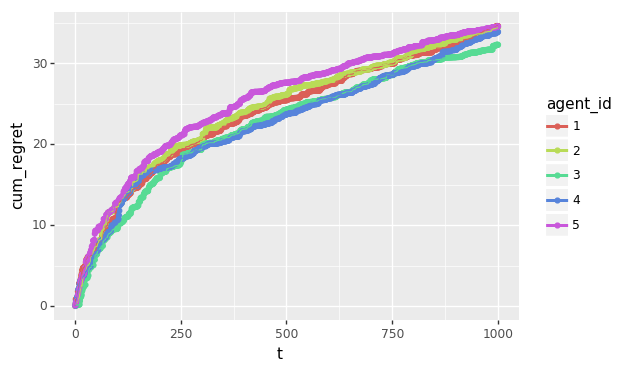

<ggplot: (8730286314133)>


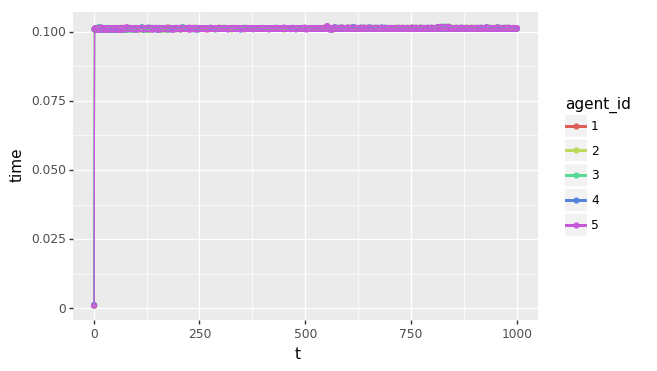

<ggplot: (8730389914205)>
theta [-0.41675785 -0.05626683 -2.1361961   1.64027081 -1.79343559 -0.84174737
  0.50288142 -1.24528809 -1.05795222 -0.90900761  0.55145404  2.29220801
  0.04153939 -1.11792545  0.53905832 -0.5961597  -0.0191305   1.17500122
 -0.74787095  0.00902525 -0.87810789]
Experiment: Step 0
 Sample: array([-1.85040397,  0.33048806, -0.31569321, -1.3500021 , -0.698171  ,
        0.2399512 , -0.55294944,  0.29952681,  0.5526637 , -0.84044301,
       -0.31227067,  2.14467809,  0.12110558, -0.84682875,  0.06046245,
       -1.33858888,  1.13274608,  0.37030484,  1.0858064 ,  0.9021794 ,
        0.39029645])
 Steps taken: 0
 Sample: array([ 0.97550941,  0.19157365, -0.66220901, -1.02351498, -0.44817482,
       -2.50545813,  1.82599446, -1.71406741, -0.07663956, -1.31756727,
       -2.02559359, -0.08224538, -0.30466658, -0.15972413,  0.54894656,
       -0.61837549,  0.37879447,  0.51325144, -0.33484413, -0.28351952,
        0.53842426])
 Steps taken: 0
 Sample: array([ 0.05725

 Sample: array([ 1.09569614, -0.66607088,  1.03524099,  1.29016388,  0.24909147,
       -0.64097786, -0.03097228,  1.6004132 , -0.66658494,  0.13102779,
        0.93479023, -1.06434987, -2.55975228,  0.01956148, -1.53718891,
        0.3184116 ,  0.37225949, -0.08517873,  0.31332005,  1.87532052,
       -0.81225154])
 Steps taken: 1188
 Sample: array([-0.79624886,  0.849439  , -1.03274181, -0.12500622,  1.62500457,
        2.73400364,  0.41891219, -1.15993806, -0.16832111, -0.2529726 ,
        0.34469607,  0.99459217,  1.97299959, -0.59191761,  0.52427313,
        1.41134636,  1.30819541, -1.33448636,  2.69750611,  0.1492358 ,
        0.63248883])
 Steps taken: 1184
Experiment: Step 5
 Sample: array([-0.11504502,  0.91536027, -0.24869341,  0.71739757, -0.74792653,
        0.31894946, -0.81489063,  0.95324559, -0.1019559 , -0.38824274,
        1.23892943, -1.77008601,  0.92598066,  0.7455155 , -0.19264008,
       -0.59820149,  0.39326692,  1.50073405, -1.16334409, -0.73792989,
       -0.

 Sample: array([-0.45975872, -0.93402708, -0.26682993,  2.40738053,  0.30842047,
        1.33412721, -1.58658576,  0.83736483,  0.00617621, -1.2529657 ,
        0.46443199,  0.04012447, -0.29082705,  1.19164807,  0.71265441,
        0.32173062, -0.31798753, -0.24281378, -0.53616513,  0.19323094,
       -2.90515828])
 Steps taken: 1144
 Sample: array([-0.59602075,  0.61031324,  1.42807478, -0.13625176, -0.1361685 ,
        0.85099571,  0.59803313, -0.62525628, -0.72964884,  0.41480217,
        0.47151019, -0.84148581, -0.58336919, -1.55768208, -0.54334372,
        2.84487938,  0.74825075, -0.92254697,  1.35323232, -0.08586521,
        1.5074384 ])
 Steps taken: 1121
Experiment: Step 10
 Sample: array([-0.36464438,  1.31460014, -0.13314685,  0.19746398, -1.19100699,
        0.92648412,  0.17734791, -2.00470551,  1.32136342,  0.13748767,
       -1.98623242, -1.40677942,  0.10112657, -1.90598448, -0.32539703,
        1.39520611,  1.70106665, -0.51873837, -2.04841801,  1.02660939,
        0

 Sample: array([ 0.41362487,  0.29193473, -0.70107886,  1.4357439 ,  0.455827  ,
       -0.09173211,  0.45435005,  0.05850951,  0.1000395 , -1.40468947,
        0.18535313, -0.8119643 , -0.95590403, -1.54316477, -1.95458841,
       -0.86979261, -0.00723632, -0.09918843,  0.03912066,  0.21691389,
       -0.69905287])
 Steps taken: 1103
 Sample: array([ 0.94853106,  0.38459724, -0.5907281 ,  1.02750331,  0.05895836,
       -2.67191399, -0.20085487,  1.37243145,  1.11057873,  0.10269805,
       -0.66264516,  1.28517284,  0.57851746,  0.3304358 , -0.245834  ,
        0.03245351,  0.35154874,  2.12920033,  0.03350567,  1.07222727,
       -2.48292602])
 Steps taken: 1114
 Sample: array([ 0.59801762,  0.71431146,  0.40304727, -0.10627384,  0.05019519,
       -1.35052618,  0.15205519,  0.03705173, -1.29401768, -0.73809145,
        1.35875732,  1.98546193,  0.82276426,  1.08818115, -1.32680715,
       -0.98081215, -0.23273034,  0.03481952, -1.77062661, -0.11191941,
       -0.73575235])
 Steps t

 Sample: array([-0.69107546,  0.23149822, -1.59188135,  0.36671938, -1.49547976,
       -0.72901122, -0.15401362, -1.43846403, -0.51672108, -0.18363521,
        0.35704754, -0.67336167,  0.66428231,  0.47350817, -0.09351078,
       -0.58705944,  0.17747811,  2.92192498, -0.66089203, -0.3311829 ,
        0.79654244])
 Steps taken: 1072
 Sample: array([-0.57195792,  0.29082209, -1.09928461,  1.15278529,  0.13342181,
       -0.52125464, -0.73301941,  0.86854176, -2.07407356, -0.81148219,
        0.79750201,  1.48361853,  0.53286349,  0.65229149, -1.15366791,
        1.58678126, -0.00305385,  1.18810171,  0.29751811,  0.02399883,
        0.48571063])
 Steps taken: 1076
 Sample: array([-0.61187476, -1.49156947, -1.04773879,  1.36770365, -1.11463541,
        1.09496426,  1.58094073, -1.62576592,  0.1708455 , -1.10215385,
       -1.52153536, -0.97016121, -1.91636825,  0.39110301,  2.15933587,
       -0.54665498,  0.4240909 , -1.04774171, -1.23074505,  0.93225848,
       -1.61304947])
 Steps t

 Sample: array([ 0.03916989, -1.8681604 , -0.71272845,  0.49363141, -0.70941017,
       -1.21526943,  0.77259658,  0.03937942, -0.16956127,  1.76183698,
        1.5960218 ,  0.58187473, -0.04740452, -0.19492824,  0.11521546,
        2.33103866, -0.69013878,  0.47862604,  1.09210153, -0.24978388,
        0.59786295])
 Steps taken: 1042
 Sample: array([ 0.70597942, -0.90723011, -2.47434451,  2.08612879, -1.20804522,
       -0.86188538, -1.17535286, -0.82175065, -1.55098979, -1.13661071,
       -1.76498437,  0.2947019 ,  1.69781792,  0.57812342,  0.04928795,
       -0.33149097,  0.62435078, -0.51424286, -0.24880263,  1.32324125,
       -1.58409045])
 Steps taken: 1045
 Sample: array([-1.25865759e-01,  1.18331383e+00,  1.63697320e-01,  8.24568804e-01,
       -3.16491338e-01,  1.43768058e+00,  2.02156759e+00, -6.43857519e-04,
       -9.43504829e-01,  3.05604749e-01,  1.17288765e+00,  1.11186293e+00,
       -5.85608067e-01, -1.15194478e+00,  6.74223910e-01,  7.85099671e-02,
        5.2473157

 Sample: array([ 0.33789456, -0.54773917, -1.44177719, -0.09169399, -1.48997279,
       -0.61786195,  1.82143382, -0.84997031, -1.6034752 , -0.16972879,
        0.051966  ,  0.01435596, -0.65504693, -0.0806761 ,  0.12913413,
        0.19191187,  0.66147938, -0.55843839, -0.58474101, -0.68580908,
       -0.39809057])
 Steps taken: 971
 Sample: array([-0.93304618,  0.63323587, -2.12488343,  1.19049577, -0.61221838,
       -0.8142872 ,  0.86337464,  0.22291507, -0.86229657, -0.43617534,
       -0.73867005,  0.74144563, -1.19942122, -0.12589452, -0.00708492,
       -0.15116107,  0.62310012, -0.74688156,  0.57780159, -0.36914117,
       -0.26537975])
 Steps taken: 1000
 Sample: array([-0.44370851,  0.17213822, -1.30916874,  0.18444625, -0.34136131,
        0.06599894, -0.36517011, -1.26166969,  0.35098367,  0.8633976 ,
       -0.63445551,  0.77979102,  0.13457859,  0.00688909, -1.79142826,
        1.1621544 ,  1.1034107 , -1.07652099,  1.03136437,  1.06048332,
       -1.00149256])
 Steps ta

 Sample: array([ 0.6716465 ,  0.34962261, -1.57847555, -1.38486795, -0.03975688,
        1.69990381,  0.22559723,  0.03643921, -0.73190618, -0.17884602,
       -1.23216714,  0.33331759,  1.38676388,  1.28712231,  1.41095684,
        0.81841771,  1.1410404 , -0.81398931,  0.46620819, -0.93773491,
       -1.95406302])
 Steps taken: 763
 Sample: array([ 0.15032512,  0.25406978, -0.88448151,  0.54937924, -1.47251863,
        0.17578034,  0.78962436,  0.40096631, -0.13929191, -1.11149042,
        0.1190544 ,  0.67988841,  1.29065801, -0.58296353, -0.9936046 ,
       -0.55051345,  0.79659441,  0.02175901, -0.52067599, -0.7973599 ,
       -0.91465878])
 Steps taken: 777
 Sample: array([-0.11297017,  0.47939817, -2.88509075,  1.41457686,  0.85843117,
        0.82091824,  0.97351344, -1.08426966,  0.72756521, -0.28611825,
       -0.88577312,  1.26409028, -0.34102284, -0.39611836,  0.63765924,
        0.42311027, -0.04580627, -0.5888947 ,  0.7780568 , -0.11078281,
        0.12648703])
 Steps tak

 Sample: array([-0.20703244,  0.8730209 , -1.14742012, -0.1687036 , -0.59573979,
       -0.26770099,  1.30263324, -1.79487763, -0.11251186,  1.21156469,
        0.05273351,  1.00924746, -0.11054485, -0.69567   ,  1.23456172,
        0.90691692, -1.63305693, -0.08215067, -0.33948475, -0.48682489,
        0.06525718])
 Steps taken: 768
Experiment: Step 39
 Sample: array([ 0.09381145,  0.28842481,  0.1520895 ,  0.54984569,  0.1840778 ,
        1.04330403,  1.59043954, -0.31543091, -1.6829221 , -2.08149671,
        0.38482097, -0.55680204,  0.66560481,  1.52144362, -0.00289051,
        2.12281728,  0.09101946, -0.36642219, -0.94650142,  0.62124456,
       -0.36307816])
 Steps taken: 788
 Sample: array([ 0.2833924 ,  0.69820177,  0.15582338,  1.08804674, -2.44747277,
        1.01234126,  2.31472038, -0.58635949, -0.50731812,  0.54533065,
       -0.51607036,  2.73731117,  0.07090212, -0.47288336,  1.32817905,
       -1.39880287,  0.89884186,  0.20834157, -0.07023589, -0.71849208,
       -0.3

 Sample: array([-0.25444449,  0.09001799, -0.55898285, -1.72374141, -1.73549962,
       -1.20943017,  0.09451186,  0.1130398 , -0.20548331, -0.50267301,
        0.87271714,  0.98965645, -1.08381943, -0.58839017,  1.77845402,
        0.27162593,  1.19894274, -0.4023362 ,  0.70416545,  0.55443671,
       -0.79057637])
 Steps taken: 773
 Sample: array([-0.2752407 ,  1.87849157,  1.220209  , -0.11394695, -2.15815006,
        0.45504572,  1.34752561, -1.58560011, -1.69455178, -1.06168925,
       -0.18456968,  0.79520911, -0.10525188,  1.22656168,  0.68831615,
        0.21170736,  0.30582655,  0.39038664, -1.1630598 , -0.0461975 ,
        0.10635086])
 Steps taken: 778
Experiment: Step 44
 Sample: array([ 0.65947739, -0.13781677, -0.63120192, -0.45442134,  0.01372801,
        0.9859893 , -0.11716213,  0.67834675, -1.49324046, -0.14341587,
       -0.41620668,  0.31586057, -0.21265626,  1.01084083,  0.48218883,
        1.62588396, -0.25575625, -0.30414842, -2.09522969,  0.36224753,
       -0.3

 Sample: array([-0.28337247,  0.1285535 , -2.45471357,  0.68247487, -1.55526897,
       -0.6040022 ,  0.96904215, -0.63727527,  0.78430058, -1.06623314,
       -0.73089788,  1.06014787,  0.46267987, -0.70769174,  0.76210544,
        1.07021759, -0.79233121,  0.64581415,  0.86951013,  0.21372605,
       -1.32055476])
 Steps taken: 777
 Sample: array([-0.17305548, -0.65103377, -1.74229861, -1.6763088 , -2.20739954,
       -0.71997658,  1.1258606 , -0.963874  ,  1.45727598,  1.07259387,
       -0.01259815,  1.96224392, -1.93888179, -1.51757953,  0.62387458,
       -0.00647079,  0.16310806,  0.25322665,  1.00951454,  0.8064022 ,
       -1.71069047])
 Steps taken: 762
 Sample: array([-0.37961698, -0.16777193, -0.87431364, -0.78814324, -1.33999172,
        0.40933231,  1.07292517,  0.03640366, -1.16872974, -1.20895656,
       -0.01851947,  2.09230739,  0.64919467, -0.08834205,  2.00815966,
       -0.74471261, -0.89084845,  1.10083204,  1.38315112, -1.96199583,
        1.50579137])
 Steps tak

 Sample: array([-0.95870612,  0.01545463, -0.72030402, -0.1108288 , -1.67489167,
       -1.50177903,  0.85790324, -2.43437303, -0.082395  , -0.02141638,
       -0.83715156,  0.83915553, -0.30225578, -0.37666516,  0.44673468,
       -0.96191032,  1.0430541 , -1.10264393,  0.85857531,  0.10532936,
       -0.35341607])
 Steps taken: 779
 Sample: array([-0.03939423,  1.18341712, -0.01087983,  0.05117609, -1.13636756,
       -0.85125444,  0.56537146,  0.08690118, -0.54226251, -0.89321332,
        1.02547219,  1.10261727, -1.52121501,  0.07711556,  0.4065055 ,
       -0.54073374,  0.8110531 ,  0.58433301, -0.62790536, -0.61635216,
       -0.91156619])
 Steps taken: 783
 Sample: array([-0.18023247,  0.00312029, -1.9432815 ,  0.03953676, -1.52260097,
       -1.6132368 ,  0.56640905, -1.06005013,  0.05418506, -1.30100586,
       -1.24678753, -0.8405426 , -0.09444962, -0.63043896,  1.43213944,
        1.18063576, -0.17560116, -0.43017098,  0.63242709,  2.40048572,
        0.77645972])
 Steps tak

 Sample: array([ 0.16657064,  0.49852452, -1.33605541, -0.41698961, -0.52630678,
       -0.05063544,  0.05246809, -1.42541719, -1.30510834, -0.95457739,
        0.28823533,  0.25587601,  0.5361309 ,  0.07088097,  1.86829416,
        0.26481011, -0.95843963,  0.23917816, -1.54261719,  0.21765916,
       -1.07188801])
 Steps taken: 771
 Sample: array([ 0.29595764,  1.20132355, -1.82749986,  0.26145886, -0.95100085,
       -2.29341783,  2.22839213,  0.17977723, -0.51423165, -0.0179442 ,
        0.17361804,  1.67160737, -0.89953391, -0.79415011,  0.92520686,
       -0.84996511,  0.15893797,  1.61155968, -0.93456366,  1.0846619 ,
        0.52444194])
 Steps taken: 788
 Sample: array([ 0.01779809,  0.18467338, -1.86116772,  0.68313611, -2.05631384,
        0.33184724,  0.81279673,  1.36865898, -1.27856824, -1.10915359,
        1.6631407 , -0.75640846, -0.26043261,  0.36909494,  1.08284881,
        1.49081525, -0.43542183,  0.56632626,  0.25838708, -1.37595659,
       -0.72075543])
 Steps tak

 Sample: array([-0.37204933,  0.2288673 , -0.1064911 ,  0.27747824, -2.8030131 ,
       -0.66023902,  0.10700886, -1.33338498, -0.87474434, -1.24699239,
       -0.08554867,  1.76860358,  0.40575178, -1.34663122,  0.29611058,
       -0.55988259, -1.14739805, -0.13232109, -0.46825301, -2.01351962,
       -0.73102177])
 Steps taken: 765
Experiment: Step 63
 Sample: array([-0.01026986, -1.50738758, -2.89864674, -0.24684597, -0.7513788 ,
        1.65755497,  0.37291187, -0.89455729, -1.80047041,  0.34482079,
       -0.13281145,  1.97661969, -0.30521194, -1.21491692, -0.71346098,
       -0.93705354,  0.50647813, -0.56531778, -1.16153316,  1.98148471,
       -1.35998488])
 Steps taken: 780
 Sample: array([ 0.15200299,  0.82334606, -1.10709599,  1.29733994, -1.96688241,
       -0.16173637,  1.46375164, -0.04931255, -1.12135593, -1.2291258 ,
        0.20057183,  2.30392031, -1.81787764, -0.95756265,  0.69747927,
       -0.60559668, -0.2319902 ,  0.6755954 , -1.4267114 , -0.64432964,
       -0.9

 Sample: array([ 0.47433481,  0.05705495, -1.68016559,  0.9604399 , -0.92079978,
       -1.68446108,  1.50215277, -0.24576854, -0.87823843, -0.95830296,
        0.38440002,  0.31369922, -1.41038591, -0.67709794,  2.00990575,
       -0.06962894,  0.69413981, -0.33052511,  0.97322012,  0.88567857,
       -0.7776372 ])
 Steps taken: 765
 Sample: array([-0.52030422,  1.59486118, -0.14850031,  1.41640228, -2.2478649 ,
        0.87638142,  0.10877983, -2.03379571, -1.18246632, -0.98882107,
        0.06305114,  2.17182962, -0.13510417, -0.57359819,  1.32115771,
        0.38924683,  0.52551458, -0.15032619, -1.01169078, -0.30547556,
       -0.97717365])
 Steps taken: 786
Experiment: Step 68
 Sample: array([ 0.18368125, -0.23836735, -1.84272827,  0.55572953, -0.43589959,
        0.55840985,  0.59820253, -0.54289141,  0.51023893, -0.55345343,
        0.33732516, -0.36667364,  0.02051712, -0.46166536, -0.73832841,
       -1.42978926,  1.29242765, -0.57174686, -1.42712121, -0.1356852 ,
       -1.1

 Sample: array([ 0.29863611,  1.08603627, -1.45965213,  0.43368847, -0.2124809 ,
       -1.12947853,  0.68334452,  0.60509716,  0.50499829, -3.27380611,
        0.90272889,  0.31956848,  0.2800785 ,  0.2298041 ,  0.48177298,
        0.86508598, -0.43429869,  0.11453161,  1.64656276,  0.91415999,
       -1.43410999])
 Steps taken: 781
 Sample: array([-0.62396611, -0.70800321, -1.20913747, -0.37218339, -0.32526991,
       -2.10243396,  0.510683  , -0.01666553,  0.70412473,  0.27574061,
        0.45469713,  1.63888428, -0.06862012, -1.52646816,  2.1296009 ,
       -0.65348693, -0.78785827,  0.9465788 , -0.13313309,  2.08531793,
       -0.67401651])
 Steps taken: 767
 Sample: array([-0.26242692,  0.68476515, -1.36411972,  1.6826012 , -3.14097787,
       -0.9555026 , -0.27602373, -0.68126133, -0.21891829, -0.5806307 ,
       -0.392631  ,  2.62113942,  0.21005657, -0.62563821, -0.0380107 ,
        0.40063844, -2.06544264,  0.15869925,  0.10596576, -0.13357767,
       -0.86878893])
 Steps tak

 Sample: array([-0.58964142,  0.60243325, -1.6538598 ,  1.11473517, -0.07333643,
       -2.91108844, -0.3838144 ,  0.4300838 , -0.97615937, -0.13629246,
       -1.13034389,  1.81841753,  0.53842491, -0.99881058,  0.87433935,
        1.12973494, -0.23543251, -2.01126861,  0.65319384,  1.09897903,
       -0.37814834])
 Steps taken: 768
 Sample: array([-0.07292469,  1.09746851, -0.24099901,  0.68804879, -1.74561095,
       -1.05733458,  0.59327654, -2.34676263, -0.63308347, -0.6865438 ,
        0.43110672,  1.60171625,  0.23384983, -0.43195486,  1.29027024,
        1.01525465, -0.11031488,  1.3140746 , -0.60787433,  0.89347829,
       -1.08941263])
 Steps taken: 781
Experiment: Step 78
 Sample: array([-0.37544492,  0.12513651, -1.89987983,  1.90275692, -1.8000294 ,
        1.13027567, -0.21809128, -1.50197081, -0.61223159, -0.76046115,
        0.69802189,  1.12664031, -0.71921978, -0.06547804, -0.41734355,
       -0.43107889,  1.33580612,  0.22944158, -0.61974887,  0.11210197,
        0.1

 Sample: array([-0.75970671,  1.47160042, -0.69056157,  0.24939279, -2.17031406,
       -0.0800312 ,  0.52730905, -2.11070503, -0.41752741, -0.34083036,
        0.9847289 ,  1.83159367,  0.64958674, -0.83720683, -0.12828175,
       -0.48541277, -1.45491995,  0.39411864,  0.14255787, -0.48952626,
       -0.56205614])
 Steps taken: 770
Experiment: Step 83
 Sample: array([ 0.79066617,  0.11311298, -1.27701271,  0.55204982, -0.37456046,
        1.08849397,  1.08301924, -1.22569002, -0.06891953, -0.68009932,
        0.41684974,  1.10279879, -1.0067784 , -0.63267536, -0.65431462,
       -0.82216075,  1.00335227,  0.02365924, -1.10647054, -0.6746569 ,
       -0.25370024])
 Steps taken: 765
 Sample: array([-0.26881012, -0.06533898, -2.04742878,  1.0066122 , -2.97421571,
       -0.18982619,  0.8405618 , -0.28488991,  0.05819259, -1.26626761,
        1.28607535,  1.61582786, -0.7591066 , -0.51022666, -0.36512012,
       -0.88103627, -2.10145533,  1.38039329,  0.7497432 ,  1.53200699,
       -0.9

 Sample: array([ 0.00232362, -1.14653684, -1.45524845,  1.02676032, -1.66462461,
       -0.31626369, -0.57941807, -1.31545672, -0.58953057, -1.04490655,
        0.37413683,  1.04880412, -0.04906119,  1.00259907,  0.59916406,
        0.14938908,  0.14061912, -0.58313226, -0.47037076,  0.03052521,
        0.25518967])
 Steps taken: 764
 Sample: array([-0.21530128, -0.63553219, -0.73648774,  0.73911143, -1.69262451,
       -1.66799215,  1.27126279, -1.03957506, -0.22609358, -1.23636457,
        0.44773127,  0.71524222, -0.25946686, -0.01331262,  1.44105721,
       -0.35950043,  0.9157861 ,  0.43527142,  0.17235034,  0.7029185 ,
       -1.43912804])
 Steps taken: 782
 Sample: array([ 0.10474395,  0.23730537, -1.07583384,  2.39339124, -1.02939925,
       -0.17855494, -0.10987876, -1.95407354,  0.63603015, -1.44235686,
       -0.73034917,  1.222762  , -1.48070516,  0.00341646, -0.06678814,
       -0.4195378 , -1.10694453, -1.42677331,  1.24220359,  0.3282055 ,
       -1.72802701])
 Steps tak

 Sample: array([-0.50659306,  1.58205761,  0.56225078,  1.506997  , -2.96275123,
        0.30620259, -0.91304727, -2.22449589, -1.6702435 , -1.22194096,
        0.52189328,  0.97475791, -0.24982496, -1.21063333, -0.52238809,
        0.29699752, -0.42289328,  0.32010698, -0.93208154, -0.00339497,
       -0.50131304])
 Steps taken: 765
Experiment: Step 93
 Sample: array([ 0.4295977 ,  0.36212138, -2.00475333,  0.83743395, -0.44070791,
        0.54383977,  1.73211091, -1.05905079, -1.02141166, -0.20409384,
       -1.15827896,  0.12293139, -0.37667846,  1.74838071, -0.92122323,
       -1.06332767,  0.72464861, -1.3276014 , -2.02361842,  0.20608345,
       -0.27117693])
 Steps taken: 763
 Sample: array([-0.02401614,  0.21914654, -2.78969307,  1.16373493, -2.21805883,
       -0.5287532 ,  0.78463601, -1.27953222, -0.07103537, -1.69175125,
        0.30503822,  1.11397915, -0.67046614, -1.54954862,  0.58152483,
        0.08944004,  0.25449145,  0.94683508, -0.30461835,  0.19506445,
       -0.4

 Sample: array([ 0.1944967 , -0.29138361, -1.47062757,  1.43500751, -0.58135531,
       -0.41072205,  0.45887063, -1.64356998, -0.61527352, -1.79376686,
        1.22720913,  1.34948991,  0.14625667, -0.87477908, -0.70330733,
       -0.77034908,  1.16149609,  0.50433925, -0.30780096,  1.97779435,
       -2.17158892])
 Steps taken: 768
 Sample: array([-0.08590093, -0.45184262, -1.20736352,  1.6532406 , -3.04530319,
       -0.75551657, -0.07736832, -0.04134059, -0.41501049, -0.29520193,
        1.10215252,  1.1149402 , -0.76466426, -0.58663513,  0.97552069,
       -0.78913792,  0.01878693, -0.21808282, -1.19944071,  0.45464801,
       -1.72941859])
 Steps taken: 769
 Sample: array([-0.2575624 ,  0.95020109, -0.79992123,  0.87745213, -1.01113432,
        0.4219557 , -0.5938599 , -0.29171007,  0.24551309, -1.8711764 ,
       -0.19604572,  2.37479906, -0.14500192,  0.00699186, -0.23238096,
        1.36345166, -0.27210011,  0.98536271, -0.0324394 , -0.87283286,
       -1.16438187])
 Steps tak

 Sample: array([ 0.47906822,  1.09631005, -1.43382903,  1.4643132 , -3.03894408,
       -0.08221279,  0.86837573, -1.18305945,  0.40909039, -0.74005325,
        1.21515907,  1.59644622, -1.18582056, -0.34930038,  0.55293587,
       -0.63617702,  0.72526622,  0.34797587,  0.04265824,  0.75264108,
       -1.00823375])
 Steps taken: 762
 Sample: array([-0.98266561, -0.49345279, -1.76639716,  1.37493476, -0.85810305,
       -0.211762  ,  0.44472087,  0.33077001,  0.11284039, -1.96843898,
        0.98223638,  1.21555131, -0.53276161, -0.56414505,  0.79695579,
        0.93459385,  0.59219531, -0.89824597, -0.92784376, -0.75044182,
       -1.40799525])
 Steps taken: 763
 Sample: array([-0.57431687, -0.3562902 , -1.43551388,  0.17364135, -0.83300902,
       -2.46275783, -1.0986039 ,  0.00295252,  0.24581428, -0.99625683,
       -1.1249446 ,  0.93461609,  1.34426387, -0.9323133 ,  1.5348314 ,
       -0.04238628, -0.12250668, -0.518875  , -0.00787925,  1.33849169,
       -0.97551844])
 Steps tak

 Sample: array([-0.01569504,  0.1864867 , -0.85534124,  1.52642135, -2.14027457,
       -1.75392731,  0.9403556 , -0.75826538, -0.46526501, -1.20318424,
        0.52213795,  2.01837338, -0.34565873, -1.40745018, -0.8575024 ,
        0.07587155,  0.21431882, -0.42242922,  0.53120898, -0.57637457,
        0.51922944])
 Steps taken: 759
 Sample: array([-0.00383029,  1.09798769, -0.73947042,  0.94848063, -0.53508541,
       -1.13810308,  0.06881841, -0.69861008, -0.1847515 ,  0.37283801,
       -0.07874437,  1.43490054, -0.27797564, -0.85957295,  1.56244906,
       -0.8105048 , -0.76150945,  0.45140309,  1.09662174,  0.77596802,
        0.40263012])
 Steps taken: 771
 Sample: array([-0.01325239,  0.88753835, -0.51703069,  1.25076977, -1.50532144,
       -0.98778184,  0.10260307, -1.54978532, -0.80801734,  0.07001298,
       -0.20115821,  0.92817244,  0.73897345, -0.70412766,  0.2220132 ,
       -0.27502438,  0.15728591,  0.13235221, -0.72131188, -0.56448092,
       -0.10553428])
 Steps tak

 Sample: array([-0.3389325 , -0.23947313, -2.32077044,  0.43426224, -0.95813656,
        0.2677118 ,  0.21630461,  0.16015867, -0.63349296, -0.29516679,
       -0.19957584,  1.54919627, -0.06320874, -1.833051  ,  1.08427857,
       -0.97903208, -0.29267755, -0.51112752, -0.55528261,  1.02777582,
       -0.63038619])
 Steps taken: 769
 Sample: array([-0.44967165,  1.34876786, -0.03989766,  1.07362301, -2.79080484,
       -0.1164164 ,  1.10935792, -2.32987789, -1.13226303, -1.36069957,
        0.03956259,  1.09766758, -0.2771046 , -0.23031085,  0.32105159,
        0.3229772 , -0.34919042, -0.66613049, -0.45248749, -0.32981301,
       -0.2807874 ])
 Steps taken: 777
Experiment: Step 114
 Sample: array([-0.03365275, -0.95098934, -1.59171445,  2.08763942, -0.87349452,
        0.33423297, -0.12740688,  0.15271573, -1.39405021, -1.39858484,
        1.34574914,  0.93078794, -0.28055733,  0.11874727,  0.32780704,
       -0.6525411 , -0.35637433, -0.30554109, -1.44828129,  0.96773785,
       -0.

 Sample: array([-0.81412918, -0.72021238, -1.73455124,  1.59986962, -0.97686527,
       -0.36531247,  0.10083949, -0.16339892, -0.30570885, -0.93769882,
        1.03742889,  0.80086545, -0.86605276, -0.22330021,  0.45630486,
       -0.34349416,  0.40803716, -0.02120716,  0.13379355,  0.83560057,
       -0.84746248])
 Steps taken: 763
 Sample: array([-0.32348612,  0.22648121, -1.54950655,  1.06472053, -0.89942079,
       -0.66080068,  0.54737329, -0.43987712, -0.54517286,  0.32409953,
       -0.14467478,  1.24658595,  0.30606785, -0.55994657,  1.01733601,
       -0.41184662, -1.09990515, -0.1109964 , -0.20350944,  0.31522275,
       -0.13965867])
 Steps taken: 768
 Sample: array([-0.17080375,  1.71814729, -1.13137936,  1.55533849, -2.60866746,
       -0.15076495, -0.94225993, -1.55833658,  0.43390486, -1.79870008,
        0.09150478,  1.26779924,  0.66559251, -1.16261927,  0.09816234,
       -0.02492157,  0.24433124, -0.18189527, -0.37753224,  0.67920817,
        0.36503247])
 Steps tak

 Sample: array([-0.14315689,  0.86647947, -1.33406402,  0.53167672, -0.90529006,
       -0.99671493,  1.14126813, -1.01970641,  0.06700614,  0.65484502,
       -1.14637426,  2.03731364, -1.08420506, -0.4984132 ,  1.27573275,
       -0.32119317, -2.30977735,  0.39557185, -0.27769641,  0.68752979,
       -0.09934493])
 Steps taken: 758
 Sample: array([-0.7446631 ,  1.0045913 , -0.44476099,  1.29017977, -1.64042672,
       -0.15298756,  0.81580722, -2.43506705,  0.2749673 , -1.11439455,
        0.71691695,  2.08369632,  0.35297952, -0.63590571,  1.82442137,
       -0.50647457,  0.63251008, -0.59446956, -1.26934787,  0.1319361 ,
       -1.01947256])
 Steps taken: 775
Experiment: Step 124
 Sample: array([ 0.69381752, -0.72745073, -1.23575856,  1.55652382, -1.2354656 ,
        0.1797832 ,  0.4709447 , -1.57352992, -0.69229732, -0.571904  ,
        0.07394183,  0.57404171, -0.76086515, -0.6402314 ,  0.01438304,
        0.51245722,  0.50758484,  0.475801  , -0.86095197, -0.48817699,
        0.

 Sample: array([ 0.2214218 ,  0.29117838, -1.74091802,  1.40759271, -0.45382226,
       -0.83365828, -0.02883451,  0.7066566 , -0.39726   , -1.58359641,
        1.57857709,  0.16797103, -0.08926783, -1.30236242, -0.03101441,
       -0.17986044,  1.12263307,  0.31701697, -0.27955647,  0.78793164,
       -1.22503437])
 Steps taken: 767
 Sample: array([-0.61782514,  0.87847315, -2.25887152,  0.55782589, -1.23631029,
       -0.50873644,  0.45450508, -0.46459535,  0.36820225,  0.44703936,
       -0.18963091,  1.51779942, -0.34972741, -0.8543246 ,  0.54818377,
       -1.01850971, -0.63089838,  0.02132527,  0.43147103,  0.14687857,
       -1.05632441])
 Steps taken: 771
 Sample: array([-0.9409798 ,  2.0162128 ,  0.46017422,  1.16003457, -1.40063198,
       -1.17269168,  0.01283766, -3.49892109, -1.60214678, -0.03963929,
        0.11111872,  2.42804405, -0.54635847, -0.78049998,  1.25445965,
       -0.48880678,  0.38746887, -1.25984779, -1.30075318, -0.67524356,
        0.28307865])
 Steps tak

 Sample: array([-0.29654764, -0.06015595, -1.22269205,  0.07032448, -1.82673278,
       -0.42384393,  0.66811684, -0.8108833 , -0.57843389,  0.11306149,
       -0.08850647,  1.85806767, -0.71082313, -1.64250937,  0.94596392,
       -0.77393836, -0.92822568,  1.3527434 ,  0.07921848,  1.1795916 ,
       -0.82938603])
 Steps taken: 772
 Sample: array([-0.43095167,  1.03914023, -0.11768733,  1.22430377, -3.21436127,
       -0.35827875,  0.14628319, -2.00263323, -1.64258444, -1.22721154,
        0.23041712,  0.59176553, -0.31476026, -0.46226243,  0.53624602,
        0.4858257 ,  0.00494534, -0.87873033, -0.50220049,  0.4047685 ,
       -0.75078644])
 Steps taken: 780
Experiment: Step 134
 Sample: array([ 0.24278626,  0.29997102, -1.92504566,  1.89968548, -1.80530912,
       -0.03690289, -0.97923259,  0.06737444, -0.21909728, -0.35842166,
        1.11583675,  2.16419732, -0.47548573, -0.17412922, -0.24493487,
       -0.0690502 ,  0.9792145 , -0.3891276 , -1.20913013,  0.15297224,
       -0.

 Sample: array([-0.5855987 ,  0.00684363, -3.44218018,  1.54176354, -1.03841614,
        0.31846652,  0.91436947, -1.06886029, -0.42909319, -1.26179959,
        0.04740439,  0.4780079 , -1.40783211, -1.52722764,  0.22574829,
       -0.04717124,  0.02288745,  0.09439609,  0.79863354,  0.29436697,
       -1.01692579])
 Steps taken: 772
 Sample: array([-1.62555370e-01,  2.79774570e-01, -1.02766403e+00,  4.41657658e-01,
       -7.78388039e-01, -2.14664445e-02,  1.01171435e+00, -1.69008714e+00,
       -3.18661703e-01,  2.30141968e-01, -1.01479861e+00,  2.55258068e+00,
       -1.11147116e+00, -7.87867892e-01,  1.34080767e+00,  1.70697248e-03,
       -7.99898110e-01,  1.18039295e+00,  7.60112736e-01,  4.28896508e-01,
       -9.70939250e-01])
 Steps taken: 776
 Sample: array([-0.67123854,  1.28947021, -1.03998945,  1.97958526, -3.18202095,
       -0.39094493,  0.17482536, -1.78707446, -0.02446506, -2.13055322,
        0.81160371,  1.98051587,  0.06776109, -0.97681456,  0.41066045,
        0.55

 Sample: array([-0.08217905,  0.1047338 , -1.87060356,  2.03522436, -2.48560959,
       -0.21108185,  0.47653985, -1.01497806,  0.4090726 , -1.47002868,
        1.6749516 ,  1.53351427, -0.30164318,  0.00940143, -0.27091286,
       -1.36358433, -0.51877877,  1.54175731, -0.88447573, -1.0859365 ,
       -1.65362768])
 Steps taken: 767
 Sample: array([-8.63592146e-01, -3.68942902e-02, -2.68987030e+00,  2.43826906e+00,
       -1.78300085e+00, -1.05489157e+00,  3.08769484e-01, -1.32064483e+00,
        8.96926265e-02, -1.33620906e+00,  1.25258679e+00,  1.01845993e+00,
        9.87201305e-01, -1.75003238e+00, -1.02659497e+00, -2.69287763e-01,
       -4.92036533e-01, -1.23582119e-01,  5.14944403e-01, -1.93470674e-03,
       -2.07182372e-01])
 Steps taken: 775
 Sample: array([-0.77696961, -0.5491816 , -1.72159697,  0.68476619, -1.44757284,
       -0.61839362,  0.24201952, -1.27039001, -0.86863665, -0.04329123,
       -0.28751252,  0.77475968,  0.32194174, -1.27552642,  1.18930852,
       -0.91

 Sample: array([ 0.46848331, -0.0608551 , -1.16969291,  0.74947086, -1.38503049,
        0.46968199, -0.02022302, -1.11317041, -0.47478251,  0.09525747,
        0.99718118,  0.87194819,  0.60761188, -0.6556899 ,  0.0986409 ,
       -0.54229496,  0.40615507,  0.82167949, -0.48737684,  0.00365237,
       -0.84948087])
 Steps taken: 774
 Sample: array([-0.09354112, -0.32682069, -0.94071635,  1.50286251, -2.26702942,
        0.21227174, -0.09962825, -1.34733478, -3.01424374, -1.1999261 ,
        1.50531774,  1.3842524 , -0.25556614,  0.78933252,  0.9147172 ,
       -0.56253038,  0.3379419 ,  0.47768832, -0.83728113, -0.57346586,
       -1.3238346 ])
 Steps taken: 773
 Sample: array([-0.15230268,  0.1598384 , -1.29909106,  1.91257964, -1.21165829,
       -2.01341958,  0.30457662, -0.41732015,  0.92393705, -1.16211741,
        1.41645484,  0.82979799, -1.39196809, -0.29789398,  1.11474754,
        0.43986854, -0.41017062, -1.11706382,  0.53899611,  0.60438877,
       -0.12267503])
 Steps tak

 Sample: array([-0.17981392,  0.49814828,  0.52997823,  1.25519278, -1.94620821,
       -0.76507025,  0.54370906, -2.62470551, -0.30070703, -0.39886514,
        0.79146086,  1.33901797, -0.42976956, -0.81708927,  0.05673019,
       -1.29238452,  0.29647189,  0.35918679, -0.50759488,  0.07956003,
       -0.52686481])
 Steps taken: 762
Experiment: Step 153
 Sample: array([ 0.02492416, -0.47335199, -1.19641831,  0.97180625, -1.4407848 ,
       -0.44486331,  1.81958753, -1.35542093, -0.36267978, -0.69881529,
       -0.08718112,  1.01176208,  0.56745069,  0.18895684,  1.08644902,
       -0.32050724, -0.06475108,  0.16735713,  0.06479795,  0.45755836,
       -0.86956713])
 Steps taken: 775
 Sample: array([-0.0157855 ,  0.274052  , -0.59811874,  1.21450285, -1.40734747,
       -0.91273956,  1.01071207, -1.06764961, -1.265837  , -1.29620268,
        0.8837829 ,  1.30848671, -1.41383736,  0.82509124, -0.57541146,
       -0.22735954, -0.26820824,  0.51086912, -0.83268194, -0.539943  ,
       -0.

 Sample: array([-0.13103013,  0.54181991, -1.27853679,  1.4167444 , -1.59537707,
       -0.56687457,  1.12565058, -1.85276543, -1.19004813, -0.93754863,
        0.52487842,  0.809444  ,  1.10502191,  0.03423353,  0.08824639,
        0.20128243,  0.27154572,  0.63035321, -0.15488223, -0.4161228 ,
       -0.83602149])
 Steps taken: 766
 Sample: array([ 0.125127  ,  0.15886144, -1.38365188,  1.04535176, -1.28777625,
       -1.27055651, -0.13249945, -1.76446114, -0.50382876, -2.0139978 ,
        1.27944952,  0.00955022, -1.00003816, -0.16849899,  1.32839458,
       -1.13328739, -0.3168144 ,  0.35483375, -0.72516153,  0.86194758,
       -2.30286673])
 Steps taken: 758
 Sample: array([-0.34405336,  0.27467709, -2.32638034,  0.89593524, -1.18665557,
       -1.21320424,  0.66857744, -1.40876698,  0.19839649, -0.8947941 ,
        0.36199299,  0.63430958, -0.99539502, -1.31769275,  1.12439926,
        0.56424658,  0.23181641,  0.26977674, -0.00408916,  0.02765738,
       -0.94754764])
 Steps tak

 Sample: array([ 0.03445185,  0.38306746, -1.9600304 ,  1.39556027, -3.22956567,
       -0.22950922,  0.74436654, -1.06282225, -0.9130457 , -0.26492111,
        1.28166957,  2.56428244, -1.15058337, -1.25221931,  0.89694914,
       -0.3444978 ,  0.94185974,  0.7700253 ,  0.7569715 ,  0.51223395,
       -0.57719171])
 Steps taken: 762
 Sample: array([-0.22368674, -0.77044227, -2.1578105 ,  1.72973768, -0.92506437,
       -0.64898291,  0.11853223, -1.14394709, -0.29575694, -2.09491767,
        0.29569927,  2.00558793,  0.63786192, -0.23132678, -0.32212309,
       -0.24441381, -1.68399805,  0.09421294, -1.10857009, -0.2517363 ,
       -0.92400585])
 Steps taken: 783
 Sample: array([-0.41895097,  0.21490933, -1.47889894,  0.67195122, -1.38365842,
       -0.22862501,  0.15183175, -1.65092648, -1.16880001, -0.3761887 ,
        0.07995075,  1.71316482,  1.00318385, -1.59386635, -0.02622362,
       -1.2579326 ,  0.94851236, -1.13215024,  0.80527239,  0.22278477,
       -2.46639722])
 Steps tak

 Sample: array([ 0.00643391, -0.01332866, -2.03855765,  1.00935842, -1.43092188,
       -0.68499157,  0.21812843, -1.50383085, -0.86895503, -0.34955437,
        0.60105015,  0.81171264, -1.25867063, -1.25934606, -0.73795842,
       -1.49475225, -0.46545087,  0.83182128, -1.19015829, -0.58184761,
       -1.92076391])
 Steps taken: 756
 Sample: array([-0.1076514 ,  0.63566235, -1.53535291,  0.86312037, -2.28578658,
       -0.92251949,  0.83512379, -1.02751468, -1.14896925, -0.78444595,
        1.83442647,  0.4045121 , -0.91871783,  0.35376484,  1.51825831,
       -0.86859644, -0.51479696,  0.54959454, -0.96526378,  0.42523774,
       -0.70339936])
 Steps taken: 765
 Sample: array([-0.31162456, -1.15414133, -2.45210719,  1.61248722, -1.14073628,
       -0.6269196 ,  1.33517356, -0.13909657, -0.03796237,  0.09246424,
        0.28865635,  1.68692679,  0.01110233, -0.95706178,  0.3710731 ,
       -0.43884452, -0.24570536, -0.56604635, -0.14208466,  1.40292837,
       -1.18967806])
 Steps tak

 Sample: array([-1.05402198,  1.51057882, -0.69367664,  1.10141381, -1.3075471 ,
        0.22805183, -0.53398777, -1.79954813, -1.23452114, -2.0751774 ,
        0.1333602 ,  2.25984602,  0.52000815, -2.00137963, -0.31540235,
        0.4279594 , -0.12313113,  0.11068486, -1.39624805,  0.98127378,
       -0.62490403])
 Steps taken: 766
Experiment: Step 173
 Sample: array([ 0.16776745,  0.42609914, -1.07928328,  1.07014475, -0.71173657,
        0.15986268,  0.49008053, -1.94536899, -0.33443117, -0.68021295,
        1.00788266,  1.12927717, -0.10398094, -0.12745785,  0.05741237,
       -0.3341002 ,  0.40840867,  0.50763501,  0.74448174,  0.51688189,
       -1.21107819])
 Steps taken: 770
 Sample: array([ 0.04656711,  0.14819053,  0.334321  ,  2.4808923 , -2.59437317,
       -0.78313035,  0.82362559, -1.38772423, -0.26619437, -2.31879856,
        1.39018164,  2.42523576, -0.12564035, -0.26832621, -0.57838244,
       -0.84347535, -0.92944576,  0.64370445, -0.16388188, -0.38138777,
       -0.

 Sample: array([-0.07167942, -0.03498584, -1.17916595,  0.75812378,  0.29193443,
        0.18462731,  0.4881708 , -0.09590164, -0.75220763, -0.58794955,
        0.40397567,  0.4120496 , -0.26731951, -1.70661286, -0.10163022,
       -0.33881212,  0.5339249 , -0.27090126,  0.93529513,  0.05222253,
       -1.18118867])
 Steps taken: 752
 Sample: array([ 0.14850352, -0.03202178, -0.77563575,  1.30403028, -2.51667277,
       -0.76073202,  0.04767567, -0.9678576 , -0.41604138, -0.89188086,
        1.03082613,  1.90106383, -1.18770747, -0.39763285,  0.15640337,
       -1.44811135,  0.27864791,  0.82498969, -0.50208855,  0.6894942 ,
       -1.24020364])
 Steps taken: 774
 Sample: array([-0.47952673,  0.69984971, -2.87898704,  2.13180788, -0.60974622,
       -1.76191783,  0.88520832, -1.24956864, -0.86368471, -1.14766492,
        0.13762892,  1.10637415,  0.11950913, -1.29088822,  0.69215935,
       -0.0450811 , -0.86032521,  0.01437102, -0.0741753 ,  0.98419987,
       -0.55108   ])
 Steps tak

 Sample: array([ 0.06009619, -0.25352701, -0.74730781,  2.02060111, -2.46256999,
       -0.730403  ,  0.39258613, -0.3010075 , -1.73980026, -1.53065729,
        0.34858419,  1.91916948, -0.91004431,  0.03623455,  0.03451155,
       -1.46647989, -0.51977663,  0.42179896,  0.12911418,  0.42059377,
       -0.9749585 ])
 Steps taken: 768
 Sample: array([-0.25034696, -0.17489231, -1.82950568,  1.54663104, -0.89164077,
       -0.46439676,  0.77142318, -0.5746724 , -0.12585495, -0.6997315 ,
       -0.53750515,  2.05683583, -0.27801405, -1.50002696,  0.08837623,
        0.24826177, -0.05623003,  0.2392096 , -1.26225617,  0.00941694,
       -0.92787686])
 Steps taken: 775
 Sample: array([-3.45437754e-01, -1.74871754e-01, -2.42813881e+00,  2.17784977e+00,
       -1.47495281e+00,  8.45766300e-02,  3.39950046e-01, -1.32914598e+00,
       -8.15812495e-01,  9.40974661e-01,  2.35924391e-01,  1.87450350e+00,
       -9.01775697e-02, -1.24944381e+00,  2.92865609e-01, -6.56099021e-01,
       -9.25719320e

 Sample: array([ 0.14989689,  0.35642999, -1.70534382,  1.61850764, -0.81812522,
        0.60663539,  0.68107979, -0.8771503 , -0.16718675, -0.09771292,
        0.31596201,  2.35596883,  0.22862132, -1.38275814, -0.5190491 ,
        0.10831633,  0.32267645,  0.7779809 , -0.4861165 ,  0.84035511,
       -0.74848635])
 Steps taken: 758
 Sample: array([-0.25054735,  0.2402361 , -1.86900304,  0.8802459 , -1.59318862,
       -1.47929258,  0.29109767, -0.55071224, -1.21276246, -0.62250855,
        0.31637068,  2.30837932, -0.56387601,  1.04797464, -0.45219592,
       -0.79782733, -0.88959886,  2.10640351,  0.89603639,  0.61833674,
       -1.15448238])
 Steps taken: 775
 Sample: array([-0.92429958,  0.17861977, -2.33549186,  2.02412297, -1.60871289,
       -1.7365054 ,  0.14165151, -1.39536896, -0.65818792, -0.44521211,
        1.08422925,  2.06281339,  0.28110529, -0.2574333 ,  0.59622195,
       -1.41115362, -0.96256164, -1.09854207, -1.08193337,  0.41456403,
       -1.52769002])
 Steps tak

 Sample: array([-0.35263643,  0.18980401, -1.02446564,  0.64394597, -1.10406239,
        0.75903073,  0.31654841, -1.2879247 , -1.43530819, -1.37231943,
        0.03182951,  1.81146427, -0.47259618, -1.6165267 , -0.27847908,
       -1.13179396, -0.00661892,  1.03582975, -1.07247852,  0.60688716,
       -0.87565857])
 Steps taken: 757
Experiment: Step 193
 Sample: array([-0.02752961,  0.27343994, -1.36093179,  2.04921297, -1.13541074,
       -0.74574306,  0.92967431, -0.465119  , -1.93858812, -0.17860607,
        0.72514542,  2.33633044, -0.32485073, -0.78471298,  0.21502621,
       -0.19362845, -0.03865721,  0.11899346, -0.22654713, -0.95387813,
       -0.57755571])
 Steps taken: 758
 Sample: array([ 0.1463623 ,  0.23381839, -0.73544634,  2.04125723, -1.79632416,
        0.28815367, -0.45722055, -0.84308101, -1.24381583, -1.38200269,
        0.31321815,  1.86452969, -0.36633618, -0.20489893,  1.1154281 ,
       -0.67390495, -0.12585138,  1.15954094,  0.0253579 , -0.05778533,
       -1.

 Sample: array([-0.42646367, -0.04062134, -1.90212098,  1.03752215, -0.97698725,
       -0.59954749,  1.10501568, -2.0650608 , -0.61846848, -1.29849213,
        0.42008168,  1.8465186 , -1.26103758, -0.93736221, -0.42252523,
       -0.58124182,  0.29346962,  0.25950839, -0.84121541, -0.68798053,
       -1.60013024])
 Steps taken: 763
 Sample: array([ 0.27102582, -0.51346864, -1.19342209,  0.55459045, -1.48969037,
       -0.42333698,  0.55658382, -1.17197191, -0.77201599, -0.20786086,
        1.18118443,  1.52584019, -2.09815035, -0.23994149,  0.68132093,
       -0.11170761, -0.15432637,  1.39983916, -0.18958301,  0.4793192 ,
       -0.41845178])
 Steps taken: 777
 Sample: array([-0.19943284,  0.17292326, -1.79583127,  1.4076753 , -1.28724426,
       -1.25231372,  1.20491865, -1.63425407,  0.04456985, -0.42736627,
        0.39721847,  0.87688483, -0.54386589, -1.02736206,  0.18029411,
       -0.16655329, -0.6632381 ,  1.39322234,  0.33050828,  0.31942543,
       -0.85368061])
 Steps tak

 Sample: array([-0.35319893,  1.01734823, -1.6664451 ,  1.28655421, -1.37382896,
       -0.47462926,  0.30438982, -2.01569217,  0.27939782, -0.51815074,
        0.94291213,  1.8536356 , -0.73377467, -1.36640161, -0.09734897,
       -0.18443234,  0.41075965,  0.7409322 , -0.60658071, -0.52674542,
       -1.82782959])
 Steps taken: 764
Experiment: Step 203
 Sample: array([-0.10136765, -0.01480299, -1.22664838,  1.11808673, -1.73774602,
        0.1477748 ,  0.39011033, -1.17176868, -0.91081889, -0.12402605,
        0.75785741,  1.19093622,  0.31959425, -0.72818327, -0.46786436,
       -0.10687221,  0.46169226,  0.87434767, -0.87479065,  1.01956691,
       -1.20916955])
 Steps taken: 770
 Sample: array([-0.3287597 , -0.15599188, -1.028787  ,  1.55747642, -2.1950547 ,
       -0.67263282,  0.07274842, -1.82515111, -1.48680901, -1.24526587,
        0.33617997,  0.88700882, -0.73472428, -1.19457448,  0.93855522,
        0.27327142, -0.7505968 ,  0.9869365 ,  0.18449435,  0.0634093 ,
       -0.

 Sample: array([ 0.18288616,  0.40429508, -1.20309436,  0.97963559, -1.29252812,
        0.36163437,  1.85340016, -0.9180951 , -0.00530441, -0.49144503,
        1.32246806,  2.97741045, -0.59340961, -1.76652471,  0.33078266,
        0.33640456, -0.01395533,  0.80105441, -0.43214318, -0.26096004,
       -1.13969451])
 Steps taken: 760
 Sample: array([-0.25004934,  0.01688834, -1.34581254,  0.74716121, -3.39471562,
       -0.219942  ,  0.3848453 , -0.23520114, -1.6658111 , -1.22000114,
        0.68112785,  2.001287  , -1.36622747, -0.41633735, -0.41681726,
       -0.79553352,  0.1733575 ,  1.91273266,  0.1507672 ,  0.07594682,
       -1.85876694])
 Steps taken: 772
 Sample: array([-0.41886923,  0.05672103, -1.51329074,  1.85812002, -1.32795224,
       -1.23506158, -0.44049058, -0.14709959, -1.6628726 , -0.88651326,
        1.36524648,  1.00105333, -0.12289207, -1.49841766,  0.48194134,
       -0.29644032,  0.11800522,  0.65429097, -0.74316309,  0.4621087 ,
       -0.29244343])
 Steps tak

 Sample: array([-0.47828005, -0.11008833, -0.85188334,  1.17398897, -1.22288916,
       -0.7810185 ,  0.62493133, -1.65935388, -1.14415511, -1.26042594,
        0.4305035 ,  1.49634263,  0.33030636, -0.68279751,  0.00384559,
        0.23354733, -0.05535132,  0.5038064 , -1.66494532,  0.28523178,
        0.08391693])
 Steps taken: 766
Experiment: Step 213
 Sample: array([-0.01462417,  0.80657717, -2.13815345,  1.56258749, -1.19128797,
       -0.16950545,  0.13950789, -0.72227736, -1.1100923 ,  0.1935498 ,
        1.15065968,  1.7144515 , -0.54757511, -0.81300494, -1.17264897,
       -0.45828997, -0.71696535, -0.3863183 , -0.05659948,  0.15139827,
       -1.01037   ])
 Steps taken: 775
 Sample: array([-0.41844301,  0.17246495, -1.42845297,  0.35663423, -2.33291149,
       -0.24291756,  0.90736875, -2.10853247, -1.2179999 , -0.53508523,
        1.01048153,  1.63870207, -1.8285493 , -0.03629973,  0.99449429,
       -1.47725875, -0.24899504,  1.3650228 ,  0.09640603,  0.88872341,
       -1.

 Sample: array([-0.4584645 ,  0.26836328, -1.58444759,  0.90937587, -0.61252895,
       -0.5821706 ,  0.92118054, -1.12093139, -1.39881368, -0.20450065,
       -0.33321944,  2.19039102, -0.13706866, -0.70935034,  1.01604145,
       -0.55062729, -0.17524356, -0.57017131,  0.34933214,  1.49564388,
       -1.8956704 ])
 Steps taken: 764
 Sample: array([-0.88491252,  0.44831796, -1.04653025,  1.87055702, -1.38294437,
       -0.60525984,  0.4204493 , -2.407826  , -1.49745908, -0.54687882,
       -0.3639632 ,  1.86627758,  0.11538388, -1.54842332,  1.02871409,
        0.29890697,  0.49136488, -0.45817558, -0.6946512 ,  0.15022388,
       -0.64045334])
 Steps taken: 754
Experiment: Step 218
 Sample: array([-0.00874091, -0.10675783, -2.38544511,  1.02540874, -0.60465168,
       -0.18355968,  0.2719911 , -1.38621631, -1.4770113 , -0.04057264,
        0.41744753,  1.35604087, -0.85847846, -0.53858614,  0.08795469,
        0.02688628, -0.0127489 ,  0.15237682, -0.24055629,  0.432164  ,
       -0.

 Sample: array([-0.26391935,  0.83139074, -1.58862103,  2.90677051, -1.04912041,
       -1.55696168,  0.40902325, -0.86874032, -0.61388705, -0.60740538,
        0.8178976 ,  1.68298953, -0.38812283, -1.13631278,  0.37383134,
       -0.32402905,  0.25132243,  0.4354931 , -1.16375337,  0.11578899,
       -0.29674571])
 Steps taken: 764
 Sample: array([-0.83822238,  0.0429277 , -2.20371563,  0.8806259 , -1.55032197,
       -0.76310034,  0.1333967 , -1.01901061, -1.53009135,  0.16998987,
        0.37536602,  1.90049063,  0.27768171, -1.42298336,  0.64956607,
       -0.90248326, -0.84440262,  1.00575533,  0.74520759,  1.20559686,
       -2.14132084])
 Steps taken: 775
 Sample: array([-0.59621598,  0.23687084, -1.63442876,  0.3099913 , -0.93853169,
        0.14261817, -0.19590657, -1.74100174, -1.26010805, -1.46329196,
        0.88309036,  2.56593347, -0.11538841, -2.15562017, -0.10480598,
       -0.24844968,  0.20869495,  0.887333  , -2.29112995,  0.61768901,
       -0.65361542])
 Steps tak

 Sample: array([ 0.22936106,  0.04178616, -1.73029986,  1.90996973, -1.85204661,
       -0.81776495,  0.64327359, -1.67360424, -1.19140638,  0.6279408 ,
        0.48239606,  2.45272197, -0.23194225, -0.14082227,  0.88057572,
        0.12939977,  0.01835268,  0.34260673,  0.13437162,  0.33061521,
       -0.83669199])
 Steps taken: 763
 Sample: array([-0.35630075,  1.23431207, -1.78947959,  2.73093043, -1.35375127,
       -1.0015723 , -0.17584806, -0.08571718, -0.60755489, -0.48177387,
        1.68335555,  1.88324192, -0.12352793, -1.80531163, -0.30322386,
       -0.34017256, -0.5195193 ,  0.24519211, -0.72411243, -0.19473516,
       -0.27939812])
 Steps taken: 774
 Sample: array([-0.48691132,  0.34857737, -1.29906576,  1.64129971, -1.90242795,
       -0.77178017,  0.37664851, -0.9990201 , -0.87437566,  0.38718639,
       -0.1684467 ,  2.56714219, -0.36979811, -1.55315268,  0.69620816,
       -0.47453551, -0.92835233,  0.32350424,  0.6284459 ,  1.08696473,
       -1.5974435 ])
 Steps tak

 Sample: array([-0.14873971, -0.69561672, -1.71324807,  2.13108858, -1.16146139,
       -0.05677972,  0.60841176, -1.62874884, -1.06237798, -0.98918982,
        0.43103448,  2.17041621,  0.43684069, -0.73096218,  0.04470371,
       -0.05438586,  0.08200103,  0.25360283, -0.85034889,  0.33443989,
       -2.18897578])
 Steps taken: 766
 Sample: array([-0.03488197,  0.32428092, -1.59574427,  1.48441111, -1.61308752,
       -0.75446653, -0.25650023, -1.01990052, -0.84454523, -0.62343   ,
        0.28523422,  2.79645461, -0.95087425, -0.56423848,  0.57938246,
       -0.16318761,  0.67826806,  1.50319025, -0.43437131, -0.80509882,
       -1.618159  ])
 Steps taken: 775
 Sample: array([-4.72806749e-01,  6.93383018e-01, -2.88572834e+00,  2.36526409e+00,
       -1.62311957e+00, -1.89584835e+00, -3.34610728e-01, -2.04711991e+00,
       -8.57929466e-01, -1.32461597e+00,  4.25267107e-01,  1.94979248e+00,
       -7.02731727e-02, -8.65698868e-01, -2.75485259e-01, -6.84472391e-01,
       -4.73618572e

 Sample: array([-0.44653465,  1.02129833, -1.27401873,  1.75483407, -2.50931817,
       -1.14975532, -0.28107143, -1.95492994, -0.21420612, -0.99091688,
        1.79158528,  2.05347299, -0.60582367, -1.2533607 ,  0.08428304,
       -0.90009214,  0.37625494,  0.96499007, -0.87290462, -0.19089875,
       -0.28839633])
 Steps taken: 763
Experiment: Step 237
 Sample: array([ 0.21838081, -1.22574912, -1.43455685,  1.00159513, -0.82459491,
        1.3615989 , -1.06030739, -1.54054875, -0.01981597,  0.06234795,
        0.64661183,  1.43965003, -0.63514027, -1.19375862,  0.43013879,
       -0.03940399, -0.27959171,  0.06406721, -1.34476865, -0.9088925 ,
       -0.25591701])
 Steps taken: 775
 Sample: array([-0.27070366,  1.07308272, -1.87660165,  1.61635906, -2.78311741,
        0.33935778,  0.21688973, -1.07609149, -0.70814958, -0.96412453,
        0.37694747,  1.43387333, -2.19614698, -0.10536556,  0.09571166,
       -1.68328483,  0.09248822,  0.73183436,  0.24159411, -0.05565178,
       -1.

 Sample: array([-0.65036916,  0.16838865, -3.14905107,  1.48828919, -1.95770208,
       -0.51834407,  0.55235399, -1.28641076, -2.2116593 , -0.2284141 ,
       -0.06893238,  2.44805769, -1.09826665, -1.68189712,  0.59657821,
       -0.85419542, -0.18953808,  0.42048382,  1.36886123,  0.4773119 ,
       -1.64405278])
 Steps taken: 769
 Sample: array([-0.25303285, -0.14121959, -0.76831378,  1.51423096, -1.606536  ,
        0.02207854,  0.91085306, -2.31150487, -1.31119807, -0.31657026,
        0.55771335,  2.34628558, -0.5502542 , -1.0987555 ,  0.14751699,
       -0.37084821,  1.68782457,  0.8849803 , -0.56354733,  0.22788236,
       -0.34427134])
 Steps taken: 776
Experiment: Step 242
 Sample: array([-2.35641672e-01,  4.94772328e-01, -1.69863372e+00,  1.04931926e+00,
       -1.79419207e+00, -3.80634382e-01,  4.63148097e-01, -1.32092191e+00,
       -1.24936283e-01,  1.80436838e-01,  1.12419862e+00,  2.28716015e+00,
       -4.29623202e-01, -2.43989801e-03, -9.87748664e-01, -6.10124505e-02

 Sample: array([-0.2755695 ,  0.21424443, -1.8227958 ,  2.08858505, -0.93589582,
       -0.96592654,  0.53198835, -1.43908383, -0.14064248, -0.3409954 ,
        0.23450835,  1.18791042, -0.08181557, -1.31633855, -0.92411294,
       -0.10730912, -0.51142243,  0.07190629, -0.02113917,  0.17205678,
        0.06886995])
 Steps taken: 765
 Sample: array([-0.44048763, -0.08946252, -1.04613993,  1.74622743, -1.72658605,
       -0.13877364,  0.59322107, -1.28687893, -1.44343851, -0.10851268,
        0.15537317,  1.84863223,  0.48662739, -1.15124895,  0.85516577,
       -0.60594745,  0.18199936, -0.09751326, -0.05124926,  0.58360194,
       -0.56199101])
 Steps taken: 771
 Sample: array([-0.31288154,  0.20405482, -1.41477326,  0.27808663, -1.9625536 ,
        0.16919615,  0.69199319, -2.14851635, -1.58047633, -0.793453  ,
        0.56078989,  1.79965472, -0.44278243, -1.00615713, -1.05553536,
        0.0283931 ,  0.45975958,  0.54082084, -1.29486206, -0.2924068 ,
       -0.54869809])
 Steps tak

 Sample: array([-0.19263617,  0.09778224, -1.51956345,  2.40451373, -1.91301434,
       -0.74746642, -1.35974106, -1.19176132, -1.74833065, -2.05123911,
        0.8976752 ,  1.3914212 , -1.70342487,  0.57782254,  0.41673797,
       -0.88018739, -1.07181574,  1.93359532,  0.07734975, -1.01793176,
       -1.09370497])
 Steps taken: 763
 Sample: array([-0.94024211, -0.91280808, -2.22666752,  3.48846317, -1.09073265,
       -1.74928203,  0.87974834, -1.9826627 , -0.52694292, -1.11947041,
        0.75177586,  3.07333549,  0.34149208, -1.4556609 , -0.42609344,
       -0.23938995, -0.46769437,  0.70549693, -0.78789755,  0.90590022,
       -0.08632024])
 Steps taken: 771
 Sample: array([-0.31792096, -0.36767785, -1.81906134,  1.61406579, -1.61988552,
        0.30138562,  0.15079983, -1.63404075, -1.0266373 ,  0.34715313,
        0.30521684,  1.35714631, -0.77086486, -0.27024326,  0.69184292,
       -0.48803457, -0.4784086 ,  0.32447917, -0.17929158,  0.46641482,
       -0.86052171])
 Steps tak

 Sample: array([-0.85342072,  0.04793324, -2.76369029,  3.23664176, -2.09296966,
       -1.46387543,  0.55436713, -1.46714318, -0.03742574, -1.20842992,
        0.61612624,  2.23474364,  0.28637576, -0.7986661 , -0.36015718,
        0.0707939 , -0.12836463, -0.36598373,  0.27027777, -0.15219717,
        0.13024692])
 Steps taken: 762
 Sample: array([-0.6743918 ,  0.44135854, -1.56703444,  1.25738769, -1.51651763,
       -0.87158733,  0.73251231, -1.52013589, -1.33515677, -0.37322888,
        0.48866664,  2.25157789, -0.51700044, -1.67092201, -0.05143418,
       -0.29203459, -1.10438458, -0.01398101,  0.41493584,  0.50110757,
       -2.17159504])
 Steps taken: 760
 Sample: array([-0.24688498,  0.12656875, -1.29763823,  0.63335862, -1.98481333,
       -0.08679555,  0.46406593, -1.96779791, -0.51390171, -0.24126865,
        0.59578135,  1.3935426 , -0.5997398 , -0.79769301, -0.61699605,
       -0.10369411,  0.27811156,  0.59719152, -1.68701083,  0.18921756,
       -0.8375174 ])
 Steps tak

 Sample: array([-0.43634151, -0.06175145, -2.36335754,  1.61529651, -1.58364225,
       -0.550048  ,  0.62504531, -1.24626243, -1.16630557, -0.41890175,
        0.28218253,  3.17414472, -1.00126783, -0.47604996,  0.768134  ,
       -0.53834903, -0.4959561 ,  1.20150758, -0.37310175,  0.13046368,
       -2.2640692 ])
 Steps taken: 757
 Sample: array([-0.22247596, -0.04137927, -1.64690089,  2.0245602 , -0.96163525,
       -1.20812452,  0.5012821 , -0.82594537, -1.10968163, -0.58847684,
        0.05473305,  2.16137094, -0.4296952 , -1.68945434, -0.43708618,
       -0.05407577, -0.1123388 , -0.36800044,  0.07693817,  0.17506512,
       -0.17232735])
 Steps taken: 748
 Sample: array([-0.38577815,  0.01198049, -1.86604874,  0.72804645, -1.21446456,
       -0.60671802,  0.64507003, -0.86775607, -1.98491259, -0.49374236,
        0.27519611,  1.08707938, -0.69387207, -0.79054941,  0.7763511 ,
       -0.34226992, -0.32555348, -0.30771942,  0.70491964, -0.28510035,
       -1.41922033])
 Steps tak

 Sample: array([-0.05015983, -1.00198158, -1.0196477 ,  1.52504016, -1.53676293,
       -0.29735945,  0.82626549, -0.78444793, -1.39687299, -1.07143248,
        0.57874459,  2.64295046, -0.05585337, -0.84393918,  0.0806903 ,
       -0.36811913,  0.25510941,  0.93828656, -0.10355425,  0.21773296,
       -0.42986163])
 Steps taken: 751
 Sample: array([-0.24185148,  0.81388451, -1.5303313 ,  1.30072986, -1.89293614,
       -0.29771004,  0.84027378, -1.41105863, -1.19405215, -0.80760681,
       -0.01847349,  2.0961689 , -0.13975   , -0.69444292,  0.42543555,
       -0.32480727, -0.09099245,  0.52663439, -0.38353794,  1.1799835 ,
       -1.69659298])
 Steps taken: 761
 Sample: array([-0.44054818,  0.83184827, -1.63173417,  2.37481953, -1.53210663,
       -1.00099635,  0.34013463, -1.64945435, -0.60661096, -0.85334402,
        0.34456704,  2.43427113,  0.26691084, -1.80927725, -0.356352  ,
       -0.57199349, -0.49067087,  0.51019604, -0.84067619, -0.25422949,
       -0.19449492])
 Steps tak

 Sample: array([ 0.04724303,  1.44501431, -1.41819167,  1.54508258, -2.01787941,
       -0.43122412,  0.12554833, -1.02580815, -0.2758528 , -0.66067512,
        0.66382844,  1.57073763, -0.74804513,  0.10621167,  0.47726721,
       -1.0284576 , -0.73712084,  1.53565708, -0.10582397,  0.46591193,
       -1.34765661])
 Steps taken: 749
 Sample: array([-0.28383945, -0.6665451 , -1.61960236,  0.69170384, -2.05886185,
       -0.25302157, -0.01150332, -0.87343429, -0.7579454 , -0.63533769,
        0.45546901,  2.35397678, -0.04502105, -0.8461394 , -1.341302  ,
        0.32574266, -0.55979453, -0.37167359, -0.85507557,  0.34525241,
       -0.5030777 ])
 Steps taken: 758
 Sample: array([-0.24660775,  0.57912703, -1.55134229,  2.04749678, -1.40505167,
       -0.63218444,  0.68895594, -1.49048748, -1.34064212, -0.56920253,
        1.18164591,  2.43860622, -0.00432043, -0.34147615,  0.75404825,
       -0.64061419, -1.21359315, -0.25753663,  0.72360787,  0.39763073,
       -0.78524747])
 Steps tak

 Sample: array([ 0.03959694, -0.59444887, -1.3196977 ,  1.43233344, -0.92217477,
       -0.41600545,  0.19717745, -1.49277561, -1.31769282, -1.16743732,
        1.01312177,  1.87409867,  0.28321366, -0.4128975 , -1.0077749 ,
       -0.42182942, -0.47169619,  0.05221699, -0.84855676,  0.51669702,
       -0.25453117])
 Steps taken: 749
 Sample: array([-0.12016479,  0.40838108, -1.74692854,  1.80084744, -1.92124575,
       -0.04070943,  0.34955569, -1.29919342, -2.12823154, -0.96870244,
        0.31575925,  2.18930945, -0.91289052,  0.18149526,  1.16498787,
        0.41959751,  0.04420899,  0.62971152,  0.41496535, -1.15046429,
       -0.73438564])
 Steps taken: 756
 Sample: array([-0.47551416,  0.574832  , -1.46120289,  2.58234147, -1.67343946,
       -0.6246565 ,  0.63027269, -0.91936862, -0.75414794, -1.60254898,
        1.38758885,  2.31087688, -0.95568194, -1.72013226, -0.26232441,
       -1.12430095, -0.90474502,  0.79584486,  0.32622223, -0.40857782,
       -1.40939885])
 Steps tak

 Sample: array([-0.16805822, -0.3642975 , -1.14726674,  1.00920527, -1.79820605,
       -0.31257086,  0.57062283, -1.82797103, -0.32601017, -0.14281411,
        0.64383437,  1.58304692,  0.06584079, -1.00055108,  0.42081841,
       -0.72161321,  0.21479768,  1.55188276, -1.66420768, -0.38984745,
       -0.17553036])
 Steps taken: 716
Experiment: Step 281
 Sample: array([-0.15165537, -0.09660437, -1.81526588,  1.90565854, -1.29631141,
       -0.27421946,  0.18218439, -1.68387162, -0.97140825, -0.83790519,
        0.43567205,  2.29519393, -1.11834048, -0.72000835, -0.35638414,
       -1.01428293, -0.1786761 ,  0.47485574, -1.03536065, -0.08211337,
       -0.8652625 ])
 Steps taken: 742
 Sample: array([-0.30761822,  0.21815808, -2.15853645,  2.02891244, -1.97419261,
       -0.77539355, -0.77486403, -1.73525417, -1.75241292, -0.66543586,
       -0.39463912,  1.73784219, -0.43211779,  0.1265584 ,  0.55541443,
       -0.96065275, -0.48837491,  1.59061042,  0.98967983,  0.21898454,
       -0.

 Sample: array([-0.5538011 , -0.36682461, -2.18793019,  1.9969675 , -2.30538334,
       -1.14400611,  0.73561309, -0.71950609, -1.51946137, -0.93047622,
        0.14765303,  2.04594705,  0.14312688, -0.69099801,  0.0914196 ,
       -0.28050007, -0.96203805,  0.24584934,  0.03903599, -0.48980429,
       -1.71287159])
 Steps taken: 741
 Sample: array([-0.50117169, -0.77132424, -1.23039125,  2.07570867, -2.17759676,
       -0.81549532,  0.94891007, -1.98599475, -1.07366301, -0.49979993,
        0.86164376,  2.74119242,  0.46284242, -0.89812201, -0.13762527,
       -0.58507265, -0.28086072,  0.7514531 , -0.48169517,  0.59926193,
        0.55407611])
 Steps taken: 727
Experiment: Step 286
 Sample: array([-0.0382615 , -0.27269839, -1.3401005 ,  0.82664332, -1.29010093,
        0.57470255,  0.62392005, -1.07524563, -0.84113135, -0.58606723,
        0.54589253,  1.9170783 , -0.84152362, -0.62727422,  0.00624119,
       -0.54549624,  0.0043346 ,  0.46065864, -0.4146329 , -0.60400016,
       -0.

 Sample: array([-0.11276306,  0.2614195 , -1.20528597,  1.71218013, -2.28910902,
       -0.42458546,  0.87552532, -1.05144458, -0.75759018,  0.27381488,
        0.285522  ,  1.81917341, -0.21954974, -0.72059407,  0.26817149,
        0.42099688, -0.15718134,  0.87988191, -1.13254455, -0.36371135,
        0.34568057])
 Steps taken: 743
Experiment: Step 291
 Sample: array([-0.25033739, -0.53314453, -1.77547301,  2.00725487, -1.47063637,
       -0.09155446,  0.37169515, -0.98605282, -0.90238101, -0.03664562,
        0.01071226,  1.75090469, -0.70771928, -0.69226327,  0.2700391 ,
       -0.03203113, -0.9485072 ,  0.18322181, -0.67979002,  0.06642264,
       -0.50879838])
 Steps taken: 742
 Sample: array([-0.35182146,  0.25245907, -1.48389785,  0.2812493 , -2.06369641,
       -0.48009112,  0.56614998, -0.80253776, -1.14204155, -0.95070738,
       -0.23042341,  2.59536845, -0.44725264, -0.61195952, -0.2812295 ,
       -0.61505193,  0.41939735,  1.00116299, -0.12530205, -0.87676863,
       -0.

 Sample: array([-0.52064327,  0.78159109, -1.20930377,  1.6032997 , -1.85634443,
       -0.97003914,  0.93756253, -0.19567363, -1.2513825 , -0.7767225 ,
       -0.07953499,  1.68522029, -0.14186222, -0.95926445,  0.85231728,
       -0.5052103 , -0.90633827,  1.02091645,  0.0264988 ,  0.41299481,
       -1.95829637])
 Steps taken: 717
 Sample: array([-0.20253735,  0.33959479, -1.49115916,  0.91059357, -1.99150327,
       -0.62682266,  0.30558735, -1.3757057 , -1.03941141, -0.43586962,
        0.57765909,  1.33111971, -0.12253439, -0.42441281,  0.12974124,
       -0.1662363 ,  0.08559263,  0.82321186, -1.12769088,  0.04922129,
       -0.39868991])
 Steps taken: 748
Experiment: Step 296
 Sample: array([-0.5614548 , -0.41089801, -2.48063341,  1.13435459, -2.03242139,
       -0.32145187,  1.11324241, -1.60197579, -1.07487505, -1.30765598,
        1.54557969,  3.12507052, -0.73855251, -0.98366427, -0.07315407,
       -0.52944367, -0.59227826,  0.59571351, -0.53809861, -0.19323835,
       -0.

 Sample: array([-0.61428522,  0.03973642, -1.97024714,  3.1979701 , -1.34777954,
       -1.35671699,  1.00172789, -1.68029821, -1.53986834, -1.44189925,
        0.40795156,  2.73027913, -0.90468481, -1.37321493, -0.6997365 ,
       -0.33105064, -0.53948265,  0.27565057, -0.50770098,  0.18720932,
       -0.13472048])
 Steps taken: 717
 Sample: array([-0.73790025, -0.64304887, -2.63870578,  2.18951019, -1.87568431,
       -0.53005295,  1.1933277 , -0.85571466, -1.261517  , -0.96580994,
       -0.00797749,  2.17388552, -0.54133793, -1.49647046,  1.02314288,
       -1.05692141,  0.02058236,  0.53060636, -0.0984848 ,  0.12607797,
       -1.52963764])
 Steps taken: 748
 Sample: array([-0.38705319, -0.12743761, -1.11377296,  0.58178738, -2.8361232 ,
       -1.09950011,  1.13431895, -2.03730499, -1.11243008, -0.30579765,
        0.17315178,  2.14746611,  0.14537526, -1.29287875,  0.39387684,
       -0.14059085, -0.44659538, -0.22809371, -0.91151006,  0.106771  ,
       -0.49263098])
 Steps tak

 Sample: array([-0.27648817,  0.24978776, -1.84367304,  1.88587807, -1.09884674,
       -1.2218687 ,  0.33565062, -1.85444695, -1.84079348, -1.22292802,
        0.59011673,  2.32178105, -1.13840982,  0.23492526,  0.32258118,
       -0.32727243, -0.76473568,  1.24114991,  2.04438403, -0.48151855,
       -0.70496001])
 Steps taken: 735
 Sample: array([-0.24713198, -0.52632674, -2.31074522,  2.34006016, -0.84831907,
       -1.90569377,  0.19732764, -0.99434883, -1.25080245, -1.48577887,
        0.2090934 ,  2.01010342, -0.4603892 , -0.36142026, -0.67659531,
        0.17522105,  0.40970635,  1.04576931,  0.31276603,  0.09385573,
       -0.34144004])
 Steps taken: 746
 Sample: array([-0.6886314 , -0.1993966 , -2.45115478,  0.80214608, -2.83734709,
       -1.11667448,  1.18759255, -1.36356797, -1.20979228, -0.06171824,
        0.32366119,  2.75731832,  0.77709912, -1.99975806,  0.55215183,
       -0.34398262, -0.60248972,  0.42900377,  0.31817827, -0.28017287,
       -1.41226429])
 Steps tak

 Sample: array([-0.43582046,  0.16299613, -2.70378075,  0.9339329 , -1.63918495,
        0.30498407,  1.2848472 , -0.53899823, -0.0395085 , -0.18173738,
        1.66093116,  1.959931  , -1.11302245, -0.53059962, -0.02374484,
       -1.23124561, -1.02864507,  0.47138899, -0.11861456,  0.70110994,
       -1.31039172])
 Steps taken: 728
 Sample: array([-0.45141609,  0.76954819, -2.25920237,  2.44918865, -2.40921637,
       -0.7796    , -0.07493343, -1.13801876, -1.92825671, -0.96158305,
        0.73150993,  1.97501661, -0.34570403, -0.26510099,  0.28600242,
       -1.153854  , -0.71747274,  0.87876221, -0.25747024, -0.67723469,
       -2.09725928])
 Steps taken: 734
 Sample: array([-0.23588961, -0.23814157, -2.48873163,  2.34314075, -0.99182971,
       -0.91008038,  0.2448417 , -1.06920832, -1.32331207, -0.73565389,
        0.26664789,  2.22859303, -0.17001518, -0.38720001, -0.26335593,
       -0.2556973 , -0.56478294,  0.08250934,  0.12123293, -0.53828455,
       -0.72747541])
 Steps tak

 Sample: array([-0.26526246,  0.38384322, -1.13893635,  1.42044635, -2.48815668,
       -0.53296411,  0.53887372, -1.57557916, -1.37465695, -0.4407299 ,
        0.49054338,  1.74368957, -0.47885229, -0.42696088, -0.30230162,
        0.1380678 ,  0.23531087, -0.34799499, -0.91043691,  0.25367432,
       -0.30983597])
 Steps taken: 734
Experiment: Step 315
 Sample: array([ 0.12764766,  0.25392614, -1.86029494,  1.37407248, -2.02170036,
        0.37703188,  0.15936399, -1.03507721, -1.3069403 ,  0.12514794,
        0.63046529,  2.45248201,  0.64398075, -0.21910205, -0.5836479 ,
       -0.8352825 ,  0.25111697,  0.16063824, -0.54878374, -0.43833837,
        0.25098994])
 Steps taken: 732
 Sample: array([-0.09295776,  0.77612857, -1.86802788,  1.62649328, -1.98188715,
       -0.32866798,  0.4513062 , -1.03858733, -1.45041885, -1.30118486,
        0.32220995,  2.29088816, -0.29819939, -0.41400117,  0.05313412,
       -0.49715277, -0.30260231,  0.18120766, -0.78502093,  0.19264049,
       -1.

 Sample: array([-0.56823539,  0.21589994, -1.56192729,  1.21907552, -2.23447653,
       -0.67598596,  0.47733665, -0.89040027, -2.15088751, -0.75796429,
        0.32433062,  2.56201677,  0.04024169, -1.05314839,  0.484484  ,
       -0.72630552, -0.56437655,  0.57640254,  0.41898079,  0.68756071,
       -1.2352984 ])
 Steps taken: 725
 Sample: array([-0.09241196,  0.38439124, -1.69068432,  1.09210079, -2.57201447,
       -0.87756313,  0.50336744, -1.60793835, -1.35643747,  0.2290976 ,
        0.60798126,  1.61469719, -0.33662193, -0.67621044,  0.13902931,
       -0.37789809,  0.08969811,  0.96560195, -1.00630654,  0.13763562,
       -0.29554929])
 Steps taken: 738
Experiment: Step 320
 Sample: array([ 0.24363634,  0.59132955, -1.83939065,  1.38290509, -1.57115685,
       -0.52836944,  0.83580748, -0.49005309, -0.91466048,  0.24837859,
        0.37242123,  1.77145743, -0.10205952, -1.30706829, -0.53355938,
       -0.37198479, -0.93332767,  1.28987183, -0.25040878, -0.20110008,
        0.

 Sample: array([-0.3113155 ,  0.07141638, -2.18754184,  1.36479522, -1.98114923,
       -0.89960938,  0.43186792, -1.47196866, -2.13387786, -1.22001719,
        1.31441277,  2.08012881, -0.55984219, -1.45348075, -0.53062443,
       -0.66214611, -1.04938804, -0.11251261,  0.33848964,  0.68972543,
       -0.74085763])
 Steps taken: 731
 Sample: array([-0.35261305, -0.00748863, -1.95151205,  1.34621279, -1.77665952,
       -0.34215058,  0.78402808, -0.90460581, -1.61583069, -0.92501962,
        0.1139984 ,  1.90480432,  0.14488142, -1.17206463, -0.46800732,
        0.28024212, -0.59600527,  0.31202578,  0.36942756,  0.1666941 ,
       -1.26782799])
 Steps taken: 739
 Sample: array([-0.25773429,  0.66190011, -2.19094947,  1.30143667, -1.5264066 ,
       -0.28394176,  0.34956557, -1.39332914, -0.73550086, -0.08046036,
        0.87390793,  1.63765961, -0.45575352, -0.71452016,  0.65460913,
        0.02084779,  0.2794513 ,  0.558656  , -1.42604848, -0.42838253,
       -0.70189373])
 Steps tak

 Sample: array([-0.32817441, -0.05806025, -1.12810263,  1.02144449, -1.39097375,
       -0.37872139,  0.39460864, -1.74581161, -1.68167264, -1.26712266,
       -0.01766221,  2.69150638, -1.01793795, -1.09128108,  0.21039039,
       -0.09388935, -0.7179804 ,  1.8904222 , -0.05578797,  0.08704194,
       -0.27728647])
 Steps taken: 727
 Sample: array([ 0.01240745,  0.44563525, -1.51966899,  1.819281  , -1.23694833,
       -0.80963988,  0.59838722, -0.29976084, -0.84634229, -0.73102234,
        0.18586885,  2.44368798, -0.18140512, -0.07568531,  0.06779019,
        0.6651101 ,  0.02570866,  0.11592255, -0.2764663 ,  0.18555625,
       -0.09426623])
 Steps taken: 741
 Sample: array([-1.91973722e-01,  7.68958768e-03, -2.24369636e+00,  1.22250122e+00,
       -1.73758551e+00, -1.08556864e+00,  1.06224438e-01, -1.24352558e+00,
       -2.19346819e+00,  2.13983365e-02,  4.80005290e-01,  2.38459520e+00,
       -4.76070511e-02, -7.71547699e-01,  6.06583540e-04, -5.89205877e-01,
       -8.50517229e

 Sample: array([-0.26073111, -0.1191925 , -2.34211364,  1.80689824, -1.74748153,
        0.03564175,  0.55098884, -0.74300195, -1.58766587, -0.77047895,
        1.24429089,  1.96986729, -0.39718591, -0.42217064,  0.45251318,
       -0.34697039,  0.26124064,  0.37651553, -0.22982007,  0.53502625,
       -0.84056871])
 Steps taken: 731
 Sample: array([-0.05738396,  0.13268906, -1.51853544,  1.0856818 , -2.16688937,
       -0.18670521,  0.85948855, -1.33227064, -1.61413215, -0.48285402,
        0.12624968,  2.49893831, -1.14486929,  0.42073095, -0.28685975,
       -1.18837346,  0.26102027,  1.03502702,  0.51055137,  0.7072855 ,
       -1.13738307])
 Steps taken: 741
 Sample: array([-0.24148189,  0.53520668, -2.5825788 ,  1.54793518, -1.20930873,
       -1.18928771,  0.33881105, -0.71475508, -1.2476384 , -1.66592258,
        0.35869213,  1.47260718, -0.06317535, -0.89042018, -0.82085184,
       -0.85543411, -0.90147824,  0.30478606, -0.39261345, -0.31533636,
        0.10812015])
 Steps tak

 Sample: array([-0.39335228,  0.89287693, -0.89782385,  1.62849086, -2.18355431,
       -1.11861915,  0.18809356, -2.27556261, -0.43070566, -0.27614668,
        0.66466912,  1.86136272, -0.0455981 , -0.59230517, -0.13247449,
        0.25377303, -0.66310198,  1.01970489, -2.21675614,  0.13654901,
       -0.18919269])
 Steps taken: 722
Experiment: Step 339
 Sample: array([-0.62218469,  0.06508863, -2.05572558,  2.31377843, -1.89943456,
       -0.20665039,  0.22387834, -2.07172627, -1.18264912, -0.84403642,
        0.35779786,  2.10210841, -0.18021411, -0.47433586,  0.21133461,
       -0.39492349, -0.37045304,  0.17823793,  0.07624584,  0.44959027,
       -0.96302031])
 Steps taken: 723
 Sample: array([-0.70986   , -0.02195947, -1.81054658,  2.17733881, -2.49109209,
       -0.5745422 ,  0.51835774, -1.23280293, -1.73685671, -1.53346355,
        0.21160251,  1.89132564, -0.94587503, -0.17457623,  1.13506927,
       -0.93839133,  0.10558623,  1.6477928 ,  0.06569854, -0.16218136,
       -0.

 Sample: array([-0.72177514, -0.34584382, -1.5052572 ,  1.66984592, -1.98035212,
       -0.50312261,  0.3461879 , -1.03781152, -1.77764868, -0.28593887,
        0.5385063 ,  2.2155807 , -0.18411785, -1.60219499,  0.11634437,
       -0.60699813, -1.50787848, -0.19908468,  0.1137298 ,  1.64263288,
       -1.31494814])
 Steps taken: 717
 Sample: array([-0.12960442,  0.22370814, -1.8495861 ,  1.89832459, -1.76228967,
        0.32287727,  0.75550354, -1.12468947, -1.94316292, -0.95792262,
        0.53209322,  2.04347147,  0.18331509, -0.86784193, -0.46399428,
        0.53377183,  0.39850963,  0.15235032, -0.7611847 ,  1.22875787,
       -0.01703884])
 Steps taken: 737
Experiment: Step 344
 Sample: array([-0.08811996, -0.43938119, -1.48395014,  1.83436654, -2.00851348,
       -0.5215772 ,  0.28518967, -1.02012076, -0.8509785 , -0.45260295,
        1.41417194,  2.64615659,  0.11941745, -0.42669101, -0.47072727,
       -0.18778468, -0.29202964,  0.35694313, -0.09094663,  0.42971045,
       -0.

 Sample: array([-0.20581998,  1.12158914, -1.55381642,  0.89696926, -2.49357864,
       -0.15079116,  0.39637517, -1.87942513, -1.13975835, -0.17737883,
        1.51794583,  1.82033659, -0.78124076, -0.87818078, -0.70040705,
       -0.17373683,  0.39374854,  1.1335243 , -1.39523292, -0.0747393 ,
       -0.31273419])
 Steps taken: 728
Experiment: Step 349
 Sample: array([ 0.12809313, -0.39433155, -1.12494717,  1.93913972, -0.93615398,
       -0.81506574, -0.07265328, -1.34989316, -1.01356176, -0.32048548,
        0.19396847,  2.16984808,  0.62795089, -0.0553962 ,  0.05757585,
       -0.34814149,  0.07279907, -0.14778619, -0.95963001,  0.58373105,
       -0.32199346])
 Steps taken: 718
 Sample: array([-0.10345903, -0.0047193 , -1.90493604,  1.14972595, -1.83259041,
       -0.44475908, -0.05661776, -0.7858555 , -1.08741184,  0.01662715,
        1.23548816,  1.99994918, -1.19962056, -0.17669753,  0.08413505,
       -0.3657083 , -0.28859644,  0.70695124,  0.3880382 ,  0.01018438,
       -0.

 Sample: array([-0.26272047, -0.23821063, -1.73995233,  1.46583436, -1.53719744,
       -0.07533199,  0.99200374, -1.38897047, -2.02048327, -0.3555206 ,
        0.49604111,  2.12097541, -0.24157057, -0.60634758,  1.08540347,
       -0.35599051,  0.33403789,  1.51334734, -0.62991024,  0.62534868,
       -1.09391923])
 Steps taken: 726
 Sample: array([-0.46732138,  0.63743148, -1.14064731,  1.44122365, -1.63488868,
       -0.75239268,  0.56069988, -1.65341249, -1.46279639, -0.5118549 ,
        0.18801326,  1.92314165, -0.38303812, -0.83330368, -0.47015086,
       -0.12180553,  0.41190914, -0.38357639, -1.49108711, -0.19991366,
       -0.57827731])
 Steps taken: 736
Experiment: Step 354
 Sample: array([-0.28383628, -0.1152298 , -2.63845436,  1.32232846, -2.04805822,
       -0.11726478,  0.95801722, -1.23654093, -0.86127314, -0.82571469,
       -0.05037235,  2.2488173 , -0.56196251, -0.33191458, -0.18190715,
       -0.04942545,  0.15146845,  0.97677877, -0.23848741,  0.63186507,
       -1.

 Sample: array([-0.33145917,  0.38405454, -1.36438117,  1.32929001, -2.56859235,
       -0.11277648,  1.06665057, -1.76649301, -1.41953382, -1.2404879 ,
       -0.19942478,  1.96893387, -0.45444951, -0.47867274, -0.13702187,
       -0.62181834, -0.20494696,  0.62428246, -0.79417092, -0.2280882 ,
       -0.58490654])
 Steps taken: 725
Experiment: Step 359
 Sample: array([-0.27146475,  0.31164214, -2.3330687 ,  1.31555886, -2.02227589,
       -0.09633927,  0.89209583, -1.49178742, -0.92971508, -0.77054724,
        1.03158215,  1.80501952,  0.6130324 , -0.42255553, -0.01476989,
       -0.40315743, -0.24514062,  0.54942206, -0.4544887 ,  0.46854949,
       -0.98797428])
 Steps taken: 729
 Sample: array([-0.02651091,  0.12388463, -1.8077486 ,  2.15578696, -1.29597207,
        0.11843344, -0.55246218, -1.34919222, -2.26014275, -0.61510217,
        0.8476403 ,  1.20333307, -0.90472918,  0.19537766, -0.02958346,
       -0.48648192, -0.17178616,  1.03265805,  0.60714721,  0.11191457,
       -0.

 Sample: array([-0.19944027, -0.05825941, -1.34635076,  1.45674938, -1.66523542,
       -0.5265812 , -0.06436511, -1.03316783, -1.40667603, -0.85894202,
       -0.14628655,  2.40788512, -0.37472018, -0.83242538,  0.35730932,
       -0.58350801,  0.16063247,  0.42817695,  0.09638882, -0.01928441,
       -1.5868835 ])
 Steps taken: 724
 Sample: array([-0.51973888,  0.39983627, -0.45054044,  1.38566024, -2.474758  ,
       -0.81562123,  0.42314728, -1.83933112, -1.78731466, -0.02166087,
        0.41181573,  2.42467933,  0.56955622, -0.86618905, -0.33096656,
        0.70985455,  0.31843214,  1.56024117, -1.39656915, -0.56229782,
       -0.60244613])
 Steps taken: 730
Experiment: Step 364
 Sample: array([-0.34036659, -0.01259163, -1.92296229,  1.66513726, -2.12152929,
       -0.06544517,  0.1431432 , -1.49301749, -1.55776734, -0.00782929,
        0.94601039,  2.18821879, -0.63674317, -0.88485595, -0.25185941,
       -0.79962086, -0.15675795,  0.17962385, -0.03291734,  0.08998827,
       -1.

 Sample: array([-4.01735385e-01,  1.87678879e-01, -1.69896944e+00,  2.43123101e+00,
       -1.94965581e+00, -9.12169261e-01,  2.10197419e-01, -1.52894264e+00,
       -9.13891093e-01, -8.85819422e-01,  7.37302959e-01,  1.82507641e+00,
       -1.63017928e-04, -7.06219110e-01, -4.14403891e-01, -5.46716500e-01,
       -5.79561261e-01,  5.05716814e-01, -1.07069659e-01,  6.04311144e-02,
       -4.83006233e-01])
 Steps taken: 719
 Sample: array([-0.3724284 , -0.61509083, -1.09294173,  0.79415166, -1.87557466,
       -0.30355071, -0.24210023, -1.73261189, -1.98874206, -0.72037783,
       -0.14028386,  1.67354661, -0.38299022, -0.77266372,  1.20095066,
       -1.01341102, -0.47388665,  1.33689911, -0.37771191,  0.7222178 ,
       -1.96950242])
 Steps taken: 730
 Sample: array([-0.5060666 , -0.33608214, -0.94069467,  0.50990212, -1.3559258 ,
       -0.23995669,  0.53063442, -1.61339953, -1.539284  , -1.48771346,
        0.76146672,  2.57613101, -0.84098518, -1.93229943, -0.49216499,
       -0.06

 Sample: array([-0.10165956,  0.32749559, -1.6700385 ,  1.93836745, -2.02637523,
        0.56994985, -0.09968662, -1.02523153, -1.69658406, -0.7322335 ,
        0.93663426,  2.30413762, -1.12741292,  0.46101769,  0.67763609,
       -1.10494839, -0.49363929,  1.46359686, -0.00366143, -0.34462   ,
       -1.17294695])
 Steps taken: 715
 Sample: array([-0.19266548, -0.16543605, -2.21025536,  2.13635123, -1.45905284,
       -0.77223117, -0.16776346, -1.59852138, -0.8695633 , -0.96089758,
        0.79848231,  1.63423131, -0.57391176,  0.10197728, -0.41096359,
       -0.30382537, -0.64075838,  0.65011753,  0.46738544,  0.34973083,
        0.11100078])
 Steps taken: 730
 Sample: array([-0.89771243, -0.49537109, -1.86632813,  1.93708358, -2.08472927,
       -0.51771424,  0.80812606, -1.29686694, -1.40665975, -0.65068168,
        0.61322768,  2.54668764, -0.05408171, -0.97807821,  0.69205307,
       -1.04586283, -1.10959374,  1.3392292 , -0.20085682,  0.4639597 ,
       -1.66869203])
 Steps tak

 Sample: array([-0.64021772, -0.38433412, -2.25242576,  2.63406302, -2.09107034,
       -0.77063109, -0.32593334, -1.02464747, -1.23359946, -1.09985188,
        1.46421783,  2.10972285, -0.13501027, -1.19094712, -0.36224017,
       -0.62913668, -0.12596949, -0.20254491,  0.09153244,  0.05445489,
       -0.16655269])
 Steps taken: 715
 Sample: array([-0.52897031,  0.01659994, -1.51831052,  1.09901523, -2.78839372,
       -0.46254144,  0.13064112, -1.84543186, -2.47450531, -0.4156077 ,
        0.06298179,  1.93572509,  0.14505868, -1.23166693,  0.74748584,
       -0.35324541, -0.63833138,  0.95829438, -1.06349788,  0.72966611,
       -1.8190841 ])
 Steps taken: 722
 Sample: array([-5.94499556e-01,  1.28954537e-01, -1.53461619e+00,  1.12511222e+00,
       -2.22186232e+00, -5.03378558e-01,  6.67318714e-01, -1.82088362e+00,
       -6.33749217e-01, -8.52302232e-01, -7.76264877e-04,  2.09406161e+00,
       -3.52248404e-01, -1.00730135e+00,  1.18830860e-02, -3.94589420e-01,
       -2.28152776e

 Sample: array([-0.32207085, -0.11447812, -1.99093   ,  2.01689642, -2.64119475,
       -0.34983637,  0.09527483, -1.15945164, -2.51138278, -0.93021868,
        0.43392388,  1.83395932, -1.46436956, -0.61075024,  0.36808888,
       -0.85725747, -0.29957979,  1.32499341,  0.32962507,  0.54586997,
       -1.06397699])
 Steps taken: 722
 Sample: array([-0.6526468 ,  0.19167711, -2.87772391,  1.48843633, -1.61391846,
       -0.60587644,  0.30643942, -0.85661296, -1.96596764, -1.19095302,
        0.85613912,  2.24930631, -0.6827623 , -0.75542863, -0.057792  ,
        0.27164183, -0.27631636,  0.89135199, -0.63016251, -0.04150972,
       -0.49293537])
 Steps taken: 726
 Sample: array([-0.53044217,  0.15995091, -1.77086214,  1.48218641, -1.61446098,
       -1.20943462, -0.10363967, -1.81825307, -2.16416187, -0.46229048,
        0.57281978,  2.22583501,  0.22980097, -0.70187243,  0.51114878,
       -0.68920604, -0.55631423,  0.0097026 , -0.13198285,  0.07395185,
       -1.27704186])
 Steps tak

 Sample: array([-0.19340239, -0.36896643, -2.29312551,  2.27317399, -1.00369208,
       -0.07135366,  0.41644602, -0.82636335, -1.34519228, -0.27612176,
       -0.18398153,  1.89115325, -0.23330588,  0.03420602, -0.37416924,
       -0.22204283,  0.49230105,  0.1055919 , -0.2976734 ,  0.28967221,
       -0.68366775])
 Steps taken: 694
 Sample: array([-0.76187507,  0.05806387, -2.71787997,  1.26798661, -2.44483847,
       -0.79201168,  0.45034057, -1.06524302, -1.76225347, -1.33915245,
        1.23498017,  3.00873604, -1.09723432,  0.51053509,  0.12654962,
       -1.08475726, -0.18535755,  1.66670329, -0.86735554,  0.2389675 ,
       -1.69041614])
 Steps taken: 719
 Sample: array([-0.3577011 ,  0.38414795, -2.15110846,  1.77172876, -1.53765222,
       -1.37738971, -0.0509516 , -1.08318068, -1.33978019, -1.05624239,
        0.21455137,  1.88985547, -0.480028  , -0.62837127, -0.22791857,
       -0.48882197, -0.27125217, -0.04373155, -0.54521935,  0.42709057,
       -0.44568011])
 Steps tak

 Sample: array([-0.1866438 ,  1.22830978, -2.92355272,  1.83376338, -1.20496418,
       -0.54449152, -0.27234307, -0.76069833, -1.43517853, -1.18900988,
        0.49601546,  2.27854715, -0.25975298, -0.26420098,  0.50534902,
       -0.33026926, -0.05213516,  1.52081618,  0.3762898 ,  0.71931563,
       -1.3756619 ])
 Steps taken: 721
 Sample: array([-0.51484551, -0.0726459 , -2.56070544,  2.15522757, -1.45486155,
       -0.69053561,  0.0088792 , -0.50855265, -1.59954158, -1.40850056,
        1.03226506,  1.96914018, -0.04435854, -0.79141065,  0.63887331,
        0.02543246, -0.42145795,  0.43107794,  0.20514823, -0.26497558,
       -0.46062033])
 Steps taken: 729
 Sample: array([-0.20929366, -0.29841524, -2.10390381,  2.2965057 , -1.38861893,
       -1.05506454,  0.46772379, -1.23499935, -1.31616825,  0.32392693,
        0.3229006 ,  1.60699853,  0.1318564 , -0.91407386,  0.722032  ,
       -0.33830166,  0.18770841,  0.71371783,  0.03295551,  0.14687003,
       -0.96421532])
 Steps tak

 Sample: array([-0.66522584,  0.49850912, -2.50686712,  1.86381865, -1.40454083,
        0.16582061,  0.96308169, -1.55855106, -0.80527194, -0.65289094,
        0.54422301,  2.22089422, -1.11138892, -0.47566933,  0.22662335,
       -0.32194061, -0.01370459,  0.36935558, -0.20242445,  0.51232314,
       -1.15456829])
 Steps taken: 721
 Sample: array([ 0.22630259,  0.0252977 , -1.73176517,  1.26438498, -0.86198214,
        0.49028997, -0.11499977, -1.68221587, -1.47720121, -1.53088599,
       -0.03990968,  2.77686086, -0.38047876,  0.32308983, -0.03180906,
       -0.85383385, -0.66476908,  1.20885155,  0.72722312,  0.33318555,
       -1.50427897])
 Steps taken: 727
 Sample: array([-0.24193482,  0.29753164, -2.51014068,  1.59082848, -1.12959387,
       -0.82208272, -0.27106723, -0.88363797, -0.97261838, -0.69042594,
        0.85105024,  1.97112449,  0.44606962, -0.55298288, -0.55474734,
       -0.04660819, -0.34408244,  0.20038363, -0.85510197, -0.4724839 ,
       -0.90713576])
 Steps tak

 Sample: array([-5.77804120e-01, -2.86045310e-01, -1.58028503e+00,  2.36503601e+00,
       -2.62370704e+00, -2.45891883e-01, -2.20868262e-01, -1.39565594e+00,
       -1.91568285e+00, -1.36839491e+00,  8.06742365e-01,  1.92952585e+00,
       -9.27568528e-01,  2.05033349e-03,  1.58771953e-02, -1.49523700e+00,
       -7.97466040e-01,  1.41553546e+00, -8.47304588e-01,  3.52551403e-01,
       -1.69855924e+00])
 Steps taken: 713
 Sample: array([ 0.07823008, -0.10254785, -1.91762707,  1.11255677, -0.77532947,
       -1.02569632, -0.51323131, -0.89941427, -0.67851374, -1.13567858,
       -0.40868795,  1.05745493, -0.29988404, -0.10699417, -0.05366183,
       -0.37442228, -0.86912065,  0.13839945, -0.62174661,  0.51847537,
       -1.16343341])
 Steps taken: 724
 Sample: array([-0.29753626, -0.0710667 , -1.71806002,  1.48849899, -2.12467267,
       -0.90350746,  1.02513116, -2.03802514, -2.12893133, -0.5695568 ,
       -0.0387928 ,  2.48632572,  0.57486775, -1.19081628,  0.58887717,
       -0.13

 Sample: array([ 0.0941719 ,  0.64253972, -1.36390294,  1.35627167, -1.55704703,
       -0.01371479,  0.66376658, -0.47390982, -0.80566578, -0.0900585 ,
        0.12234279,  2.03938971, -0.86967265, -0.63784042,  0.21752229,
        0.32322548, -0.55571895,  0.29089099, -0.50577391, -0.11019403,
       -0.41544236])
 Steps taken: 716
 Sample: array([-0.26008565,  1.06777866, -2.62967623,  1.31834318, -1.8554102 ,
       -1.62383957, -0.28812459, -1.29510521, -1.34106157, -0.51814055,
        0.97914001,  1.89205106, -0.58874943, -0.10353281, -0.40024028,
       -0.48319464, -0.75787882,  1.17442716, -0.50760193, -0.19810173,
       -1.00806376])
 Steps taken: 729
 Sample: array([-0.68722223, -0.21625487, -3.01653871,  2.39891936, -2.06906443,
       -0.48858506, -0.65076537, -1.09396203, -1.5299422 , -1.3988577 ,
        0.93145328,  2.09274411, -0.31743118, -0.59692857, -0.35170367,
       -0.72528165, -0.59819659,  0.01269285, -0.28202896,  0.26434724,
       -1.23153386])
 Steps tak

 Sample: array([-0.38549183, -0.0922389 , -1.403347  ,  1.37673027, -1.93039544,
       -0.49835706,  1.14038383, -2.45959068, -0.67396544, -0.9538119 ,
        1.31156397,  1.82693434, -0.67087224, -0.73568192, -0.3232826 ,
        0.20835668,  0.07538192,  1.28056722, -0.93171418,  0.23828523,
       -0.49175003])
 Steps taken: 717
Experiment: Step 413
 Sample: array([-0.07663055, -0.25200354, -2.15228941,  1.51565538, -1.62056312,
        0.47129111,  1.0466107 , -1.51385356, -1.23487731,  0.02116662,
        0.14668755,  1.95740761, -0.15659385, -0.79631969, -0.72587391,
       -0.74499833,  0.20497918,  0.7803634 , -0.29277006,  0.15608022,
        0.09393719])
 Steps taken: 721
 Sample: array([ 0.05770396,  0.63356195, -2.31063422,  1.68141372, -2.62424199,
       -0.47547211, -0.01686582, -2.02445573, -1.81861755, -0.75399619,
        0.16125074,  2.99566451, -1.56223841, -0.0980604 ,  0.45960841,
       -0.552416  , -0.51859285,  2.11085692, -0.05806617,  0.02302133,
       -0.

 Sample: array([-0.17282676, -0.38200883, -1.06058386,  0.91098686, -1.47947993,
       -0.72187995, -0.06666089, -1.61885773, -1.31803301, -0.24379441,
        0.28922507,  1.83175681, -0.41316067, -0.53850993,  0.96397202,
       -0.31292651, -0.40982272,  0.79810527, -0.13758997,  0.3446954 ,
       -1.05051427])
 Steps taken: 716
 Sample: array([-0.04712363,  0.24573093, -1.21725133,  0.44148665, -1.91838627,
       -0.67219211,  0.57045945, -1.43590707, -0.6027695 , -0.2968067 ,
        0.1059288 ,  2.21060093, -0.02873079, -0.4575529 ,  0.2865459 ,
       -0.0438186 , -0.1637048 ,  1.27580946, -0.81691233,  0.37939374,
       -0.39963016])
 Steps taken: 717
Experiment: Step 418
 Sample: array([ 6.56568516e-04,  3.46667249e-02, -2.13873341e+00,  1.84949884e+00,
       -1.28449199e+00, -2.11335601e-01,  8.05718478e-01, -2.04774579e+00,
       -9.94990498e-01, -3.30883523e-01, -1.23254029e-01,  2.19457217e+00,
       -4.51383039e-01, -3.96988950e-01,  4.07685194e-01, -4.12060389e-01

 Sample: array([-0.11571116, -0.21977441, -1.71442901,  2.24429087, -1.4297266 ,
       -0.96452084, -0.20344852, -1.22836252, -1.37596424, -0.70587211,
        0.29416391,  1.83506572, -0.16272237, -0.80754947, -0.35589936,
       -1.33183064, -0.83064924, -0.17603415, -0.19112351, -0.6370789 ,
       -0.95453286])
 Steps taken: 725
 Sample: array([-0.30448625, -0.28100306, -1.66635583,  1.99239364, -1.66504026,
       -0.41516652,  0.45499816, -1.63336779, -1.22596266, -0.9392586 ,
        0.29310119,  2.21965112, -0.07522562, -0.74895604,  0.82935256,
       -0.5879372 , -0.85269262,  1.0572186 , -0.64172119, -0.56848309,
       -1.20744706])
 Steps taken: 687
 Sample: array([-0.33294788,  0.77606454, -1.30024096,  1.44524566, -2.75054047,
       -0.64268832,  0.25089023, -1.80505542, -0.78334009, -0.36987399,
       -0.03200857,  1.92788081, -0.21013423, -1.05945333, -0.12900791,
        0.40697665,  0.59892666,  1.17587927, -0.71819549, -0.12736145,
       -0.26526585])
 Steps tak

 Sample: array([-3.29327064e-01,  2.42765893e-03, -1.40657638e+00,  1.39424726e+00,
       -2.23760947e+00, -1.74715763e-01, -2.58475774e-01, -2.02463889e+00,
       -1.27233902e+00, -1.05046305e+00,  1.11025581e+00,  2.43505271e+00,
       -8.57116764e-01, -5.59429484e-01,  6.67328040e-01, -7.75959182e-01,
       -2.49657876e-01,  7.70241757e-01, -4.32823750e-01,  2.55866115e-01,
       -5.01288832e-01])
 Steps taken: 717
 Sample: array([-2.06576055e-01,  3.22264756e-01, -2.53922700e+00,  1.36019829e+00,
       -1.49809925e+00, -1.85333075e+00, -1.68578391e-01, -1.64783152e+00,
       -1.00090538e+00, -6.32378468e-01,  1.11105786e+00,  2.77001631e+00,
       -2.01042906e-01, -7.14941050e-01, -2.87741859e-01, -5.58280986e-01,
       -7.90116854e-03,  1.67354759e-01,  2.59154957e-01,  6.54951543e-01,
        9.36990772e-04])
 Steps taken: 729
 Sample: array([-0.19056103,  0.22439768, -1.94851824,  1.47716308, -1.8129809 ,
       -0.71687646,  0.1939847 , -1.7408916 , -1.10543752, -0.611

 Sample: array([-0.12608628,  0.3014493 , -1.8197124 ,  1.95172771, -1.14624309,
       -0.1152268 , -0.00983023, -1.19784355, -0.94430447, -0.49022513,
        0.71980858,  2.07071518,  0.21388819,  0.03288784, -0.46852825,
       -0.48975175, -0.01761217,  0.1788203 , -0.31044465,  0.02278787,
       -0.4357173 ])
 Steps taken: 718
 Sample: array([-0.41440417,  0.06190006, -2.55562616,  2.34689977, -2.07591173,
       -0.05647761,  0.64978106, -1.38832513, -2.21870734, -1.79357726,
        0.56482014,  3.21032143, -1.08461637, -0.36110566,  0.26223051,
       -0.66923686, -0.12537952,  0.40336122, -0.19455055,  0.38176871,
       -0.87762615])
 Steps taken: 711
 Sample: array([-0.37410411, -0.65082896, -2.10831339,  2.16981946, -1.70639319,
       -1.68948566, -0.06519833, -1.18914975, -1.57394158, -1.49619429,
        0.04022001,  1.90738124, -0.79715241, -0.82769474, -0.36343605,
        0.00541799,  0.13664199,  0.41773339, -0.08155337,  0.16022925,
       -0.39801399])
 Steps tak

 Sample: array([-0.20158069,  0.47111453, -1.05458525,  1.34180764, -1.51469788,
       -1.01147323,  0.48446311, -1.12528612, -1.79711713, -0.1979771 ,
        1.04861105,  1.34018654, -0.53793623, -0.91115005, -0.01492314,
        0.0942254 , -0.12327575,  1.4577441 , -0.85558778,  0.11256875,
        0.21184711])
 Steps taken: 711
Experiment: Step 437
 Sample: array([-0.08055842,  0.11753361, -2.31779548,  1.63974247, -1.63252874,
       -0.16892805,  0.31186337, -0.60936436, -1.21510924, -0.22728436,
        0.77637178,  2.26388708,  0.23300017, -0.75571735,  0.00510596,
       -0.65699223, -0.5626144 ,  0.01218449, -0.55360088, -0.40149904,
       -0.62764141])
 Steps taken: 722
 Sample: array([-0.36501552,  0.83188219, -2.8736089 ,  1.05886145, -2.49526736,
        0.14413867, -0.04242617, -1.19796455, -1.74836536, -1.22059725,
        0.60582132,  2.57337406, -0.90719387, -0.44592658,  0.43892534,
       -0.05828603, -0.12792145,  1.51541488, -0.10445548, -0.01757978,
       -1.

 Sample: array([-0.17391573, -0.866046  , -1.83095202,  1.538085  , -1.14281152,
        0.08813745,  1.13350355, -1.66230269, -1.04927076, -0.81920903,
        0.20395432,  2.07566215, -1.04122507,  0.13161717,  0.31497703,
       -0.44316812, -0.80805491,  0.87788157, -0.92997076,  0.27120549,
       -0.85644351])
 Steps taken: 705
 Sample: array([-0.34187638,  0.1249537 , -1.91727441,  1.38254719, -2.36107525,
        0.01904676,  0.43694067, -1.37622291, -2.05524096, -1.32093111,
        0.50059214,  2.15979443, -1.17832275,  0.04493277,  0.30702761,
       -0.4942737 , -0.49500257,  1.27922295,  0.03186719,  0.50725102,
       -1.69869208])
 Steps taken: 723
 Sample: array([-0.57342743, -0.17807353, -2.27615583,  1.5543878 , -1.71731043,
       -0.64654064,  0.17234716, -1.46389009, -1.33177371, -1.48658357,
        0.58859541,  2.15060327, -0.57918256, -0.08351732, -0.26842894,
       -0.74080589, -0.03304869,  0.79812365, -0.62510059,  0.40719189,
       -0.65403792])
 Steps tak

 Sample: array([-0.11039526,  0.1633442 , -1.58237559,  1.45078625, -1.01689416,
       -0.40033742,  0.48721236, -1.1843299 , -0.52721994, -0.9742405 ,
        0.27196427,  2.14658701,  0.42281246, -1.50328614, -0.07146353,
        0.09074109,  0.05548519,  1.57203156,  0.02122553,  0.69997539,
       -0.46473512])
 Steps taken: 716
Experiment: Step 447
 Sample: array([-0.39113259, -0.36583   , -2.17079609,  1.2810068 , -2.35461658,
        0.23253809,  0.22969916, -1.01838857, -1.02929216, -0.34895546,
        0.74789801,  1.54720892,  0.01817404, -0.46166761, -0.63039539,
       -0.44862156, -0.34650917,  0.39573315, -0.32578483,  0.06484007,
        0.09200294])
 Steps taken: 722
 Sample: array([-0.26890485, -0.0712749 , -2.1514822 ,  1.56572763, -2.17195692,
        0.03045173,  0.23527636, -1.61086843, -1.2424726 , -2.18806618,
        0.39400132,  2.00134279, -0.05939836, -1.26592741, -0.42592886,
       -0.97916145, -0.21169565,  1.56204628, -0.13968946, -0.07771371,
       -0.

 Sample: array([-0.37997523, -0.20705984, -2.0303255 ,  2.11630589, -1.60247085,
        0.17233381,  0.8474236 , -0.76176194, -0.75391946, -0.02838619,
        1.02088193,  2.38069014, -0.18437738, -0.75737862, -0.08602188,
       -0.2775299 , -0.58899892,  0.71273286, -0.92606713,  0.77432756,
       -1.10423285])
 Steps taken: 713
 Sample: array([-0.50560219,  0.22483583, -2.30700386,  1.97056307, -2.32046731,
       -0.73952443,  0.67163543, -1.08395304, -1.73036833, -2.15969312,
        1.07795375,  2.61378271, -0.31512139, -0.92007071,  0.57536346,
       -0.52746367, -0.65898439,  1.14979309,  0.01152695, -0.29928752,
       -0.98325708])
 Steps taken: 725
 Sample: array([-0.10407479,  0.33971597, -1.50553582,  1.89633315, -1.40619779,
       -0.75720372,  0.11621069, -0.54948515, -1.2794483 , -1.27281531,
        0.60790935,  2.02945693, -0.70549805, -0.2678197 ,  0.0121744 ,
       -0.91139913,  0.61565417,  0.19154917,  0.03678538, -0.19244768,
       -0.04845116])
 Steps tak

 Sample: array([-0.54838219,  0.49558839, -1.08650114,  1.59139455, -1.5422404 ,
       -1.12948432,  1.31028279, -2.40232948, -0.45707184, -0.65056675,
        0.79897292,  2.33549509, -0.03842969, -0.88113412, -0.14073451,
       -0.31768456,  0.25097122,  1.08141549, -0.95487986,  0.39414599,
       -0.41757315])
 Steps taken: 712
Experiment: Step 457
 Sample: array([-0.05562071,  0.02122614, -2.02021985,  1.48021237, -1.35378761,
       -0.38130641,  0.83920116, -0.59362764, -0.8642042 , -0.37846774,
        0.78399627,  3.06309645,  0.13100171, -0.10216848, -0.228179  ,
       -0.71203043, -0.46004851,  0.63616207, -0.94883248, -0.2017906 ,
       -1.08338175])
 Steps taken: 701
 Sample: array([-0.45818159,  0.11983351, -1.68400355,  1.79450295, -2.18981621,
       -0.79180098,  0.34880013, -1.7172124 , -1.05673315, -1.25201219,
        0.30494207,  2.84955961, -0.89211808, -0.17706515,  0.61806486,
       -0.90351119, -0.27723351,  0.80997324, -0.3471842 ,  0.2605503 ,
       -0.

 Sample: array([-0.48645283,  0.0702104 , -1.86541293,  1.17657073, -0.97124657,
       -1.77288731,  0.8261805 , -1.09130575, -1.3127728 , -1.18522309,
        0.67485899,  2.14119743, -0.1662315 , -1.17915614,  0.835467  ,
        0.15606989,  0.02715462,  1.00590667, -0.10251748,  0.20059218,
       -1.79121911])
 Steps taken: 707
 Sample: array([-0.09845109, -0.8679712 , -1.43335481,  1.23362571, -1.81912271,
       -0.48631361,  0.97880386, -1.53445878, -0.86633926, -1.20297894,
        0.87103031,  1.96041019,  0.13032651, -0.9595197 ,  0.12888481,
       -0.29389564,  0.32792406,  1.28205051, -0.6137229 ,  0.34016858,
       -0.5111715 ])
 Steps taken: 717
Experiment: Step 462
 Sample: array([-0.20204794, -0.22834072, -2.20527565,  1.86074091, -2.36721825,
       -0.77404784,  1.2949959 , -1.17084605, -1.10452141, -0.26271764,
        0.37793393,  1.84141666, -0.14428378, -0.28693362, -0.26658131,
       -0.52257415,  0.11097396,  0.33444946, -0.00311089, -0.36224989,
       -0.

 Sample: array([-0.56719154,  0.13891477, -2.11145123,  1.52726917, -0.97171868,
       -0.74366094, -0.02009843, -0.45628508, -1.55322695, -2.17282747,
        0.31965936,  2.77746425, -0.20869305, -1.27258257,  0.15422261,
       -0.22079353, -0.58052542,  0.6673674 , -0.17784394,  0.09795907,
       -1.14816412])
 Steps taken: 720
 Sample: array([-0.30751588,  0.08441168, -2.21674299,  1.25581231, -1.07385366,
       -1.46920395,  0.22974431, -1.74631974, -1.18274533, -0.6238299 ,
       -0.15977871,  1.74573795,  0.07805077, -0.30130685,  0.79524995,
       -0.66887672,  0.21678803,  0.41214744,  0.10111982, -0.23706637,
       -1.07544799])
 Steps taken: 723
 Sample: array([-0.57805461, -0.02157279, -1.78616307,  1.84283948, -2.46705703,
       -0.12712344,  0.4996758 , -1.64028221, -1.18155416, -0.40958408,
        0.59833223,  2.15251262, -0.64729484, -0.57114932,  0.38812043,
       -0.09859769,  0.43671749,  1.01158939, -0.9034868 , -0.01483033,
       -0.91909784])
 Steps tak

 Sample: array([-0.43023568, -0.18824694, -1.59311608,  1.03593119, -1.53720771,
       -0.95770352, -0.04976301, -1.74299399, -1.54933875, -0.7429218 ,
        0.0263683 ,  1.97802997,  0.17158874, -1.44005078,  0.51539513,
       -0.05712018, -0.02247224,  0.26029315,  0.58283834,  0.71010497,
       -1.32538403])
 Steps taken: 712
 Sample: array([-0.34237225,  0.43414706, -1.63915008,  1.15068428, -1.3469554 ,
       -0.68726254,  0.18227789, -1.5807706 , -1.07024075, -0.23942139,
        0.12940356,  1.93769058, -0.22587176, -1.03206523, -0.40962893,
        0.13453819, -0.12084617,  1.04314842, -1.07784342,  0.25742797,
       -0.43563821])
 Steps taken: 714
Experiment: Step 472
 Sample: array([-0.03686252, -0.06980413, -1.94041677,  2.28930606, -1.82030564,
       -0.73881849,  0.56519647, -0.60810712, -0.63928136, -0.44202902,
        1.04162555,  1.71759857, -0.01421768, -0.67449317,  0.044415  ,
        0.29050039, -0.6508358 ,  0.54042296, -0.59032497, -0.04309394,
       -0.

 Sample: array([-0.5822642 ,  0.11664119, -2.12752484,  2.47569087, -1.80327216,
       -1.21290745,  0.54192557, -1.62325138, -1.12909084, -1.23915642,
        0.48645103,  2.41914851, -0.59664822, -0.79526138,  0.08432118,
       -0.14258137, -0.40023531,  0.12141004, -0.28463552,  0.73452122,
       -0.0974015 ])
 Steps taken: 710
 Sample: array([-0.55665055, -0.30979953, -1.77474556,  1.48151396, -1.05138229,
       -1.1556063 ,  0.37657754, -1.04126298, -1.66581635, -1.03579147,
        0.202313  ,  1.9935619 , -0.40823716, -0.65693941,  1.02385267,
       -0.5249866 , -0.16331447,  0.82715444, -0.03611171,  0.72176659,
       -1.91658595])
 Steps taken: 720
 Sample: array([-0.41370946,  0.63638504, -1.82703311,  0.9569117 , -1.72072949,
       -0.67864471,  1.15186258, -1.75523786, -1.15159057, -0.62603881,
        0.86508217,  2.43089738, -0.12921396, -0.90318814,  0.04921843,
       -0.37900887, -0.15708445,  1.02295975, -0.68278207,  0.27457221,
       -0.67912337])
 Steps tak

 Sample: array([-8.31906590e-01,  4.74726390e-01, -2.99564814e+00,  1.84925703e+00,
       -2.25136273e+00, -9.75487165e-01,  4.31450468e-01, -1.17898562e+00,
       -1.61458303e+00, -1.28503796e+00,  4.04320580e-01,  3.08855534e+00,
       -4.29390496e-01, -5.01151327e-01, -1.32752112e-01, -4.57338694e-01,
       -6.94939299e-01,  1.67372784e+00, -1.01521090e+00,  8.40461599e-04,
       -7.13577192e-01])
 Steps taken: 711
 Sample: array([-2.66730461e-01,  2.36558464e-01, -2.53056039e+00,  1.26753768e+00,
       -1.53108451e+00, -8.85657409e-01,  4.98051024e-01, -7.48000999e-01,
       -7.85999125e-01, -1.15966622e+00,  1.11068562e-01,  2.49485647e+00,
       -4.63093885e-01, -1.31586724e+00, -7.00796443e-02,  3.72093676e-01,
       -5.60785249e-01,  3.64758286e-01, -5.33278095e-01, -1.10125666e-03,
       -4.09807548e-01])
 Steps taken: 721
 Sample: array([-0.56512992, -0.72056937, -1.83523612,  2.04956006, -1.55629154,
       -1.29541462,  0.27237159, -1.13889524, -1.33166929, -0.836

 Sample: array([-0.19292933,  0.39949562, -2.05898938,  1.80136807, -2.0688164 ,
       -0.64943164,  0.86673674, -0.9164489 , -1.16440482,  0.09291536,
        0.61731676,  2.33908417, -0.27223302, -0.32173325,  0.60420901,
       -0.90212472, -1.03660693,  0.94641246, -0.39149594,  0.39477528,
       -0.85314996])
 Steps taken: 709
 Sample: array([-0.71123075, -0.26392086, -2.81104987,  2.21474956, -2.53384362,
       -1.75255014, -0.13345235, -1.8315182 , -1.87147531, -1.31778571,
        0.301148  ,  2.96282509,  0.46235474, -1.18971128,  0.2740223 ,
       -0.78017281, -0.3901294 ,  1.59516134, -0.09218255,  1.11869004,
       -1.23549143])
 Steps taken: 718
 Sample: array([-0.39956126, -0.01398452, -2.30151492,  2.04595204, -1.38570076,
       -0.60386237,  0.17414523, -1.69094731, -1.03422525, -1.69145137,
        0.28642172,  2.00415024, -0.45199227, -0.54691734,  0.22698965,
       -0.56612475,  0.17565787,  0.6167389 , -0.81148751, -0.17398576,
       -0.51557249])
 Steps tak

 Sample: array([-0.56699287,  0.2699351 , -1.64803985,  0.95161064, -2.40968959,
       -1.2863777 , -0.18934007, -1.68716018, -1.24526928, -0.594443  ,
        0.17155286,  1.99708976, -0.07928121, -1.27196095, -0.48819461,
       -0.38572846, -0.06133411,  1.77348761, -0.44668518,  0.95511195,
       -0.34162611])
 Steps taken: 708
Experiment: Step 491
 Sample: array([-0.19982764,  0.4058024 , -1.80935792,  1.5667251 , -2.02790217,
       -1.04203701,  1.28839322, -1.33619949, -1.15822269, -0.99517708,
        0.84122049,  2.27710004,  0.27054703, -0.21190493,  0.08174186,
       -0.63588143, -0.98480889,  1.11028402, -0.17185572,  0.66642267,
       -0.86385964])
 Steps taken: 716
 Sample: array([-0.40617109, -0.02463336, -1.87596121,  2.00075228, -1.78990507,
       -0.60239233, -0.35139653, -1.53535469, -1.84058687, -1.25186354,
        0.7976039 ,  2.27082189, -0.06298837, -0.16426393,  0.2887552 ,
       -0.66682399, -0.66492275,  0.99332396, -0.48417454,  0.62662678,
       -1.

 Sample: array([-0.1613338 ,  0.04543312, -2.65882423,  1.62090587, -1.44079599,
       -0.81883922,  0.65842945, -1.51482552, -0.90599042, -0.77268082,
        0.07224519,  1.59469254,  0.12932463, -0.37791955, -0.43890407,
       -0.24399645, -0.16887974,  0.72232708, -0.47923126, -0.09794043,
        0.210704  ])
 Steps taken: 705
 Sample: array([-0.93819647,  0.66218727, -2.66284714,  2.08741791, -2.96098869,
       -1.5876277 , -0.90484556, -1.78292063, -1.92785076, -1.44801521,
        0.92592695,  2.5994988 , -0.38620603, -0.57685568,  0.19073375,
       -0.71004776, -0.14358877,  1.34148669,  0.23588278,  0.00710096,
       -1.04931996])
 Steps taken: 717
 Sample: array([-0.40752964, -0.68835793, -1.77058309,  1.46693611, -1.50730348,
       -1.27923905,  0.00289697, -0.64299156, -0.40522604, -1.19953395,
        0.77981849,  1.57950323,  0.24783109, -1.29210411, -0.4776144 ,
       -0.35630814, -0.56651868,  0.43454024, -0.42569467,  0.54658887,
       -0.05721182])
 Steps tak

 Sample: array([-0.51173002,  1.01135917, -1.82129887,  1.65997956, -1.87709932,
       -0.79134211,  1.14837868, -1.61777662, -1.26239143, -1.31368043,
        1.16946602,  2.43109105, -0.66581488, -0.51294546, -0.07555209,
       -0.18149438,  0.0160089 ,  1.83292777, -0.98303036,  0.87202004,
       -0.62425768])
 Steps taken: 711
Experiment: Step 501
 Sample: array([-0.5881655 , -0.14719054, -2.48650544,  1.31841527, -1.70805329,
       -0.56172911,  1.15120963, -1.97013986, -1.45253354, -0.53761109,
       -0.18238995,  2.01888642, -0.44978338, -0.69333669, -0.2281894 ,
       -0.99097336, -0.09133746,  1.31543126, -0.8335887 , -0.04723288,
       -0.48417738])
 Steps taken: 717
 Sample: array([-0.31912261,  0.11321271, -2.44119121,  2.23342111, -1.56985707,
       -0.8139348 ,  0.25684403, -1.52492081, -1.16640595, -0.8539808 ,
        0.24073026,  2.61999382, -0.1612414 , -0.14951208,  0.46473262,
       -0.37849768, -0.2165823 ,  2.1206253 , -0.59939532,  0.2530618 ,
       -1.

 Sample: array([-6.59749683e-01,  5.93219914e-02, -1.82748752e+00,  1.51559828e+00,
       -1.87563403e+00, -1.84693064e+00, -7.57627516e-02, -1.38354928e+00,
       -1.78985511e+00, -1.16309812e+00, -3.07654180e-01,  2.50014311e+00,
       -5.41111558e-04, -8.82484227e-01,  1.11124151e+00, -2.55159348e-01,
        1.05785545e-01,  2.99756433e-01,  1.71274952e-01,  1.04393380e-01,
       -1.06434796e+00])
 Steps taken: 706
 Sample: array([-0.37570336,  0.07181369, -1.40233668,  1.21316599, -2.08691143,
       -0.62528318,  0.16055716, -1.89291593, -1.29045251, -1.12092102,
        1.08522553,  2.10849939,  0.11726507, -1.17130191, -0.42571377,
       -0.68946342, -0.02700344,  0.78347555, -0.65838768,  0.14266667,
       -0.3040832 ])
 Steps taken: 714
Experiment: Step 506
 Sample: array([-0.27582415,  0.01788305, -2.36381124,  2.28884989, -1.11246289,
       -0.82286723,  0.27683669, -1.71713595, -0.70487031, -0.77796225,
        0.49400218,  1.93517013,  0.18607764, -0.85121174, -0.5

 Sample: array([-0.51916819, -0.88035615, -2.11852406,  2.22239926, -1.78180671,
       -0.94773187,  0.02765313, -1.15881626, -0.8589564 , -1.20497673,
        0.96735909,  2.55635155, -0.54465245, -0.97392322, -0.12945593,
        0.30372488, -0.22077308,  1.10434302, -0.75222075,  0.84615312,
        0.28342468])
 Steps taken: 711
 Sample: array([-0.40912044, -0.45011427, -1.28236374,  1.7522727 , -1.68880207,
       -1.94412468, -0.09161376, -1.24910838, -1.61973821, -1.11246354,
        0.39192579,  2.05267899,  0.29505281, -1.05841843,  1.03332829,
       -0.59090272, -0.42731996,  0.79452514, -0.21796845,  0.32209872,
       -1.25766149])
 Steps taken: 720
 Sample: array([-0.54137192,  0.82204654, -0.88675245,  1.48831341, -2.28665755,
       -1.11493938,  0.53541477, -2.03906771, -1.64772048, -0.33022091,
        0.45588973,  1.79660332,  0.19270579, -0.95300958,  0.1008942 ,
       -0.07368508,  0.10861244,  0.85024426, -1.44380644,  0.62140113,
       -0.76554289])
 Steps tak

 Sample: array([-0.65932131,  0.02219409, -1.85598921,  1.5911957 , -2.1260991 ,
       -1.19854253,  0.12443271, -1.56889894, -1.86511456, -1.04851695,
       -0.02856875,  2.15063406,  0.45974303, -1.36024107,  0.97599023,
       -0.98401132, -0.2908828 ,  0.34046073,  0.16152001,  0.71677903,
       -1.29736029])
 Steps taken: 705
 Sample: array([-0.55411398,  0.56716377, -1.9585482 ,  1.61035358, -1.88392235,
       -0.64376168,  0.39244763, -1.40952706, -0.89590211, -1.03299321,
        0.0058417 ,  2.69236773, -0.40538717, -1.07467136,  0.04852917,
       -0.22337857, -0.3836844 ,  1.63353862, -1.11101586,  0.32191799,
       -0.92148456])
 Steps taken: 718
Experiment: Step 516
 Sample: array([-0.16973312, -0.42683501, -1.85346525,  1.55293114, -1.48890175,
       -0.92682171,  1.30250111, -1.33233777, -1.38759534, -1.23674675,
        0.10615514,  2.44123915, -0.31886409, -0.62231621, -0.0273534 ,
       -0.55267271,  0.07739151,  0.14600672, -0.4698145 ,  0.25229762,
       -0.

 Sample: array([-0.64452206,  0.88421175, -1.50597992,  1.69177455, -2.47590339,
       -0.73855663,  0.58405312, -1.73319585, -0.55089998, -0.28175275,
        0.43893882,  2.45921419, -0.31930659, -0.81219512, -0.0691377 ,
       -0.70879142,  0.01310968,  1.87356044, -1.0109777 ,  0.46420788,
       -0.94862665])
 Steps taken: 700
Experiment: Step 521
 Sample: array([ 0.28988556,  0.05452685, -2.24213552,  1.37782804, -1.56839369,
       -0.43799198,  1.31769269, -1.1199138 , -0.75703183, -0.82571219,
        0.47702467,  1.08312904, -0.06127419, -1.1344647 ,  0.04744534,
       -1.34422433, -0.38715065,  0.59906783, -0.38101507,  1.35864956,
       -0.45746344])
 Steps taken: 702
 Sample: array([-0.1822667 , -0.28195348, -2.34870226,  1.78453416, -1.40898144,
       -1.09764572, -0.56393528, -1.19549623, -0.96315999, -1.21999959,
        0.76091879,  2.23956924,  0.34675834, -0.27756604,  0.72279685,
       -0.51524915, -0.30489847,  1.08446014, -0.06455474,  0.76999811,
       -0.

 Sample: array([ 0.0394746 ,  0.24327082, -1.83054946,  1.66995939, -1.26995326,
       -0.43276228,  0.4604506 , -1.40341857, -1.06532345, -0.78359403,
        0.57016451,  2.23618229,  0.08721073, -0.43558914,  0.07716028,
        0.04185595, -0.19961815,  1.15912153, -0.57049683,  0.94466684,
        0.16830673])
 Steps taken: 698
 Sample: array([-0.53296636, -0.85677571, -2.11334618,  2.3351263 , -1.79339534,
       -1.69825566,  0.07452774, -1.0051719 , -1.91781589, -1.49633607,
        0.42951783,  3.33211423, -0.79068853, -0.57035846,  0.90915419,
       -0.64092312,  0.18552735,  1.6988651 , -0.87388967,  0.8422754 ,
       -1.23244367])
 Steps taken: 716
 Sample: array([-0.37129282, -0.39280824, -2.43973897,  2.17062085, -1.03283934,
       -1.36995541,  0.19128792, -1.15740238, -1.36399891, -1.51753078,
        0.27158869,  2.38730761, -0.82125909, -0.93060024, -0.8537134 ,
        0.04803506,  0.54418688,  1.041404  , -0.26928239,  0.67296263,
       -0.40067142])
 Steps tak

 Sample: array([-0.21501658, -0.0319525 , -2.5515118 ,  2.02489006, -2.10250927,
       -1.23483435,  0.01804457, -1.27871646, -2.10060854, -0.7794991 ,
        0.43970945,  2.21959067, -0.87895197, -0.20993069,  0.450761  ,
       -0.69099124,  0.51112273,  1.51736805,  0.014474  ,  0.73504117,
       -0.47840687])
 Steps taken: 704
 Sample: array([-0.66101597,  0.15167702, -2.40689853,  2.74307009, -1.25446122,
       -0.6886597 , -0.45427099, -0.81873912, -1.26012755, -0.75893881,
        0.8110098 ,  2.31244001, -0.24711388, -1.44558476, -0.11875561,
       -0.37374893, -0.7196345 ,  0.77430973, -0.17572772,  0.29741052,
       -0.97470944])
 Steps taken: 715
 Sample: array([-0.35557618, -0.17883434, -1.18358003,  1.70335553, -2.02401027,
       -1.08992061,  0.21580552, -1.14909603, -1.27379599, -0.47536866,
        0.39844206,  1.8788238 , -0.17033359, -0.98884773,  0.27799447,
       -0.27584565, -0.10126487,  0.98680816, -0.41437373, -0.05207306,
       -1.05925132])
 Steps tak

 Sample: array([-0.31620454,  0.22491928, -2.61203187,  1.5035032 , -1.33752611,
       -0.69771799, -0.10184853, -0.82853255, -1.23719229, -1.4019098 ,
        0.28830484,  2.08893229, -0.62247214, -1.09737091,  0.62366768,
       -0.50781409, -0.32520527,  1.38184698, -0.5030413 , -0.45526963,
       -0.4940899 ])
 Steps taken: 701
 Sample: array([-0.71736152, -0.41385209, -2.41066449,  1.22464823, -2.48598454,
       -1.04010007,  0.41254318, -1.78581573, -2.11178577, -1.3931536 ,
        0.72815129,  2.87047055,  0.12556666, -1.15868739,  0.71912794,
       -0.62680365, -0.64018882,  0.90936559, -0.50513146, -0.1481249 ,
       -1.33081882])
 Steps taken: 717
 Sample: array([-0.49947006,  0.34965268, -1.1953492 ,  1.51342925, -1.55901863,
       -1.02569729,  0.87040372, -1.94793751, -1.17764284, -1.25923767,
        0.1566634 ,  1.87149537, -0.58797272, -0.53524985,  0.04876136,
       -0.72844913,  0.11279146,  1.22443719, -1.09052306,  0.36513141,
       -0.92197771])
 Steps tak

 Sample: array([-0.38459853,  0.1706807 , -2.79997369,  1.94677618, -1.38235457,
       -1.26481418, -0.00324833, -1.45384232, -1.36974423, -1.27114783,
        0.39961244,  1.83615192, -0.72288201, -0.21192849,  0.09893354,
       -0.39100836, -0.30533338,  1.01486255, -0.31050261,  0.05007649,
       -1.1154789 ])
 Steps taken: 679
 Sample: array([-0.48048438,  0.14677582, -2.79898587,  2.4785377 , -1.87154683,
       -1.18321397,  0.5983333 , -0.57526802, -0.99865835, -1.76932837,
        0.88402238,  2.35497847,  0.27107697, -0.99204325, -0.4678451 ,
       -0.67348076, -0.6440821 ,  0.60690257, -0.56754029,  0.14166807,
       -0.32201607])
 Steps taken: 714
 Sample: array([-0.29774247, -0.56788909, -2.12284522,  2.08772609, -1.2971913 ,
       -1.37850041, -0.19628632, -0.91458478, -1.4796628 , -0.73950102,
        0.09931649,  2.57844134, -0.02950918, -0.72790962,  0.74342929,
       -0.13281927,  0.06056779,  1.52467195, -0.10046404,  0.03734928,
       -1.40034484])
 Steps tak

 Sample: array([-0.20918349,  0.0901241 , -2.20563185,  2.02430553, -1.16352753,
       -0.34402162,  0.71648528, -1.35214638, -1.06335499, -0.57596173,
        0.85375875,  1.54869334,  0.32152009, -0.45952996, -0.33618573,
        0.41382682, -0.11460684,  0.54527472, -0.48573427,  0.16045296,
       -0.18091243])
 Steps taken: 706
 Sample: array([-0.48519928, -0.04991164, -1.87596242,  2.16512242, -1.31748982,
       -1.09011977,  0.19067587, -1.38651762, -1.62118964, -0.60589494,
        0.5366007 ,  2.89002626, -0.78474108, -0.81979415,  0.26884012,
       -0.7175632 , -0.12820394,  1.34288852, -0.4511965 ,  0.11336357,
       -1.28354216])
 Steps taken: 712
 Sample: array([-0.02915185, -0.24906451, -1.75069607,  1.42528653, -0.6172049 ,
       -1.20282525,  0.09663776, -0.81427549, -0.8696146 , -1.10824074,
        0.33535787,  1.80188914, -0.21356769, -0.56079781,  0.60624689,
        0.07182487, -0.77084535,  0.64212859, -0.43777656, -0.13634108,
       -0.37647382])
 Steps tak

 Sample: array([-0.323271  , -0.29354158, -2.08908934,  2.42303483, -1.43981794,
       -1.00412073, -0.13955367, -0.21889239, -1.73646823, -1.09473789,
        0.25862594,  2.61976501, -0.01738974, -0.40308706,  0.40016953,
       -0.93708523, -0.20580386,  1.37128475, -0.14350746,  0.61618189,
       -0.65920042])
 Steps taken: 697
 Sample: array([-0.15727204,  0.37494084, -2.14579329,  2.76610554, -1.9186156 ,
       -1.3241756 ,  0.17239055, -0.72206209, -0.78166384, -1.87741325,
        0.05438127,  2.21329358, -0.58879575, -1.02865441,  1.16151434,
       -0.52019435, -0.09682003,  1.06775805, -0.57994564, -0.26523475,
       -0.22188347])
 Steps taken: 713
 Sample: array([-0.37203374, -0.71998839, -1.84398211,  1.63505081, -1.58022684,
       -1.70428011,  0.38323037, -1.29035007, -1.70795716, -1.58645084,
        0.75587264,  2.53598686, -0.13113959, -0.55060732,  0.75352936,
       -0.35479797, -0.161972  ,  0.58879038, -0.14852041,  0.0976232 ,
       -1.33786466])
 Steps tak

 Sample: array([-0.58304472, -0.4477013 , -2.50214507,  2.10619276, -1.19062903,
       -1.37241779, -0.05754596, -0.99794865, -1.54405479, -1.78557098,
        0.85125309,  2.34387054, -0.31783449, -1.63548528,  0.10695355,
        0.2528449 ,  0.06882832,  0.79319335, -0.56628769, -0.15067231,
       -0.48946251])
 Steps taken: 705
 Sample: array([-0.46737785, -0.12140364, -2.39582194,  1.37632854, -0.9846668 ,
       -1.19637781,  0.0960351 , -1.09865643, -1.45353796, -0.92423439,
        0.28782126,  2.47647594,  0.50006181, -0.78525388,  0.52611959,
       -0.51529635, -0.24279241,  0.55898072, -0.28451998,  0.42227788,
       -0.98370403])
 Steps taken: 715
 Sample: array([-0.35748837,  0.51317541, -2.80026472,  0.89507952, -1.5455546 ,
       -0.73152493,  0.62931624, -1.5159286 , -1.4115117 , -0.62041843,
        0.23690575,  2.28401248, -0.29905354, -0.50796677,  0.52381532,
       -0.5503149 ,  0.52761358,  1.70866437, -0.51012884,  0.73855119,
       -0.14085328])
 Steps tak

 Sample: array([-0.31159419, -0.55027729, -1.3516279 ,  1.57351804, -1.55161943,
       -0.90946689, -0.10029709, -0.86287459, -1.76048001, -1.14814903,
        0.87727412,  2.43425526, -0.08795119, -0.14392822,  0.28836421,
       -0.38693803, -0.09672167,  1.33772049, -0.7299242 ,  0.41187225,
       -1.33348842])
 Steps taken: 692
 Sample: array([-0.68550239, -1.40851451, -2.57679605,  1.54736212, -2.0567739 ,
       -1.51538953,  0.76838047, -0.71106292, -1.28023833, -1.68614047,
        0.53623798,  2.93029364, -0.69308146, -1.60403761, -0.06672645,
       -0.05296192, -0.02154094,  1.39334819, -1.07167201,  0.40069758,
       -0.47188649])
 Steps taken: 696
 Sample: array([-0.18906635,  0.47363058, -1.69910231,  1.34310954, -1.90891397,
       -1.29672282,  0.03417013, -1.27091772, -1.10014885, -0.44403917,
        0.36628295,  2.22328052, -0.52906851, -0.34962489,  0.71846413,
       -0.42691312, -0.29388246,  1.23728089, -0.65411691, -0.36165495,
       -1.04887811])
 Steps tak

 Sample: array([-0.60857107,  0.12590003, -2.51630506,  2.24804362, -1.69750357,
       -1.31526291, -0.10529334, -0.80097747, -0.92903838, -1.57315801,
        0.17086585,  2.43120811,  0.35004257, -1.30456593, -0.11213409,
       -0.21875237, -0.97717757,  0.59628836,  0.11256583,  0.19968636,
       -0.19101771])
 Steps taken: 699
 Sample: array([-4.70682740e-01, -2.82006019e-01, -1.81060211e+00,  1.20036976e+00,
       -1.75654037e+00, -7.93824005e-01, -4.34704842e-01, -1.54227621e+00,
       -1.41711210e+00, -5.43714622e-01,  4.19184937e-01,  1.82146811e+00,
       -9.43468650e-04, -1.32170359e+00,  8.52198529e-01, -3.85170051e-01,
       -2.41596759e-01,  7.13103665e-01, -7.27563244e-01,  4.61972996e-02,
       -1.21573937e+00])
 Steps taken: 708
 Sample: array([-0.43710308,  0.68836117, -1.56181194,  1.24649986, -1.7032801 ,
       -0.73220289,  0.66958275, -1.09235911, -1.39872429, -0.69845935,
        0.3461322 ,  2.47953076,  0.03216098, -1.09808308, -0.04071304,
       -0.82

 Sample: array([-0.13166889,  0.3865469 , -2.73616867,  2.23666751, -1.88815321,
       -1.44437063,  0.55120761, -0.74064362, -1.64217452, -1.76439893,
        1.05925561,  2.16168488, -0.0178828 , -0.9352786 , -0.33733552,
       -0.35916131, -0.38543678,  1.38205361, -0.8336349 ,  0.5601013 ,
       -0.71333405])
 Steps taken: 704
 Sample: array([-0.35529728,  0.84388977, -1.79335627,  1.67516847, -1.36666403,
       -1.10420202,  0.16389125, -1.69352726, -1.42451589, -1.35045179,
        0.28601104,  1.76151507, -0.53224443,  0.09303001,  0.61201224,
       -0.22175265, -0.12999767,  0.83066064, -0.34355079,  0.03244827,
        0.06076874])
 Steps taken: 699
 Sample: array([-0.49823427, -0.65946881, -1.87177578,  1.69788462, -1.41319786,
       -1.03103652,  0.55354622, -1.32563416, -1.93048105, -0.54815968,
        0.443667  ,  2.21741513,  0.12425348, -1.20703754,  0.64799314,
       -0.50280297, -0.12572867, -0.05467284, -0.5017987 ,  0.01821198,
       -1.43016982])
 Steps tak

 Sample: array([-0.40424044, -0.09993259, -1.86618269,  1.65597242, -1.1919572 ,
       -1.56912675,  0.46484827, -1.09043682, -0.89171214, -1.34601115,
        1.03076497,  1.36737237, -0.20837085, -0.67133712, -0.09009713,
       -0.14087149, -0.14765149,  0.84327634, -0.10881973,  0.07285913,
       -0.64517453])
 Steps taken: 698
 Sample: array([-0.25632971, -0.2110031 , -2.28593658,  1.99926384, -1.28132241,
       -1.66939888,  0.20120064, -0.85827698, -1.57209124, -1.17474473,
        0.15135277,  1.81998441,  0.52642949, -1.00755033, -0.00322176,
       -0.13872033, -0.42083667,  0.13028813,  0.06594332,  0.63579627,
       -1.02407618])
 Steps taken: 709
 Sample: array([-0.53371856,  0.28106365, -1.95439894,  1.53372816, -1.82369215,
       -0.44662951,  1.01888625, -1.95899358, -0.84768129, -0.84095319,
       -0.28494032,  2.134898  ,  0.00725561, -1.26215084,  0.11468965,
       -0.45260293,  0.19276533,  1.15946139, -0.52937148,  0.4961907 ,
       -0.31295893])
 Steps tak

 Sample: array([-0.43516513,  0.64161025, -2.28312581,  1.55791419, -1.62463198,
       -1.09657131,  0.56632571, -1.44959241, -1.46773007, -0.84314471,
        0.64084007,  1.82051104, -0.129975  , -1.03500186,  0.74603108,
       -0.90076529, -0.89148647,  0.76605398, -0.69003415,  0.74975525,
       -1.1477798 ])
 Steps taken: 696
 Sample: array([-0.02321446,  0.83086517, -1.35262029,  0.91295231, -1.5082    ,
       -0.89544617,  0.62806158, -0.36697628, -1.2060215 , -0.6716516 ,
        0.71181978,  1.61690897, -0.62121157, -0.87753971,  0.53267   ,
        0.0731066 , -0.2052959 ,  1.38952555, -1.34166176,  0.074042  ,
       -0.80865635])
 Steps taken: 692
Experiment: Step 582
 Sample: array([-0.13226295, -0.27072004, -1.62842429,  1.55656271, -1.44498915,
       -0.47674689,  0.42728719, -1.04978894, -1.1101848 , -0.70668404,
        0.7125777 ,  2.23858136,  0.37100552, -0.2291274 ,  0.0886113 ,
       -0.16142238, -0.57462744,  0.39897769, -0.67053953,  0.14909285,
        0.

 Sample: array([-0.69478905,  0.6371566 , -2.18896816,  1.24387201, -2.32236184,
       -0.78889121,  0.64654277, -1.2733079 , -1.32969299, -0.8434972 ,
        0.30383181,  2.5823732 , -0.89269537, -1.13743338,  0.47199839,
        0.22461287, -0.2514097 ,  1.3059553 , -1.03829263,  0.29882419,
       -0.66709882])
 Steps taken: 700
Experiment: Step 587
 Sample: array([-0.37926863,  0.15260972, -1.99556431,  1.66081975, -1.46354457,
       -0.93209787,  1.07894534, -1.53930449, -1.8674452 , -0.66286576,
        0.17400096,  2.32969582,  0.01267189, -0.34644025, -0.01584895,
       -0.44186309,  0.29441972,  0.2427545 , -0.78208578,  0.25049826,
       -0.11789113])
 Steps taken: 702
 Sample: array([-0.31049528,  0.75044676, -1.64341961,  2.24153624, -2.21113999,
       -1.25020556,  0.23970291, -0.62240432, -2.10921521, -1.60894571,
        0.83777038,  2.33525165, -0.16752791, -0.92613396,  0.4310228 ,
       -0.65193824, -0.27067175,  1.00813309, -0.41843883,  0.42696845,
       -0.

 Sample: array([-0.5279889 , -0.71620103, -1.80986501,  1.64474984, -0.83920595,
       -1.38999808,  0.54563993, -1.76024465, -1.522895  , -0.26193251,
        0.33018234,  2.5401946 ,  0.51354661, -0.2532239 ,  0.9036428 ,
       -0.0095614 , -0.52422851,  1.10144864, -0.43205408,  0.23741416,
       -1.25929622])
 Steps taken: 697
 Sample: array([-0.3504571 ,  0.53691493, -1.88583577,  1.47511218, -1.57244105,
       -0.64245272,  0.55198339, -1.64541665, -1.34023723, -0.79791712,
        0.48677985,  1.98755466, -0.18018087, -0.60312197,  0.12858042,
       -0.70290801, -0.6485694 ,  1.61655411, -1.04777964,  0.07068609,
       -0.25062498])
 Steps taken: 713
Experiment: Step 592
 Sample: array([-0.64209456, -0.66945464, -3.00661799,  2.06609923, -1.77440899,
       -0.37673705,  0.96385083, -1.08906349, -1.56455629, -0.55454349,
        0.5324577 ,  2.72407012,  0.8816492 , -0.37700998, -0.16180313,
       -0.32139016, -0.29499541,  0.93821224, -0.92100615,  1.03457979,
       -0.

 Sample: array([-0.25481432, -0.21737596, -1.53844661,  1.92462933, -1.43995933,
       -1.26502509, -0.50045687, -1.21658318, -1.4731531 , -1.39476073,
        0.46110121,  1.70250829,  0.00589732, -0.58799381,  0.07011557,
       -0.11680817, -0.48715256,  0.50344862, -0.61822623,  0.22993163,
       -0.30105643])
 Steps taken: 703
 Sample: array([-0.52024475, -0.43377823, -1.68166526,  1.99158755, -1.28861223,
       -1.11694185,  0.34255949, -1.87834132, -1.50047635, -0.79346756,
        0.53988566,  2.28756291,  0.00809672, -0.71927125,  0.42730909,
       -0.87313345,  0.00473395,  0.87918726, -0.49767558,  0.86277953,
       -1.2135413 ])
 Steps taken: 700
 Sample: array([-0.59758345,  0.32086767, -1.86972962,  1.54756794, -1.70497356,
       -1.12490999,  0.86146159, -1.89538   , -0.38767999, -0.88012462,
        0.6370615 ,  1.91799603,  0.5284732 , -0.95955588,  0.53278981,
       -0.41313557, -0.34264394,  1.16445205, -1.42349586,  0.38443261,
       -0.27579447])
 Steps tak

 Sample: array([-5.89723213e-01, -4.43224007e-01, -2.44974143e+00,  1.57150186e+00,
       -1.96478360e+00, -1.30359699e+00,  6.00199404e-01, -9.36889786e-01,
       -1.37224574e+00, -9.72920415e-01,  9.40302571e-01,  1.96461327e+00,
        1.29977699e-01, -8.43730320e-01,  1.03667437e+00, -2.10567979e-01,
        3.76893435e-02,  9.58772368e-01, -5.70006541e-01, -2.06710467e-03,
       -1.18054991e+00])
 Steps taken: 705
 Sample: array([-0.39170568,  0.79814111, -1.37025764,  1.56358801, -2.02128371,
       -0.49644975,  0.41190984, -1.99671219, -1.23719646, -0.87297519,
        0.16009546,  1.72535273, -0.64109834, -1.33699958, -0.10188572,
       -0.10461271, -0.79007428,  1.43241704, -1.12919609,  0.29683854,
       -0.92084651])
 Steps taken: 700
Experiment: Step 602
 Sample: array([-0.11716846, -0.24253183, -2.21423838,  2.05655315, -1.79322101,
       -0.87122194,  0.09603303, -1.12259944, -1.22329871, -0.40251663,
        1.0064698 ,  2.28686382,  0.51457099, -0.38819716, -0.6

 Sample: array([-0.20187418, -0.13883814, -2.03936757,  1.90888822, -0.91913431,
       -0.81691142,  0.0514957 , -1.09193046, -1.13323903, -1.33229847,
        0.82114441,  2.28245133, -0.97094333, -1.22312086, -0.27388438,
       -0.13514382, -0.32465192,  0.10451516, -0.50413456,  0.57925889,
       -0.88131505])
 Steps taken: 696
 Sample: array([-0.30601311,  0.18886226, -1.53041803,  1.07912689, -2.06548098,
       -1.56596154, -0.54477216, -1.16652376, -0.9263861 , -0.70465853,
        0.83736275,  2.24735383, -0.20275435, -1.10634441,  0.24052306,
       -0.03561761, -0.3642961 ,  0.63660399, -0.08103838, -0.12325546,
       -1.2359159 ])
 Steps taken: 702
 Sample: array([-0.4235117 ,  0.37624303, -1.46973714,  1.24095585, -1.88246989,
       -1.13475437,  0.65100596, -1.67478096, -1.00532905, -0.14971646,
        0.78152005,  2.0686078 , -1.13466857, -0.96533643, -0.27063107,
       -0.43077491, -0.18303737,  1.67476608, -1.01393843,  0.21275094,
       -0.49390794])
 Steps tak

 Sample: array([-0.09522111,  0.09076799, -1.18709951,  1.66837442, -1.96684401,
       -0.93046999,  0.64373101, -0.45635476, -1.71875613, -0.82284894,
        0.70074842,  2.07900019,  0.20925909, -0.79357493,  0.96860048,
       -0.06652586, -0.30990206,  1.49882639, -0.76162681,  0.73919419,
       -0.83524398])
 Steps taken: 694
 Sample: array([-0.67151172, -0.28790903, -2.62113731,  2.09560554, -1.45648688,
       -1.40783721,  0.38051664, -1.19717549, -1.44119595, -0.84089673,
        0.22779577,  2.5712004 , -0.00852915, -0.75914099,  0.05912142,
       -0.04468594, -0.494723  ,  0.63572041, -1.334725  ,  0.33690746,
       -0.42494569])
 Steps taken: 704
 Sample: array([-0.28661378,  0.07427172, -1.20772041,  1.24967708, -1.81649683,
       -1.11569249,  0.70315019, -1.52153631, -1.34284197, -0.63862559,
        0.71512969,  2.28747508, -0.13764754, -0.65661299,  0.74037409,
       -0.07939603,  0.04779677,  0.93585376, -0.442387  ,  0.74584526,
       -0.61563876])
 Steps tak

 Sample: array([-0.14555927, -0.59012311, -1.67861086,  2.10857109, -1.58976212,
       -0.97339414,  1.1525645 , -0.92523522, -0.77994204, -0.32033065,
        1.21052708,  2.046168  ,  0.02759069, -0.2912204 , -0.07147964,
       -0.10126903, -0.49771554,  0.80900033, -1.06537297,  0.0279537 ,
       -0.45958865])
 Steps taken: 694
 Sample: array([-0.36267789, -0.18206453, -2.02277132,  2.03653599, -1.86284725,
       -1.2378257 ,  0.66699283, -1.10155277, -1.49057567, -0.95085415,
        0.68351658,  2.61834871,  0.16535691, -0.52613249, -0.11360002,
       -0.83757398, -0.30335268,  0.57952121,  0.1745163 ,  0.68248509,
       -0.62956411])
 Steps taken: 691
 Sample: array([-0.76419666, -0.24454592, -2.52586671,  2.48035487, -1.54412856,
       -0.7780231 ,  0.57110802, -1.88439809, -1.36090988, -1.43445625,
        0.73257264,  2.93530833, -0.19116121, -0.59059253,  0.56222708,
       -0.16646052, -0.13553607,  1.03851741, -0.52763344,  0.47365183,
       -0.33068193])
 Steps tak

 Sample: array([-0.40398122, -0.04500444, -2.10375675,  1.45371184, -2.18655336,
       -1.63685361,  0.13219008, -1.08357345, -1.82573966, -1.54201961,
        0.1419883 ,  2.28439723,  0.03287944, -0.59237895,  0.48128242,
       -0.81029155,  0.08789309,  1.33354383, -0.14355123,  0.5998266 ,
       -0.54669355])
 Steps taken: 696
 Sample: array([-0.52102975, -0.30415017, -1.79843227,  1.84197833, -1.91483635,
       -1.44971882,  0.2970311 , -1.46456645, -1.40375084, -1.31262389,
        1.0094429 ,  2.34745903, -0.16157066, -0.92608727,  0.07482304,
        0.35530664, -0.45972096,  0.71764154, -0.20506112,  0.23132748,
       -0.10459038])
 Steps taken: 706
 Sample: array([-0.57550479, -0.23154245, -2.36229342,  1.58003721, -2.09770917,
       -1.7136431 ,  1.14530868, -1.03327726, -1.30093226, -0.58919863,
        0.67590497,  2.45004215,  0.39160464, -0.84078568,  1.13100112,
       -0.86532182,  0.39798875,  0.46343905, -0.2889054 , -0.02220851,
       -1.3352284 ])
 Steps tak

 Sample: array([-0.33896704, -0.10509516, -2.15014411,  2.14129154, -1.68266257,
       -0.68471682,  1.09621733, -1.10084562, -1.26602399, -1.00950573,
        0.41818667,  2.19257075,  0.04473536, -0.44682484, -0.05226026,
       -0.05986414,  0.04693459,  0.5877851 , -0.36938047,  0.45922871,
       -0.39730721])
 Steps taken: 693
 Sample: array([ 1.65034106e-03, -1.28690255e-01, -1.42203292e+00,  1.62068609e+00,
       -1.33723658e+00, -1.11488148e+00,  2.69690511e-01, -1.06303353e+00,
       -1.29587394e+00, -1.06289266e+00,  1.30528905e+00,  2.25088833e+00,
       -9.40368878e-01, -1.95161706e-01,  8.85411746e-01, -9.07956261e-01,
       -3.25298962e-02,  8.43263161e-01,  2.99176198e-02,  4.48504647e-01,
       -1.37774109e+00])
 Steps taken: 704
 Sample: array([-0.20044958,  0.00761155, -2.12780409,  1.52466542, -1.41211517,
       -1.2649332 ,  0.20644365, -0.49690892, -1.03843009, -1.06571205,
        0.11347856,  2.16726558, -0.59140643, -0.69826071, -0.47575706,
       -0.53

 Sample: array([-0.38400625,  0.28805932, -1.48396482,  1.2144162 , -1.92105594,
       -0.98732462,  0.73055299, -1.34950808, -1.3498139 , -0.79960975,
        0.58361313,  2.08657298, -0.49441051, -0.84563564,  0.6005898 ,
        0.63760009, -0.4819928 ,  1.30990545, -1.05728073,  0.53669659,
        0.06786238])
 Steps taken: 691
Experiment: Step 631
 Sample: array([-0.28143573, -0.21116096, -1.79976477,  1.51155083, -1.48010487,
       -1.00393096,  0.29329632, -1.20313293, -0.87651612, -0.62948964,
        0.75637876,  2.33784879,  0.21329189, -0.07250757, -0.50242456,
       -0.18636137, -0.12130992,  0.7919734 , -0.44682892,  0.1806903 ,
       -0.42021681])
 Steps taken: 695
 Sample: array([-0.51321703,  0.22644767, -2.30212925,  1.24748495, -1.76988779,
       -1.20721951,  0.44009248, -1.21207581, -2.081125  , -1.63540895,
        0.57336467,  1.9805525 , -0.46555957, -0.92172231,  0.34408309,
       -0.5574626 ,  0.04633611,  1.63519111, -0.23826699,  0.48470667,
       -0.

 Sample: array([-0.36510127, -0.60377906, -2.30284553,  1.42677987, -1.43252513,
       -0.85804181,  0.43879735, -1.43807834, -2.00076667, -1.08605763,
        0.43633149,  2.86417865, -0.03148119, -0.77348464,  0.21421392,
       -0.36728508, -0.07251904,  1.0123394 , -0.33781798,  0.79874705,
       -0.98051922])
 Steps taken: 691
 Sample: array([-0.89468179,  0.85372119, -1.40407489,  1.22791734, -2.05834662,
       -0.49587286,  0.73844166, -1.2212622 , -1.44804518, -0.99735446,
        1.21753669,  3.08214808, -0.31804271, -0.94072572,  0.31118953,
       -0.57436099, -0.54436797,  1.86955703, -1.54783456,  0.53128419,
        0.13865726])
 Steps taken: 694
Experiment: Step 636
 Sample: array([-0.37832194,  0.08898329, -2.81526798,  1.8749109 , -1.14683703,
       -1.12273674,  1.35749284, -1.66356646, -0.6143626 , -1.08790874,
        0.16794998,  2.38093633,  0.18252746, -0.49977122,  0.28909134,
        0.23157857,  0.12179857,  1.0055998 , -0.40087418,  0.75118317,
       -0.

 Sample: array([-0.47165945, -0.47734328, -1.52411433,  2.26415288, -2.43484825,
       -1.17992978,  0.44522227, -0.94693389, -1.03526786, -1.0475707 ,
        0.66521309,  2.2671466 , -0.16734197, -1.01007059,  0.28862368,
       -0.22827211, -0.10594303,  1.16731585, -0.57562191,  0.85716151,
       -0.24558832])
 Steps taken: 693
 Sample: array([-0.62524754, -0.63393139, -2.29910243,  2.06421077, -2.21725088,
       -1.18958393,  0.25508237, -2.06034482, -1.78038646, -1.21073971,
        0.7930361 ,  2.57132109, -0.10401872, -0.33598496,  0.68572143,
       -0.66893507, -0.33613634,  1.13246273, -0.7767152 ,  0.52449032,
       -1.33252687])
 Steps taken: 705
 Sample: array([-0.57188029,  0.94216906, -2.25674429,  1.53117679, -2.51350426,
       -0.63909365,  0.85990004, -1.49345922, -1.35259524, -0.95662507,
        0.52597205,  2.14130565, -0.35621888, -1.29633797,  0.58277438,
        0.19909452, -0.45275834,  1.73912484, -1.25687616,  0.32356815,
       -0.34695813])
 Steps tak

 Sample: array([-0.43464472,  0.00413843, -1.73547755,  2.05126568, -1.85882753,
       -1.80898539,  0.36495591, -1.45882072, -1.49504916, -1.17760494,
        0.81923619,  1.96241556,  0.53642753, -0.56389914,  0.63999121,
       -0.63994567,  0.06323813,  1.06863113, -0.56515934,  0.47606434,
       -0.8706291 ])
 Steps taken: 683
 Sample: array([-0.42866694,  0.4194269 , -1.85777775,  1.74532405, -1.92220685,
       -0.94570018,  0.74771238, -1.46266893, -1.03551486, -1.07719513,
        0.64815538,  1.95392859, -0.00273092, -1.14634577, -0.12236652,
        0.05009345, -0.19618448,  1.31605058, -1.04119391, -0.0270202 ,
       -0.53332512])
 Steps taken: 708
Experiment: Step 646
 Sample: array([-0.21236982, -0.28197624, -1.7208401 ,  1.88979321, -1.36362996,
       -0.64337689,  1.59341808, -0.87904054, -0.76068403, -1.0004311 ,
        0.57884065,  2.43497118,  0.15856378, -0.79953272, -0.33826648,
       -0.4748546 ,  0.25023247,  0.64265298, -1.22270942,  0.48910192,
       -0.

 Sample: array([-0.20988564, -0.2671489 , -2.14352137,  1.31398043, -1.18868746,
       -0.23924026,  0.58884106, -1.69311264, -1.56094615, -1.28464993,
        0.25819362,  1.81190768, -0.242693  , -0.68062079,  0.08156415,
        0.38179242, -0.02925787,  1.13978914, -1.41139191,  0.76100093,
       -0.29850182])
 Steps taken: 691
Experiment: Step 651
 Sample: array([-0.47243753,  0.19403026, -2.63629522,  2.03001085, -1.40226615,
       -0.77082433,  0.6062629 , -1.68523122, -1.07964705, -1.2451306 ,
        0.90680767,  2.52426513,  0.16915894, -0.06948729,  0.011871  ,
       -0.14870823,  0.11044553,  0.78924416, -0.39752718,  0.85146405,
       -0.37087044])
 Steps taken: 706
 Sample: array([-0.29042985, -0.4373742 , -2.028969  ,  1.30016301, -1.83007486,
       -0.64690318,  0.32809902, -1.03393391, -1.64408144, -1.20290947,
        0.55862112,  1.79405183, -0.05812603, -0.15379597,  0.3540299 ,
       -0.10560519, -0.16497604,  1.00329919, -0.39028937,  0.03783686,
       -0.

 Sample: array([-0.7177374 , -0.23817547, -2.28840943,  1.31274313, -1.62364865,
       -1.42131024,  0.5879246 , -1.50516159, -1.44120851, -0.81914101,
        0.92075112,  2.35301469,  0.19760243, -1.03694071,  0.85378258,
       -1.07292092,  0.2022964 ,  0.92547887, -0.09780005,  0.05904744,
       -1.08440913])
 Steps taken: 697
 Sample: array([-0.42616847,  0.40242122, -1.53803564,  1.20082014, -2.07775519,
       -0.56775878,  0.82421608, -1.5893149 , -1.11132995, -0.94688794,
        0.33219757,  2.27997232, -0.74642524, -0.46219709,  0.36380274,
       -0.15305889, -0.45268033,  1.09076094, -1.33525551,  0.16929891,
       -0.33749873])
 Steps taken: 696
Experiment: Step 656
 Sample: array([-0.6643958 , -0.26561156, -2.53631739,  1.96243308, -1.71710286,
       -0.48361034,  0.81729201, -1.54195863, -0.79722538, -1.12590531,
        0.45076378,  2.47645368,  0.41214504, -0.21519265, -0.31743985,
       -0.29989097,  0.25858448,  0.47767979, -0.46405066,  0.0215828 ,
       -0.

 Sample: array([-3.75785546e-01,  1.59424334e-03, -2.05908743e+00,  1.25354890e+00,
       -2.18300367e+00, -6.83154869e-01,  5.45746410e-01, -1.45359379e+00,
       -1.48594696e+00, -1.15851633e+00,  4.97558441e-01,  2.58781369e+00,
       -7.08738247e-01, -5.18971857e-01,  5.77566328e-01, -1.74949144e-01,
        1.20410006e-01,  1.69986874e+00, -6.57053924e-01, -6.04269389e-02,
       -5.30342394e-01])
 Steps taken: 690
Experiment: Step 661
 Sample: array([ 0.05884205, -0.56335372, -2.18116062,  1.96677664, -1.07067956,
       -0.89544922,  0.87999816, -1.41848893, -1.15702051, -1.05040293,
        0.32248551,  1.56032547,  0.88797458, -0.48500674, -0.17214691,
        0.21148216, -0.07783923,  0.3614079 , -0.36280964,  0.34259403,
        0.15459037])
 Steps taken: 702
 Sample: array([-0.37143911, -0.36607414, -2.23728124,  1.64521526, -2.23965154,
       -0.93769099,  0.11202526, -1.33920923, -1.84222659, -1.73209596,
        0.29833462,  2.59752788,  0.0382016 , -0.4207481 ,  0.5

 Sample: array([-0.29379075, -0.06238225, -1.77706416,  2.07101385, -1.54586277,
       -0.79998978,  0.50405993, -1.92811168, -1.69133466, -0.89398683,
        0.3919854 ,  1.98153605,  0.04457897, -1.10004611,  1.00645098,
       -0.66215603,  0.33249391,  0.14082274, -0.75084891,  0.15225685,
       -1.55187132])
 Steps taken: 693
 Sample: array([-0.37353778,  0.38305752, -1.63044711,  1.24986709, -1.96907925,
        0.07822551,  0.56100508, -1.34558837, -1.7974923 , -1.21602123,
        0.75281111,  2.1383989 , -0.44699555, -1.35472815, -0.0322867 ,
       -0.28676863,  0.00602747,  1.37507441, -0.4430837 ,  0.68226516,
       -0.6732924 ])
 Steps taken: 698
Experiment: Step 666
 Sample: array([-0.18049148,  0.16681415, -1.50898635,  1.57318765, -1.59259579,
       -0.5041771 ,  1.35466553, -1.45734554, -0.63815546,  0.05656761,
        0.44511977,  2.42431534, -0.14342657, -0.90627397,  0.29476204,
       -0.23318595,  0.08764043,  1.31850349, -0.83850912,  0.18891967,
       -0.

 Sample: array([-0.366211  ,  0.36779894, -2.51595273,  0.95074804, -2.52516047,
       -0.65425353,  0.31222541, -1.12259661, -1.40806714, -0.62223236,
        0.24324684,  1.42737129, -0.7738639 , -0.16294214,  0.09642992,
       -0.21104877, -0.55554904,  1.15619997, -1.06371783,  0.1350392 ,
       -0.60009911])
 Steps taken: 687
Experiment: Step 671
 Sample: array([-0.21997341,  0.0206356 , -2.10165979,  1.67196749, -1.73082477,
       -0.91511143,  1.23683323, -1.2908812 , -1.82321494, -0.7493249 ,
        0.206315  ,  2.08686827, -0.06341149, -0.63701865, -0.24873198,
       -0.34744347,  0.16602563,  0.94089952, -0.42918876,  0.27081819,
        0.19633983])
 Steps taken: 700
 Sample: array([-0.11399193,  0.15832379, -1.99503297,  1.93639755, -1.45713817,
       -0.3506486 ,  0.22067317, -1.52142103, -1.34792209, -1.40998728,
        0.47936908,  1.43136062, -0.25161937,  0.20148779,  0.78405658,
       -0.17177443, -0.76424551,  1.43507694, -0.45088396,  0.86429853,
       -0.

 Sample: array([-0.31965047,  0.09019588, -2.15661576,  1.97008856, -1.34604772,
       -0.52707251,  1.0024377 , -1.31887236, -1.14374252, -0.72704512,
        1.30879366,  1.44385448,  0.24401478, -0.33324455, -0.50150164,
       -0.40707803,  0.15157293,  0.50725472, -1.08815147,  0.25447266,
       -0.28703183])
 Steps taken: 694
 Sample: array([-0.18648924, -0.26773402, -1.50277372,  1.85106437, -1.6978703 ,
       -1.13345337,  0.08955943, -1.35209263, -1.61853968, -1.47127326,
        0.38255605,  1.55062665, -0.42004773, -0.86564152,  0.79947633,
       -0.92552481,  0.08729657,  1.21880238, -0.68238855,  0.61887164,
       -0.9635723 ])
 Steps taken: 683
 Sample: array([-0.69431521, -0.02300755, -2.21494243,  2.10224295, -1.54688509,
       -2.23548508,  0.01959706, -1.98469664, -1.91955144, -1.64819461,
        0.69838238,  2.607637  ,  0.03038024, -0.42770475, -0.47990903,
       -0.38446234, -0.00984322,  0.63318447, -1.177932  ,  0.33792177,
       -0.53998546])
 Steps tak

 Sample: array([-0.18532858, -0.04673189, -2.09808919,  1.5382276 , -2.33763705,
       -0.34055747, -0.05323457, -1.52643342, -1.16533924, -1.27505061,
        0.64584765,  2.88090602, -0.11934932, -0.74994257,  0.62450686,
       -0.26868439, -0.08628226,  1.14036976, -0.40349475,  0.70478498,
       -0.23989005])
 Steps taken: 687
 Sample: array([-0.3413658 , -0.03334719, -1.99779361,  1.6226611 , -2.02029971,
       -1.26084423,  0.36365353, -1.15159621, -1.33370987, -1.16181057,
        0.60817848,  2.76290063, -0.39649864, -0.61489968,  0.52422742,
       -0.45151242, -0.39270619,  0.89062024, -0.77644604,  0.07732556,
       -0.10245967])
 Steps taken: 704
 Sample: array([-0.41297675,  0.31797184, -1.94957682,  1.66826471, -2.28201852,
       -1.55468965,  0.33161454, -1.38195941, -0.93794633, -1.04501683,
        0.77805695,  2.08530218,  0.21447963, -0.93832059,  1.19414744,
       -0.34734496, -0.13380761,  0.21956091, -0.64831623,  0.62177706,
       -0.6816204 ])
 Steps tak

 Sample: array([-0.41306377,  0.20961081, -2.26272531,  2.1646429 , -1.44749185,
       -0.9312935 ,  1.16066689, -0.87482758, -1.28549879, -0.67548619,
        0.45902432,  2.29406085,  0.01242106, -0.32568891, -0.01232417,
       -0.50052584,  0.07095936,  0.83912296, -0.55632096,  0.53119142,
       -0.11483609])
 Steps taken: 693
 Sample: array([-0.60895238, -0.32868172, -2.01303127,  2.14590199, -1.71047802,
       -0.80605555, -0.47335866, -1.38834932, -1.94831044, -1.101416  ,
        0.52507761,  2.82633805, -0.36465958, -0.88897169,  0.49773087,
       -0.23662285, -0.22096264,  1.24627352, -0.67723328,  0.53032349,
       -0.62579855])
 Steps taken: 707
 Sample: array([-0.06421482, -0.33079084, -1.58436055,  1.28736379, -1.46714942,
       -1.05746611,  0.98998413, -0.99952118, -0.84473004, -1.68566114,
        0.32875658,  2.44458913, -0.3832925 , -0.64898182,  0.12203865,
       -0.37020858, -0.19075721,  0.54143523, -0.68811357,  0.00610621,
       -0.81220378])
 Steps tak

 Sample: array([-0.52236771,  0.0290982 , -2.65963992,  1.84285674, -2.22346755,
       -1.01047733,  0.0370838 , -1.07958797, -1.54026012, -1.2170651 ,
        0.25650631,  2.59786392, -0.39748871, -0.43945825, -0.08939328,
       -0.42072382, -0.17327683,  1.94640523, -0.50532451,  0.55060474,
       -0.69296448])
 Steps taken: 693
 Sample: array([-0.59215518,  0.15192175, -2.30788017,  2.14461817, -1.92073246,
       -2.44939392,  0.17485413, -1.44564037, -1.72458883, -1.84607868,
        0.70263459,  2.38651796, -0.27396867, -0.66518343, -0.55149871,
       -0.67974922,  0.02226332,  0.8118861 , -0.67806043,  0.63434429,
        0.15513232])
 Steps taken: 699
 Sample: array([-0.61741625, -0.51060844, -2.03075836,  1.10668109, -1.85627399,
       -1.20772006,  0.80794385, -1.02532829, -1.63241868, -1.04399905,
       -0.01662386,  2.45564164,  0.20211047, -0.92609689,  0.32830146,
       -0.5315459 , -0.10771352,  1.03430946, -0.79042835,  0.3170852 ,
       -1.09931117])
 Steps tak

 Sample: array([-0.28693792, -0.4669773 , -1.15020347,  2.05029443, -2.17858419,
       -0.75324699,  1.2533478 , -0.47100359, -1.29891604, -0.77544155,
        0.32985891,  2.50855812, -0.04740368, -0.19829298,  0.15464021,
       -0.47483733,  0.2337933 ,  1.00203079, -0.68138169,  1.07418515,
       -0.38153461])
 Steps taken: 689
 Sample: array([-0.42302974,  0.31142056, -2.35081848,  1.80731344, -2.20410419,
       -1.21033193, -0.16160161, -1.57660783, -1.26837208, -0.99616171,
        0.67802872,  2.621334  , -0.35255166, -0.41337835,  0.77861328,
       -0.31593568, -0.22528159,  1.34317663, -0.3419996 ,  0.72332195,
       -1.00157159])
 Steps taken: 699
 Sample: array([-0.26756369,  0.08368678, -1.56515999,  2.00907712, -1.83073505,
       -1.28526147,  0.40818048, -1.43339495, -0.96690976, -1.26413418,
        0.67482743,  2.32762021, -0.40042312, -1.05095757, -0.19306761,
       -0.11148143,  0.05619243,  1.05440906, -1.10082409,  0.19727588,
       -0.27497888])
 Steps tak

 Sample: array([-0.52616973, -0.10925356, -2.12369432,  1.6113022 , -2.25135337,
       -0.70138586,  0.35422082, -0.98274556, -1.34357818, -0.80350681,
        0.79318277,  2.5746272 , -0.25261631, -1.10461529, -0.49414299,
        0.19663041,  0.10438089,  1.30879347, -1.1820425 ,  0.58633605,
       -0.27173126])
 Steps taken: 693
Experiment: Step 701
 Sample: array([-0.18187628, -0.84970845, -1.76687745,  1.66220843, -1.787015  ,
       -1.39462159,  0.84775684, -1.16326743, -0.69775338, -0.74658066,
       -0.17702104,  1.85857032, -0.8156987 , -0.74132164,  0.25981336,
       -0.25295278,  0.30458569,  0.69692529, -0.77426941,  0.77173507,
       -0.5950022 ])
 Steps taken: 698
 Sample: array([-0.32536609,  0.24605999, -1.82827299,  1.5254054 , -1.65134512,
       -0.5085201 , -0.15510252, -1.18368449, -1.27360983, -1.64686515,
        0.47504275,  3.06859518, -0.05072073, -1.00524675, -0.03043305,
       -0.641901  , -0.33531081,  1.07703967, -0.77990844,  0.40186424,
       -0.

 Sample: array([-0.40512672, -0.14600082, -1.64301222,  1.53956914, -1.91957112,
       -1.23985765,  0.31283112, -1.62904332, -1.84442669, -0.95343362,
        0.32792487,  2.32264023,  0.36612716, -0.74527471,  0.25365764,
       -0.78551032, -0.19866725,  1.03556506, -0.57245556,  0.22176731,
       -1.21146515])
 Steps taken: 695
 Sample: array([-0.32126019,  0.43787074, -1.3699995 ,  1.36289346, -2.18706546,
       -0.90889841,  0.71934324, -0.97361094, -1.72205153, -0.63095554,
        1.07370744,  1.6660139 , -0.60063498, -0.97556691, -0.41610456,
       -0.48925447, -0.35729809,  1.85673142, -1.38847017,  0.21395716,
       -0.01952853])
 Steps taken: 698
Experiment: Step 706
 Sample: array([-0.2215058 ,  0.01244326, -1.80600263,  2.11513514, -1.60116737,
       -0.53334011,  0.68806534, -0.92087295, -0.95103247, -0.24283344,
        0.39334153,  2.08980041, -0.06216854, -0.2063263 ,  0.10949032,
       -1.35097174,  0.58943404,  0.93862624, -0.709838  ,  0.54412907,
       -0.

 Sample: array([-0.36208739, -0.14324628, -1.95418226,  2.20668604, -1.45165791,
       -1.22381084,  0.39544179, -1.34958306, -0.76064451, -1.9375933 ,
        0.80672726,  2.11795609, -0.65118511, -0.83640654,  0.07148084,
       -0.31981883, -0.46191524,  0.45418051, -0.83377818,  0.0228503 ,
       -0.50269109])
 Steps taken: 690
 Sample: array([-0.36993945, -0.65082618, -1.39471122,  1.53580856, -2.1781417 ,
       -1.31008069,  0.63842837, -1.52024637, -1.05484557, -0.8659585 ,
        0.39377927,  2.34296844,  0.13368316, -0.90711994,  0.12711406,
       -0.05015559, -0.38848557,  0.4783892 , -0.44985461,  0.52844268,
       -1.12250662])
 Steps taken: 694
 Sample: array([-0.25613188,  1.35796085, -1.59229232,  1.65363122, -2.07620634,
       -1.30564362,  0.55244801, -1.3759871 , -1.49998036, -0.58731701,
        0.60275688,  2.03472255, -1.15390096, -0.80469539,  0.61529288,
       -0.17313773, -0.5572148 ,  1.5864474 , -1.23705092, -0.19844367,
        0.09042408])
 Steps tak

 Sample: array([-0.57749322, -0.3618833 , -2.3030399 ,  1.28488057, -2.20049672,
       -0.9407622 ,  0.55501838, -1.48820511, -1.92362887, -1.0219188 ,
        0.80684328,  2.64506635, -0.1451612 , -0.80422189,  0.65696221,
       -0.62422561, -0.44404482,  0.26677178, -1.27093986,  1.03838027,
       -1.18050563])
 Steps taken: 686
 Sample: array([-3.55672739e-01,  5.09610502e-01, -1.46179701e+00,  1.03832492e+00,
       -2.31967529e+00, -3.89590095e-01,  7.32781726e-01, -8.48540807e-01,
       -1.51200289e+00, -7.30449917e-01,  5.77122282e-01,  2.53822419e+00,
       -3.94160239e-01, -1.37465749e+00,  7.33719998e-02, -8.00482093e-04,
        3.85218982e-01,  1.04081652e+00, -9.39340527e-01,  7.22008520e-01,
       -9.47676090e-01])
 Steps taken: 693
Experiment: Step 716
 Sample: array([-0.4438644 , -0.13098078, -2.09700508,  2.012313  , -1.59146911,
       -1.19758905,  1.05705591, -1.6135571 , -1.23770408, -1.02736083,
        0.66003786,  2.28643227, -0.25413401, -0.41370072,  0.3

 Sample: array([-0.73031671, -0.65954791, -2.27314046,  1.54189204, -2.10107752,
       -1.51523089, -0.22030625, -1.79191795, -1.17425385, -1.66158957,
        0.54475732,  2.77078648, -1.22408541, -0.93247142, -0.1383517 ,
       -0.73413353, -0.04035419,  1.21775125, -0.70991733,  0.52209762,
       -0.3107808 ])
 Steps taken: 696
 Sample: array([-0.39928702, -0.32714543, -1.88898371,  1.38251313, -1.92882675,
       -0.90302652,  0.1906553 , -1.39408369, -1.9562996 , -1.06588988,
        0.26359011,  1.93662718, -0.16456756, -1.02407681,  0.38968849,
       -0.6083398 , -0.06081809,  0.67411253, -0.19104985,  0.25475076,
       -0.99753003])
 Steps taken: 701
 Sample: array([-0.5406801 ,  0.54896369, -1.39258182,  1.75358051, -1.94782497,
       -0.35077865,  0.16173518, -1.79474115, -1.37801123, -0.68310943,
        0.54124113,  2.18934448, -0.57168523, -0.90732958, -0.17432476,
       -0.29716974,  0.05555566,  1.45258614, -1.38057915,  0.56074288,
       -0.32240499])
 Steps tak

 Sample: array([-0.63811979, -0.16747055, -2.19815289,  1.47735682, -1.854812  ,
       -0.59180797,  0.67155599, -1.30955772, -1.74301033, -1.15284753,
        0.60736857,  2.48932974,  0.26640163, -1.02350883,  0.64453565,
       -1.12184892,  0.10005127,  0.64133698, -0.46687103,  0.6729454 ,
       -1.04017358])
 Steps taken: 688
 Sample: array([-0.24164105,  0.17282497, -2.57158674,  1.53673774, -1.97616348,
       -0.94799646,  0.88358102, -1.40630945, -1.26073252, -1.04259758,
        0.44993219,  1.45853354,  0.00578564, -0.75462586,  0.03500473,
       -0.39007132, -0.08298935,  1.83545335, -1.24676758,  0.22873377,
       -0.0363504 ])
 Steps taken: 701
Experiment: Step 726
 Sample: array([-0.08691739, -0.43269644, -1.84452538,  1.7044917 , -1.97723596,
       -0.702742  ,  0.48275664, -1.47582972, -0.65853742, -0.78375589,
        0.77565968,  2.58529851,  0.28012736, -0.33065603,  0.07160252,
       -0.85235984,  0.20255375,  1.27169254, -0.59094547,  0.68642375,
       -0.

 Sample: array([-0.41976168, -0.83807701, -2.12332095,  1.47843277, -1.70450767,
       -1.10459236,  0.51779277, -1.10459398, -0.76337842, -1.06054577,
        0.49636139,  1.7820838 , -0.7093815 , -0.11445944,  0.22855291,
       -0.19440538, -0.07857953,  0.99159516, -1.33478664,  0.5957288 ,
       -0.19786334])
 Steps taken: 693
 Sample: array([-0.74740726, -0.48628463, -1.95032353,  1.57863543, -1.90899298,
       -1.06817814,  0.56752358, -1.67868831, -1.13588319, -1.7480922 ,
        0.73366141,  2.78755066,  0.39476452, -1.01354657,  0.80626601,
       -0.56183067, -0.3774295 ,  0.77548967, -0.82276983,  0.48165937,
       -1.24366201])
 Steps taken: 696
 Sample: array([-0.44165001,  0.59457276, -1.42812623,  0.86584944, -2.38331063,
       -0.5040483 ,  0.03305455, -1.05918236, -1.42765494, -0.95610222,
        0.35144732,  2.05441526, -0.76881341, -1.20202466, -0.04992382,
       -0.58089331, -0.43356452,  1.0896404 , -0.62958011, -0.09081993,
       -0.29320216])
 Steps tak

 Sample: array([-0.33472013, -0.24826754, -1.6517019 ,  0.88955364, -1.73583892,
       -1.13857163,  0.58186125, -2.04912874, -1.92132183, -0.59198673,
        0.64653474,  2.47596436,  0.0405314 , -1.50191632,  0.39088824,
       -0.69695281, -0.41954561,  0.62630621, -0.2845847 ,  0.53832126,
       -0.13991955])
 Steps taken: 692
 Sample: array([ 0.07536713, -0.05520762, -1.7010574 ,  0.83031256, -1.37574131,
       -0.08508528,  0.09839798, -0.45640492, -0.73075324, -0.82050706,
        1.22587611,  2.14283843, -0.0953057 , -0.28087162, -0.09101105,
       -0.32857607, -0.21327372,  1.28239433, -0.75075906,  0.74084211,
       -0.38145372])
 Steps taken: 695
Experiment: Step 736
 Sample: array([-0.38050266, -0.39904426, -2.44135767,  2.34781965, -1.58651052,
       -0.16954577,  0.86938011, -1.12402519, -1.17999107, -1.06128083,
        1.11929464,  3.18807119, -0.14362527, -0.92324084,  0.07877557,
       -0.56764592, -0.07436751,  1.38278257, -0.53293028,  0.33919762,
       -0.

 Sample: array([-3.84584991e-01,  4.43825148e-02, -1.48448515e+00,  1.89305006e+00,
       -1.58414207e+00, -1.59018980e+00, -1.55656306e-01, -8.43529802e-01,
       -9.41533262e-01, -1.74586391e+00,  9.28412835e-01,  2.46724236e+00,
        1.08008985e-04, -6.70006666e-01, -2.81844546e-01, -8.54426342e-01,
       -4.27768895e-01,  5.07899917e-01, -3.29009058e-01,  4.10621298e-01,
       -5.78274058e-01])
 Steps taken: 684
 Sample: array([-0.54397167, -0.04434843, -1.99324618,  0.97297346, -1.99044243,
       -0.96865865,  0.63392444, -1.45393866, -1.38438471, -0.9813113 ,
        1.06701824,  2.50447358,  0.08820878, -0.67200407,  0.66563608,
       -0.8951698 ,  0.02614853,  0.62770518, -0.31329778,  0.53022379,
       -0.82116341])
 Steps taken: 692
 Sample: array([-0.07833968,  0.47453163, -1.87988595,  1.24958211, -1.63543412,
       -0.89283038,  0.5956609 , -0.71895389, -1.22881548, -0.56650989,
        0.36497344,  2.29176141, -0.93291126, -0.75671796,  0.28193532,
       -0.96

 Sample: array([-0.43969037, -0.29072348, -2.6554469 ,  2.45857273, -1.36866437,
       -1.09917022, -0.02097956, -1.42628881, -1.47248323, -1.18384783,
        0.20271549,  2.62130253,  0.06556595, -0.99687862,  0.02503692,
       -0.4279385 ,  0.15194937,  0.98394947, -1.23476228,  0.29191235,
       -1.16462794])
 Steps taken: 689
 Sample: array([-0.52656676, -0.22844892, -1.92176623,  1.48306655, -1.79461834,
       -1.24445108,  0.51212755, -0.94721982, -0.98689036, -0.82403653,
        0.76123936,  2.50382326, -0.73907234, -0.67368678,  0.17762691,
       -0.27238066, -0.07410889,  0.56861204, -0.51864747,  0.01733301,
       -0.49296398])
 Steps taken: 693
 Sample: array([-0.39798041, -0.62056731, -1.59804601,  1.42848207, -1.60485407,
       -0.79086956,  0.03318421, -1.35635853, -1.63467069, -1.12007436,
        1.04770025,  3.13269651,  0.47793257, -0.99653413,  0.31511167,
       -0.61416611,  0.15192373,  0.85027065, -0.79127943,  0.23675864,
       -0.67471244])
 Steps tak

 Sample: array([-0.48610083, -0.07794186, -2.12151376,  1.4928044 , -2.20000058,
       -0.79257552,  0.40658626, -1.16497088, -1.26052717, -1.22131528,
        0.93968525,  1.99090493, -0.33123065, -0.89002558,  0.29689158,
       -0.11058251,  0.03739991,  0.15976325, -0.74998617,  0.16808766,
       -0.35732556])
 Steps taken: 683
 Sample: array([-0.75512069, -0.09908141, -1.96708645,  1.92045339, -2.07388036,
       -1.05546647,  0.39800473, -1.42817825, -1.62124275, -0.8933429 ,
        0.56543802,  2.28757792, -0.27136032, -1.34695809,  0.80293689,
       -1.21397149,  0.65647989,  1.31261211, -1.01499194,  0.51006916,
       -1.32906248])
 Steps taken: 698
 Sample: array([-0.67619585,  0.28034426, -1.84104275,  1.56366323, -2.07922786,
       -0.26772607,  0.46138154, -1.78913478, -1.30259412, -0.81469116,
        0.76945752,  2.7706409 , -0.95229875, -0.72679648,  0.533066  ,
       -0.08467908,  0.04917006,  1.14488753, -0.92148512,  0.73197837,
       -0.47961926])
 Steps tak

 Sample: array([-0.25829189, -0.52483742, -1.50057243,  2.08843989, -2.32407547,
       -1.25618054, -0.00666041, -0.6569701 , -1.22037685, -0.64393883,
        0.96103728,  2.65952276, -0.11107413, -0.48535133,  0.20245274,
       -0.85195069,  0.11239614,  0.83252245, -0.36247598,  0.35801069,
       -0.66886034])
 Steps taken: 682
 Sample: array([-0.26061017,  0.31797803, -1.51380803,  1.55729688, -1.86954305,
       -0.28482775,  0.18910195, -1.37900467, -0.9250203 , -0.83234145,
        0.50612383,  2.29857739, -0.52828079, -0.51953897, -0.2715287 ,
       -0.69415004, -0.43837194,  1.5017709 , -1.22098434,  0.24096335,
       -0.57925222])
 Steps taken: 694
Experiment: Step 756
 Sample: array([-0.07366555, -0.10788478, -1.90175578,  1.48246126, -1.25959496,
       -0.81288102,  1.37892226, -1.81135694, -0.73176176, -0.33234505,
       -0.13188133,  2.20370828, -0.17916181, -0.49522731, -0.18626888,
       -0.89374925, -0.06607542,  0.80429714, -1.13611078,  0.55731956,
       -0.

 Sample: array([-0.63340478,  0.44496201, -2.22092615,  1.64981277, -1.82638408,
       -1.13333826,  0.62345859, -1.1987542 , -1.30456785, -1.40751697,
        0.84059987,  2.52251995, -0.66461095, -0.66444926,  0.11517362,
       -0.16755362,  0.1445114 ,  1.00025443, -0.97230123,  0.13250802,
       -0.49342102])
 Steps taken: 694
 Sample: array([-0.74599764, -0.322862  , -2.07650929,  1.58428257, -2.2022619 ,
       -1.30174711,  0.66212075, -1.4583646 , -1.43052797, -0.03409977,
        1.06497266,  2.33381367,  0.03973487, -1.03784491,  0.97833649,
       -0.72971018,  0.01009544,  0.76756524, -0.35402567,  0.47881943,
       -1.15276193])
 Steps taken: 692
 Sample: array([-0.55252309,  0.16653427, -1.81216879,  1.12608203, -2.50805693,
       -1.03321543,  0.81792089, -1.52041657, -1.73959279, -1.04158061,
        0.36680393,  2.43592289, -0.63335004, -1.14811887,  0.0881323 ,
       -0.78142714, -0.04525472,  1.60809941, -1.56478678,  0.23935268,
       -0.74189814])
 Steps tak

 Sample: array([-0.1323468 , -0.44075855, -2.06756589,  1.49332989, -1.85759437,
       -1.25486533,  0.31714088, -1.0343004 , -1.1914171 , -0.6286538 ,
        0.60609445,  2.60092283,  0.28822284, -1.16885448,  0.71882545,
       -0.79492965, -0.0852801 ,  0.91114235, -0.47385802,  0.76620201,
       -0.79025128])
 Steps taken: 684
 Sample: array([-0.62255278,  0.07506707, -2.44265935,  2.1997159 , -1.30653097,
       -1.46974175,  1.11960373, -0.5686061 , -1.50431272, -1.23543236,
        0.37446989,  2.52329848,  0.01612631, -0.61763754, -0.16041481,
       -0.10969233, -0.37335555,  0.66282368, -0.27760518, -0.08316554,
       -0.35802005])
 Steps taken: 693
 Sample: array([-0.45115416, -0.53339151, -1.8924196 ,  1.73234662, -1.45563809,
       -1.21134673,  0.30901313, -1.31368648, -1.6193987 , -1.15292235,
        0.41048377,  2.01523817, -0.25879198, -0.6088931 ,  0.62651991,
       -0.5940282 , -0.24864989,  0.43732861, -0.63743782,  0.42758448,
       -1.29185019])
 Steps tak

 Sample: array([-0.00216943, -0.18350892, -1.78092043,  0.97871593, -1.94253917,
       -0.46779989,  0.20689673, -1.22018837, -0.62293431, -0.67813275,
        0.5399967 ,  1.98453463, -0.38348437, -0.88856211, -0.22762056,
        0.10458951, -0.20605599,  0.24629076, -0.502569  ,  0.96003519,
       -0.52516646])
 Steps taken: 679
 Sample: array([-0.55176621, -0.48581936, -1.76874173,  1.38991631, -1.77668991,
       -0.95053832,  0.2648757 , -1.18186904, -1.39232461, -0.76616416,
        0.51890866,  2.32083477, -0.13872771, -0.57961147,  1.00265727,
       -0.21961001,  0.26410824,  1.03722485, -0.6199821 ,  0.22064318,
       -1.263154  ])
 Steps taken: 691
 Sample: array([-0.67193258, -0.05989371, -1.85161054,  1.29156822, -2.23637455,
       -0.90977242,  1.26306889, -1.75554985, -1.65766504, -0.49558077,
        0.44585477,  2.48269653, -0.60188991, -1.3452088 ,  0.4240174 ,
       -0.32400885,  0.14555883,  2.11531697, -1.57384915,  0.41995619,
       -0.67014138])
 Steps tak

 Sample: array([-0.12510843, -0.76962045, -1.30819185,  1.80462961, -1.84966132,
       -0.88605071,  0.63654028, -1.03611694, -1.61719309, -0.88692087,
        0.3225695 ,  1.92273705,  0.23619089, -0.99920838, -0.11855618,
        0.17304546, -0.95560477,  0.32916926, -0.68365415,  0.44202494,
       -0.8899172 ])
 Steps taken: 678
 Sample: array([-0.43698251,  0.04343386, -1.47262783,  1.36761062, -1.31567543,
       -0.42853254,  0.48017734, -1.18153776, -1.36861841, -0.93987062,
        0.51609949,  2.1502973 , -0.58289004, -0.85480879, -0.09792396,
       -0.6849684 , -0.54507062,  1.74738993, -1.01836577,  0.43079071,
       -0.16029171])
 Steps taken: 693
Experiment: Step 776
 Sample: array([-0.33227948,  0.1855497 , -1.89249379,  1.8736414 , -1.52826748,
       -0.63375408,  0.9941673 , -0.73051795, -1.35267063, -0.68455496,
        0.52994898,  2.27782086, -0.18219554, -0.98702141, -0.26342917,
       -0.71288344,  0.03093195,  1.22633233, -0.89184612,  0.51331384,
       -0.

 Sample: array([-0.46959192,  0.57442639, -1.89236506,  1.49126407, -2.10360419,
       -0.40716275,  0.71508373, -0.99206134, -1.29006245, -1.04366637,
        0.73527388,  2.19809333, -0.25843561, -0.97115041, -0.06704832,
        0.02146185, -0.05872498,  1.07386343, -1.44737918,  0.12187984,
       -0.54237986])
 Steps taken: 683
Experiment: Step 781
 Sample: array([-0.65619524, -0.37887746, -2.20141256,  1.94630227, -2.22211427,
        0.19012255,  1.22978638, -1.22674907, -0.90641081, -1.07539049,
        0.7461492 ,  2.47788841,  0.42212356, -0.87653902, -0.07899569,
       -0.4611617 ,  0.27724255,  0.99632899, -0.88455381,  0.3895528 ,
       -0.53210722])
 Steps taken: 690
 Sample: array([-0.32437754,  0.12690384, -2.62887673,  1.64793144, -2.17332712,
       -1.33352435,  0.27914142, -1.21713702, -1.44540798, -1.77923418,
        0.59515252,  1.84916948,  0.0451214 , -1.00530738,  0.19084787,
       -0.38785425, -0.0500309 ,  1.52881331, -1.28505901,  0.32069823,
       -0.

 Sample: array([-0.78118497, -0.19343557, -1.85533832,  1.72517277, -1.76857109,
       -1.2267279 ,  0.67068482, -1.68173116, -1.13561688, -1.13160909,
        1.19358754,  2.89819614,  0.31082674, -0.9496882 ,  0.33831028,
       -0.38065173, -0.25331454,  0.60481136, -0.47049989,  0.87833075,
       -1.16146654])
 Steps taken: 683
 Sample: array([-0.28971308,  0.0815906 , -1.71626776,  1.27941806, -2.10745562,
       -0.52099109,  0.51141226, -1.33085849, -1.18726843, -0.80857769,
        0.4134574 ,  2.13679919, -0.37436807, -0.97184916, -0.07914296,
       -0.41378041, -0.16345542,  0.89855184, -0.67374085, -0.27284415,
       -0.14997488])
 Steps taken: 692
Experiment: Step 786
 Sample: array([-0.55866836, -0.3120685 , -2.61521553,  2.04299477, -1.69074619,
       -0.82433425,  0.93120752, -1.18179531, -1.34845816, -0.68490758,
        0.42160964,  2.92444335,  0.21602215, -0.70334633, -0.23001908,
       -0.16075539, -0.15519279,  0.84716299, -0.92142329,  0.61983556,
       -0.

 Sample: array([-0.64448361,  0.30357611, -2.16316756,  0.9191673 , -2.4072636 ,
       -0.61853921,  0.98028659, -1.27538827, -1.41622463, -0.95338211,
        0.55317203,  2.41827013, -1.21308278, -1.02914999,  0.13562446,
       -0.74427756, -0.03645945,  1.61677598, -1.47625727,  0.51006697,
       -0.24742851])
 Steps taken: 686
Experiment: Step 791
 Sample: array([-0.32208332, -0.45999449, -2.08693354,  2.06023565, -1.91169314,
       -0.90196295,  0.41814245, -0.82156063, -1.90696557, -0.74992752,
        0.75942808,  2.25157301,  0.43873543, -0.80654202, -0.47449569,
       -0.46138669,  0.7173561 ,  0.68768737, -1.06729819, -0.04585189,
       -0.23765269])
 Steps taken: 684
 Sample: array([-0.4105774 , -0.11985458, -2.66266858,  1.62128332, -2.15213641,
       -0.21083249,  0.09060856, -0.98676786, -1.00821594, -1.43308187,
        1.09298241,  2.72073837, -0.43699409, -0.9201999 ,  0.9142043 ,
       -0.66474414, -0.93143454,  0.55854879, -0.74934936,  0.09026347,
       -0.

 Sample: array([-0.67863772, -0.48673401, -1.75467584,  1.42685465, -2.15073935,
       -1.54642015,  0.68950373, -1.34015455, -1.30226814, -0.49921897,
       -0.01876747,  1.99405805,  0.20183787, -0.74393089,  1.01728132,
       -0.47861676,  0.08263569,  0.70965547, -0.85488996,  0.4007863 ,
       -0.91621357])
 Steps taken: 681
 Sample: array([-5.66307547e-01,  4.73687415e-01, -2.21230338e+00,  1.65474081e+00,
       -1.77855427e+00, -9.27559996e-01,  4.39983351e-01, -1.30494825e+00,
       -1.17822031e+00, -1.63284964e+00,  8.12187150e-01,  2.40014571e+00,
       -4.75386251e-01, -1.03741807e+00,  5.99089175e-01,  2.37309474e-03,
        5.79555837e-01,  1.96075477e+00, -1.32295930e+00,  3.05395092e-01,
       -7.72721312e-01])
 Steps taken: 694
Experiment: Step 796
 Sample: array([-0.39745154, -0.32679838, -2.08887135,  1.89835613, -2.13481285,
       -0.7047021 ,  1.19170052, -0.84190745, -1.68334552, -0.80400455,
        0.85935799,  2.76808494, -0.06766977, -0.85972517, -0.1

 Sample: array([-0.34735044, -0.44721554, -1.79543055,  1.63828131, -1.97181223,
       -1.64986208,  0.49788942, -1.18889548, -0.72649485, -1.1376168 ,
        0.49353491,  2.39683875, -0.21982372, -1.06938189,  0.6081839 ,
       -0.39049248,  0.02006314,  1.37765251, -0.82528079,  0.09195906,
       -0.46506481])
 Steps taken: 684
 Sample: array([-0.59704273, -0.09842922, -1.77883206,  1.79806446, -1.71367209,
       -1.60256066,  0.21031301, -1.40752579, -1.33104047, -1.02597514,
        0.72569149,  2.87849648,  0.26649149, -0.70768852,  0.4549999 ,
       -0.30409278, -0.35799972,  0.85013373, -0.7388513 ,  1.04588402,
       -0.8988262 ])
 Steps taken: 684
 Sample: array([-2.86124437e-01,  4.31482355e-01, -2.40855799e+00,  1.15677084e+00,
       -1.64834054e+00, -2.59975757e-01,  9.45109846e-01, -1.29118568e+00,
       -1.37524377e+00, -8.17222552e-01,  2.04341277e-01,  1.81296441e+00,
       -5.38196738e-01, -4.92938144e-01,  1.61210122e-01, -3.20443199e-04,
       -2.20049794e

 Sample: array([-0.45504467, -0.72768674, -2.14578458,  1.69476172, -2.27620075,
       -1.04493019,  0.07117043, -0.91591923, -2.12097193, -1.91719011,
        0.30229854,  2.557079  , -0.13917526, -1.29199121,  0.92263596,
       -0.8345455 ,  0.36189146,  1.11694918, -0.33693659,  0.43444354,
       -0.51896126])
 Steps taken: 684
 Sample: array([-0.50545034, -0.04592729, -2.41441848,  2.31258538, -1.80065562,
       -0.97087323,  0.52476787, -1.18716753, -1.2210059 , -1.30728269,
        0.99433849,  2.4896715 , -0.41605254, -1.50273377,  0.22036289,
       -0.19479063,  0.10244661,  0.52831535, -1.03898976, -0.41452879,
       -0.39981383])
 Steps taken: 690
 Sample: array([-0.78830855, -0.24642533, -2.20035539,  1.49314509, -2.22285862,
       -1.28469892,  0.63068563, -1.08771338, -1.41371871, -1.03352769,
        0.70706271,  2.51078968,  0.03976264, -0.87401968,  0.91411277,
       -0.78663907,  0.09821793,  0.59627391,  0.09870185,  0.0388357 ,
       -1.14404879])
 Steps tak

 Sample: array([-0.6872489 , -0.22860529, -2.38906061,  1.98114796, -1.79380486,
       -1.66229457,  0.83148638, -1.40281766, -1.41604734, -0.97025459,
        0.68512264,  2.31533332, -0.78066082, -0.65154662,  0.01057543,
       -0.313628  ,  0.42464119,  0.28850027, -1.05388139,  0.23384883,
       -0.7791208 ])
 Steps taken: 685
 Sample: array([-0.59073174, -0.25261311, -1.75064371,  2.19423267, -2.08814522,
       -0.94156006,  0.70694258, -1.71187514, -1.11589882, -0.6950216 ,
        0.40617515,  2.08099266, -0.01043971, -0.77123202,  0.32721125,
       -0.3186302 , -0.02085387,  0.57712012, -0.81166849,  0.24351263,
       -0.70448396])
 Steps taken: 690
 Sample: array([-0.19660668,  0.16984239, -1.88737591,  1.08115921, -2.1459553 ,
       -0.46822334,  0.8768469 , -0.94452867, -0.88382787, -0.89982317,
        1.14456302,  1.88332497, -0.40713275, -0.91307815, -0.14411298,
       -0.72829816, -0.52278523,  1.43011755, -1.21564723, -0.03161702,
       -0.69714247])
 Steps tak

 Sample: array([-0.09155763, -0.07105447, -2.3177853 ,  1.3279281 , -1.88696886,
       -1.29762539,  0.35075845, -0.45462704, -0.9115496 , -1.0117933 ,
        0.51516298,  2.74768404,  0.39048295, -1.13850076,  0.28605721,
       -0.75906746,  0.02528138,  1.24431499, -0.71844842,  0.0693549 ,
       -0.65950067])
 Steps taken: 685
 Sample: array([-0.58459785, -0.31305785, -2.25842892,  1.29299055, -1.78128276,
       -1.04597021, -0.20697968, -1.23724697, -0.85908307, -1.53329444,
        0.61338141,  2.26309309, -0.49086506, -0.87685446,  0.13696025,
       -0.09672272, -0.71530412,  0.64904881, -0.75825648,  0.68951379,
       -0.73522256])
 Steps taken: 688
 Sample: array([-0.78933133, -0.29489133, -2.28376392,  2.01961292, -1.30097268,
       -1.85626458,  0.50563064, -1.29238312, -1.26986952, -0.61308588,
        0.43092438,  2.32448225, -0.36018546, -1.16293895, -0.14209072,
       -0.47682843,  0.31073926,  0.57024444, -0.7470958 ,  0.35641956,
       -0.84619335])
 Steps tak

 Sample: array([-0.31973613,  0.12504455, -2.11227567,  1.14028156, -1.84863906,
       -0.6247616 ,  0.43485854, -1.13747224, -1.16507058, -1.71069906,
        0.46572532,  2.18512092,  0.12633253, -0.7744777 ,  0.53003455,
       -0.41837618, -0.05781086,  0.3341221 , -0.7542108 , -0.0265098 ,
       -0.61239957])
 Steps taken: 685
 Sample: array([-0.2688405 , -0.72843257, -2.33743973,  1.53358968, -2.10782829,
       -1.01967401,  0.62917455, -0.86244854, -1.41697133, -1.20603946,
        0.43784098,  2.56920118, -0.38830226, -0.67115641,  0.95129574,
       -0.57957317,  0.79934427,  1.2237679 , -1.27437982,  0.68151724,
       -1.03861824])
 Steps taken: 694
 Sample: array([-0.47989532, -0.27408856, -2.58619986,  2.00117837, -2.04038381,
       -0.92706493, -0.2535495 , -1.10996289, -1.24304083, -0.62317344,
        0.39511377,  2.20707834, -0.4282577 , -1.43005437, -0.03228009,
       -0.51855931, -0.14936428,  0.79252594, -0.8594098 ,  0.16906845,
       -0.35595565])
 Steps tak

 Sample: array([-0.37789917,  0.48805978, -1.55537643,  1.21398699, -2.34642088,
       -0.57035611,  0.82035947, -1.28591448, -0.94896289, -0.40175654,
        1.00593422,  2.44914755, -0.59211803, -0.83139797,  0.5314731 ,
       -0.81727634,  0.34158659,  1.18905332, -0.76330767,  0.19061466,
       -0.61142501])
 Steps taken: 680
Experiment: Step 825
 Sample: array([-0.47170684, -0.09966648, -1.96224633,  2.7412748 , -2.15977751,
       -1.07453527,  0.18117457, -0.88582429, -1.13822425, -0.69736947,
        1.25881157,  2.53351848,  0.03596992, -0.13963741,  0.2505504 ,
       -0.35662367,  0.29339935,  0.64346233, -0.82293801,  0.33704247,
       -0.23145208])
 Steps taken: 677
 Sample: array([-0.47914432, -0.52964693, -2.30278432,  2.05429247, -2.24746467,
       -0.60288541,  0.0435099 , -1.17059126, -1.54085715, -1.18034045,
        0.88274377,  2.58902495, -0.49790516, -0.90418448,  0.88051832,
       -0.53232606, -0.11355464,  0.94913744, -0.36544444, -0.04186657,
       -1.

 Sample: array([-0.46353586, -0.86134476, -1.76007673,  1.32600269, -1.38327754,
       -0.76656582,  0.86012753, -1.13972172, -1.43631286, -1.25255066,
        0.19120608,  2.58183543,  0.39306033,  0.13330288,  0.02773232,
       -0.12688274,  0.07334117,  0.87411107, -0.73556633,  0.20025262,
       -0.93462067])
 Steps taken: 677
 Sample: array([-0.34686142, -0.70485344, -2.24170893,  1.8568058 , -1.64843759,
       -0.68037829,  0.27483083, -1.29795883, -0.98884525, -0.94879999,
        0.38579937,  2.61409481,  0.04274984, -0.57588887,  0.56148996,
       -0.89108751, -0.21702549,  1.175393  , -0.16577157,  0.39200677,
       -0.69311096])
 Steps taken: 678
 Sample: array([-0.49248347, -0.07482556, -2.2100442 ,  1.54009234, -1.94546489,
       -1.5167294 ,  0.1183761 , -0.75993807, -1.49694997, -1.21264578,
        0.86720264,  2.20193457, -0.55733444, -0.57983043, -0.30358121,
       -0.5344673 , -0.16331082,  0.38696542, -0.42744077, -0.00316624,
       -0.21128194])
 Steps tak

 Sample: array([-0.37695804,  0.30378816, -1.75372898,  1.57832466, -1.68580119,
       -0.55162027,  0.37877341, -1.04691628, -1.09536736, -1.08936603,
        0.40327879,  2.6265671 , -0.48215794, -0.82314868,  0.11598795,
       -0.67185737, -0.15180559,  1.63930594, -0.8277147 ,  0.12951219,
       -0.10611619])
 Steps taken: 685
Experiment: Step 835
 Sample: array([-0.03717345, -0.38527905, -2.15973747,  1.20971277, -1.35285364,
       -0.40161224,  0.69483733, -0.90988041, -0.86981082, -0.99085835,
        1.04389537,  2.33516628,  0.09841241, -1.38747117, -0.18784312,
       -0.62476457,  0.21650664,  0.43604128, -0.19278534, -0.49238728,
       -0.17258106])
 Steps taken: 684
 Sample: array([-0.7900196 ,  0.07898798, -2.72282462,  1.99584366, -2.72649363,
       -0.85695786, -0.26037006, -1.09755151, -1.67711252, -1.57671573,
        0.683168  ,  2.33707965, -0.30921055, -0.33752505,  1.06788967,
       -0.66239699, -0.44242032,  1.70647557, -0.46348972,  0.82716538,
       -0.

 Sample: array([ 0.06691027, -0.0629239 , -1.39525085,  1.76219594, -1.73348769,
       -0.67213996,  0.47114847, -1.08618354, -1.20593483, -0.15975077,
        0.04663531,  2.21169074, -0.25355977, -0.35512458,  0.01822249,
       -0.43004983,  0.50528304,  0.52432875, -0.66548624, -0.14824556,
       -0.24582348])
 Steps taken: 679
 Sample: array([-0.24200608, -0.26249262, -2.35601922,  1.61723423, -1.73525919,
       -1.0977458 ,  0.1626322 , -0.8933466 , -1.82661216, -1.21008497,
        0.0127111 ,  2.06455805, -0.47178491, -0.47565517,  0.54990378,
       -0.19358947, -0.39361564,  0.78069037, -0.42450714,  0.43482065,
       -0.43061699])
 Steps taken: 686
 Sample: array([-0.25388396, -0.48972476, -1.84732219,  1.447346  , -1.5053179 ,
       -1.0235163 ,  0.52063206, -1.13339596, -1.44345358, -1.20963451,
        0.17545592,  2.58462588,  0.05941895, -0.61793451, -0.16007921,
       -0.27735097,  0.29655041,  0.45779847, -1.18618833,  0.00877345,
       -0.36379817])
 Steps tak

 Sample: array([-0.02246161,  0.18514502, -1.97236118,  1.4006993 , -2.07280427,
       -0.97119726,  0.28494999, -1.57308339, -0.83383437, -1.06701681,
        0.80932919,  2.0419011 , -0.1383637 , -0.67488245,  0.6857603 ,
       -0.75998569, -0.42601354,  1.45650305, -0.81488037, -0.11491744,
       -0.75415034])
 Steps taken: 680
Experiment: Step 845
 Sample: array([-0.11478718, -0.48124316, -2.06976815,  1.6957647 , -1.10213879,
       -0.72406615,  0.51750652, -1.214641  ,  0.09985293, -0.76022035,
        0.29872172,  2.39426418,  0.56933751, -0.55572745,  0.64393499,
       -0.15037237,  0.29390194,  1.0794729 , -0.78715971,  0.71962688,
       -0.4391267 ])
 Steps taken: 688
 Sample: array([-0.27685766, -0.64316199, -2.52205554,  1.61633662, -2.01619221,
       -1.00829885,  0.56136827, -0.88232122, -1.33686275, -1.17510475,
        0.62647372,  2.52717028,  0.13133935, -1.39805763,  0.48681531,
       -0.46417521, -0.01538099,  0.91444373, -0.03405845,  0.0042932 ,
       -0.

 Sample: array([-0.65172384, -0.66333297, -1.96011706,  0.98306898, -1.84450968,
       -1.57292157,  0.38968106, -1.06684796, -1.1946044 , -1.05355062,
        0.28751864,  2.72667915, -0.04701643, -0.72899579,  0.823634  ,
       -0.46995145,  0.250279  ,  1.19112923, -0.7522363 ,  0.76270143,
       -0.88740676])
 Steps taken: 679
 Sample: array([-0.53038782,  0.23396624, -1.48335447,  1.55068093, -1.81922973,
       -0.64544828,  0.35601681, -1.53052324, -0.57401519, -1.00248048,
        0.33811794,  2.95019197, -0.371507  , -0.54480145,  0.1883556 ,
       -0.27510019, -0.25394193,  1.40355235, -0.69123072,  0.10974033,
       -0.8012803 ])
 Steps taken: 686
Experiment: Step 850
 Sample: array([-0.13915901,  0.08229565, -1.90335119,  1.22591908, -1.5416378 ,
       -0.72987668,  1.31299111, -0.72091477, -0.6376667 , -0.8172777 ,
        0.64602759,  2.46021016, -0.64506506, -0.35846643,  0.58632828,
       -0.85158957,  0.32387019,  0.60791971,  0.04038787,  0.16553952,
       -0.

 Sample: array([-0.8397435 , -0.29938985, -2.42982711,  1.83784797, -2.25326645,
       -1.5423581 ,  0.1800356 , -1.55826941, -1.42562655, -1.54832589,
        0.53297581,  2.78513267, -0.81846518, -0.74894146,  0.10764178,
       -0.67513481, -0.06305333,  1.12170113, -0.99571439, -0.11752747,
       -0.80963876])
 Steps taken: 686
 Sample: array([-0.58691833,  0.05196007, -1.64087971,  1.30876361, -1.96718211,
       -0.99930834,  0.5684496 , -1.48863733, -1.10472005, -1.42983156,
        0.33580838,  2.6259093 , -0.06992354, -1.13422514,  0.75948256,
       -0.32238273, -0.04038609,  0.66399467,  0.0075103 , -0.14883988,
       -1.3433771 ])
 Steps taken: 684
 Sample: array([-0.49793761,  0.51786824, -2.06586203,  1.7902539 , -2.0696028 ,
       -0.18370475,  0.60536735, -0.87751597, -0.90840076, -0.39389723,
        0.84846727,  2.33970185, -0.10017344, -0.85349779,  0.46389833,
       -0.42577563,  0.27101032,  1.60348997, -0.70478287,  0.02313829,
       -0.67252731])
 Steps tak

 Sample: array([-0.22913941,  0.15653792, -1.92898463,  1.8184681 , -1.75807873,
       -0.84877723, -0.100785  , -1.14368201, -1.60981846, -0.44677058,
        0.53013335,  2.98884494, -0.39489375, -0.95968148,  0.7052275 ,
       -0.50933953,  0.09671539,  0.96871781, -0.55311295,  0.76541765,
       -0.66961345])
 Steps taken: 677
 Sample: array([-0.17184646, -0.48809379, -1.69085249,  1.06853594, -1.68609022,
       -1.38652315,  0.55528528, -1.02219936, -0.9498506 , -1.02574232,
        0.10727831,  1.9468967 ,  0.09176813, -0.25308348, -0.30157355,
       -0.03775707, -0.40434604,  0.62106137, -0.55078542, -0.28077281,
       -0.85176221])
 Steps taken: 677
 Sample: array([-0.7332384 ,  0.12407866, -2.20751989,  1.2890318 , -2.06642725,
       -1.18283532,  0.68739257, -0.63416293, -1.73276678, -0.92565675,
        0.70271709,  2.74334377,  0.26684138, -1.06078684,  1.17140076,
       -0.70321663,  0.2249393 ,  0.69534713, -1.02352626,  0.52137987,
       -1.08215082])
 Steps tak

 Sample: array([-0.5590541 , -0.54125465, -2.62975071,  1.80656248, -1.33224306,
       -1.16312846,  0.59009911, -0.94771384, -1.33121416, -0.81820588,
        1.07288484,  2.42041574, -0.72868173, -1.37419975,  0.42201607,
       -0.09151523, -0.58509137,  1.07317873, -0.81586095, -0.070453  ,
        0.07228654])
 Steps taken: 673
 Sample: array([-0.63451381, -0.47664587, -2.09772191,  1.25806925, -1.91703174,
       -0.80279846,  0.86000397, -1.27903473, -1.44609069, -0.9242961 ,
        0.3863623 ,  2.22313667,  0.35811721, -0.59396736,  0.70202324,
       -0.53799547, -0.53963833,  1.04057539, -0.42095531,  0.22280979,
       -1.46171896])
 Steps taken: 687
 Sample: array([-0.31040128, -0.16479283, -2.16259239,  1.3877537 , -1.6959973 ,
       -0.15569205,  0.25751504, -1.09111887, -1.24618723, -0.47517254,
        0.26059337,  2.81069654, -0.91593085, -1.01539017, -0.0154617 ,
       -0.6137164 , -0.39965176,  1.26020176, -1.13443188,  0.18627182,
       -0.9434944 ])
 Steps tak

 Sample: array([-0.14275361, -0.8808397 , -2.30175671,  1.5657522 , -1.9975643 ,
       -0.78733642,  0.3015692 , -0.57546433, -1.63730937, -1.12547911,
        0.92903257,  2.33865051,  0.71257226, -0.96226091,  0.26320106,
       -0.42557412,  0.12051454,  0.88757657, -0.45136051,  0.24935127,
       -0.24360764])
 Steps taken: 673
 Sample: array([-0.40057126, -0.18649083, -2.44236986,  2.27239767, -1.5563291 ,
       -0.71878322, -0.01069954, -1.30378989, -0.84912622, -1.24148354,
        0.7112082 ,  2.29102599, -0.21032961, -0.21956931,  0.30394474,
       -0.1340781 , -0.02460765,  0.75780445, -1.18040369,  0.21011891,
       -0.62778805])
 Steps taken: 686
 Sample: array([-0.4385067 , -0.49070293, -2.30072643,  1.2622239 , -1.64006023,
       -1.22403811,  0.34839186, -0.87128681, -1.48770408, -1.17803088,
        0.60737055,  3.00942128, -0.10340736, -0.76607904,  0.67175988,
       -0.27951801,  0.30492642,  0.46760664, -0.53784052,  0.28788209,
       -0.76798712])
 Steps tak

 Sample: array([-0.2553888 ,  0.21705268, -1.67951628,  1.6536136 , -1.53006068,
       -0.99618531,  0.74189055, -0.79111348, -0.9387287 ,  0.14330164,
        0.723365  ,  2.28126677,  0.38206594, -0.77486844,  0.51064903,
       -0.5856713 ,  0.03061905,  1.25028978, -0.6133593 ,  0.20723073,
       -0.34207996])
 Steps taken: 673
 Sample: array([-0.67228648, -0.05337772, -1.73612697,  1.75988104, -2.18345318,
       -0.80427189, -0.12603497, -0.96544689, -1.0569906 , -1.12982039,
        0.24424676,  3.01099352, -0.30837335, -1.30681126,  0.47000146,
       -0.6787423 ,  0.08570412,  1.73664559, -0.35611116,  0.49059581,
       -0.87294795])
 Steps taken: 683
 Sample: array([-0.61742074, -0.56743956, -1.81724828,  2.18605718, -2.17696316,
       -0.79401257,  0.30586971, -1.49463962, -1.19311498, -0.93585925,
        0.45734428,  2.69453796,  0.23034177, -0.87923276,  0.39343175,
       -0.48879428, -0.17123943,  0.99289564, -1.05842821, -0.6132295 ,
       -1.07223833])
 Steps tak

 Sample: array([-0.50956368,  0.77572086, -1.35756526,  1.21207192, -2.29437429,
       -0.67258658,  0.45780818, -1.26894906, -1.52294747, -0.86568452,
        0.60885781,  2.29752547, -0.29461876, -0.86553254, -0.36223221,
       -0.41300834, -0.27534357,  1.95317557, -0.69141535, -0.13691374,
       -0.33908413])
 Steps taken: 672
Experiment: Step 879
 Sample: array([-0.2396019 , -0.18624328, -1.82110778,  1.89062142, -1.55179001,
       -0.80392721,  1.13318772, -0.75750048, -1.07743635, -0.14806533,
        0.79954559,  2.30567155,  0.1141832 , -0.7096318 ,  0.15827274,
       -0.38774997,  0.08301532,  1.27138658, -0.27768513,  0.35363396,
       -0.00530883])
 Steps taken: 687
 Sample: array([-0.41855688, -0.02894033, -2.13313374,  1.8536253 , -1.98704147,
       -1.00054187, -0.09234365, -0.82573866, -1.29497718, -0.58583158,
        0.58014654,  2.73733492,  0.03797556, -0.69460741,  0.25452855,
       -0.56674588,  0.62893403,  0.88827045, -0.15546122,  0.44460862,
       -0.

 Sample: array([-0.17539289, -0.44479378, -2.08834952,  1.37197158, -1.25454822,
       -0.42363131,  0.98356261, -0.76883673, -1.06231809, -0.62080331,
        0.9944793 ,  2.22387817,  0.22445697, -0.62680506,  0.54849361,
       -0.63307673, -0.05505591,  0.71561587,  0.24335171,  0.61184853,
       -0.9745877 ])
 Steps taken: 683
 Sample: array([-0.87938777, -0.30909854, -2.62233931,  1.56955433, -2.59482444,
       -0.84234184,  0.68774992, -1.52756405, -1.53090021, -1.46844508,
        0.83663714,  2.81531994, -0.24656353, -0.26340971,  0.12015124,
       -1.02805365, -0.48504758,  1.65288087, -0.95211602, -0.13300402,
       -0.94404916])
 Steps taken: 685
 Sample: array([-0.80413522, -0.35543089, -2.45001185,  1.81389745, -2.13110049,
       -1.50447926,  0.22237393, -1.04374665, -1.33399109, -1.3433784 ,
        0.61173032,  2.85951685, -0.13410819, -1.3914782 ,  0.01557929,
       -0.31072168,  0.23304437,  0.38593791, -1.15187607,  0.64164477,
       -0.89529557])
 Steps tak

 Sample: array([-0.26526893, -0.01828253, -1.37299246,  1.88669849, -2.11622846,
       -0.32128977,  0.03117144, -1.40220973, -1.19248904, -1.29242224,
        0.03679898,  3.14466856, -0.03659488, -0.27466067,  0.36856453,
       -0.47235544, -0.00784303,  1.24203406, -0.40094275, -0.0585239 ,
       -1.03833988])
 Steps taken: 683
 Sample: array([-0.73846965, -0.49878218, -2.16332541,  2.05928004, -1.42093492,
       -1.69688263,  0.34875753, -1.04965107, -1.05605215, -0.87133108,
        0.59070418,  2.60319468,  0.00641359, -1.15361572, -0.34745855,
        0.17540251, -0.01076649,  0.51290408, -1.02009174,  0.30255535,
       -0.49069491])
 Steps taken: 681
 Sample: array([-0.76436112, -0.2183077 , -2.50770023,  1.2353442 , -1.92360949,
       -0.97765137,  0.0385162 , -1.16376053, -1.14625761, -1.3738672 ,
        0.06099213,  3.08192762, -0.07797781, -1.00575782,  1.22824287,
       -0.71558642,  0.1440462 ,  0.6955034 , -0.28555045,  0.12762627,
       -1.30154769])
 Steps tak

 Sample: array([-0.37985423, -0.30005384, -1.96157713,  2.15428157, -1.02299815,
       -0.78211856,  0.64175651, -1.27940298, -1.16017713, -0.59762591,
        0.15680191,  2.30176737,  0.09456209, -0.81083806,  0.22038868,
       -0.33788423,  0.05851392,  1.02127439, -0.91165724,  0.22497252,
       -0.23396935])
 Steps taken: 688
 Sample: array([-0.42337194, -0.35965069, -2.3218542 ,  1.45088463, -1.91725803,
       -0.1301967 ,  0.98793427, -1.29460126, -1.57676966, -1.35107738,
        0.10260727,  2.36566297, -0.17230511, -0.89078191, -0.01498245,
       -0.21447744, -0.34044095,  1.07216716, -0.36590955,  0.52333757,
       -0.94858623])
 Steps taken: 694
 Sample: array([-0.51868816, -0.39079088, -2.18230709,  1.67432276, -1.92092254,
       -0.67451785,  0.48564561, -1.08557578, -0.91733948, -1.28076166,
        0.4257432 ,  2.44122862, -0.51078098, -0.86474964, -0.15384763,
       -0.52334823, -0.26133168,  0.59979276, -0.81495711,  0.12029522,
       -0.54250181])
 Steps tak

 Sample: array([-0.79890955,  0.04460588, -2.32498549,  2.46807374, -2.27964597,
       -1.43957362,  0.45065622, -1.18491239, -1.76648398, -1.25728488,
        0.74176498,  2.93933047, -0.38639383, -0.67128585,  0.41124292,
       -0.7552251 , -0.1311179 ,  1.23236018, -0.61107847,  0.51689481,
       -0.56139163])
 Steps taken: 680
 Sample: array([-0.84534119, -0.40554161, -2.5352957 ,  1.94555788, -1.82759613,
       -1.07111261,  0.22126466, -1.58603653, -1.35701273, -1.55053763,
        0.8017322 ,  2.97164589, -0.36408419, -0.87190875,  0.21389414,
       -0.12824298, -0.00365665,  0.99323046, -0.66502547,  0.29691549,
       -1.23689009])
 Steps taken: 693
 Sample: array([-0.57467979, -0.05036977, -1.50828819,  1.66137417, -1.51122762,
       -1.08729836,  0.69537698, -1.0650134 , -1.45921911, -0.6243699 ,
        0.54513807,  2.57915413,  0.11637789, -0.76423483,  0.46455155,
       -0.96041885,  0.4475583 ,  1.10659073, -0.82362783,  0.55360922,
       -1.14755383])
 Steps tak

 Sample: array([-0.31775455,  0.21016996, -2.18552843,  1.50354858, -1.34479187,
       -1.00645499,  1.0291448 , -0.7250804 , -1.0449497 , -0.88958607,
        0.17542572,  2.79175497, -0.51309863, -0.89590892,  0.24818408,
       -0.39105396,  0.08599519,  0.50162662, -0.48526775,  0.19276455,
       -0.82478625])
 Steps taken: 685
 Sample: array([-0.24150711, -0.80872584, -1.27359062,  1.81281395, -1.90168695,
       -1.23543215, -0.04504505, -1.03658191, -1.00421255, -0.69679844,
        0.3944978 ,  2.12322274, -0.11408585, -0.75744191,  0.86232919,
       -0.40121805,  0.14091055,  0.99557189, -0.57762427, -0.0635683 ,
       -0.16551996])
 Steps taken: 688
 Sample: array([-0.2225964 , -0.3716212 , -1.32807604,  1.10878006, -1.55801567,
       -1.19068947,  0.61858906, -0.79858969, -0.94066369, -1.25519683,
        0.61107871,  2.23422296, -0.09321532, -0.95409426,  0.18189602,
       -0.3236023 , -0.23151466,  0.59319498, -0.8421631 ,  0.09030305,
       -0.5935691 ])
 Steps tak

 Sample: array([-0.14449367, -0.24538139, -1.46993936,  1.39168175, -1.97433343,
       -0.59694247,  0.51067918, -1.00157931, -0.69253879, -0.61332152,
        0.78197514,  1.41532296, -0.6606836 , -1.20501379, -0.1225632 ,
       -0.37587768, -0.10356953,  1.36117544, -0.43535146,  0.3547407 ,
       -0.86765184])
 Steps taken: 679
Experiment: Step 909
 Sample: array([-0.16864985, -0.02287241, -1.77680909,  1.36741032, -1.37764066,
       -0.96373035,  0.8584472 , -1.00162067, -0.24522687, -0.7432194 ,
        0.76042225,  2.4793336 ,  0.11844405, -0.41427647,  0.36103066,
       -0.62009331, -0.02345959,  0.9516656 , -0.45335842,  0.00635748,
       -0.52750329])
 Steps taken: 688
 Sample: array([-0.57882316, -0.36428512, -2.25130662,  2.20449779, -1.72150178,
       -1.08375552,  0.55395907, -0.92961593, -1.6258916 , -1.43703894,
       -0.1291489 ,  2.73809192, -0.0432173 , -0.42376467,  0.01828879,
       -0.48609376,  0.13184627,  0.93372331, -0.20993762,  0.10085395,
       -0.

 Sample: array([-0.18417085, -0.22888213, -1.81218296,  1.65406792, -1.47938011,
       -0.7440704 ,  0.58363618, -0.96799327, -1.15660402, -0.66314785,
        0.01724106,  2.71427759,  0.17258475, -0.51607915,  0.17294342,
       -0.45536898,  0.19828642,  0.88992673, -0.49592648, -0.20347351,
       -0.97331736])
 Steps taken: 685
 Sample: array([-0.25496834, -0.02757781, -2.27419595,  1.32161006, -1.96862196,
       -0.61555916,  0.37305565, -1.22764119, -1.48307711, -0.88739803,
        0.81757554,  2.25068231,  0.08219535, -0.64553079,  0.42283578,
       -0.69145294, -0.02154527,  0.90643871, -0.75003808, -0.36884128,
       -1.05296577])
 Steps taken: 688
 Sample: array([-0.59249957, -0.14616935, -1.79014304,  1.62126282, -2.0421824 ,
       -0.87291792,  0.14572081, -1.33221109, -0.77863611, -0.96093003,
        0.88340301,  2.44328808, -0.51152207, -0.75913509,  0.16279231,
       -0.99288917, -0.22976534,  0.7394297 , -0.82526617, -0.07802421,
       -0.50475331])
 Steps tak

 Sample: array([-0.29428765, -0.38765718, -1.97684591,  1.39576866, -1.73698415,
       -0.61707877,  0.76587648, -0.92339543, -0.93130762, -1.05884725,
        0.91034302,  2.12992924, -0.4813386 , -0.87402599,  0.52195249,
       -0.09067454, -0.19107758,  1.73958806, -1.48346694, -0.4260161 ,
       -0.40114792])
 Steps taken: 679
Experiment: Step 919
 Sample: array([-3.44155385e-01, -5.01441696e-01, -2.21863676e+00,  2.39913656e+00,
       -1.94626776e+00, -1.67643979e+00,  8.24711346e-01, -1.35965360e+00,
       -1.48176422e+00,  2.08833614e-02,  8.15989917e-01,  2.38059918e+00,
       -4.74124886e-01, -2.75999426e-01,  3.32156243e-01, -4.21045700e-01,
        3.46952856e-01,  9.01290702e-01, -7.78209191e-01, -1.17125088e-03,
       -1.58039217e-01])
 Steps taken: 692
 Sample: array([-0.24192541, -0.23376119, -2.27545618,  1.8099554 , -1.79450108,
       -0.66277121,  0.31048797, -1.38349715, -1.34313903, -1.2623776 ,
        0.32302385,  2.47141332,  0.01931383, -0.50048897,  0.5

 Sample: array([-0.46521165, -0.29745102, -2.15570413,  1.67926607, -1.76830403,
       -0.69708166,  0.40197952, -1.40537664, -1.47325   , -0.84389974,
        0.08338934,  2.39787632,  0.15953531, -1.12453368,  0.81845282,
       -0.628335  , -0.17485955,  0.16906113, -0.69137019,  0.67618826,
       -1.27626921])
 Steps taken: 685
 Sample: array([-0.38156464, -0.04846752, -1.63292585,  1.20901078, -1.96046675,
       -0.42744061,  0.1467998 , -1.62720959, -0.68976532, -0.95822372,
        0.88528686,  2.05791457, -0.81894372, -0.96697402,  0.41672631,
        0.19483985,  0.16744433,  1.3019562 , -1.5469153 , -0.18108393,
       -0.88606872])
 Steps taken: 692
Experiment: Step 924
 Sample: array([-0.29412815, -0.15113873, -2.2749677 ,  1.70188882, -1.74133238,
       -0.44101506,  0.15918638, -1.30370981, -1.50435096, -0.9048912 ,
        0.36319774,  2.11827313, -0.50061859, -0.72227894,  0.41752684,
       -0.7348775 ,  0.04259008,  0.33125854, -0.97022756,  0.26956539,
        0.

 Sample: array([-5.41720147e-01, -6.76865385e-01, -1.91382923e+00,  1.28282191e+00,
       -2.15641824e+00, -1.20927556e+00,  3.52695113e-01, -1.22678578e+00,
       -1.18852137e+00, -8.09476779e-01,  1.17436462e-01,  2.61678658e+00,
       -4.55609288e-01, -8.81480764e-01, -1.29053518e-03, -4.81384083e-01,
        3.22295463e-01,  7.95383310e-01, -6.13628716e-01,  8.06956272e-02,
       -7.59022536e-01])
 Steps taken: 676
 Sample: array([-0.51073705, -0.13645071, -1.82402197,  1.46630987, -1.77487246,
       -0.91184223,  0.61921769, -1.43503337, -1.45657812, -1.25158323,
        0.43115678,  2.49357702, -0.07231734, -0.60510604,  0.82209028,
       -0.36430711,  0.06971823,  0.48195705, -0.58867227,  0.61040852,
       -0.8679847 ])
 Steps taken: 685
 Sample: array([-0.46254348,  0.29819683, -2.23195383,  1.68268835, -1.73700121,
       -0.49119638,  1.00055327, -1.87271745, -0.92596093, -0.80676215,
        0.27957368,  3.03237397, -0.24553865, -1.16438856,  0.38821183,
       -0.83

 Sample: array([-0.5886907 , -0.29401049, -2.14513584,  2.31277362, -1.88110687,
       -0.81316401,  0.61268824, -1.44668532, -1.20549859, -1.15069176,
        0.38784528,  2.12247099, -0.40025145, -1.08002825,  0.81555183,
       -0.50307263, -0.29366889,  1.06147583, -0.52586673,  0.26689178,
       -1.12004751])
 Steps taken: 685
 Sample: array([-0.43428059, -0.18118369, -1.80912469,  1.63048968, -1.54561927,
       -0.66817845,  0.8645956 , -1.25660111, -1.19792131, -0.84281168,
        0.41924302,  2.76815799, -0.36890087, -0.30195094,  0.43380792,
       -0.54562178,  0.00762813,  0.41126549, -0.40451695, -0.04420894,
       -0.45429329])
 Steps taken: 689
 Sample: array([-0.69525157, -0.35451177, -2.25407586,  1.68538659, -1.93831589,
       -1.22982358,  0.49940806, -1.23847334, -1.45943118, -0.6960789 ,
        0.30130693,  2.94118352,  0.51506464, -1.43669362,  1.51792034,
       -0.62673724, -0.10774849,  0.96596382, -0.86981016,  0.57716224,
       -1.18889499])
 Steps tak

 Sample: array([-0.76774896, -0.51917257, -2.57780749,  1.76182352, -1.51058737,
       -1.34096663,  0.48514374, -1.24117552, -1.67467748, -1.48620687,
        0.37813444,  2.46371205, -0.43430034, -0.98400204, -0.09412134,
       -0.52996673, -0.25928695,  0.56590287, -0.79830518, -0.18209691,
       -1.11843908])
 Steps taken: 674
 Sample: array([-0.61834813, -0.45181654, -2.35626111,  1.41493293, -1.81618921,
       -1.04020485,  0.7745826 , -1.03657203, -1.26786554, -0.86199859,
        0.27005965,  2.45404562,  0.18880692, -0.74186872,  0.89079236,
       -0.52171873, -0.17027608,  0.70320962, -0.50929242,  0.22206643,
       -1.29383947])
 Steps taken: 686
 Sample: array([-0.23037369, -0.14045358, -1.50551351,  1.55391612, -1.61011932,
       -0.45942776,  0.58612543, -1.13502504, -0.62835976, -0.68420718,
        0.58507461,  1.92626728,  0.03362544, -0.60057607, -0.419239  ,
       -0.41124334, -0.26201364,  1.55164961, -1.14770033, -0.54741713,
       -0.15188857])
 Steps tak

 Sample: array([-0.54070491, -0.65237347, -1.62838329,  0.90115407, -1.71927111,
       -0.85002916,  0.48561859, -1.00283977, -1.42880058, -0.39296791,
       -0.04838497,  2.67318554, -0.20482656, -1.11134345,  0.67712151,
       -0.71652267,  0.2646097 ,  0.53778761, -1.04277853,  0.21004055,
       -1.40698985])
 Steps taken: 664
 Sample: array([-0.48253368,  0.64513684, -2.01669245,  1.44984053, -1.7632348 ,
       -0.7546638 ,  0.57344581, -1.04538299, -1.16862647, -1.04909451,
        1.10921608,  2.41055066, -0.08907924, -1.33822857,  0.56644586,
       -0.33535606, -0.07746246,  1.68144554, -1.01616876,  0.68280691,
       -1.08096631])
 Steps taken: 690
Experiment: Step 944
 Sample: array([-0.32325039, -0.17346421, -2.24037974,  1.54355287, -1.33444467,
       -0.74870116,  0.71280246, -1.1196263 , -1.48066985, -1.24176451,
        0.93305319,  3.02501471, -0.68318608, -0.75453396,  0.72678472,
       -0.35476313,  0.17884208,  1.08100024, -0.6160172 ,  0.49203955,
       -0.

 Sample: array([-0.81350859, -0.60100472, -2.33815845,  1.80235025, -1.9595918 ,
       -1.47997763,  0.38507769, -0.90716359, -1.51480442, -1.0445427 ,
        0.16720634,  2.38110097, -0.303051  , -1.15485558, -0.12578661,
       -0.10940517, -0.21480443,  0.00751977, -1.11541397, -0.08341122,
       -0.28318055])
 Steps taken: 673
 Sample: array([-0.31575457, -0.01232295, -1.97849326,  1.30945031, -1.39903999,
       -1.06186777,  0.70629282, -0.70209847, -1.13967381, -0.57345845,
        0.12816709,  2.40694058,  0.05589608, -0.75072348,  0.29032972,
       -0.53536314,  0.2244533 ,  0.99775718, -0.25009266,  0.53976448,
       -1.3228022 ])
 Steps taken: 672
 Sample: array([-0.30389632,  0.2761471 , -1.33272539,  1.62820463, -1.65941096,
       -0.59038094,  0.18914003, -1.42054983, -0.89074515, -0.5063227 ,
        0.43190064,  2.62891451, -0.15586228, -0.88116903,  0.73330664,
       -0.34449316,  0.03909062,  1.69127287, -1.1041925 , -0.19419371,
       -0.49680833])
 Steps tak

 Sample: array([-0.38096623,  0.2503147 , -1.66095965,  1.60349636, -2.20451453,
       -1.15622116,  0.16158436, -1.13883232, -0.81854069, -0.50320236,
        0.10561116,  2.43402124,  0.29375033, -0.6168561 ,  0.58333886,
       -0.05400541,  0.18616414,  1.31264314, -0.83159143,  0.60939958,
       -0.72828115])
 Steps taken: 678
 Sample: array([-0.35666236,  0.00451922, -1.41714659,  1.2648933 , -1.94141486,
       -0.60585347,  0.72344426, -1.27131051, -0.75230887, -0.40210532,
        0.84962401,  2.41800655, -0.19789485, -1.08634414,  0.33122709,
       -0.88457462,  0.05772648,  1.05057692, -1.17573898, -0.24748662,
       -0.51618401])
 Steps taken: 683
Experiment: Step 954
 Sample: array([ 0.01530538,  0.07401354, -1.5059275 ,  1.21422936, -1.68545999,
       -0.38649783,  0.73827617, -0.95631051, -0.50767746, -0.39832519,
        0.46223534,  2.9502075 , -0.15883467, -0.5515146 ,  0.83976392,
       -0.40906275, -0.20166724,  0.81559376, -0.61848502,  0.63831952,
       -0.

 Sample: array([-0.55221853, -0.44803115, -1.9914272 ,  1.45957307, -1.49740897,
       -1.30991726,  0.00325763, -0.89598375, -1.13903439, -1.4186885 ,
        0.67001073,  1.98281323, -0.16628802, -1.00357353, -0.06633132,
       -0.36197678, -0.29178236,  0.64840759, -0.63454669,  0.04788012,
       -0.99873393])
 Steps taken: 681
 Sample: array([-0.45273267, -0.17239676, -2.11998793,  1.65236277, -2.12511111,
       -1.62442872,  0.14376577, -1.32118845, -1.2910571 , -0.77681832,
        0.20268207,  2.3305866 ,  0.054765  , -0.49647442,  0.48519488,
       -0.84040778,  0.15084694,  0.36318653, -0.33682238,  0.27384194,
       -1.18106334])
 Steps taken: 687
 Sample: array([-0.57138073,  0.21090948, -1.63756955,  2.04897973, -1.94146928,
       -0.98838751,  0.19643849, -1.16053471, -1.10775699, -1.00843939,
        1.06834292,  2.44605027, -0.34882742, -1.08944964,  0.68791908,
       -0.14948385,  0.32892458,  1.29579091, -1.00397661, -0.22294112,
       -0.77556525])
 Steps tak

 Sample: array([-0.56574042, -0.23302395, -1.9224377 ,  1.11309071, -1.55661176,
       -1.26649602,  0.18789573, -1.66731246, -0.97477404, -1.53676425,
        0.18867148,  2.45723741,  0.26354302, -1.16022381,  0.60252015,
       -0.58320598,  0.7331717 ,  0.86002423, -0.24042815,  0.63695225,
       -1.39426972])
 Steps taken: 675
 Sample: array([-0.36975956,  0.11744166, -1.32381779,  1.38336665, -1.95086651,
       -0.50779201,  0.46607049, -1.7281933 , -0.83277915, -0.35913856,
        0.97104355,  3.02496765, -0.67812021, -0.60629981,  0.23539026,
       -0.29891835, -0.55859014,  1.36602392, -0.9794694 , -0.4076322 ,
        0.10646857])
 Steps taken: 685
Experiment: Step 964
 Sample: array([-0.3636979 , -0.02472107, -2.30092536,  2.03525145, -1.95082361,
       -0.49617184,  0.40123773, -1.13309193, -1.28568675, -1.03520143,
        0.52768135,  1.95662718,  0.14778547, -0.61788091, -0.01104883,
       -0.54317932, -0.40311907,  0.74587747, -1.12842181,  0.51459003,
       -0.

 Sample: array([-0.54633368,  0.12565431, -2.00609054,  1.26381301, -2.15313473,
       -0.71410102,  0.66328183, -1.11998289, -0.75062567, -0.69078156,
        0.53011818,  2.25604396, -0.31641593, -0.74525439,  0.2123032 ,
       -0.12983827, -0.10837371,  1.58110099, -1.05235932, -0.47328246,
       -0.50459083])
 Steps taken: 676
Experiment: Step 969
 Sample: array([-0.35895518, -0.33178804, -1.98304012,  1.44130111, -1.86673599,
       -0.31719483,  0.74079142, -0.98410038, -1.46556081, -0.77437286,
        0.32847001,  2.96723763, -0.20299806, -0.73945685,  0.20991474,
       -0.36336171,  0.40109475,  0.79582591, -0.89891911,  0.25806478,
       -0.73849543])
 Steps taken: 667
 Sample: array([-0.57470342, -0.05897202, -2.5072196 ,  1.89297628, -1.78222888,
       -1.30530459,  0.89722753, -1.21293223, -1.44324063, -1.07116325,
        0.20320531,  2.85583011, -0.08801652, -0.71638692,  0.29910575,
       -0.60463745, -0.23604904,  1.23230297, -0.72916445,  0.81490461,
       -0.

 Sample: array([-0.0513116 , -0.09643545, -2.29440811,  1.38488939, -1.20695218,
       -0.21745944,  1.16278346, -0.62715515, -1.46535034, -0.82604245,
        0.1090918 ,  2.83966849,  0.42603816, -0.85862661,  0.56235125,
       -0.39861526, -0.42119499,  1.37715396, -0.25941856,  0.61186203,
       -0.5226339 ])
 Steps taken: 680
 Sample: array([-0.54711634, -0.43747297, -2.29606902,  1.31522578, -2.49217964,
       -0.97660788,  0.35878415, -0.7526637 , -1.18571803, -1.14437105,
        0.29329912,  2.86490663, -0.15174186, -0.60238338,  0.78609576,
       -0.81057378,  0.02981216,  1.05652803, -0.76486088,  0.51429693,
       -1.06041679])
 Steps taken: 681
 Sample: array([-0.58301928, -0.20522605, -1.85011485,  1.92182023, -1.62546211,
       -1.20741022,  0.27848547, -1.8044884 , -0.89930852, -0.81119752,
        0.33697627,  2.3974351 , -0.4106714 , -0.82697283,  0.10872558,
       -0.43274959, -0.23804832,  0.75587595, -1.21896302,  0.20759677,
       -0.77976999])
 Steps tak

 Sample: array([-0.67136975, -0.18123032, -2.0291213 ,  1.38776442, -1.74448825,
       -0.8252806 ,  0.7380656 , -0.86959338, -1.30864735, -1.15938922,
        1.01227698,  2.65998595, -0.80326299, -1.11713916,  0.17100254,
        0.09545848,  0.26576501,  1.58355542, -0.85773259,  0.26490546,
       -0.60999949])
 Steps taken: 679
Experiment: Step 979
 Sample: array([-0.20764322, -0.17040176, -1.91551739,  1.69108139, -1.58479023,
       -0.4288214 ,  0.91918014, -0.82446299, -0.7961459 , -0.6091285 ,
        0.244239  ,  2.32619129,  0.13604024, -0.43218199,  0.87535701,
       -0.54842892, -0.21545523,  1.17038433, -0.66397477, -0.01351518,
       -0.6260733 ])
 Steps taken: 688
 Sample: array([-0.15975613,  0.08950329, -1.73040926,  1.07912949, -2.46007075,
       -0.76731567,  0.5739393 , -1.48751867, -1.39440557, -0.93442035,
       -0.09043233,  2.73514234, -0.49729944, -0.39895404,  0.45616916,
       -0.70218414, -0.34449581,  1.15201072, -0.9537749 ,  0.47540543,
       -0.

 Sample: array([ 0.01621133,  0.34541545, -1.89669413,  1.04358714, -1.52267576,
       -0.17737649,  1.04895055, -0.22194793, -1.38955847, -1.14932039,
        0.87830095,  2.144608  , -0.00723577, -0.42366996,  0.17517847,
       -0.48739818,  0.26875109,  0.83873906, -0.73137087,  0.14941501,
       -0.4512166 ])
 Steps taken: 677
 Sample: array([-0.26697008, -0.05065552, -2.13250904,  0.99065858, -1.79087828,
       -0.50786651,  0.36258407, -1.03418521, -1.70222443, -0.8058913 ,
        0.47713732,  2.5476965 , -0.09711112, -1.25849806,  0.49277188,
        0.33668836,  0.12078533,  1.35321981, -0.84965801,  0.0996171 ,
       -0.47564502])
 Steps taken: 691
 Sample: array([-0.27465379, -0.33558901, -1.61493669,  1.40801539, -1.62647189,
       -1.11759586,  0.8010614 , -1.23770499, -1.35009631, -0.77442013,
        0.11238158,  2.43229608, -0.23562052, -0.76538382, -0.01664053,
       -0.35838079, -0.1296881 ,  0.90918303, -0.79963099,  0.54201694,
       -0.48763834])
 Steps tak

 Sample: array([-0.48687176, -0.31324568, -2.17752039,  1.31042074, -2.25272992,
       -0.97272057,  0.46813967, -0.81790073, -1.51382774, -1.26574733,
        0.66655482,  2.59744247, -0.32247975, -0.43647129,  0.36887557,
       -0.72437023,  0.02908613,  1.55334031, -0.45595149,  0.63474589,
       -0.85207299])
 Steps taken: 678
 Sample: array([-0.42043189, -0.1667534 , -1.57100666,  1.50868767, -1.86237663,
       -1.28279491,  0.53275542, -1.56482604, -0.99006724, -1.20778711,
        0.67517948,  2.3304905 , -0.00974901, -0.96955857,  0.36076364,
       -0.46333064,  0.30511547,  0.90279533, -0.67193798, -0.1441386 ,
       -0.34566801])
 Steps taken: 680
 Sample: array([-0.36383034, -0.27995971, -1.75232101,  1.5453924 , -1.53940122,
       -1.11649481,  0.23962426, -1.12579111, -1.29600883, -1.52782963,
        0.39228218,  2.68681563,  0.00585755, -0.58520666,  0.46424544,
       -0.30593023,  0.55011972,  0.50441608, -0.83569951,  0.36075219,
       -1.30320946])
 Steps tak

 Sample: array([-0.73755231, -0.51307012, -2.08005746,  1.77913569, -1.4925237 ,
       -1.21950503,  0.69866953, -1.50912958, -0.94462155, -1.06130828,
        0.82469657,  2.40314645,  0.06156963, -1.40026604,  0.06175006,
       -0.39898285, -0.09944287,  0.61075455, -1.13540975, -0.16564334,
        0.03655846])
 Steps taken: 671
 Sample: array([-0.58751331, -0.30093391, -2.33921425,  1.40942257, -1.77898391,
       -1.16539974,  1.10260062, -1.22900287, -1.45313414, -0.91032095,
        0.37108041,  2.45242869,  0.31760576, -0.97878689,  0.29223383,
       -1.03701553,  0.31605803,  1.47577548, -0.28530806,  0.40542454,
       -1.18849515])
 Steps taken: 687
 Sample: array([-0.38924771, -0.18281712, -1.72181314,  1.34956606, -1.87859622,
       -0.47998058,  0.49817137, -1.39369671, -0.466463  , -0.72744037,
        1.06749201,  2.60293051, -0.0893045 , -1.21497687,  0.21536468,
       -0.38098884, -0.27334306,  1.38626063, -1.07999936,  0.03303271,
       -0.6887857 ])
 Steps tak

 Sample: array([-0.15602834, -0.84294472, -1.6941987 ,  1.15460472, -1.59423726,
       -0.82598027,  0.25745634, -1.29424694, -1.16267602, -1.06365205,
        0.22428361,  2.35865282, -0.11377147, -0.74741184,  0.58383115,
       -0.35854064,  0.20080959,  1.14215548, -0.68289981,  0.54428302,
       -0.59135172])
 Steps taken: 668
 Sample: array([-0.5424576 , -0.17924041, -1.64613709,  1.35072371, -1.77237597,
       -1.13183606,  0.47402438, -1.32811554, -1.27515563, -0.55593729,
        0.52211334,  2.57196434, -0.27404836, -1.16925978,  0.07322158,
       -0.37938598,  0.18870236,  0.87794905, -0.82406097,  0.21550879,
       -0.36899054])
 Steps taken: 682
 Sample: array([-0.72500361, -0.60248977, -1.97519505,  1.32395459, -2.10378421,
       -1.33811957,  0.54618538, -1.53982202, -1.64387834, -0.93055506,
        0.47655994,  3.04895814,  0.52531708, -1.10315236,  0.77607874,
       -0.02659597,  0.17001541,  0.95312903, -0.26644359,  0.68337564,
       -0.96898461])
 Steps tak

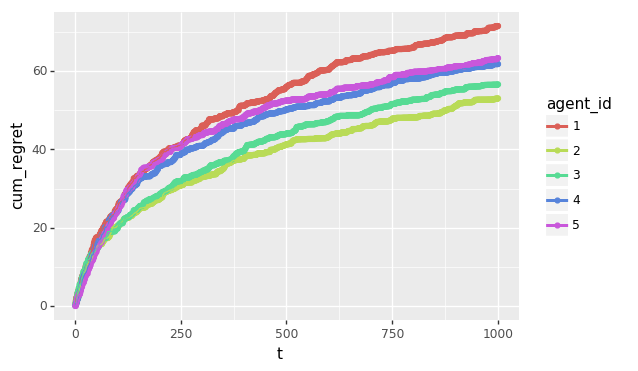

<ggplot: (8730389918297)>


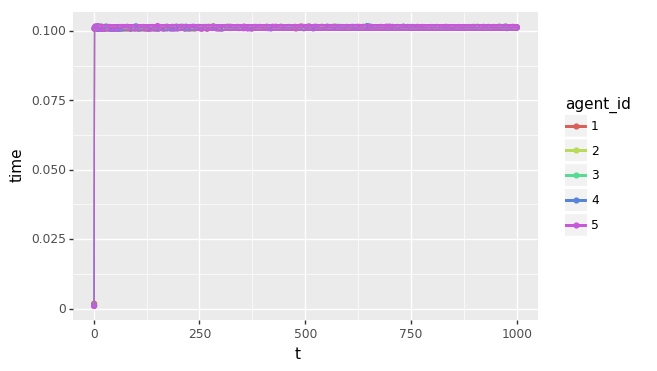

<ggplot: (8730389739421)>
theta [ 1.78862847  0.43650985  0.09649747 -1.8634927  -0.2773882  -0.35475898
 -0.08274148 -0.62700068 -0.04381817 -0.47721803 -1.31386475  0.88462238
  0.88131804  1.70957306  0.05003364 -0.40467741 -0.54535995 -1.54647732
  0.98236743 -1.10106763 -1.18504653]
Experiment: Step 0
 Sample: array([ 0.38825041, -0.38712718, -0.58722031,  1.91082685, -0.45984615,
        1.99073781, -0.34903539,  0.25282509,  1.08940955,  0.02392202,
        0.39312528, -0.2413848 , -0.47552486, -0.16577702, -0.64971742,
        1.63138295, -0.1676986 ,  1.7226692 , -2.68510868,  0.01842079,
        0.56195167])
 Steps taken: 0
 Sample: array([-0.29382124,  1.09465308,  0.63969236, -0.27460012,  0.43500926,
        2.81187838,  0.25199513,  0.29950233, -0.43999131,  0.13349704,
       -1.28926119, -0.19829026,  2.45758763,  1.06721555,  0.64142066,
        1.10392166,  1.88175499,  0.59358811,  2.07087853,  1.06979836,
        0.16651951])
 Steps taken: 0
 Sample: array([ 1.71947

 Sample: array([ 0.08708857,  1.73227862,  1.60740248,  1.11010539, -1.56425717,
        1.2567898 ,  0.46429154, -1.00095511, -0.78740919,  1.39228039,
       -0.91086453, -0.32059481, -0.08274312, -2.1477136 , -1.12705986,
        1.5063836 ,  0.60239016, -2.03483573, -1.05759245,  0.3072323 ,
        0.01850532])
 Steps taken: 1210
 Sample: array([-1.13992116,  0.51570712, -0.18915742,  0.62709784,  0.7559812 ,
        0.82001768, -0.09172583,  0.3932912 ,  0.19461527, -0.23545753,
        0.60484194,  0.67222809,  0.74140484, -0.83962567, -0.18111892,
        0.49497152, -2.16738736,  1.36143644, -2.05074126, -1.22757527,
       -0.00827804])
 Steps taken: 1202
Experiment: Step 5
 Sample: array([ 1.40068604,  2.61916063, -0.6043336 , -1.64605801,  1.43014826,
        0.93828681, -0.33513441, -0.4427534 ,  0.28583994, -0.75847027,
       -0.86234876,  0.35037341, -0.09248549,  0.17971002,  1.10758635,
       -0.05368408, -0.47070685,  0.76124185, -1.3991117 ,  0.8563176 ,
       -0.

 Sample: array([ 1.24903244, -0.54453506,  2.60568655,  0.52577989, -0.28860953,
        0.76231786,  1.61397956, -0.59659091, -0.56361845,  1.00786005,
        0.06618877,  1.24880086,  0.91002741, -1.46381796, -1.17293788,
        0.02732641, -0.82413282,  0.18996434,  0.29001438, -1.04777849,
        0.28040402])
 Steps taken: 1156
Experiment: Step 10
 Sample: array([ 1.5834794 , -0.05246482, -0.79610422, -0.09898315, -1.48119306,
        0.5631518 , -0.6067203 , -1.47347556,  0.39721111,  0.68281316,
       -1.53979499, -0.77186494, -0.05856705,  1.30538706, -1.33532298,
       -2.35331727, -0.72092714,  1.06039702, -0.32683504, -0.36845652,
        0.38596479])
 Steps taken: 1154
 Sample: array([-3.08879153e-01,  1.05987586e+00,  6.04035807e-01,  6.83679508e-01,
       -2.63618919e-01,  6.57124406e-01,  7.19967319e-04, -1.13859462e+00,
        9.66674975e-02, -1.78183085e+00,  7.28598212e-01, -1.05931079e+00,
        1.53678853e+00,  4.41849554e-01,  1.21346002e-01, -7.21298532e-0

 Sample: array([ 1.2015949 ,  2.23398472, -0.10421557,  0.09632879,  1.10771466,
       -0.22678901, -0.65828408,  2.0430878 , -0.47232763,  0.53645629,
       -1.75227487,  1.8934323 ,  1.1575041 , -1.11370582, -0.52776366,
        0.28133794,  0.29563476, -0.67347623, -0.4274553 ,  0.52886987,
       -0.44290139])
 Steps taken: 1110
Experiment: Step 15
 Sample: array([ 1.24642312e+00,  2.37953901e-03, -4.16996888e-01,  2.86960940e+00,
       -4.00317046e-01, -5.87672460e-01,  1.53408027e+00, -1.63480806e+00,
       -1.84420778e+00, -1.51287048e+00, -1.50414141e+00,  8.45224862e-01,
        2.02573400e+00,  9.05467137e-01, -1.63318394e+00, -5.11158139e-01,
       -1.12548968e+00,  9.42737519e-01, -6.13578875e-01, -4.82440537e-01,
       -1.10630008e+00])
 Steps taken: 1118
 Sample: array([ 0.2806277 ,  0.64106857,  0.16052332,  0.74098661,  0.48754002,
        0.39171818, -1.23057693,  0.01580534,  0.67832164, -0.61800261,
        1.54041816,  0.10404346,  0.60315802,  0.96946731, -0.

 Sample: array([ 0.52563396,  1.12301979,  0.59023177,  0.26957949,  0.15469299,
        2.36884125, -0.28636747, -0.93867766, -0.85369923, -0.06728289,
       -1.91746459,  0.23062464,  0.0315159 ,  0.9736339 ,  1.3271876 ,
       -0.49966737,  1.88079254,  0.84865843,  1.45137784, -1.50525167,
        0.03343398])
 Steps taken: 1063
 Sample: array([ 1.2690616 , -0.46925014,  1.68060028, -1.0628584 ,  1.56346001,
        0.65730325,  1.13419938, -0.50009067,  0.60283318,  1.66126259,
       -0.2818277 , -0.17145901,  0.66122035, -0.81582746, -0.21817653,
       -0.48144092,  0.31459661,  0.80801415, -0.44106999, -0.75223237,
        0.41262115])
 Steps taken: 1093
Experiment: Step 20
 Sample: array([ 2.0036643 , -0.32386642, -1.40617018,  1.69881132,  0.08641314,
        1.60987242, -1.21497125,  1.54669054, -1.49083944,  1.52360998,
       -1.92447107,  1.38720429,  0.46858342,  1.15805628,  0.48031412,
       -0.71201637,  1.49495285, -0.07154086,  0.56234592,  1.29766641,
       -1

 Sample: array([ 2.17161779, -1.40289921, -0.16699999,  0.16469562, -0.07857034,
        0.72577246, -1.15920286, -0.70344825,  0.44073803, -0.34993473,
       -1.43623732, -0.98803582,  0.62009381, -0.26949931, -1.3839334 ,
       -0.28974825,  0.23044557, -0.28935956, -0.98247036, -0.20327715,
       -1.18705914])
 Steps taken: 1038
Experiment: Step 25
 Sample: array([ 1.23195796,  0.49958021,  0.89806415,  1.2816101 , -0.1251808 ,
        0.77527302, -0.6464382 ,  0.91164652, -1.10352878, -1.08943464,
        1.2508574 , -0.5821573 ,  0.75474505, -0.43505221, -0.57134969,
       -1.9390888 , -0.2904644 , -0.38283835, -1.41875439,  1.77748718,
        0.07604374])
 Steps taken: 983
 Sample: array([ 0.3017608 ,  1.10579646, -0.01251987, -0.23772958,  0.59290923,
        1.8548584 ,  1.03682514,  1.13419901, -0.17184417, -0.18391234,
       -0.32203718,  0.7554084 ,  0.76820143,  0.73094905, -0.64640864,
       -1.79781045, -0.55959688, -1.96375042,  0.5037237 , -1.4576242 ,
        0.

 Sample: array([ 0.91002482,  0.69492691, -1.46999101, -0.96800099,  0.5909331 ,
        1.19472198, -0.61962115, -0.7400321 , -0.44006119, -1.16873663,
       -0.21751816,  0.22032928,  0.17711989,  0.75777533,  1.3300386 ,
        0.17507035,  0.01649724, -0.55264501,  0.34259004,  0.14775605,
       -0.88536265])
 Steps taken: 1009
 Sample: array([ 1.69490949, -0.20994988, -0.77705143,  0.87046686,  2.13132874,
       -1.40452086, -1.21068848,  0.76404313,  1.50759817,  0.70445234,
       -0.67753748, -0.74810247,  0.64749362,  0.12866302, -0.01857932,
        0.04693625, -0.25369758, -1.55350853,  1.64392861, -0.71665556,
       -2.36098349])
 Steps taken: 987
Experiment: Step 30
 Sample: array([ 0.63766858,  1.23566222, -1.42596542,  1.68020958, -0.38771129,
        1.05573496, -2.45791461,  0.72512886, -0.4266936 , -0.13650756,
        0.36997076, -0.11263965,  0.81561399,  0.97953493, -0.12502906,
       -0.80560053,  0.18670857, -0.64895593, -0.7616598 ,  1.72951253,
        1.

 Sample: array([ 2.45185915, -0.00798586, -1.29494405, -0.56960845, -0.28861295,
       -1.13864182,  0.0155165 , -0.14147008, -1.60373585, -0.56504781,
       -1.41178533,  0.24291351,  2.35347816,  1.94745696,  0.73618793,
        0.32760883, -0.62553649, -0.11207743,  0.37240233, -0.74769684,
       -2.66345719])
 Steps taken: 778
 Sample: array([ 1.25217332,  0.36895579, -0.11640488, -0.73022303,  0.77994293,
        3.04936714, -0.27884995, -1.19315577, -0.57154939,  0.62044582,
       -0.93300115,  2.02599408,  1.53159365,  1.90068738,  0.68933223,
        1.97893284, -0.47140587, -0.48503291,  1.48005778, -1.63552903,
       -1.85879889])
 Steps taken: 788
 Sample: array([ 1.94139522,  0.67389307,  0.74361198,  0.61902359, -0.15236428,
       -0.23641062, -0.10078914,  1.94450033, -0.57157006,  1.32941147,
       -1.10276036, -0.71999435,  1.20690596, -0.2903453 ,  0.50628562,
       -2.18320375,  0.70156085,  0.32528622, -0.55592455, -1.03701823,
       -1.50597578])
 Steps tak

 Sample: array([ 0.55285993,  1.31057859,  1.04745984,  0.57563677,  0.28401711,
        2.5425028 ,  0.6112995 , -0.23731526, -0.78217569, -0.46751958,
        0.52098108, -0.86356064, -0.67557227,  1.00734746, -0.72270051,
       -0.52278091, -1.50871135, -1.95405667,  0.4958325 , -0.9224339 ,
        1.48438979])
 Steps taken: 780
 Sample: array([ 1.212412  ,  0.35434033,  0.96120661, -0.52023847, -2.0384248 ,
       -0.41996156, -0.71221003, -0.82474006,  1.06541922, -0.5187449 ,
       -0.49310973, -1.31299928,  0.45697908,  0.96833083, -0.22639026,
        0.23081045, -0.36328536, -1.28948899, -0.03322829, -0.27881851,
       -0.94249114])
 Steps taken: 789
 Sample: array([ 1.27169176, -0.68387995, -0.11262811, -0.6660915 ,  0.36990956,
        0.23307366,  0.06971164, -0.24751328,  0.42813906, -2.65253959,
       -0.68614157,  1.48484192,  1.39311486,  0.6932024 , -0.35486627,
       -0.39996602,  0.42899148,  0.21669288, -0.19215352,  0.02193549,
       -0.00364964])
 Steps tak

 Sample: array([-0.33302204,  0.79529452,  0.04358809,  1.9181135 , -0.73262538,
        1.14463787, -1.42423636, -1.75340276, -1.32214215, -0.64433014,
        1.0987429 , -0.23184752, -0.24573615,  1.00269085, -0.18537008,
       -0.83015443, -0.65915977,  0.76246335, -1.23303045,  0.31107257,
       -1.27531006])
 Steps taken: 784
 Sample: array([ 1.21472271,  1.52435674,  0.27911422, -1.14352449,  0.45556764,
        0.59298399,  0.46438435, -1.07605195,  1.65343587,  0.4040991 ,
       -0.44443593,  0.86487898,  0.47030087,  0.96765114, -0.90324899,
       -1.21710542, -1.58077452, -0.78651132,  1.5004917 ,  0.53550163,
        1.86266343])
 Steps taken: 786
 Sample: array([ 1.23567315,  1.39114484, -0.57155062,  0.73537915,  0.18690225,
       -0.55647721, -0.09752733,  0.40073793,  1.84995556, -0.47116823,
       -1.67676469,  0.30786438,  2.01800078,  1.32568956,  0.36312054,
       -0.03547201, -0.09459204, -0.98239827, -0.08758576, -1.54203455,
       -0.90609939])
 Steps tak

 Sample: array([ 0.57385853,  0.68589945, -0.62236311, -0.61449449, -0.66035243,
       -0.67821833, -0.91270018, -0.89734734,  1.4849125 , -0.90117128,
        0.33864125,  1.50223343,  0.07411398,  1.18457443,  0.17664345,
       -1.81924381, -1.55413377, -1.25505304, -1.01327416, -0.48829136,
       -0.8399572 ])
 Steps taken: 782
 Sample: array([ 2.27683764,  0.06061925,  0.1431177 , -1.66498011, -0.47316763,
       -0.71178332, -0.59102227,  0.48444013,  0.3808447 ,  0.42370174,
       -1.47339329,  0.02053128,  2.34464278,  1.95148901,  1.47958743,
       -1.20711786, -0.01640863, -0.89202689, -1.70382251, -0.73087946,
       -0.54260309])
 Steps taken: 785
 Sample: array([ 1.40256112, -1.53788817,  0.69301666, -0.79837778,  1.11406225,
        1.71028274, -0.35659079,  0.21494193, -0.10614185, -0.18274709,
       -0.08440095,  1.03250239,  0.4674899 ,  1.93206804,  1.33225641,
        0.80240285,  0.41988254, -0.64531454, -0.66588785, -0.91950802,
        0.24161491])
 Steps tak

 Sample: array([ 1.38277408, -0.03830984,  0.15387363,  1.18319186, -0.07506478,
       -0.9329621 ,  0.38176017, -0.73415764,  0.45057494, -1.2259473 ,
       -2.34622724,  2.09643591,  0.57160576,  0.93884371,  0.85397658,
       -0.99515614,  0.10020046, -2.15820168, -0.38345312,  0.25556496,
       -1.82543772])
 Steps taken: 778
 Sample: array([ 1.3439407 ,  0.88730916,  1.15648738, -1.24531511, -1.11109683,
        0.54941517, -0.17489391, -0.57179827, -1.51030966, -2.29174552,
       -1.21161794,  0.73070782, -0.80872131,  1.28022117,  0.58740175,
        2.13869865,  0.94911798, -1.10807494, -0.63446488,  0.37275867,
       -1.29765793])
 Steps taken: 778
 Sample: array([ 3.2370761 ,  1.29215887,  0.66131664, -0.86424827, -1.44687947,
       -0.10363167, -0.82429736,  0.55498311,  0.76659043,  0.19098424,
       -0.77116569, -2.06864688,  3.11767247, -0.44290996,  0.73428991,
       -0.83234111,  0.57465406, -2.29161647,  0.19864072, -0.61172224,
       -0.6461633 ])
 Steps tak

 Sample: array([ 1.00403634,  1.13973644,  1.64095587, -0.00825043, -0.19268231,
        0.20705417, -0.85684678, -1.42312021,  0.43241428, -2.50054837,
       -1.13809159, -0.07409026,  0.26002978,  0.08405777, -0.79515838,
       -2.13022346,  0.40903063, -1.54876003, -0.42227005, -1.70495447,
        0.19351197])
 Steps taken: 782
 Sample: array([ 1.90957477,  1.83681449,  0.0303759 , -0.49730188, -0.43413148,
        0.23865637,  0.26931315, -0.28642646,  0.53976305,  1.33791628,
       -0.52315494, -0.01353298,  2.14194101,  0.95106291, -0.82381966,
       -0.49363551,  0.77156506, -0.69954334,  0.7557252 , -0.30132643,
       -0.49408355])
 Steps taken: 787
 Sample: array([ 1.70561778,  0.81776221, -0.73964387, -0.99767374, -1.4985281 ,
        0.80484894,  0.70779612, -0.69107545,  0.99637663, -1.37520538,
       -1.75645817,  0.06747087,  0.56724982,  0.65360949, -0.5262811 ,
        0.86808421, -0.01633954, -2.23971108, -0.72610538, -0.28319992,
       -1.20399486])
 Steps tak

 Sample: array([ 0.69867701, -0.46062828,  0.11770763,  0.50993884, -1.26677632,
        0.28700752, -1.50303629, -1.25719354,  0.2166207 , -0.76835178,
       -1.04391941,  0.38566769, -0.31229526,  1.52504169, -0.0835887 ,
       -0.78223553, -0.93852974,  0.37699839, -2.58175056,  0.42077427,
       -0.65046693])
 Steps taken: 778
 Sample: array([ 1.58466858,  1.54488834, -0.52679529, -0.02109572, -0.90521926,
        0.40046101, -1.34801263, -0.3378972 , -0.32147369, -0.60319828,
        0.56359604,  1.84021312, -0.20519477,  0.55294377, -0.44643952,
       -2.26120175, -1.667066  , -1.21997787, -1.20167583,  0.71647403,
        0.63459425])
 Steps taken: 784
 Sample: array([ 1.71193254,  0.25126217, -1.34985367,  0.09817696, -0.61953473,
        0.1793929 , -0.80708304, -0.46217365,  1.42301791, -0.67575486,
       -1.53421573,  0.47701465,  0.05939027,  1.26077853,  1.56288285,
        1.49807803, -0.31599292,  1.17558459,  0.17019733,  0.36887681,
        0.14042816])
 Steps tak

 Sample: array([ 1.71490304,  0.01176575,  0.58110286, -0.48701492, -0.21040401,
        1.17107475,  0.46825321,  0.23914909,  1.4862964 ,  0.38950551,
       -1.30097749, -0.91027532, -0.13505494,  1.5501159 , -0.11482954,
        0.32545693,  0.79938378, -1.77297713, -1.54338152,  0.13162632,
        0.61887611])
 Steps taken: 773
Experiment: Step 69
 Sample: array([ 0.69352913, -1.09308494, -0.88276366,  0.96490707,  0.27991053,
        0.38279491, -0.86527056, -0.6827128 , -0.87701598,  0.44058677,
       -0.88771028,  1.25388374, -0.26393537,  0.43497673,  0.42648968,
       -0.57003631, -0.53191145,  1.09435535,  0.13608127,  0.1022621 ,
        0.4828305 ])
 Steps taken: 771
 Sample: array([ 1.23478208, -0.08623514,  0.44611849, -1.69219847, -0.75492173,
       -0.53129605,  0.55930381, -0.37589447,  0.13900173, -2.64830508,
       -0.72692063, -1.0741235 ,  0.88618225,  1.05685968,  0.32948631,
       -2.2881018 ,  0.92396779, -2.35560282,  0.27866526, -0.79542529,
       -0.8

 Sample: array([ 1.06229202,  0.4815375 ,  0.72117373,  1.02385704, -0.87561921,
        0.60032825,  0.08789972, -0.49411958,  0.0934736 , -0.32803711,
       -1.72265709,  1.11195432, -1.24157979,  1.77831294,  0.22820352,
       -1.32156018,  1.43302609,  1.18933568, -1.33792755, -0.05537244,
       -1.17020058])
 Steps taken: 774
 Sample: array([ 1.36597633,  1.17997292,  1.33911581, -0.01067228, -0.88962223,
        0.41869995,  0.19278771, -0.61735926,  1.25220262, -0.7107681 ,
       -0.57707882,  0.48556314, -0.01125527,  1.16238614,  0.48657729,
       -0.14206774, -0.47478526, -1.57897806, -0.20296911, -0.76815179,
       -0.48388414])
 Steps taken: 778
 Sample: array([ 1.63952646, -0.9129237 , -0.22949272, -0.5597538 , -0.87827919,
       -1.4833723 , -1.41457948, -0.84423429, -0.30209333,  0.71352839,
       -1.73253014,  0.59974561,  2.49377803,  0.94458946, -0.60135619,
        1.00239448,  0.42533989, -1.0081587 ,  0.95737298, -0.90271228,
       -1.10251325])
 Steps tak

 Sample: array([ 2.288526  ,  1.33085823, -0.09730246,  0.89779434, -0.25468112,
       -0.2019392 , -0.24719155,  0.24875652,  0.15008301,  1.37452147,
       -0.70950411, -1.10329343, -0.06181142,  0.21826862, -0.71257848,
        0.18130234, -0.04265782, -2.17880514,  0.85240497, -1.33102562,
        0.95715239])
 Steps taken: 772
Experiment: Step 79
 Sample: array([ 0.81758688, -0.91842223, -0.32370922,  0.63050313, -0.66036916,
       -0.1994337 , -0.72018104, -1.4901229 , -0.51014887, -0.13184904,
       -0.62355783,  1.0767994 , -0.04416869,  2.2715304 ,  0.26603575,
       -0.69210578,  1.37390339, -0.61071462, -1.8929955 , -0.67356261,
       -1.57651237])
 Steps taken: 780
 Sample: array([ 0.97749497,  1.09941557,  0.90807111, -0.70185123, -2.09839401,
       -0.19067533, -1.2386905 , -0.68566238, -0.30516966, -0.40391115,
       -1.15503967, -0.42998242, -0.38228606, -0.07883432,  0.03356099,
       -0.11299913,  0.11578581, -2.33408716,  0.84138662, -0.62452958,
       -1.6

 Sample: array([ 1.28285533,  0.15695333, -1.19597128, -0.5650126 , -0.27951275,
        0.51965373, -1.03255002, -1.75725028, -0.22559782, -0.03760164,
       -1.33032099,  0.66129465, -1.39748953,  1.9473997 , -0.41791517,
       -0.96774942, -0.10511745, -1.0516406 , -2.15866173,  0.61319467,
       -0.13140368])
 Steps taken: 775
 Sample: array([ 0.96430829,  2.03918706,  0.66312339, -0.6427493 ,  0.04651508,
       -0.20211083, -0.49966887, -0.61123076, -0.24799509, -0.01624135,
       -1.35149969, -0.34359723,  0.48223945,  1.95020992,  0.51029798,
       -0.69155683,  0.20892897, -2.0057125 ,  0.24575767, -0.49994961,
       -0.28682869])
 Steps taken: 776
 Sample: array([ 1.98420967, -0.57630306,  0.96640525, -1.62065423, -0.73074072,
       -0.27709175, -1.74010603, -0.4554606 ,  0.67450566, -0.8755538 ,
       -0.6495568 ,  1.26013084,  2.44759814,  2.05078655,  1.04479941,
       -0.28414307,  0.15160526, -2.08097844,  1.0782381 , -1.23077425,
       -1.64065773])
 Steps tak

 Sample: array([ 1.47079406, -0.25860887,  0.52798677, -1.23732762,  0.72852255,
       -0.08511431, -0.15175462, -0.93616229,  0.16105528, -1.21770606,
       -0.5303204 ,  0.38413241,  0.59307621,  1.36645529, -0.06276893,
       -0.60763797, -1.89794425, -1.74721015, -0.13888395, -1.56520369,
       -0.88520863])
 Steps taken: 770
Experiment: Step 89
 Sample: array([ 1.42650444,  0.34940169, -0.21560075, -0.19467663, -0.13531686,
       -0.99343375, -0.71239013, -1.11595536,  0.32619025,  1.79704639,
       -0.79584738,  0.5635629 , -0.31182537,  0.71407531,  0.37032221,
        0.25481364,  1.13086928, -0.18211048, -1.07981811, -0.63825096,
       -2.25955879])
 Steps taken: 780
 Sample: array([ 1.20770913,  0.65065445,  0.51844544, -0.55318422, -0.27678381,
        0.27195661,  0.21944057,  0.30193634,  0.07355738, -0.66065262,
       -0.81467813,  0.37026669,  1.03528097,  2.06120787, -0.56426798,
       -0.54394965, -0.36014959, -2.13623218, -0.57597268, -0.72341941,
       -0.5

 Sample: array([ 2.37064066, -1.24006678,  0.17828487, -1.81713864, -1.18157466,
        0.6763276 , -0.39442101,  0.81109092,  1.09927153, -0.72873605,
       -2.22450232,  1.11714123,  1.49977566,  0.91388979,  0.59164745,
        0.17370545,  0.46592911, -0.96500821, -1.30910055,  0.67460652,
       -2.54559903])
 Steps taken: 774
 Sample: array([ 1.09879415,  1.12021955,  0.60960921, -0.7902104 , -0.66231141,
       -0.57940087, -1.05119096, -0.41354341,  0.81995537, -0.56223001,
       -0.38106258, -0.59649329,  0.34375988, -0.67071966,  0.18261604,
       -0.23576404, -1.71571089, -1.131846  , -0.3497717 , -1.57196014,
        0.80796276])
 Steps taken: 782
Experiment: Step 94
 Sample: array([ 1.24883653, -0.541623  , -0.74164688,  0.57074914, -0.87046047,
        0.2099929 , -1.16463705, -2.67103844,  0.61009036, -0.6335183 ,
       -1.78604307, -0.50511029, -0.94994186,  1.56246508,  0.05814022,
       -0.69437637,  0.43827166, -0.40853616, -2.2790824 ,  0.07363551,
       -1.8

 Sample: array([ 1.76388384,  0.45863146,  1.09180884, -0.53558022,  0.25338937,
       -0.6589713 ,  0.27294307, -0.51190552,  0.35494669,  0.26856906,
       -1.69199471,  0.87164911,  0.82917362, -0.30086891,  0.08767305,
       -0.93741279, -0.22779998, -0.1707914 ,  1.03738693,  0.17762638,
       -0.85854227])
 Steps taken: 766
 Sample: array([ 1.47937324,  0.14393772,  0.41292857, -0.12534491, -1.28033171,
        2.28923077, -0.24690222, -1.04322504,  1.52663792,  0.6450645 ,
       -0.85196975,  1.80999886,  0.30737692,  2.65349312, -1.54255187,
        2.00782002, -0.03500017,  1.80839926,  0.08912433, -1.14057476,
       -1.73000315])
 Steps taken: 781
 Sample: array([ 1.61330039, -0.1269833 ,  1.15477739, -0.33204502, -1.23689514,
        0.74623138, -0.40278014,  0.3801747 , -0.13693607,  1.37438206,
       -0.77786152, -0.90671157,  1.15111634,  1.51162315, -1.13607969,
       -0.27841187,  0.05099173, -0.55559281,  0.23223234, -0.36913534,
        0.07081442])
 Steps tak

 Sample: array([ 1.12293488,  0.83414441,  0.12038428, -0.34495563, -1.98767819,
        0.16244138, -0.15793341,  0.07964115,  0.25641648, -0.44082383,
       -0.3273126 ,  0.05826197, -0.55149469,  1.3973092 ,  0.40192128,
       -1.09684443, -0.43765062, -3.0556502 , -0.17172489, -0.15922535,
       -0.72190475])
 Steps taken: 768
 Sample: array([ 2.08818135,  0.4173921 ,  0.60352791, -0.90261336, -1.26014651,
       -1.25515   , -0.82646752, -1.35006983,  1.09774686,  0.50329619,
       -0.24149765,  1.02882373,  2.0933405 ,  0.09550769,  0.6238631 ,
       -0.08221824,  0.8802531 ,  0.3285988 ,  0.00421212,  0.20981956,
       -1.32750203])
 Steps taken: 784
 Sample: array([ 1.57355673,  0.53462146,  0.48320172, -0.89871055, -0.80429027,
        0.70311926, -0.82041114, -0.82701841, -0.16593923, -0.59084794,
       -1.67958929,  2.69711469,  1.67756346,  0.50364739, -0.14066004,
        1.05064161, -0.02259216, -1.21637427,  0.4653398 , -0.69657616,
       -1.3003827 ])
 Steps tak

 Sample: array([ 1.57819617,  0.48491461, -0.01439178, -0.49997868, -1.24544546,
       -1.65269526,  0.8504723 , -0.80686046,  1.18314619, -0.50406767,
       -0.07492916,  0.58463802,  1.68312099,  0.21491247,  0.88752395,
       -0.2934496 ,  0.74405527,  0.6131589 , -0.39754697, -0.88216397,
       -0.60966867])
 Steps taken: 766
 Sample: array([ 1.61708147, -0.13897998,  0.27533048, -0.2470566 , -0.62225424,
        0.62717097, -1.21706994,  0.66428524,  0.66327175, -1.05792155,
       -2.84330922, -0.0074507 ,  1.02259429,  1.4320305 ,  1.22764846,
        0.25288886,  0.39362662,  0.2315417 , -0.04615675, -0.21060818,
       -1.58509953])
 Steps taken: 788
 Sample: array([ 0.90735558, -0.29118647,  0.84025   , -1.11328877, -0.69743852,
       -0.84912467,  0.02110802, -0.66666372,  0.57790701,  0.65923398,
       -1.12913561,  0.12219409,  2.33810222,  1.02452875, -1.95200892,
        0.26638763, -0.01301159, -0.84317548,  0.81319387,  0.27596373,
       -1.56430146])
 Steps tak

 Sample: array([ 1.40322354,  1.51399715,  0.46875774,  0.71611879, -1.66873266,
        0.19789364, -0.67059155, -0.57133554,  0.71347235, -0.16443782,
       -1.69173176,  0.58733234, -0.30934242,  0.83231159,  0.57854154,
       -0.92077994,  1.81319141, -2.33651842,  1.09391151, -0.24814578,
       -0.98402628])
 Steps taken: 778
 Sample: array([ 1.24617368, -0.88094423,  0.22994175, -1.28387689, -1.99389767,
        0.08732138,  0.56131711, -0.93673856, -0.31850516, -0.78039929,
       -1.0694023 ,  1.07988522,  1.38666481, -0.85757268, -0.60588609,
       -1.44529394,  0.72613735, -0.98590577,  0.55760274, -0.17835539,
       -2.19186657])
 Steps taken: 785
 Sample: array([ 1.78805511, -0.34561147,  0.15037624, -0.64320804, -1.3373182 ,
        0.93747776, -0.85245727, -1.1614347 ,  1.14867254, -0.11997948,
       -1.21111502,  0.94275448,  0.93042417,  2.02295425, -0.05896887,
        0.74575607, -0.57734004,  0.43228696,  0.70441523, -1.02923583,
       -1.09452219])
 Steps tak

 Sample: array([ 0.95970362, -0.4467709 , -1.30653024, -0.19892138, -0.91746826,
       -0.55547598, -1.3152871 , -2.05907626,  0.67846462,  0.11872373,
       -1.53696114,  0.64424607, -0.15460311,  1.45468968,  1.5345784 ,
        0.80970038,  0.22471747, -2.23014594, -0.52973348, -0.24588354,
       -0.17123895])
 Steps taken: 773
 Sample: array([ 1.08312122e+00,  1.17869594e+00,  2.27988642e-01, -4.48699986e-01,
       -8.05400530e-01,  3.09877348e-01, -1.10656945e+00, -3.80525511e-01,
        1.49497207e+00, -5.52865550e-01, -1.06691850e+00,  7.60131081e-01,
       -1.14003756e-03,  2.33019188e+00, -1.34890123e+00, -2.61155950e-01,
       -4.84205649e-01, -2.71437392e+00,  7.77873790e-01, -1.37248965e+00,
       -3.52143729e-01])
 Steps taken: 782
 Sample: array([ 1.29226769,  0.0824462 , -0.27643489, -1.00240264, -0.68893952,
       -1.91479527,  0.94605031, -1.36627771,  0.63254353, -0.92895784,
       -0.13959678,  0.71015035,  0.38466809,  0.07418733,  0.50850195,
       -0.15

 Sample: array([ 1.27786535, -0.33201308, -0.3928382 , -0.31817661, -0.3447176 ,
       -0.34000905, -0.16302395, -0.69736113,  0.54875237, -0.1797897 ,
       -0.24187565,  0.18523031,  1.82423101,  0.44369481, -1.24412695,
        0.36317752, -0.83827237, -2.42399222, -0.81522833,  0.24880124,
       -1.03095112])
 Steps taken: 774
Experiment: Step 123
 Sample: array([ 1.43498914, -0.15399563,  0.13615204,  0.62469661, -0.08235733,
       -1.06962148, -0.93022266, -1.90637998, -0.17254447, -0.31305519,
       -1.3801468 ,  0.08565969, -0.20004119,  0.86066623,  1.38178538,
       -0.02158676,  0.56195607,  0.14440248, -1.13112753, -0.430944  ,
       -1.40650601])
 Steps taken: 783
 Sample: array([ 1.30181088,  1.09265766,  1.25981185, -1.3339649 , -0.97781358,
       -0.27661606, -0.21065428, -1.21115386,  0.52030224, -1.7204939 ,
       -1.52680563,  0.58828748,  0.25394128,  1.3044241 ,  0.05169676,
        0.03083782,  0.88488096, -2.05397225,  0.12248635,  0.1843787 ,
        0.

 Sample: array([ 2.46934186,  0.4800787 ,  0.96743722, -0.31237039, -2.18535002,
       -1.08314058, -0.70779472,  0.29708723,  0.43182605, -1.03960791,
       -1.84092678,  1.24263682,  1.19699818,  0.63434407,  1.20716785,
        1.23781539, -0.32138953, -0.95070635,  0.16961399, -0.02351037,
       -1.86182799])
 Steps taken: 771
 Sample: array([ 1.53624952, -1.36205251,  0.37680376, -1.36865828,  0.12955467,
       -0.25162641, -0.55460828,  0.11412123,  0.69054546,  0.09430173,
       -0.92226092,  0.66129773,  0.84830185,  1.22008776, -0.59352089,
        0.51055014,  0.00299601,  0.19108494,  0.44638812, -1.19802879,
       -1.0048888 ])
 Steps taken: 776
Experiment: Step 128
 Sample: array([ 2.13752446e+00,  1.32191374e+00, -8.36917155e-01, -2.10832305e-01,
        4.40095119e-01, -9.28376896e-03,  8.26004398e-01, -2.03473695e+00,
       -1.06518820e+00,  2.05339523e-01, -2.02598507e+00,  1.08783817e+00,
       -7.74177326e-02,  1.62967072e+00, -4.16446266e-01, -2.23681878e-01

 Sample: array([ 1.49843998,  0.91221571,  0.54459758, -0.08603669, -0.7475936 ,
       -0.30670553, -0.46106148, -0.79455421,  0.50052535, -0.0351575 ,
        0.35790359, -0.80780703,  0.6745337 ,  0.53552623,  0.80029149,
       -0.59608906,  0.32302599, -0.48397071,  0.40066668, -0.61764537,
       -0.90412815])
 Steps taken: 772
 Sample: array([ 1.8574977 , -0.20051916,  0.41024593, -1.62871976, -1.49417552,
        1.14434366,  0.8093142 ,  0.49877067,  2.21899996, -0.84032209,
       -2.29877282,  2.06357408,  0.20963655,  1.13731892,  0.0134    ,
        0.22420634,  0.06984654, -0.82849373, -0.2887729 , -1.49286983,
       -0.95504156])
 Steps taken: 781
 Sample: array([ 1.04698256,  1.47189104,  0.49120874, -1.379806  , -0.40899028,
       -0.05540112,  0.14029359,  0.19404472,  1.10494906, -0.38399911,
       -0.53068622, -0.20358334,  2.37533087,  0.24554245, -1.87690406,
        1.38615238,  0.07438394, -0.04304641,  0.57753635, -0.91124448,
       -0.6884168 ])
 Steps tak

 Sample: array([ 2.4541098 ,  0.06380772, -0.02025699, -0.85948689, -0.31687896,
        0.14830567,  1.06306296, -0.52875082,  0.62830594, -0.90988044,
       -1.50819995,  2.00444552,  0.7398443 ,  0.95235141,  0.8204277 ,
        1.42293522, -0.59649958, -1.67080225, -0.30916186, -1.24429641,
       -0.72686515])
 Steps taken: 776
 Sample: array([ 1.05907834e+00,  6.36266649e-01,  1.40757780e+00, -7.64355664e-01,
       -3.87497758e-01,  5.15840390e-02, -1.18445060e+00,  7.74683502e-01,
        5.23593901e-01, -8.04219071e-01, -4.41783597e-01,  1.44837932e-01,
        1.21560034e+00,  1.04194114e+00, -6.48956764e-01,  1.12238910e+00,
        4.43540101e-01,  1.10048729e-03, -5.87441027e-01, -2.85655440e-01,
       -8.68739701e-01])
 Steps taken: 782
Experiment: Step 138
 Sample: array([ 1.57608246, -0.64801343,  0.26893457, -0.85293817, -0.13071402,
        0.64944506, -0.41755129, -0.91406545, -1.16400122, -0.71957874,
       -0.89863119,  0.88225064,  0.51363871,  3.06240907,  0.1

 Sample: array([ 1.47805398,  0.15159837,  0.8527623 , -0.89022648, -1.94739056,
       -0.26001839,  0.0668006 , -0.90579166,  0.49871782, -0.8334687 ,
       -0.76451479, -0.15142091,  1.1203544 ,  2.04202859,  0.95861617,
       -1.12435062,  0.4187537 , -1.12291807,  0.22106601, -0.78860141,
       -1.43544955])
 Steps taken: 776
 Sample: array([ 1.88173473,  0.06391662, -0.92992756, -0.62999938, -0.59081871,
        0.89526701,  0.45775606, -0.82020909,  0.94018491, -0.49126025,
       -1.02520719,  0.88109759,  1.18921387,  1.49212266, -0.49567321,
        0.5245472 , -0.15713837, -0.47589611,  0.88318226, -0.83380064,
       -0.47682024])
 Steps taken: 784
 Sample: array([ 1.47728033, -0.48493736, -0.09416719, -1.44386027, -0.34131656,
        0.61260268, -0.25761861, -1.0374039 ,  1.12171514, -0.53344752,
       -1.39445269,  0.22305494,  2.56433382,  1.38008743, -2.04675982,
        0.33077381, -0.03610824, -3.02492911, -0.27883867, -1.37417704,
       -0.88334954])
 Steps tak

 Sample: array([ 1.88299179, -1.34164694,  0.88667488, -1.1536504 , -1.55479179,
        0.34259656, -0.90348799, -1.20460831,  1.11497824, -1.35214549,
       -1.11390436,  1.91216515,  2.31506734,  1.1837999 ,  0.45420558,
        0.08876452,  1.03475216,  0.29793267,  0.61614807, -1.42939933,
       -1.43865879])
 Steps taken: 776
 Sample: array([ 1.91442914,  0.3571623 ,  0.61786905,  0.15270873,  0.80153347,
       -0.06569254, -0.36870863, -1.45528457,  1.03400501,  0.58165997,
        0.22910061, -0.56515081,  2.43279   ,  0.75068922, -1.3396902 ,
        0.91330106, -1.04400137, -0.73482063,  0.01543899, -1.15718133,
       -1.07107596])
 Steps taken: 783
Experiment: Step 148
 Sample: array([ 1.17947803, -0.63103483, -0.09079848, -0.02677352,  0.11208266,
        0.23743233, -0.80733228, -2.03855619, -0.22396118, -0.41408539,
       -0.65383262,  0.7834461 , -0.23413315,  2.01662657,  0.88834288,
       -0.59647545,  0.5684764 , -1.10430859, -1.05510016,  0.48639606,
       -0.

 Sample: array([ 2.11820458,  0.96822212, -0.4025963 , -1.51190912, -1.46376952,
       -2.6354884 ,  0.76374119, -0.7317873 ,  1.44842992,  0.29528857,
        0.17202769,  0.66578506, -0.18778071,  1.27974687,  0.75964647,
       -1.17598413,  1.62091768, -1.71841325,  0.6807971 ,  0.03217245,
       -1.02898869])
 Steps taken: 756
 Sample: array([ 2.04825009,  0.23205383,  1.08628281, -0.7431034 , -1.96290131,
       -0.29748921, -0.36218093, -1.05492797,  1.11974727, -1.73548144,
       -0.86391032,  0.05122365,  1.14062376,  2.20063612,  0.72874319,
        0.72565848,  0.94170365, -1.80028405,  1.08227086, -0.54546717,
        0.42965088])
 Steps taken: 783
 Sample: array([ 1.2846621 ,  0.89144504,  0.2441369 ,  0.26784246, -0.77130432,
        0.15590779,  0.10022259, -0.09680374,  0.41941179, -0.00647076,
       -1.42758973, -0.4501906 ,  1.20718808,  1.96440318, -0.67048864,
       -1.08630955, -0.19165015, -1.82356716,  0.52366248,  0.01985891,
       -0.91265884])
 Steps tak

 Sample: array([ 1.57791116,  0.38627242,  1.58167032, -1.00507389, -0.73024213,
        0.28203192,  0.4212233 ,  0.3341657 ,  0.27718301, -1.60470302,
       -1.3249626 , -0.01646785, -0.14497322,  1.48106906,  0.52208152,
       -0.76636475,  2.27523025, -1.84209953, -0.30812245, -0.00777537,
       -0.74994506])
 Steps taken: 773
 Sample: array([ 1.36983367,  0.51908716,  0.8221766 , -0.4456515 , -1.11269187,
        0.16354913, -1.10262635, -0.96231668,  0.59408358, -0.00579493,
        0.23244003, -0.14379996,  1.67904608,  0.62780081,  0.30746938,
       -1.39291812,  0.9153499 , -1.56029309,  1.46092089, -1.15902532,
       -0.92290427])
 Steps taken: 781
 Sample: array([ 1.99604448,  0.57978616,  0.14501191,  1.22034865, -0.33578359,
        0.06450315, -0.25766582, -1.02623818,  0.12586111, -0.11662519,
       -1.37461155,  2.73704799,  0.88403299,  2.22791888, -1.00765782,
        0.07642174, -0.13913159, -0.48170936,  1.06965592, -1.44923011,
       -0.03187962])
 Steps tak

 Sample: array([ 1.83736448,  0.62360158,  0.64553338, -0.7534531 ,  0.91087369,
       -1.13021163, -0.85647263, -1.11625856,  1.89400197, -1.53556673,
        0.55857734,  0.87370847,  0.04066561,  0.95426614, -0.53557997,
       -0.22774245,  0.66876201, -0.83200473, -0.6102686 ,  0.51109042,
       -1.72531321])
 Steps taken: 756
 Sample: array([ 3.14695595,  1.78800753,  0.13804093, -2.14976276, -0.02056116,
       -0.03372906, -0.33800197, -0.1203562 ,  0.5136773 , -0.86121868,
       -1.81584509,  1.38999844,  1.05039338,  0.61983918,  0.16368103,
       -0.34893376,  0.34824255, -1.23875891,  0.84209307, -0.72782115,
       -0.91566916])
 Steps taken: 770
 Sample: array([ 1.36726189,  0.58143143, -0.46484291, -0.90058204, -0.39900896,
       -1.07312338, -0.37477278,  0.75863498,  1.10394387,  0.39857109,
       -0.59820502,  0.15172029,  1.76748126,  1.05647723, -0.11032792,
       -0.42889686,  0.61685069, -2.36059122,  0.41846293, -1.09949967,
       -1.84733032])
 Steps tak

 Sample: array([ 1.361371  ,  1.23942116,  0.38978204, -1.27009792, -1.44513804,
        0.32316871, -0.77941939, -0.54318327,  0.67700633, -0.76783221,
       -0.35922086,  0.67056573,  0.9958917 ,  1.32234385,  0.21179996,
       -1.41365916, -0.12299252, -1.37839396, -0.67657839, -0.49050043,
        0.35576693])
 Steps taken: 772
 Sample: array([ 1.73180307e+00,  5.18798884e-01,  9.84136938e-01, -1.37191218e+00,
        4.15826023e-04, -1.45463711e+00, -6.95620902e-01, -1.23623322e+00,
        1.40649818e+00,  5.33196756e-02, -1.02187628e+00,  8.73378581e-02,
        2.88850909e+00,  1.58125425e+00, -7.08145560e-01, -1.12128390e+00,
        5.73251982e-01, -1.36441033e+00, -9.07052766e-01, -1.99066092e+00,
       -2.16010493e+00])
 Steps taken: 780
 Sample: array([ 2.19185017,  0.08399796,  0.1120299 , -0.78870198, -0.47083781,
        0.18498952,  1.06112218, -1.63005337,  2.04247166, -1.09768117,
       -1.18543029,  0.24351544,  1.16425247,  0.06871738, -0.45194257,
        0.57

 Sample: array([ 1.11755881, -0.32347748, -0.06339731, -0.7619473 , -1.3824922 ,
        0.16876013, -1.35508618, -1.2551768 ,  0.11664576, -0.59299389,
       -1.27831227,  1.73039833,  0.37157434,  1.10208406, -0.72920084,
       -0.68567582,  0.50145686, -1.03748661, -0.3123374 ,  0.53215718,
       -0.57205556])
 Steps taken: 774
 Sample: array([ 1.08494564,  0.34135045,  0.98582898, -1.95441606, -0.50479009,
        1.03085571, -0.37776541, -0.05390491, -0.30157986, -0.24802155,
       -1.36904857,  0.97001347,  0.54038332,  1.81024297,  0.11396252,
       -2.17409493,  0.77524883, -1.8907425 ,  0.88175011, -0.85052797,
       -1.66662466])
 Steps taken: 782
 Sample: array([ 1.61619437,  0.07877729,  0.44794046, -3.16633534, -1.55383676,
       -0.72265368, -1.0626591 , -1.15313914,  0.96587478,  0.84692924,
       -0.37069339,  1.02289273,  1.23476146,  0.9078974 ,  0.22198263,
        0.24539315,  0.73785737, -1.09091164,  0.12854165, -0.52471195,
       -1.8977764 ])
 Steps tak

 Sample: array([ 1.74482895,  0.22061108,  0.80977013, -1.38405976, -0.04436232,
       -0.09073687, -0.04364146, -0.16019865,  0.2177639 ,  0.33412151,
       -0.02627542,  0.2997781 ,  1.30223243,  0.72000624, -1.14896238,
        0.18188599, -0.44989189,  0.06639885,  0.28025303, -0.49083953,
       -0.6574887 ])
 Steps taken: 770
Experiment: Step 177
 Sample: array([ 1.51686612, -0.45801038, -0.02198157,  0.09101438, -0.18908488,
        0.67155897, -0.73272099, -0.71884265,  0.38466485, -0.05700112,
       -1.68199951,  0.84058975, -0.79731611,  1.13372948,  0.17107656,
       -0.64584175,  1.28676181, -0.64315432, -0.7223688 , -0.18544139,
       -1.01495243])
 Steps taken: 782
 Sample: array([ 1.78107286,  2.46740285, -0.12284544, -1.76988349, -1.22565218,
       -0.57306455, -0.10478144, -0.28819578, -0.09096989, -1.73844716,
       -0.80484351, -0.20850895,  0.03564793,  1.31720134, -1.05721622,
       -0.3326193 ,  0.97112344, -1.44391256,  0.13525616, -0.65068943,
       -0.

 Sample: array([ 1.62839546,  0.64198451, -0.4051766 , -0.68877506, -0.37922642,
        0.27776083, -0.90084767, -1.00537619, -1.35667483, -0.79610548,
       -1.6973179 , -0.30599531, -0.47089904,  2.61514231,  0.66248189,
       -0.85757299,  1.22970838, -2.02337728, -0.80640189, -0.03818514,
       -0.54665886])
 Steps taken: 773
 Sample: array([ 1.43012218, -0.00175618, -0.28083408, -0.87419174, -1.23412634,
       -0.53428966, -0.63099311, -0.54316076,  0.91357903, -0.27364455,
        0.07098742,  0.60146443,  0.69793905,  0.72519328,  1.14565467,
       -0.51656437,  0.3713552 , -1.51504075,  0.87350738, -1.6157545 ,
       -0.54384269])
 Steps taken: 778
 Sample: array([ 2.1693329 ,  0.87886271, -0.07698676, -0.75935265, -1.92026202,
        0.71075064, -1.51008496, -1.18220629,  1.02618672,  0.39799088,
       -0.35952833,  0.42024071,  0.02570654,  1.22012951,  0.65330401,
        0.24807581, -0.24745303, -1.47597315,  0.11463269, -1.53195586,
       -1.12599999])
 Steps tak

 Sample: array([ 1.33396512,  0.81510985, -0.04156679, -0.88707869, -0.45884799,
        0.19622244, -0.43660379, -0.90849898,  0.79101092,  0.23741433,
       -0.94966581, -0.87398373,  2.27003587,  0.6030571 ,  0.19992999,
        0.50515144,  0.27363062, -2.1757834 ,  0.12222747, -1.26127779,
       -0.99768048])
 Steps taken: 761
Experiment: Step 187
 Sample: array([ 1.96183554,  0.63054611,  0.63983788, -0.4858072 , -0.88579964,
       -0.48945795, -0.30984018, -1.84280364, -0.75632956, -0.4552637 ,
       -1.93338769, -0.13017989, -0.36191218,  1.56757153,  0.9124466 ,
        0.05583258, -0.56981247, -0.93487008, -0.41935696,  0.92098335,
       -1.1100531 ])
 Steps taken: 779
 Sample: array([ 1.36129266,  0.63000675,  0.87389873, -0.2158118 , -0.67449827,
        0.51877765,  0.39411   , -0.7343195 ,  0.57858756, -0.72213158,
       -1.1188998 ,  0.48570018,  1.43095855,  2.16400316, -0.01673891,
       -0.90129127,  0.59433609, -1.18332966,  1.0793633 , -1.12524119,
       -0.

 Sample: array([ 1.26020697,  0.06172522, -0.74148162, -0.40417947, -1.32660452,
       -0.48975652, -1.62718752, -3.17254976, -1.07186665, -0.98199018,
       -1.63033135,  1.73721226, -0.335816  ,  1.8185364 ,  1.50736307,
        0.19404766,  2.15273692, -0.83471478, -1.06380803, -0.41769782,
        0.26830013])
 Steps taken: 775
 Sample: array([ 1.37323097,  2.54105695,  0.01223923, -1.0798991 , -0.80268618,
       -0.5199767 ,  0.51537691, -0.14075905,  0.48006207, -0.87824628,
       -1.21286604,  0.26299057,  0.89613364,  1.78633377, -0.8143535 ,
       -0.24546309,  0.45123585, -2.51602817,  1.30788815, -0.63318005,
       -1.2534959 ])
 Steps taken: 785
 Sample: array([ 1.60258868,  1.22389202, -0.40765721, -0.93378945, -1.27312834,
       -0.08842418,  0.18297269, -0.65968053, -0.30941712,  0.29484085,
       -0.45700072, -0.03261981,  1.3239975 ,  0.76712419, -0.63597365,
       -0.44192228,  0.41302645, -1.89463181,  1.22372184,  0.94353517,
       -0.97349892])
 Steps tak

 Sample: array([ 1.59363164, -0.63324164,  0.75060947, -1.36194616, -0.64246389,
        0.08342271, -0.81307718, -1.02506476,  0.66815181,  0.67003514,
        0.3186542 , -0.35973908,  1.03596015,  0.64571361, -1.35134201,
        0.94312312,  0.11448116, -1.26854742,  0.57303108, -0.87029091,
       -0.39067821])
 Steps taken: 761
Experiment: Step 197
 Sample: array([ 1.31311295,  0.30830021,  0.8536282 , -0.08424152, -0.70609396,
       -0.45112223, -1.14817597, -2.20908775, -1.92669928,  0.04065122,
       -1.40968283,  1.70037924,  0.88598415,  1.56671843, -0.06348709,
       -0.47460556,  0.47941142, -0.5686659 , -0.78881172,  0.30661834,
       -0.25993334])
 Steps taken: 751
 Sample: array([ 1.53068191e+00,  1.14423050e+00,  2.71902699e-01, -9.02716078e-01,
       -2.06796597e+00, -2.43393752e-01, -9.30951739e-01, -2.72111784e-01,
       -1.96461428e-01, -1.81215096e+00, -1.89008831e+00,  4.07364900e-01,
        4.65152999e-01,  1.86995654e+00, -2.30737266e-01, -1.25203546e-01

 Sample: array([ 2.0889904 ,  0.31774055,  0.17486941, -1.17969204, -1.61633517,
        0.34932784, -0.10968843, -2.22264193,  0.2163495 , -0.90239733,
       -1.2752712 ,  0.7983689 ,  2.19403925,  0.86716163, -0.9556106 ,
       -0.08289603,  1.00437222, -1.56853951,  1.20930444, -0.65019699,
       -0.23440044])
 Steps taken: 769
 Sample: array([ 2.00699003, -0.66462502,  1.46568762, -1.11775203,  0.01812904,
        0.16595117, -0.14947783, -0.08854435,  0.81226013,  0.31354968,
       -0.34256597, -0.8890464 ,  1.31003024,  1.7746613 , -2.13110647,
       -0.03658767, -0.50955858, -2.51383005,  1.19379425, -0.51957036,
       -1.21962139])
 Steps taken: 779
Experiment: Step 202
 Sample: array([ 1.34826862,  0.12218884,  0.49167809, -0.70032496, -0.33456257,
       -0.12074762, -0.2439712 , -1.20834124, -1.03769751, -0.60503659,
       -1.47603123,  1.04424509, -0.03133056,  1.78260571, -0.32405409,
       -1.22342796,  0.20553904, -0.90423006, -0.1079257 ,  1.11947869,
       -0.

 Sample: array([ 2.061516  ,  0.21410611,  0.03077805,  0.08722402, -0.57949251,
       -0.29366669,  0.02658932,  0.12262024,  0.92517128,  0.59109959,
        0.60869534, -0.21970846,  1.57350161,  1.54709085, -0.40281242,
        0.1483252 , -0.96691623, -2.16232451,  0.31608479, -0.45626199,
       -1.89595824])
 Steps taken: 770
Experiment: Step 207
 Sample: array([ 1.48543699,  0.14567469,  0.37142595, -0.17343534, -1.36730897,
       -0.17527947, -1.14557329, -2.14346068, -0.51875916, -1.58529044,
       -0.66287952,  1.42680145,  0.46703598,  1.72365086,  0.43393189,
       -0.61507563,  0.15521603,  0.2076458 , -0.21321951,  0.17691996,
        0.0158425 ])
 Steps taken: 779
 Sample: array([ 1.6541868 ,  1.20858548,  1.68800019, -0.97326918, -1.48333517,
        1.48583344, -0.54149288, -0.5722721 , -0.37289752, -1.34024448,
       -2.0923532 ,  0.95185844, -0.10129   ,  1.51360828, -0.17158745,
       -0.08683811,  0.12944113, -1.25517022,  0.22876269, -1.00763148,
        0.

 Sample: array([ 1.85015612,  0.02073131, -0.22060162, -0.53428021, -1.00845472,
        0.42797882, -1.40544128,  0.28689551,  0.16638883, -0.51294757,
       -1.36371436,  1.52896427,  1.25831551,  1.26843254, -0.81011898,
        0.12450867, -0.72056499, -1.1840591 ,  1.83542969, -1.05827703,
       -0.69080295])
 Steps taken: 775
 Sample: array([ 1.72701848, -0.58437447,  1.70006379, -1.66299289, -1.11542312,
       -0.0041817 , -0.66250837,  0.0218233 ,  0.65600269,  0.48251843,
       -1.28893436, -0.36388296,  2.28844944,  2.023074  , -0.19442535,
        0.12778304, -0.09905207, -2.21490256, -0.72464746,  0.12844712,
       -0.84752875])
 Steps taken: 779
Experiment: Step 212
 Sample: array([ 1.09896652, -0.25572344, -0.41546424, -1.15095342, -2.1015915 ,
       -0.95296884, -0.56205128, -1.51078246, -0.70375293, -0.09437124,
       -1.14295921,  1.56077057,  0.68552897,  2.47000469,  1.18585405,
       -0.45085816,  0.45930069, -0.9171372 , -1.13329904, -0.4947115 ,
       -0.

 Sample: array([ 2.01831185,  0.65236373, -0.48437347, -1.2417817 , -1.23475576,
       -0.49434049, -0.51835365, -1.0434647 ,  0.22170021, -0.42433495,
       -0.16763077,  0.04731169,  1.05445665,  0.68494675,  0.94406876,
        0.13326804,  1.12445744, -0.85166536,  0.18296409, -1.49006608,
       -1.14600561])
 Steps taken: 772
 Sample: array([ 1.69887461,  0.18635795,  0.26607251, -0.72713679, -0.22828987,
        0.60756063, -0.66933406, -1.15241182,  1.03282904, -0.25513131,
       -0.87133451,  0.02099178, -0.18400499,  1.62365177, -0.57953332,
       -0.22592701, -0.34041074, -0.78061287,  1.11943284, -1.34942986,
       -1.00552161])
 Steps taken: 780
 Sample: array([ 2.10522463,  0.27020843,  0.02387005, -0.91156181, -0.25263926,
        0.24180307,  0.21005422,  0.05812273,  0.6856777 , -1.35314212,
        0.42580344,  0.14172228,  1.02788641,  0.5270466 , -0.15121391,
        0.6801396 , -0.59152406, -1.57057166, -0.32841954,  0.10478574,
       -1.00425965])
 Steps tak

 Sample: array([ 1.1790922 ,  2.50806419,  0.73283065, -1.40732655, -1.73469394,
        0.02258264,  0.49811289, -0.70768915,  0.33379813, -0.45902878,
       -0.61509013,  1.27941575,  0.0880864 ,  1.38210255, -0.06158773,
       -0.2870021 , -0.67758213, -2.13969561, -1.28402995, -1.66449561,
       -1.08862886])
 Steps taken: 773
 Sample: array([ 1.41383494,  1.32084504, -0.0397383 , -0.88488082, -0.98720038,
        0.01240135, -0.70518566, -1.40371736,  0.62013117, -1.03591786,
       -0.20658825,  0.66551064,  0.548868  ,  1.43974974, -0.14518511,
        0.2161826 , -0.32645637, -1.38953935,  0.18550944, -0.30700373,
       -0.81579936])
 Steps taken: 780
 Sample: array([ 1.79578256,  0.63874041,  0.00885056, -1.33567437, -1.28366202,
       -0.17612305, -1.10800874, -0.67446648,  1.68228384,  0.1145127 ,
       -0.98727207,  0.94637875,  0.63691052,  1.33536738,  0.54674431,
       -0.57986958, -0.38376168, -1.82660961, -0.0750418 , -0.5668673 ,
       -0.68437549])
 Steps tak

 Sample: array([ 0.93158554,  0.04731281,  0.14479235,  0.50875273, -0.18247576,
       -0.01879255, -0.87755468, -1.37254309, -1.27308131, -1.32386314,
       -1.24308643,  1.42315432,  0.86931485,  1.72218688,  0.66433171,
       -0.5839826 ,  0.08979128, -0.96072281, -1.10334648,  0.88998645,
       -1.50572897])
 Steps taken: 766
 Sample: array([ 1.89907042e+00,  1.14925941e-01,  1.12235233e+00, -1.92308296e+00,
       -1.48271104e+00, -4.29047044e-03, -5.15158180e-01,  6.37047436e-04,
        6.53303730e-01, -1.84046997e+00, -6.67311787e-01,  1.19938904e+00,
       -7.86902472e-01,  1.40453217e+00, -2.84371647e-01, -8.84504222e-01,
        9.27014644e-01, -1.22065346e+00, -1.09427316e+00,  5.40717095e-01,
       -3.69978836e-01])
 Steps taken: 780
 Sample: array([ 2.08895713,  1.49359014, -0.02675899, -1.32047607,  0.11791816,
       -0.4367559 , -0.80968296, -1.02004348, -0.04397121, -0.02905079,
        0.13977757,  1.25985824,  1.27294493,  2.04009205,  0.3986592 ,
       -0.88

 Sample: array([ 1.56138165,  0.32105119,  1.06562091,  0.06588   , -0.17245763,
        0.28023501,  0.31592978, -0.36534191,  0.04604783, -0.9646411 ,
       -0.14651575,  0.55396074,  1.41095956,  1.0402738 ,  0.36427904,
        0.13018025, -0.41747514, -1.74217193,  0.0671042 , -1.45550101,
       -1.71828697])
 Steps taken: 771
Experiment: Step 231
 Sample: array([ 1.21531769, -0.55179683, -0.23089946, -0.76826014, -0.81975447,
       -0.33863522, -1.71600212, -2.46144276, -1.2007269 , -0.45018096,
       -0.5782052 ,  1.44334042,  0.97239955,  2.30814563,  0.64349423,
       -0.13439256, -0.32652868, -1.40506953,  0.20629089,  0.51262557,
       -0.07312613])
 Steps taken: 778
 Sample: array([ 1.5264867 ,  0.96663122,  0.85191279, -0.45830849, -2.15289194,
        1.27764922, -0.57626492,  0.10749835,  0.02392399, -1.01171842,
       -1.04256773,  0.22694203,  1.66469564,  1.82945145,  0.48470919,
        0.0480941 , -0.57238487, -1.96956431,  0.26460875, -0.11557397,
       -0.

 Sample: array([ 1.42135792, -0.67925637,  0.29455063, -0.60571677, -0.93172349,
       -0.14536542,  0.41297218, -0.92300469, -0.46301574, -0.75210446,
       -0.75962988,  1.96071556,  0.4594718 ,  1.74423381,  1.96992021,
       -0.20954565, -0.06602146, -1.09113743, -0.15123024,  0.0148683 ,
       -1.33652571])
 Steps taken: 754
 Sample: array([ 1.62764262,  0.99999893,  0.98452271, -0.52868017, -1.36587376,
       -0.42823642, -0.28016628, -0.47532129, -0.02695538, -1.03410255,
       -0.87585803,  0.1429686 ,  0.91436567,  0.93502876, -0.04039098,
       -0.7500221 ,  0.37296556, -1.74492664, -0.64388748, -1.43296849,
       -0.76241311])
 Steps taken: 777
 Sample: array([ 1.74134371,  1.10388155,  0.01430732, -1.89977731, -0.04675265,
       -0.83449513,  0.69468574, -2.31578769,  1.39114767, -0.01705272,
       -1.04541833,  0.35264434,  0.71326347,  1.357469  , -0.70524513,
       -0.10364287, -0.14946335, -2.01856549,  0.23143647, -1.56512622,
       -0.69469138])
 Steps tak

 Sample: array([ 1.62292868,  0.13088942,  0.55712736,  0.35666685,  0.30476766,
       -0.46703812, -0.40670637, -0.44207882,  1.36105486,  0.01507696,
       -0.83376506, -0.35123689,  1.62950639,  2.35339384,  0.50198201,
        1.10218482, -0.80171529, -0.68640127,  0.46614943, -1.98773791,
       -1.36834583])
 Steps taken: 752
Experiment: Step 241
 Sample: array([ 1.49449038, -0.25664886,  0.34693092,  0.57362816,  0.42586589,
        0.02893058, -0.42657866, -1.20880119, -0.09276328, -0.23256519,
       -1.00244098,  1.85793199, -0.57147155,  1.76022566,  0.87597439,
       -0.14697131,  0.56439072, -1.23121027, -0.37714292, -0.20723517,
       -1.02470437])
 Steps taken: 771
 Sample: array([ 1.08348698,  0.93587462,  0.88292268, -0.7416105 , -2.19396146,
        0.49060775,  0.17267099, -0.90317961,  0.74477205, -1.18687869,
       -1.88203213,  0.49581081,  0.01979058,  1.58067209, -0.96064131,
       -1.23570537, -0.0391187 , -3.11547791, -0.5851192 , -1.55416902,
       -1.

 Sample: array([ 0.94797541, -0.74066137, -0.18609852,  0.03660718, -0.9755166 ,
       -1.12448619, -0.42185365, -1.1066915 , -0.17027554, -1.57571798,
       -0.74541124,  2.11667532,  0.71086084,  2.20631113,  0.31527721,
       -0.15482627,  0.11447778, -0.82978295, -1.40875028, -0.75773793,
       -1.25184883])
 Steps taken: 762
 Sample: array([ 2.20199599,  0.83266398,  0.40226535, -1.21929335, -1.71382672,
        0.01740447,  0.24230222, -0.05614631,  0.83077627, -1.06889534,
       -0.82802286, -0.67923651,  1.60290378,  0.37621951, -0.34110979,
        0.27107098,  0.34594062, -2.98288319, -0.10987667, -0.60107681,
       -1.01541666])
 Steps taken: 762
 Sample: array([ 1.44856139,  0.22882054, -0.52586486, -1.64996066, -1.29824547,
       -0.66844052, -0.47520221, -1.72882549,  0.65202816,  0.11775685,
       -0.36853647,  0.97025596,  1.98400218,  0.41973518, -0.6530929 ,
       -0.24222561, -0.39811379, -2.0719464 ,  0.67076913, -1.70566115,
       -1.9211853 ])
 Steps tak

 Sample: array([ 1.72614331,  0.72144343, -0.01486223, -1.22911931,  0.47860273,
       -0.2736198 , -0.67499361, -0.30902506,  0.68175969, -0.07165398,
       -1.38505678,  0.68705485,  0.33656929,  0.7134939 , -0.14666212,
       -0.38349641, -0.51628278, -1.03859486,  0.12275298, -0.64537734,
       -2.07757917])
 Steps taken: 771
Experiment: Step 251
 Sample: array([ 1.25146284,  0.24108005, -0.19209928, -0.42817671, -0.2528526 ,
       -0.21970146, -1.45399761, -2.2340608 , -1.73674892,  0.2181369 ,
       -1.3482157 ,  1.27539515, -0.07183485,  1.27581542,  0.53659628,
       -0.87592965,  0.75919664, -1.27052691, -1.08813482,  0.20110465,
       -1.04991172])
 Steps taken: 776
 Sample: array([ 1.63109795,  0.2331103 ,  0.1559687 , -1.12789613, -0.54339216,
        0.27765777, -0.13548405,  0.28852602, -0.1929153 , -0.49880307,
       -1.20056446,  0.21886933,  0.83011233,  0.50306429, -0.10673084,
       -0.57435147,  0.39408134, -2.76019817,  0.22532025, -1.44603267,
        0.

 Sample: array([ 1.56660328, -0.14706764,  0.19349571,  0.09461232, -0.64449403,
       -0.59307849, -0.53421338, -0.87524385, -1.36694831, -0.26235126,
       -1.2723537 ,  1.05058881,  0.8304136 ,  2.79059824, -0.24200833,
        0.47592992,  1.01443029, -0.55563143, -1.49403168, -0.88513506,
       -0.29304805])
 Steps taken: 758
 Sample: array([ 1.64968524,  0.27875112,  0.20711175, -0.94835536, -1.45042247,
        0.87717374, -0.12304684,  0.39389971,  0.15379918, -0.4908852 ,
       -0.8832054 ,  0.1676714 , -0.10386068,  0.84357668,  0.62362321,
       -1.11763751,  0.52709529, -1.09201134, -0.15409378, -0.60967436,
       -0.1244223 ])
 Steps taken: 781
 Sample: array([ 1.97415368,  0.42127378,  0.0159445 , -2.10841358, -0.94794892,
        0.0382682 , -0.55553596, -1.67968955,  0.75957555, -1.42601047,
       -0.50251231,  0.80229132,  0.76239032,  1.97313313,  0.33783721,
       -1.36782414, -0.85490427, -2.25508901,  0.80220219, -1.15227266,
       -0.6075401 ])
 Steps tak

 Sample: array([ 1.66191214, -0.32155114,  0.75375835, -1.2515552 , -1.03650814,
       -0.54732333, -0.59846903, -0.98054565,  1.5969658 , -0.56336367,
        0.50637992,  0.10471453,  1.41603421,  1.85516189, -0.50667737,
       -0.2639463 ,  0.24092347, -1.57668608,  0.42383719, -1.65230208,
       -2.26626113])
 Steps taken: 770
Experiment: Step 261
 Sample: array([ 1.3396863 ,  0.340154  ,  0.12400326, -0.3242293 , -0.35644003,
       -0.33003677, -0.49485358, -1.38951899, -0.46185617,  0.01430036,
       -1.56421999,  1.34899965,  0.04188912,  1.63295406,  1.49333878,
       -0.03098844,  0.42225262, -1.53066338, -0.21241573, -0.46058044,
       -0.45836931])
 Steps taken: 739
 Sample: array([ 1.621072  ,  0.72877214, -0.61757298, -1.08256295, -1.89181486,
       -0.11059238, -0.50985865, -1.64616611,  1.28592837, -1.12115939,
       -0.55740788,  0.74321801, -0.08476802,  0.01376709, -0.23567696,
       -0.85910287,  0.03857389, -1.19083723,  0.93523229, -0.88264586,
       -0.

 Sample: array([ 0.84592831, -0.56698712,  0.26215832, -0.24108587, -0.92358413,
       -0.20902093, -0.98086292, -1.17488784, -1.16649243, -1.02607937,
       -1.34225467,  1.3712561 , -0.07465023,  1.92672688,  1.46087971,
       -0.69092887,  0.52119218, -0.68855583, -0.66189906,  0.10171941,
       -0.53299723])
 Steps taken: 758
 Sample: array([ 2.15666597,  1.56413761,  1.31698107,  0.17407501, -1.0489256 ,
       -0.84985073,  0.33286496, -0.15869745,  0.3841426 , -0.09984494,
       -0.39665625,  0.62389486,  0.15905531,  0.61562723,  0.01582196,
       -0.83543985,  0.60633201, -1.40118404, -0.81381876, -0.6485048 ,
       -0.69849321])
 Steps taken: 774
 Sample: array([ 1.68396151, -0.14013606, -0.20387217, -1.66562442, -0.34965477,
       -0.53383811, -0.62985825, -0.81617158,  1.26663019, -0.57223197,
       -0.54554093,  0.63198275,  0.97327694,  1.29362658,  0.4733561 ,
       -0.58239551, -0.13682229, -1.42755787,  0.65815338,  0.02446091,
       -2.49956242])
 Steps tak

 Sample: array([ 1.42025611,  0.01643471,  0.00601666, -1.07986502, -1.61387938,
       -0.24289512, -1.63300983, -0.40395722,  1.39638923, -0.69352786,
       -0.16553599,  1.45399145,  1.52977855,  1.95287601, -0.26274219,
        0.28180955, -0.41095711, -1.64607203,  0.56414128, -0.90157754,
       -2.64879834])
 Steps taken: 736
Experiment: Step 271
 Sample: array([ 1.33611299, -0.25628405,  0.53261661, -0.27112372, -0.81738806,
       -0.37779887, -1.00459801, -0.43001392,  0.61455457, -0.5177304 ,
       -0.39505037,  0.01683516,  1.02318687,  2.33774617,  0.82043703,
       -0.8718923 ,  0.21477812, -1.56092254, -0.31494645, -0.7893761 ,
       -1.19902032])
 Steps taken: 767
 Sample: array([ 1.41637083,  0.96471646,  0.79298733, -2.26424594, -0.39084206,
       -0.06902   ,  0.46018186, -0.71366987, -0.76400228, -1.69201876,
       -0.01431967,  1.03116176,  1.04970692,  0.82657032, -0.11075375,
       -1.62409073, -0.17318192, -1.1884788 ,  0.85671935, -1.06262845,
       -0.

 Sample: array([ 1.55244961, -0.66367727,  0.16588986, -0.02823974, -0.95087226,
       -1.12120819,  0.12001673, -1.7228168 ,  0.76397889, -0.18886187,
       -0.36358381,  1.16521274,  0.59032338,  2.87804158,  0.21890791,
       -0.66992421,  0.10377848, -0.84386802, -0.80250435, -0.26359279,
       -0.30560727])
 Steps taken: 753
 Sample: array([ 1.67038520e+00,  1.39755481e+00,  1.56524968e+00, -1.46275366e+00,
       -2.30726155e+00,  8.81300990e-01, -5.00908314e-01,  9.01889434e-04,
       -4.29157549e-01, -9.84325206e-01, -4.57266695e-01,  9.54439268e-01,
        5.91663249e-01,  1.36891821e+00, -9.44661121e-01, -4.77928397e-01,
       -5.79066808e-02, -2.40650428e+00, -5.67708360e-01, -9.51068206e-01,
       -1.27908069e+00])
 Steps taken: 772
 Sample: array([ 1.8542314 ,  0.96885517,  0.80506325, -1.14822016, -0.70728208,
       -0.26887459, -1.62633941, -0.61774152,  1.02088474, -0.00531926,
       -0.70607299,  0.4722067 ,  0.59245286,  1.31881021,  1.5124756 ,
       -0.73

 Sample: array([ 1.97002065, -0.69293351,  0.60770362, -0.6703304 ,  0.35841858,
        0.48053013, -1.56450125,  0.72407845,  1.11438414, -0.44679668,
       -1.52351948,  1.57060475,  0.83317315,  2.98884849, -0.84790329,
       -0.43309459,  0.26628798, -0.61788241, -0.32372291,  0.88998425,
       -1.58221002])
 Steps taken: 748
Experiment: Step 281
 Sample: array([ 2.2425582 ,  0.25232341,  0.63300179,  0.06562574, -0.33025082,
       -0.86762018, -0.00348921, -1.78212285,  0.04695325, -0.35853762,
       -0.10063193,  1.19570338,  0.63003763,  1.63899447,  0.53053493,
       -1.69229662, -0.70174913, -3.17910339,  0.29103235,  0.23049333,
       -0.94869772])
 Steps taken: 754
 Sample: array([ 1.47570927,  0.56808786,  0.3655588 , -1.23013401, -1.08754889,
        1.48105754, -0.25281313,  0.40406701, -0.62760748, -0.34493569,
       -1.24012932,  1.94321584,  0.44082912,  1.98822432,  0.05312955,
       -0.9160172 ,  1.03600875, -2.76508181, -0.71338253, -0.58737522,
        0.

 Sample: array([ 1.7974023 , -0.04939516,  0.63696076, -0.83796936, -0.9443616 ,
        0.50962684,  0.72944738, -2.05836116,  1.23986826, -1.02407122,
       -0.57461151,  1.03940302,  0.8528474 ,  0.50293477,  0.44233984,
        0.44300684, -0.99327258, -2.17149887,  1.56918146, -1.40037449,
       -0.93661899])
 Steps taken: 744
 Sample: array([ 1.49215662,  0.43026487, -0.10004892, -1.56174059, -2.14246919,
       -0.02480625, -0.47993103, -0.34801319,  0.51307858, -0.55223577,
        0.45008631, -0.44978564,  1.71744455,  2.12076499,  0.31197426,
       -0.77888653, -0.60509169, -1.11301841,  0.5994083 , -0.0989981 ,
       -0.9274062 ])
 Steps taken: 753
Experiment: Step 286
 Sample: array([ 1.15322094,  0.28308678,  0.34946292, -0.96446707, -1.09057964,
       -0.03094889, -0.68563304, -0.18360731, -0.16829573, -0.69159453,
       -0.98075752,  1.92213704,  1.08095906,  1.56615933,  1.11652617,
       -0.0960978 ,  0.71897273, -1.71128771, -0.0990061 , -0.4100852 ,
       -0.

 Sample: array([ 1.60077572, -0.18728683,  0.69804494, -1.24243751, -1.69057358,
       -0.16012552, -0.33166853, -0.61961158,  0.61429869, -2.24385437,
       -0.9587918 , -0.27096186,  1.34787403,  1.87217938, -1.31388493,
        0.04472633,  0.0095829 , -0.8650539 ,  1.00940273, -0.51847404,
       -1.59564838])
 Steps taken: 741
Experiment: Step 291
 Sample: array([ 1.14814097, -0.20261611,  0.17757599, -0.33619483, -0.64655215,
       -0.71504543, -0.5108066 , -1.27332433, -0.58547269, -1.04123361,
       -0.58585164,  0.67927943,  1.5216067 ,  0.78971916,  0.37598249,
       -0.55325393, -0.6286622 , -0.88494607, -0.831838  ,  0.27754655,
       -0.78282348])
 Steps taken: 738
 Sample: array([ 1.55155103,  1.33794094,  0.76840164, -2.01812817, -2.47423331,
        1.01680198, -0.17359589, -0.26647992, -0.33740575, -0.82765569,
       -0.91283138,  1.62318315,  0.43924507,  1.47315538, -0.25740569,
       -0.73490552,  0.15894041, -2.51729983, -0.28418733, -0.58340216,
       -0.

 Sample: array([ 1.22756368, -0.24728334,  0.50599422, -0.60243195, -0.55268699,
       -0.6557619 , -1.38824112, -1.37291585, -0.66045771, -0.71950541,
       -2.41476188,  0.39568468,  2.21326882,  1.92767391,  0.41196569,
       -0.15491895,  0.35121198, -1.38046574,  0.32507739, -0.37528856,
       -0.7672715 ])
 Steps taken: 742
 Sample: array([ 1.81958153,  0.49233304,  0.46557903, -0.25852958, -0.8703163 ,
        1.16408595,  0.25404426,  0.15315839,  0.34054722, -0.55139938,
       -2.31922046,  0.96033046,  0.39109547,  0.86083558, -1.05267707,
       -1.55457571,  0.84803038, -2.81134358,  0.4819202 , -1.90055105,
       -1.1335308 ])
 Steps taken: 752
 Sample: array([ 1.8837697 ,  0.19179089,  0.38752169, -1.6146883 ,  0.13718258,
       -0.45181475, -0.39266378, -1.68432621,  1.76116362, -0.76981076,
       -1.17171802,  0.9532775 ,  1.04533925,  0.35937004,  0.47124206,
       -1.52540494, -0.04546096, -2.25416703, -0.238358  , -0.61697809,
       -0.71948146])
 Steps tak

 Sample: array([ 1.8219553 ,  0.35530651,  0.47491181, -1.31686836, -1.88830577,
        0.17968925, -0.17402772,  0.34317997, -0.06149875, -0.88111604,
       -0.33440408, -0.03044351,  0.58947484,  0.74802364, -0.48731484,
       -0.4192823 ,  0.2685931 , -0.88631825, -0.3466557 , -0.55376608,
       -0.99120832])
 Steps taken: 734
 Sample: array([ 1.97520293,  0.84001624,  0.57605101, -0.56305238, -0.41225977,
       -1.33959785,  0.72054642, -2.14025585,  0.9251024 ,  0.15871068,
        0.95185663,  0.90566004,  0.90806553,  1.42815546,  0.7336327 ,
       -1.72126325,  0.5264872 , -1.99204764,  0.56303994, -0.27080967,
       -1.70403907])
 Steps taken: 746
 Sample: array([ 1.70775731, -0.43545168,  1.28846782, -1.32585505, -0.55852279,
        0.4990364 , -1.18448632, -1.38183658,  0.41086812, -0.28152208,
       -2.35754533,  1.37941467,  0.15830071,  1.76683575, -0.72392123,
       -0.12988536, -0.21561845, -1.58767949,  0.45701755, -0.94029368,
       -0.50709855])
 Steps tak

 Sample: array([ 1.46730655, -0.12433316,  0.29505394, -0.88219224, -0.18864842,
       -1.05314851, -0.68548513, -2.19421278, -0.34034591, -0.52667706,
       -1.35873657,  0.41385415,  2.17211624,  1.78324988,  1.54981499,
       -0.55864485,  0.3451185 , -2.3537862 , -0.05944434, -0.98880858,
       -0.95857705])
 Steps taken: 741
 Sample: array([ 1.440285  ,  0.19021044,  0.70194363, -1.71592118, -1.78176853,
        0.01252011, -0.50980476,  0.27732655,  0.09595834, -1.65878516,
       -0.67830022,  1.43661337,  0.76042041,  1.80508055, -0.74040364,
       -2.1229781 ,  0.81069825, -3.16048505, -0.01256446, -0.83042953,
       -0.12030682])
 Steps taken: 742
 Sample: array([ 1.36146245,  0.8308213 ,  0.66490932, -1.19072064, -0.20429525,
       -0.5311964 ,  0.38746875, -1.94227315, -0.45102882, -1.15154933,
       -0.3985729 ,  1.38817792,  1.83138669,  2.66825515, -0.02633944,
       -1.65151356, -0.4606989 , -2.98364177,  0.29587749, -0.11936912,
       -0.89258758])
 Steps tak

 Sample: array([ 1.76496642, -0.1612933 , -0.03064935, -1.10176173, -1.45677336,
        0.27569215,  0.2159476 , -0.24479578,  0.01112724, -1.61262787,
       -0.67961141,  0.30946935,  0.96096303,  0.79118131, -0.16283887,
       -0.73706339,  1.0054903 , -2.3697787 , -0.02132368,  0.07687755,
       -0.61222548])
 Steps taken: 742
 Sample: array([ 2.05382661,  1.42623986, -0.14125574, -1.2120753 , -0.43019153,
       -1.93209127, -0.06835191, -0.66340924,  0.49424473,  0.2314121 ,
       -0.23326507,  0.88487413,  0.6519441 ,  0.65072698, -0.17724722,
        0.00254665, -0.11045945, -2.31191053,  0.52804923, -0.27808044,
       -0.46214702])
 Steps taken: 750
 Sample: array([ 1.96102796,  0.68351319,  0.33220959, -0.56088643, -1.5634753 ,
       -0.20727787, -1.44807111, -1.55296739, -0.22921872,  0.13009102,
       -0.90543698,  0.83639004,  0.16500671,  0.92747025, -0.32254038,
        0.10938292,  0.32142414, -1.59245292,  1.21138963,  0.07808519,
       -0.50801206])
 Steps tak

 Sample: array([ 1.89102453, -0.17123438,  0.44514185, -0.68663013, -0.46691778,
       -0.30761153, -0.29464048, -1.22324983, -0.08607569, -1.23314448,
        0.00294923, -0.41488962,  1.57818959,  0.9348965 , -0.70843482,
       -1.32419709,  0.09799624, -2.08403275,  0.0359874 , -0.93069045,
       -1.01159668])
 Steps taken: 735
 Sample: array([ 1.75316677,  1.24030991, -0.28759955, -0.215854  , -0.28128567,
        0.0876178 , -0.69690524, -1.44519318,  0.61612164, -0.75505873,
       -1.39607608,  1.34574836,  1.15688494,  2.04242314,  0.01375598,
        0.4081962 , -0.04959638, -1.43987306,  1.60622455, -1.01067929,
       -0.49495378])
 Steps taken: 750
 Sample: array([ 1.88480347,  0.58157085, -0.04335102, -0.00736426, -0.70474518,
        0.18720573, -0.12893598,  0.01442659,  0.88580063, -0.29475225,
       -2.06845223,  0.95195679,  1.16348465,  1.06075443, -0.0684826 ,
        0.66787035, -0.10235054, -1.32200202,  0.06175848, -1.94275567,
       -0.71376231])
 Steps tak

 Sample: array([ 1.5290509 ,  0.46893222, -0.37130598,  0.06985357, -0.59698204,
        0.62712297,  0.16238081, -1.44963594,  0.8893387 ,  0.13104286,
       -0.93362135,  0.38431061,  0.55568464,  1.9759143 ,  0.26506463,
        0.47730473,  0.32847995, -2.19179374,  0.93433492, -0.45689835,
       -0.37154352])
 Steps taken: 718
 Sample: array([ 2.05207225,  0.1797916 ,  0.07009648, -1.59331296, -0.48973419,
       -0.26609239,  0.6885767 ,  0.45886412,  0.61439054, -1.50372477,
       -0.48235191,  0.57733785,  0.34191313,  1.6289158 , -0.16571513,
        0.05804246,  0.78695961, -1.70342916,  0.50461857, -0.95059978,
       -0.90611074])
 Steps taken: 745
Experiment: Step 322
 Sample: array([ 1.20470237, -0.18395914, -0.24338602,  0.27226991, -0.74652078,
       -0.50903587, -0.32744986, -1.64198357,  0.16286777, -0.93845684,
       -0.48657425,  0.72716493,  1.37706698,  1.53387776,  0.70772613,
        0.38403651, -0.02295919, -1.62628315, -0.61950846, -0.73999212,
       -0.

 Sample: array([ 2.18215375,  0.33714112,  0.67749358, -1.54537182, -1.15296792,
       -1.21369586,  0.10077933, -0.82353943,  0.9852716 , -0.83080182,
       -0.72552161,  1.26075844, -0.43573906,  1.77937213,  0.36294202,
        0.02076319,  0.81701271, -2.63940182,  0.83622493, -1.46808518,
       -0.78716504])
 Steps taken: 769
 Sample: array([ 1.33205471,  0.67813787, -1.08179578,  0.24647454, -1.04649769,
        0.54813823, -0.80851251, -1.6312163 ,  0.80147266, -0.70804923,
        0.413953  ,  0.47685362, -0.22751944,  1.54652972, -0.10672365,
        0.25944837, -0.48504284, -1.71005637,  0.26076898, -0.37198466,
       -0.10267003])
 Steps taken: 779
 Sample: array([ 2.29572914,  0.1653823 ,  1.61439902, -0.84459748, -0.04030328,
       -0.24971605, -0.53484725,  0.08656397,  0.38140116, -0.35811079,
        1.04519366, -0.07132966,  0.19353452,  1.01876723, -0.06125892,
       -0.2330572 , -0.09954512, -0.89763856, -0.87709657, -1.18535573,
       -1.31632969])
 Steps tak

 Sample: array([ 1.68082527,  0.53769217, -0.00376409, -1.62376287, -1.34890087,
        0.47052386,  1.36327037, -0.4691223 , -1.01079585, -1.09593289,
       -0.8308243 ,  0.59754928,  0.89123466,  1.36396881, -1.41057989,
       -0.38537339,  0.90350088, -2.07533841, -0.48591479, -0.30051897,
       -0.39508196])
 Steps taken: 742
 Sample: array([ 1.92156139e+00,  2.01896256e-01,  8.38767431e-01, -1.35918453e+00,
        3.20561586e-03, -6.97334763e-01,  5.09509462e-03, -1.06882534e+00,
       -2.04748532e-03, -1.21023632e-01, -1.26845651e+00,  1.30364596e+00,
        9.60693545e-01,  1.29421629e+00, -1.02625864e-01, -5.74614325e-01,
       -3.31449504e-01, -2.22513873e+00,  2.84606276e-01,  1.38055735e-01,
       -6.00950294e-01])
 Steps taken: 773
 Sample: array([ 1.59158487,  0.28325419, -0.12647646, -0.55931327, -0.63266487,
        0.47112706, -0.06952752, -1.44513584,  0.74596872, -0.4799937 ,
       -1.34118059,  0.96208983,  1.29919924,  1.28922221, -0.53640159,
       -1.00

 Sample: array([ 1.07988695, -0.04028129,  0.77528103, -1.71578157, -1.52077202,
       -0.43614086, -1.24600938, -1.66791182, -0.24511261, -1.7875664 ,
       -0.80429131,  1.07222748,  0.761707  ,  1.43797271,  0.34780405,
       -0.77341581,  0.48364799, -1.70519592, -0.13012471, -0.6674135 ,
       -1.10419728])
 Steps taken: 765
 Sample: array([ 1.76640834,  1.19469878,  0.20687707, -1.40474978, -1.49801315,
       -0.03750544,  0.19663537, -0.49823003,  0.80386383, -0.67317691,
       -1.73201468,  0.54667989, -0.34032014,  0.6662714 , -0.2986323 ,
       -0.83826357,  0.13563065, -1.38099866,  0.77642156, -0.57271864,
       -0.83659941])
 Steps taken: 774
 Sample: array([ 1.9446043 ,  0.39371774,  0.43400669, -0.6019971 , -0.93141475,
        0.48310901, -0.44206816, -2.51160382,  0.67220356, -0.42293463,
       -0.50364394,  1.17671791,  0.58285805,  0.55282561, -0.29882253,
       -0.93529613,  0.78790665, -1.30418168,  0.93260913, -0.29192829,
       -1.36871691])
 Steps tak

 Sample: array([ 1.43384633,  0.94728913,  0.25101815, -0.57353304, -0.52081858,
       -0.17076318, -0.47282264, -0.50888569,  0.22407011, -0.85939669,
       -0.75043672,  0.52733177,  1.84593767,  0.81117388, -1.16511088,
       -0.2941677 , -0.75394192, -2.14545585,  0.56982702, -0.42934327,
       -1.42517926])
 Steps taken: 767
Experiment: Step 341
 Sample: array([ 1.14423871, -0.43729798, -0.96022958,  0.02529119, -0.07777494,
       -0.08184339,  0.06957325, -1.94617443,  0.51298607,  0.04175925,
       -1.47109166,  0.92986961,  0.08473878,  2.11825537,  0.18003753,
       -0.21319288, -0.05852371, -2.21149001, -1.06374078, -1.18264841,
       -1.57318274])
 Steps taken: 775
 Sample: array([ 1.59829861,  0.18745526,  0.62562274, -1.80150422, -1.6290805 ,
       -0.09379618, -0.04463072, -0.01964738,  0.16630097, -1.11066167,
       -0.59666832,  0.08800347,  0.12620141,  0.9055638 , -0.21614333,
       -1.15579542,  0.68638622, -2.03231966,  0.59657775, -0.83231996,
       -1.

 Sample: array([ 1.82613876,  0.44424407,  0.92625901, -0.58404737, -0.08291978,
        0.07851853, -0.78572423, -2.18547751,  1.01445515, -2.01747172,
       -0.96796754,  1.49501561,  0.02927639,  0.77307641, -1.59906276,
        0.22788999,  0.88076855, -1.09590655,  0.26518453, -0.95988965,
       -0.28722826])
 Steps taken: 761
 Sample: array([ 1.36179636,  0.54839539,  0.5237607 , -0.84452473, -0.39114164,
       -0.54647578, -0.6697483 , -0.96939976,  0.89896979, -0.46152436,
       -0.34416335,  0.95945161,  1.26283578,  1.14826514, -0.1577267 ,
        0.39730414,  0.13981895, -1.51256077,  0.46805747, -1.27757201,
       -1.06931361])
 Steps taken: 773
Experiment: Step 346
 Sample: array([ 1.81107991, -0.41972943, -0.34746618, -0.91487783, -1.11364562,
        0.30036546,  0.15521699, -1.10079524, -0.12740009, -1.12292395,
       -1.39830716,  0.26214485,  1.01888842,  2.73973693,  1.27997055,
        0.69419963, -0.53359727, -2.29524453,  0.11599701, -0.93985204,
        0.

 Sample: array([ 1.71535305, -0.7702346 ,  0.62001446, -1.24498495, -0.5154339 ,
       -1.12190223, -0.43138299, -0.00321567,  0.20400639,  0.23753704,
       -0.09040248,  1.34028169,  1.00917153,  1.49023829, -0.83065608,
       -0.73353076,  0.04647606, -1.34049589,  0.80196815, -0.79938519,
       -0.97565221])
 Steps taken: 755
Experiment: Step 351
 Sample: array([ 1.74277606,  0.58534173,  0.23566771, -1.46900942, -0.02495209,
       -1.47997748,  0.07495747, -2.51695427,  0.23354634,  0.24536944,
       -1.37325128,  0.34298834,  1.25705834,  1.4377684 ,  0.03607959,
       -0.57074148, -0.24824892, -2.74325539, -0.25795857, -1.12967613,
       -1.92933661])
 Steps taken: 736
 Sample: array([ 1.60930358,  0.59033147,  0.29123184, -0.91133288, -1.42792922,
        0.02763723, -1.02227368,  0.46809167,  0.16085043, -0.5733602 ,
       -0.66564677, -0.21229478,  0.20072296,  1.45486994,  0.0224486 ,
       -1.60380432,  0.97049149, -1.74266794,  0.17158588,  0.48884809,
       -0.

 Sample: array([ 1.26755438,  0.46605014, -0.61948649, -1.24054988, -0.71410217,
       -0.34404211, -0.38092997, -1.45052001, -0.36251702,  0.36057444,
       -1.64297319,  1.04082686,  1.14876997,  2.22732026,  0.54753547,
        0.03411616, -0.63573709, -1.92290863, -0.49155034, -0.06756471,
       -0.95409741])
 Steps taken: 759
 Sample: array([ 1.50874831,  1.17865339,  0.72298492, -1.06014975, -1.54790908,
        0.31517959,  0.55149032,  0.13228486,  0.25607583, -1.44999558,
       -0.40796912,  0.63151654,  0.20286595,  1.40527735, -0.03727825,
       -1.17058038,  0.57276442, -2.52859504,  0.62821716,  0.37271647,
       -1.22209226])
 Steps taken: 750
 Sample: array([ 2.04356759, -0.02360346,  0.26835175, -0.36226502, -0.0138185 ,
       -1.12972157, -0.30056423, -0.80415112,  0.29063261, -0.81541849,
       -0.89027326,  1.80209945,  0.61335205,  0.74518367,  0.44290468,
       -1.13448029,  0.12163834, -2.05608637,  0.15619832, -0.85121089,
       -1.41036498])
 Steps tak

 Sample: array([ 1.9662652 ,  0.43131638, -0.24849795, -2.07110513, -0.11243552,
       -1.47388056, -0.11341652, -0.20723361,  1.094717  ,  0.31679424,
       -0.81472227,  0.64967281,  1.76087262,  1.5655947 , -0.12688094,
       -1.27589768,  0.07224663, -0.91233127,  2.10251703, -0.11006021,
       -1.66030084])
 Steps taken: 762
Experiment: Step 361
 Sample: array([ 1.57474689,  0.00935482,  0.12629205, -1.63401689, -0.78079107,
        0.72312333,  0.58654474, -1.54064955, -0.23223702, -0.21891446,
       -1.64588472, -0.05676748, -0.10583868,  1.07981627,  1.88285636,
       -0.36810066,  0.18691374, -1.8413343 , -0.51513242, -0.6602278 ,
       -1.61894398])
 Steps taken: 775
 Sample: array([ 1.9062869 ,  1.20609231,  0.2849804 , -1.64732419, -1.23011553,
        0.42230969, -0.70246501, -0.9637225 , -0.0208447 , -1.87305668,
       -1.24083031,  0.45087826,  1.08716423,  2.20933132, -0.37887046,
       -0.85162874,  0.9823116 , -1.48084264, -0.10918966, -0.47632671,
        1.

 Sample: array([ 1.88382492, -0.28729488,  1.67110096, -0.90674766,  0.05099888,
        0.2833848 , -0.65150306, -0.91050535,  1.44445563, -0.07769863,
       -1.04072249,  1.01391344,  1.1089904 ,  2.26722524, -1.08646167,
        0.25889765,  1.14129023, -1.49065984,  0.24116578, -1.65032505,
       -1.27790707])
 Steps taken: 766
 Sample: array([ 1.26710325,  0.29613245,  0.5746616 , -1.58612437, -0.50254985,
       -0.58526097,  0.28884061, -0.68962745,  0.73795518, -0.30735409,
       -0.16967937,  0.92828219,  1.08484487,  1.17769444, -0.50197231,
       -0.28421494, -0.21449225, -1.70658507,  0.16052421, -0.31406533,
       -0.20008805])
 Steps taken: 755
Experiment: Step 366
 Sample: array([ 2.07711999, -0.24891969, -0.12354629,  0.36976595, -0.47784804,
       -1.43994357, -1.03324338, -1.14364762, -0.28777573, -0.30505685,
       -1.63471965,  1.69496975,  0.01757876,  0.80048865,  0.69852907,
       -0.16729742,  0.24895286, -1.56428192,  1.04831023, -0.80137497,
       -1.

 Sample: array([ 1.86298056, -0.00675796, -0.29379721, -1.4704718 , -1.18977915,
        0.04977529, -0.25429804,  0.0418853 , -0.47824187, -0.31286237,
       -0.29046815, -0.73786662,  1.24515586,  1.8379218 , -0.7911875 ,
       -0.31604749,  0.62079581, -2.83841663,  1.12578537, -0.58668029,
       -1.46730158])
 Steps taken: 756
Experiment: Step 371
 Sample: array([ 1.0864348 ,  0.22680049, -0.37650774, -0.44142677,  0.08189565,
        0.18498484,  0.09016782, -1.60271252,  0.15602396, -1.22011305,
       -0.6948076 ,  0.69901098,  1.01265046,  2.77924301,  0.80144592,
       -0.93938515, -0.10174239, -1.91332115, -0.89318324, -0.09608923,
       -1.27066251])
 Steps taken: 766
 Sample: array([ 1.91419275, -0.1936312 ,  0.64924206, -1.3479069 , -0.97225877,
       -0.04037915, -0.37618886,  0.59427267, -0.88257587, -1.35272904,
       -1.13997423,  0.72593674,  0.20622577,  2.02363725, -0.22080138,
       -1.17751934, -0.02998375, -2.31384367,  0.23209751, -0.44114956,
       -1.

 Sample: array([ 1.78860325,  0.23003927,  0.21994123, -0.20070794, -1.16758452,
        0.55175409, -0.99596686, -2.03628682,  0.66171924, -0.18723053,
        0.10824644,  1.3062983 ,  1.17308246,  1.89221659, -0.18313895,
       -0.14443397,  0.14404738, -1.62218215,  0.59767293, -0.7145449 ,
        0.29682511])
 Steps taken: 762
 Sample: array([ 1.54650797,  0.37742933,  0.31166531, -1.56095516, -0.42255446,
       -0.52290488,  0.24265568, -0.39268086,  1.14757889, -0.73036225,
       -1.21427544,  0.02199193,  1.84419928,  1.15128273, -0.48405565,
        0.41705471, -0.4641493 , -1.89963628,  0.53671324, -0.92746031,
       -1.25868688])
 Steps taken: 767
Experiment: Step 376
 Sample: array([ 1.55478628e+00, -2.73613167e-01,  3.58066247e-01,  1.74477273e-01,
       -6.57827520e-01, -7.92660670e-01, -7.72923893e-01, -6.05330858e-01,
       -6.43499740e-01, -1.43242747e-03, -8.20032355e-01,  3.36627538e-01,
        1.75984356e+00,  1.37185623e+00, -5.59333414e-02, -9.02374485e-02

 Sample: array([ 2.27435261, -0.00815741,  1.5104327 , -1.94154179, -1.03347325,
        0.06195913, -0.4043323 , -1.67862304,  0.72197441, -1.48440266,
       -0.17533638,  1.49292714,  0.38168012,  0.94089055, -0.24818957,
       -0.57618408,  0.92712712, -1.57690774, -0.28769889, -0.80885949,
       -0.8991265 ])
 Steps taken: 753
 Sample: array([ 1.80875649,  1.10013472,  1.5497442 , -1.15505616, -1.02722544,
        0.08838474,  0.79799161, -0.76769572,  0.90963574, -0.47961535,
       -1.42946486,  1.21805245,  0.17850681,  0.73445147, -1.89105944,
        0.65919083, -0.45209824, -1.86283264,  1.31478022, -1.33309268,
       -0.61894996])
 Steps taken: 747
 Sample: array([ 1.65185702, -0.25557484,  0.73173267, -1.15240584, -0.77502469,
       -0.66699755,  0.11064716, -0.53122355,  0.06097435,  0.05632104,
       -0.25647577,  0.47287744,  1.14309081,  0.97579397, -0.53710391,
       -0.52940666,  0.55339438, -2.143717  ,  0.17041441, -0.6340552 ,
       -1.1997229 ])
 Steps tak

 Sample: array([ 1.42251081,  0.85762751,  0.91618931, -0.5605814 , -1.08459271,
        0.18572254, -1.01892871, -1.02288073,  1.34094448, -0.78649757,
       -1.24841152,  1.10477552,  0.33442233,  1.06827202,  0.67714426,
        0.3537276 , -0.21950996, -0.58098667,  1.06161171, -0.65286425,
       -0.43343474])
 Steps taken: 761
 Sample: array([ 1.22472969,  0.93788735,  0.73106308, -1.32149901, -0.88528306,
       -0.51578568,  0.33596411, -0.64737511,  0.59535537, -0.04959434,
       -0.09307535,  0.9411293 ,  2.14191832,  1.45940158, -1.70200628,
       -0.13766787, -0.1344834 , -2.23158563,  0.23552958, -0.27963162,
       -0.61756376])
 Steps taken: 762
Experiment: Step 386
 Sample: array([ 1.68680026,  0.43892057, -0.37226599, -0.79948143, -1.34533038,
       -0.28622937, -0.29116635, -0.39965382, -0.36588046, -0.52809828,
       -0.74109664,  0.75392319,  0.68160723,  2.31179783,  1.09918493,
       -0.58440913,  0.300216  , -1.10721769,  0.54338465, -1.47929739,
       -0.

 Sample: array([ 2.24173432,  0.33565093,  0.17411071, -1.03715949, -0.76074662,
       -1.03432644, -0.12280813, -2.3047847 ,  0.13609213, -1.15845676,
        0.15693237,  1.88273168,  0.20646718,  0.72084325, -1.14730385,
       -0.17680445, -0.10669376, -1.96364013,  0.17807127, -0.51477237,
       -1.86335733])
 Steps taken: 747
 Sample: array([ 1.60800788,  0.56635286, -0.18612484, -0.16367643, -0.33276308,
       -0.0784844 , -0.61539901, -1.64069303,  1.05006878, -0.17028189,
       -1.20922697,  0.68950749, -0.41135369,  1.58324324, -0.13233409,
        0.8473569 ,  1.02110049, -2.01070055,  0.90315151, -1.40362402,
       -0.51945028])
 Steps taken: 768
 Sample: array([ 1.57646468,  0.30283142,  0.21541917, -0.77588582, -0.14510475,
        0.30253318,  0.0900563 , -0.36260755,  0.21577251, -0.45896137,
       -0.14143693,  0.87018088,  1.17836177,  1.21389674, -1.08186473,
        0.14209735, -0.51425361, -1.87773796, -0.16397156, -0.08517045,
       -1.52544634])
 Steps tak

 Sample: array([ 1.45648421,  0.05069905,  0.12622729, -0.16878835, -1.10574109,
        0.69173888, -0.13524342, -1.94727532,  0.33184353, -1.3681627 ,
       -0.76337373,  0.4433241 ,  0.84524411,  1.52140204, -0.66674512,
        0.98262528,  0.08639841, -2.94485624,  0.93977227, -1.30719027,
       -1.05910924])
 Steps taken: 764
 Sample: array([ 1.86418561,  0.26102165,  0.28352793, -0.16672345, -0.92399737,
       -0.09298357, -0.04823951, -0.54636376,  0.45130867, -0.24125679,
       -1.15861446,  0.68928592,  1.03774428,  0.49631474, -0.6233013 ,
        1.26270964,  0.09274766, -1.56856493,  0.67828483, -0.98805397,
       -1.96777696])
 Steps taken: 769
Experiment: Step 396
 Sample: array([ 1.53650502,  0.26776515, -0.13324989,  0.53139563, -0.73119636,
       -0.70852878, -0.42033916, -0.79703882,  0.1696787 , -0.57935065,
       -1.72402961,  1.06167813,  0.89939587,  1.75824188,  0.4549893 ,
       -0.16237574, -0.28656126, -1.7947702 ,  0.98753123, -0.82412708,
       -1.

 Sample: array([ 1.65896681,  1.3563984 ,  0.38664489, -0.69528484,  0.58235513,
       -0.92405013,  1.32506162, -1.030484  ,  0.70395981,  0.00886525,
        0.0791455 ,  0.89376085,  1.7995992 ,  1.93255574, -0.7795958 ,
        1.06695373,  0.37030636, -2.62472596,  0.63960396, -0.59844319,
       -1.16750725])
 Steps taken: 754
Experiment: Step 401
 Sample: array([ 1.65633821,  0.74478537,  0.20419224, -0.30374857, -0.52819121,
       -0.7281978 , -0.39113929, -1.83822517,  0.23457957, -0.63058464,
       -1.06151696,  2.07121181,  1.17419651,  1.38649136, -0.34527784,
       -0.14725895,  0.01600648, -0.53289397,  0.29008786, -0.70558741,
       -0.66798839])
 Steps taken: 769
 Sample: array([ 1.89271715,  0.13924142, -0.06245398, -0.91517411, -1.87812555,
        0.6611364 , -1.20383527,  0.12996645,  0.85484446, -0.7917177 ,
       -0.2332807 ,  1.17163465,  0.29273218,  1.76694541, -0.2106405 ,
       -1.23454221, -0.01431285, -0.99307685, -0.23417602, -0.05432013,
       -0.

 Sample: array([ 1.62639282, -0.07169203,  1.00425423, -0.26228405, -0.24267742,
       -0.24968889, -0.75857263, -2.05065888,  0.94559454, -0.15285237,
       -1.09920295,  0.79344901,  1.06948821,  1.67682804, -0.15065352,
       -0.14540442, -0.29509326, -1.96639233,  0.19564095, -1.29733641,
       -0.61697351])
 Steps taken: 751
 Sample: array([ 1.70505958, -0.51163301, -0.31924301, -0.27259392, -0.56177421,
       -0.20500637, -0.27063627, -0.17139883,  0.51444391, -0.29811615,
       -0.7820915 ,  1.48005678,  1.29985204,  1.20886693, -1.35998794,
        0.52654197, -1.56312084, -1.93950407,  1.85831209, -0.72674389,
       -1.33873898])
 Steps taken: 756
Experiment: Step 406
 Sample: array([ 1.52798839,  0.45293462,  0.16252917, -0.95837227, -0.43826792,
       -0.00520016, -0.63479   , -0.42400995, -0.5871142 , -0.95860591,
       -1.26436897,  0.7197712 ,  0.75067906,  1.79482765,  0.16481557,
        0.11540296,  0.25632627, -1.17745314, -0.29500106, -1.06853081,
       -1.

 Sample: array([ 1.59322781,  0.33237487,  0.35492115, -0.61249829, -0.70561246,
       -0.61349274,  1.08917161, -1.02154389, -0.4343196 , -0.29944164,
       -1.13262619,  0.34741812,  1.75548641,  1.19076188, -1.10548779,
        0.68614903, -0.1607384 , -1.78013756,  0.92465573, -0.27453247,
       -1.08610028])
 Steps taken: 746
Experiment: Step 411
 Sample: array([ 1.57997463, -0.39815221, -0.01086464, -0.424449  , -0.0776608 ,
        0.09744261, -0.23371828, -0.39760873,  0.67498754, -0.81877612,
       -0.84455754,  0.78854408,  1.01898629,  1.68232433,  0.54327164,
       -0.32398307,  0.46458356, -1.4067995 ,  0.3437095 , -0.14883162,
       -1.57927451])
 Steps taken: 764
 Sample: array([ 1.35718493,  0.71286443,  0.43235512, -1.62261637, -0.46090564,
        0.07883132, -1.31134545, -0.9718238 ,  0.5603476 , -1.45362225,
       -0.93194864, -0.06171479,  0.59081508,  1.83822359, -0.42823682,
       -1.57692431,  0.10762485, -1.7786618 , -0.11900498, -0.82868692,
       -1.

 Sample: array([ 1.78820781,  0.46905114, -0.03056274, -1.2667314 , -0.11242787,
        0.39336895,  0.45844948, -1.22964204,  1.19216504, -0.97574365,
       -1.71330283,  0.87098566,  1.25461493,  1.05214698, -0.2065556 ,
        1.49655163,  0.7944124 , -2.22323663,  0.67394214, -1.68862802,
        0.28416086])
 Steps taken: 755
 Sample: array([ 1.90048996,  1.13220516, -0.19077009, -0.9576916 , -0.99847519,
       -1.58526074,  0.84102822, -0.79207766,  0.11375405, -0.99008248,
       -0.7389715 ,  0.55748061,  1.54897639,  1.9244221 , -0.90956403,
        0.38346861, -0.72602933, -1.82705407,  1.72213654, -0.03787029,
       -0.46206279])
 Steps taken: 770
Experiment: Step 416
 Sample: array([ 1.8425566 ,  1.09042825,  0.30588182, -0.04255317, -0.4027181 ,
       -0.4038238 ,  0.05490905, -1.18615709, -0.66987791,  0.24232447,
       -0.8603288 ,  0.66621441,  1.77814246,  1.10988573,  0.0193186 ,
       -0.02677599,  0.56440021, -1.2819993 ,  0.90878163, -0.67173567,
       -0.

 Sample: array([ 1.41274073,  0.23992208,  1.10161671, -1.56064777, -0.73943289,
        0.25810655,  1.00606015,  0.7341142 ,  0.13481274, -0.76970259,
       -0.94655574, -0.15471829,  2.01658653,  1.88884288, -0.63910731,
       -0.48575404,  0.48820192, -2.03534506,  0.38139141, -1.28169726,
       -1.89413522])
 Steps taken: 758
Experiment: Step 421
 Sample: array([ 1.41893428, -0.38637557,  0.1246353 , -0.1278505 , -0.62123954,
       -0.45703973, -0.68128006, -1.97208375, -0.02377115, -0.60642925,
       -1.53697844,  0.12735248,  1.68245091,  1.19881472,  0.94940108,
       -0.11312577,  0.09696972, -2.0724549 , -1.34252061, -0.87353041,
       -0.66447736])
 Steps taken: 764
 Sample: array([ 1.7091442 ,  0.81312716,  0.93842523, -1.33177971, -0.79086674,
        0.54073841,  0.62141883,  0.12928935,  0.10364836, -0.87176326,
       -1.12018972,  1.20290925,  1.57258566,  0.8145385 , -0.22766889,
       -0.57537061, -0.1923829 , -1.94460747,  0.35128615, -0.75929442,
       -0.

 Sample: array([ 1.50894552,  0.3376584 , -0.02911505, -1.57421984, -0.71738714,
        0.06405775, -0.31305772, -1.35793911,  0.4910867 , -0.36720174,
       -1.71264917,  1.09479356,  0.46141808,  0.93136371, -1.31752963,
        0.48861804,  0.29285482, -1.40690463,  0.10075584, -0.73235747,
       -0.25177662])
 Steps taken: 756
 Sample: array([ 1.69635977, -0.21153813,  1.20968214, -0.97882532, -0.52486034,
       -0.95638569,  0.38291323, -0.91143298, -0.87486973, -0.37788724,
       -0.03785855,  0.12721863,  1.49491928,  1.02081165, -0.93486156,
        0.35908412, -0.54439002, -1.9415222 ,  1.1494877 , -0.85459501,
       -0.96831852])
 Steps taken: 756
Experiment: Step 426
 Sample: array([ 1.51379203, -0.10566174,  0.84555751, -0.72055716, -0.93137548,
       -0.04282383, -0.06210724, -1.81056506,  0.04532418, -0.3412478 ,
       -1.4784862 ,  1.48347114,  0.82968686,  1.95092865, -0.2082129 ,
       -0.78473592,  0.16109083, -1.69405834,  0.54897162, -0.58646509,
       -1.

 Sample: array([ 1.65169119,  1.12485826,  0.48921571, -0.79852622,  0.14410354,
       -0.57600454,  0.0694551 , -0.81686106, -0.74392142,  0.46186999,
       -0.44717701,  0.47676767,  1.170727  ,  0.94594917, -1.16351245,
        0.05653131,  0.29397551, -1.01400549,  0.56026902, -0.72716962,
       -0.85577845])
 Steps taken: 751
Experiment: Step 431
 Sample: array([ 1.19620302,  0.31640647,  0.30813718,  0.08389862, -0.72947487,
       -0.58387902,  0.58076432, -1.05662185, -0.4641523 , -0.33863137,
       -1.05941084,  0.98969278,  0.87336451,  1.44746593, -0.53687243,
       -0.43021037, -0.10183595, -1.56124924, -0.31225758, -0.77325387,
       -1.71082809])
 Steps taken: 763
 Sample: array([ 1.6851558 ,  0.69313177,  0.46118186, -1.8043747 , -1.02436934,
       -0.36364934, -0.68184815,  0.55519192,  0.09762573, -0.7698788 ,
       -1.26514168,  1.24088617,  0.52056898,  1.72462544, -0.49938093,
       -0.95181484,  0.81456607, -1.10016783,  0.95721453, -0.25810585,
        0.

 Sample: array([ 1.47363819,  0.59003707,  0.52799962, -1.43556145, -0.60801281,
       -0.19085835, -0.43664944, -1.83631305,  1.31252697, -0.36702846,
       -0.02771095,  0.58387787,  0.27766004,  1.58541964,  0.00576029,
        0.32048087,  0.39430934, -1.81977456,  0.86414108, -0.12050963,
       -0.53313101])
 Steps taken: 729
 Sample: array([ 1.41476536,  0.15341028,  1.25534735, -1.56606051, -1.04654011,
        0.36653799,  0.43297344, -0.62628021, -0.30123513, -1.22656508,
       -0.61826943,  0.47979242,  1.24110578,  1.3276004 , -1.26005406,
        0.0630767 ,  0.04123773, -2.40898312, -0.06015196, -0.16395938,
       -0.52885471])
 Steps taken: 761
Experiment: Step 436
 Sample: array([ 1.14775606,  0.50704031,  0.18758949,  0.41714645, -1.08388021,
        0.18925293, -0.57235274, -1.24693986, -0.48428679, -0.77581642,
       -1.58975434,  0.98894595,  0.64842251,  1.82265322,  0.25028959,
        0.12168492, -0.55698913, -1.97292897, -0.46790624, -0.80450343,
       -0.

 Sample: array([ 2.207663  ,  0.3248189 , -0.05552636, -1.72897406,  0.21397745,
       -0.91645321,  0.38943453, -0.63081898,  1.26946476, -0.71890329,
       -0.54618604,  1.15561815,  0.58371699,  1.6984138 , -0.08820455,
       -1.06132701,  0.88530845, -2.09128473,  0.47705188, -1.0560009 ,
       -1.01347909])
 Steps taken: 755
 Sample: array([ 1.61329997, -0.18030556, -0.13015624, -1.8268713 , -0.38600987,
        0.58268778,  0.20785721, -0.68836925,  0.57872724, -0.28414311,
       -0.05050769,  0.92715663,  0.76809317,  0.82403356, -0.78972455,
        0.0798883 , -0.34933006, -1.27335549,  0.94208325, -1.18054171,
       -0.65120531])
 Steps taken: 746
 Sample: array([ 1.76679500e+00,  7.26036523e-04, -7.70518934e-01, -9.49147404e-03,
        1.47403714e-01, -6.52151681e-02,  3.91006185e-01, -3.10090714e-01,
        4.57442045e-01, -1.05593634e+00, -6.20846978e-01,  9.99827381e-01,
        1.34960517e+00,  1.19274808e+00, -1.22434352e+00, -3.37963572e-01,
        6.51629362e

 Sample: array([ 1.39598464,  1.22453051,  0.68505959, -0.75160455, -1.94605378,
        1.18969138,  1.07084887, -0.46738179,  0.19555191, -1.18184303,
       -0.47874801,  0.16951056,  1.00098234,  1.38832592, -0.19893035,
       -1.41105291,  0.58317866, -1.58592955, -0.31886297, -1.17643068,
       -0.09613   ])
 Steps taken: 725
 Sample: array([ 1.99457395,  1.57884299,  0.09134094, -1.23634562,  0.49266876,
       -0.52109463,  1.04165444, -1.85277543,  0.94296191, -0.52019256,
       -0.54169176,  1.70224845,  0.0246718 ,  1.34476391, -0.0920621 ,
       -0.08505617,  0.45271324, -1.55280838,  0.37012837, -1.10733369,
       -0.50767312])
 Steps taken: 753
 Sample: array([ 1.84082721,  0.23416945,  0.20569751, -0.7987536 , -0.25163737,
        0.37086197, -0.05826892, -0.89676807,  0.91578793, -0.02998284,
       -0.7933054 ,  0.79063973,  0.17287493,  0.76290597, -0.28560489,
        0.46477421,  1.27025532, -1.17551832, -0.21805243,  0.01712088,
        0.29206384])
 Steps tak

 Sample: array([ 2.03635914, -1.13564851,  0.56779225, -1.83386286,  0.29826976,
       -1.4617786 , -0.31523069, -1.91126431, -0.03158133,  0.41762602,
       -0.85539551,  1.08286647,  1.61466555,  1.41122598, -0.91878483,
       -0.26204509, -0.37114324, -2.35644832,  0.5164088 , -1.13663328,
       -0.35351872])
 Steps taken: 745
 Sample: array([ 1.52655764, -0.12740622, -0.29394184, -1.29358583, -0.165963  ,
        0.61641017,  0.11038131, -1.59060932,  0.28840413, -0.4437125 ,
       -1.7185955 ,  0.29011584,  0.24939011,  1.42869652, -1.0026676 ,
        0.27153554,  0.48592386, -1.55300427,  0.08038327, -0.43524844,
       -0.1036494 ])
 Steps taken: 754
 Sample: array([ 1.87843945, -0.35355894, -0.25707427, -0.281725  , -0.55410934,
       -0.21590812,  0.12966673, -0.51751083,  0.79084636,  0.43421427,
       -0.67509595,  0.26785391,  1.43337859,  1.18603073, -0.94773146,
       -0.24023318,  0.4765666 , -1.31147313,  1.0634638 , -0.29196149,
       -0.71193939])
 Steps tak

 Sample: array([ 1.66830379,  0.43657462,  0.9006805 , -1.32901684, -1.54127197,
        0.40590805,  0.39270481, -0.36580998, -0.28229256, -1.31430385,
       -0.62293072,  0.48895282,  0.69615711,  1.07354652, -0.20011679,
       -0.50567379,  1.05639238, -1.28182383,  0.30797629,  0.32780028,
       -0.85455374])
 Steps taken: 752
 Sample: array([ 2.06119276, -0.31857215,  0.2585182 , -1.34620205,  0.38685241,
       -1.0338611 ,  0.72235385, -0.75693777,  1.13627079, -0.36097303,
        0.0223715 ,  1.62068502,  0.74098294,  0.53625981, -0.26416318,
        0.17814603,  0.55904387, -2.30312422,  0.38367258, -0.83348137,
       -0.88942477])
 Steps taken: 760
 Sample: array([ 1.54951135,  0.04929127, -0.54432799, -0.17727842, -0.58583265,
        0.44854075, -0.46710225, -1.03119466,  1.10093445,  0.09433876,
       -1.24201242,  0.53304839,  0.07278986,  1.0431642 , -0.78607478,
        1.34857507, -0.43898237, -2.00224175,  0.38723964, -0.15133544,
       -1.43225845])
 Steps tak

 Sample: array([ 1.74972443,  1.11145665, -0.66952765, -1.44895568, -0.48890192,
       -0.61916706,  0.58016337, -2.16626178,  0.40615961,  0.23334332,
       -1.14751917,  0.64434319, -0.37509931,  1.13829043,  0.42742615,
       -0.30134997,  0.65788692, -1.8360783 ,  0.36058676, -1.30936419,
       -0.58282948])
 Steps taken: 752
 Sample: array([ 1.94650711,  0.4114259 ,  0.12936347, -0.8178618 ,  0.01351729,
        0.08324576, -0.04550621, -0.50228613, -0.05826572, -1.20415861,
        0.07814702, -0.02673652,  1.53454007,  1.59955033, -0.64627539,
        0.92327196,  0.61816449, -1.40666682,  0.26492741, -0.04047193,
       -0.10381593])
 Steps taken: 749
 Sample: array([ 1.84982524,  0.85281658,  0.83678979,  0.30732099, -0.07360667,
       -0.9325477 ,  0.06454924, -0.46308514,  0.03274378, -0.49297747,
       -0.64616928, -0.13646295,  1.75073865,  1.65560909, -0.82330027,
        0.49686747, -0.46699665, -1.36360336,  1.36464116, -0.38140739,
       -0.76517067])
 Steps tak

 Sample: array([ 2.00211315,  0.90148236, -0.06491642, -1.16108983, -0.07491239,
       -0.43877272,  0.25439345, -0.49223398,  0.29070016, -0.58568996,
       -1.32317188,  0.68507136,  0.36691308,  0.65368862, -0.54221058,
        0.47030572,  0.06150518, -1.61047885,  0.36420918, -0.68953805,
        0.06556146])
 Steps taken: 753
 Sample: array([ 1.48059065, -0.07554685, -0.16807361, -1.36749906, -0.29700753,
       -0.75961767, -0.62544383, -0.82667908,  0.21822291, -0.44277499,
       -1.24339818, -0.08754902,  2.14447412,  1.40954329, -0.9315377 ,
        0.19707947, -0.04122715, -1.5651389 ,  1.22389911, -0.81114444,
       -1.30777247])
 Steps taken: 748
Experiment: Step 466
 Sample: array([ 1.49509842,  0.28238608,  0.16338387, -1.38716138, -0.60319993,
       -0.73533715, -0.07392576, -1.13800027,  0.12589043,  0.08771596,
       -0.79504298,  1.09523074,  0.69991992,  1.06179648, -0.15555593,
       -0.27023979, -0.22150154, -1.43792454,  0.17337039, -1.25997131,
       -1.

 Sample: array([ 2.04887557,  0.74736852, -0.72961394, -1.24199696, -0.85433263,
       -0.78856001, -0.2715751 , -0.97851248,  0.42155399, -0.40371427,
        0.24352742,  0.01724186,  0.7056494 ,  1.24750367,  0.36512375,
        0.32564154,  0.3772093 , -1.94648767,  0.62054942, -1.31016896,
       -1.06450575])
 Steps taken: 755
 Sample: array([ 1.44650693, -0.2549797 , -0.24264426, -0.29215357, -0.98971494,
        0.20048073,  0.03400465, -0.86853204,  0.72862488,  0.16374714,
       -1.09606587,  0.98733378,  0.15234084,  0.92423545, -0.22132343,
        1.08322723, -0.0842968 , -2.41022234,  0.83672655, -1.64699811,
       -1.68043424])
 Steps taken: 752
 Sample: array([ 1.89926788,  1.4188277 ,  0.03196704, -1.20758101, -0.42077325,
       -0.55620297,  0.29521453, -0.72425965, -0.74885217, -0.38709154,
       -0.77982741,  0.53689897,  1.8973776 ,  0.93180505, -0.57222057,
       -1.30363139, -0.01320147, -2.16681454,  0.0345128 , -0.09713472,
       -1.04561024])
 Steps tak

 Sample: array([ 1.45863868,  0.92814121,  0.49485728, -1.68279178, -1.21910777,
        0.66280759,  0.44460653, -0.82705907, -0.38651423, -0.40393937,
       -1.13049276,  0.27085061,  0.89472328,  1.08268013, -0.08887628,
       -1.46974497,  0.87061148, -2.16198079,  0.42456432, -1.08875206,
       -0.1864833 ])
 Steps taken: 738
 Sample: array([ 1.83559243,  0.74010098, -0.06985224, -1.17188901, -0.01536781,
       -0.6202156 ,  0.34192871, -2.56726101,  0.94210159, -0.36511295,
       -1.04871893,  1.40665946,  0.25391492,  1.31262882, -0.55349823,
        0.02522687,  0.69988264, -2.54021121,  0.66547717, -1.0265266 ,
       -0.97984931])
 Steps taken: 752
 Sample: array([ 1.41109301,  0.97545379,  0.29172601, -0.99946331, -0.59179775,
        0.12954206, -0.76307003, -2.50562358,  0.90771595, -0.84334109,
       -0.53423574,  1.17564674,  0.91221697,  0.24239847, -0.39833093,
       -0.34274584, -0.04745195, -1.23149613,  0.13107346, -0.70715571,
       -0.81049743])
 Steps tak

 Sample: array([ 1.86672392,  0.56269371,  0.01483196,  0.41884132, -1.21030026,
       -0.40846811,  0.03143802, -1.16750333, -0.2153334 ,  0.15012265,
       -0.89411319,  0.16737022,  0.35092117,  1.12212355,  0.70612357,
       -0.69601866,  0.06219041, -1.98104395,  0.49999628, -1.13545705,
       -0.84685718])
 Steps taken: 750
 Sample: array([ 2.00575311,  1.14290537,  0.8684004 , -1.20252963, -1.28353681,
       -0.60269279, -0.36577744, -0.10121202, -0.28715583, -1.21330708,
       -0.43102007,  1.19831187,  1.4213516 ,  1.90742373, -0.67705074,
       -1.16375867,  0.8055481 , -1.23034671, -0.60358528, -0.28508808,
       -0.32217843])
 Steps taken: 765
 Sample: array([ 1.9994679 ,  0.81816886,  0.43126512, -1.1506515 , -0.06744372,
       -0.45636809, -0.40886396, -0.61704871,  0.6865637 , -1.12587816,
       -0.37344742,  1.32011943,  1.13234753,  0.61008488, -1.57482366,
        0.36970655, -0.20440793, -1.9793305 ,  1.49503396, -0.42533862,
       -1.42712239])
 Steps tak

 Sample: array([ 1.64527132,  0.07969151,  0.15774434, -1.32194472, -0.82661417,
       -0.58868276,  0.27642878, -0.96458695,  0.11203336, -1.11780039,
       -0.49848982,  0.25448286,  1.21753138,  1.170468  , -1.45563029,
        0.06684723,  0.26866517, -1.22740478,  1.34770952, -0.92507084,
       -1.39310697])
 Steps taken: 741
Experiment: Step 485
 Sample: array([ 1.68348593,  0.12294593,  0.64879909, -0.1895944 , -0.17333953,
       -0.74152266,  0.07443017, -1.02222863, -0.94991495, -0.73135042,
       -0.89789659,  0.14304223,  0.40445211,  0.8152552 ,  0.27637801,
       -0.2075626 , -0.23765627, -1.34819868,  0.02511846, -0.50322135,
       -1.11307181])
 Steps taken: 760
 Sample: array([ 1.57882247, -0.02631368,  1.17556296, -1.9926264 , -1.55473465,
        0.14905833,  0.2670444 , -0.7731378 , -0.63020503, -1.26509893,
       -1.24266378,  0.78357644,  0.86400084,  1.54707235, -0.6592226 ,
       -0.98492255,  0.36945571, -0.72061147,  0.15177457, -0.34699571,
       -0.

 Sample: array([ 1.65286595,  0.60073128,  0.18739214, -0.40442113, -0.76339726,
       -0.00320052,  0.91549901, -1.82736519, -0.89584335, -0.29981364,
       -0.4866817 ,  1.02550041, -0.28179215,  1.87776444,  0.97529212,
       -1.32149363, -0.57704925, -1.81610938,  0.54624131, -0.78769769,
       -0.26048185])
 Steps taken: 750
 Sample: array([ 1.29623139,  0.14294104,  1.80019694, -1.89904512, -1.27271302,
        0.1254599 ,  0.04888973, -0.473203  , -1.00327036, -0.18685879,
       -1.13871343,  0.74082441,  1.1210276 ,  1.60842523, -0.01812631,
       -0.95565645,  0.41095781, -0.76626291, -0.04209824, -0.4525701 ,
        0.09236383])
 Steps taken: 758
 Sample: array([ 1.92021516,  0.93033961, -0.94231686, -0.4748364 ,  0.06878668,
       -0.52671852, -0.26730992, -0.85093717,  0.90257036, -0.47566543,
       -0.40630251,  0.72208121, -0.41045557,  1.23890348, -0.07516133,
        0.28264211,  0.22106963, -2.64101779,  1.52548913, -0.85488197,
       -1.06072986])
 Steps tak

 Sample: array([ 2.0933941 ,  0.03038567,  0.45059808, -1.19322873, -1.49021004,
        1.4177347 ,  1.04121621, -0.91604762,  1.38304225, -0.76981081,
       -1.55289067,  0.71253418,  0.17166938,  0.73768858, -0.14586601,
       -0.78659008,  1.34077847, -1.20604054,  0.20603428, -1.49252722,
        0.86420587])
 Steps taken: 747
 Sample: array([ 1.79413324,  0.64456008,  0.29614177, -1.4220759 , -0.40399241,
       -0.14782999, -0.18306088, -0.78871686,  0.11084181, -0.16423309,
       -0.34509783,  0.74085019,  0.44351527,  1.10747596, -1.05084008,
       -0.4465432 ,  0.0788956 , -1.62665324,  1.41574963, -0.76442405,
       -1.10165107])
 Steps taken: 753
 Sample: array([ 1.24397821,  0.39967442,  0.46297296, -0.96519083, -0.13990595,
        0.26292228, -0.42867465, -1.84297088,  0.31449918, -0.19242631,
       -1.75045438,  1.04263064,  0.72564199,  1.87121167, -0.49579501,
        0.42165518,  0.65398828, -1.9100919 ,  0.6468585 , -0.98555268,
       -0.08403896])
 Steps tak

 Sample: array([ 2.20254062,  0.2847149 , -0.00999971, -1.2475966 , -0.61140808,
       -0.79656647,  0.03789904, -0.3832786 ,  0.5548038 , -0.98367013,
       -0.18974054,  1.0449553 ,  0.5057829 ,  1.24791573, -1.00483152,
        0.20934851,  0.19324117, -1.79414942,  0.88322618, -0.69344147,
       -1.28777947])
 Steps taken: 750
 Sample: array([ 1.75779903,  0.52709409,  0.33923678, -1.73086964,  0.01276836,
        0.60845981, -0.48991231, -1.06886735,  1.00585983, -0.37522516,
       -0.55934164,  1.08641064,  1.52022916,  1.87538503, -0.06528867,
        0.33515165,  0.24696229, -1.93955446,  0.67022443, -1.20817298,
       -0.96240634])
 Steps taken: 755
 Sample: array([ 1.61344448,  0.77229181,  0.84262829, -1.55820745, -1.46408227,
       -0.24671186, -0.1715518 , -0.05135847,  0.2740064 , -0.82323162,
       -0.16862865,  0.66111735,  1.01489739,  1.30624088, -1.31885466,
       -0.86391679, -0.05929533, -1.7321543 , -0.07576422, -0.75671465,
       -1.31403772])
 Steps tak

 Sample: array([ 1.37182822, -0.1469248 ,  0.2156815 , -0.35026751, -0.15491065,
        0.51346973,  0.78358376, -1.64897983,  0.94411582, -0.39525854,
       -0.96491144,  0.44500299,  0.48752327,  0.90665117, -0.14748245,
        0.89311217,  0.41672775, -1.26331617,  1.23660083, -1.40617297,
       -1.34116073])
 Steps taken: 745
 Sample: array([ 1.56756481,  1.3826828 ,  0.63717213, -1.19984281, -0.8446956 ,
       -0.41587801, -0.09828164, -0.01749536, -0.26452436, -0.41835153,
        0.14069816,  0.51902372,  1.36785695,  1.15626697, -0.86810389,
        0.27724124,  0.39362662, -1.07656178,  0.53537981, -0.26669279,
       -0.51662864])
 Steps taken: 756
Experiment: Step 506
 Sample: array([ 1.70476038, -0.61851572, -0.1032265 ,  0.49971533, -0.59750563,
       -0.07538925, -0.54624605, -0.38306653, -0.85924117,  0.38431024,
       -0.80166652,  0.14827058,  0.27558939,  2.33313608,  0.1571426 ,
       -0.92002304,  0.56865288, -1.20340054, -0.25114752, -1.34167119,
       -1.

 Sample: array([ 1.65326379,  0.7708491 , -0.18193353, -1.74328516, -1.04570324,
        0.18946911, -0.13398618,  0.28206381, -0.3559456 , -0.53859995,
       -1.3776009 ,  0.02563638,  1.32438486,  2.26674477, -1.57590468,
        0.45506356,  0.03824125, -1.91287556, -0.36954286,  0.00325869,
       -1.78294635])
 Steps taken: 744
Experiment: Step 511
 Sample: array([ 1.74957886, -0.02358626,  0.37788196,  0.10893236, -0.42858378,
       -0.12929244,  0.54520451, -1.01081243, -0.632886  , -0.38680378,
       -0.07437445,  0.48378402,  1.64259766,  1.3060554 ,  0.49701271,
       -0.56825371, -0.82753145, -1.17769317, -0.03760782, -1.05719715,
       -0.66142182])
 Steps taken: 758
 Sample: array([ 1.69495776,  0.04269246,  0.50595051, -1.11089694, -1.48538596,
        0.60645281, -0.26100994, -0.64377359,  1.06201826, -1.16154784,
       -2.05786946,  0.36856387,  0.07915924,  1.77259568, -1.28098609,
       -1.00993965,  0.40803996, -1.4978562 ,  0.00529118, -1.31391138,
       -0.

 Sample: array([ 1.86799247,  0.32373693,  0.19286214, -0.39773082, -0.24809409,
       -0.40850765,  1.1607569 , -1.14186452,  1.22321719, -0.09328709,
       -0.6199579 ,  0.8548463 ,  0.09064122,  1.05006566, -1.25635421,
        0.75645836, -0.72655071, -1.72633236,  1.32781095,  0.07660095,
       -0.76611163])
 Steps taken: 746
 Sample: array([ 1.68293534,  0.22262724, -0.19998658, -1.78327398, -0.49863335,
       -0.20396826, -0.3638533 , -0.33935148, -0.18793754, -0.54942067,
       -0.15500577, -0.03292855,  1.50165026,  1.63141476, -1.22989809,
       -0.1350026 ,  0.17002459, -1.7514631 ,  1.09400228, -0.78739065,
       -1.60705858])
 Steps taken: 754
Experiment: Step 516
 Sample: array([ 1.68509847, -0.27240226,  0.05533221, -0.56255559, -0.30676803,
       -0.5978878 , -0.12045368, -0.5550574 , -0.51104449, -0.42311292,
       -0.72682857,  1.03154559,  1.1202209 ,  1.54855898,  0.17126491,
        0.26848025, -0.32518284, -1.1994815 ,  0.40668036, -0.71620194,
       -0.

 Sample: array([ 1.8565502 ,  0.62639693, -0.25865517, -0.87844082, -1.00642522,
       -0.30396101,  0.31568094,  0.21037892, -0.92087207,  0.8778272 ,
       -0.88076892,  0.26929517,  1.74604026,  1.67839521, -1.02573138,
        1.05922269, -0.1378224 , -1.29926941,  0.80551265, -0.947541  ,
       -2.08192743])
 Steps taken: 745
Experiment: Step 521
 Sample: array([ 1.58703819,  0.99478389, -0.5874969 , -0.29234756, -0.03427452,
        0.43438368,  0.0840891 , -1.26125065, -0.41599283, -0.42650014,
       -0.81141781,  0.55768273,  0.22933007,  1.17698354,  0.08788106,
       -0.08165427,  0.49527928, -1.79468441, -0.30555378, -0.27774651,
       -0.73436401])
 Steps taken: 754
 Sample: array([ 1.8167026 ,  0.95192027,  0.67356032, -1.739437  , -0.65833595,
        0.047336  ,  0.86507156, -0.25235017,  0.02653956, -0.3605744 ,
       -1.15338475, -0.16992711,  1.90222378,  0.76121812, -0.82183101,
       -0.65999849, -0.19245497, -1.69652135, -1.26443334, -0.68542835,
       -1.

 Sample: array([ 1.4239246 ,  0.30874352, -0.14014434, -0.23223438, -0.5781386 ,
       -0.49943268,  0.68877469, -1.13837905,  0.06156599,  0.18012846,
       -1.18378561,  0.79638685,  1.17965247,  2.52961763,  0.62347078,
       -0.68586722, -0.6511026 , -1.88455014, -0.69362153, -1.00172024,
        0.14172758])
 Steps taken: 750
 Sample: array([ 1.63838704,  0.21930696,  0.33979063, -1.83406046, -0.91460005,
       -0.24531346,  0.15248386, -0.68939577, -0.03323393, -0.40594101,
       -0.19143236,  0.18281692,  1.21899568,  2.37104175, -0.01740536,
       -0.55812021, -0.08562404, -2.1057654 ,  0.02601046, -1.28356936,
        0.07966574])
 Steps taken: 752
 Sample: array([ 1.91192426,  0.62873355,  0.61913987, -0.87832083, -0.82512762,
       -1.14026214, -0.58855869, -0.45557168,  1.28866277, -0.96920895,
       -0.88142704,  0.61430722,  1.05343526,  1.32345657, -0.61326156,
       -0.79080555, -0.8580157 , -1.91253304, -0.72070068, -1.74212753,
       -0.77894417])
 Steps tak

 Sample: array([ 1.81699641,  0.07522049, -0.58666677, -1.6315375 , -1.21329921,
        0.60665666,  0.13132621, -1.05871033, -0.45874004, -1.67515807,
       -1.35188747, -0.15382052,  1.7309754 ,  0.64110106, -0.73072581,
       -0.99240035,  0.1073189 , -3.23501363,  1.36771462, -0.3411539 ,
       -0.18185226])
 Steps taken: 750
 Sample: array([ 1.96127567,  0.83347579,  0.63940913, -1.14133916, -0.11168301,
       -0.28712934, -0.48501659, -1.04782028,  1.08698865, -0.50846885,
       -0.77066014,  0.76480777,  0.79674271,  1.82342051, -0.94553535,
       -0.90739524,  0.65401297, -1.80818376,  0.99690076, -1.59209619,
       -0.98097848])
 Steps taken: 758
 Sample: array([ 1.45397014,  0.48114911,  0.6408259 , -0.76003552,  0.15471483,
        0.56577872, -0.0053523 , -1.56263284,  0.32062797, -0.2657499 ,
       -2.36285247,  0.48144623,  0.83688083,  1.81609241, -0.71931089,
       -0.31347083, -0.06589126, -1.52076239,  0.84871664, -1.4814975 ,
       -0.53450699])
 Steps tak

 Sample: array([ 1.83723854,  1.79820069,  0.96106505, -1.50423471, -1.89750771,
       -0.12282691, -0.08015972, -2.04805937,  0.76002627, -0.31046278,
       -0.12235134,  0.85534552,  1.22854255,  0.15702297, -0.76720558,
       -1.32701674, -0.40686891, -3.64740171,  0.54954713, -2.03331321,
       -2.24606074])
 Steps taken: 733
 Sample: array([ 1.73204904,  0.41116776,  0.02845546, -1.36728287, -0.28341194,
       -0.57827458, -0.03716732, -0.84250131,  0.91031655, -0.07679013,
       -2.32355758,  1.7336318 ,  0.21786744,  0.9863402 , -0.98579543,
        1.10477702, -0.84762805, -2.09316933,  0.46688677, -0.88045955,
       -0.91351691])
 Steps taken: 750
 Sample: array([ 1.99431161,  0.79695909,  0.4368173 , -1.36841754, -0.71940195,
       -0.15618703,  0.17846093,  0.27536057, -0.0963718 , -0.30657508,
        0.03920468, -0.05478968,  1.15738672,  0.79432973, -1.2037798 ,
       -0.28973892,  0.05346021, -1.20919713,  1.19010505, -0.25436649,
       -0.7568711 ])
 Steps tak

 Sample: array([ 1.69876132,  0.28490035,  0.44503628, -1.50515883, -0.07801203,
       -0.08930355, -0.03881302, -0.63247111,  0.7825645 ,  0.34425193,
       -0.18106517,  1.39439247,  1.44736904,  1.57200127, -0.48987053,
       -0.22870979, -0.37881038, -2.19484656,  0.75964269, -0.10229425,
       -0.88750502])
 Steps taken: 732
 Sample: array([ 1.49016451,  0.58134397,  0.30749412, -1.48746054, -0.62068992,
       -1.35824444,  0.8769633 , -0.82039375, -0.08712846, -0.12511044,
       -0.49875633,  0.18343907,  1.54286793,  1.07769349, -0.3901824 ,
        1.0747387 , -0.72320732, -2.30044938,  0.15881034, -0.09387656,
       -0.78926044])
 Steps taken: 755
Experiment: Step 542
 Sample: array([ 1.65818001,  0.01032613, -0.08785831, -0.05817346, -0.06257411,
       -0.38563763, -0.46732932, -1.020168  ,  0.43631565,  0.45892193,
       -0.85427163,  1.01429464,  0.63107889,  1.8873865 , -0.02572991,
       -0.49915817, -0.8456818 , -1.89488609, -0.68996339, -1.29875623,
       -0.

 Sample: array([ 1.38653647, -0.19174848, -0.46897682, -1.85455394, -1.20208774,
       -1.26288852, -0.41939495, -0.48646735,  0.2941027 ,  0.23624088,
       -0.57437484, -0.08088013,  1.68516452,  1.24295516, -0.86058473,
       -0.43105381, -0.44873571, -1.4504442 ,  0.78578019, -0.97049603,
       -1.41609637])
 Steps taken: 745
Experiment: Step 547
 Sample: array([ 1.71040292,  0.0107552 , -0.40937013,  0.2832226 , -0.18150831,
       -0.37591637,  0.50544642, -1.24950773, -0.65271773,  0.58196845,
       -1.31089412,  0.2687759 ,  1.65721183,  2.16719003,  0.15418087,
       -0.59653659, -0.57224807, -2.24798085, -0.08690324, -1.28622158,
       -0.9747389 ])
 Steps taken: 743
 Sample: array([ 2.04702841, -0.29383069, -0.07951669, -1.56992066, -0.75914119,
       -0.33990425,  0.01347583, -0.85074422,  0.35176196, -1.21482883,
       -1.43698463,  0.6416534 ,  0.6447058 ,  0.66460405, -0.29936452,
       -1.46701454, -0.19607272, -1.90873765,  1.00247931, -0.5008433 ,
       -0.

 Sample: array([ 1.64868956,  0.01298026,  0.13067184, -0.8395829 , -0.41775971,
       -0.9028245 , -0.31658113, -0.86829043,  0.17560453, -0.53451843,
       -1.26102667,  0.57681581,  0.76029234,  1.54942776,  0.34332158,
       -0.80302735,  0.17434198, -1.30759457,  0.34365759, -0.31585257,
       -0.83450886])
 Steps taken: 730
 Sample: array([ 2.4483409 , -0.5175265 , -0.18286418, -0.91734687, -0.94340186,
        0.36753634,  0.84557093, -0.73912494,  0.29238277, -1.74114748,
       -1.31347666,  0.49129731,  1.52198391,  0.07484197, -0.40093634,
       -0.35173155, -0.28570522, -1.18152068, -0.02246528, -0.46795514,
       -0.3947014 ])
 Steps taken: 752
 Sample: array([ 1.84637768e+00,  8.41027266e-01,  6.15923447e-01, -1.10126677e+00,
       -2.29792591e-01,  5.23627274e-01,  1.05817618e-01, -7.41083875e-01,
        1.26905014e+00, -1.31701229e+00, -8.85848292e-01,  1.49616171e+00,
        3.66398522e-01,  1.35723418e+00, -8.36747503e-01, -8.38751750e-01,
       -2.67118742e

 Sample: array([ 1.83266675e+00,  7.79447088e-02,  1.67527192e-03, -1.09632171e+00,
        2.42996590e-02, -1.76977246e-01,  1.44839641e-01, -1.28509392e-02,
       -7.11092936e-01, -8.78544834e-01, -3.73325028e-01,  3.86542712e-01,
        9.31162703e-01,  2.02917630e+00, -6.47939600e-01,  2.37424637e-01,
        7.86927275e-01, -1.52124008e+00,  2.27814424e-02, -8.22326084e-01,
       -6.06356688e-01])
 Steps taken: 737
Experiment: Step 557
 Sample: array([ 1.45570759, -0.24237589, -0.76536682, -0.32371719, -0.43515508,
        0.02465549,  0.47969259, -1.72318446, -0.17278025, -0.05120544,
       -0.84543551,  1.04375398,  1.26371134,  2.2071095 ,  0.0114799 ,
        0.05075148, -0.02321786, -2.20958431, -0.61774759, -0.95204406,
       -0.83763339])
 Steps taken: 751
 Sample: array([ 2.19811937, -0.03044184,  0.17360717, -0.92237833, -1.40534968,
        0.2871845 ,  0.22405442, -0.7791181 ,  0.00400006, -0.25430778,
       -0.61161708,  0.7878803 ,  0.91884377,  0.79418182, -1.3

 Sample: array([ 1.22080711,  0.34739225,  0.02493507, -1.37124652, -0.62340174,
        0.22736564,  0.17888432, -1.94583017,  0.94577529, -0.33817235,
       -0.63176164,  0.96786498,  1.13864726,  2.37998358, -0.52276329,
        0.30397065,  0.08509519, -1.7980339 ,  0.77943316, -0.98945751,
       -0.48098234])
 Steps taken: 745
 Sample: array([ 1.69557292,  0.75009256,  0.18433574, -1.24779579, -0.52341872,
       -0.58486449,  0.66857052,  0.12118343, -0.26592281,  0.17203351,
       -0.61235383,  1.17702919,  0.6455737 ,  1.22108106, -0.41093158,
       -0.07289328, -0.57990544, -1.64945078,  0.74546686, -0.44126484,
       -0.88022634])
 Steps taken: 749
Experiment: Step 562
 Sample: array([ 1.58806562,  0.69718222, -0.02806391, -0.10090154,  0.13726232,
       -0.18045031,  0.63906742, -0.70340614, -0.77970236, -0.20694366,
       -1.03513973, -0.24182169,  0.90840627,  1.14906964,  0.13295925,
       -0.35011246, -0.77122191, -1.46162267, -0.73175952, -1.00790172,
       -0.

 Sample: array([ 1.83563788,  0.52423133,  0.25485109, -2.21969564, -1.19893515,
       -0.63891616,  0.12839457, -0.61966723, -0.29095432,  0.13289123,
       -0.65449975,  0.91909505,  0.87667423,  2.12152858, -2.0777292 ,
        1.18137811, -0.73016714, -1.95426395,  0.19056847, -0.47969573,
       -0.79009058])
 Steps taken: 709
Experiment: Step 567
 Sample: array([ 1.45320737,  0.07891092, -0.02052104, -0.7051529 , -0.60625057,
        0.46420225, -0.5665293 , -0.83817356,  0.03519436, -0.34172679,
       -1.32706956,  0.71486295,  0.94975588,  1.44217228,  1.0334929 ,
       -0.23030561, -1.00325454, -1.17734813,  0.66078176, -1.05266258,
       -0.36487435])
 Steps taken: 709
 Sample: array([ 2.02920876, -0.77735093,  0.41759482, -1.13849629, -0.60953067,
        1.22982785,  0.54761719, -0.72582864,  0.82384512, -0.32809049,
       -1.45085496,  0.3385095 ,  1.34056449,  1.52530454, -0.36906586,
       -0.4723798 ,  0.26724182, -1.07511354,  1.12463545, -0.83995187,
       -0.

 Sample: array([ 1.58043994,  0.04046358, -0.55961756, -0.19230663, -1.17385857,
        0.09531834,  0.22932461, -1.2734603 ,  0.24933361, -0.23641543,
       -0.48580382,  0.72216261,  1.32497478,  1.53908849,  0.02457952,
       -0.087579  , -1.07704563, -1.36578847, -0.05485841, -1.0870227 ,
       -0.36014975])
 Steps taken: 716
 Sample: array([ 1.45529305,  0.08998905,  0.93450526, -1.37739652, -1.15538405,
        0.82013516, -0.40895697, -0.99477467,  0.26633216, -1.45583743,
       -0.31105092,  0.32049982,  0.63334801,  1.40614607,  0.46248211,
       -0.7931769 , -0.09279618, -2.02347869,  0.41710025, -0.45041651,
       -0.56725332])
 Steps taken: 564
 Sample: array([ 1.61329398, -0.07193291, -0.33310179, -0.70777035, -0.42418579,
       -0.34701021, -0.23229749, -1.06580575,  0.64324742, -0.44217481,
       -0.29348602,  1.36544918,  0.56888472,  1.36848482, -0.32186076,
       -0.74423333,  1.14379119, -1.97228814,  0.79328764, -0.92882437,
       -1.14252276])
 Steps tak

 Sample: array([ 1.54132487,  0.83786722,  0.40481665, -0.92808262, -1.39529844,
       -0.01969664,  0.68864489, -0.73585611, -0.30603852, -0.3685394 ,
       -1.42095771,  0.94672694,  1.40342266,  1.20970504, -0.76736139,
       -1.59750397, -0.11516234, -1.86973534,  0.23324886, -0.38558753,
       -0.11146913])
 Steps taken: 718
 Sample: array([ 1.89866625, -0.25503249,  0.16880475, -1.00145951, -1.10136575,
        0.33516163,  0.52360566, -0.91112654,  0.60584202, -0.35617018,
       -0.1380294 ,  1.14139239,  1.39113925,  0.9839836 , -0.54792764,
       -0.9158021 , -0.78355883, -1.05908461,  0.45240793, -0.93223067,
       -1.63233166])
 Steps taken: 724
 Sample: array([ 1.78777101,  1.08271821,  0.37136764, -0.80720384, -0.77210973,
       -0.14429626, -0.13311443, -0.93902386,  0.86792782,  0.44166169,
       -0.76211513,  0.45571945,  0.37853165,  1.16783921, -0.48611416,
        0.31374221,  0.14399774, -1.53235326,  0.38864907, -0.86649283,
        0.3735794 ])
 Steps tak

 Sample: array([ 1.72761649, -0.15326453,  0.27584668, -0.50437717,  0.10549365,
        0.06527944, -0.7223181 , -1.32363953, -1.0206571 , -0.84815007,
       -0.37361405,  0.99171238,  1.90045153,  1.77870924, -0.95972469,
       -1.02589716, -0.44365433, -1.24774857,  0.21901522, -0.77374623,
       -0.92402273])
 Steps taken: 530
 Sample: array([ 1.9033077 ,  0.44744021,  0.74884342, -1.97423777,  0.12030854,
        0.46403503,  0.50803125, -1.02093003,  1.33032415, -1.25558014,
       -1.5502201 ,  0.89304792,  0.61686372,  0.9713543 ,  0.02984648,
       -0.50785904, -0.06875482, -2.18028431,  0.63373785, -0.64533793,
        0.77485704])
 Steps taken: 537
 Sample: array([ 1.76519284, -0.02886201, -0.06528555, -2.2229081 , -1.40214687,
        1.33930578,  0.00725417,  0.14533273,  0.4722225 , -0.1820995 ,
       -0.69160433,  1.00322953,  1.06573483,  1.73741931,  0.23956263,
       -0.25265594,  0.01647488, -1.57745849,  0.73209276, -0.44906439,
       -0.59604162])
 Steps tak

 Sample: array([ 1.59288822, -0.02524185, -0.62423022, -1.66444964, -0.23565514,
       -0.28274365, -0.2201723 , -0.71585344,  0.06307447, -0.29376283,
       -1.14813757, -0.06449873,  1.83085262,  1.94674503, -0.62220582,
       -0.38210603, -0.81508107, -1.605019  ,  0.99135226, -1.08097467,
       -1.26456507])
 Steps taken: 715
Experiment: Step 587
 Sample: array([ 1.29964233, -0.30346094, -0.11039519, -0.65254219, -0.66372002,
       -0.59486051, -0.7491166 , -1.96656866, -0.68191293, -0.03125839,
       -0.50793886,  1.06731977,  0.52587631,  1.7745783 ,  0.32333986,
       -0.43473585, -0.35699333, -1.89813356, -0.05438928,  0.04449001,
       -0.52789396])
 Steps taken: 720
 Sample: array([ 1.73246819,  0.70644041,  0.68123726, -1.10781082, -1.25620664,
        0.22903368,  0.46188698, -0.63244909,  0.88777387, -0.41041096,
       -1.05294857,  0.75966624,  1.18100232,  1.03539097, -0.54831619,
       -1.58084758,  0.1276187 , -2.03289523,  0.29246275, -0.96147343,
        0.

 Sample: array([ 1.91166294,  1.07706445,  0.31881147, -1.57390018, -0.14227368,
        0.15083412,  0.06201478, -1.16812418, -0.57871707, -0.10188209,
       -0.72454844,  0.69726928,  1.03422526,  0.88472586, -1.07021659,
        0.40998631, -0.75857066, -1.66538711,  0.9306625 , -0.31334849,
       -0.69292125])
 Steps taken: 715
 Sample: array([ 1.78559992,  0.2296055 ,  0.59193316, -2.21427786, -0.35587961,
       -0.57051734, -0.44165187,  0.84215172, -0.00565434, -0.49929872,
        0.46584618,  0.72356004,  0.50291497,  1.75376847, -1.68909567,
       -0.48489379, -0.44312607, -0.78449833,  0.5643986 , -0.93439404,
       -0.90675028])
 Steps taken: 712
Experiment: Step 592
 Sample: array([ 1.77868601,  0.13441841,  0.26900742, -0.5186192 , -0.6385813 ,
        0.48496544,  0.83974858, -1.34633426, -0.14389587, -0.1417512 ,
       -0.85832488,  1.14141041,  0.93081379,  2.29017242,  0.15397189,
       -0.2004799 , -0.00521303, -2.04991631, -0.52584201, -0.66955748,
       -0.

 Sample: array([ 1.62126196,  0.08500827, -0.24430259, -1.25028907, -0.62884372,
       -1.03860269,  0.17843448, -1.48121716,  0.80124246, -0.38119806,
       -0.28343743,  0.76458884,  0.78589533,  0.73517736, -0.54580536,
       -0.23959183, -0.41111   , -1.87859164, -0.15610321, -0.69151886,
       -1.55849499])
 Steps taken: 528
 Sample: array([ 1.85550161,  0.15956599,  0.88440302, -0.8994958 , -0.14992499,
        0.42268334, -0.32479749, -1.43722479,  0.17286591, -0.10949855,
        0.10832677,  0.94290479,  0.46227362,  0.83732716, -0.84499378,
        0.06178992,  0.0327754 , -1.85039817,  0.69482491, -0.47756979,
       -1.24644364])
 Steps taken: 535
 Sample: array([ 1.31658075,  0.38101161, -0.0503798 , -1.50173519, -0.74393837,
       -0.07912037, -0.91158746, -0.08280171,  0.3008648 , -0.39803882,
       -0.41566686,  0.57421832,  1.61617441,  1.41128817, -0.41094709,
       -0.28671673,  0.33743714, -1.85179041,  0.98427622, -1.09380673,
       -1.04859763])
 Steps tak

 Sample: array([ 2.17882264,  0.66505491,  0.37535557, -0.76877675, -0.66310377,
        0.3368046 , -1.01112046, -1.86669918,  1.07017599, -0.29645252,
       -0.43687808,  0.36508505,  1.98452971,  2.02364465, -0.29890575,
        0.78291647, -0.17734837, -1.66352199,  0.42253755, -0.65157188,
       -0.30493222])
 Steps taken: 714
 Sample: array([ 1.50786859,  0.38475608, -0.18040317, -1.23753657, -0.14947633,
       -0.11162535, -0.53516773, -1.07366219, -0.68084423, -0.57491163,
       -0.14822571,  0.5279818 ,  1.66002245,  1.36662285, -0.54332552,
        0.08575518, -0.26103141, -2.62657249,  0.55589018, -0.81340107,
       -0.88946027])
 Steps taken: 713
Experiment: Step 602
 Sample: array([ 1.65412458, -0.02818499,  0.00947561,  0.09947914, -0.96241494,
       -0.88216997, -0.08198357, -0.94755419, -0.79154001, -0.39061801,
       -0.43367523,  0.83466078,  1.66489109,  1.93320455,  0.05188577,
       -0.04389484, -0.51286134, -1.56782521, -0.79677585, -0.38282501,
       -1.

 Sample: array([ 1.89590909,  0.62514686, -0.34453753, -0.54644978,  0.01826087,
       -1.13995435,  0.39873971, -0.2528269 , -0.83574318,  0.62283131,
       -0.83772129,  0.33569074,  1.61585179,  1.95687049, -1.26993863,
       -0.36679937, -0.43514799, -2.40194663,  0.78575177, -0.17610299,
        0.07193208])
 Steps taken: 712
Experiment: Step 607
 Sample: array([ 1.51504586,  0.07827916,  0.24703223, -0.2239558 , -0.59688441,
        0.09073383, -0.41437366, -0.481041  , -0.15878106,  0.22007185,
       -0.62382306,  0.75610153,  0.82000436,  1.24592588,  0.39631158,
       -0.09111213, -0.34546043, -1.46452793, -1.04859152, -0.93238592,
       -1.18678034])
 Steps taken: 721
 Sample: array([ 2.02255449,  0.64041159,  0.8042744 , -2.11175856, -1.67908773,
        0.02541356,  0.31571936, -1.41314647,  0.76917762, -1.93146546,
       -1.37741689,  0.7375946 ,  2.04982447,  1.68414414,  0.02134877,
       -1.29250992,  0.00263947, -2.14520431,  0.92778008, -1.00450021,
       -0.

 Sample: array([ 1.83612422,  0.53018049,  0.63760614, -1.03891599, -0.50374601,
       -0.14328639,  0.05353149, -0.42239273,  0.38560301, -0.39144142,
       -0.70049165,  0.16026527,  0.18087774,  0.42506759, -0.39167298,
        1.25501875,  0.1845213 , -1.68974956,  0.65210465, -0.68782712,
       -1.38371599])
 Steps taken: 699
 Sample: array([ 1.70295671, -0.11527835, -1.00943951, -1.12915417, -0.07229735,
       -1.25697343,  1.08226429, -0.14077121,  0.25338465,  0.29657165,
       -0.78707807, -0.20509625,  1.21300768,  1.57968957, -1.27938901,
       -0.33731461, -0.10963396, -0.99478369,  0.59315211, -0.35869697,
       -1.20678142])
 Steps taken: 720
Experiment: Step 612
 Sample: array([ 1.37079138,  1.04341267,  0.14300638, -0.92258441, -0.67599838,
       -0.12851377,  0.37694914, -1.45442044, -1.13108639, -0.20084905,
       -0.59081791,  1.13045524,  0.77502857,  0.970656  , -0.17671245,
       -0.39731487, -0.21204191, -1.43988155, -0.67719252, -1.09526065,
       -1.

 Sample: array([ 1.70976848,  0.22330843,  0.78272964, -1.65297244, -1.05768365,
       -0.86872901,  0.01438731, -0.19348872, -0.32787797, -0.54255337,
       -0.66188891,  0.01357516,  0.17159695,  1.39103088, -0.80884082,
       -0.15019209, -0.27965047, -2.22378334,  0.48505735, -0.28935607,
       -1.20658846])
 Steps taken: 530
Experiment: Step 617
 Sample: array([ 1.3305285 , -0.0092164 , -0.07361001, -1.08509769, -0.65842393,
        0.12246915,  0.31558225, -1.88849437,  0.17746257, -0.57515761,
       -1.30431031,  0.51499618,  1.53968501,  2.28055827,  0.28290875,
       -0.4152294 ,  0.31694265, -2.3589956 ,  0.65941206, -0.53427282,
       -0.81752432])
 Steps taken: 534
 Sample: array([ 1.90035596,  0.54027489,  0.3427934 , -1.18497664,  0.37763111,
        0.82527813,  0.51730002, -1.39192574,  0.20840874, -0.90681929,
       -1.034677  ,  0.42924907,  1.01832572,  1.44992662, -0.49948093,
       -0.74783233, -0.14549312, -2.5556585 ,  0.36940769, -1.05722679,
       -0.

 Sample: array([ 1.47881463, -0.30571188,  0.15743516, -0.48673512, -0.926137  ,
        0.12347826,  0.46413684, -0.59567746, -0.82953296, -0.51240745,
       -1.28784182,  0.79120698,  1.62106848,  1.96234275,  0.53545403,
       -0.35938872,  0.07306637, -1.75954408,  0.2323297 , -0.19810752,
       -0.77806391])
 Steps taken: 528
 Sample: array([ 2.0780932 ,  0.43520074,  0.78162874, -1.1815975 , -0.37863769,
        0.68102195,  0.09022963,  0.48716606,  0.56356571, -0.82289545,
       -1.88812296,  0.84555753,  1.49728188,  0.54475713,  0.05022649,
       -1.33072459, -0.44390636, -2.19491569,  0.16424381, -0.56607481,
       -0.12065751])
 Steps taken: 640
 Sample: array([ 1.89463031,  0.37474949,  0.56162341, -1.13433087, -0.66524694,
       -0.32316389,  0.43075836, -0.04547609,  0.61053192, -1.1658104 ,
       -0.9677329 ,  1.58554957,  0.87283868,  0.66852853, -0.17483028,
       -0.42587421, -0.57859304, -1.05883541,  0.60131436, -0.66274126,
       -0.95593872])
 Steps tak

 Sample: array([ 1.65077447,  0.35730084, -0.10646266, -0.89268252, -0.44891496,
       -0.42502142,  0.01068899, -0.05221233, -0.92289051, -0.07330865,
       -0.22323825,  0.18215482,  1.76677345,  1.46522971, -0.88076047,
       -0.4504547 , -0.28343249, -1.3681473 ,  0.39846665, -0.59381556,
        0.05719937])
 Steps taken: 708
Experiment: Step 627
 Sample: array([ 1.33644907, -0.24583424,  0.37100818, -0.42667382, -1.03110875,
       -0.73559552, -0.48479809, -1.18800044, -0.54336757,  0.26609349,
       -0.8619842 ,  0.69149233,  0.7326618 ,  1.04282853,  0.15002326,
       -0.29280368,  0.28828255, -2.28486361, -0.0526464 , -0.3553135 ,
       -0.36662379])
 Steps taken: 700
 Sample: array([ 1.84057542,  0.34492992,  1.22299391, -1.18976516, -0.32984604,
        0.15341605,  0.22779025, -1.13114016, -0.50518538, -1.50977885,
       -1.60194588,  0.4505903 ,  1.29961022,  1.30019555, -0.60818868,
       -1.42270205,  0.55550506, -1.96341299,  0.8234683 , -0.63170944,
       -0.

 Sample: array([ 1.76508365,  0.05595067,  0.45999918, -1.48981422, -0.57034804,
       -0.36198669, -0.50448871, -1.64302786,  0.58651259, -0.52292889,
       -0.4562659 ,  1.53217965,  1.35926703,  1.26018582, -0.57478514,
        0.43677815, -0.47592576, -1.99939852,  1.23106639, -0.66061451,
       -1.44987905])
 Steps taken: 712
 Sample: array([ 1.41319073,  0.69108252, -0.28693708, -1.02229305, -0.97365513,
       -0.45262791, -0.28502347,  0.12703136,  1.00804199, -0.52567365,
       -0.40963545,  0.54786243,  1.61997692,  1.11603377, -0.85795231,
       -0.07682837, -0.83949663, -1.50841184,  0.46323909, -1.01226513,
       -0.70558394])
 Steps taken: 716
Experiment: Step 632
 Sample: array([ 1.61809888,  0.48218565, -0.29174831, -0.77055641, -0.93520465,
        0.18138311,  0.0618662 , -1.19444067, -0.67979275, -0.69713238,
       -1.09887986,  0.8373089 ,  1.99301779,  1.42337263, -0.46779451,
       -1.2578941 , -0.40341092, -1.20556468, -0.05442385, -0.64038724,
       -1.

 Sample: array([ 1.84978217,  1.02345329,  0.06765062, -1.35513646, -0.86427396,
       -0.26227305, -0.01511208, -0.1307952 , -0.46833866,  0.17136746,
       -0.001883  ,  0.71282041,  0.72095766,  1.34337749, -0.2594908 ,
       -0.087785  , -0.21523717, -1.36584479,  0.32865195, -0.82132961,
       -0.92815476])
 Steps taken: 712
Experiment: Step 637
 Sample: array([ 1.53588885, -0.49879874, -0.34945699, -0.34253704, -0.13554524,
        0.0404876 , -0.32059923, -1.39109127, -0.23313005,  0.42950559,
       -1.23573445,  0.99280098,  0.44480479,  1.41614621,  0.41499932,
        0.27615771, -0.16823169, -1.2382574 ,  0.39219536, -1.14513215,
        0.23361846])
 Steps taken: 718
 Sample: array([ 2.0559947 , -0.20068204, -0.39270504, -1.32303761, -1.4877893 ,
        1.13502828,  1.09942103, -1.45119141,  0.23626321, -1.72917977,
       -0.81615181,  0.6194283 ,  0.95112261,  0.39738359,  0.04762591,
       -1.83272661,  0.31582987, -1.50839974,  0.55563432, -1.04756899,
       -0.

 Sample: array([ 1.65083693, -0.31385238,  0.94932456, -0.38878985, -0.66558214,
        0.85255541, -0.15604836, -1.18580087,  0.5236935 , -0.2404509 ,
        0.15303239,  1.63993927,  1.06896199,  1.18810433, -0.23033139,
       -0.11830578,  0.06095138, -2.11346681,  0.94648729, -0.23944611,
       -0.55017865])
 Steps taken: 527
 Sample: array([ 2.0878623 ,  0.92929012,  0.15020207, -2.16272831, -0.08487906,
        0.00489298,  0.53827416,  0.43516627, -0.38971523, -0.8388507 ,
       -1.19602095,  1.55989414,  0.70933333,  1.36469678, -0.3152882 ,
       -0.34453287, -0.71314127, -2.0535618 ,  0.72920792, -1.33188524,
       -0.33008772])
 Steps taken: 534
Experiment: Step 642
 Sample: array([ 1.75107753,  0.06688912, -0.50539165, -0.91410204, -0.79291107,
        0.19425297, -0.18292001, -0.84915424, -0.67777919,  0.07900362,
       -0.94379588,  0.86282108,  0.72874505,  2.68200035,  0.10205642,
        0.2504829 , -0.49654647, -1.76290585, -0.81344544, -0.88670456,
        0.

 Sample: array([ 1.79457583,  0.46298697,  0.44927051, -1.61870486, -0.7517537 ,
       -0.67051655,  0.385095  , -0.95482085, -0.20791847, -0.40076496,
       -0.16383217,  2.01817615,  0.70655709,  0.18086791,  0.33604918,
       -0.66739918, -0.04454629, -0.82442317,  0.59313337, -0.74106815,
       -1.17858147])
 Steps taken: 714
 Sample: array([ 1.74485819, -0.14651527, -0.78277187, -0.77179859, -0.06405875,
        0.32964772,  0.48701986, -1.26133639,  0.46669084, -0.29032826,
       -0.43707837,  0.88230137,  0.56922196,  0.72757597, -0.69080755,
        0.56102796, -0.11119244, -1.46138205,  0.2977621 , -0.40556756,
       -0.41118194])
 Steps taken: 722
 Sample: array([ 1.75676597,  0.60799248, -0.6139584 , -1.3014166 , -0.70493908,
       -0.96193704, -0.45424219,  0.08405051,  0.32032976, -0.29149438,
       -0.55824365,  0.11844812,  1.45796916,  1.33452988, -1.00821177,
       -0.11241272, -0.04306827, -2.14510728,  0.75851142, -1.45789047,
       -1.31541279])
 Steps tak

 Sample: array([ 1.60815404,  0.53632278, -0.11215607, -1.27876927, -1.09081781,
        0.36760573, -0.50016362, -0.4815974 , -0.08103675,  0.55300488,
       -0.42063511,  0.91945615,  1.14314399,  0.98759837, -0.4457797 ,
        0.59411365, -0.2273482 , -2.32545475, -0.24268418, -0.83383522,
       -1.13824441])
 Steps taken: 525
 Sample: array([ 1.70458722,  1.08526477, -0.07397393, -1.93086652, -0.09877861,
       -0.40489874, -0.33546799, -0.08930512, -0.21347067, -0.81477087,
       -0.48184469,  0.66818067,  0.9148268 ,  2.0181945 , -1.40171719,
       -0.12218951,  0.05190604, -1.92408678,  1.27513277, -0.75484074,
       -1.72119424])
 Steps taken: 533
Experiment: Step 652
 Sample: array([ 1.38726877,  0.39398504, -0.48296759, -0.5365943 , -0.42911468,
       -0.30957724,  0.79467556, -1.03675465, -0.68657045,  0.09242105,
       -0.18809119,  0.46760171,  1.32745384,  1.85671016,  0.27856487,
       -0.67959854, -0.95390307, -2.06665788,  0.16522536, -0.64902035,
       -0.

 Sample: array([ 1.80716158,  1.10903244, -0.92540269, -1.72048453, -0.4507212 ,
       -0.05243242,  0.67460182, -1.04235156,  0.57144841, -1.20511518,
       -0.89337847,  0.85162279,  0.43755958,  1.38467006, -0.57478535,
       -0.28381985, -0.47798743, -1.80008872, -0.12242024, -0.8615499 ,
       -0.85677269])
 Steps taken: 713
 Sample: array([ 1.90000512,  0.84877006, -0.40182943, -1.82859244,  0.16189488,
        0.24361217,  0.21994368, -1.25493312,  0.5885366 , -0.39429013,
       -0.42477306,  0.8850359 ,  0.42457043,  0.94037444, -0.6352777 ,
        0.60726443, -0.32223951, -0.86370764,  0.73134594, -1.19057924,
       -1.30583006])
 Steps taken: 717
 Sample: array([ 1.55295954, -0.58979608, -0.16822501, -1.1601982 , -0.58638962,
       -0.57890376,  0.45844238, -0.86653003, -0.1176133 , -0.06712061,
       -0.73571957,  0.73418314,  0.55714134,  2.23348205,  0.13292531,
        0.41822676, -0.64972136, -2.30623009,  0.71648294, -1.15393704,
       -1.07785897])
 Steps tak

 Sample: array([ 1.8047216 ,  0.60416267, -0.06110721, -0.73257258, -0.04423898,
        1.4218553 ,  0.21204936, -1.10467959,  0.05008267, -1.2140877 ,
       -1.90608103,  0.56054986,  0.57758097,  1.12643795, -0.52119639,
        0.07404762,  0.6062186 , -1.69486808,  0.42065502, -1.8582068 ,
       -0.38727917])
 Steps taken: 711
 Sample: array([ 2.02369764,  0.46954701,  0.1984004 , -0.7019415 ,  0.06475971,
       -0.41237264, -0.36201704, -0.64583049, -0.14018798, -0.71178863,
       -0.61868962,  0.6271853 ,  0.35237508,  1.26329287, -0.78415205,
       -0.68182857,  0.37330714, -2.0326567 ,  1.15637335, -0.06124542,
       -1.45922049])
 Steps taken: 715
 Sample: array([ 1.60546274,  0.59267297,  0.0087983 , -0.96512055, -1.1500429 ,
        0.93043024,  0.0610609 , -1.10751528,  0.52594966, -0.37712292,
       -0.67865128,  0.19301232,  0.12658522,  0.18670087, -0.4361437 ,
        0.32122378,  0.32883833, -1.6143095 ,  0.85000533, -0.2540984 ,
       -1.03378096])
 Steps tak

 Sample: array([ 1.30813736,  0.43114647, -0.17085147, -0.5078629 , -0.91398937,
       -0.22141683, -0.37555643, -1.43277194, -0.09450373, -0.3034874 ,
       -1.24471481,  1.160302  ,  0.20948764,  2.27653368, -0.12319705,
       -0.41563538, -0.69298672, -1.57663373, -0.43229955, -0.77149974,
       -0.13928327])
 Steps taken: 527
 Sample: array([ 1.66639709,  0.48258848,  0.70042113, -2.08692266, -1.35881517,
        0.18646865,  0.19375413, -0.65578456,  0.37030522, -0.99754119,
       -1.5527104 ,  0.74243648,  1.07443767,  2.13355627, -0.99322094,
       -1.59006858,  0.41637026, -0.91704013,  0.6167525 , -0.71121758,
        0.2478979 ])
 Steps taken: 533
 Sample: array([ 1.82391252,  1.0829326 , -0.67803651, -1.22340623, -0.36805505,
       -0.93724247, -0.83413199, -0.92403787,  1.02074755, -1.37028517,
       -0.63431494,  0.5810783 , -0.27767879,  2.00061275, -0.24996909,
       -0.40564207, -0.15597461, -1.52449141,  1.2289369 , -1.02184407,
       -1.17796775])
 Steps tak

 Sample: array([ 1.8635699 , -0.02713478, -0.89339723, -1.52643133, -0.79035844,
       -0.18346513, -0.35171012,  0.02300818,  0.09826268, -0.45142211,
       -0.69707587,  0.9727735 ,  1.48675   ,  2.27048865, -1.05061003,
        0.15320467, -0.57710307, -1.37926696,  1.56595753, -1.40255009,
       -0.59664223])
 Steps taken: 622
Experiment: Step 671
 Sample: array([ 1.55650088, -0.91586105,  0.49099004, -0.95156294, -1.83107158,
        0.60184416,  0.46507432, -1.68297331, -0.57521643, -0.24170619,
       -1.3419611 ,  1.11777249,  0.79214168,  1.3657467 ,  0.58504333,
       -0.06587541, -0.32069413, -2.07912683, -0.18123922, -0.67970368,
       -0.61286549])
 Steps taken: 531
 Sample: array([ 1.94379243,  1.03380148, -0.65815828, -0.54185137, -1.01632003,
       -0.38915115,  1.00120242, -0.60098382,  0.67944158, -1.78277425,
       -1.32579072,  0.33416352,  1.09480239,  1.40519742, -0.86922469,
       -1.22136799, -0.16689459, -1.3938754 ,  0.2680867 , -0.45624947,
        0.

 Sample: array([ 1.5730463 ,  0.19739235,  0.08024851, -0.54135555, -0.20790822,
        0.31306124, -0.17690437, -0.87145409, -0.51371764, -0.0112266 ,
       -1.23818146,  0.81471146,  0.67721183,  1.65243196,  0.4574456 ,
       -0.74495643, -0.20384822, -2.1079799 ,  0.15274345, -1.02104984,
       -0.26647836])
 Steps taken: 523
 Sample: array([ 1.73684396,  1.51658252,  0.71800028, -1.79269819, -1.01432737,
        0.41628647,  0.21369513, -1.07256188,  0.34517526, -0.26119416,
       -1.40917666,  0.59643227,  1.23435072,  1.96524547, -0.61857469,
       -0.6245033 ,  0.28867517, -1.26709773,  0.84947815, -0.9244919 ,
        0.17804291])
 Steps taken: 532
 Sample: array([ 1.60414142,  0.69143577,  0.58367306, -0.84773107, -0.9003405 ,
       -0.78459213, -0.37034736, -0.28764621,  0.67409662, -0.92262989,
       -1.0352717 ,  1.03534558,  0.5802991 ,  0.91228904, -0.07993866,
        0.11738398, -0.26981573, -2.83655274, -1.04570142, -0.42103262,
       -0.92989151])
 Steps tak

 Sample: array([ 1.38822934,  0.71555131,  0.25750889, -1.78829239, -1.02777043,
        0.02204198,  0.37566633, -0.5703665 ,  0.7129645 , -0.26839   ,
       -0.5292093 ,  0.7235057 ,  1.70895759,  1.64872096, -0.36465374,
       -1.76882467, -0.37964688, -2.14759087,  0.34458462, -0.61966139,
       -0.79747432])
 Steps taken: 702
 Sample: array([ 1.7567282 ,  0.65472206, -0.21519757, -1.1025158 , -0.20173031,
       -0.84878343, -0.69214357, -0.63887539,  0.20577789, -1.47399362,
       -0.46100635,  0.45900474,  1.03500505,  1.63471347, -0.39494342,
       -0.91671963,  0.10638069, -1.42783195,  1.12250963, -1.08804485,
       -0.88752985])
 Steps taken: 716
 Sample: array([ 1.77068937,  0.77972181,  0.50330081, -2.65565619, -0.59034982,
       -0.72381485,  0.4244605 , -0.3646064 ,  0.47666397, -0.55979872,
       -0.89837833,  0.89399544, -0.09924146,  1.70397047, -0.70031174,
        0.61979899, -0.3731622 , -1.8240694 ,  0.28246322, -0.32526746,
       -0.33856257])
 Steps tak

 Sample: array([ 1.41811414,  0.19490733, -0.35907839, -1.79987767,  0.06848848,
       -1.03493353,  0.57052219, -0.29374775,  0.58411423, -0.80973892,
       -0.14611481,  1.30749297,  0.66452702,  1.4970861 , -0.02501047,
       -0.90512006, -0.0751449 , -2.76345141,  0.75813018, -0.9330576 ,
       -1.19677704])
 Steps taken: 709
 Sample: array([ 1.7456667 , -0.52919613,  0.95416982, -1.91214052, -1.42721428,
        0.25096966, -0.27288836, -0.82015309,  0.33505089, -0.41665168,
       -0.50886203, -0.09351532,  0.74903388,  1.52361505, -0.70474924,
       -0.58298835,  0.29249395, -1.8860941 ,  1.08810005, -0.25681217,
       -0.34881574])
 Steps taken: 715
 Sample: array([ 1.91249349, -0.10222301, -0.58043822, -1.70093558, -0.34758337,
       -0.35984067, -0.66062481,  0.0123309 , -0.18753281, -0.03632857,
       -0.56216642,  0.38300755,  0.82880499,  0.83522835, -1.55321987,
       -0.81248968, -0.67387156, -0.81653041,  1.21166272, -0.80859504,
       -0.68752842])
 Steps tak

 Sample: array([ 1.56191955, -0.01937104,  0.37442745, -0.97387133, -0.52555824,
        0.18617421,  0.53491835, -0.95006278,  0.25873993, -1.27291262,
       -0.35183066,  1.01974521,  1.66894558,  1.95097926, -0.28212658,
       -1.5450942 ,  0.72763099, -1.65430925,  0.21380072, -1.2177272 ,
       -0.43971264])
 Steps taken: 697
 Sample: array([ 1.90719487,  0.39684924,  0.55725591, -1.96343737, -0.45678602,
       -0.73309384, -0.25574005, -0.20531884,  0.73087719, -1.27391911,
        0.17845458,  0.82627432,  0.42236747,  1.27019317, -0.50880474,
       -0.55460604,  1.1796102 , -1.48302888,  0.51713768, -0.82342434,
       -1.17418371])
 Steps taken: 711
 Sample: array([ 1.75227265,  0.41384404, -0.26753673, -1.67710764, -0.24272415,
        0.77866994, -0.01064357, -1.10186348,  0.4865016 , -0.521352  ,
       -1.19561295,  0.57304384,  0.38857031,  1.09935838, -0.59042286,
        0.64416262, -0.09094774, -2.12915892,  1.20492011, -1.2730056 ,
       -1.10985417])
 Steps tak

 Sample: array([ 1.56491563,  0.03036582,  0.34834165, -1.93482388, -0.85214242,
       -0.35155726, -0.53912626, -1.53017454,  0.5234268 , -0.79571586,
       -0.33505326,  1.9985516 ,  0.81627894,  0.02102951, -0.33835567,
       -0.44935586,  0.3771121 , -1.78682478,  0.90563183, -0.72100255,
       -0.75379974])
 Steps taken: 635
 Sample: array([ 1.89108554,  0.3381381 ,  0.38114525, -1.81935911,  0.67783548,
       -0.22155309,  0.46647291, -0.88048589,  0.03606701, -0.37035142,
       -0.17058661,  0.75155789,  0.78190742,  1.43799296, -0.678134  ,
        0.01126002, -0.82743337, -1.57370558,  0.9084005 , -0.09273038,
       -0.46023496])
 Steps taken: 640
 Sample: array([ 2.06960204,  0.38639046, -0.25459689, -0.58704666, -0.8609669 ,
       -0.67475633,  0.58596413, -0.36093229, -1.11721731,  0.34819788,
       -0.99930653,  0.10640455,  0.64887537,  0.60978916, -0.34991512,
       -0.37668648, -0.1835843 , -2.29729743,  1.22004662, -0.56090559,
       -0.53487756])
 Steps tak

 Sample: array([ 2.00060864,  0.24705769,  0.24605726, -1.70661658, -0.47741691,
        0.16528743, -0.32404477, -0.85606288,  0.74958455, -0.46819184,
       -0.97293222,  0.84200958,  0.61992668,  0.22139036, -1.28226306,
        0.81849881, -0.38513796, -2.20085629,  1.22890702, -0.09083682,
       -1.48577279])
 Steps taken: 637
 Sample: array([ 1.94071694,  1.10576355, -0.32602514, -2.07661513, -0.65165652,
       -0.53520739, -0.05911491, -0.44213805, -0.32734747, -0.37587869,
       -0.79657128,  0.74658409,  0.97039839,  0.78215253, -0.46974789,
       -0.39430782, -0.13130193, -0.9843355 , -0.52360405, -0.46272849,
       -1.1687798 ])
 Steps taken: 644
Experiment: Step 702
 Sample: array([ 1.41987301,  0.26977496, -0.71226578,  0.14689575, -0.49926876,
       -0.08952505,  0.28285753, -1.80129344, -0.1833291 ,  0.03457771,
       -0.4946749 ,  1.30595844,  0.70548064,  1.65918431,  0.37695711,
        0.07678113,  0.42150204, -1.60212745, -0.38549276, -1.1828832 ,
       -0.

 Sample: array([ 2.08273138,  0.18115966, -0.2412078 , -0.48699085, -0.58464794,
       -0.66858159,  0.10611889, -0.02808732, -0.80608159, -0.44375697,
       -0.12356364,  0.3956454 ,  1.63844511,  1.69965553, -1.04412968,
        0.10896604, -0.53291898, -1.392413  ,  0.24651372, -0.06135437,
       -1.03145915])
 Steps taken: 711
Experiment: Step 707
 Sample: array([ 1.56023123,  0.16955853,  0.30121916, -0.47920471, -0.18594086,
       -0.13233192,  0.4652419 , -1.3879964 , -0.30247349, -0.46379088,
       -1.03923376,  0.75258972,  0.31348102,  1.25636964,  0.50469932,
       -0.67071077, -0.10513451, -2.01466769, -0.35301758, -1.04014238,
       -0.10537593])
 Steps taken: 716
 Sample: array([ 1.58599548,  1.17347454, -0.16913896, -0.96444001, -1.03918331,
       -0.08183661,  0.35220805, -0.80647897,  0.29079649, -1.3716061 ,
       -0.92387684,  0.83994594,  0.55725198,  1.79712278, -0.89491071,
       -0.8863688 ,  0.37572962, -1.48308317,  1.39464937, -0.6631877 ,
       -0.

 Sample: array([ 1.56784215, -0.50699103, -0.89017089, -0.30395659, -0.1683612 ,
        0.08760507,  0.22378671, -1.6461248 , -0.68737173, -0.39662817,
       -1.02950693,  0.26943973,  0.79515468,  1.00337689,  0.64133555,
        0.48727442, -0.29279106, -1.52745211, -0.71411384, -0.87438342,
       -0.59463377])
 Steps taken: 706
 Sample: array([ 2.10088766,  0.58809453, -0.50577898, -1.18001958, -0.93048478,
        1.15052486,  0.11130881, -1.17491748,  0.84152051, -0.17258907,
       -1.46128406,  0.42862184,  1.32182157,  1.23708795,  0.19270899,
       -0.78177239,  0.3469404 , -1.35569609,  0.55783981, -1.57632477,
       -0.98951599])
 Steps taken: 716
 Sample: array([ 1.81317913,  1.45913436, -0.06236188, -0.94990925, -0.57201612,
       -0.1712632 ,  0.67170129, -1.03732367,  0.86641215, -0.99867148,
       -0.39847634,  0.36714556, -0.06932539,  1.17233981, -0.00941025,
       -0.14758989, -0.26861634, -2.2423559 ,  0.15974269, -0.79455967,
       -0.63172187])
 Steps tak

 Sample: array([ 1.90814948, -0.39940893, -0.81346537, -1.16722626, -0.51765866,
       -1.09042241,  1.33754547,  0.02134641, -0.43867157, -0.01227011,
       -0.66417395,  0.63049529,  0.87816019,  1.12268636, -1.12907965,
        0.09101948, -0.56698356, -1.42945046,  1.20094255, -0.35044862,
       -2.06927154])
 Steps taken: 704
Experiment: Step 717
 Sample: array([ 1.64031178, -0.17160133, -0.15072136, -0.82386183, -0.59138972,
       -0.45945988,  0.64756222, -1.29987638, -0.83263995, -0.22129098,
       -0.8884306 ,  0.75469165,  0.84407728,  1.59380284,  0.46025965,
       -0.10634674, -0.13414001, -1.14167916, -0.00939959, -0.70382664,
       -0.79602754])
 Steps taken: 716
 Sample: array([ 1.6070508 ,  0.56896292,  0.03114503, -1.55528278, -1.16504264,
        0.09075432,  0.30394684, -1.04713491,  0.80409768, -0.81578011,
       -0.72648911,  0.44987542,  0.49848693,  0.25099374, -0.79275753,
       -0.9008841 ,  0.12528993, -2.15953461,  0.67717676, -1.1795327 ,
       -0.

 Sample: array([ 1.79233618,  0.68531897, -0.18126953, -1.45519319, -1.21133231,
        0.35176957, -0.51540614, -1.4355324 ,  0.05244945, -1.03122665,
       -1.01135185,  0.25638472,  1.33339952,  1.58913163, -0.67074966,
        0.59424737,  0.06986293, -2.15053701,  0.7078287 , -1.00596081,
       -1.03287664])
 Steps taken: 707
 Sample: array([ 2.03985574,  0.40299251, -0.74528029, -2.29802413, -0.60778852,
        0.12746988,  0.18956812, -0.79681653, -0.83854253,  0.21589833,
       -0.10340954,  0.1296373 ,  0.59357559,  1.60025371, -1.87085701,
       -0.30978751, -0.31216072, -1.52455804,  1.23077894, -0.65211946,
       -1.14383961])
 Steps taken: 716
Experiment: Step 722
 Sample: array([ 1.3507398 ,  0.10278266, -0.92091185, -0.32748943, -0.48043933,
       -0.45962605, -0.17893071, -1.26093957, -0.3163593 , -0.35633563,
       -0.87220996,  0.60235229,  0.87075872,  2.16052781, -0.00421944,
       -0.61645277, -0.28829644, -1.58353109, -0.30294004, -1.75107393,
        0.

 Sample: array([ 1.9917568 ,  0.29788491,  0.08005048, -1.15813577,  0.39586031,
       -0.22831139, -0.42952955, -0.30717588, -0.16307818, -0.25465496,
       -0.57879947,  0.65502103,  0.80893446,  0.76708456, -1.78093933,
       -0.11144032, -0.43775929, -0.97341816,  1.57471414, -0.24421918,
       -0.2777971 ])
 Steps taken: 710
Experiment: Step 727
 Sample: array([ 1.5753564 , -0.45183859,  0.34511412, -0.910503  , -0.76537647,
       -0.19635153, -0.46448264, -1.2107502 , -0.34735982, -0.32091604,
       -0.74169669,  0.77291538,  0.66489581,  1.60215999,  0.32528496,
       -0.21130683, -0.13841078, -1.05630157,  0.29089472, -0.84208706,
       -0.45068027])
 Steps taken: 716
 Sample: array([ 1.87267263,  0.87171253, -0.31302969, -2.14450463, -0.47812648,
        0.28354463,  0.76332389, -1.52673503, -0.58716938, -1.21283172,
       -1.34375417, -0.3662453 ,  0.26465587,  2.23590974, -1.19787657,
       -1.45140303, -0.10631226, -1.29205102,  0.59729521, -0.65480747,
       -0.

 Sample: array([ 1.43921416, -0.58323719,  0.07699557, -0.20558029, -0.1211018 ,
       -0.37551845, -0.44561551, -0.89049142,  0.20786306, -0.1931207 ,
       -0.75187752,  0.87973261,  0.52948782,  1.90304124, -0.34776225,
        0.46938404, -0.65556406, -1.81979436, -0.01422927, -0.92295493,
       -0.60294156])
 Steps taken: 708
 Sample: array([ 1.58177091,  0.46522014,  0.05394921, -1.90660623, -0.66284791,
        0.83299179,  0.10441607, -1.48215509, -0.17688353, -1.09124739,
       -1.06940833,  0.8223142 ,  0.58461379,  1.55055406, -0.88861445,
       -1.02743251,  0.61423791, -2.17851876,  0.3202458 , -0.19014343,
       -0.05988838])
 Steps taken: 711
 Sample: array([ 1.50587153, -0.05819446, -0.04585138, -1.27399574, -0.35928226,
       -0.7851326 ,  0.0358508 , -0.81409481, -0.1805761 , -0.4605169 ,
       -0.14448917,  1.35170146,  1.12282515,  1.03953286, -0.47328673,
       -0.59268701, -0.61898253, -2.48536801,  0.70811847, -0.64987641,
       -0.98067947])
 Steps tak

 Sample: array([ 1.76522157,  1.24328935, -0.57411053, -1.95713695, -0.30189949,
        0.28700256,  0.84922964, -0.58668221, -0.44315381, -0.66989648,
       -1.51432305, -0.43226343,  0.96301302,  0.7045118 , -0.74468452,
       -0.9578016 ,  0.30832652, -2.11613714,  0.38525297, -1.26530241,
        0.33050288])
 Steps taken: 708
 Sample: array([ 2.14746648,  0.36973928,  0.49722041, -1.47309706, -0.51270551,
       -0.53971774, -0.23825819, -0.06250873,  0.74804162, -1.08755799,
       -1.72224791,  1.44490634,  0.34897659,  1.07072389, -0.1308008 ,
       -0.25542401,  0.09672089, -2.27748031,  0.47132384, -0.46150104,
       -1.14747746])
 Steps taken: 711
 Sample: array([ 1.70875409,  0.70473113, -0.08108264, -1.79238375, -0.83383115,
        0.65508201, -0.52015343, -1.22251596,  0.93353092, -0.5812857 ,
       -0.96085202,  0.75297092,  0.18127928,  1.08498554, -0.73332101,
        0.45174522, -0.86922854, -1.02362105,  1.19559609, -1.07728851,
       -0.88970266])
 Steps tak

 Sample: array([ 1.53101637, -0.48477538, -0.46334298, -0.85729249, -1.42176848,
        0.18236875,  0.32804951, -0.93222355, -0.39142331, -0.15255807,
       -0.80024074,  0.2936959 ,  0.92339712,  1.3201761 ,  0.02823415,
       -0.23495764,  0.13964669, -1.60947135,  0.67255863, -1.49958625,
       -0.49507169])
 Steps taken: 706
 Sample: array([ 1.67373808,  0.77104538,  0.07078888, -1.5226582 , -0.5822297 ,
        0.19358958,  0.12861457, -1.10809452,  0.31882203, -1.0159418 ,
       -0.89890873, -0.2013034 ,  1.16886462,  0.86127238, -0.63601122,
       -1.35981336,  0.26154532, -2.1755302 , -0.35158734, -0.39988444,
       -0.34519762])
 Steps taken: 712
 Sample: array([ 1.53229692,  1.19328557,  0.52294507, -1.26161295,  0.27331849,
       -0.18282413, -0.36889537, -1.17882592,  0.58402506, -0.08922257,
       -0.60180607,  0.76481715,  0.93013318,  1.22650857, -0.80658828,
        0.07964822,  0.11156914, -1.19471451,  0.39362433, -0.88964852,
       -0.8356639 ])
 Steps tak

 Sample: array([ 1.55807979,  0.7982346 ,  0.77750363, -1.60349455, -0.31550411,
        0.59152087,  0.20840648, -0.47479586, -0.14227652, -0.80775993,
       -1.36442765,  1.04701884,  1.02204202,  2.11256736, -0.54003186,
       -1.42984298,  0.27593315, -2.02792832,  0.97910152, -1.58268566,
       -0.20551746])
 Steps taken: 706
 Sample: array([ 1.69264851,  0.99662332,  0.15532448, -2.19547033, -0.4178032 ,
       -1.22090214,  0.17587776, -0.63744604,  0.51421104,  0.08700124,
       -0.74055475,  0.97101645,  1.18685021,  2.09494179, -1.2241145 ,
       -0.30526141,  1.00688563, -1.55566774,  1.56076699, -1.28696669,
       -1.40349468])
 Steps taken: 712
 Sample: array([ 1.74980109,  0.53571863, -0.44036303, -1.48045032, -0.6081419 ,
        0.57046451,  0.83297921, -1.58361869,  0.54376741, -0.45241768,
       -0.64475136,  0.80960736,  1.7196394 ,  2.44975024, -0.71101465,
        0.59900363, -0.58133421, -2.21105324,  0.61014211, -1.28315667,
       -2.0037212 ])
 Steps tak

 Sample: array([ 1.60612509,  1.07158527, -0.2230272 , -1.81326172, -0.05517033,
        0.16632275,  0.56611175, -0.92145644, -0.06961684, -1.0907271 ,
       -0.84386828,  1.47679243,  0.66302907,  1.1655559 , -0.74715032,
       -0.27331997,  0.6207801 , -1.55371718,  0.59862971, -0.4837655 ,
       -1.43330331])
 Steps taken: 707
 Sample: array([ 1.8043039 ,  1.45440848,  0.08146711, -2.34334177, -0.48399172,
       -0.02353466, -0.15894229, -1.19939773,  0.80342509,  0.16760281,
       -0.68204748,  0.18326397,  1.49549476,  1.54510631, -1.12005489,
       -0.13284828, -0.3959172 , -1.81706866,  1.14716912, -0.39239902,
       -0.28961123])
 Steps taken: 714
 Sample: array([ 2.00869135,  0.17672177, -0.27571806, -1.77691156, -0.46715076,
       -0.7975977 , -0.51769032, -0.26831623, -0.83042917,  0.0227746 ,
       -1.26839958, -0.03666222,  1.32082827,  1.23565891, -1.35735848,
        0.70869371, -0.26643356, -1.21251145,  0.97257605, -0.1070756 ,
       -0.57562634])
 Steps tak

 Sample: array([ 1.85666159, -0.02244884,  0.43592254, -1.18959094, -0.48561821,
       -0.6229196 ,  0.44458953, -0.49063372, -0.1747808 , -0.06282029,
       -0.67760809, -0.32090313,  0.83756761,  1.71759641, -1.08267931,
        0.87279206,  0.65714738, -2.23806259,  1.41902099, -1.24850435,
       -0.66020531])
 Steps taken: 689
 Sample: array([ 1.92824958, -0.22927506,  0.11731675, -1.6408551 , -0.72897901,
       -0.88100294, -0.06948896, -0.25206965, -0.59713687, -0.64778164,
       -0.60022544,  0.47571731,  1.94710237,  0.34726024, -1.6170955 ,
        0.34377421, -0.59898625, -0.39887107,  0.69544467, -1.0584722 ,
       -1.10965459])
 Steps taken: 679
Experiment: Step 758
 Sample: array([ 1.79092266, -0.35547994, -0.091801  , -0.69824642, -0.66745543,
       -0.3143017 ,  0.4189023 , -0.8037383 , -0.14891996,  0.09051416,
       -1.0383027 ,  0.87509642,  0.71545129,  1.79598015,  0.28128567,
        0.30873366, -0.08382382, -1.53089681,  0.55516403, -0.93429724,
       -0.

 Sample: array([ 1.78607918,  1.22132319, -0.24158633, -1.05412647, -0.69311558,
       -0.10071977, -0.60430764, -0.64661775, -0.80385799,  0.14282615,
       -0.9061221 ,  0.56587873,  1.07723218,  1.48157729, -1.10912533,
       -0.15850923, -0.19529788, -1.48403556,  0.9430933 , -1.6983669 ,
       -0.51900824])
 Steps taken: 701
Experiment: Step 763
 Sample: array([ 1.47092018, -0.09026339, -0.22034062, -0.5902432 , -1.27756841,
       -0.50565747, -0.60272918, -0.94885904, -0.64850032, -0.44456215,
       -1.27837642,  0.67090993,  0.55078093,  2.04815741, -0.09240548,
       -0.58611075,  0.01261377, -1.84516788,  0.27605041, -1.21791061,
       -1.24870564])
 Steps taken: 706
 Sample: array([ 1.67855451e+00,  4.35030454e-01, -2.11978967e-01, -1.96294618e+00,
       -1.01465641e+00, -1.58168298e-01, -1.77795163e-01, -1.44390558e+00,
       -6.64834428e-01, -9.58791592e-01, -1.17762486e+00,  5.74227803e-01,
        1.68955029e+00,  9.83967882e-01, -1.28808492e+00, -1.69933424e+00

 Sample: array([ 1.85551948,  0.45701199,  0.62888637, -1.30282576, -0.40448592,
        0.65759654, -0.41405594, -0.8030398 ,  1.19566406, -0.01105262,
       -1.04844167,  1.0064854 ,  0.35068593,  1.64555498, -0.95076849,
        0.03971997,  0.23473127, -1.89195929,  0.65683365, -1.03911996,
       -0.80530486])
 Steps taken: 701
 Sample: array([ 1.93356201,  0.30131278,  0.22032677, -0.8679842 , -0.83763077,
       -0.47651056,  0.1208157 , -0.49021798, -0.55165969,  0.16088155,
       -0.67993585, -0.05860258,  1.72701293,  1.12949295, -0.70005125,
       -0.62031199,  0.23871167, -1.43886883,  0.53374561, -0.86133092,
       -1.42805225])
 Steps taken: 706
Experiment: Step 768
 Sample: array([ 1.71071731,  0.24799974, -0.01051667, -0.80919831,  0.05747204,
        0.03518592, -0.36915585, -1.10642897, -0.57371958, -0.2440364 ,
       -0.61029274,  0.6106173 ,  0.76366069,  1.56037729, -0.34142843,
        0.40668636, -0.55068108, -1.63805207,  0.04586929, -0.7483724 ,
       -0.

 Sample: array([ 1.62311091, -0.14158578,  0.39864392, -1.07875117, -0.77523187,
        0.1144804 , -0.14176312, -0.54014883, -0.30251085,  0.49391183,
       -0.73639506,  1.37335672,  1.43421114,  1.18966834, -0.59203637,
       -0.11850395, -0.34443032, -1.5328998 ,  0.51845404, -0.74498398,
       -1.68480274])
 Steps taken: 688
Experiment: Step 773
 Sample: array([ 1.63845328, -0.36540412,  0.06664859, -0.71128782,  0.12218333,
        0.49149348,  0.10581944, -1.63369813, -0.40177088, -0.26839448,
       -0.76126553,  1.07940322,  0.14257999,  1.14423979,  0.15111105,
        0.46215438, -0.48106258, -2.01447464, -0.46117622, -0.98166005,
       -0.64940287])
 Steps taken: 705
 Sample: array([ 1.6372792 ,  1.11056775, -0.2653857 , -1.41563175, -0.67480666,
        0.5683654 ,  0.46981398, -0.56318842,  0.10460765, -1.00164689,
       -1.38006218,  1.16601095,  0.56837439,  1.12631324, -0.64608753,
       -0.76013699, -0.5355452 , -1.58973338,  0.22239842, -1.13164972,
       -0.

 Sample: array([ 1.68907131,  1.35302631, -0.32305828, -1.50052705, -0.28996326,
       -0.00447962,  0.01841865, -0.84642629,  0.00925204, -0.33577058,
       -0.77455015,  1.21398114, -0.01550776,  0.57750364, -1.15254695,
        0.46807421, -0.56907852, -1.99171911,  1.01656218, -0.5539124 ,
       -0.41171871])
 Steps taken: 697
 Sample: array([ 1.7458205 ,  0.89559904,  0.2094651 , -1.29983566, -0.38282872,
       -0.25156235,  0.70134282, -0.37627998,  0.11484303, -0.27694644,
       -1.03401025,  0.71986719,  1.17050011,  0.84388474, -0.97611739,
        0.40854926,  0.02067992, -1.85803314,  0.31994245, -0.92466556,
       -2.00256491])
 Steps taken: 708
Experiment: Step 778
 Sample: array([ 1.52419583,  0.01721963, -0.14891295, -0.18400779,  0.18447697,
       -0.59128618, -0.4403504 , -0.95121352, -0.57774387, -0.76228427,
       -1.1352626 ,  1.66162143,  0.64977333,  1.75408424, -0.03483983,
       -0.47063232,  0.01662565, -1.73179248,  0.05957872, -1.07258133,
       -0.

 Sample: array([ 1.75622477,  0.23151387,  0.3373843 , -1.39612932, -0.67393904,
       -0.18922492, -0.36121672, -0.52538057, -0.02994798, -0.72807376,
        0.06018905,  1.6483698 ,  1.20359063,  1.0021152 , -0.16041823,
       -0.0329659 ,  0.4720735 , -2.24548292,  0.99708842, -0.26009112,
       -1.14590644])
 Steps taken: 685
 Sample: array([ 1.802955  ,  0.60493004,  0.18937882, -1.68818587, -0.20645981,
        0.2107842 ,  0.00574806, -0.94169531, -0.03776189,  0.04450382,
       -0.86032364,  0.39444136,  1.12825041,  1.39749486, -0.60929772,
       -0.03456113, -0.15643082, -1.08903037,  0.41084377, -0.30871074,
       -0.95660583])
 Steps taken: 707
 Sample: array([ 1.87191164,  0.09577557, -0.2815933 , -1.56314657, -0.22273271,
       -0.72217692, -0.56084621, -0.43389987, -0.04441936, -0.2473297 ,
       -0.72742179,  0.8856261 ,  0.63596288,  1.3876762 , -0.80885693,
       -0.16985829,  0.05488834, -1.1863726 ,  0.45974645, -1.68095436,
       -0.62606594])
 Steps tak

 Sample: array([ 1.58489902,  0.81403952, -0.11266765, -1.9287597 , -0.69751685,
       -0.28240212,  0.22977213, -0.56481043,  0.18365397, -1.21283059,
       -0.90062767,  0.42036342,  1.14125511,  1.20353504, -0.37345457,
       -1.14458856, -0.19011993, -2.09601231,  0.96395962, -1.31571284,
       -0.59480185])
 Steps taken: 696
 Sample: array([ 1.63461144,  1.24691982,  0.79440772, -1.45013915, -0.06097691,
       -0.71691414,  0.22813508, -0.60822014,  0.62220843, -1.2953211 ,
       -0.63517237,  0.77590725,  0.27604375,  1.16897549, -0.47723873,
       -0.25844091,  0.90087486, -1.7663472 ,  0.97121605, -1.30047088,
       -0.90694591])
 Steps taken: 708
 Sample: array([ 1.48671684,  0.37122241,  0.73937734, -1.61355788, -0.82155943,
        0.34886774,  0.12835516, -0.69773281,  0.742412  , -0.31412594,
       -0.40587713,  0.95422925,  0.60889742,  1.5906235 , -0.30544947,
        0.35380677, -0.08291238, -1.33910321,  1.12177909, -1.82493012,
       -0.68480065])
 Steps tak

 Sample: array([ 1.72751501,  0.44780947, -0.18598938, -0.40191428, -0.39257181,
       -0.31285361,  0.13156044, -0.72837109,  0.75361098, -1.00005089,
       -0.86448479,  1.05518692,  0.91685268,  0.57374798, -0.34696335,
       -0.08663889,  0.60206708, -2.90007696,  0.15497633, -0.67902769,
       -1.0099698 ])
 Steps taken: 701
 Sample: array([ 1.88646423,  0.00686953, -0.18887439, -1.40266782, -0.55867283,
        0.55056118, -0.21339947, -0.55452995,  0.90912171, -0.00926685,
       -1.33404979,  0.51385352,  0.84389051,  1.94942917, -0.20956443,
       -0.4154259 , -0.53584243, -2.41497678,  1.0308227 , -1.11427498,
       -0.12914323])
 Steps taken: 709
 Sample: array([ 1.66177467,  0.30566136, -0.46077135, -1.77414523,  0.21511834,
       -0.21214634,  0.52807687, -1.27151588, -0.86926734, -0.21231069,
       -0.88149083,  0.18007856,  1.74978599,  1.5942146 , -1.59611698,
        0.46776852, -1.33905963, -1.80957243,  1.40560936, -1.23045209,
       -1.48431498])
 Steps tak

 Sample: array([ 1.88491729, -0.01705261, -0.49804332, -2.11001952, -0.2363813 ,
       -0.00212747, -0.57047717, -0.90268315,  0.43520375, -0.68011888,
       -0.64247769,  0.56315613,  0.87333963,  1.08278319, -0.56174057,
        0.48175545,  0.0284388 , -1.84152921,  0.57262227, -0.30768246,
       -1.55415608])
 Steps taken: 700
 Sample: array([ 2.12103149,  0.90716386, -0.74234335, -1.41592892,  0.51228538,
       -0.42110623,  0.05501196,  0.27276427, -0.67678356, -0.62885466,
       -0.60617558,  0.06145509,  0.41390204,  0.46019339, -0.44519746,
        0.69642367,  0.05974745, -1.20438883,  0.55823748,  0.17152814,
       -1.15278111])
 Steps taken: 697
Experiment: Step 798
 Sample: array([ 1.60690986,  0.40290424, -0.68493202, -0.20008694, -0.57979364,
       -0.13682218, -0.64694182, -1.45169806, -0.25461347, -0.4945245 ,
        0.13028226,  1.59783859,  1.08198035,  1.49452621, -0.23982346,
       -0.05778619, -0.48484036, -1.21200631,  0.05780862, -1.40589696,
       -0.

 Sample: array([ 1.72260011,  0.38927041, -0.20300756, -1.38888163, -0.02648602,
       -0.91741207, -0.26490317,  0.05459755, -0.04957577, -0.45635133,
       -1.05087531,  0.70243147,  0.72832206,  1.55082927, -0.83514364,
        0.19897746, -0.47158323, -1.6766988 ,  0.9317618 , -0.9363355 ,
       -1.344306  ])
 Steps taken: 696
Experiment: Step 803
 Sample: array([ 1.56763391, -0.3574477 ,  0.10667379,  0.17204319, -0.94937446,
       -0.02022665,  0.21001295, -0.4696484 , -1.02958693, -0.42529099,
       -0.13460036,  0.53431853,  1.47025863,  1.89826802, -0.78500881,
       -0.05873459, -0.12196286, -1.26279464, -0.47445728, -1.247918  ,
       -1.42254834])
 Steps taken: 704
 Sample: array([ 1.52631276,  1.01592694,  0.32967314, -1.09848896, -0.148462  ,
        0.2485652 ,  0.48346081, -1.16169495, -0.43684165, -0.4814233 ,
       -1.58430037,  0.35147576,  1.27298351,  1.51486164, -0.45001789,
       -1.52688087,  0.08349885, -2.23069077, -0.08525206, -1.04660206,
       -0.

 Sample: array([ 1.3575262 , -0.21332442,  0.0589271 , -0.44272124, -1.01082123,
       -0.27458796, -0.09411999, -2.02836981, -0.49864348, -0.84471576,
       -0.75880164,  1.00693319,  0.35089551,  1.74230682, -0.27747988,
       -0.19503493,  0.27059317, -1.45304024,  0.01099026, -1.3978571 ,
       -0.77595397])
 Steps taken: 697
 Sample: array([ 1.57802081,  0.31808892, -0.50042666, -2.00633181, -1.16491358,
        0.05064751, -0.32879608, -0.31825035, -0.06831786, -0.20746004,
       -1.22171922,  1.73857458,  0.54091835,  0.9779192 , -0.27567493,
       -0.65617439, -0.56154924, -2.32168266,  0.38397481, -0.26528999,
        0.52178516])
 Steps taken: 704
 Sample: array([ 1.49614937,  0.93511625,  0.63084245, -1.28361853, -1.1237839 ,
       -0.19333939, -0.35176469, -0.55286966, -0.00942956, -0.77118619,
       -0.22137422,  0.79459599,  1.18669603,  0.62112889, -0.01831261,
       -0.14503429,  0.13437934, -1.91387653,  0.73847272, -0.80463797,
       -1.2102854 ])
 Steps tak

 Sample: array([ 1.56131734,  1.20813667,  0.20057909, -0.68707816, -0.98137527,
       -0.14134504,  0.31424648, -0.88532746,  0.00409877, -0.49590655,
       -1.37005503,  0.36622599,  0.41374359,  1.53367601, -0.17621719,
       -0.56259537, -0.14620915, -2.11747241,  0.2188089 , -1.18310322,
       -0.50672224])
 Steps taken: 698
 Sample: array([ 1.6534611 ,  0.29465501,  0.3959588 , -0.93349163, -0.13041776,
       -0.21490252, -0.4113031 , -0.62680623,  1.11099446, -0.57332237,
       -0.91220034,  0.93998573,  0.03777602,  1.07879201, -0.32944463,
       -0.98450461,  0.14868461, -1.61287909,  0.88182331, -1.38660441,
       -0.86906047])
 Steps taken: 703
 Sample: array([ 1.73002079,  0.23043677,  0.84333005, -1.36652814, -0.01165759,
        0.26593688, -0.31176793, -0.94171921,  0.0165994 , -0.67585239,
       -0.55419086,  0.62307667,  0.61607712,  1.35645873, -0.91419126,
        0.27908279,  0.03014014, -2.02227353,  0.47820998, -1.07751001,
       -0.2855484 ])
 Steps tak

 Sample: array([ 1.36500712,  0.19901118,  0.18183883, -0.82269248, -0.76899148,
        0.11751875,  0.09281676, -1.15317649, -0.19759775,  0.07032916,
       -0.59950706,  1.31883345,  0.5591639 ,  1.37480932, -0.08934909,
        0.17304462, -0.86160759, -2.35595193, -0.9460721 , -0.66920353,
       -0.06903972])
 Steps taken: 696
 Sample: array([ 2.13955889, -0.29426416,  0.03763859, -1.88325473, -0.13541425,
        0.77962894, -0.10899382, -1.61743925, -0.04259593, -0.02960031,
       -1.21846936,  1.09894206,  0.82792712,  0.72055626, -1.00139697,
       -0.87364593, -0.08093415, -1.18486906,  0.18869861, -1.73675466,
       -0.20531865])
 Steps taken: 706
 Sample: array([ 1.83477953,  0.54438774,  0.30642977, -1.67092477, -0.33593367,
       -0.14551095, -0.29859002, -0.37247758, -0.09957121, -0.79231141,
        0.02719557,  0.97444737,  1.12111602,  1.29173634, -0.37324041,
       -0.31707228, -0.37088447, -1.54144366,  0.83644966, -0.48386213,
       -1.02103498])
 Steps tak

 Sample: array([ 1.99114248,  0.61326276,  0.24446884, -0.72188095, -0.31366686,
       -0.51514105, -0.27346667, -0.96436275, -0.09829176, -0.04495702,
       -1.54369307,  0.78906929,  0.72084102,  1.56356072, -1.20256983,
       -0.51280462,  0.03136396, -0.85803529,  0.38763385, -1.05944787,
       -1.15364329])
 Steps taken: 697
Experiment: Step 823
 Sample: array([ 1.676439  , -0.11300487, -0.20622607, -1.68558637, -0.55891743,
       -0.8844582 , -0.60603379, -1.04769834,  0.08931745,  0.01277873,
       -1.05560711,  0.50335893,  1.00274784,  1.00160442, -0.09667477,
        0.0281438 , -0.80849614, -1.0828855 ,  0.25351575, -0.78146946,
       -0.54587453])
 Steps taken: 704
 Sample: array([ 1.5842491 ,  0.34262156, -0.34657121, -1.51942397, -1.10674528,
        0.42761933,  0.63227929, -0.8604608 ,  0.20723205, -0.55228761,
       -1.39385982,  0.38428513,  0.27465061,  1.02623055, -0.49249042,
       -0.66586517, -0.40411207, -1.34478395,  0.49966267, -0.91238528,
       -0.

 Sample: array([ 1.04663206,  0.0218705 ,  0.10516297, -0.16111319, -0.54723815,
        0.0178702 , -0.36435134, -1.86078366, -0.57673642, -0.55099789,
       -0.97317644,  1.52277462,  0.94762426,  2.11700054, -0.00368503,
       -0.58240587, -0.41023375, -1.61822444, -0.20370154, -1.68625728,
       -0.67384279])
 Steps taken: 695
 Sample: array([ 1.5630585 ,  0.08251189,  0.26051603, -1.41702763, -0.30665483,
       -0.06103598,  0.10928592, -1.23040137,  0.04404502, -0.64540699,
       -1.04730253,  0.64800798,  1.58066997,  1.30025538,  0.10587495,
       -0.64575071,  0.49628568, -2.06636883,  0.36526258, -0.21162765,
       -1.09602895])
 Steps taken: 689
 Sample: array([ 1.60331982,  0.50741107,  0.11261301, -1.1547847 , -0.20595833,
       -0.56573677, -0.07897233, -0.55149133,  0.96967132, -0.13509687,
       -1.20029766,  1.39522205,  0.74095443,  0.87601056,  0.0512656 ,
       -0.19773933,  0.24434597, -1.2949418 ,  0.65366025, -1.03404174,
       -1.72663194])
 Steps tak

 Sample: array([ 1.93555029,  0.10513167, -0.4479918 , -0.99995018, -0.13463779,
       -0.14724438, -0.53774084, -1.04932462,  0.24452353,  0.47019333,
       -0.91636388,  0.66654325,  1.0100845 ,  2.0006595 , -1.67723796,
       -0.54371727, -0.39870296, -1.3997207 ,  0.41123398, -0.25824992,
       -1.10427041])
 Steps taken: 688
Experiment: Step 833
 Sample: array([ 1.21088947, -0.01868042,  0.21277617, -0.99397174, -0.09841927,
       -0.87070758, -0.32244118, -1.20496947, -0.43124506, -0.95786709,
       -1.34620213,  1.8871157 ,  0.90190962,  2.26673894,  0.25470041,
       -0.15986861,  0.03273213, -1.54812288, -0.26657123, -0.68324004,
       -1.10734391])
 Steps taken: 705
 Sample: array([ 1.53881501,  0.49425936,  0.82739189, -2.17394132,  0.03227934,
       -0.63817266,  0.17211488, -0.72443724,  0.37790382, -0.66370748,
       -1.42980668,  0.88852855,  1.48413717,  1.60438724,  0.01701522,
       -1.27074477, -0.16219612, -1.26273145,  0.61633192, -1.05275301,
       -0.

 Sample: array([ 1.46549868, -0.10469066,  0.21847749, -1.62868974, -0.51386477,
        0.11205573, -0.55669934, -1.43103387,  0.5150331 , -0.87516071,
       -1.43522234,  0.98734901,  1.1622276 ,  1.867659  , -1.1327246 ,
       -0.11688458, -0.05402988, -1.70077114,  0.7762651 , -0.73935611,
       -0.75003739])
 Steps taken: 696
 Sample: array([ 1.93765442,  0.60556963, -0.10113228, -2.02827252, -0.88309812,
       -0.43066202,  0.2142488 , -0.68705874, -0.65827845, -0.20489654,
       -0.77842161,  0.98469133,  0.9834457 ,  1.66855886, -1.13041819,
        0.52661119, -0.02424605, -1.59110669,  0.97115723, -1.43415375,
       -1.39869027])
 Steps taken: 704
Experiment: Step 838
 Sample: array([ 1.48598306, -0.30429473, -0.46802519, -0.9062834 , -1.14572323,
       -0.27257828,  0.17664142, -0.56067967, -0.38636961, -0.65548511,
       -1.18193045,  1.22871984,  1.11027386,  1.39081458, -0.10123034,
       -0.14466827, -0.23964916, -0.93698852, -0.02013477, -1.18925964,
       -0.

 Sample: array([ 1.64685119, -0.23005855,  0.11082057, -2.49251723, -0.71145413,
       -0.5954619 ,  0.43482239, -0.77524141, -0.20428725,  0.2324352 ,
       -1.28310711,  0.48772192,  1.65384992,  1.19341993, -0.85714431,
        0.15744052,  0.0368045 , -1.43303247,  1.23583488, -0.82689779,
       -1.64351127])
 Steps taken: 697
Experiment: Step 843
 Sample: array([ 1.709769  , -0.19940795,  0.61320817, -1.11283224, -0.24629712,
       -0.63029983, -0.01106125, -1.04494461, -0.40924158, -0.84467523,
       -0.95562869,  1.94751364,  1.10387592,  2.06726605, -0.48471247,
       -0.62485867,  0.03512951, -1.01600972,  0.47042815, -0.62443315,
        0.15839466])
 Steps taken: 689
 Sample: array([ 1.8072742 ,  0.98622977,  0.09239013, -1.75462978, -0.87948795,
        0.73201078,  0.56466297, -1.02731626,  0.6011415 , -0.91913366,
       -1.23214386,  0.04691207,  1.26153627,  1.38678948, -0.06525773,
       -0.38699795,  0.17207746, -1.04236802,  0.63992789, -0.8409554 ,
       -0.

 Sample: array([ 1.54736022, -0.19490882, -0.10955565, -0.65974834, -0.5690833 ,
        0.33893511, -0.76551037, -0.42734489, -0.5335637 , -0.72179403,
       -1.57127684,  0.8646183 ,  0.76823613,  1.26525029,  0.45881411,
       -0.0165654 , -0.21885453, -1.45136159, -0.2289928 , -0.81123303,
       -0.59650888])
 Steps taken: 696
 Sample: array([ 1.6668287 ,  1.27777877,  0.22596428, -1.75402481, -0.88190294,
        0.68827272,  0.46957355, -0.43847223,  0.46021769, -0.42241026,
       -0.99706639,  0.72871503,  1.75942722,  0.99312528, -0.30196934,
       -0.20070215, -0.14268633, -1.10569302,  0.70853592, -0.64024517,
       -0.41992922])
 Steps taken: 702
 Sample: array([ 2.12116001,  0.43215471,  0.59513061, -0.74569731,  0.57239789,
       -0.32713083, -0.38121724, -1.12438934, -0.19598043, -0.87121578,
       -0.22007877,  1.62107724,  0.58431404,  1.08578478, -0.18764294,
       -0.0827331 ,  0.4057626 , -1.22336638,  0.54348648, -1.21031894,
       -0.483482  ])
 Steps tak

 Sample: array([ 1.70181876,  1.14738908, -0.51383173, -1.79630983, -0.74631504,
        0.210416  ,  0.6812462 , -0.64571436, -0.30226329, -1.00064365,
       -1.34785335,  0.38803136,  0.88090764,  1.61539886, -0.25102157,
       -1.23665059,  0.7211471 , -1.48233767,  0.91227571, -0.69335384,
       -0.23047514])
 Steps taken: 694
 Sample: array([ 1.90460349,  1.08340174,  0.3030897 , -1.39629085,  0.36866494,
       -0.61666025, -0.25633129, -0.52942396,  0.47864616, -0.91696407,
       -0.10811074,  1.12684145,  0.84207136,  0.83336945, -0.84574882,
       -0.31055383,  0.43794287, -1.48460983,  1.06415125, -0.53196105,
       -1.60206687])
 Steps taken: 703
 Sample: array([ 1.59739086,  0.01422182,  0.02890013, -1.62161282,  0.2911007 ,
        0.03176206, -0.71231102, -1.16876472,  0.25752364,  0.32170241,
       -1.13202482,  0.7601936 ,  1.39419639,  1.46993225, -0.98005983,
        0.18953114, -0.5439207 , -1.36696449,  1.56900331, -0.88132523,
       -0.49344927])
 Steps tak

 Sample: array([ 1.47947082, -0.17670573, -0.15426345, -0.21868985, -0.31222974,
        0.12766314, -0.16619568, -0.80257898, -0.98127369, -0.09829364,
        0.08253497,  1.17200597,  1.22854334,  1.40328489, -0.4571418 ,
       -0.23514225, -0.19378867, -1.92525707, -0.08390948, -0.60562495,
       -0.55981448])
 Steps taken: 697
 Sample: array([ 1.59499743e+00,  1.03125946e+00,  8.69161864e-02, -1.40625094e+00,
       -1.13909816e+00,  8.68983461e-01, -2.44230931e-01, -4.02006964e-01,
        3.32468572e-01, -1.01902528e+00, -1.90748669e+00,  7.08656913e-01,
        7.19670177e-01,  1.23206763e+00,  1.65900086e-03, -2.28165619e-01,
       -7.22836862e-02, -1.12324224e+00,  4.59258068e-01, -9.11428549e-01,
       -3.95258325e-01])
 Steps taken: 705
 Sample: array([ 1.77023944,  0.73139866,  0.21340826, -1.09610265, -0.12115468,
       -0.92057214, -0.13879056, -0.53755331, -0.74885049, -0.10762958,
       -0.67041571,  0.74642492,  1.0538134 ,  1.19522109, -0.99610583,
        0.19

 Sample: array([ 1.77081925,  0.44272244,  0.51830151, -2.34143267,  0.01714745,
       -1.29847695,  0.80588856, -0.8670249 , -0.24128852,  0.2949728 ,
       -0.72945389,  1.1912267 ,  0.59181261,  1.42684739, -1.1337261 ,
        0.06672877, -0.16502338, -1.46767394,  0.72089417, -1.82362436,
       -1.14730505])
 Steps taken: 695
Experiment: Step 863
 Sample: array([ 1.49467923, -0.35195625, -0.25122048, -0.9869839 , -0.90035759,
       -0.16334608, -0.25295472, -1.52823817, -0.50864869, -1.00585277,
       -0.39323544,  0.95585966,  1.3978555 ,  1.65652692, -0.24624065,
        0.14256036,  0.46001901, -1.58925727, -0.52017877, -0.95770625,
       -0.45970399])
 Steps taken: 702
 Sample: array([ 1.96670674,  0.39304405,  0.0582547 , -1.40358902, -0.26702777,
       -0.12654553, -0.44653329, -0.88214882, -0.41447739, -0.65836097,
       -1.13443868,  0.48867285,  0.80127813,  1.13437149, -0.08239955,
       -0.24441932,  0.26138507, -1.62351562, -0.20805269, -0.97486253,
       -0.

 Sample: array([ 1.62150221,  0.06116937,  0.71118215, -1.25109723, -0.40503996,
        0.93599064, -0.54595246, -1.86092384,  0.50820267, -0.46710753,
       -0.87555383,  1.1291739 ,  0.98754093,  1.66970561, -1.12372985,
       -0.09882143, -0.21431471, -1.4542027 ,  0.60730389, -0.66831306,
       -0.4573395 ])
 Steps taken: 695
 Sample: array([ 1.82079895,  0.98271585,  0.2338112 , -2.52394146, -0.36179197,
       -0.41846932, -0.04731991, -0.35886334, -0.49225743, -0.32309547,
       -1.25471646,  0.45846376,  1.10522146,  1.15419534, -2.02971181,
       -0.22536755, -0.00312303, -1.75045007,  0.60365245, -1.43618048,
       -0.96675433])
 Steps taken: 703
Experiment: Step 868
 Sample: array([ 1.27121063, -0.23542435, -0.3248947 , -1.2400529 , -0.46059059,
       -0.88997787, -0.64980081, -1.07165427, -0.36162525, -0.68981128,
       -0.92642419,  1.28742095,  1.59055752,  2.29512788,  0.532767  ,
       -0.56850206,  0.05364483, -1.33322602,  0.04815021, -1.48305321,
       -0.

 Sample: array([ 1.94633561, -0.0324853 , -0.19750961, -1.79936755, -0.23392367,
       -0.68482207,  0.22274033, -0.35688382, -0.05654148, -0.8420363 ,
       -0.58176561,  1.27493789,  0.25399187,  0.82794955,  0.10398163,
       -0.5613467 ,  0.88116699, -1.53903027,  0.45283601, -0.78985428,
       -1.70077689])
 Steps taken: 692
 Sample: array([ 1.73971267,  1.01855474, -0.13859236, -1.06025975,  0.03260954,
       -0.19690651, -0.31286244, -0.89493794, -0.14012489, -0.47631534,
       -0.83481191,  0.76484984,  1.10080068,  1.11898469, -0.70978992,
        0.28691866, -0.2896244 , -1.78140102,  1.08737231, -0.33490409,
       -0.99343471])
 Steps taken: 702
 Sample: array([ 1.91430203,  0.18456425, -0.64540365, -1.48178585, -0.29454163,
       -0.58188772,  0.06103589, -0.4381805 , -0.461018  , -0.12375669,
       -0.78038201,  0.34996493,  1.11622859,  1.60785086, -1.10937236,
       -0.53990866, -1.56474065, -1.7754543 ,  1.22297135, -0.97301769,
       -1.69136319])
 Steps tak

 Sample: array([ 1.93334428,  0.7815893 , -0.28953088, -1.73695426, -0.27509578,
        0.72521018, -0.39641935, -1.00743377,  0.76152231,  0.18552922,
       -1.46948503,  0.1942231 ,  0.3439461 ,  1.52840155, -0.81743059,
        0.41714111,  0.66638849, -1.39660571,  1.43046426, -0.85962136,
       -0.83852812])
 Steps taken: 690
 Sample: array([ 1.78677921,  0.0496515 ,  0.47668001, -1.77674619, -1.00113082,
       -0.42485164, -0.38565981, -0.61227697,  0.25148067,  0.31659019,
       -0.80491964,  0.7371521 ,  1.40999853,  1.74100566, -1.39567144,
       -0.52800999, -0.33153264, -1.14050556,  0.96471907, -1.60577876,
       -1.0620411 ])
 Steps taken: 695
Experiment: Step 878
 Sample: array([ 1.84269447, -0.11356349, -0.36134888, -0.40697219, -0.91929006,
       -0.49618995,  0.16681023, -0.71954209, -0.01310917, -0.44704261,
       -1.31575665,  1.19697775,  1.33721893,  1.2936778 ,  0.33164164,
        0.24485227, -0.70700253, -1.39066948,  0.08937852, -0.47022615,
        0.

 Sample: array([ 1.8826856 , -0.0250319 , -0.86862556, -1.36365407, -0.45645608,
        0.01612957, -0.30445904, -0.62064771, -0.16359772, -0.46753626,
       -0.48953378, -0.10360221,  1.04522653,  1.61530814, -1.36613505,
        0.43827747, -0.6160294 , -1.44792374,  1.03159865, -1.11149949,
       -1.51566472])
 Steps taken: 696
Experiment: Step 883
 Sample: array([ 1.36702633,  0.16281292, -0.08965676, -0.89886932, -0.59121906,
        0.19564583, -0.08657556, -1.43682376, -0.18733372, -0.54210675,
       -1.01625481,  0.62381181,  0.65278998,  1.92591865, -0.30285804,
       -0.46331351, -0.42501691, -2.20909024,  0.82116195, -0.64475361,
       -0.34633028])
 Steps taken: 698
 Sample: array([ 1.66221321,  1.50775433,  0.93699638, -1.74594934, -0.35655468,
        0.49001865,  0.85439374, -0.58732092, -0.01637382, -0.10006675,
       -1.27135221, -0.05863066,  1.0509208 ,  1.51989731, -0.10148349,
       -0.52849629,  0.23617747, -1.8386155 , -0.05144069, -0.69342264,
       -0.

 Sample: array([ 1.71471474,  0.99992173,  1.07304562, -1.82603727, -0.11972356,
        0.0396131 ,  0.13271077, -0.98759547,  0.77582708, -0.31161259,
       -0.2377129 ,  0.42615793,  0.52778772,  0.85962579, -1.0783895 ,
        0.64232832, -0.36698779, -1.68468876,  1.14629154, -0.62669577,
       -0.88307777])
 Steps taken: 693
 Sample: array([ 1.69510547,  0.68701834,  0.37391255, -1.98829236, -0.50436344,
       -0.56972807, -0.04457207, -1.07643519, -0.93104876,  0.37520426,
       -1.2377189 ,  0.56222312,  1.15075454,  1.19116675, -1.8405658 ,
       -0.17472779, -0.06411245, -1.05689803,  1.08144316, -0.66491726,
       -0.80165638])
 Steps taken: 692
Experiment: Step 888
 Sample: array([ 1.66201833,  0.08797101, -0.20667663, -0.75593715, -0.26887963,
        0.32901146, -0.14261174, -1.06703914, -0.16281834, -0.95128982,
       -0.39449501,  0.96385524,  1.24236168,  1.78927024, -0.34203798,
       -0.88663232, -0.14448813, -1.50388511, -0.28784557, -0.94858325,
       -0.

 Sample: array([ 1.83100441,  0.42531305, -0.45587102, -1.31047768, -0.1863178 ,
       -0.49030203, -0.16266416, -1.09208148,  0.30780086, -0.97800106,
       -0.62436798,  1.80529638,  1.63129072,  1.21772301, -0.47824227,
       -0.67276729,  0.34694473, -2.00410827,  1.01239529, -0.51040002,
       -1.58866425])
 Steps taken: 672
 Sample: array([ 1.57584417,  0.44134683,  0.06497015, -1.40054497, -0.41901147,
        0.6598082 , -0.4769478 , -0.8566252 ,  0.61449104, -0.87670399,
       -0.99595158,  0.97889969,  0.2450748 ,  1.2135907 , -0.84162042,
        0.39693267,  0.37994092, -0.71665503,  0.40408247, -0.70035778,
       -1.25604394])
 Steps taken: 699
 Sample: array([ 1.79141808,  0.37132299, -1.02036673, -2.61332007,  1.0391634 ,
       -0.63658458, -0.57720954, -0.4923144 , -0.53459538, -0.15666152,
       -0.7986784 ,  0.86055253,  0.86893878,  1.32265725, -0.93865255,
        0.0780843 , -0.62066939, -2.3261406 ,  1.29153085, -1.10038187,
       -1.50843625])
 Steps tak

 Sample: array([ 1.52622192,  0.70885125,  0.50549348, -1.75615625, -0.20562536,
        0.22703121, -0.50400059, -1.2969421 ,  1.05770552,  0.05660993,
       -1.40719099,  1.22404907,  0.61590847,  0.44965443, -0.06640697,
        0.18261817,  0.25200686, -1.4735727 ,  1.21397632, -0.42544471,
       -1.13104725])
 Steps taken: 691
 Sample: array([ 1.79960208,  0.6721544 , -0.13530902, -1.37403451, -0.97749842,
       -0.469166  ,  0.30077178, -0.30419254, -0.20119018,  0.16983673,
       -0.26215033,  0.58956052,  0.82125725,  1.2379996 , -0.1289459 ,
       -0.04957337, -0.40314982, -1.58219797,  1.12814129, -0.71252509,
       -0.5585667 ])
 Steps taken: 699
Experiment: Step 898
 Sample: array([ 1.33846197,  0.18136295, -0.38184632, -0.70516562, -0.74535036,
        0.13756341, -0.5755659 , -1.24270238, -0.15698046, -0.57305629,
       -1.36332672,  1.1803599 ,  0.98072802,  1.35472072,  0.21100555,
       -0.20183147, -0.65398849, -1.89463322,  0.07174727, -0.69110655,
       -0.

 Sample: array([ 1.60771931,  0.49164088,  0.33301252, -1.28266479, -0.12935699,
       -0.69065718, -0.03494979, -0.7886954 , -0.46010972,  0.180145  ,
       -1.63905651,  0.69308487,  0.91429291,  1.54865623, -1.51419715,
       -0.07798187, -0.49332779, -1.67647298,  1.29671877, -1.33886567,
       -1.41322497])
 Steps taken: 686
Experiment: Step 903
 Sample: array([ 1.66519743, -0.24713712,  0.28223046, -1.37822278, -0.8511894 ,
       -0.21437212, -0.76742153, -1.05423772, -0.30257269, -0.16323392,
       -1.62518353,  1.58520796,  1.62811528,  1.30343918, -0.00223341,
       -0.08062054,  0.69620754, -1.5879033 ,  0.21432621, -1.0883527 ,
        0.26822876])
 Steps taken: 699
 Sample: array([ 1.43215861,  1.09982954, -0.26865564, -1.54300841, -0.30672562,
       -0.24536894,  0.25916246, -0.67715117, -0.77859099, -0.49966158,
       -0.78665232,  0.84369452,  1.20046346,  1.27592521,  0.47254496,
       -1.15348674,  0.03686546, -1.65534021,  0.95904994, -0.76246027,
       -1.

 Sample: array([ 1.40774349,  0.41373122,  0.05470023, -1.10838023, -0.16471088,
        0.02913713, -0.27531943, -1.01370465, -0.10479363, -1.26801736,
       -0.91360118,  0.85871933,  0.31948009,  1.24960761, -0.36800717,
        0.60605324,  0.0601969 , -1.68650822,  1.16290888, -0.99325845,
       -0.89879019])
 Steps taken: 689
 Sample: array([ 1.71109746,  0.40627614, -0.4453239 , -1.51263639, -0.8299294 ,
       -0.67692233,  0.42461103, -1.26748163, -0.74793867,  0.2573895 ,
       -1.28676969,  1.14474969,  1.36916649,  1.47010216, -0.62936338,
       -0.04126167, -0.05082832, -1.87244159,  0.32683952, -0.50567238,
       -1.14299732])
 Steps taken: 697
Experiment: Step 908
 Sample: array([ 1.50740045,  0.06981289, -0.19482001, -0.561085  , -0.64880895,
       -0.7292234 , -0.38096116, -1.24056915, -1.08698331, -0.28362529,
       -0.63717436,  1.48008135,  0.72722398,  1.52614825,  0.04398025,
       -1.19041907, -0.26118351, -0.96009657, -0.01586919, -1.07004557,
       -0.

 Sample: array([ 1.76170883,  0.97008545,  0.09341574, -1.45721077,  0.62136157,
       -0.45584659,  0.19554127, -0.15010897, -0.05237051, -0.37824262,
       -0.61971471,  0.99042914,  1.2336741 ,  1.07164197, -0.44874423,
       -0.40104034,  0.15463879, -2.23745555,  0.68653368, -0.47419258,
       -1.959385  ])
 Steps taken: 684
 Sample: array([ 1.82968112,  1.03001411,  0.13800421, -1.49414043,  0.24540677,
       -0.42442276, -1.19448843, -0.70007189,  0.26221721, -0.03815179,
       -0.94635897,  1.22476869,  0.72804387,  1.25588444, -0.80205313,
        0.02727221,  0.14886372, -1.26829663,  0.74578093, -1.00840935,
       -0.97501693])
 Steps taken: 695
 Sample: array([ 1.75178251,  0.06057851,  0.10706928, -2.22577822, -0.36143571,
       -0.58071743,  0.54668085, -1.20055064, -0.2197847 ,  0.12664214,
       -0.66189733,  0.74181433,  1.7371913 ,  1.31395873, -1.74439113,
        0.12690295, -0.78643148, -1.0699415 ,  0.70179341, -0.15142878,
       -1.25359565])
 Steps tak

 Sample: array([ 1.71656308,  0.85786907,  0.79372715, -1.60733106, -0.31694626,
       -0.41368058,  0.03620867, -0.67565597,  0.7531432 , -0.35993518,
       -1.09878204,  0.49819463,  0.95207352,  1.33492961, -0.42971441,
        0.21429941, -0.13616236, -1.80545031,  0.84264747, -0.88374167,
       -0.96682839])
 Steps taken: 682
 Sample: array([ 1.83335586, -0.2754913 ,  0.35110054, -1.46597849, -0.76179832,
       -0.39750606,  0.38120491, -0.43310323, -0.73788867, -0.09981971,
       -1.55256418, -0.65469107,  1.42209202,  2.56976941, -1.26920586,
        0.42419881,  0.03009546, -1.3780617 ,  0.76330564, -0.73124109,
       -1.4223342 ])
 Steps taken: 697
Experiment: Step 918
 Sample: array([ 1.23294019,  0.27477891,  0.00299444, -0.74685108, -0.29704964,
       -0.47729958, -0.12459632, -1.91956946, -1.17330795, -0.74470917,
       -0.9132601 ,  1.93104949,  1.32108753,  1.96610689, -0.5102484 ,
       -0.76977328,  0.19748596, -1.26424653, -0.21559657, -0.71698198,
        0.

 Sample: array([ 1.70400572,  0.99653966,  0.88928378, -1.48983339, -0.19319782,
       -0.73148899, -0.16344243, -1.07029354,  0.10499894, -1.13253923,
       -0.35809339,  0.83976761,  0.72771353,  1.07394273, -0.94548513,
       -1.06819152, -0.37321988, -2.23093169,  1.02162132,  0.19029312,
       -2.35036987])
 Steps taken: 670
 Sample: array([ 1.3639194 ,  1.03120106, -0.09400166, -1.63045933, -0.18556481,
        0.52637367,  0.28863793, -1.27670747,  0.28617839, -0.34483846,
       -0.14049578,  0.19258829,  1.12155765,  1.3163041 , -0.52053095,
        0.15054087, -0.57236812, -1.95196542,  0.95879454, -0.78553805,
       -1.00890916])
 Steps taken: 688
 Sample: array([ 1.98632252,  0.25839817,  0.0405422 , -1.34834294, -0.9687587 ,
       -0.82228428, -0.37275786, -1.27050769, -0.00854142,  1.42833503,
       -0.63693084,  0.59602678,  1.18991419,  1.11104368, -0.70913416,
        0.9163218 , -0.69877561, -1.8267852 ,  0.79122673, -0.07658619,
       -0.8904532 ])
 Steps tak

 Sample: array([ 1.78265285,  0.8529142 ,  0.36467807, -1.43823709,  0.13390588,
        0.36809848, -0.50973389, -0.92836805, -0.0883977 , -1.05661631,
       -0.69634306,  0.27608793,  0.61516075,  1.38886967, -1.12827984,
        0.25272731, -0.01036986, -0.75172794,  0.99516822, -0.67656343,
       -0.2988737 ])
 Steps taken: 687
 Sample: array([ 2.03451256e+00,  1.93583273e-01, -3.57658763e-01, -2.04849389e+00,
       -4.94832179e-01, -5.05483303e-01,  5.22262410e-01, -6.00157761e-01,
       -1.14974152e+00, -3.53564824e-01, -1.36999588e+00, -3.08341799e-01,
        5.18022020e-01,  1.11483303e+00, -7.74062517e-01, -1.14861896e-01,
       -1.83744200e-03, -1.67753791e+00,  7.70078561e-01, -9.46850982e-01,
       -3.58270224e-01])
 Steps taken: 687
Experiment: Step 928
 Sample: array([ 1.53846211,  0.92494923,  0.00167386, -0.5924292 , -1.02999196,
       -1.15122606, -0.49429808, -0.39535038, -0.18332249, -0.29484312,
       -1.05780215,  0.91791471,  1.38294343,  1.34876242,  0.3

 Sample: array([ 1.68693033,  0.76163245,  0.34244052, -1.04793224, -0.70876378,
       -0.24714788,  0.04119108, -0.31809872,  1.23022831, -0.56754447,
       -0.19945479,  1.31145395,  0.41563688,  0.72997767, -0.53925178,
       -0.28205914,  0.09022267, -2.36945705,  0.36764502, -0.64289088,
       -1.76782632])
 Steps taken: 683
 Sample: array([ 1.49005847, -0.19651171,  0.22503051, -1.57305365, -0.28231866,
       -0.02702845, -0.80354402, -1.19286198,  0.34515248,  0.40254604,
       -0.33944592,  0.14914283,  0.7427793 ,  1.32450258, -1.10407438,
       -0.19106762, -0.14271052, -0.98573022,  1.04636769, -0.73921544,
       -0.77702299])
 Steps taken: 678
 Sample: array([ 1.72918444,  0.47846917, -0.0872837 , -2.35361417, -0.89291425,
       -0.97622633, -0.45126087, -0.42372138,  0.57779139,  0.06553328,
       -0.93046104,  0.38653995,  0.52148523,  1.96272552, -1.15049233,
       -0.012996  ,  0.10984094, -2.09680645,  1.36635951, -0.48756748,
       -1.39636967])
 Steps tak

 Sample: array([ 1.81145317,  0.59382292,  0.23286178, -1.25261468, -0.27672689,
       -0.48317384, -0.16533859, -0.80857358, -0.66718963, -0.35346423,
       -0.65678396,  0.61279333,  0.76865588,  0.81327976, -0.43663511,
       -0.59219441, -0.02436948, -1.27706499,  1.22799537, -1.18566521,
       -0.79432993])
 Steps taken: 683
 Sample: array([ 1.87630175,  0.42313147,  0.31214802, -1.20497799, -0.09943144,
       -0.66392828,  0.47598214, -1.29198798,  0.32786366, -0.79562799,
       -0.43777674,  0.79638372,  0.63734639, -0.07476519, -0.48480408,
       -0.5104966 ,  0.41841539, -2.29318665,  0.56257969, -0.87291546,
       -0.92073088])
 Steps taken: 693
 Sample: array([ 1.78814498,  0.28499341, -0.04569436, -1.96923371, -0.19850054,
       -0.582131  , -0.88044351, -0.56598436,  0.07368385, -0.67959194,
       -1.1039589 , -0.38917099,  1.22461499,  1.3445871 , -0.46983392,
       -0.11921577,  0.21359119, -1.4473758 ,  1.52922076, -0.74187802,
       -0.77559696])
 Steps tak

 Sample: array([ 1.58037423, -0.06824892, -0.24145001, -0.66162887, -0.30285741,
       -0.4064531 ,  0.09917163, -1.06686283, -0.62978571,  0.62448524,
       -1.08298156,  0.56773367,  1.1397434 ,  1.50227486,  0.02003378,
       -0.00874909, -0.43852819, -1.76111954, -0.25628734, -1.2724762 ,
       -0.30871543])
 Steps taken: 683
 Sample: array([ 1.47919232,  1.38892573,  0.73260389, -1.91970931, -0.45671896,
        0.29632758,  1.23278069, -0.41933262, -0.03512237,  0.15040691,
       -1.41740138, -0.05480348,  1.54724144,  2.13893504,  0.21301645,
       -0.60991523, -0.190565  , -2.03430484,  0.63755521, -1.02457775,
       -1.06897088])
 Steps taken: 691
 Sample: array([ 1.5947943 ,  1.01000571,  0.3895744 , -1.39243059, -0.4119745 ,
       -1.012428  , -0.55095975, -1.11283091,  0.33788255, -0.76008512,
       -1.02935408,  0.82804252,  0.5783704 ,  0.8285897 , -0.33919392,
       -0.00927086,  0.2197689 , -1.74634388,  0.46984558, -1.1520809 ,
       -1.31300882])
 Steps tak

 Sample: array([ 1.70141034,  0.68905271,  0.33095509, -1.93241669, -0.81274429,
        0.33711126, -0.43510283, -0.89419976, -0.83061419,  0.1210166 ,
       -1.18143982,  0.54779753,  0.30053625,  2.32421709, -0.62046463,
        0.17141761, -0.41370978, -1.76997745,  0.7121912 , -0.97831297,
       -1.18312671])
 Steps taken: 677
Experiment: Step 947
 Sample: array([ 1.83012801, -0.37682386, -0.39971348, -0.34190434, -0.36203506,
       -0.15089007, -0.33147271, -0.54528615, -1.10859036, -0.298566  ,
       -0.4782142 ,  1.52648758,  1.44641082,  2.08531511,  0.09926844,
       -0.43479625, -0.21128056, -1.09355753,  0.29388723, -0.7998748 ,
       -0.34784829])
 Steps taken: 683
 Sample: array([ 1.71507455,  0.56732076, -0.63541198, -2.12519962, -0.1117756 ,
        0.87668626, -0.24660472, -0.50494701,  0.0145414 , -0.66751448,
       -1.15074867, -0.06078155,  1.62502831,  0.997955  , -0.79196379,
       -0.8852262 ,  0.51182994, -1.59377309,  0.99100165, -0.84272527,
        0.

 Sample: array([ 1.59443845,  0.18484136, -0.36106827, -0.19714986, -0.9847266 ,
       -1.00866566, -0.67759961, -1.54908879, -0.67169528, -0.17114504,
       -0.48002617,  0.93396354,  0.95305115,  1.55713378,  0.12162161,
       -0.19199246, -0.73968394, -1.7084604 ,  0.36016143, -0.86153695,
       -0.78187274])
 Steps taken: 680
 Sample: array([ 2.11250571,  0.53582091, -0.16522047, -2.13927655,  0.58435201,
       -0.38811762,  0.09046984, -0.67936828,  0.23910011, -0.02804066,
       -0.22209439,  0.44827128,  0.79705704,  1.44396334, -0.80513367,
       -1.08001728,  1.24398378, -1.88230486,  1.07144514, -0.70164803,
       -0.68489963])
 Steps taken: 687
 Sample: array([ 1.66770262,  0.79817951,  0.00228548, -1.19975977,  0.01758326,
       -0.3758693 , -0.39249252, -1.66942226,  0.21766412, -1.26331609,
       -1.1221918 ,  0.56190482,  1.00036253,  0.47771604, -0.19974863,
       -0.49770831, -0.59596788, -1.76099672,  1.48301851, -1.39306402,
       -2.00400559])
 Steps tak

 Sample: array([ 1.91325683,  0.33799206,  0.18036986, -2.35361144, -1.62311196,
       -0.78234582,  0.10510059, -0.52791733, -0.44718059,  0.33050893,
       -1.30034328,  0.78046268,  1.46650234,  0.43074699, -0.89868484,
        0.40405598, -0.05236807, -2.24602051,  1.50233449, -0.88625066,
       -1.64410892])
 Steps taken: 680
Experiment: Step 957
 Sample: array([ 1.66040813,  0.37664146, -0.70206107, -0.99141658, -0.36480629,
       -0.15114186, -0.58680692, -0.89126971, -0.41374213, -0.70665799,
       -0.90765887,  1.66061633,  0.513966  ,  1.73367883,  0.35614646,
       -0.11168704,  0.86939091, -1.03419611, -0.39204819, -1.02444887,
       -0.64500676])
 Steps taken: 691
 Sample: array([ 1.69986037,  0.21950894,  0.17656183, -2.242383  ,  0.33377995,
        0.35172112,  0.93394676, -0.70850377, -0.91223162, -0.61700635,
       -1.77079619,  0.31600162,  1.44245759,  1.88945   , -1.11166213,
       -0.82334379,  0.39856692, -0.76463407,  0.48437603, -0.84553048,
       -0.

 Sample: array([ 1.39189854,  0.08018463, -0.12022066, -0.5657249 , -0.45455156,
       -0.33958033, -1.10628636, -1.29412549, -0.67307807, -0.90899715,
       -0.43314728,  1.30138497,  1.59109752,  1.36375653,  0.19554713,
       -0.17354419, -0.27809451, -1.03582665,  0.22237908, -0.91342326,
       -0.78585765])
 Steps taken: 680
 Sample: array([ 1.91944417,  1.26233086,  0.17946319, -1.15921503, -0.71585189,
        0.72867225, -0.14281831, -0.87158333,  0.03713746, -0.31233541,
       -1.19740226,  0.44906868,  1.33752083,  0.67275109, -0.15509189,
       -0.16636036, -0.38134593, -1.67439205,  0.63629579, -1.40876259,
       -0.51635485])
 Steps taken: 690
 Sample: array([ 1.66939387,  1.11720195,  0.60375831, -2.33093837,  0.08111916,
       -1.06873853, -0.01491478, -0.50039691,  0.58775823, -0.96003105,
       -0.45817137,  0.23217121,  1.06628503,  0.81107067, -0.11264839,
        0.05857996, -0.08951497, -2.41442123,  0.68746682, -0.75202603,
       -1.26010852])
 Steps tak

 Sample: array([ 1.88576968,  1.3240668 , -0.55210117, -1.57568035, -1.03861474,
       -0.05353562, -0.13005588, -1.34953061,  0.42022787, -0.22948126,
       -0.92667594,  1.42297597,  1.25189825,  1.45653008, -1.04282075,
       -0.25358972, -0.2677873 , -2.04283664,  0.33604743, -0.63078453,
       -1.92208045])
 Steps taken: 681
Experiment: Step 967
 Sample: array([ 1.86239956,  0.23348247, -0.44568886, -1.04285629, -0.32043261,
       -0.51300529,  0.29610148, -0.7165196 , -0.22845407, -0.08477087,
       -1.30919959,  1.47317472,  0.92937684,  1.08633389,  0.665155  ,
        0.12380949, -0.16424038, -1.68287389,  0.54771852, -0.83972757,
       -0.41720143])
 Steps taken: 674
 Sample: array([ 1.54040327,  0.40549446,  0.82137158, -2.02933908, -0.01498253,
        0.18102535,  0.66139565, -0.99577528,  0.21180284, -0.81104773,
       -1.38974717, -0.10228151,  0.47508602,  1.98835997, -0.10298075,
       -0.82774064,  0.10755918, -1.14419586,  1.30129508, -0.08605099,
       -0.

 Sample: array([ 1.67421693,  0.55310808,  0.10606457, -1.08688687,  0.12663132,
        0.21276116,  0.02745282, -0.88342231, -0.35880118, -0.84617136,
       -0.51790338,  0.39253164,  0.6249272 ,  1.10148507, -0.08845325,
       -0.01821048, -0.08564344, -1.61448497,  1.44414559, -0.95509622,
       -0.38110461])
 Steps taken: 677
 Sample: array([ 1.83506572,  0.85226573, -0.98359717, -1.14389312, -0.28472385,
       -0.41227042, -0.26599689, -0.48292815,  0.34333139, -0.74689825,
       -0.96112024,  0.00730633,  1.01404551,  1.34901038, -1.38954533,
       -0.4784284 , -0.48048589, -0.90264494,  0.68433691, -1.19372265,
       -0.63749606])
 Steps taken: 677
Experiment: Step 972
 Sample: array([ 1.72470256, -0.06313767, -0.40666746, -0.91144368,  0.0166351 ,
       -0.61597811, -0.09495206, -1.15572193,  0.23708141, -0.35646116,
       -0.99387517,  1.40808989,  0.71478856,  1.00111189,  0.45963219,
        0.06352625, -0.24252009, -1.43973043,  0.2192731 , -1.56552081,
       -0.

 Sample: array([ 1.74800598,  0.16223458,  0.4618876 , -1.80700137, -0.85901788,
       -0.30364682,  0.18006218, -0.71270827, -0.13744932, -0.73425993,
       -1.07330752,  0.46259172,  1.0952042 ,  1.29523172, -1.78929449,
       -0.43615687,  0.31308351, -0.89590094,  1.13837622, -0.36163348,
       -1.92595395])
 Steps taken: 671
Experiment: Step 977
 Sample: array([ 1.57915012,  0.36793103, -0.11762691, -1.22982228, -0.51544305,
       -0.13854915, -0.08574524, -1.11876645, -0.00695055, -0.49171753,
       -0.55612935,  1.42607551,  0.53427414,  1.61477569,  0.60933409,
       -0.36745614, -0.6789576 , -1.44169099,  0.43439685, -0.85271158,
       -0.77514098])
 Steps taken: 687
 Sample: array([ 1.83331531,  0.73001643,  0.17623609, -1.83082252, -0.51448527,
        0.24573955,  0.18196944, -1.66640889,  0.35677704, -0.47591656,
       -0.88440657,  0.4766397 ,  1.65558543,  0.9154042 ,  0.37161767,
       -0.54650303, -0.23951196, -1.45196617,  0.10782657, -0.99378144,
       -1.

 Sample: array([ 1.51542503,  0.8523291 ,  0.10244412, -1.12572866, -0.71114935,
       -0.50246109, -0.38921642, -1.05677589,  0.18078322, -0.03449848,
       -1.18791935,  0.97572691,  1.48720841,  1.25571468,  0.36964068,
        0.075666  ,  0.10440261, -2.50399232, -0.1327986 , -0.96636898,
       -0.7020726 ])
 Steps taken: 681
 Sample: array([ 2.07983484,  0.65909274, -0.17464541, -1.27883776,  0.24889035,
        0.647375  , -0.0649648 , -1.02157085, -0.02184418,  0.37574724,
       -0.78898162,  0.63345074,  1.25952696,  1.06662133,  0.31338813,
       -0.32184651,  0.37963506, -1.26845677,  0.37224337, -0.54868435,
       -0.1496404 ])
 Steps taken: 688
 Sample: array([ 1.76427899,  0.74516852,  0.09323992, -1.26033553, -0.83456652,
       -0.46720642, -0.06937393, -0.55906388, -0.27199284, -1.04533565,
       -0.5760138 ,  0.79464789,  0.38881978,  1.28334618, -0.40212641,
       -0.31798688,  0.424884  , -1.41013607,  1.04852516, -0.69683771,
       -1.90526658])
 Steps tak

 Sample: array([ 1.63143564,  0.43742869, -0.16194093, -1.67678839, -0.60644631,
        0.0205956 ,  0.55504344, -0.56161265, -0.54101578,  0.72425702,
       -0.99585303,  0.91891359,  0.95938457,  1.52745568, -1.3673469 ,
       -0.08980272,  0.43812351, -1.54164751,  1.03444971, -0.73240219,
       -1.5850727 ])
 Steps taken: 683
Experiment: Step 987
 Sample: array([ 1.43192077,  0.03036109, -0.47918102, -0.63229689, -0.35908505,
       -0.52710643, -0.21433291, -1.08847183, -0.39669566,  0.14646377,
       -1.20083912,  0.98070305,  0.65968421,  1.66660513, -0.32299282,
        0.06602319, -0.3697243 , -1.51428087,  0.24530549, -0.83577152,
       -0.52842815])
 Steps taken: 680
 Sample: array([ 1.72760774,  0.73008517, -0.12489448, -1.79953939,  0.25679869,
        0.69564165,  0.30514356, -0.8609063 , -0.70422001, -0.40967513,
       -1.40390345,  0.61868103,  0.89759836,  1.13855592, -0.7139934 ,
       -0.92658466,  0.13616244, -1.97744081,  0.70304087, -1.07546656,
       -0.

 Sample: array([ 1.89824896,  0.37255862,  0.22015   , -1.37254492, -0.26028443,
        0.29078819,  0.34769575, -1.07705008,  0.34192187, -0.93771665,
        0.17719804,  0.48566087,  0.93029949,  0.59502355, -0.8503036 ,
        0.48562062,  0.23550946, -0.85701033,  1.49277477, -0.80597003,
       -0.92655504])
 Steps taken: 678
 Sample: array([ 1.98065039,  0.04853262,  0.01252127, -1.51538308, -0.64372715,
       -0.53897306, -0.40681109, -0.8732241 , -0.66329861, -0.03628119,
       -1.11872303,  0.50190301,  0.11713951,  0.82330303, -1.11177978,
       -0.04265426,  0.02890754, -1.93583552,  1.49017314, -0.72860608,
       -1.80514437])
 Steps taken: 689
Experiment: Step 992
 Sample: array([ 1.43855982,  0.29876689, -0.1791598 , -0.84911609, -0.635284  ,
       -0.24875033, -0.30459352, -0.71400629, -0.0347861 ,  0.28430781,
       -0.87144037,  1.01840634,  1.40694893,  0.9898391 ,  0.27722333,
        0.10255188, -0.13462301, -1.20841052,  0.10901395, -0.87888846,
       -0.

 Sample: array([ 2.05484101,  0.04173261, -0.02609084, -1.81537549, -0.19240442,
        0.08687336, -0.06714632, -1.37147898, -1.29057854,  0.10814438,
       -1.34745757,  0.86551729,  0.6522151 ,  0.61507706, -1.08704762,
       -0.31267838, -0.04700218, -1.50092107,  0.6642258 , -1.12067445,
       -1.15721541])
 Steps taken: 680
Experiment: Step 997
 Sample: array([ 1.4545729 ,  0.19867032, -0.33773703, -1.66219964, -0.65996586,
       -0.54817317,  0.29891849, -1.16624436, -0.5139798 , -0.085002  ,
       -0.90766691,  1.35049619,  1.45836108,  1.29865935,  0.08653764,
       -0.37079316, -0.16922256, -1.39794581, -0.45281256, -1.60787241,
       -1.0082023 ])
 Steps taken: 687
 Sample: array([ 2.14082993,  0.7543684 , -0.49496148, -1.07273483,  0.53911366,
       -0.04050139, -0.48249293, -1.27157727, -0.41254032, -0.66158715,
       -1.09136789,  0.80588473,  0.36386316,  1.43741164, -0.26746799,
       -0.80171314, -0.45735725, -0.9056806 ,  0.63016115, -0.22241181,
       -0.

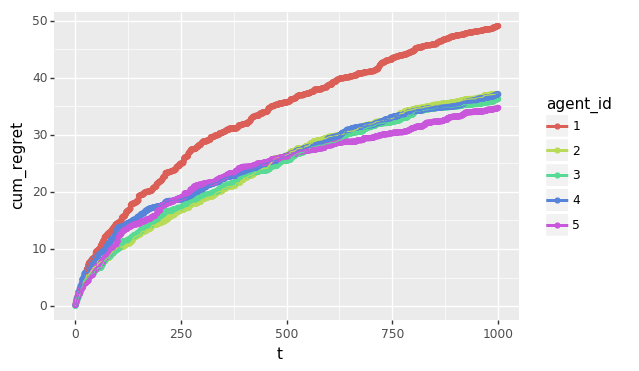

<ggplot: (8730389628637)>


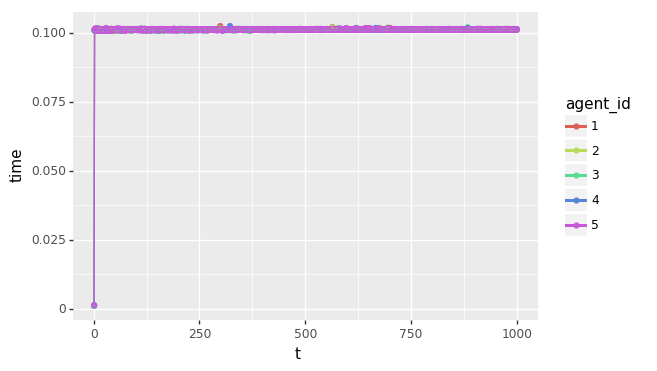

<ggplot: (8730389690473)>


In [6]:
# test run
#results_list, df_list, cum_regrets_list, avg_regrets = hyperparameter_sweeps(make_sagald_agent, [[0.01, 32]], dim, var, 10, 1, verbosity=verbosity)
hypers = list_prod([[0.2/2**n for n in range(5)], [32]])
results_list_saga, df_list_saga, cum_regrets_list_saga, avg_regrets_saga = hyperparameter_sweeps(make_sagald_agent, hypers, dim, var, 1000, 4, verbosity=verbosity)

In [ ]:
#hypers = list_prod([[0.2/2**n for n in range(3)], [32]])
#hyperparameter_sweeps(make_sagald_agent, hypers, dim, var, 10, 2, verbosity=verbosity)

In [7]:
print(cum_regrets_list_saga)
print(avg_regrets_saga)

[[39.70254774833885, 37.59754915923165, 43.18317020836721, 35.094302992424204, 33.00782134975501], [34.605857917284126, 34.43934945704917, 32.28444656414052, 33.87511843553421, 34.54809329729918], [71.5576423129406, 53.051628711035434, 56.627004746689046, 61.832391618561985, 63.351432619085706], [49.094753720303636, 37.195363219267215, 36.2933706406675, 37.11843497939561, 34.74962058822662]]
[48.74020042 40.57097264 42.09699804 41.98006201 41.41424196]


theta [ 1.76405235  0.40015721  0.97873798  2.2408932   1.86755799 -0.97727788
  0.95008842 -0.15135721 -0.10321885  0.4105985   0.14404357  1.45427351
  0.76103773  0.12167502  0.44386323  0.33367433  1.49407907 -0.20515826
  0.3130677  -0.85409574 -2.55298982]
Experiment: Step 0
 Sample: array([ 0.64013153, -1.61695604, -0.02432612, -0.73803091,  0.2799246 ,
       -0.09815039,  0.91017891,  0.31721822,  0.78632796, -0.4664191 ,
       -0.94444626, -0.41004969, -0.01702041,  0.37915174,  2.25930895,
       -0.04225715, -0.955945  , -0.34598178, -0.46359597,  0.48148147,
       -1.54079701])
 Steps taken: 0
 Sample: array([ 0.06326199,  0.15650654,  0.23218104, -0.59731607, -0.23792173,
       -1.42406091, -0.49331988, -0.54286148,  0.41605005, -1.15618243,
        0.7811981 ,  1.49448454, -2.06998503,  0.42625873,  0.67690804,
       -0.63743703, -0.39727181, -0.13288058, -0.29779088, -0.30901297,
       -1.67600381])
 Steps taken: 0
 Sample: array([ 1.15233156,  1.07961859, -0.81336

 Sample: array([ 1.51876499,  1.92089842, -0.59014059, -0.20483157,  0.77334394,
        0.99578786,  1.13376074,  1.26428408, -0.17340231,  0.430237  ,
        1.58927455, -0.6156556 ,  0.478652  ,  0.06575251, -0.01332308,
       -1.54916395, -0.44893635, -0.43863059,  0.64534699, -0.34174499,
       -0.36968248])
 Steps taken: 1313
Experiment: Step 5
 Sample: array([ 0.82721737, -1.73485676,  1.71926748, -0.33709902, -0.41444308,
        1.77881932,  1.40646075,  1.47492308, -0.78860429, -0.97593213,
       -0.60328544,  1.08520283, -2.31502232, -0.60302215,  0.38641134,
       -1.34457559,  1.55937311,  1.25189096, -0.08862263,  0.35097106,
        2.25997816])
 Steps taken: 1296
 Sample: array([-0.26278465,  0.26532557, -0.78964684,  1.28408077, -2.21274145,
       -0.566726  ,  1.10153782, -0.60798031,  0.36460247, -1.4828915 ,
       -1.83804635, -1.44324952,  0.83562656, -0.01992003, -0.17634704,
        1.53669256,  0.981334  , -1.83622649,  0.07759895,  1.14964374,
       -0.

 Sample: array([ 1.7482128 ,  1.16525462, -0.25090091, -0.7503027 ,  0.70040462,
       -0.30924464,  0.11190024, -0.66969882,  0.36931163, -1.10761302,
       -0.24320991,  0.32726485, -0.74673013,  0.93780677, -0.10177789,
        0.51223078, -1.4490934 ,  0.79364362,  0.14688053,  1.22926485,
        1.87518148])
 Steps taken: 1246
 Sample: array([ 0.73574192, -0.93294591, -0.95221448,  0.50031154,  1.88788173,
       -0.77336417,  0.83007944,  0.0076249 , -1.48553449,  0.2790785 ,
       -0.93985834,  1.38866056,  0.93489972,  0.54852767,  1.66605472,
       -1.37514859, -1.23651328,  1.25052751,  0.92048185, -0.74798987,
       -0.05577628])
 Steps taken: 1254
Experiment: Step 10
 Sample: array([ 0.23276128, -0.92898698,  0.0772603 , -0.39413235,  0.21286915,
        0.25019848, -0.27493905, -0.09913841, -0.38377737, -1.68984487,
        1.17092855,  0.97605459, -0.94054934,  0.34499534,  0.90800506,
        0.01356026,  0.14494531, -0.19849971, -0.1506721 , -1.15197353,
        0

 Sample: array([ 0.83471851, -1.81815904, -0.00812571, -0.82805057,  0.96541497,
       -0.2047147 ,  0.00900138,  2.76509002, -0.26247271,  1.0612647 ,
        0.71142807, -1.58423649,  1.20183736, -1.04794855, -0.04441493,
       -0.77140059,  1.96220393, -1.39816285, -0.3308175 , -2.01563928,
       -0.30898096])
 Steps taken: 1230
 Sample: array([ 1.70084667,  1.92592497, -0.1798314 , -0.64561605,  0.70232755,
        0.18678648,  0.60440505,  0.6981347 , -0.16409239,  0.62425747,
       -0.50148504,  0.9091798 ,  1.11326902, -1.13268832,  0.8355591 ,
        1.54502995,  0.06702154, -0.31323956,  1.05284601,  0.22548058,
        1.37238426])
 Steps taken: 1199
 Sample: array([ 1.85795292, -0.30739381,  0.09477747,  1.95417683,  1.58594524,
        0.72883051,  0.55385799,  0.1330835 , -2.19414474,  1.01222388,
       -1.13174132,  1.16802434, -1.43384339, -1.75542221, -0.29551411,
       -0.57135793, -0.21852662, -0.00771478,  0.97949938, -0.92208768,
       -0.13580531])
 Steps t

 Sample: array([ 2.84968787e+00,  4.56794710e-01, -2.21985943e+00, -1.10752259e-01,
       -1.89987842e+00, -1.31461079e+00,  5.01856582e-01,  9.73073887e-01,
        3.75739060e-01, -4.64266780e-01, -1.22831585e+00, -1.48669003e+00,
       -3.91275689e-01, -1.90921685e-01,  2.33578283e-01,  3.84161059e-01,
        1.05722040e-03,  3.09590368e-01, -1.73186598e-01, -6.58698365e-01,
        1.15166611e+00])
 Steps taken: 1213
 Sample: array([ 0.87136386, -0.37685068,  1.13615535, -1.39536497,  2.40775109,
        2.11864435,  0.79549207, -0.31808852,  1.71524794,  0.62055608,
        0.56408737, -0.34027232, -0.04599846,  0.51400949, -0.89421763,
        0.77769112, -0.37985846, -2.01313142, -0.00723685,  1.2326767 ,
        0.20567935])
 Steps taken: 1221
 Sample: array([ 0.70846816, -0.02500474,  0.4704825 ,  1.25716151, -0.07615674,
        1.53569001,  0.21411799, -0.42129561, -1.48504334,  1.08407644,
       -1.33267332, -0.94271484, -0.72157014, -1.02810325, -0.71173441,
        0.

 Sample: array([ 0.8823413 ,  1.22062251, -2.05528839,  1.02849514,  1.28233205,
       -1.68692697,  0.79146806,  0.84604004, -0.77829135, -0.06233163,
        0.42224052,  0.89983144,  0.1128042 , -0.79936289,  0.54785712,
       -0.93547656,  0.78082854, -0.38560634,  0.94159618,  0.12259773,
       -1.00043219])
 Steps taken: 1188
 Sample: array([ 0.40215794, -1.48255022, -1.11651329, -0.12505871, -0.77811041,
       -0.01989783,  0.10617725,  0.59988764, -0.05265402, -0.22834518,
        0.61772697,  0.64985449,  0.29577754, -1.21396305,  1.71452339,
       -0.47712891,  1.37364973, -1.30319842, -0.34766808,  1.03837697,
       -0.22103919])
 Steps taken: 1180
 Sample: array([ 0.58418077,  1.79043228,  0.46176633,  0.3399444 ,  0.92877022,
        0.08313198,  0.81069804, -1.60542814,  0.95335943, -1.25115778,
        1.62882588,  1.57750999, -0.79356304, -0.45961084, -0.97254511,
        0.3536319 ,  0.63708191, -0.30427403, -0.27977947,  1.32698341,
        0.69280915])
 Steps t

 Sample: array([-0.36003123,  1.57501137,  1.49313233,  1.01859198,  0.75710211,
        1.02024822,  1.04699789, -0.52216059, -0.34503096, -0.19161911,
        0.63812683, -0.27415363, -3.08601579,  1.80571466,  0.60988635,
       -0.05920295,  0.98795606, -1.32127547, -1.01519864, -1.29750118,
        1.29776309])
 Steps taken: 1142
 Sample: array([ 0.46856148,  2.05227904,  0.45352653,  2.28664881,  0.52520431,
       -0.61870188,  0.1360786 , -0.68819021, -0.67052584, -0.72360671,
        0.2253487 ,  0.01162076, -0.58535436, -0.95050028,  0.15014774,
       -0.4660251 , -0.26735704,  0.89068415, -0.1509284 , -1.12559214,
       -1.96112536])
 Steps taken: 1158
 Sample: array([ 1.64645839, -1.4718072 ,  0.4519314 , -0.63325348,  0.62299379,
        0.32149778, -0.01557423,  1.34721517, -1.28508584,  0.91224389,
        0.48712896,  2.16707079, -0.67660169,  2.34434483,  1.00278518,
        1.8171823 ,  1.39281245,  0.21486427,  1.99726819,  0.52747252,
       -0.32764472])
 Steps t

 Sample: array([ 2.06551003,  0.49340527,  1.70121362,  1.81175483,  0.85804631,
        0.47402016,  1.2137255 , -1.43620477, -0.93115051, -2.01155528,
       -2.00678167,  1.01702222, -0.01066491, -0.32235001, -0.20902956,
       -0.69228768, -0.45178801,  0.13020916, -2.39293629, -0.61241382,
       -1.21419826])
 Steps taken: 984
Experiment: Step 34
 Sample: array([ 1.24215901, -0.46393723, -0.16230812, -1.39903537,  0.73311214,
       -0.85076586,  2.10545987, -0.19515981, -1.45802861, -0.14131069,
       -0.37347159,  1.24733677,  0.98292271,  0.97025092,  0.02091226,
        1.44377429,  1.23459113, -1.76395391, -0.47920616, -0.61401345,
        0.46444846])
 Steps taken: 983
 Sample: array([ 1.06910077,  0.78226841, -1.05948306, -0.21188101, -0.49744339,
        0.2264363 ,  1.3187619 ,  0.47606086, -0.55144008,  0.69404905,
       -0.78777072,  1.1477261 ,  0.26719103, -1.15829901, -0.15926664,
       -0.54791911, -1.713915  ,  0.72789627, -0.75167735, -0.08323675,
       -0.2

 Sample: array([ 0.70963505, -0.19517793,  1.3955187 ,  0.7907132 ,  0.15378517,
        0.134355  ,  1.39118233,  0.065341  , -0.01323298, -0.77866718,
       -0.58933104,  0.71574513, -0.63086493,  1.50721748,  0.27654708,
        0.89958524,  1.57886151,  0.77139738, -0.42194268,  0.24581615,
       -0.6724784 ])
 Steps taken: 983
 Sample: array([ 0.28541055,  1.80824323, -0.86734404,  1.72318866,  0.02390297,
       -1.35292495,  1.43465285,  0.66101138,  0.08340989,  2.64929096,
        0.11228981,  0.19230364,  0.66546078, -0.31924958,  0.12824267,
        0.74154716, -0.36825939,  0.37926884, -0.56500836,  0.90101513,
       -2.0150444 ])
 Steps taken: 993
 Sample: array([ 2.39915644, -1.1138497 , -0.6241112 ,  0.54693935,  0.7094104 ,
        1.7559123 ,  0.73049181,  1.09024889, -0.81645376,  0.83279955,
        1.60043012, -1.24316353,  0.04950756, -0.33514434,  3.34125293,
        0.15354268, -0.222542  ,  0.13679883, -0.14911252, -2.04120463,
       -0.34946383])
 Steps tak

 Sample: array([ 0.38973388,  1.12261864, -0.23619902,  0.47659808, -0.00298675,
       -0.34349741,  2.31456735,  0.06435562,  0.87705465, -0.63815776,
        0.11573994,  1.75198543, -0.9272916 , -1.9297552 ,  0.86833331,
        0.92463538,  0.1266579 ,  0.56651036, -0.8471738 ,  0.63384064,
       -0.07581633])
 Steps taken: 983
 Sample: array([ 1.57897599, -1.66712893,  0.11994463, -0.76799542, -0.14087731,
        0.18267671, -0.13848425,  3.12724186, -2.11302551,  0.09301595,
        0.58451086,  1.8974641 ,  1.53004076,  0.19014135, -0.2940263 ,
        0.13119352,  1.1325945 ,  1.29822042,  0.65857489, -0.20120731,
        0.18359816])
 Steps taken: 989
 Sample: array([ 1.22898778,  1.26281121,  0.59990833, -0.00455454,  0.41480065,
        1.13571898,  1.37630317, -0.06080727,  0.46993672, -0.22805496,
        0.70599395,  2.39951764,  0.25302221, -0.17784432,  0.87483436,
        0.11199007,  2.54646329,  0.24535899, -0.26229582, -0.2886658 ,
       -0.49869472])
 Steps tak

 Sample: array([ 0.75215885, -1.31389948,  2.03494799,  1.34801695,  0.75495991,
        0.14672145,  0.22612497, -0.62520683,  0.62159322,  0.06777171,
       -1.97613753, -0.03567757,  0.72759353, -0.03337818,  1.66574025,
       -0.9572839 ,  1.69121204, -0.3045268 , -0.22693763, -0.68232179,
        0.37592751])
 Steps taken: 979
 Sample: array([ 0.37703549,  1.14701244, -0.81243795,  1.97054992, -1.04489597,
       -1.14519827,  1.59467461,  0.80173287,  0.64295723,  0.24787527,
        0.11522464,  0.88517957, -1.25360486, -0.74154864, -1.35255877,
        1.81904913,  2.07730225,  0.69734695, -1.53917571,  1.04534713,
       -1.16475754])
 Steps taken: 986
 Sample: array([ 1.03588203, -1.97146283,  0.7361045 ,  0.77518232, -0.58782645,
       -0.15088441, -0.35768684,  0.51576981,  0.1002797 ,  0.21025091,
       -0.95030054,  1.20206572, -0.40888747,  0.50095751, -0.31517034,
       -0.94144673,  1.60978446,  1.01535529, -1.37779755,  0.82359211,
       -0.76480369])
 Steps tak

 Sample: array([ 0.92401336, -0.2214982 , -0.35053688,  2.30152678,  0.15645005,
       -1.70205629, -0.02335243, -0.9304026 , -0.21109116, -0.02259231,
        1.22445035,  0.18024819, -0.28868227, -0.18647566, -0.38249902,
        0.08428998,  1.19005586, -0.22149126, -0.01628097, -0.21461036,
       -0.49044125])
 Steps taken: 960
 Sample: array([ 1.04337121, -0.30719391,  0.57142908,  1.27002437,  0.89495208,
       -0.21448335, -0.79400991,  0.53453188,  0.47472876,  1.46886215,
        0.1420289 , -0.13782731, -0.30369197, -0.55863147,  1.39546779,
       -0.73347736, -0.08891685,  1.10754706,  0.03196567,  0.73858447,
       -0.41887844])
 Steps taken: 935
 Sample: array([ 1.67311096,  0.81114881,  0.90832965, -1.23301731,  0.68299639,
        0.10458326,  0.72084567, -0.95328945, -0.12461765,  1.3052397 ,
       -0.79223088,  1.89346837,  0.89599272, -1.5336229 ,  0.40937545,
        0.58794445,  0.16786608, -2.00302996,  0.93784881, -0.9739297 ,
       -0.0641097 ])
 Steps tak

 Sample: array([ 1.00809692,  0.48073628, -0.08601873, -1.22606874,  1.19291221,
       -1.27908297, -0.08676348, -0.9918929 ,  0.4489634 , -0.12040754,
       -1.23888232,  0.09626706,  0.09946582,  0.15048903, -1.34277284,
        1.82630526,  1.94594193, -0.03806823, -1.59845771,  0.62193838,
        0.7770455 ])
 Steps taken: 977
 Sample: array([ 1.58561245,  0.96231189,  0.14295751,  2.41423468, -0.5320609 ,
       -0.64659522, -0.68230942, -0.60953195, -0.81413591,  1.90977173,
       -0.68556985,  1.46236372, -0.09889458, -0.64373229, -0.57217922,
        0.17915204, -0.57582107,  0.15489269,  0.29373284, -0.57455651,
       -2.08605956])
 Steps taken: 990
 Sample: array([ 1.68256305, -0.1123294 ,  0.49930992,  1.47116976,  1.51140217,
       -0.43288711, -0.5708118 ,  0.1652948 ,  1.22283599,  1.13313949,
        1.06844338,  1.53033996,  0.87557431,  0.10127498, -0.29956168,
       -0.48012692,  1.06956271,  0.05122812, -0.09334991, -1.76903292,
        1.16464976])
 Steps tak

 Sample: array([ 1.90843973,  0.91707521, -1.27041805,  0.84448387,  1.95499381,
        0.62087594,  1.08422978, -0.61686359,  0.40458573,  0.48457762,
       -0.23054714,  0.54290644, -0.38126598,  0.53009206, -0.46274731,
       -1.05486062,  2.30947928,  1.13866521, -0.45291956,  1.15738947,
        0.25975738])
 Steps taken: 977
 Sample: array([ 1.65416929, -0.3804832 ,  0.61351339,  0.49649697,  0.2628472 ,
       -1.609928  ,  0.82386283,  0.07674876, -0.1517465 ,  0.56158412,
       -1.60578016, -0.70183417, -0.09416714,  0.9723716 ,  0.9867166 ,
       -0.17256883, -0.26790818,  0.18899768,  1.40186616, -0.05353943,
        1.34323304])
 Steps taken: 979
 Sample: array([ 0.16803955,  0.48312986,  1.01925351, -0.35027102, -0.37459695,
       -0.5890165 ,  1.23266566, -0.86724376,  0.07057713,  1.19638448,
       -0.37511713,  1.28370904,  2.24066709, -0.27003749,  0.70003369,
       -0.77306453, -0.10631022, -1.60986449, -0.01664305,  0.2234113 ,
       -1.23279706])
 Steps tak

 Sample: array([ 1.12737173,  0.46395122,  1.91036171,  0.66582553, -0.0792316 ,
        0.46864098,  2.08661469, -0.3098925 ,  0.2197788 , -0.28370003,
       -1.15297519,  0.14691655,  0.09535528, -0.13783862, -0.0154564 ,
        0.22331353,  1.41332487,  0.36129151, -0.7021736 ,  0.51662614,
        0.2087369 ])
 Steps taken: 977
 Sample: array([ 1.11427059,  0.50027006, -0.11749289,  0.53204068,  1.59550827,
       -1.27393842,  1.13609412,  0.26321292,  0.25356293, -0.01337272,
        0.47424229,  0.63435543, -1.1684274 , -1.2903141 , -0.04312918,
        0.26691056,  0.52236315, -0.31488229, -0.8095053 ,  0.83617215,
       -0.88941362])
 Steps taken: 985
 Sample: array([ 1.24044781,  0.11038627,  1.28334758, -0.01283436, -0.58551298,
       -0.67482469, -1.29268201,  0.74403844,  0.84123448,  0.49891163,
        0.35419761,  0.59269248, -0.28691771,  0.10435803,  1.02479643,
       -1.21848873, -0.08018335,  0.25614722, -0.53499218,  0.68921935,
       -0.82392232])
 Steps tak

 Sample: array([ 0.90622012,  0.05455268, -0.27460983,  0.99866308,  0.81848317,
       -1.17120855,  2.46783705,  0.09113147,  0.61508893,  0.91195756,
       -0.1846041 ,  0.77715378, -0.20120739, -0.2771257 , -0.44176925,
        1.07784934, -0.09827864, -1.75346313, -1.3161586 , -0.04594546,
       -2.05036201])
 Steps taken: 963
 Sample: array([ 1.74199244,  0.08730313, -0.49425633,  0.0274737 ,  0.80382934,
       -0.51649454, -0.66993611, -0.16138287,  0.32949406,  1.29989887,
        0.02810385,  0.46630662, -0.51310624, -1.37238342,  1.89996593,
       -2.14608394,  0.14444254,  0.01555716,  0.59789497, -1.45749419,
        0.49443245])
 Steps taken: 974
 Sample: array([ 1.62167402,  0.51818282, -1.00054422,  0.53306723, -0.16930372,
        0.55371784, -0.04681176,  0.19542534,  1.50647635, -0.02279907,
       -0.75812044,  2.16456144, -0.66684167,  0.51718955, -0.40307993,
       -0.22763309,  0.61320497,  0.14542339, -2.74993193, -0.6331557 ,
       -0.4045545 ])
 Steps tak

 Sample: array([ 1.85084542e+00, -9.89097425e-01,  6.22092099e-01, -3.20973984e-02,
        1.14815631e+00, -1.99453672e+00,  9.34200748e-01,  1.80417418e+00,
        4.36478990e-02, -1.83027850e-03, -5.67952283e-01,  2.97008080e+00,
        1.86573397e-01, -4.83578966e-01, -1.94931853e-01, -1.00497429e+00,
       -1.45623228e+00, -2.90167774e-01, -2.62578462e-01, -1.02344883e+00,
       -8.90622125e-01])
 Steps taken: 973
 Sample: array([ 0.96502658, -0.96210757, -0.05982305,  1.47833473,  0.20766286,
        0.69358489, -0.50263481, -1.74238256, -1.9373388 ,  0.71063119,
       -0.31340956, -0.03218495,  1.33998796, -0.35399061, -0.11051841,
        1.29993745,  0.70068659, -0.08528127,  0.68845341,  0.81192668,
        0.10444375])
 Steps taken: 981
 Sample: array([ 1.80573943,  0.10944372,  1.6773468 ,  0.04694412, -0.28491776,
        0.49972735, -0.6319072 , -0.3991249 ,  0.45585904, -1.4319032 ,
       -0.93383732, -0.16829896,  0.94312114,  0.59693135, -1.24431793,
        1.09

 Sample: array([ 1.54039643,  0.21849857,  0.31471753,  0.78675378,  1.60571942,
       -1.22382525, -0.15769935,  0.46678104, -0.9883914 ,  1.13683935,
        0.25322431,  0.23179664, -2.00281025, -0.64588518,  0.60828712,
       -1.01793338,  0.21794837, -0.0834628 , -0.41591708, -0.56236821,
       -1.22334289])
 Steps taken: 974
 Sample: array([ 2.48433683,  1.04959879,  1.35917227, -0.06530895,  0.2179184 ,
       -1.44035722,  2.24680932, -0.569216  ,  0.17805325, -0.13892765,
        0.96956333,  1.28164625, -1.45811476, -0.82977565,  2.17881992,
       -1.55130114, -0.18560814,  0.71605107,  0.40138212,  1.03066375,
       -0.11157046])
 Steps taken: 969
 Sample: array([ 1.34261233,  0.52846329,  1.4868116 ,  0.64305934,  0.92328282,
       -1.09721938, -0.25457578,  0.29447037, -0.67719128, -0.60331432,
       -0.05887023,  1.48021485, -0.10545545,  0.12361151, -0.89961289,
        0.71829654,  1.16405535, -1.09591448, -1.92314078,  0.32721816,
       -1.42153523])
 Steps tak

 Sample: array([-0.20260366, -1.36265183,  0.82385389,  0.01858066,  1.760171  ,
       -1.11275063, -0.16743737,  0.68840242, -1.18691959, -0.59019024,
       -1.88533413,  0.13924997,  0.4796069 ,  0.26468724, -0.42551412,
       -0.12754965, -0.3068407 , -0.4225425 ,  0.9675787 , -0.58779846,
       -1.38961011])
 Steps taken: 977
 Sample: array([ 1.18035523,  0.70898726,  0.34331616,  0.4824544 ,  1.60196186,
       -0.65930762,  2.56253704, -0.74111901,  0.48927999, -0.30774988,
       -0.24143156,  0.04650977, -0.39406184, -0.91751149, -1.26043759,
        0.51448037,  1.22193999, -0.70065419, -1.00245333,  0.25695398,
       -0.93482023])
 Steps taken: 980
 Sample: array([ 1.80691582, -1.20204441,  0.42420305, -0.82848452,  0.14609814,
       -1.2636931 ,  1.0779967 ,  0.8569999 ,  0.32396126, -0.33474819,
       -0.39795018,  1.33499322, -0.58866657, -0.04424386, -0.18619274,
        0.66465154,  0.00598054, -1.7495905 , -0.77513695,  0.36659821,
       -1.72301999])
 Steps tak

 Sample: array([ 0.75126602,  0.76315674,  1.14166436,  3.20197222,  0.49576813,
        0.08985299,  1.24355966,  0.01342261,  0.99178487,  0.68896832,
        0.49418646,  0.14365124, -1.82559348,  1.07023366,  1.34680225,
        0.5763278 ,  1.42753011, -1.20677098,  0.10010605, -0.43160767,
       -0.37825122])
 Steps taken: 975
 Sample: array([ 1.60584523, -0.01545134,  2.30463386, -0.71524962,  0.38902358,
       -1.34249903, -0.64425816, -0.8417109 , -1.08268501, -0.19397852,
       -0.46985317,  0.06018043, -0.28340009, -0.68113644,  0.91070312,
        0.3753873 , -2.2599075 , -3.18853571, -1.88634446,  0.65593757,
       -0.03837448])
 Steps taken: 982
 Sample: array([ 0.76438636,  0.23415113, -0.66259756,  1.74175504,  0.0069816 ,
       -0.63979212,  1.11591838,  0.21299214, -0.99707576, -0.31540835,
        0.10907451,  0.57367889, -0.12831388,  0.43460557,  1.44395684,
       -0.13563328,  1.17279946,  0.01887571, -0.39418191,  0.19113147,
       -1.3323191 ])
 Steps tak

 Sample: array([ 1.61270152,  0.65404002, -1.26126836,  1.51993819,  0.40967886,
       -1.09968819, -0.20155429,  0.58114335,  0.32981385,  0.11792725,
       -0.76733032,  0.69987999, -0.42175503, -0.55179765,  0.73997428,
        0.75913128,  0.86159973, -0.92102325, -0.95732002, -0.76060813,
       -0.87728247])
 Steps taken: 975
 Sample: array([ 1.19835788, -0.79088061,  1.0427292 ,  0.80245548,  0.685927  ,
       -0.66954055,  0.80628536,  0.0162824 ,  0.38590202,  0.72425187,
       -1.31988913,  1.80826077,  0.45332906,  0.53748016,  0.83966073,
        0.18501496,  2.3122976 , -0.50675599,  1.02694324,  1.38812134,
       -0.68170278])
 Steps taken: 982
Experiment: Step 100
 Sample: array([ 0.95196958, -0.29656593,  0.67419311,  0.623575  ,  0.57643823,
        0.67952948, -0.34496171,  0.11488123, -0.49113891, -0.28726304,
       -2.25179982, -0.48520505,  1.93286392,  0.76924636,  0.14123364,
        0.27240071,  0.57048229, -0.12746564,  0.33491692,  0.76608721,
        1.

 Sample: array([ 1.32054239,  0.61155421,  0.81884648,  0.87943393, -0.57644693,
       -0.15883848, -0.92232152,  1.53618588, -0.41699763,  0.98835469,
       -0.75905622, -0.55782202,  0.95092688,  0.78538283,  0.12109861,
       -1.10200339,  0.72416034,  1.11622147, -0.2614751 , -0.65240163,
       -0.49184274])
 Steps taken: 976
 Sample: array([ 2.42911741,  0.61183683,  0.17237309,  1.52752785, -0.83605521,
        1.30137559, -0.14258523, -0.27913755, -1.82782297, -0.62199796,
       -0.09608297,  0.53368614, -0.67289906,  0.11858583, -0.22503543,
       -0.62420452,  1.04883206, -0.54467231,  0.00548827, -0.99075396,
       -0.58275125])
 Steps taken: 982
 Sample: array([ 1.36714677, -0.55256617,  1.5624268 ,  0.89176566,  1.28773606,
       -0.47567328, -0.13000323, -0.1973282 ,  0.17360517,  0.68225264,
       -1.28486822,  0.0704313 ,  1.34178152, -1.28856243, -0.09477616,
        1.14318426,  0.0250035 , -0.52990944,  0.09267996,  1.17678469,
       -0.793728  ])
 Steps tak

 Sample: array([ 1.28966219,  0.54396091, -1.25310244,  1.71134533,  0.68519651,
       -0.50005724, -0.44942816, -0.5334025 , -0.53365683, -0.34391645,
       -1.41598736,  0.61347853,  0.41550935, -1.23587206, -0.64931825,
        1.35503181, -0.39710534, -0.53757167, -1.45882695, -0.24170493,
       -1.54982342])
 Steps taken: 979
 Sample: array([ 2.94726819e+00,  8.61513109e-01,  9.46565851e-01,  6.60910304e-01,
       -2.02310001e-01, -8.90988073e-01,  2.33006921e-03, -1.59194708e-01,
       -2.82214543e-01,  4.32941817e-01,  3.90844447e-01, -2.06187722e+00,
       -7.86575532e-02, -3.55881563e-01, -1.69147780e+00,  4.27926895e-01,
       -1.17099922e-01,  7.54561311e-01,  3.94348360e-01, -2.14068722e+00,
       -1.13169148e+00])
 Steps taken: 971
 Sample: array([ 7.57103041e-01,  4.02595249e-01,  1.27139465e+00,  9.51186215e-01,
        1.96091180e+00,  7.15810188e-01, -4.08239487e-01, -1.31735226e-01,
        5.26561283e-04, -6.64920567e-01,  1.17595861e+00,  1.01401930e+00,
   

 Sample: array([ 0.85520559, -0.78007261,  0.74054005,  0.00769198,  0.11904311,
        0.9072935 , -0.8329222 ,  0.81717609, -0.87227803, -0.5873998 ,
       -0.15510035,  1.1792786 ,  1.69462666, -0.13853734, -0.13348895,
       -0.44425822,  1.20215705,  0.37046799,  0.53817954, -1.18697564,
       -0.64126867])
 Steps taken: 971
 Sample: array([ 1.27291031, -1.13111102, -0.26130551, -0.2249762 ,  1.39989897,
        0.11846499,  0.35608195, -0.1733543 ,  1.12490681,  1.49483679,
       -0.64863669,  0.35057743, -0.03375597, -0.39695716, -0.41402992,
        0.01590151, -0.84260504, -0.37871857,  0.23481598,  0.72727904,
       -1.19870496])
 Steps taken: 982
 Sample: array([ 1.49202667,  0.62470262, -0.1678487 ,  0.96069914,  0.15715116,
       -0.98189866,  0.77975369,  1.11879039, -0.08181029, -1.78500684,
       -0.22231912,  1.71841621,  0.11130608, -0.3723925 ,  0.56076863,
       -1.39025363,  0.05834808, -0.81811105, -1.10385764, -0.52614875,
       -0.54109044])
 Steps tak

 Sample: array([ 1.69436896,  0.02524389, -1.929782  ,  0.75165643, -0.5325749 ,
        0.45429542,  1.26701209, -0.23049567, -0.23803768,  0.24205017,
       -0.06445424,  0.71344231,  0.36810387, -1.54371321, -0.81458967,
        1.88884249,  0.98410966,  0.13939829, -0.52776435, -0.92074259,
       -1.65124423])
 Steps taken: 974
 Sample: array([ 1.30287955, -0.9406247 ,  0.4332411 ,  1.43045403,  0.50969037,
       -0.42408532, -0.00561023,  1.91142222, -0.63325467, -0.29320392,
        1.13012599, -0.77826749, -1.73858174, -0.01604001,  0.44247441,
       -0.55920409, -0.50056845,  0.1129446 ,  0.18266813, -0.65949891,
       -0.76681765])
 Steps taken: 988
 Sample: array([ 1.6854715 , -0.57683013,  0.53834901,  1.28269667,  0.46456463,
        0.94890897, -1.55751513, -1.58575908,  0.63338299, -0.00388542,
        0.45241915, -0.10794569,  0.59526968,  0.63271589,  0.72724691,
       -0.41970205, -1.00665779, -0.56761708,  0.05927586,  1.00094098,
       -2.88532329])
 Steps tak

 Sample: array([ 1.2889955 ,  0.6533628 ,  0.56675591,  0.02409019, -0.47467237,
       -1.62515264, -0.96953284,  0.03661955,  0.31906561,  0.59216487,
        0.81132183,  0.21364562, -0.20836172,  0.24194579,  0.46620424,
        0.52339282,  0.24351193, -0.04403033,  0.3549533 , -0.25845578,
       -0.43270697])
 Steps taken: 979
 Sample: array([ 0.58521813,  0.95738514, -1.07472677, -0.05621423,  0.82338683,
        1.01712682, -0.49897533, -1.23692748, -1.0128656 , -1.12459515,
        0.19131593,  0.06325453, -0.12636356,  1.70256084, -0.56952298,
       -0.235691  ,  0.97620112,  0.68540239,  0.32581494, -0.45805427,
       -1.15937089])
 Steps taken: 979
 Sample: array([ 1.72373997,  0.040206  ,  1.2359522 ,  0.37113856, -1.0785815 ,
        0.53941225,  0.79417447, -0.65751667,  1.20673582,  0.02522423,
        0.48581805,  0.11177051,  0.1657909 , -1.00085228, -0.59199736,
        1.23452772,  0.33618379, -1.03885906,  0.15219751,  0.00691343,
        0.00204911])
 Steps tak

 Sample: array([ 1.38015034, -0.41962742, -0.31411865,  0.04691789,  1.52968485,
       -0.61580765,  0.49464258,  0.45277337, -0.51283834,  1.21899193,
        0.08158707,  2.19913208,  0.08815751,  0.42833577,  0.66468353,
        0.61154029, -0.20888086,  0.14465057, -0.39169788, -0.15487764,
       -1.93539742])
 Steps taken: 975
 Sample: array([ 1.58316582, -1.37929716, -0.34242256,  0.94529235, -1.01554711,
        0.17794861, -0.08460081,  0.5202088 ,  0.90829967,  0.8352242 ,
       -0.81160999, -0.66756562,  2.03018835,  0.34536274,  0.62366456,
       -0.53763861,  0.41046223, -0.45846034,  0.94865409,  1.26209511,
       -0.07650455])
 Steps taken: 977
 Sample: array([ 1.34909286, -1.02962921,  1.16667778, -0.05266866,  1.58728787,
        1.01154409, -0.46516259, -0.29110872,  0.45313106, -2.19175798,
        0.22329422, -0.18457049,  0.49937142, -0.6949076 , -0.11969993,
       -1.4205691 , -0.13382661, -0.88008974, -0.36864415, -0.61164629,
        0.50153382])
 Steps tak

 Sample: array([ 1.52638969,  1.72640748, -0.08930127,  0.4423308 ,  0.82797186,
       -0.30018416,  1.23861933,  1.41959079,  1.77034292,  0.92553066,
       -0.36439506,  1.3555424 ,  0.16480971,  0.21691548, -0.99324887,
        0.06642711, -0.89002177, -0.80371359, -0.15766102, -1.00908093,
        0.07618939])
 Steps taken: 960
 Sample: array([ 2.13151475,  1.15170357, -0.23954865,  0.3160787 , -0.81929611,
       -0.19701795, -0.86176594, -1.10651246,  0.06713423,  0.46039478,
       -0.86320992,  1.23052347,  1.30645835,  0.32163181, -0.22492127,
       -0.92137365, -0.11998427, -1.01439637,  0.77647689, -0.32292963,
       -1.2766351 ])
 Steps taken: 971
 Sample: array([ 2.29884084, -0.46128512,  1.47282281,  0.92474832, -0.34870045,
        0.31215414,  1.58563136,  0.56705682,  0.00807039, -0.22818082,
       -1.34106448, -0.02368101,  0.2244695 ,  1.25878247, -0.31180656,
        1.16152686,  0.12250866, -2.05428714,  0.35710179, -1.1157703 ,
       -1.58285132])
 Steps tak

 Sample: array([ 2.35292463,  0.61533199,  0.3218596 , -0.59568575,  0.63503573,
        0.76610492, -0.18141705, -1.97546976, -0.52004453,  0.22757983,
        0.45600324,  2.31784467,  1.97603299,  1.53526744,  0.76561442,
       -0.8359539 ,  0.0451916 ,  1.04276574, -0.41456426, -1.57344277,
       -1.04675455])
 Steps taken: 972
 Sample: array([ 1.09676303,  0.90064154,  1.43825232,  0.40421209,  0.12938992,
       -0.89187376, -0.06514348, -1.44391805, -0.38971822, -1.10677022,
       -0.51550854,  0.69288373,  0.4870798 , -0.37113441,  0.34836895,
       -0.22400505,  1.10938178,  0.87676539,  0.35747104, -1.51412195,
        0.47482825])
 Steps taken: 977
Experiment: Step 140
 Sample: array([ 1.23308875,  0.16142597, -0.40142544,  1.72740148,  1.04315227,
       -0.620369  ,  0.49787948,  1.54322325, -0.83966244, -0.78593006,
       -0.05308667, -0.68807327, -0.09068063, -0.42600767,  0.60041059,
        1.05587193, -0.14986771, -0.95205784, -2.33487077,  0.11851436,
       -0.

 Sample: array([ 1.12123476,  0.24181793,  0.46388331, -0.01987614,  0.63061419,
        0.10207513,  0.64459003,  1.69262617, -0.8813024 ,  0.05998479,
       -0.56600679, -0.12128677,  2.04638293, -1.12548316, -0.05306394,
        0.28467599, -0.67000183,  0.11921447,  0.82987202, -1.04709697,
       -0.46464418])
 Steps taken: 982
Experiment: Step 145
 Sample: array([ 0.9467652 , -0.91255127, -0.11900699,  1.51235722,  2.19719506,
        0.82512529,  0.66110285, -0.18547881, -0.65313632, -0.5209153 ,
       -1.4536046 ,  0.39844037,  0.05283733,  0.6387968 ,  0.14604477,
       -0.36261929, -0.54721665, -0.57231167,  0.43833046, -0.26242337,
        1.52610345])
 Steps taken: 987
 Sample: array([ 1.69863653, -1.34747916,  0.34062496,  0.81490391,  0.14844416,
       -1.59390899,  1.65958311,  1.15204394,  1.72579678, -0.76804567,
        0.75976393,  0.51586142,  0.86770508,  0.66106664,  1.58396473,
       -0.07185688, -0.4955973 , -1.09033302, -1.69338006, -0.32451699,
       -0.

 Sample: array([ 1.95296274,  1.25805995,  0.16766803,  1.82748443, -0.10202002,
       -0.10936817,  0.0066379 ,  0.37252264, -1.44836262, -0.50947979,
        0.01179266,  1.00902289, -1.06427872,  0.41959092, -0.29879086,
       -0.97167959,  0.49341738,  0.97358727,  1.125614  , -0.36432152,
       -0.86956511])
 Steps taken: 980
 Sample: array([ 1.12146115,  0.64003881,  0.30933548,  0.82829432, -1.83916806,
        1.44482543, -0.85322762,  0.18695827,  0.14856576,  0.91669303,
       -0.35760699,  1.49469909,  1.16175154,  0.00559054,  0.46186563,
       -0.01954362,  2.81041415, -0.97928016,  1.27717304, -0.04354613,
       -0.80468999])
 Steps taken: 977
Experiment: Step 150
 Sample: array([ 1.59577794,  0.34975526,  0.37893754,  1.77334214,  2.04909473,
       -1.63830186,  0.3627748 , -0.25206809, -1.39565095, -1.11142287,
       -0.96038375, -0.83084102,  0.54029747,  0.9993711 , -0.1201958 ,
       -0.99447717,  0.48065139,  1.66067995, -0.32665844, -2.06082925,
       -0.

 Sample: array([ 2.07171313,  0.38274406,  1.80903258,  2.47168298,  0.72490039,
       -0.15866669,  0.92703587, -0.06722133,  0.93243132, -0.31757311,
        0.83778119,  1.92732335, -0.26285689,  0.02291304,  1.10102844,
       -0.6949696 , -0.30142572,  0.83325383, -0.21840384, -0.31846255,
       -1.808921  ])
 Steps taken: 955
 Sample: array([ 1.22311043,  0.90018789, -0.22985882,  0.31133008,  0.1662183 ,
        0.21352958, -1.31144583,  1.03460207,  0.62482305,  0.50623763,
        0.73924843,  0.21090923, -0.15238872, -1.43418555, -0.96580972,
       -0.88957555,  1.06879161,  1.15601223,  0.25080316, -0.07458288,
       -0.40520402])
 Steps taken: 983
 Sample: array([ 1.24428552,  0.40033829,  1.29793114,  0.86454203,  1.44187126,
        0.56286718, -0.2118606 ,  0.25600459,  0.31404954, -0.17871892,
       -0.70605104,  0.24450232,  1.65279935,  1.05398757, -1.26061809,
       -0.25942782,  0.65252322, -0.27241205,  0.50904405, -0.10168268,
        1.59000094])
 Steps tak

 Sample: array([ 1.6988391 ,  0.67802161,  0.5004293 ,  2.00099147,  0.94018084,
        1.72939652,  0.96500241,  1.2094091 , -0.21772864,  0.79312855,
       -0.42599929, -0.57864393,  1.66083878,  0.55991591, -0.60718252,
        0.48390728,  0.37683615, -0.36357699,  0.27356288, -0.02307697,
       -0.02630272])
 Steps taken: 969
 Sample: array([ 1.89594192,  1.84367096, -0.85602765,  0.00871846, -1.22182404,
       -0.82340664, -1.43405884, -0.07841138, -0.08445353, -1.45116688,
       -1.31137582, -0.75787918,  0.84433054,  1.68011757,  1.02249617,
        0.3442531 ,  0.62004347,  0.41188368, -0.55920342, -1.69154283,
        0.45472859])
 Steps taken: 975
Experiment: Step 160
 Sample: array([ 0.52443139,  1.14839615,  1.38181682, -0.44522482,  1.5189469 ,
       -0.64134933,  0.13982763, -0.65762092, -0.27860249, -0.8037906 ,
        1.81911491,  1.12241858,  1.65397376,  0.66072215, -0.21319783,
       -0.84702577, -0.06725849, -0.7596547 ,  0.06127155,  1.447133  ,
       -0.

 Sample: array([ 1.15281441, -0.26655735, -0.23211753, -0.01029335, -0.37096003,
       -0.32232295,  0.32446829, -1.40751028, -0.26470149, -0.19076565,
       -1.01714772, -0.27873307, -0.42558409,  1.00634755,  0.5383334 ,
        0.53891237,  1.16242671, -0.32908624,  0.25588924, -0.09042432,
        0.17553887])
 Steps taken: 969
Experiment: Step 165
 Sample: array([ 1.27538459,  0.69264173,  0.79089671, -0.71812033,  0.7612914 ,
        0.28448927,  1.09635168,  0.16528514,  0.43154083, -0.65703788,
       -0.43176808, -0.64829879, -0.04280729,  0.38649958, -0.96905459,
       -0.09544884,  0.42753856, -0.0862815 , -0.0271458 , -1.45399327,
       -0.01354463])
 Steps taken: 980
 Sample: array([ 0.87908223,  0.12282979, -0.06990972, -0.24389382,  1.26712859,
       -0.51950922,  1.40192799,  2.0226712 ,  0.58760579,  0.05068021,
        0.04127141,  1.20772215,  0.05573926, -0.51433914,  0.72671604,
        0.57727845, -0.39520281,  0.23944947,  0.11745111, -1.05855293,
       -1.

 Sample: array([ 1.60339233, -0.20635096, -0.17777422,  1.53041039,  0.09501287,
        1.05756973, -1.54672953, -1.56582892,  1.31798756, -0.30809999,
       -0.78520936,  0.18132963,  1.09308456, -0.64189112, -0.03258878,
        0.06697009,  0.46784474, -0.86407927,  0.50800189,  0.27999279,
       -0.42998525])
 Steps taken: 923
 Sample: array([ 1.11853393,  0.72792477,  0.72355758,  0.02243888,  0.36860219,
       -0.35102584, -0.00794649, -0.37231385,  0.0519478 ,  0.61023614,
        1.81321853, -0.33712191, -0.47634494,  0.53876944, -2.20676085,
        0.01565289,  1.41696153, -0.829589  ,  1.13371767, -0.38256555,
       -2.21451107])
 Steps taken: 984
Experiment: Step 170
 Sample: array([ 1.63367168,  0.08233355, -0.26966141,  0.42995522,  1.30951504,
        0.10507686,  0.55093117, -0.35760492,  0.76304401, -0.3997091 ,
        0.0291794 ,  0.37238698, -0.01264263, -0.4619407 , -0.36230876,
        0.27711946,  0.59017252, -0.85798775, -0.75485365,  0.04179563,
       -0.

 Sample: array([ 1.70253785e+00,  1.38812180e-01,  8.45504540e-01,  5.09168301e-01,
        1.07677797e-02, -7.28259076e-02, -6.73548308e-01, -8.35236500e-01,
        1.59570154e-01, -3.89568917e-01, -1.66868003e+00,  1.86379670e+00,
        5.22992523e-01, -5.62714615e-01,  2.49580909e-01,  9.27146808e-01,
        5.97040373e-01,  6.41491362e-01,  7.30968513e-01, -4.92838578e-04,
       -6.78130270e-01])
 Steps taken: 979
Experiment: Step 175
 Sample: array([ 1.75217616,  0.18153323,  0.04726737,  0.22992661,  0.22779051,
        0.28566514,  0.86283091, -0.26975259, -1.32933849,  0.06422777,
       -0.70619962, -1.33584808,  1.63148085,  0.37663672,  0.12867386,
       -0.63348102,  0.30733345,  0.28295439,  0.28344392, -0.5575868 ,
        0.49469319])
 Steps taken: 977
 Sample: array([ 1.80879398,  0.43530982, -0.09564641,  0.84079838,  1.26141808,
       -1.58855757,  1.01238257,  0.37383424,  0.04279981,  0.85114283,
        0.54534668,  0.2696514 ,  0.16961662,  0.04498514, -0.0

 Sample: array([ 1.47986403,  0.00571562, -1.43227831,  1.09818916,  1.08193945,
        2.10658521, -0.5750308 , -0.67372199, -1.0056846 ,  0.57435867,
        0.81453586,  0.85623055,  1.20544673,  1.74673633,  0.15411195,
        0.02638861,  0.46490277,  0.97885002,  1.29437617, -0.88927493,
       -0.41972828])
 Steps taken: 973
 Sample: array([ 1.75830254,  1.9309722 ,  0.87329556,  0.86231475, -1.34244095,
        0.80371394,  0.78839495, -0.16210266,  0.81969118,  0.23315655,
       -0.73182615,  0.67147131,  0.83605668,  0.15041152, -0.14317559,
       -0.76110621,  0.36977828,  0.47014517, -0.10894316, -0.86663997,
       -0.62690699])
 Steps taken: 982
Experiment: Step 180
 Sample: array([ 0.94114307,  1.55556939,  0.16960609,  0.35689827,  0.04027264,
        0.3141104 , -1.00525633,  0.11374203, -0.68325824, -0.91508449,
       -0.32016299, -0.11993251,  0.38237718, -0.50866161,  1.23945971,
        0.09421092, -0.15712231, -1.30699416, -0.08120461,  0.35433218,
        1.

 Sample: array([ 0.97627035, -0.71519117, -0.3326125 , -0.49668824,  0.2089071 ,
       -2.07034381,  0.21377608,  0.88017141, -0.78546503,  1.14494232,
       -0.96852081, -0.06476305,  0.22769921, -1.40750901, -0.59112145,
        0.49519082, -0.56282456, -0.12550343, -0.09341942,  0.42490037,
       -1.1493312 ])
 Steps taken: 972
 Sample: array([ 2.09849653,  1.09085588, -0.22691538,  1.31753848,  2.28100938,
        0.71389533,  0.84266531, -0.36812567,  0.75767794, -0.50845322,
        0.33553198, -0.07179716,  0.50216865, -0.39616781, -1.70762395,
       -0.00746583,  0.79751087,  0.88620275, -0.20328201, -1.15462149,
       -1.45249906])
 Steps taken: 981
 Sample: array([ 2.04367246,  1.24299064,  1.12779852,  1.07225447,  0.664094  ,
        0.72243943,  1.01840133,  0.64140859,  1.23320147,  0.53954065,
       -0.61573445,  1.86868859, -1.66077561, -0.44442741, -0.04576171,
        2.14086123,  0.04648763,  0.53777729,  0.85871597,  0.08836019,
       -0.546887  ])
 Steps tak

 Sample: array([ 1.86053632,  0.4234817 ,  0.5757789 ,  0.10334696,  1.80585101,
       -0.17072472, -1.0690693 , -0.76351283, -1.65685427, -1.33994516,
       -0.62009314,  0.65193678,  0.34343146, -1.02392381, -0.93568415,
       -0.07448867,  0.27040802,  0.33388821, -0.42817547, -0.68683792,
       -0.73011942])
 Steps taken: 968
 Sample: array([ 2.11361066,  1.59338759,  1.2272217 ,  0.80810647, -0.52324228,
        1.03823479,  0.48426372,  0.30950917, -0.85224168, -0.79554223,
       -0.71849951,  1.59469448, -0.17401947, -1.97036579,  0.09009621,
        0.84425174,  0.72879266, -1.00359305, -0.64436667,  0.18922145,
       -1.16579114])
 Steps taken: 979
Experiment: Step 190
 Sample: array([ 0.69617797,  0.13713928,  0.79271505,  0.45025191, -0.61154508,
        0.05147879,  1.1916297 ,  1.03822493, -0.04167847,  0.21934745,
        0.36642613,  1.70063366,  0.45759613, -0.00313106,  0.94259462,
       -0.56270634,  0.41359379,  1.65953757, -1.50144963, -1.19319967,
       -0.

 Sample: array([ 1.83372774,  0.30890373,  0.37047151,  0.75777373, -0.15357872,
       -0.8858911 , -0.81600212, -0.70633583, -1.51168175,  0.6368975 ,
       -0.79216535, -0.61667751,  0.87239747,  0.43244608, -0.42471326,
       -0.19528627,  1.10044287,  0.03866672, -0.35456267, -0.06700919,
       -0.62840517])
 Steps taken: 970
Experiment: Step 195
 Sample: array([ 1.49646378,  0.57048734, -0.39138213, -0.11253558,  0.71828332,
       -1.6599937 ,  0.14510824,  0.27296918,  2.04029684, -0.43414755,
        1.03445616,  0.16119984, -0.75863811, -0.31360354,  0.01216846,
        0.64796206,  0.73138295, -0.72610907, -0.18443199,  0.99481636,
        0.57508452])
 Steps taken: 980
 Sample: array([ 1.11806598,  0.96068708, -0.35648899,  0.58437746,  0.09072396,
       -0.0336252 ,  0.60252749, -0.53530211,  1.00553215, -0.50308202,
       -0.19737358,  1.13243678,  0.86637786, -0.60355983,  0.86651383,
       -0.05513003,  0.4169096 ,  0.12175377, -0.28893011, -0.49424223,
       -0.

 Sample: array([ 1.69798056, -0.57362582,  0.69195102,  1.13013274, -0.88853312,
        0.24000403,  0.01532501,  0.8251036 , -0.01582695,  1.18651255,
        0.46489133, -1.0049109 ,  0.48235048,  0.59582262, -0.25172939,
        0.20388598,  2.63980416, -1.06594172, -0.10414118, -0.68136585,
       -0.73579962])
 Steps taken: 971
 Sample: array([ 1.35963355,  0.63376726, -0.35536232,  1.31835089,  1.7413137 ,
        0.73873064,  0.95959842,  1.3027318 ,  1.73072298, -0.07783625,
       -0.36846146,  0.06596515, -0.44112046,  1.2679577 ,  0.51557511,
       -0.18242819, -1.13326793, -0.43815318,  0.96002043,  0.18338458,
       -0.96553368])
 Steps taken: 972
Experiment: Step 200
 Sample: array([ 1.14775226, -0.24332708,  1.35226974,  1.50697209,  1.2196746 ,
       -0.18631724,  0.16362483, -0.48733484, -0.61576384, -1.85309777,
        0.57685249,  1.08949757,  0.27134423,  0.95838273, -0.11509103,
        0.6861109 ,  1.16801471, -0.13808324,  0.74625639, -0.36504739,
       -0.

 Sample: array([ 0.46366054,  0.10792133,  0.72517206,  1.3569755 , -1.03045467,
       -0.6573175 ,  0.73384775, -0.46522682,  0.53252783, -0.35103763,
        0.80457777,  0.99135791, -0.88013805,  0.53216197,  0.76056125,
       -0.48956145,  0.65079953, -0.17561769,  0.42179611,  0.52461007,
       -1.34103198])
 Steps taken: 970
 Sample: array([ 1.6940995 ,  0.05438919,  0.49177024,  0.0563984 ,  0.24479887,
       -0.60759429,  0.41170308,  0.16474207,  0.80239111, -1.14071412,
       -0.63147225,  0.71424382, -1.23443739, -0.82004676,  2.53648783,
        0.11583416,  0.68351363, -0.33335616,  0.14944781,  0.64059077,
       -2.06963365])
 Steps taken: 981
 Sample: array([ 1.94836853,  0.71424202,  1.42408662,  1.61100277, -0.58068529,
       -0.63322283, -0.67164815, -0.53464055,  0.76815067, -0.28843898,
       -0.09958205,  0.62523619,  1.19461556,  0.24578106,  0.68736117,
        0.81033623,  0.70592541, -0.69455448,  0.41690156,  0.80690861,
       -0.4892727 ])
 Steps tak

 Sample: array([ 1.53294236,  0.67658004,  0.62909468,  0.89085056,  0.04405264,
        1.91241977,  0.49028788, -1.43932685, -1.7727831 ,  0.87676198,
       -0.57871576, -0.22612503, -0.56260992, -1.57949844, -0.57218128,
        0.40617632,  0.69628807,  0.04433063, -0.442127  , -0.68904253,
       -2.58949758])
 Steps taken: 949
 Sample: array([ 1.28321223,  0.02104272,  0.23299297,  0.33427096,  0.96344207,
       -0.66589555,  0.43444403, -1.12165336, -1.50810236, -1.19840772,
        0.37408049,  1.37002715,  0.08617336,  0.51301714, -0.01478036,
       -1.41286732,  1.21738362,  0.15891243, -0.43999728, -0.11949011,
       -1.46578539])
 Steps taken: 958
 Sample: array([ 1.77556937, -0.49866672,  0.11732849, -0.15693984,  1.3266458 ,
        1.15988649,  0.06374217,  0.25757204, -0.83426401, -1.49406298,
       -0.02526971, -0.48327604,  0.59832538,  0.0433006 , -1.16165933,
        0.81532648,  0.04966758,  0.13272616, -0.8159999 , -1.06668985,
       -2.04571747])
 Steps tak

 Sample: array([ 1.09893414,  0.36425589, -0.05373746,  1.51316376,  1.87099285,
       -0.82624324,  1.17107485,  0.22831531, -1.22645588, -0.04189805,
       -0.09853612, -1.31290509, -0.18345904,  0.60758992, -0.80365693,
       -0.70939223,  0.30926027,  0.99623519,  0.23650593, -0.58101551,
       -0.20984587])
 Steps taken: 970
 Sample: array([ 0.38122378, -0.01036482,  0.03775592, -0.20193027, -0.1894932 ,
        0.00822455,  0.93235052, -1.12077895,  0.8690396 ,  1.80039348,
        0.47111883,  1.20253092,  1.00156924, -0.01663361,  0.80930613,
        1.01469749,  0.95394308,  0.42918813,  1.02834498, -0.34580826,
       -0.74316844])
 Steps taken: 971
 Sample: array([ 1.5413618 , -1.87158266, -0.22551138, -1.33398895,  0.08068778,
        0.62616129, -0.14976058,  0.49039618,  0.41210678, -1.17372665,
       -1.40196926,  1.48532837,  0.34091261, -0.1701181 ,  2.04964557,
        1.4733134 ,  0.31241892, -0.13857103, -0.95103697, -0.1026827 ,
       -0.0286798 ])
 Steps tak

 Sample: array([ 2.27274674,  1.05647723,  0.62815548,  0.15000624,  1.0743818 ,
        1.12042344,  1.36270683,  1.52442661, -0.25444585,  0.29733991,
       -0.03609767,  0.64608635,  0.85467757,  0.72692617,  0.43535602,
       -0.43063379,  1.22856386, -0.32163192, -0.19678098, -0.13287986,
       -1.7711614 ])
 Steps taken: 968
 Sample: array([ 1.34009034,  0.07339109,  0.16047435,  0.37099579, -0.92293107,
       -0.04504675,  1.00877312,  0.77477341,  0.56091976,  1.70052813,
       -0.68072662,  0.07873993, -1.28239903, -0.50087733, -0.35315943,
       -0.6813602 , -0.12035256, -1.30236402,  0.17022222,  0.20621352,
       -0.20905254])
 Steps taken: 977
 Sample: array([ 1.77411245, -0.69893676,  0.9401798 ,  0.93090299, -0.30468688,
       -0.42171953, -1.49130336, -0.0608251 ,  0.17542222, -0.82069468,
       -0.35243764,  0.50389555,  1.99965756,  1.10405084,  1.05507421,
       -0.94892796, -0.67726014,  1.52991294, -0.09870753,  0.09317315,
        0.71964791])
 Steps tak

 Sample: array([ 2.20137068, -0.13091062,  0.57660546,  0.9757394 ,  2.83336773,
       -0.91101429,  0.76145408, -1.44882801,  0.24566257, -1.38009422,
       -0.00765214,  0.92940342,  0.80247411, -0.54910027, -1.276624  ,
        1.18549771,  1.26825757, -0.65422389, -0.80226419, -1.36583194,
       -0.3813425 ])
 Steps taken: 964
 Sample: array([ 1.838888  ,  0.84010372, -0.10145518,  0.16132108, -0.19834395,
        0.0408614 , -0.07763664,  0.62876107, -0.10564506,  0.57999261,
        0.31096508,  2.75274699, -0.78726577, -0.01901887,  2.26379965,
        0.51271716, -1.23124384, -0.15697697, -1.13500678,  0.20954203,
        0.10262443])
 Steps taken: 965
 Sample: array([ 1.32297954,  0.62318745,  0.68507442, -1.13235187,  0.72089665,
       -0.58022228,  1.11690136,  0.2980252 , -0.83948401, -0.24370622,
       -1.13246383,  0.95077734, -1.40213156, -1.15473253, -0.49675852,
        0.63848817,  0.30597961,  0.8491272 , -0.70477324,  1.30434106,
       -1.37588854])
 Steps tak

 Sample: array([ 1.71023842,  2.78574053,  0.26993615, -0.23439674, -0.55159728,
       -0.9134076 ,  0.51187291,  0.17816357, -1.49288039,  1.18728607,
        0.15592297, -0.62215592, -0.22759363,  0.9442439 , -0.49356894,
        0.27723647,  1.72913559, -0.61237001,  0.33356209,  0.3251792 ,
        0.92362412])
 Steps taken: 963
Experiment: Step 229
 Sample: array([ 1.44081629, -0.81417361,  1.79722957,  1.33846197,  0.33073533,
        0.49481819, -0.7809667 , -0.4128528 , -1.64664619, -1.6255953 ,
        0.30656584,  0.31232433,  1.61816931,  1.12739628,  0.73565457,
        0.46697091,  2.17620424,  0.38926997,  0.47330725, -0.12130287,
       -0.24501773])
 Steps taken: 976
 Sample: array([ 0.97694902,  0.92710755, -0.31897876,  1.10562446,  0.0958039 ,
       -0.6347979 , -0.35766016,  0.59211912, -0.73136496,  1.31963192,
        1.13497802,  0.46592415,  0.79694193, -0.56479034,  1.30406129,
       -0.26777347, -1.13854938, -0.0771618 ,  0.38978491, -0.01203645,
       -0.

 Sample: array([ 1.94706464,  0.66604201,  0.77411923,  0.58855298,  0.89919625,
       -0.63618763, -0.18860624,  0.01826667, -0.06442263, -0.27481823,
       -0.35817427,  0.19941148, -1.33480745, -0.24753042,  1.46096862,
       -0.10519157,  1.63626456, -0.81490092, -0.11038337,  0.43960459,
       -0.9396196 ])
 Steps taken: 972
 Sample: array([ 1.04872231, -0.15250656,  3.15700837,  1.36580736, -0.2645301 ,
       -0.61592342,  0.53477721, -0.06188232, -0.89922964,  0.24006219,
       -1.22896658,  0.09802463, -1.84960051,  0.22372256, -0.88355902,
       -1.41515345,  0.20324216, -0.55853797,  0.00731143, -0.58117978,
        0.59850316])
 Steps taken: 979
Experiment: Step 234
 Sample: array([ 1.44652916,  0.03358498, -0.44156005,  1.03038828,  0.72763008,
       -0.97621864,  1.127022  , -1.07871439,  1.08609589, -1.13228863,
        1.51962667,  0.80815736,  1.72659591, -1.729084  ,  0.66204317,
       -0.52262197,  0.71231616, -0.16625771,  2.04050136, -2.24748202,
       -2.

 Sample: array([ 1.22536806,  0.53449846, -0.34965762,  1.69357903,  0.92772612,
        0.43977991, -0.27557898,  0.47535017,  0.28996296,  0.58013967,
        0.27922061,  0.97303719,  2.12263896,  0.50039529,  0.83473271,
       -0.1696479 ,  0.64072591, -1.69848558,  0.39858202, -1.5725462 ,
       -1.62695642])
 Steps taken: 968
Experiment: Step 239
 Sample: array([ 1.30785944, -0.55743356,  1.76880601,  1.4752968 ,  0.20249567,
        0.51157303,  0.98466851, -1.08187749,  0.08649549,  0.14099287,
        0.92163936,  0.73519809,  0.40345526, -0.54662963,  0.46148551,
        0.39003016, -0.03402882,  1.15313805, -1.02384281,  0.89792947,
       -1.76151788])
 Steps taken: 959
 Sample: array([ 0.81889244,  1.16045568,  0.25177039,  0.48991565,  0.1540939 ,
       -0.75510448, -0.14331865,  0.46949733, -0.56832915, -0.87415436,
       -0.26713434,  1.20763276,  1.96258498,  0.97294848,  0.01741738,
        0.06253744,  1.46152444, -0.45339814,  0.71673204, -0.08847329,
       -0.

 Sample: array([ 1.64173526, -0.07425699,  1.96171734,  2.08405599,  0.01062616,
       -0.0539693 , -1.21896312,  1.51834595,  0.58896684, -1.26564007,
        0.86204526, -0.90646965, -0.68110509, -0.1187754 ,  0.35370942,
        0.36445807, -1.23451822, -0.80761761,  1.32970859,  0.1529449 ,
        0.54771988])
 Steps taken: 976
 Sample: array([ 2.39684757,  0.81848392, -0.0690132 ,  1.44478693, -0.94316676,
       -1.86283219,  1.00183797,  0.28580301, -0.53382805, -0.30302813,
        0.18536029, -0.91322638,  0.93556484, -0.78886002,  0.9914805 ,
       -0.31012347,  0.39226874, -0.23585973,  1.00009078,  0.31721107,
       -0.13176168])
 Steps taken: 980
Experiment: Step 244
 Sample: array([ 1.21123518, -0.66212789,  0.35896593,  0.52079639,  0.96555894,
       -0.31966289,  0.30091744, -0.11787947, -0.75403073, -1.98709935,
       -1.27062256,  0.45336277,  1.10098284, -0.06806697, -0.14987884,
        1.143221  , -0.11331439, -0.03740771, -0.10666401, -0.91633239,
       -0.

 Sample: array([ 1.15108378, -0.20259574,  0.07014467,  0.18535999, -0.23942733,
        0.72869491,  1.47629456, -0.13246164, -0.14910524, -0.42673739,
       -1.84769648,  0.5769281 ,  0.44696895,  1.25600317,  0.5184987 ,
       -0.22063967, -0.70289214, -0.3540447 , -0.32304562, -2.26185051,
       -2.56144071])
 Steps taken: 965
 Sample: array([ 0.9166887 ,  0.87373541,  0.55806389, -0.05197333,  0.38014169,
        0.75399049,  0.80183514,  0.33403624, -0.08714287, -0.31930719,
       -1.18830808,  1.6860313 ,  0.98430959, -0.00938284,  0.26332036,
       -0.51622595,  1.04451452, -0.27185635, -0.42370713,  0.03592452,
       -1.35946196])
 Steps taken: 974
 Sample: array([ 1.55554768, -1.00423255, -0.46980254,  1.16550787, -0.89806731,
       -0.5594142 , -0.18726113, -0.24134389, -0.65931226,  0.72392688,
       -0.01604065,  1.21262147,  0.19704582,  0.95579414,  0.4908155 ,
        0.05488051,  0.99743601, -0.82034367,  0.04052156,  0.3433307 ,
       -0.16917405])
 Steps tak

 Sample: array([ 2.29572726, -0.36750846,  0.91426374,  1.02239621,  0.17685685,
       -0.4640432 ,  1.70610868,  0.3876257 , -0.32780798, -0.94811708,
       -0.3955384 ,  0.18024386,  1.12086589, -0.06134173,  1.38267737,
       -1.3345632 , -0.07498619,  0.0371368 , -1.19585125, -0.72623655,
       -0.59201642])
 Steps taken: 956
 Sample: array([ 0.59469577,  1.16922106, -0.39718266,  0.97187897,  1.27835166,
       -1.18527783,  0.95051213, -0.20839663,  0.03875804, -0.11507942,
        0.16860681,  0.3131864 , -0.26179469,  0.44741359,  0.73496458,
        0.21346857,  0.75600883, -0.38439672, -0.41725809, -0.05300285,
       -1.05066388])
 Steps taken: 973
 Sample: array([ 1.07481741,  0.23337891,  0.15685025,  1.13834085,  0.13376791,
       -0.82632122, -0.7533275 ,  0.86384554, -0.36725748, -0.74497265,
       -0.43529648,  1.3161803 ,  0.86537512,  0.3500773 ,  0.17612665,
        0.19765916,  0.53483966, -0.89729965, -0.98908684, -0.63791417,
       -0.04019017])
 Steps tak

 Sample: array([ 1.26019262,  0.07469148, -2.19090348,  1.63837313,  0.41621023,
        0.57988261, -0.15506466,  0.61163114,  0.48939073, -0.41168866,
       -0.04566912, -0.26312615, -0.09787383, -1.38399465,  0.72217327,
        0.88577329,  1.69181402, -0.94007544, -0.27130514, -0.82346094,
       -1.6196645 ])
 Steps taken: 959
 Sample: array([ 1.26928964,  1.02267819,  0.91562586,  2.40928193,  0.82814019,
       -0.3232493 ,  0.2760284 , -0.30033791, -0.7860251 ,  0.92127551,
        0.47611494,  0.11143463,  2.01798225,  1.63346485, -0.23734197,
       -0.04182836,  0.10716053,  0.93195075, -0.8527922 , -0.19290959,
       -1.101391  ])
 Steps taken: 969
 Sample: array([ 1.56017876, -0.47965021,  0.07341045,  0.70361748,  0.53882451,
        0.15259373,  0.4210429 , -0.100872  , -1.03860038, -0.30567936,
        0.62906979,  1.28081657, -0.62085403, -0.11994023, -0.20511278,
        0.1542915 ,  0.57272795,  0.63108584,  1.04452292, -0.17623013,
       -0.78160316])
 Steps tak

 Sample: array([ 1.6976221 ,  0.58719787, -0.18616875,  0.19944237, -0.26272575,
       -0.2805958 ,  0.36931519,  0.53902464,  0.01705145,  1.24159604,
       -0.22534775,  1.75829966, -0.41373944,  0.5016013 , -0.92346139,
        1.73932075, -0.10371959, -0.01737559,  0.74079923, -0.47621655,
       -1.00903065])
 Steps taken: 965
Experiment: Step 263
 Sample: array([ 2.62064569, -0.62622865, -2.66760612,  0.80774516,  0.4208412 ,
        1.25161097, -0.22473028, -0.30993461,  0.72213631,  0.18239296,
       -0.66500545,  0.68700896,  1.19021214, -1.48499581, -0.23927044,
       -0.93022276,  0.75835134,  1.23597863,  1.31661658, -0.24299649,
        0.90070111])
 Steps taken: 967
 Sample: array([ 2.01669289,  1.28893408,  0.79291166, -0.00823326, -0.27278819,
        0.78337823,  1.14150473, -0.85983423, -1.62704281, -0.00697087,
        0.28507549,  0.39997615, -0.37264319,  0.88125017,  0.46998957,
        0.08379075,  1.03086215, -2.05768182, -0.51599094, -1.00145619,
       -2.

 Sample: array([ 1.46128931,  1.05718273,  0.73800179, -1.57240122,  0.05417992,
       -0.46408861, -0.20209464, -0.01147959,  0.32970545, -1.93589865,
       -0.07479458,  1.8033848 ,  0.98899188, -0.32674044, -0.79337245,
       -0.57395708,  0.8998689 , -2.62116767,  1.34108737, -0.54030743,
       -0.71387856])
 Steps taken: 965
 Sample: array([ 1.46286662,  0.36524104,  0.64926352,  0.73321012, -0.97056031,
       -0.80546616, -0.9669403 ,  0.04526986,  0.45408025,  0.75395071,
       -0.71493344,  1.44997342, -1.37639855, -0.11377636,  0.69564002,
        1.39754758,  1.16753376, -1.28445262, -0.12008876, -0.01497105,
       -0.94210719])
 Steps taken: 970
Experiment: Step 268
 Sample: array([ 2.30565935, -0.20987187,  1.0025572 ,  0.61374769,  1.06647342,
        1.08180679,  0.43523099, -0.43571834,  0.21494819,  0.6936438 ,
        0.09032229, -0.08356018, -0.34687642,  0.74813413,  0.42800567,
        0.06377689, -0.66522245, -1.19635537,  0.2609541 ,  0.34251116,
        0.

 Sample: array([ 2.03617565, -0.03061586,  1.15336179,  1.90127057,  1.28411519,
       -0.49257617,  1.15836947,  0.79585725, -0.35737271, -0.04620113,
       -1.40177341,  1.24964107, -1.31614198,  0.36263675, -0.9283542 ,
       -0.50716663,  0.91211833,  0.06131922, -0.42944585,  1.60701446,
       -1.20737019])
 Steps taken: 962
 Sample: array([ 2.38317795, -0.94384076,  0.08489839,  0.37971889,  1.80539641,
        0.21617226, -0.13446837,  0.77739955, -1.28908389, -0.92803783,
       -0.44375959,  1.19563319, -0.46031929,  0.14317097, -0.25601485,
        0.77172125, -0.36259767,  0.62478484, -0.44013891, -1.53984052,
       -0.30008932])
 Steps taken: 966
 Sample: array([ 1.2908558 ,  0.33307131, -0.10668105,  0.89886266,  0.2265929 ,
        2.10854139, -0.03485681, -0.95602398, -1.54154097,  0.92936601,
       -0.70999996,  1.17048455, -0.19056083,  0.39404882,  0.74407161,
        0.59526014, -0.60752446, -1.03960568, -0.69379419,  1.51933362,
       -0.21235148])
 Steps tak

 Sample: array([ 1.89971513,  1.64203332,  0.56303778,  0.37491992, -1.1286385 ,
        0.47611143,  0.35718526, -0.03659867, -0.25286408, -1.04754139,
        0.41200578,  0.04109411,  0.98456961, -0.6683304 , -1.38123153,
        0.68833641,  2.48893268, -1.64388622,  0.54767789, -0.72102345,
       -1.75303883])
 Steps taken: 955
 Sample: array([ 1.49251804,  0.43329112,  0.3461059 , -0.74150994,  0.17651064,
       -1.0441011 ,  1.31438306, -0.87371131, -1.28770558,  1.44952853,
       -0.10398402,  1.70672565, -1.56093236, -1.04333245, -0.12129169,
       -0.25064546, -0.23273726, -0.91714973, -0.04469028, -0.77516895,
       -1.18742452])
 Steps taken: 962
 Sample: array([ 1.51030868,  0.05016164,  0.76335078,  1.22777929,  0.47295126,
        0.04343578,  1.4352588 , -1.17945093, -0.2513628 , -0.82646089,
       -0.10252722, -0.021531  , -0.23153306, -0.0512797 , -1.21786486,
        0.48334863,  1.28672602, -1.08756669, -0.64555656, -1.61275603,
       -0.96701537])
 Steps tak

 Sample: array([ 1.08399403, -0.7249514 ,  0.23512637,  0.48282034,  0.8791706 ,
       -1.00480081, -0.69808677, -0.39700066,  0.74427228, -0.05910703,
        0.35955397,  0.60774876,  0.36015707,  0.321683  , -1.0253966 ,
        0.21844682,  0.40572222, -1.1732015 , -1.69768682, -0.57903532,
        1.34240854])
 Steps taken: 933
 Sample: array([ 0.81752362,  1.37468203,  0.52623405,  0.13918909,  1.56118107,
        0.4843555 ,  1.24174817,  0.25251487, -0.46602217,  0.14945402,
       -0.63151288, -0.41233927,  0.62934142, -0.68238137,  0.93893971,
        0.44790293,  0.5011376 , -0.63118665,  0.39467431, -0.89708932,
       -0.28320783])
 Steps taken: 942
 Sample: array([ 1.11756708, -0.51757984, -0.52926024, -0.40932137, -0.20892797,
       -1.01016888,  0.1713716 ,  1.45078971,  0.45768501,  0.41358419,
       -0.56099632,  0.1016268 ,  0.59687583,  0.60275163,  0.25171043,
       -1.07954824,  1.22078026, -1.14892646,  0.23046501, -2.09041643,
        0.57991697])
 Steps tak

 Sample: array([ 2.01456214,  1.0026453 , -0.39783438, -0.89414204,  0.45971852,
       -1.00602782,  0.34025289, -0.00362695, -0.51590781,  2.67325936,
       -0.44834841,  0.53347851,  0.75132282,  0.1876533 , -0.23528342,
       -0.82762493, -0.04318371,  0.26671971, -0.58109881, -2.02009823,
        0.07973174])
 Steps taken: 926
 Sample: array([ 1.57850012, -0.20235901,  0.16495318,  0.51813021, -0.67711333,
       -1.22973049,  1.67132068, -0.78108269,  0.47990358,  0.628527  ,
        1.49709276,  0.09462341, -0.74067689, -1.412244  , -0.40579709,
        0.77358544, -0.07788505,  0.28876791,  0.0954302 , -0.56147958,
       -0.7896392 ])
 Steps taken: 939
 Sample: array([ 1.87961976,  0.9255348 ,  0.77821663,  0.15201416,  0.41006213,
        0.20623612, -0.07810717, -0.76801956,  0.70297367, -0.96591957,
       -0.93361698,  0.93046589,  1.57166463,  0.51535761,  0.77499151,
       -0.23286047,  2.93316984, -0.29954662, -1.28709793, -0.48799958,
        0.79064415])
 Steps tak

 Sample: array([ 1.50617656,  0.14439084,  0.50661479,  1.49901263,  0.94579096,
       -0.94901397, -0.32418569,  0.09321468,  0.04564168,  0.67372794,
        0.63780647,  0.26348241,  0.06566467, -0.22668494, -1.07538109,
       -0.05652077,  0.5815555 , -0.81343203, -0.65415923, -0.48389426,
        0.01644185])
 Steps taken: 929
 Sample: array([ 1.06892921e+00,  1.63311195e-01, -7.36221955e-01,  9.32991420e-01,
        1.10295846e-02,  2.74702888e-01,  1.69313450e+00,  1.37107497e+00,
        1.98300630e-01, -6.13041943e-02, -9.40175091e-01,  2.80201968e-01,
        2.91502968e-01,  2.24273911e-01, -3.94739205e-01, -3.89167303e-01,
       -8.62202909e-02,  1.43485277e-03,  4.11992114e-02, -6.80951680e-01,
       -3.94611835e-01])
 Steps taken: 941
 Sample: array([ 1.72325249,  1.23148979, -0.46416079,  0.19877779,  0.16728926,
        0.70622373,  1.19216844,  1.24774001,  0.11727731,  1.72768683,
       -0.37345172, -1.25658335, -0.16276713, -0.30679164,  0.82448179,
        1.66

 Sample: array([ 1.33350671, -0.37678877, -0.33914458,  0.51236227,  2.54583779,
       -1.36652777,  0.13044565, -0.20734451,  1.28790914,  0.10525934,
        0.50319369,  1.60547971, -1.05068326,  0.15187558,  0.96167644,
       -0.22670507,  0.19672519,  0.77417384,  0.83455918, -0.49673021,
       -1.45158219])
 Steps taken: 928
 Sample: array([ 1.6401571 , -0.90410073, -2.13148434,  1.53840345,  1.07113148,
        0.80088363,  1.25362781, -0.96574425,  0.38265987,  0.2803413 ,
       -0.29843971, -0.96822519, -0.25067854,  0.21546505, -0.19525128,
        1.3437568 ,  0.58486273,  0.32411998, -0.44274495, -0.33847328,
       -1.12606012])
 Steps taken: 932
 Sample: array([ 1.25273033,  0.80080984,  0.33953244,  1.37607456,  0.16124047,
        0.74891343,  1.04779085, -0.16659215, -0.42517185, -0.61809383,
       -0.53318241, -0.02419636, -0.72970478,  1.83399105,  0.01394371,
       -0.57345673,  0.30391805,  0.70653021, -0.91886546,  0.00754131,
       -1.09409452])
 Steps tak

 Sample: array([ 2.04449853, -0.56393883,  0.52045877,  0.45879262, -0.55786115,
        0.39931527,  0.10975092, -1.99996122,  0.80090336, -1.18605848,
        0.03108008,  0.46847458,  0.87701009, -0.30291632, -1.34713181,
       -0.69186625,  1.02396965, -0.51782295, -0.7203457 , -0.28603045,
        1.63056756])
 Steps taken: 922
 Sample: array([ 1.64868964,  0.82989984,  0.57227567,  0.78385823,  0.95211857,
       -0.41826152,  0.47003383, -0.35371447, -0.58005382, -0.64951514,
       -0.19069242,  0.45798532,  0.93857007, -0.27095428,  0.10527609,
        1.00903194, -0.26211207, -0.04103313,  0.7411098 , -1.17687535,
       -1.02397229])
 Steps taken: 934
 Sample: array([ 1.50107232, -0.47643302, -0.29072232, -0.40263748, -0.90864155,
       -0.30407785, -0.32558081,  1.16391003, -0.68735748,  0.61293595,
        0.69124486, -0.82847488,  0.72160926, -0.55103195,  0.36061228,
        1.5442709 , -0.13163844,  0.44372679,  1.28959937, -2.72298162,
       -1.03984299])
 Steps tak

 Sample: array([ 2.08693224,  1.07857672,  0.01269978,  1.07839151,  1.38900479,
        1.18273996,  0.45517739,  0.324087  , -1.24819566,  1.0659962 ,
       -0.35624157, -0.3561315 , -0.64630597, -0.6346455 , -0.62710001,
       -1.98058381,  0.53004607,  0.98822257,  0.87090735, -0.49689503,
        0.08221454])
 Steps taken: 928
Experiment: Step 307
 Sample: array([ 1.88769006, -0.04917747,  0.51503028,  0.40547134,  0.94940359,
       -1.64138295,  1.16793742,  1.89955565,  0.59890827,  0.88023561,
        0.65553206, -0.1804417 ,  0.50493342,  0.72340518,  0.68253957,
        0.55861709,  1.36024512,  1.66286267, -0.44519264, -0.5147693 ,
        0.16936062])
 Steps taken: 925
 Sample: array([ 1.36482953, -0.18963501,  0.9239675 , -0.84729464,  0.99340423,
       -1.83227011,  0.28191952, -1.82717188, -0.88074055, -0.01217038,
       -0.76358777,  1.53513402,  1.52712479, -0.39993392, -0.28551278,
        0.50721933,  1.26440103, -0.07330662,  1.05848681,  0.38421458,
       -1.

 Sample: array([ 1.22044642,  1.17615438, -0.42748363,  0.43544253,  1.39527461,
       -0.4205472 , -0.30518508,  1.1758135 , -0.15151986,  0.86973987,
        0.68322266,  0.91715879, -1.47753552,  0.45059035,  0.42499347,
        0.82631402,  0.27029561,  0.74691898,  2.21972537, -0.33681483,
       -1.0550023 ])
 Steps taken: 929
 Sample: array([ 1.14965777,  0.05038044, -0.42095504,  0.55435268, -1.3272512 ,
        1.00360643, -0.56191028, -1.17724843, -0.00707969,  1.12013089,
        0.62774989, -1.4952925 , -0.58419022, -0.19053136, -0.77649234,
        1.30750101,  1.14918299, -0.90069063,  1.26544776, -0.15197349,
        0.64572255])
 Steps taken: 927
Experiment: Step 312
 Sample: array([ 1.95130439,  0.07782141,  1.14353803,  0.71143637,  0.07291137,
       -0.66459409, -1.11496059, -0.38584939, -0.44241613, -0.33704249,
        0.11896462,  0.35681463,  1.30245677,  1.57074215,  1.63419315,
        1.18617604,  1.04282064, -0.45530228,  0.56165992, -0.97178565,
       -2.

 Sample: array([ 2.48716161,  0.87847846, -0.30132079,  0.81518209,  1.01342093,
       -0.97577647, -0.63693983, -0.24992776,  2.41475466, -0.09094808,
        0.92449768,  1.16433922,  0.24839597, -1.70391133, -1.8589359 ,
        0.54552545,  1.3370889 ,  0.2985474 , -0.07106931,  1.17923344,
       -0.61878576])
 Steps taken: 921
Experiment: Step 317
 Sample: array([ 2.34988411, -1.38423437,  0.81618727, -0.70007968,  2.09242906,
       -0.34169785,  0.06492448, -0.1215856 ,  0.21630889, -0.04271147,
       -0.74363706,  0.15342649,  1.45025142, -0.92643939,  0.68980133,
        0.28624691,  0.48914082, -0.60276954, -0.20047431, -1.0065305 ,
       -0.57282237])
 Steps taken: 936
 Sample: array([ 1.18263562, -0.41465111,  0.23645967,  0.91159558,  1.7106891 ,
        1.05147807, -0.55447372, -1.14369186, -0.67051993,  1.10408739,
        0.42724339,  0.26800202,  0.08971507, -0.04006762, -0.81003643,
       -0.99003145,  0.73562749, -0.78502794,  0.65421549, -0.03216536,
       -1.

 Sample: array([ 7.31807433e-01, -4.00535183e-01,  4.02062405e-01,  1.79457143e+00,
        1.48574071e-01, -6.83474950e-01,  9.12327094e-01,  4.85298776e-01,
        2.08786992e-01, -2.14192599e-01, -4.06699523e-01, -9.27153884e-01,
        7.92247367e-01, -2.39965311e-01, -6.66589094e-02,  3.97499333e-01,
        5.56749049e-01,  8.09537596e-01, -2.40012469e+00,  5.66121552e-04,
        1.61573836e-01])
 Steps taken: 915
 Sample: array([ 1.74342537,  0.64752872,  1.75182784,  2.70579109, -0.12034211,
       -2.10653883,  1.88463164, -1.16701492, -0.50272475, -0.19310832,
        0.77124582,  1.3954061 ,  1.67447117,  0.5056708 ,  0.27982347,
        1.14671731,  1.75838761,  0.49905357,  2.2637775 ,  0.81051824,
       -1.1220148 ])
 Steps taken: 930
 Sample: array([ 1.37210645,  0.57482393, -0.53421395,  2.15772464, -0.68345027,
       -0.03044488,  1.32652644,  0.52578865, -0.84654694,  0.54569783,
        1.7355509 ,  0.48393217,  0.76071918,  1.51749931, -0.48177558,
        1.08

 Sample: array([ 1.93893679,  1.32697706,  1.30154926, -0.14376479,  0.38423185,
        0.91567399, -0.26531142,  0.33397773, -0.09389543, -0.4738635 ,
        0.49009045, -0.77459849,  0.78350506, -0.44675238, -0.45131098,
        1.23704608,  1.48321213, -1.97223955, -0.8979158 ,  0.62599989,
        0.41068434])
 Steps taken: 901
Experiment: Step 327
 Sample: array([ 1.53287432, -0.08585933, -0.91360661,  2.0516418 ,  1.7235523 ,
       -0.38735955,  0.90478961, -1.81285119,  0.76872456,  0.12329024,
       -0.33982155,  1.39539266,  1.34166777, -1.54954942,  0.348251  ,
       -0.90648461,  1.35467817, -1.76170191,  1.85634777,  0.69415055,
       -0.079251  ])
 Steps taken: 930
 Sample: array([ 1.33563192,  0.77909722,  0.08115431,  0.68809379,  0.48806157,
       -0.62942781,  1.06412423,  0.07556373, -0.6042073 ,  0.78935754,
       -1.23777026,  1.098165  ,  0.02989381,  0.84776533, -0.00734239,
        0.02717479,  0.99514924,  0.67929643, -0.21952585,  0.48466374,
        0.

 Sample: array([ 1.47091426,  1.27512084,  0.19494233, -0.19103166,  0.54783946,
        0.01393904,  0.3474594 , -0.47930375,  0.24348604,  0.39206417,
        0.18351546, -0.10914751, -0.69165649, -0.11569066, -1.19981954,
        0.64758105,  0.34750229, -1.63190181,  2.08331217,  0.65076342,
        0.56404433])
 Steps taken: 924
 Sample: array([ 2.24079913,  0.2564    ,  0.96131224,  0.41913004,  0.98581478,
        1.36775205,  0.56157629, -0.24582835, -0.86989596, -0.38610596,
        1.05350881,  1.19134626,  0.37878891, -1.01277289,  0.34341025,
        0.28012049,  0.34438321,  0.84443979,  0.27675474,  0.04260681,
       -0.79698887])
 Steps taken: 934
Experiment: Step 332
 Sample: array([ 1.52579335,  0.49289343, -0.96085101, -1.32181666,  0.49431004,
       -1.22786814,  0.84070792,  0.31105922,  0.19152009,  0.41236581,
        0.37887603, -0.64008957, -0.77395709, -1.26456415, -0.75625249,
        0.22141695,  3.29208005,  0.47984078,  0.10361313,  0.17560108,
        0.

 Sample: array([ 1.71333538, -1.46047478, -0.43616508,  1.34469447,  0.73020139,
       -1.10386758,  0.45634134, -0.17465378, -1.47497319,  0.10802294,
       -0.97236207,  0.64382931,  1.24771101,  0.47598343,  0.37034106,
        0.60018256,  0.87464946, -0.7926283 ,  1.16643077, -1.2062293 ,
       -1.19871352])
 Steps taken: 913
Experiment: Step 337
 Sample: array([ 1.4636955 ,  0.38676638,  1.67043725,  0.61796707, -0.09738983,
        0.66501657, -0.19241732, -0.45577083, -0.21468009,  0.15066445,
       -0.29783054,  0.68506677, -0.2420529 , -0.44162679,  0.85200305,
       -0.7452246 ,  0.86693316, -0.36392173,  0.21280227, -1.36289287,
        0.55142999])
 Steps taken: 931
 Sample: array([ 0.76683707, -0.38908727,  0.4387121 ,  1.57239745,  0.4888782 ,
       -1.28751781, -0.87278628, -0.31969602,  0.83410831, -0.73585331,
       -0.3628289 ,  1.43928191, -0.17645488, -1.16446533,  0.18730002,
        1.23418537,  1.61103468, -0.6272956 ,  0.55008418,  0.01839587,
       -1.

 Sample: array([ 2.27712916,  0.58450564,  0.70354722, -0.56412993,  0.95666894,
        0.72546803,  0.0158145 , -0.18322373, -0.41001945, -0.23110524,
        1.32915847,  0.41259939,  0.19050446, -1.20708896,  0.30878984,
        0.11357338,  0.36568693, -1.52963048,  0.12783923,  0.29384355,
        0.12530921])
 Steps taken: 915
 Sample: array([ 1.60315929,  0.20298853,  1.14358811,  1.57020074,  1.86225781,
        1.38740743,  0.02896405,  1.59437687, -1.54041712, -0.69751752,
        0.6427157 , -0.16588965,  0.54343639,  0.91566637,  0.44943418,
        0.96069902,  0.28078938, -0.8090974 ,  1.40237547,  1.03566349,
        0.09237974])
 Steps taken: 931
Experiment: Step 342
 Sample: array([ 2.07412329,  0.34491908,  1.1571621 ,  1.63756641,  0.51999029,
        0.40110587,  0.33283055, -0.67230783, -0.36796042,  0.2407463 ,
       -0.12467935,  0.81725907,  2.20057827,  0.42757308,  1.2128282 ,
        0.13612396,  0.29501171,  0.35335029,  0.90390297,  0.83484554,
       -0.

 Sample: array([ 1.27704868,  0.60728235,  0.21923909,  1.16295632, -0.44378274,
       -0.4751268 ,  2.87326624,  1.93777087,  0.99129023, -1.18293871,
       -0.83639603,  0.37499827, -0.89298838,  2.00612964,  0.80512831,
        0.92959204,  1.65941837, -0.55474528, -0.2958864 , -0.72440867,
       -0.6639266 ])
 Steps taken: 906
 Sample: array([ 2.22911326,  1.37845276,  0.59423702, -0.94910679, -0.05056613,
       -0.70442643,  0.84905262, -0.89968998, -0.72149934,  1.13171202,
        0.89295712, -1.04448452,  0.88167592, -0.12740932,  0.54718618,
        0.91356549, -2.19950043,  0.38342685, -1.48453842, -1.0541967 ,
       -1.97013478])
 Steps taken: 928
 Sample: array([ 1.48568718,  1.18960556,  1.68259396,  0.22977163,  0.46848225,
       -1.4304548 ,  1.40545277,  1.53682521,  0.86320029,  1.17867058,
       -0.61137391,  0.5311971 ,  0.12634562,  0.12580084,  0.09837475,
        2.06155006, -0.18264416, -0.94234306,  1.7813151 ,  0.41116213,
       -0.65413869])
 Steps tak

 Sample: array([ 1.29081546,  1.14526136,  0.91005335,  0.29216185,  0.70498173,
       -0.09637084,  1.0588537 ,  0.80154992,  0.35702196,  1.17906646,
       -0.57910981,  1.30031751,  0.38327022,  1.72349517, -0.43978159,
        0.11432893,  1.35609607, -0.4846815 ,  0.22819562,  0.1817531 ,
        0.56491699])
 Steps taken: 917
 Sample: array([ 1.10821578, -0.16472749,  0.58468128,  2.11414019,  1.24316084,
       -0.42691125, -1.07049781, -0.30718877,  0.08322571,  0.54393825,
       -0.55274413,  0.66127263,  0.05952527, -0.00746759, -0.03256457,
        1.83658312, -0.00349759, -0.45776991,  1.18128136,  0.06401772,
       -0.79516524])
 Steps taken: 928
Experiment: Step 352
 Sample: array([ 2.19106054,  0.6619536 ,  0.96667441,  0.19228774,  0.47925493,
        0.90874823,  1.12823722,  0.54902594,  0.50802242,  1.2388807 ,
       -0.37689807,  0.52132431,  0.43363628,  0.7880837 , -0.58336116,
       -0.74635482,  0.68972254,  0.55889398, -2.06335401,  0.91894495,
       -0.

 Sample: array([ 1.11973465, -0.25184608, -0.29306451,  1.03082037,  0.4991097 ,
       -0.92683768, -0.22366193, -1.31464437, -1.12199949,  0.15853397,
        0.90704244,  1.73257752,  1.5590601 , -0.25098618,  1.88107294,
        0.62020619, -0.21426981, -0.12570397,  0.03275779, -0.31347285,
       -1.47622727])
 Steps taken: 907
 Sample: array([ 1.74484177,  1.48951291, -0.22957066,  0.43584102,  0.94990648,
       -0.33404953,  0.09711315,  0.73266585, -0.13626113, -0.025757  ,
       -0.02400296,  0.52385812,  0.07438499, -1.4923687 , -0.64267541,
        1.47277159,  0.46131157, -0.37777851, -0.94357298,  0.02033501,
       -2.49718286])
 Steps taken: 925
 Sample: array([ 1.41392555,  0.83738764, -0.01414179,  0.84413951, -1.12352266,
       -0.93423006, -0.96910046, -0.27575068, -0.58699997,  0.94908712,
        0.3872386 , -1.30137065,  2.11756223,  0.14496439, -1.08079166,
        1.13589076, -0.26284607, -0.43511108,  0.71654286, -1.32513286,
       -3.2876706 ])
 Steps tak

 Sample: array([ 1.91693295e+00,  7.37658388e-01, -1.71028273e-01,  2.09049988e+00,
        2.79788142e-01,  1.10360401e-03,  7.60623498e-01, -6.08174763e-01,
       -1.14404053e+00,  1.78932022e+00,  6.78917010e-01,  1.62047025e-01,
        7.07055614e-02,  2.53025578e-01, -9.55872632e-01, -4.23632286e-01,
        8.06324918e-01,  2.65147652e-01, -1.95837787e-01, -1.96481895e-01,
        2.09498981e-01])
 Steps taken: 918
 Sample: array([ 1.32431352,  0.66583363,  1.74989458,  0.36740439, -0.62337317,
        0.21779485, -1.85763221,  1.35822067,  0.37048882, -0.82591599,
       -0.63541939,  0.56466503, -0.16358227, -0.20153928, -0.49222387,
       -0.7622165 ,  1.3477618 ,  0.26031044,  0.58629055, -0.37764316,
       -0.4717231 ])
 Steps taken: 924
Experiment: Step 362
 Sample: array([ 1.61258571,  0.87574862,  0.22038085,  0.01386675,  0.74193461,
        0.28865279,  0.84396716,  0.43461416,  0.58827773,  0.38310651,
        0.0539045 ,  0.52711551,  0.88374377, -1.00238153, -0.3

 Sample: array([ 1.40088592, -1.11445224,  0.9191027 , -0.09737242, -0.72721636,
       -0.29336394,  0.06385243, -0.06612178, -0.13106035,  0.2540317 ,
        1.5332533 ,  0.31554726, -0.18970672,  0.71771099, -0.19781522,
        0.22283246, -0.23847141,  0.72565106, -1.37496012, -1.18194789,
       -0.82109821])
 Steps taken: 910
 Sample: array([ 1.66185527,  2.01182338,  0.8983371 ,  1.07387578,  1.24152377,
        0.65783084,  0.31490046, -0.49743669,  0.59781035, -0.92673801,
       -0.04520782,  1.57950406, -1.33459095, -1.00331386, -1.10548174,
       -0.33384576,  2.32881177,  0.13852584,  0.94514757,  0.77316973,
       -0.71331648])
 Steps taken: 924
 Sample: array([ 1.52947178,  0.77319794,  1.16899993,  0.235392  ,  0.10540905,
        0.86118681,  0.79419327, -1.69846787, -1.88261647, -0.78660011,
       -0.66845206, -0.16117106,  0.29208022,  0.97216675, -0.4605335 ,
        0.57770159, -0.23627173,  0.62081301, -1.25458429, -1.4608751 ,
        0.7646076 ])
 Steps tak

 Sample: array([ 1.52540574,  0.28240512,  0.64083128, -0.08394038,  1.06840645,
        0.07614177,  1.00498446,  0.64557698,  0.7177477 , -0.30205315,
       -0.13396236,  0.6990747 , -0.22731055, -0.15946486,  1.27264942,
        0.90117851,  0.00759539,  0.5773522 ,  0.98789677, -0.18428278,
       -0.05187727])
 Steps taken: 907
 Sample: array([ 1.05043778, -0.60397855, -0.02042131, -0.42870395, -1.52587122,
       -0.72300384,  0.31199175, -0.75260565,  0.60981421,  0.3067744 ,
       -0.09203953, -0.4822541 ,  0.59662371, -0.58860568,  0.96443918,
        0.34929612,  0.70682459, -0.52156748,  0.56404462,  0.14336836,
       -1.25799333])
 Steps taken: 924
Experiment: Step 372
 Sample: array([ 1.24445606, -0.29703433,  0.54647481,  1.09219275,  1.29398305,
        0.8978074 ,  0.31487096, -0.90050274,  1.02604525, -0.58833783,
        0.30775506,  1.18915992, -0.7734082 , -0.54976391, -1.44406694,
        1.30385524,  2.21088539, -0.6118106 , -0.83047942, -0.40253064,
       -0.

 Sample: array([ 1.07305377,  0.31231102, -1.85430269, -0.36844557,  0.12394276,
       -0.21221447, -0.78466326,  0.20594886,  0.65828254,  0.80550573,
        1.80705397,  0.16717182, -0.49176378,  1.18912689,  0.42554598,
        0.46025565, -0.204089  , -0.6511806 , -0.45433211, -0.44389058,
       -3.66573085])
 Steps taken: 884
 Sample: array([ 0.48437425,  1.13243924, -0.20361113,  0.27159027, -0.54199931,
        0.66130109,  0.55755976,  0.3368048 , -0.01197432, -0.45895143,
       -0.25013449,  0.45978403, -0.25432695, -0.80813773,  0.47739824,
        0.06466955,  0.99737417,  0.72932308, -0.410004  ,  1.62056556,
       -0.95246001])
 Steps taken: 900
 Sample: array([ 1.45242638,  0.51614782,  0.27195105, -0.60880284, -1.0091523 ,
       -0.77789841, -0.36227853, -0.48882546,  0.72516863,  0.12842849,
        0.27676099, -0.82464753, -0.6494013 ,  0.35462897,  0.39610448,
        0.57856882, -0.65756051,  0.5413505 , -0.68078089,  0.12773247,
        0.03093741])
 Steps tak

 Sample: array([ 1.34340658,  0.1721055 , -0.17097016, -0.00334942, -0.37591084,
        0.30212203, -1.77038602,  0.05514082, -0.53997669,  1.16008597,
       -0.02751855,  0.40775536,  0.46705443,  0.12269793, -0.33772642,
        1.28016312,  1.81453648,  0.45749967,  1.61770952, -0.59947974,
       -0.5507032 ])
 Steps taken: 911
 Sample: array([ 2.10648579,  1.00111952, -0.6236725 ,  0.31915389,  0.45528769,
        1.2748081 ,  0.07636146,  0.76643284, -0.02375736,  0.10952526,
        0.86354934, -0.67924884, -0.20057653,  0.53328953,  0.1364462 ,
       -0.3191598 ,  0.87470997, -1.59808894,  0.43527673,  0.56127219,
       -0.2635552 ])
 Steps taken: 919
 Sample: array([ 1.65541912, -0.06846402,  0.34984616,  0.41045926,  1.28077135,
       -0.02112682,  0.28125188,  1.10430685, -1.37073131, -1.06686042,
       -0.52934581,  0.52139188, -0.10278412,  1.52168701, -0.58344478,
        0.827604  , -0.00427254,  0.17229735, -0.37799736,  1.07027416,
       -0.54005233])
 Steps tak

 Sample: array([ 1.29826645, -0.64985287,  1.08735291, -0.65589315, -0.41365879,
       -0.42153851, -0.17781432, -0.31331381,  0.881073  ,  0.28808315,
       -0.94961218, -0.67959246, -1.17779894, -0.2025342 , -0.65354326,
       -1.00126922,  1.72595224, -0.28468374, -0.20989812, -0.15878555,
       -0.56046325])
 Steps taken: 911
 Sample: array([ 2.06966562, -0.26740744,  1.33272852, -1.24643791, -0.85264364,
        0.44787401,  0.45733124,  0.73477   , -0.37726528, -0.25719406,
       -0.34027033,  1.26918784,  1.00009768, -0.23372981,  0.44785846,
        1.1067727 ,  1.40177001,  0.81577052,  0.26012194, -1.05907345,
       -0.753466  ])
 Steps taken: 920
 Sample: array([ 1.06279661, -0.29927184,  0.61826571, -0.16336737,  1.57262785,
        0.08501718, -1.3313106 , -1.01048151,  0.4337894 ,  1.30970889,
       -0.32223441,  0.00827039, -1.33688759, -2.1078691 , -2.2165204 ,
        0.82326191,  0.3010074 , -1.30010974, -0.3494157 ,  0.50975817,
       -1.2032353 ])
 Steps tak

 Sample: array([ 1.93821337,  0.70017205,  1.21607916,  0.34674108,  0.83191988,
       -1.08124902,  1.08242759, -0.84416752,  0.08170748,  0.4943594 ,
        0.19537721,  0.27983309,  0.08336414,  0.70272343, -1.29415195,
       -0.60582556, -0.11483543,  1.81593929,  1.19729041,  0.96313613,
       -0.3701492 ])
 Steps taken: 912
 Sample: array([ 2.39036354, -0.57094822,  2.28461239,  0.43445771,  0.72948597,
       -0.91640038,  0.84035988,  0.0963679 ,  0.26359328,  1.53241524,
       -0.45238431, -0.2067866 ,  1.04673452, -0.23565263, -0.90290868,
        1.02346795,  1.29147337, -1.27289889,  0.66227984,  0.08952062,
       -0.38751753])
 Steps taken: 919
Experiment: Step 392
 Sample: array([ 1.85651381,  0.33344005, -1.17947102,  1.52955637,  0.7833724 ,
        0.82232722, -1.25669633, -0.79695426, -0.26725386, -1.24883443,
        0.63744168,  1.23461448,  1.26502238, -0.52816719, -0.06521505,
        0.22173798,  0.4974013 , -0.49026627,  0.71228534, -1.74581334,
       -0.

 Sample: array([ 1.35999789,  1.15759651,  0.20736079,  1.51843239,  0.8299148 ,
       -0.18228527,  0.39340255,  0.91547603, -0.51038471,  0.67934577,
       -0.97144578,  0.03692047,  0.88792243,  0.85144277, -0.32122422,
       -0.13106786,  2.14770198,  1.23948755, -1.49791263, -1.13012004,
       -0.55418651])
 Steps taken: 907
Experiment: Step 397
 Sample: array([ 1.94971256,  0.47179411,  0.92067851,  0.8465235 ,  1.11564979,
       -0.19240978,  0.9852819 , -0.26999477, -0.24310922,  0.02641557,
       -0.10848891,  2.11708079, -0.35161241,  0.04351277,  0.31026221,
        1.45730021, -0.98559889,  0.81620814,  0.81399269, -0.71657101,
        0.24797961])
 Steps taken: 918
 Sample: array([ 1.8865562 , -1.48089505,  0.65392078,  1.02681877,  0.53087563,
        0.0216868 ,  0.02948039, -0.04299906, -0.64033089,  0.56079105,
        0.95937185, -0.45838463,  1.56635208, -0.90438327,  1.71618955,
       -0.47396177,  1.05029629,  1.85144231,  0.44550182, -1.24820409,
       -1.

 Sample: array([ 1.70145135, -0.66290609,  0.32366113,  0.67899945,  1.06158403,
        0.50925474,  0.52091207, -0.24371908,  0.26318685, -0.0907648 ,
        0.57011699, -0.77558795,  0.44978839,  0.58320191, -0.50404628,
        0.42290898,  1.54424501,  0.69250651, -0.29603059, -0.76166294,
        1.06156196])
 Steps taken: 902
 Sample: array([ 1.77976617,  1.15870395, -0.91376087,  1.46730555,  0.36255137,
       -1.02385203,  1.45929128, -0.20409075,  0.00951653, -0.81047254,
       -1.14073431, -0.22611984, -0.02139814, -0.2729188 ,  0.26034634,
        0.24550022,  2.4610575 ,  1.32472127,  0.23783832,  1.04731017,
       -0.44438527])
 Steps taken: 916
 Sample: array([ 1.72913396,  0.18765755,  0.51867027,  0.61146519, -0.54668573,
       -1.78876161,  0.99343798,  0.41757706, -0.7362226 ,  1.72951625,
        0.85679553,  0.08565273, -0.12734858, -1.76188692,  0.86071575,
        1.10865762,  1.02767353, -0.38641825,  1.21613013,  0.85726652,
        0.37178581])
 Steps tak

 Sample: array([ 1.79794119,  0.62614301,  0.10992128,  0.99208433, -0.80232024,
       -1.32205335, -0.6428386 ,  0.5292922 , -0.74958953, -0.38564522,
        1.14190094,  1.07113197, -0.75964056, -0.48976282,  0.11180144,
       -0.73199452, -0.66867089, -1.35950555,  0.22195396, -1.1138098 ,
        0.73006056])
 Steps taken: 909
 Sample: array([ 1.40594579,  0.38482111,  0.3643043 ,  0.13788401,  0.30375995,
        1.13106584,  1.24080891, -0.97451446, -1.26871265,  0.92633647,
        1.57923833,  0.04999468,  1.65098693,  1.54523491,  0.33996021,
        0.07925634,  0.49127427,  0.22740303,  0.84144129, -1.30592802,
       -2.24159278])
 Steps taken: 917
 Sample: array([ 2.38429523, -0.32376476,  2.63947634,  0.81074133, -0.70028237,
       -2.79330415,  0.08815693,  1.72662609,  0.38532505,  0.82759587,
       -1.02471184,  0.07415173,  0.05340883, -0.55286554, -0.05743744,
       -1.48172134,  0.36746683,  1.13538124, -0.38850346,  0.15480451,
       -1.7773116 ])
 Steps tak

 Sample: array([ 1.39928145, -0.40134445,  0.18616019,  0.97076457,  1.02917839,
        0.36815963, -1.42914015,  1.02339415,  0.69655851,  0.24425139,
        0.80602174,  0.84379811,  1.56990583,  0.23638513,  1.15506477,
        0.11537234,  0.21472644,  0.5346509 , -0.20323351, -0.2231516 ,
       -0.71036104])
 Steps taken: 900
 Sample: array([ 1.32771364,  0.26793527,  1.13943412,  0.25178239, -0.38115459,
        0.01137169,  0.26242595, -1.11012631,  0.33923887,  0.50109193,
        0.47633789,  0.21359594,  0.76502852, -0.26753308,  1.56146722,
        0.75190925, -0.41672124,  1.20503381,  0.20083089,  0.45851225,
       -2.39331545])
 Steps taken: 915
 Sample: array([ 1.60210087, -1.18641913,  1.13883916,  0.57695502,  0.88520459,
       -0.2435438 , -0.68203262, -0.15545936, -1.39660718,  0.86739493,
        0.22815046, -0.06058034,  0.91214927, -0.68804562, -0.89860412,
       -0.15542301,  1.55193534, -0.41719663,  0.33964838, -0.25625985,
       -0.90117289])
 Steps tak

 Sample: array([ 0.93291359,  0.53176013, -1.17621882, -0.13245934,  0.77338763,
       -2.05417637,  0.63010455,  0.15492088, -0.16009261, -0.55249908,
        0.09782377, -0.2285247 , -1.09032877, -2.40596982,  0.37284033,
        0.53312622,  2.49546507, -0.9788334 , -0.39567912, -2.14087421,
       -1.96435193])
 Steps taken: 904
 Sample: array([ 1.71081017, -0.88572027,  0.27734877,  0.60650936, -0.20928997,
        0.55958156,  0.02652959,  0.9922999 ,  0.94036739,  1.54604112,
        0.72764663,  0.22367759,  0.29465121,  1.10333846, -0.20472577,
        1.42896515,  0.07869931, -0.73850755,  0.17805247, -1.41137553,
       -0.81890317])
 Steps taken: 913
 Sample: array([ 1.76267853,  0.5295235 ,  1.26498312,  1.41245408, -0.38945913,
       -0.17023522,  1.56245733, -0.09394338,  0.16402837, -0.69186553,
       -1.34739873,  0.06874748,  0.50308706, -0.14705478, -1.06704208,
       -0.94635465,  0.40215498,  0.09384632,  1.5381329 ,  0.55570658,
       -1.86872168])
 Steps tak

 Sample: array([ 1.46017615, -1.32874981,  0.56124861,  0.88924585,  0.15574095,
       -0.71539265, -0.05176181,  1.63764377, -1.03936695,  0.4592704 ,
       -0.01949665,  0.78445772,  0.37340138,  0.70111072, -1.0426738 ,
        0.49430214, -0.55145425, -1.14931707, -0.5546296 , -0.85313946,
       -0.91514983])
 Steps taken: 896
 Sample: array([ 1.57842323,  0.53009546,  0.99614955, -0.7817318 ,  0.65450368,
        0.93722632,  0.82612258, -0.9643884 , -0.87913783, -0.53157632,
       -1.06830598,  0.1194633 , -0.0404911 , -0.0566228 ,  0.50899224,
        0.93590957,  0.76537103, -0.45436151,  1.26863696, -0.71311636,
       -0.2362019 ])
 Steps taken: 916
 Sample: array([ 2.37102212,  1.11395275,  1.17801364,  1.0261789 , -0.69431646,
       -0.5487071 ,  0.49073806,  0.42843699, -0.31766641, -0.0981402 ,
        0.45171967,  1.43224994,  0.1246973 , -0.18381935, -0.32166762,
       -0.32234513,  0.95751975, -1.05572401, -1.07242292, -0.2107625 ,
       -1.31083051])
 Steps tak

 Sample: array([ 3.01312247,  0.18200494, -0.56525326,  2.28657665,  1.70971321,
        0.46068395,  0.86321528, -1.67474289, -1.07606155, -0.73466813,
       -0.65321103,  0.93024975, -1.06803144, -0.50523318,  1.5158032 ,
        0.76331935,  1.28855712,  0.10055614, -0.13739314, -0.68958478,
        0.48609911])
 Steps taken: 900
 Sample: array([ 1.88780668, -0.39066844,  0.06146481,  0.5625405 ,  0.3461087 ,
        0.3455923 ,  0.21458394,  0.36376603, -0.27504913,  1.13087479,
       -0.4581868 ,  0.37896184, -0.90866715,  0.3752708 ,  0.16808537,
        0.91186721,  0.32461349, -0.80170654,  1.02476683, -1.11721516,
       -0.17324554])
 Steps taken: 913
 Sample: array([ 1.36870233,  0.07116292,  1.25999734, -0.45279254,  1.31104076,
       -0.57972378,  1.08371571,  1.87448171, -0.31194783, -1.38212328,
       -1.19883514, -0.09141251, -0.08584986, -1.48546454,  0.16738131,
       -0.60332213, -0.09714441,  0.69651304,  0.48416537, -0.12516943,
       -0.61776802])
 Steps tak

 Sample: array([ 1.78318434, -0.0520482 ,  0.29389602,  1.99576467, -0.42387396,
        1.11075108,  0.86845539, -1.54968701,  0.32651417, -0.13155465,
       -0.60208013,  0.73170032,  1.4852842 , -0.27733333,  1.92598239,
        0.60306653,  0.98102937, -1.15595542,  0.01070367,  0.15810157,
       -0.44004598])
 Steps taken: 907
 Sample: array([ 1.93033043,  0.67113259,  0.71631523,  0.77324253,  1.13147661,
       -1.03891175,  1.07669099, -1.23739312, -1.23651448,  1.11539829,
        1.30358026, -0.24700364, -0.15732264,  0.00599252, -1.16798695,
        0.29984608,  0.57266179,  1.11434544,  0.59669041, -1.42241554,
       -0.98500136])
 Steps taken: 905
 Sample: array([ 2.28117819,  1.46852893, -0.25805733, -0.15813846,  1.25552103,
       -1.47152012, -0.18427647,  0.12144421, -0.48154736,  1.36614373,
       -0.22089821,  0.8521814 ,  0.78583871,  0.52511898,  0.99926075,
       -0.98619064, -1.0151756 ,  0.41934443,  0.96980585, -0.04640519,
       -0.55375341])
 Steps tak

 Sample: array([ 2.13725397,  0.04256116, -1.32682975,  0.64810761,  0.43505604,
        0.54045715,  0.39875704,  0.46397502, -0.20642178, -0.13555191,
        1.46494152,  0.43510237,  0.38298223, -0.25030328, -0.19109166,
       -0.42005018,  0.51935364, -0.96165679,  0.30100805,  0.21292676,
       -1.04694418])
 Steps taken: 906
Experiment: Step 437
 Sample: array([ 1.16020347,  0.66836434, -1.09836116,  1.43917387,  0.39881166,
        1.99649206,  1.63978841, -0.7924207 , -1.03492132, -1.1047795 ,
        0.25538998,  0.19664817,  1.28644369, -1.56322122,  1.01170453,
        0.17500994,  0.49950251, -0.59007205,  0.09273809, -1.29160077,
        0.37844692])
 Steps taken: 909
 Sample: array([ 1.60846408, -0.13133311,  0.36044674,  1.23134979, -0.7700496 ,
        0.32403932,  0.57379385,  0.07984305, -0.2972261 ,  1.44435578,
        0.43977927,  0.77816443, -0.22730233,  1.2143983 ,  0.89473662,
       -0.10888205,  1.08903483, -1.02341974,  0.55290483,  0.19866392,
       -0.

 Sample: array([ 1.4479992 , -0.49832985,  0.84226674, -0.40398489,  0.13462472,
       -0.81600611,  0.24903874,  1.25791858, -0.2610909 , -1.00024148,
       -0.22502268,  0.65023247, -0.22594544, -0.21983629,  0.70867047,
       -0.28922111, -0.34599845,  0.95106677, -0.34415633, -1.38817875,
       -1.22862183])
 Steps taken: 889
 Sample: array([ 1.62432595,  0.21508873,  0.23921811,  0.3495903 ,  1.12191856,
       -0.22482045,  0.61155946, -0.09547279, -0.51997796,  0.09420457,
       -0.56808318, -0.42790882, -0.17993203,  0.64907552,  0.61006309,
       -0.44958482, -0.17354775, -0.31288187,  1.52691967,  0.21798998,
       -1.12974219])
 Steps taken: 908
Experiment: Step 442
 Sample: array([ 1.49249233, -0.03429593, -0.20224327, -0.1777102 ,  0.47876567,
        1.80381932, -0.62207113, -0.88880992,  0.28208957, -1.21331422,
       -1.40980953,  0.67491004,  0.77644795,  1.58550382,  0.83051126,
       -0.06937798,  0.96008498,  0.46206251, -0.26582457, -0.11488327,
       -1.

 Sample: array([ 1.56697334,  0.05834029,  1.07327993, -0.88848971, -0.75406597,
        0.06947947, -0.29242362, -1.09484409, -0.36032831, -0.03688643,
        0.57141031, -0.01866361,  0.35252445, -0.67872434,  0.10722076,
       -0.39668122,  2.14683448, -0.62976832,  0.33158819,  0.22362946,
       -2.16146566])
 Steps taken: 900
Experiment: Step 447
 Sample: array([ 1.39115559,  0.5817488 ,  0.70934085,  0.63623187,  0.52091593,
       -1.17396314,  1.65941305, -0.2402896 , -0.37015884, -1.13307751,
       -0.09368447,  1.64478328, -0.43772488, -1.38788985,  1.05866128,
       -0.18085549,  0.87318271,  0.21410859,  0.42149994,  0.20471389,
       -1.13100141])
 Steps taken: 909
 Sample: array([ 1.6397048 , -0.0510216 ,  0.21199782,  2.68115527, -0.52028352,
       -1.56052902,  1.69717352,  1.06627113, -0.34327231,  0.26277122,
       -1.16175364,  0.9431373 ,  0.69468188, -0.14207145,  0.39788561,
        1.2953805 , -0.71522366, -0.57268518,  0.0460241 , -0.24915669,
       -1.

 Sample: array([ 2.10037381, -0.44367678,  0.12270862,  0.21465362, -0.60145009,
        0.43199606, -0.35532707,  1.84552583, -0.39254814,  0.22017639,
        0.62497942, -0.5817541 , -1.0380316 , -0.01372188, -1.13470188,
       -0.28782083,  1.37530881, -1.83001893,  0.29485501, -0.94559527,
       -0.11774457])
 Steps taken: 894
 Sample: array([ 1.73925428, -0.07829937, -0.17663547,  0.49192731,  1.01730458,
        0.07650106, -0.65105911, -1.60555009, -1.53072477,  1.51127146,
        0.90763699,  1.20973509, -0.02746006,  0.19643468, -0.56789521,
        0.13889646,  0.85082106,  1.02924005,  0.49175622, -1.71583341,
        0.18923919])
 Steps taken: 911
Experiment: Step 452
 Sample: array([ 1.86638523, -0.63230075,  0.31989853, -0.91689517,  0.81776858,
       -0.9081992 ,  0.04228655,  0.37158719,  0.18523463, -0.46893877,
       -0.38171019,  0.57328807, -0.62238687, -0.00363021,  0.78982278,
       -0.25147867, -0.43618187,  0.91403363, -0.37859199,  1.1014511 ,
       -0.

 Sample: array([ 1.24215366,  0.06784513, -0.46310589,  0.34553147,  1.70147335,
       -0.43616837,  0.71347801, -0.08885699, -0.27261149,  0.23980789,
       -0.31045041, -0.50425965,  0.67594082,  0.26361946,  0.2096164 ,
       -0.70318043,  0.37648271,  0.74037625,  0.04211378, -1.49622809,
       -0.88826148])
 Steps taken: 888
 Sample: array([ 1.60165543, -0.05474185,  0.61766985,  0.21123476,  1.29667821,
       -0.42035627,  1.14284826,  0.03333281, -0.15527104, -1.46146841,
       -0.57321806,  0.29190655, -1.12825162, -0.47079754,  1.56050018,
        0.48132748, -1.38385988,  0.03959656, -0.98524203, -0.39327077,
       -0.82127565])
 Steps taken: 903
 Sample: array([ 1.65021588,  0.9603001 ,  0.04292614,  2.44553215, -0.22739576,
       -1.01321777,  0.47879441, -2.23945227, -0.26476082, -0.72067721,
       -0.74305717,  1.68738904, -0.69330195,  0.37458551, -0.51557453,
        0.0683256 ,  1.88302687,  0.70304078,  0.05929424, -0.93728091,
       -1.15239673])
 Steps tak

 Sample: array([ 1.48106422,  0.69585277, -0.73849976,  1.09050287,  0.36733364,
       -0.51981574,  0.21601425,  0.97589267,  0.01405539,  0.46428138,
        1.83035556,  1.09459944, -0.80259028,  0.83329785, -0.2070471 ,
       -0.44429632,  0.90458148, -0.96827388,  0.04336972,  0.40551965,
       -0.06228818])
 Steps taken: 893
 Sample: array([ 0.43013106,  0.73703252,  1.27527198, -0.37205343,  0.17014618,
       -0.34667935, -0.72218133, -0.91316842,  0.20266441,  0.06786827,
        0.19749514, -0.51679216, -0.65327905,  0.85607826,  0.36884591,
       -0.1950745 ,  1.24688859,  0.57911086,  0.50552537, -0.75713573,
        1.04915153])
 Steps taken: 900
Experiment: Step 462
 Sample: array([ 1.44634056,  0.79628502,  0.34421508, -0.72525323,  1.14313145,
       -1.90450648,  0.88448603, -0.97476475, -1.55646857, -2.18694542,
       -0.26136231,  0.0994249 ,  1.99018911, -1.21695292, -0.38934948,
        1.84051342,  2.22428923,  0.94232664,  0.31887825, -0.25189709,
        0.

 Sample: array([ 1.40621803, -0.63013115,  2.58580116,  0.06360494,  0.31978916,
       -2.74730205,  0.15949064, -1.57098906, -2.03115574, -0.89365732,
        0.73283501,  0.50313166,  0.06393159,  1.83734897,  1.12189122,
        1.40837084,  0.12632418, -0.12685144,  0.09618194, -0.79911024,
       -0.7282523 ])
 Steps taken: 898
 Sample: array([ 2.62995311,  0.50356323,  0.76626172,  0.81563187,  0.25262994,
       -0.32967607, -0.20338678,  0.43955225, -0.32855559, -0.5556794 ,
       -0.15339534, -0.2776141 ,  0.85583864, -0.1197803 , -0.12576005,
       -0.90206565, -1.77715332,  0.2271096 ,  0.03590694, -1.58735568,
       -0.4494834 ])
 Steps taken: 907
 Sample: array([ 2.07418483,  0.08753309,  1.06621916,  0.09113177,  0.19783462,
       -0.73308924, -0.1089958 ,  0.19678196,  0.59863599,  0.12161561,
        1.05545578,  0.9058985 ,  1.01994614,  0.01731236, -0.4140198 ,
       -0.77864908, -0.54920138,  0.11115234,  0.11992755, -0.5113628 ,
       -0.0061    ])
 Steps tak

 Sample: array([ 1.11574037,  0.46056734, -0.01545091,  0.3016484 ,  0.7840136 ,
       -2.21215246,  1.58461537,  0.33217521,  0.21378156, -1.03028151,
        1.09987002,  0.26882399,  0.39525263,  1.15097987,  0.14214969,
        0.49515455, -0.20511445,  0.2331634 , -1.0511216 , -0.29859377,
       -1.70418974])
 Steps taken: 890
 Sample: array([ 1.79203597,  0.13631093, -0.35828286,  0.49655188, -0.36841277,
        0.69484004,  0.21974229, -1.09640883, -0.23125914,  0.41801563,
       -0.32096056,  0.61370795, -0.13968065, -0.61272547,  0.73616453,
        1.21046103, -0.43684621, -1.02134149, -1.27075965, -0.3215386 ,
       -1.55970746])
 Steps taken: 906
 Sample: array([ 1.98717453, -1.26133075,  0.6704319 , -0.44271125,  1.53429287,
       -1.45596389,  0.97805016, -1.27811029,  0.7040407 ,  0.32371867,
        1.07654742,  0.76787993, -0.71897994, -0.58646088,  0.11272421,
        0.01871254,  0.60211191,  0.76107796,  1.03791125, -0.00559353,
       -0.83657769])
 Steps tak

 Sample: array([ 1.95255281,  0.70114299,  1.84663793,  0.20517493, -0.18290757,
       -1.31075307,  0.78090417, -0.3944244 , -0.84869943,  0.09874228,
       -1.01940771, -0.25661571,  0.728502  , -1.81235926,  0.22948918,
        0.59850716, -0.76754125, -1.33958052, -0.06845853, -2.24309782,
       -0.25556055])
 Steps taken: 899
 Sample: array([ 1.99053204, -0.9025415 ,  1.0045286 , -0.66640804,  0.76686036,
        0.24419606,  0.21259468, -0.43602663, -1.15544255,  0.31337884,
       -0.09396878,  1.63574917, -0.12929389, -1.02341308,  1.24730294,
       -0.55268205,  0.10437223, -0.10007234,  0.23022819, -0.79911206,
       -2.13701502])
 Steps taken: 904
 Sample: array([ 1.97521071, -0.42932588,  0.48113888, -0.25209738,  0.50239973,
       -0.57374452, -1.21552813, -0.98668941, -0.50438949,  0.24254511,
       -0.17019324, -0.2498275 ,  0.64656192, -0.23501901, -1.2452464 ,
       -0.60726313,  0.47230251, -1.10556311,  0.7573287 ,  0.90774968,
        1.03746905])
 Steps tak

 Sample: array([ 2.11732669,  0.12638122, -0.91965403, -0.00233516, -0.37394888,
        0.22811113,  0.18889881, -0.84304777, -1.79220493, -0.99620532,
        0.58126239,  1.7990612 , -0.00238723,  1.06994738, -0.42483627,
        0.82410357,  0.53888757, -0.36144265,  1.22449215,  0.39593721,
       -1.46891651])
 Steps taken: 886
 Sample: array([ 1.5673191 ,  0.71715006, -0.26649807,  2.29055579,  0.14888253,
       -1.42566365, -0.77335553,  0.83559078,  0.10597464, -0.04619062,
        1.39147019, -0.17476015, -0.95603613, -0.50846768, -1.40215242,
       -0.71422298,  1.41495965,  1.05013839, -0.27489452, -0.80834852,
       -0.67745725])
 Steps taken: 903
Experiment: Step 482
 Sample: array([ 1.91492087,  0.03143034,  0.52961106, -0.05796328,  0.21894988,
       -0.62996434, -0.2468088 , -0.37171054, -1.06982163, -1.5017882 ,
       -0.85371256,  0.80197123,  0.94557548, -0.47643208,  1.46854114,
        1.00974755,  0.77352007,  0.13597617, -0.16486949,  0.68282189,
       -0.

 Sample: array([ 1.85191546,  0.82652416, -0.76123499,  1.75368812,  1.00750793,
       -0.14915756, -0.1834966 , -1.30943539,  0.83612755,  0.14342559,
        0.53751553,  1.37036913,  1.47948653, -0.17246429, -1.90292065,
       -0.44886085, -1.91785699, -0.97221196,  0.79849564, -0.50688264,
       -0.10652812])
 Steps taken: 897
 Sample: array([ 1.70250132,  0.17728544,  2.00378608,  0.09931932,  0.21356383,
       -0.18192168,  1.01880628,  0.29849157, -0.6865715 , -0.02006532,
       -0.69860009, -0.39527488, -0.19625537,  0.47816212,  0.45821495,
        0.21463545,  1.13282253, -0.69744022, -0.22557   , -0.30813617,
       -1.24830547])
 Steps taken: 904
 Sample: array([ 1.54137549,  0.09650146,  1.06114957,  0.3658188 ,  0.04603509,
       -0.60580266, -0.44493438,  0.14682845,  1.11642502, -0.98702614,
       -0.36396696, -0.98621801, -1.04324211, -1.00686403, -0.20830632,
        0.81531273, -0.14743595,  1.08436957,  0.34898203,  0.29786266,
       -0.0998741 ])
 Steps tak

 Sample: array([ 2.08631092,  0.01927236,  0.762171  ,  1.59226663,  2.02247729,
        1.08812673,  0.19359113,  0.34897895, -0.71961592,  0.04771686,
        0.06609679,  1.45372791,  2.11514791, -1.26137556,  1.25469516,
        0.33680355,  0.24220931, -0.75347155,  0.13622824,  1.35189184,
       -1.11673862])
 Steps taken: 888
 Sample: array([ 2.96628834,  1.65244044,  0.08311198, -0.12824272,  0.0616796 ,
       -0.56479649,  0.62733978, -0.59319198, -0.55597323, -0.32246056,
        2.72009949,  0.34569292,  0.17467005,  0.05675704,  1.24601041,
       -1.22922907,  0.83127869,  0.2038707 ,  0.33395902, -0.65583841,
       -1.78850782])
 Steps taken: 900
 Sample: array([ 1.20671607,  0.74436571, -0.42544589,  1.41499336,  1.2532079 ,
       -1.19000143,  0.83960629,  0.23362667,  1.37418341, -0.08558453,
        0.38839516,  0.61823253,  0.27897489,  0.64095832,  0.64524691,
       -0.22200863,  1.48557244,  0.62765901,  0.74102137, -1.21366418,
       -1.09605603])
 Steps tak

 Sample: array([ 1.23331326,  0.12542259, -0.84630813,  0.82815708,  0.38285531,
       -1.04711105,  0.43519695, -0.45785151,  0.40919814, -1.59753541,
        0.36056324, -0.06688309,  0.21832137, -0.41386057,  0.28574225,
       -0.3053329 ,  0.74710794,  0.82708395, -0.0456829 ,  0.11437159,
        0.39754524])
 Steps taken: 894
 Sample: array([ 1.85031265, -0.76549836, -0.78228755,  0.97303752,  0.23091569,
       -1.91769659,  2.04449251, -1.03708755, -1.39123396, -0.86824054,
       -0.60960027,  2.62296744,  0.39916101, -0.63210534,  0.58689915,
        0.0396329 ,  0.2043407 , -0.61363086,  0.89410959,  0.32109969,
       -1.3999393 ])
 Steps taken: 899
 Sample: array([ 2.19108627, -0.65640997, -0.39148687, -0.24624831,  1.43274898,
        0.1829124 ,  0.20658896,  1.53431344, -0.34061459,  0.55563064,
        1.18022935,  0.26575327,  0.3991231 ,  0.5096078 , -1.0701375 ,
        0.818021  , -0.89059526,  1.40043479, -0.58865653, -0.54369135,
       -0.67191901])
 Steps tak

 Sample: array([ 1.79518776,  1.41057231,  0.27311136,  1.82740772,  1.2210724 ,
        0.99513033,  0.18878009, -0.6893634 , -0.09499188, -1.25158424,
        0.16125268,  0.98921378,  0.52413961,  0.56161973, -0.50283982,
       -0.73976619,  0.20220112, -0.7925899 ,  1.51296321, -0.56252732,
       -0.68393396])
 Steps taken: 889
 Sample: array([ 2.10471726, -1.94787688,  1.57173799,  0.56286756,  2.08205611,
       -2.43276327,  0.46874549, -2.04729655,  0.69523069,  0.41556039,
        0.301807  ,  0.34354157,  0.05670598,  1.46547694,  0.56964748,
       -0.15969269,  0.03992131, -1.64184787,  0.35723216, -1.88030932,
       -2.24619288])
 Steps taken: 904
 Sample: array([ 1.70207392, -0.7754702 ,  0.78015673,  0.69612613,  0.35098546,
        0.26896638,  1.00458554, -0.75872064,  0.1716838 , -0.23704691,
        0.38581723,  1.19845621,  0.33008014, -0.27223669,  1.7241617 ,
       -0.54491506, -0.0264409 ,  0.33722883, -2.9300137 , -1.02040353,
        0.59757199])
 Steps tak

 Sample: array([ 2.18131947, -0.09951694, -0.12164412,  1.20953362, -0.36437252,
        0.5470416 , -1.03913783,  0.27103636,  0.19174124, -0.35650092,
       -1.0123269 , -0.24801618, -1.10285135, -1.24809505,  0.119399  ,
       -0.24883154,  1.0436574 , -0.83316972, -0.64665912,  1.06685506,
       -0.50310628])
 Steps taken: 893
 Sample: array([ 1.48346507,  0.37029923,  1.01669138,  1.49752588,  1.35220804,
       -0.01920062,  0.09326978,  0.32112656, -0.21894209,  0.61425504,
        0.16515021, -0.83984724,  0.23522168, -0.86807926, -0.40824206,
       -1.06021877,  1.20737508, -0.0614286 ,  0.230437  , -0.46459095,
       -0.45219834])
 Steps taken: 900
 Sample: array([ 1.49807229, -0.69423348, -0.5073098 ,  0.41542559, -0.39876799,
       -0.86142372,  1.57855648,  0.54502093,  0.10124419,  0.32854546,
        0.83401661, -0.14518495, -0.17330467,  1.30271516,  1.31010373,
       -0.51448842,  1.63114536, -0.18395842, -0.52787822, -0.87103662,
       -0.82801675])
 Steps tak

 Sample: array([ 1.3529941 ,  0.99277483,  0.83601389,  1.36172976,  0.41181264,
        0.11207752,  0.19793944, -0.66734315,  1.84376779,  0.33694382,
        0.39379996,  1.20833622,  0.15813116,  0.20876147,  0.81878745,
        0.44597884,  0.25081415,  1.597566  ,  0.28847119,  0.07899944,
       -1.3935509 ])
 Steps taken: 890
Experiment: Step 511
 Sample: array([ 2.7148746 ,  1.5300787 ,  0.29584994,  0.47835087,  2.13646057,
       -1.42626027,  0.09961607, -1.59183811,  2.35510961, -1.00831706,
        1.09048405,  0.9564176 ,  0.78544134, -0.29015815, -0.31857721,
       -0.54902565,  0.98729715,  1.17814951,  0.07450356, -1.93677518,
       -1.79317187])
 Steps taken: 898
 Sample: array([ 0.94767414,  0.13303985, -0.41606932, -0.02179352,  0.32607113,
        0.00317253,  0.82961074, -1.74263736,  1.05904885,  0.75029401,
        0.25649585, -0.59760135,  0.47142265, -0.82042682, -0.54022083,
        0.00791066,  1.63520093,  0.19968579,  0.09419771, -0.90992029,
       -0.

 Sample: array([ 1.22034464, -0.07407553, -1.11834735, -0.16297808, -0.02316042,
        0.40179527,  0.11845939,  0.12752345,  0.34749004,  0.33360917,
       -0.07676941,  0.91448572,  0.75420861, -0.74862235,  0.47115399,
        0.86855103, -0.22174543, -0.54514039, -0.55652833, -1.02557871,
       -1.23769467])
 Steps taken: 883
 Sample: array([ 1.92185864, -0.66501989,  0.08365441, -0.22310209, -0.6060034 ,
        0.65475581, -0.36603627, -1.60792558, -0.21104365,  0.30765541,
        0.75498251,  1.92983443,  0.23177492,  0.71685621, -0.69927549,
       -0.58129797,  0.64431233, -0.61291843, -0.14836058, -0.21072634,
       -0.78865772])
 Steps taken: 894
Experiment: Step 516
 Sample: array([ 1.14944032, -1.05955497, -0.88228542,  0.04280775,  1.02349904,
       -0.13776346,  1.46795024,  0.85574031, -0.02369163, -0.69921926,
       -0.55759559,  1.37138231,  0.02021351,  0.83893995,  0.41744651,
        0.24329235, -0.63587976,  0.83075417, -1.01151091,  0.92091059,
       -0.

 Sample: array([ 1.58855045, -0.08021499, -0.38670103, -1.61919806, -0.67467831,
       -0.15037607,  0.0505416 , -0.92520866, -1.58980568, -0.46518683,
       -0.16933955,  1.23571007, -0.04120384, -1.45682203, -0.12008847,
       -0.39392048, -0.08243537, -1.05268362, -0.31110315, -0.81059953,
       -0.7657658 ])
 Steps taken: 888
 Sample: array([ 1.26619267, -1.17952156,  2.1033026 , -0.51300429,  1.00325146,
        1.0717783 ,  0.95140102,  0.1641002 , -0.31428464, -0.33209906,
       -0.41417274,  1.66561676,  0.95496261,  0.31260619,  0.45269227,
       -0.20857129, -0.27481814, -0.46726635,  0.15888511, -0.64254961,
        0.65793742])
 Steps taken: 895
 Sample: array([ 1.43718233, -0.64814898, -0.57274482,  0.44658348, -0.38094248,
        0.28717767,  0.83677873, -0.72298153, -1.24490122,  1.23572068,
        0.31394036, -0.07297533,  0.56439345, -0.82818183,  0.6369314 ,
       -0.05471722, -0.91232951, -2.27937515,  0.48096656, -0.08366434,
       -0.28818144])
 Steps tak

 Sample: array([ 1.52485355,  1.37848965, -1.22128236,  1.00201579,  0.72881446,
       -0.40982469,  0.6313205 , -0.6714244 , -0.11040718, -0.35094254,
        0.65396255,  0.50767767, -0.68212571, -1.20403036,  1.29659291,
       -0.82073636, -0.0264037 ,  0.13964285, -1.56444644,  0.2048881 ,
       -0.82492023])
 Steps taken: 884
 Sample: array([ 2.79360433, -1.17853024, -0.07887879, -0.02666516,  0.9593774 ,
       -0.83109751,  0.45963911,  0.04698384,  0.55741346, -0.80600655,
        1.91674487,  0.09301216,  0.27343605,  1.30445757, -0.67703796,
        0.46704667,  2.01563705, -0.04158299,  0.05116413,  0.25574962,
       -0.55833214])
 Steps taken: 896
 Sample: array([ 1.52041548, -0.82848342,  0.45939902, -0.10902272,  0.64053934,
       -0.49235311,  0.38423084,  0.22084932,  0.04988247,  0.41317315,
       -1.07723654,  0.33113167,  2.15680575,  0.390505  , -0.4009004 ,
       -1.13373925,  0.70306731, -0.73638493,  0.99624442,  0.68173716,
       -0.70395155])
 Steps tak

 Sample: array([ 2.14037734, -1.00750893, -0.63102265,  1.51468713,  0.80337274,
       -0.36023226,  0.32970611,  0.52504717,  0.06519036,  1.03313936,
        0.82532126,  0.90061598,  0.1958779 , -0.80949777, -0.20566222,
        2.10301089,  0.12043839,  0.47086592, -0.34425965, -0.53640293,
        0.21072383])
 Steps taken: 886
 Sample: array([ 1.9978652 , -1.19408208,  0.05146768,  0.5939256 ,  1.24294833,
       -0.95918852,  0.21742236, -0.81206922, -2.03230054,  0.25472633,
       -0.29537502, -0.08010277,  0.08015212,  0.9507624 , -0.337763  ,
       -1.52629672,  1.68487491, -0.25297429,  0.66606269,  0.7645925 ,
       -1.23341347])
 Steps taken: 897
 Sample: array([ 1.35159527,  0.13341989,  0.83064607,  0.91174986, -0.6514252 ,
       -0.61149284,  0.02796461,  0.90005124, -1.45102661,  0.1516975 ,
        0.39038245, -0.15893754,  1.05388484, -0.76394447, -0.34292579,
        0.08393816, -0.09880046, -0.83131875,  0.2995678 , -0.76201547,
       -0.5469743 ])
 Steps tak

 Sample: array([ 1.28562678,  1.21209681,  0.83473208,  0.20035673, -0.60206552,
        0.1953988 ,  0.6293455 ,  0.10539436,  0.10473614, -0.27391293,
        0.90626319, -0.80795338,  0.59853233,  0.08775845,  0.35348761,
        0.86058841,  0.94897789,  0.15580746,  1.72326101,  0.56364513,
       -2.77229343])
 Steps taken: 879
Experiment: Step 535
 Sample: array([ 2.08019409, -0.18169567, -0.56021153,  0.84881314,  0.35998494,
        0.42160497,  1.47174536,  0.65178933, -0.48490233,  0.58472758,
        0.01149604,  0.30326995, -0.12668355,  0.36444078,  1.05892026,
       -0.72950549, -0.84099436, -1.09290078, -0.9400988 , -2.20575496,
        0.32934587])
 Steps taken: 884
 Sample: array([ 2.25178341,  0.50970856, -0.58243829, -0.09721399,  2.46562786,
       -1.30179215,  0.42931808,  0.86459701, -1.08415743, -0.07724014,
       -0.95995769,  2.54294613,  0.39053548, -1.33144869, -0.317711  ,
        1.13708729, -0.52161763,  1.6897458 ,  0.52118404,  0.52147261,
        0.

 Sample: array([ 1.54124124,  0.00739593, -0.65496677,  0.80328653, -0.36657237,
       -0.45654939, -0.59597934,  0.38787806,  1.17233029, -1.500621  ,
        1.12231324, -0.55098155,  1.10682583, -0.50730566,  1.31007324,
        0.04079205,  1.04179724,  0.19345058,  1.30766528, -0.52134833,
       -0.75485748])
 Steps taken: 885
 Sample: array([ 1.22566207,  0.90512774, -1.19616598,  1.02916069, -0.0071316 ,
       -1.05093984, -0.66995871, -0.04410024,  0.49471192,  0.63632126,
        1.03048231,  1.02183008,  0.84635442, -1.35204281, -0.88729298,
       -0.68683543, -0.25242031,  0.30358272,  0.92403666,  0.12300208,
       -1.18044838])
 Steps taken: 893
 Sample: array([ 2.43035481, -0.29813845, -1.28519747, -0.38719544,  2.39054857,
        0.20139549,  0.12887119,  0.41883301,  0.35545829,  0.51049878,
        0.08914429,  0.20100935,  0.91301536,  0.31559337, -0.08926296,
       -0.24638526, -0.2561901 ,  0.67028492, -0.05342059,  0.46973793,
       -0.64777502])
 Steps tak

 Sample: array([ 1.75758254, -1.20122014, -0.18108263,  0.51631726,  0.81066679,
        0.21802141, -2.0204007 ,  0.61383393, -0.27726169,  0.34802904,
        0.47183294,  0.54925216,  0.67883354,  1.62734873,  0.00736368,
        0.56406595,  1.0697481 ,  0.69577404, -0.0543571 , -1.02994799,
       -1.60156118])
 Steps taken: 884
Experiment: Step 545
 Sample: array([ 1.81540966,  1.11890364,  0.51777787,  0.93426043, -0.13859861,
       -1.00495226, -0.2241708 ,  1.12236677,  0.18039857, -0.9246004 ,
       -1.85721941, -0.08069942, -0.58231093, -1.10916998,  0.38173209,
        0.78392121,  0.77639197,  0.71176922,  0.52387794,  0.45456345,
        0.3831533 ])
 Steps taken: 888
 Sample: array([ 1.31125997,  1.15050362, -0.65612825,  1.5513347 ,  1.91590293,
        0.63731531, -0.02059403, -1.2022475 , -0.10174647,  0.91963015,
        0.30055851,  1.41323655, -0.92125087, -0.23129291,  1.78228196,
        0.200689  ,  0.51909813,  1.12293134,  0.69829073, -0.6907747 ,
       -0.

 Sample: array([ 1.13324575, -0.3490296 ,  1.10188631,  0.07176006,  1.11603948,
        0.44675678,  0.38027722,  0.04809042, -0.21753064, -0.39426825,
        1.3183392 ,  1.64473938, -0.44182389, -0.42771306,  1.03652523,
        0.69195633,  0.73054482, -0.30976832, -0.4367097 , -0.37414017,
       -1.02019476])
 Steps taken: 874
 Sample: array([ 1.93130635, -0.18149814,  1.31659314,  1.54602701,  0.54608942,
        0.93791076,  0.35241002, -0.75694099, -0.74958639, -0.06056229,
       -0.93573277,  1.00906213, -0.08677564, -1.46126726,  0.28886087,
       -0.33770072,  1.50962965,  0.7980543 , -0.75086013,  1.30220049,
       -0.29726511])
 Steps taken: 892
 Sample: array([ 1.63931735, -1.76331045,  0.00702085,  0.81951509,  1.06004144,
       -0.50145218, -0.34210829, -0.06585838,  1.00365021,  1.75510873,
       -0.05293333,  0.87238924,  0.58916446,  1.08501289,  0.350398  ,
        1.28821058,  0.84431192,  0.64350193,  0.23884257,  0.16568581,
        0.24560748])
 Steps tak

 Sample: array([ 2.35342347, -0.41542741,  2.09014387, -0.12360043,  1.73275721,
        0.58482275,  0.50611043, -0.22202123,  0.36147363,  0.22401254,
        1.40221242,  1.11547521,  0.42881683, -1.01360066,  1.32509892,
       -1.23057095,  0.48486121,  1.39564817,  0.18957001, -1.09387979,
       -1.00052414])
 Steps taken: 881
 Sample: array([ 0.77228511, -0.58331475, -0.09255207,  0.19740392,  0.50844854,
        0.29342732,  0.11553407,  1.25952205,  0.29710278,  0.10379762,
        1.96165428,  0.1858888 , -1.8324584 ,  0.83107179,  0.33850807,
        0.31200323,  1.23239014,  0.01684137, -0.54786175, -0.77242799,
        0.18906898])
 Steps taken: 892
 Sample: array([ 1.51841173, -2.0801891 ,  1.40450913,  0.51714258,  0.58082733,
       -0.30317916, -0.44310565, -0.10744223, -1.02158083, -0.10794933,
       -0.21441361,  0.7056395 ,  0.44041305,  0.40422472, -0.7081816 ,
        0.9716029 ,  1.88457746,  0.89835734,  1.02049545, -0.52504283,
       -0.93741349])
 Steps tak

 Sample: array([ 2.12398126, -1.08339091,  0.01653057, -0.01927403,  0.93665202,
       -0.53957844,  0.41576862,  0.2841127 ,  0.2401313 ,  1.72265404,
       -1.08020296,  0.94856724, -0.12179588, -1.08449167,  0.77340285,
        0.27728931, -1.13965215, -1.37235102, -0.24628172, -1.38073447,
       -0.70898233])
 Steps taken: 868
 Sample: array([ 2.11892113,  1.12170623,  0.91710442, -0.03967324,  0.12173009,
       -0.9610881 , -0.40541588, -0.31089707, -2.2886577 , -1.41189936,
        0.79947293, -0.29823196,  0.01046464,  1.44497334, -0.31990495,
       -0.75525889,  1.4494612 , -1.1141461 ,  0.83737408, -0.48797376,
        0.86833508])
 Steps taken: 890
 Sample: array([ 1.75151944, -0.77944014,  0.46071917,  1.76988756,  0.37171916,
        0.26729663,  0.44097388, -0.12374771, -0.02458358, -1.11250126,
       -0.59242967,  0.48008227,  0.26710634, -1.71518652,  0.66912172,
        1.3993629 ,  0.36152001,  0.02247666,  1.10440228, -0.40372006,
        0.16592568])
 Steps tak

 Sample: array([ 1.4970454 ,  1.77876746,  0.12741786, -1.01658976, -0.39933361,
        1.15006771,  0.67589881,  0.32461343,  0.34597888,  0.68393924,
        1.10391468,  0.53469433, -0.04685022, -0.42129684, -0.81137219,
       -0.23319102, -0.24663836,  0.05286044, -0.29144693, -0.36955899,
       -0.58194296])
 Steps taken: 878
Experiment: Step 565
 Sample: array([ 2.27260495,  1.38779496,  1.00898857,  0.004352  ,  0.66750474,
       -1.04459058,  1.35636973, -0.19637473,  1.04502364,  0.70652438,
       -0.63407274,  0.18575687, -0.42423524,  1.22352904,  0.6334103 ,
       -0.50742309,  0.28053598, -1.0521581 ,  0.6492456 , -0.70670389,
       -1.8548415 ])
 Steps taken: 880
 Sample: array([ 1.64445156,  1.79796337, -1.02101509,  0.29217852,  1.9638208 ,
        1.27638252,  0.32782764,  1.53715867, -0.59896701,  1.80197592,
        0.58938049,  0.77740424,  0.5560428 , -0.12171393,  3.01868605,
       -0.36510156,  1.62805575,  0.61083258,  0.02597675,  0.1177788 ,
       -0.

 Sample: array([ 2.43295036,  0.88425226,  1.19193763,  1.26415569, -0.19402047,
       -1.1977649 ,  0.35581979,  1.3158534 ,  0.69638424, -0.05261444,
        1.98608501, -1.59206304,  0.99783433,  0.38568452, -0.30444467,
        1.17112808,  0.01709483,  0.10878567,  0.88982638,  0.31712155,
        2.00749747])
 Steps taken: 875
 Sample: array([ 2.25051581,  0.71691404,  0.4896475 ,  0.15643741,  0.27973295,
       -0.81717477, -0.14506257,  0.04865813,  1.34951143, -0.20512143,
        0.83929462,  1.54027478,  1.57059137, -0.26997678,  0.24578825,
       -1.75042025,  0.6521795 , -0.30113018, -1.0424362 , -1.95224195,
        0.17082195])
 Steps taken: 890
 Sample: array([ 1.47947054, -0.13761212,  0.98260945,  1.25294391, -0.51035412,
        0.01738517,  0.49139121,  0.52173654, -0.19850687,  0.43308474,
       -0.04064617,  1.26132016, -0.94634403, -0.20869995,  0.98510239,
       -0.18341774,  0.2920597 , -1.24006014,  1.23124281, -0.98386629,
       -0.44437595])
 Steps tak

 Sample: array([ 1.20781178,  0.09631115,  0.43799677,  0.99129116,  0.34133092,
       -1.23658354,  0.01521189,  1.07810479, -1.08425692, -0.01682879,
       -0.03420029,  0.45966125,  1.69758589, -0.97112463,  0.77775301,
       -0.09953882,  0.4252725 ,  0.39126396,  0.88972713, -0.40594955,
       -0.28190857])
 Steps taken: 872
 Sample: array([ 1.15967047, -1.33931018,  0.90965112, -0.64401851,  1.36831567,
       -1.02225106, -0.36075802, -0.58044292, -1.44680984,  0.4355029 ,
       -1.20859655,  0.3562211 ,  0.34520698,  0.11506426,  0.00770561,
        0.71228956, -0.35765033, -0.34114841, -0.30046811,  0.68378636,
       -1.05938502])
 Steps taken: 885
 Sample: array([ 1.22030126,  0.58108555,  0.6997238 ,  1.20501308,  0.20389012,
       -0.38665556, -0.48819414,  1.16083383, -0.32798708,  0.04534396,
        0.69140434,  0.67658686,  0.13009911, -0.08215929,  0.65800661,
        0.79741119,  0.52166834,  0.00366443, -0.14076944,  0.6110707 ,
       -1.78202238])
 Steps tak

 Sample: array([ 1.98428396,  0.80268119, -0.62057838,  0.76441093, -2.11533684,
       -1.43636594,  0.92476599, -0.37974437,  1.04658635,  1.61486263,
        1.40398118,  0.5345882 , -0.41459413,  0.41772709,  0.92702484,
        0.24018456,  0.97599785, -0.88056443,  0.28521694, -0.77707377,
       -0.03843661])
 Steps taken: 912
 Sample: array([ 0.57246405,  0.8700929 , -0.41738333,  1.34838923,  0.99742829,
       -0.549419  ,  1.23571063,  1.03577682, -0.09706573, -1.20067072,
        2.40709253,  1.23772568,  1.31731109, -0.24701617,  0.61639234,
        0.27483525,  1.61887533,  0.37216423,  0.90452753,  0.70520956,
       -0.42962629])
 Steps taken: 917
 Sample: array([ 1.27295464,  0.62738342, -0.0045409 , -0.27385481,  0.47398955,
       -0.9046687 ,  0.77371618,  0.78470142,  0.94000386,  0.05760608,
       -0.96564486,  1.30076639,  0.8929925 ,  0.14494929,  0.05262407,
        0.2519327 ,  1.1964832 ,  0.46500038,  0.70592156,  0.21479676,
       -0.11870085])
 Steps tak

 Sample: array([ 2.20009176, -0.06798865,  0.23165837, -0.76281009, -0.1104421 ,
        0.32866539,  0.56669245,  0.89495099, -2.74666898,  2.28192966,
       -1.13104759, -0.39225241, -0.51424544, -0.10969587,  0.19947988,
       -0.15229671,  1.78177357,  1.61161783,  0.78963053, -0.92326492,
        0.56245963])
 Steps taken: 863
 Sample: array([ 1.54776936,  0.31359258,  1.66717935, -0.2044195 ,  0.72304847,
       -0.67376469,  0.54460214, -0.18200047, -1.92494207,  0.58663192,
        0.43052818, -0.17978556, -0.59311596, -0.73731945, -1.57092809,
        0.04136185, -0.06055234,  0.35597741, -1.09807013,  0.7109297 ,
       -1.7842429 ])
 Steps taken: 887
 Sample: array([ 1.52029662,  0.62165337,  0.96567806,  1.02363013,  0.74191684,
        0.28454395,  0.96992645, -0.74857079, -0.38170298, -0.37336757,
        0.39620418,  0.8506307 , -0.3953683 ,  0.9228985 ,  0.9352665 ,
        0.49156163, -0.59415254, -2.53030375, -0.46622929,  0.72794938,
        0.89405487])
 Steps tak

 Sample: array([ 1.56767162,  0.04358687,  1.77520189, -0.47930097,  0.47278663,
       -0.19208936,  0.23756492,  0.58260533,  0.19824676,  0.27515351,
        0.10614319,  0.11637644,  0.11981376,  0.01962046,  1.11086509,
        0.04081771,  0.72234918,  0.31841518, -0.76380256,  1.15532908,
       -2.40647557])
 Steps taken: 906
 Sample: array([ 1.32218088,  1.01255159,  1.01898452,  0.53140949,  0.23808205,
       -0.30043562, -0.13725729, -0.43125871, -0.05917389, -0.10189068,
        1.47336836,  0.51349705, -0.35660887, -0.28761894,  0.54783239,
        1.45412524, -0.21530491, -0.95374511,  0.58970252,  0.31270719,
        0.55478057])
 Steps taken: 912
 Sample: array([ 1.38533865, -0.03529165, -0.03038785,  1.79930639, -1.28351194,
        0.33741678, -0.41758012,  0.85984008, -1.04123736,  0.50399967,
       -0.78440637,  1.11828508, -2.24516812, -0.10695061, -0.08078576,
        0.86154948,  1.93845412, -0.21302042, -0.7741964 , -0.27051367,
       -0.21355731])
 Steps tak

 Sample: array([ 3.05867185e+00,  5.20437175e-01, -9.98295279e-01,  1.60961573e+00,
        1.48487774e+00,  8.39532094e-02,  9.78233685e-01,  1.32892622e+00,
       -1.80370065e+00, -1.54386931e+00, -7.18773542e-01, -2.92252086e-03,
        2.03260601e+00, -1.17994835e+00,  1.55588917e+00,  2.43928521e-02,
       -4.95137667e-01, -4.12451288e-01,  1.31722789e+00, -3.79013436e-01,
       -6.14269142e-01])
 Steps taken: 901
Experiment: Step 595
 Sample: array([ 1.74002495,  0.92026673,  0.35228008, -0.82894383, -0.17500833,
       -0.58628035,  0.03005418,  0.13961416, -1.30022473, -0.84399462,
        0.96705369,  0.77618979,  1.55831061, -1.14731461,  1.00215715,
        1.15780344,  0.72521687, -1.31465527, -0.35308791, -0.19558366,
        0.30654088])
 Steps taken: 911
 Sample: array([ 2.45267256, -0.00555608,  0.83966443,  1.19343292,  0.32343314,
       -2.21810905, -0.16630281, -0.64814685, -0.01489005,  0.04282272,
        0.8471552 ,  1.629653  , -0.68307033, -0.51594653, -0.8

 Sample: array([ 1.95584318,  0.53724557, -0.23406436,  1.52326904,  0.2861135 ,
       -0.88379311,  2.30655333,  0.58388425, -0.32434893, -0.37247475,
        0.93577452,  0.88722003,  0.95590152, -0.76627657, -0.83579016,
        0.44980177,  0.95378235, -0.85823993, -0.13075121, -0.23797986,
       -1.31626798])
 Steps taken: 907
 Sample: array([ 2.48084024, -0.04884739, -0.56200387,  1.30926995, -0.59297788,
       -0.33377174,  0.05881356,  1.06632122,  1.9798309 , -1.28692959,
        1.12381418, -0.67596203,  1.23455725,  0.31788356,  2.14661549,
       -0.81562797, -0.05341747,  0.49386926,  1.2746185 ,  0.49136899,
       -0.45302186])
 Steps taken: 913
Experiment: Step 600
 Sample: array([ 1.30689663, -0.11259569,  0.66410503,  0.24889334, -0.01033276,
       -0.43913801, -0.08919644, -0.10613994, -0.21438619,  0.0290707 ,
        0.5122962 ,  0.05453104,  1.35230557,  1.14928354,  0.17946487,
        1.32869737,  0.7148126 , -0.10344942, -0.59208446, -0.41683172,
       -0.

 Sample: array([ 1.39552672, -0.32970484, -0.22085126, -0.07694271, -0.06766404,
       -1.08978745,  0.10946156,  1.79934913,  0.29033611,  0.70639347,
        0.46774002,  1.66033508,  0.71658819, -0.98778169,  0.81578285,
       -0.75156858, -0.20050981,  0.58941446, -0.03582708, -0.80554716,
       -0.7037178 ])
 Steps taken: 904
 Sample: array([ 1.67572017,  0.0721038 ,  1.10163406,  1.50011844, -0.24071702,
        0.0469583 ,  0.05183133,  1.10714967,  0.07594778,  0.01120911,
       -0.4185726 , -0.39619136, -1.070374  , -0.46728802,  0.60023135,
        0.81142928,  0.44031497, -0.6126125 , -0.98083836, -0.48515209,
       -1.02488615])
 Steps taken: 919
 Sample: array([ 0.96136979,  0.73627307,  0.22928963,  2.18212914,  0.00613581,
        0.31291666,  0.19168573,  0.05929352,  0.02485259, -1.47112985,
        0.89771769,  0.90144922,  1.28615138,  0.05135382, -1.45483658,
       -0.69357191,  0.01089621,  0.61943082,  0.97238939,  0.31010168,
       -0.07186745])
 Steps tak

 Sample: array([ 1.43835862,  0.10702452,  0.92674062,  1.01575382, -0.35276177,
       -1.56791352,  1.19003797, -0.80670957, -0.12965623,  0.13113591,
       -0.75430147,  0.15879189, -0.14749607, -1.01484442, -0.10536967,
        0.13635192, -0.6791152 , -1.8126288 , -0.6830973 , -0.23477785,
       -2.03101617])
 Steps taken: 896
 Sample: array([ 2.11614802, -0.44799621, -0.99299023, -0.66905312,  1.70321884,
       -0.01569717, -1.81183274,  0.18179852,  1.0853658 , -0.1892939 ,
       -1.28193306,  0.58461774, -1.23503677,  1.2587777 , -0.58185087,
       -1.3653802 , -0.49721421,  0.39541686,  0.32702442, -0.17266423,
       -0.94679728])
 Steps taken: 913
 Sample: array([ 0.98616491, -0.0354997 ,  0.19050799, -0.1293079 ,  1.17330135,
        0.83224282,  0.46384653, -0.04479972, -0.07119402,  0.12541769,
       -0.41376011,  0.17160278,  1.27555397, -0.29437949,  0.55938603,
       -0.01536525,  0.7446965 ,  1.09414645,  0.06563332,  0.17267562,
       -1.72118488])
 Steps tak

 Sample: array([ 0.83120363, -0.3561749 ,  1.64678815, -0.67182507,  0.5886596 ,
       -1.00218091,  1.5220369 ,  0.12516242, -0.69655328,  0.73036677,
        0.83479983,  0.52103696,  0.31346474,  0.10449762, -0.53032681,
       -0.1125215 ,  1.23927905,  1.34174907, -1.56076459, -0.63462084,
       -1.26234988])
 Steps taken: 901
 Sample: array([ 0.90188715,  1.30254542, -1.49119783,  0.24894399,  0.66998017,
       -1.03041181,  1.87377456,  0.58620426,  0.31348422, -1.34073369,
       -1.16296802,  1.90381578, -0.03381275, -0.4280212 , -0.09615216,
        0.07035564, -0.5857087 , -0.06585791, -0.90398882,  0.50794923,
        0.38159883])
 Steps taken: 918
 Sample: array([ 1.85271007e+00,  1.17146722e+00,  9.13052307e-01, -2.26317263e-02,
       -3.12375322e-01, -1.13464443e+00, -3.56140423e-01,  8.49556990e-01,
       -1.15876154e-01,  8.64334184e-02,  4.37045865e-01,  1.06048078e+00,
       -7.99686251e-01,  6.16863454e-01, -5.11499098e-01,  8.91720336e-01,
       -1.22477080e

 Sample: array([ 0.93625311,  1.04856181,  0.78817247,  1.24808013,  0.25000121,
       -0.49252404,  0.94923097,  0.03978858,  0.56259981, -0.81440604,
        0.9339298 , -0.00429205,  0.35542419,  0.10545072,  0.85339738,
        1.05661972, -1.52678995,  0.10331204,  0.55556944, -1.29341212,
        0.87591526])
 Steps taken: 901
 Sample: array([ 1.01337631,  0.35364764,  0.53370621,  0.23954324,  1.30787285,
       -0.11587794,  0.4298567 , -0.77229629,  0.94342358, -0.46437077,
        0.87826669, -0.28719346,  0.89351329, -0.16002926,  0.73183086,
       -0.01718097, -0.2171783 , -0.8131805 , -0.06967186, -0.18046844,
       -0.83775615])
 Steps taken: 913
 Sample: array([ 1.78878288, -0.81630595, -0.47795083,  1.58993446,  2.18384308,
       -0.38081854,  1.16467022, -0.62936529, -0.43683386, -1.33906812,
       -0.63265623,  1.01175254,  0.36602085, -0.24587678,  0.47808192,
       -0.03077447,  0.63161026, -0.1421239 , -0.38197583, -1.30344913,
       -2.01852789])
 Steps tak

 Sample: array([ 1.87977373,  2.2980197 ,  0.15661489,  2.17025785,  0.0542619 ,
       -0.97641992, -1.07383069, -0.13744139, -0.33781657,  0.64269723,
       -1.07831257,  1.13108564,  0.35137361,  0.21575164,  1.86947469,
        1.75747869,  0.75541391,  0.03102264, -1.20063433,  0.40101498,
       -0.33101218])
 Steps taken: 907
 Sample: array([ 1.28256954, -0.11855226, -0.98309642,  0.38718768,  1.04588716,
       -0.91037496,  2.07142234,  1.0401181 , -1.49839349,  0.20716686,
        0.44826923,  0.74066973, -0.65965667, -1.09606729,  1.17771375,
       -0.64842168, -0.87668051,  0.56846861, -0.28202545, -0.06987429,
       -1.69788993])
 Steps taken: 917
 Sample: array([ 1.39444184,  0.39514641, -0.55965074,  0.20502214, -0.19622584,
        1.36972521,  0.94089531,  0.69926866, -0.1111114 , -0.10018633,
       -0.59319734, -0.05194885, -1.04756973,  0.74699827, -0.09611855,
        0.14034838,  1.32479244, -1.10636088,  0.20048454, -1.63966257,
        1.03237598])
 Steps tak

 Sample: array([ 1.86331729,  1.6341545 ,  1.2493081 , -1.17256399,  0.23419375,
       -0.07352493,  0.81404475,  1.37190086,  0.32082021, -0.30484701,
       -0.71388964, -0.01336472, -0.29553917, -0.51683419, -0.87858447,
        1.04052844,  0.82334641, -0.758491  , -0.8164171 ,  0.80480629,
        0.53150304])
 Steps taken: 894
 Sample: array([ 2.55934862, -1.34661717,  1.15779661,  0.84611706, -0.62693138,
       -0.65707386,  0.87926581,  1.66998234,  0.35918054, -0.79837574,
        0.01173085,  0.97751557,  0.76107444,  1.61662854,  0.81962851,
        1.94942008, -1.13880654,  0.10833475,  1.81199518, -0.45722224,
       -0.80275154])
 Steps taken: 916
 Sample: array([ 1.22585005,  0.10456333,  0.04663394,  1.78623061,  0.36321155,
       -2.32010636,  1.24283483,  0.88434366,  1.53573202, -0.75468385,
       -0.81195639,  0.43416411,  0.17415545,  0.52283584,  0.62677094,
        1.94410778,  0.3056372 ,  0.12984144, -0.52895466,  0.65528369,
       -0.30718755])
 Steps tak

 Sample: array([ 1.70920293, -0.48673551,  0.55033238, -0.21919685,  0.64997942,
        1.1529186 , -0.64810052, -0.34605077, -1.06011135, -0.01415487,
       -0.18411837,  0.87862108,  0.14894996,  1.72556899,  0.236299  ,
        1.20510152,  0.19976581,  0.0537397 , -0.90630386,  0.29774419,
        0.23781586])
 Steps taken: 782
 Sample: array([ 1.18185365,  1.14497358,  0.91486634,  2.05180126,  2.1840106 ,
       -1.34072258,  0.60065903,  0.74065988, -1.06771292,  0.39323029,
       -0.54021553,  0.4532052 , -0.22840313,  0.03070914,  0.87153256,
       -1.24789028,  0.01981415,  0.32822039, -0.57219597,  0.53499099,
        0.32986974])
 Steps taken: 797
 Sample: array([ 1.38580318,  0.11355255, -1.31543835,  0.72807078, -0.38918723,
       -0.65661723, -0.24225738,  0.4648254 , -1.52302928, -0.96828838,
       -0.61170917,  0.55613836,  1.2947385 ,  0.75663188,  0.82018593,
        0.31424262, -0.36720036,  1.01967486,  0.27288821,  0.02038067,
       -0.35480254])
 Steps tak

 Sample: array([ 1.57393724e+00,  1.31682191e+00,  8.75276784e-01,  6.82514445e-01,
       -1.23644484e+00,  2.66784968e-01,  1.24390594e-01,  1.07873981e+00,
        1.45376556e-03, -4.86944052e-01, -8.59842438e-01, -4.71405426e-01,
        1.67195823e-02, -6.04239830e-01, -3.97062349e-01,  1.80896612e-01,
        1.20780410e+00, -1.20279917e+00,  1.72359315e+00,  7.55663714e-01,
       -8.01090795e-01])
 Steps taken: 873
Experiment: Step 639
 Sample: array([ 1.23210288, -0.03460106,  0.44204874,  0.76680365, -0.75426717,
        0.390911  ,  0.23427234, -1.14310047,  0.17380683,  0.00594997,
        1.40987285,  0.76455843, -0.45979896,  0.05565682,  0.31136411,
        0.9572128 , -0.43622405,  0.17331683,  0.3487979 , -0.52317374,
       -1.40568007])
 Steps taken: 881
 Sample: array([ 1.50071934,  1.22224657,  1.40118638, -0.51942467,  0.87948111,
       -0.17050316,  0.62119024,  0.42757818,  0.04124991, -0.81550369,
        0.04693759,  0.35925928,  0.65097722,  0.51621585, -0.6

 Sample: array([ 1.68363718e+00,  4.73856149e-01, -1.36031534e+00,  2.35648741e-01,
        6.59229192e-01,  1.02288301e+00, -9.44092920e-01, -4.13224888e-04,
        2.40558085e-01, -1.02518315e+00, -1.65597967e+00, -1.92745596e-01,
        2.07480893e-01,  1.09531970e+00, -7.52547517e-01, -2.08800374e-01,
       -4.60096843e-01,  7.29187494e-01,  1.30291163e+00, -9.32745124e-01,
       -7.26902582e-01])
 Steps taken: 868
 Sample: array([ 1.84121612,  0.40876897, -0.10496421,  1.56072967, -0.93700696,
       -2.2833693 , -0.59307983, -0.49019441,  1.01484969, -0.44635777,
       -0.7026118 ,  0.40202203,  1.16217267,  1.0823336 , -2.1210127 ,
       -0.13610527, -0.66147824, -0.3895401 , -0.56492781, -0.53750379,
        0.81026356])
 Steps taken: 863
Experiment: Step 644
 Sample: array([ 1.52571083,  1.63497021,  1.08258827, -0.11595356,  0.53028771,
        0.71011803,  0.6454792 , -0.01717239, -0.56568379,  0.27120484,
       -0.13605874,  0.98994909, -1.06723541, -1.03915839,  0.9

 Sample: array([ 1.93378085,  0.90157309, -1.00036894, -0.35020169, -0.85660081,
        0.39945548, -0.25735267,  1.09565271, -0.33013274, -0.41433121,
       -0.33607034,  1.10503376,  1.0522332 ,  0.28765056, -0.45650062,
       -0.61798798,  0.04615109, -1.23617433, -0.91688263, -0.84024015,
       -0.17467914])
 Steps taken: 874
 Sample: array([ 2.55395846, -0.75422976, -1.34009134, -0.06015215,  1.45319912,
       -1.30739309,  0.37509764,  0.06699364,  0.34822693,  0.16976584,
       -1.12248177,  1.67223333, -0.03814017,  1.43500596, -0.14118655,
       -0.26391164,  0.16297156,  1.22759327, -0.61101345,  0.26972834,
       -0.19637851])
 Steps taken: 877
 Sample: array([ 1.93287298,  0.26190669, -0.82234405,  0.56569208,  0.77441582,
       -2.11305389, -0.71192023, -0.0538237 , -0.37511708, -0.22200989,
       -1.22651272, -0.00886654, -0.77416607,  1.51770077,  0.32097243,
       -0.51905406,  0.45179869,  0.52216501,  0.15835326, -1.09752228,
        0.31066421])
 Steps tak

 Sample: array([ 2.05218864, -0.58328843,  0.2877932 ,  1.39562056, -0.26926336,
       -1.20715295, -0.84053334, -1.08294291, -1.17412135, -0.47413221,
       -0.6273259 , -0.16233593,  0.07444707,  0.29957569, -0.92800716,
        0.00806151,  1.49935106, -0.36767421, -0.49441894, -0.81153265,
       -0.01773996])
 Steps taken: 867
 Sample: array([ 2.03459861, -0.2882591 ,  0.31149303,  1.10351383,  0.27423693,
       -1.43668984,  1.25138077, -0.73129414, -0.27944155, -0.18670355,
       -0.1128873 , -0.30545903, -2.1553579 ,  0.3184781 ,  1.42629254,
       -0.5938023 ,  0.79110295, -0.72731262, -0.11428342,  1.2060739 ,
       -0.66261765])
 Steps taken: 869
 Sample: array([ 2.36875937,  0.40219623, -0.35735477,  0.83861018,  0.74580777,
       -0.19630048,  0.99546251, -0.05996211, -0.24985942, -0.43467172,
        0.47865474,  1.51212086, -1.93243136,  1.66831338, -0.03040546,
       -0.09020374, -0.01559457,  1.67988586, -1.32196735,  0.64155241,
       -2.65218075])
 Steps tak

 Sample: array([ 0.75257346,  0.07849137, -2.01052456,  0.36451829,  0.97000303,
        0.62081842, -0.70291317,  1.12319998,  1.03662931,  1.33875753,
        1.17138319,  0.93733635, -1.07438694,  0.88409336,  1.16767587,
        0.20807278,  0.87988912,  0.34016062, -0.43154472, -0.22507069,
        0.21189663])
 Steps taken: 857
 Sample: array([ 0.95977641,  0.64997561,  1.20169903,  0.27594182,  0.14209427,
       -1.64791143,  0.12976575,  1.28637691, -0.51382599, -0.00809797,
       -0.16595314, -0.62539345,  0.76016456, -1.68549122,  1.41234025,
       -0.39025808,  1.09002294,  1.55173916,  0.72602906, -0.81872365,
       -0.85926803])
 Steps taken: 873
 Sample: array([ 1.71393308, -0.41585879,  0.0446143 ,  2.18563549,  1.13960432,
        1.37652126,  1.74300337,  0.22029566,  1.40545813,  0.89629253,
       -1.1410386 ,  0.02251678,  0.61295978, -0.78279329, -0.94322864,
       -0.98822093,  0.19321788,  1.09652176,  0.159389  ,  0.40111887,
       -0.86764164])
 Steps tak

 Sample: array([ 0.55982612,  0.29466948,  1.0625694 ,  1.01583292,  0.74661609,
       -0.44915556,  0.66438792, -0.26398334,  0.64159719,  0.01162049,
       -0.27335944,  0.99431294,  0.64115406, -0.15852369,  0.00535471,
       -0.30523999,  2.21165392, -1.0169244 ,  0.30930326, -1.17285265,
       -0.3478295 ])
 Steps taken: 871
 Sample: array([ 1.16107628,  0.78893713,  0.21843344,  0.34572012,  0.47673024,
       -0.41536098,  1.58849463, -1.45053707,  0.97088446,  1.6733157 ,
        0.80790878, -0.12933488,  0.38474365,  0.18965914, -0.98050851,
       -0.50629773,  1.29687461,  1.26940977,  0.216362  ,  1.20296622,
       -1.83213154])
 Steps taken: 880
Experiment: Step 664
 Sample: array([ 1.14015371, -1.15083091,  1.34050147, -0.67730613,  1.06452425,
        0.16844174,  1.65838787,  1.49477813, -0.6357925 , -1.16826198,
        1.12079201, -0.91093037, -0.24940544,  0.06301116, -0.80573797,
        1.42931793,  1.50910953,  2.30461344,  0.72822628, -1.12565647,
       -0.

 Sample: array([ 2.45129836,  0.01340704,  0.72512473,  0.25602001,  0.90037453,
       -0.1389689 , -0.07866649, -1.20949224,  0.66595354,  0.07951547,
        0.06204565, -0.17615096, -0.25385942, -0.76158822,  0.6512365 ,
        1.39024012, -0.12316087,  0.14076456, -0.37938245,  0.3380471 ,
       -0.99389141])
 Steps taken: 652
Experiment: Step 669
 Sample: array([ 2.61801009, -1.40738138, -0.89428556,  1.12562109,  0.73077419,
       -0.46364751, -0.54434684, -0.34271953,  0.54617695,  0.64551931,
        1.19870682,  0.06466553,  0.06655399,  0.4983412 , -0.33255801,
        0.52727802,  1.56255413,  0.85878645, -0.10565125, -0.49385854,
       -0.2999514 ])
 Steps taken: 654
 Sample: array([ 1.1526618 , -0.9767407 ,  1.70777653,  0.87497445,  0.99327444,
       -0.85550801,  1.05750395,  0.96131724,  0.19272294,  0.17707698,
        1.02778646,  0.75573427, -0.19509184, -0.53771247,  0.03764896,
       -0.43639056,  0.16696294,  0.62536207,  0.79925135,  0.93881793,
       -1.

 Sample: array([ 0.86559335, -0.82374196,  0.82561856,  1.15571887,  1.73068317,
        0.60095933,  1.14373553, -0.93175873, -0.72339953,  0.83638979,
       -0.65606861, -0.04237502,  0.78191576,  1.58938921, -0.28318388,
        0.75519353,  1.79864054, -0.50666733, -0.36070986, -0.99716819,
       -0.14084413])
 Steps taken: 867
 Sample: array([ 1.18875784,  0.49110957,  1.32435822,  1.11732331, -0.58569191,
        0.8481571 ,  0.20693157, -0.13294598,  0.2848897 ,  2.54849962,
        0.68561989,  0.50978139,  0.31782596,  0.80768878, -0.10409271,
        0.96312177,  0.07997379, -0.96889807, -0.23319993,  0.20282927,
       -1.68835642])
 Steps taken: 876
Experiment: Step 674
 Sample: array([ 1.95214233,  0.77929713,  0.40903243,  0.88963861,  0.27101373,
       -0.89240803,  0.48059017,  0.03873174,  0.63876212, -0.77212113,
       -0.2164324 , -0.58042627,  1.17428062,  0.31463142,  0.09054436,
       -0.2884336 , -0.62128548,  0.52542716,  0.52127519,  0.75969767,
       -0.

 Sample: array([ 1.35816024,  1.70560995,  1.3455117 ,  0.47184301,  1.01724013,
       -0.97078266,  0.48120161, -0.47273372, -2.31852574, -0.39976123,
        0.09712613,  0.7781784 , -1.16250346, -0.3084385 , -0.64267716,
       -0.44993116,  0.80254787, -0.91682205,  0.06758214,  0.63432895,
        0.35376571])
 Steps taken: 855
Experiment: Step 679
 Sample: array([ 1.71728104, -0.37092389,  1.68260494,  0.93242224,  0.83710236,
        0.90868236,  0.63449332, -0.58930622, -0.33313887,  0.58623595,
        1.05900829,  0.77715122,  1.44822893, -0.04477047, -0.85970006,
        1.06643018, -0.00885169,  0.20290605,  0.99818121, -1.71939009,
       -0.71522791])
 Steps taken: 874
 Sample: array([ 1.86662668, -1.01821317,  1.68544465,  0.89475155,  1.50205325,
       -1.10662673, -0.30840119, -0.44343573, -0.02021767,  0.87248551,
        0.69215103,  0.20201964,  0.79061963,  0.43452556,  0.61329687,
        1.23861455,  2.20357492, -0.16978117, -1.19272153,  0.1410305 ,
       -1.

 Sample: array([ 1.6077846 ,  0.66308442,  0.79839232, -0.49634196,  1.76248777,
       -2.66891564,  0.62077792,  0.19191602,  0.44525331,  1.1301162 ,
        0.54844671,  0.5587192 ,  0.88015735,  0.19669939, -1.3830117 ,
       -0.48029204,  0.64390937,  0.22134536, -0.09044534,  0.20540875,
       -0.85555869])
 Steps taken: 866
 Sample: array([ 1.09363961,  0.59688706,  1.15788329,  1.87663487,  0.52079265,
        0.48601662,  1.85917295,  0.31234754, -0.3131927 ,  1.25586772,
       -0.80108337,  0.6440932 , -0.58826079,  0.09376757, -0.44481988,
        1.37059083,  0.29453224, -1.93567155, -0.06202071,  0.651283  ,
       -1.28932086])
 Steps taken: 875
Experiment: Step 684
 Sample: array([ 1.31722996, -0.08669014,  0.00759504,  0.27613645,  1.21296447,
       -1.32541193,  0.17173316, -0.00302402, -0.28638147,  0.5352524 ,
       -0.55949732,  2.11065427, -0.71230813,  0.83445391, -0.6336346 ,
        0.12321063,  0.84884903, -1.36923094, -0.35969019,  0.0866514 ,
       -0.

 Sample: array([ 1.45232209,  1.13256599,  0.00543042,  1.49420803, -0.01844601,
        0.94868311,  0.41102122, -1.02709663, -0.12330855, -0.56655283,
       -0.85923716,  2.29065014, -0.3367937 , -0.150574  , -0.717556  ,
        1.05350794,  0.39145303, -0.51652434,  0.30257257,  0.69231509,
       -0.97172632])
 Steps taken: 853
Experiment: Step 689
 Sample: array([ 1.97202606,  0.77024885, -1.44571893,  0.8379207 ,  0.33577563,
       -0.66755538, -0.08719976, -0.24456044,  0.42760364, -1.44901454,
        0.16538553, -0.12763   ,  1.18127049,  0.21222035, -1.34182046,
        0.85089129, -1.68919583, -0.04739958,  0.27717932, -0.17181404,
       -0.2040442 ])
 Steps taken: 861
 Sample: array([ 1.30779303,  0.72617189, -0.37270948,  0.18597758,  0.37516929,
       -0.59409294,  0.29901017,  0.42603768, -0.14148871,  0.13106858,
        1.24077129,  0.60792327,  1.09170321,  0.72621831,  0.16124009,
        0.20665615,  0.84004342, -0.03059601,  0.80016947, -0.84495249,
       -1.

 Sample: array([ 2.37310023, -0.39677361,  1.71472083,  0.05651771, -0.68188499,
       -1.55224913, -1.81133697, -0.22668242, -0.13480119, -0.73434729,
       -0.93485562,  1.54380511, -0.1456649 , -0.35880057,  0.77888496,
       -0.09588703,  1.09507917, -0.97430145,  0.43794248,  0.39421476,
       -2.533906  ])
 Steps taken: 860
 Sample: array([ 1.49425117,  0.60699054,  0.4512319 ,  1.23811544,  0.00563272,
       -3.57891533,  0.67757951, -0.05856516, -0.33445583,  1.19041735,
        0.78185976,  1.13864303,  0.05273811,  0.51573676,  0.08627482,
        0.11859155,  0.33471443,  1.51428509, -0.84391715,  1.67766552,
       -1.50310454])
 Steps taken: 844
 Sample: array([ 0.8424806 ,  0.31902914,  0.24914491,  1.27271051,  0.70090691,
       -0.12725563,  0.86392009, -0.09035113,  1.93658448,  0.60660829,
       -0.06821796, -0.26179908, -1.45137636,  0.81302235,  0.15369106,
       -0.0802342 ,  1.30863437, -0.09658713,  0.17068282, -0.4989338 ,
       -1.53997037])
 Steps tak

 Sample: array([ 1.7503013 ,  0.29252919,  0.77119414,  1.98953591, -0.6411339 ,
        0.03235362,  0.84360824,  1.35318483, -0.22080621, -0.98675346,
       -0.31264945, -0.4310556 , -0.93359482,  0.02477896, -1.42393579,
        0.18660519,  0.4539711 ,  0.00401264, -1.44272626, -0.30201231,
       -1.65487954])
 Steps taken: 779
Experiment: Step 699
 Sample: array([ 0.58987649,  0.50317526, -0.59086049,  1.23843292,  0.67347339,
       -0.30796009, -0.73314381, -0.34955188, -0.23128596, -0.10110882,
       -0.64112799, -0.32663664,  1.25695027, -0.68318178,  0.49805686,
        1.01076009,  1.13993711,  0.36512069,  0.88170484, -1.56755912,
        0.48364688])
 Steps taken: 652
 Sample: array([ 2.51456555,  1.88751994,  0.44227003,  0.22968863,  0.03983912,
        1.03382998,  0.49711422, -1.15687499, -1.20180825,  0.08538017,
        0.54227616,  1.08984452,  1.44135178,  0.63334057,  1.07420487,
        0.00995303,  1.63326308,  0.34229816,  1.41087927,  0.70998446,
        1.

 Sample: array([ 1.68210242, -0.67309659, -0.52736562, -0.25851671, -0.99664799,
       -2.00518546,  0.36491762, -0.63996897,  0.29770712, -0.53397164,
        0.10769712,  2.30459125, -0.41062214, -1.11874543,  0.3576745 ,
       -1.28822915, -0.34368747, -0.29741396,  0.30921209,  0.10486191,
        0.52232753])
 Steps taken: 860
 Sample: array([ 2.02745452, -0.64711392, -0.17984792,  1.7266817 ,  0.90271823,
       -1.48679958, -0.05470518,  0.51554479, -0.96439864, -0.14537381,
       -0.11295367,  1.29723006, -0.62945869,  0.60644538, -0.11119334,
       -0.65551884,  0.18002798,  0.23385408,  0.50873462,  0.39445204,
       -0.09664746])
 Steps taken: 867
 Sample: array([ 0.8055926 ,  0.03723674, -0.36961607,  0.8818066 , -0.41413355,
       -0.64421068,  0.46077898,  0.26635039,  0.64340801, -0.02086481,
        0.65181344,  1.42212557,  0.25760328, -0.79758656,  0.18900069,
        1.16067204,  0.96978518, -0.64225276,  1.00937467,  0.05818435,
       -0.20162928])
 Steps tak

 Sample: array([ 1.68032168,  1.00117097, -0.26634398,  2.0954917 ,  1.41182766,
       -2.30722309,  0.99205738,  1.02688177, -0.11162078,  1.18598366,
        0.53125415,  0.08355439, -0.5934241 , -0.77974046, -0.83719952,
        1.0687421 ,  0.96240968,  0.5456223 , -0.69835595,  0.55409286,
        1.01780763])
 Steps taken: 647
Experiment: Step 709
 Sample: array([ 1.40142345,  0.77946052,  0.93010534,  0.61263661,  0.02189821,
       -1.01636092, -0.24910355, -0.10683779,  0.60735967, -0.37519365,
        0.72535136, -0.29916482, -0.24750338,  0.15013395, -0.2861561 ,
       -0.57745149,  1.05931364,  0.5764621 ,  0.40898951, -0.21187184,
       -1.09027692])
 Steps taken: 651
 Sample: array([ 1.88254579,  0.77134333, -0.46450948, -1.44144234, -0.50020093,
        0.53266749,  0.39982332,  0.15514586, -0.49439336,  2.67546207,
        0.23558644,  0.66780195,  0.23189479,  0.12598702,  0.77734855,
       -0.13183042,  0.4687505 ,  0.07403946, -0.84601615,  0.87874632,
       -0.

 Sample: array([ 2.21319041, -0.50060378,  2.29294542,  0.67880508, -1.74745653,
       -1.36280754,  1.89532678,  1.07779107,  0.45103606,  1.67687423,
       -0.20773905, -0.60118817, -0.67490187,  0.03407483,  0.57654897,
        0.83214217,  2.15066599, -0.12327377,  0.81255634, -0.0597026 ,
        0.52925165])
 Steps taken: 860
 Sample: array([ 1.5018157 , -0.24397711,  1.13037057,  0.28385701, -0.12110854,
        1.0679686 ,  1.23202526,  1.00007746,  0.42500516,  1.4037476 ,
        0.19176267,  0.63654278,  1.37035498, -0.44403097,  0.01394306,
        1.52845503,  0.31253468,  0.4225121 ,  0.47728605, -0.450569  ,
       -0.75296175])
 Steps taken: 869
 Sample: array([ 1.74489832e+00, -1.81863105e+00,  2.51155556e-01,  5.45245744e-02,
        1.02345676e-01,  1.72197734e-03,  1.10121828e+00, -6.42813392e-01,
       -3.34033964e-01, -4.44535657e-03, -1.96290994e-01,  3.06707539e-02,
        6.76151620e-01,  1.74912665e-01,  3.19984792e-02,  7.89846672e-01,
        5.70200449e

 Sample: array([ 1.62790818, -0.04094634,  0.44367084,  2.34194177, -0.13575899,
       -1.63541485,  0.2197973 ,  0.79219009, -0.82314387, -0.09521827,
        1.03925453,  0.14648487,  1.09963575, -2.12932734, -0.15418208,
        1.17618687,  1.77899056, -0.32927287,  0.03161194, -1.1606845 ,
       -0.29052791])
 Steps taken: 857
Experiment: Step 719
 Sample: array([ 1.19395238,  1.59798405,  0.34769417, -0.10400679,  0.8761083 ,
       -0.51545571,  0.82363072,  0.95598739,  0.75747535, -0.10385338,
       -1.87055027, -0.06927503,  1.02204182, -0.00412934,  0.22802662,
       -0.05425144,  1.01506897, -0.25930178,  0.17984621,  1.12750981,
       -0.95075704])
 Steps taken: 865
 Sample: array([ 1.07499203,  0.90180729,  0.6680511 , -0.19421422,  1.76806131,
       -1.82312154,  0.28919491, -0.53372388, -0.02333005,  0.32359604,
        0.15689344,  1.45325795,  1.4861525 ,  0.82076359,  0.42366512,
        0.05212927,  1.14779736, -0.78166912, -0.50703247,  0.63439044,
       -1.

 Sample: array([ 1.59366483,  0.6255028 , -1.21639687,  0.70560246,  0.66427919,
       -0.97001161,  1.76621557, -1.59797603, -0.69836058,  1.08709789,
        0.72546331, -0.36680928,  0.90222712,  0.00470197,  0.80630397,
       -0.2947351 ,  0.59057274,  1.94065784,  0.347965  ,  0.6918408 ,
        0.03981665])
 Steps taken: 842
 Sample: array([ 2.1464118 ,  0.15738735, -0.47002807, -0.18147488,  1.36719905,
        0.60992037,  0.70164801,  1.20285693,  0.6470852 , -0.72571012,
       -1.25784549, -0.54605142,  0.03559258,  0.13327074,  2.42673021,
        1.31892896,  0.16048095,  0.48077811,  0.04903024, -0.09557214,
       -0.34520634])
 Steps taken: 867
 Sample: array([ 1.8040435 , -0.23568217,  0.16440562,  0.06421901,  0.29783721,
        0.3116433 , -0.51463587,  0.26123945,  0.23109784, -1.13909785,
        0.41292795,  1.29099373,  0.28650727,  1.38848729, -0.86206257,
       -0.45616954,  1.52689744, -0.04749491, -0.38219142, -0.61659662,
        0.11470611])
 Steps tak

 Sample: array([ 1.45488966,  1.49418029,  0.48032557, -0.23034134,  0.27794264,
       -0.75453259,  0.02213785,  0.1379806 ,  0.33654419, -0.02677459,
        0.40504357, -1.83261564,  0.99288329,  0.36958852, -0.21142596,
        1.03433088,  1.25402546,  0.45221636,  0.70622667,  0.57643572,
       -0.71640363])
 Steps taken: 857
 Sample: array([ 1.94959529, -0.22127648,  0.130634  , -0.11310959,  0.30601014,
       -0.8071933 ,  1.20683399, -0.21501674, -0.33972032,  0.21665161,
        0.60286794, -0.20661332,  1.48495141, -0.26666657,  0.83883135,
        0.84926332, -0.00640134,  0.2267055 , -0.34901116, -0.39642685,
       -1.69057364])
 Steps taken: 869
 Sample: array([ 2.76481534,  0.01585745, -0.15589479,  0.25984592,  0.21527086,
        1.28819701,  0.1757096 , -0.02132855, -0.45723733,  0.03491922,
        0.73280219,  0.67886596,  0.08808969, -0.39487798,  0.75946968,
        0.43219248,  0.47450963,  0.08069555, -0.06174799, -2.33993043,
        0.7143618 ])
 Steps tak

 Sample: array([ 2.14680577,  1.45480506,  1.81401057,  0.7127196 ,  1.45449634,
       -1.86151973, -1.29059375, -0.74730304,  1.41593387,  1.24238944,
        0.23048522, -1.34918054, -0.16857677, -2.54488809,  0.22324793,
       -0.02701263,  1.30070239,  0.15179707,  0.81263901, -0.04934302,
        0.18454087])
 Steps taken: 856
 Sample: array([ 1.79356129,  1.21616641,  0.13263971,  1.33325   , -0.31366527,
       -1.61682522,  0.90180691,  0.43767267,  0.27359927, -0.50802092,
       -0.51744555,  1.20666881,  0.47249965, -0.3927769 , -0.90235692,
        0.40923942, -0.41263343,  0.08984386, -0.37679991, -0.45849534,
       -1.1856439 ])
 Steps taken: 867
 Sample: array([ 2.17622181, -0.97821484,  0.22933247, -0.22722748,  2.5950102 ,
       -1.36395209,  0.72846153, -0.31310308, -0.21719462, -1.04105181,
       -0.14688394,  2.2053996 ,  1.54960326,  0.81208499,  0.70391351,
        0.24136007, -0.37453702, -2.10698901,  0.6628866 ,  0.90676819,
       -1.1667977 ])
 Steps tak

 Sample: array([ 1.1206547 ,  1.44989199,  0.964282  ,  0.52606596,  0.11862311,
       -1.67092712,  0.9636472 , -0.58595182, -0.09749091, -0.88070889,
       -0.3834449 ,  1.53572026, -0.60507909,  1.00432101, -0.04047784,
        0.45604727,  1.32320465,  0.16105298, -0.09727635, -0.47222631,
       -1.19761222])
 Steps taken: 858
 Sample: array([ 1.55314494, -1.80198222, -0.39502903,  1.40997211,  0.66979352,
       -1.35727595, -0.45661896,  0.8002689 , -0.42657265, -1.22484294,
        0.49555211, -1.32909478,  0.07102007, -2.6878122 , -0.12300993,
        0.76988464,  0.40223259, -1.51811697,  0.99710404,  0.26944613,
       -0.90407788])
 Steps taken: 866
 Sample: array([ 1.59407222,  1.04974825,  0.05860021,  0.08253927,  0.77735396,
        0.17043681,  0.29112165,  0.48896669,  1.0274225 ,  1.09485575,
       -0.09266927,  0.85129296,  1.84356392, -0.45729674, -0.67356481,
        1.05816048,  0.17227305,  0.72530311, -1.00153595, -1.52794307,
       -0.06536157])
 Steps tak

 Sample: array([ 1.31832735,  0.80153846,  0.6011983 ,  0.11563024,  2.01735029,
       -1.72091623,  0.35967452,  1.56124396,  0.64443756,  0.2893212 ,
       -0.06707644,  0.62085273,  0.96492349,  0.99037944, -0.15440715,
        0.08855135,  2.14719292, -0.02183873,  0.61336156,  0.37485785,
       -0.04854683])
 Steps taken: 641
 Sample: array([ 1.97785736,  1.23519244,  0.02967166,  1.09451188,  2.31287952,
       -0.25491003, -0.28989939,  0.7078787 , -0.30381369,  0.79398264,
       -0.57565572, -1.09467454,  0.53659224,  1.95390375,  0.27681747,
        1.42787178, -0.66360194,  0.3105549 ,  0.90576948, -0.29627964,
       -0.83571289])
 Steps taken: 649
 Sample: array([ 1.47219472,  0.38186137, -0.35140437,  0.22021889,  0.21448399,
       -0.07644614,  1.21618691,  0.59762608, -0.78827454, -1.17850126,
        0.60617563,  0.58551252,  0.15489815,  0.48546655,  0.30362922,
       -0.11843485,  0.81033443, -0.60721591,  0.01734014,  0.82605633,
       -0.70285163])
 Steps tak

 Sample: array([ 1.57422804, -0.62816539,  0.88512289,  0.67721223,  1.63653258,
       -1.62693073, -0.78077614,  0.69192922, -0.85137857, -0.02592915,
       -0.84775594,  0.28588013,  0.37906343,  0.26624051,  1.21755017,
        0.57876969,  1.57659156,  0.34711759, -0.80390445, -0.82482446,
       -0.33757756])
 Steps taken: 850
 Sample: array([ 1.24162202,  0.79331965,  0.53497013,  0.3327154 ,  0.48584691,
       -0.48608479,  0.91901275,  0.59112052, -0.56634013,  0.2873339 ,
       -0.77442659,  0.34139888,  1.03733871,  2.02878485, -0.71111789,
        0.8169373 , -0.01085569, -0.07323956, -0.41436891,  0.66656954,
       -0.54309892])
 Steps taken: 866
Experiment: Step 750
 Sample: array([ 2.25961973,  1.24193737,  2.44409902,  1.75096546, -0.25442915,
        0.2923778 ,  0.6672871 ,  1.35403667,  1.2051496 ,  0.55021259,
        0.79457602,  1.0386328 , -0.19589047, -0.43625442, -0.47907396,
       -0.78085653,  1.39035095, -0.50520557,  0.20753482,  0.19336456,
       -0.

 Sample: array([ 2.36772466,  0.23738701,  0.60276576, -0.1570649 ,  0.48411931,
       -0.97446468, -0.4997723 ,  0.47029841,  0.85321333, -0.76916683,
       -0.48631427,  0.51957366, -0.90260196,  0.88190493, -1.46368721,
        0.24750141, -0.19002903, -1.49245844, -0.04462986,  0.79921834,
       -0.39744443])
 Steps taken: 854
Experiment: Step 755
 Sample: array([ 1.71681338, -0.53725257,  0.56930522, -0.43934093, -0.52427405,
       -1.45557262,  0.15136381, -0.15978312, -0.01088743,  0.02755851,
       -0.17697182, -0.69203791,  0.83330274,  1.33143215,  0.13660993,
        0.07327131, -0.27458163,  0.07734414,  0.79887728, -1.61342329,
        0.41902039])
 Steps taken: 864
 Sample: array([ 2.16421307, -0.16441099,  0.02751424,  0.3430289 ,  0.98452066,
        0.31769096,  0.23856384,  0.06023781, -0.50444733, -1.22482482,
       -0.83639665, -0.4006965 ,  1.08057942, -1.35452275, -0.58641694,
        1.51949833, -1.38673948, -0.10326389,  1.35440775, -1.51419454,
        0.

 Sample: array([ 1.99887548, -0.19168464, -1.17262517, -0.30344759,  0.84151013,
       -1.48146816, -0.01061313,  0.34787325, -0.43633318,  0.61792543,
        0.44292926,  0.14031147, -0.68183313,  0.16897857, -0.14474121,
        0.32075842, -0.29755253, -0.50230685, -0.1250205 , -1.89017622,
        0.94630106])
 Steps taken: 850
 Sample: array([ 2.0445387 , -0.37981739, -0.19844325, -0.09718505,  1.33124337,
       -0.62470862, -0.53946999,  0.01082407,  0.8485452 ,  0.72590693,
       -1.6952098 ,  0.68877984, -0.08189573,  0.82701689,  0.28604536,
       -0.80172186,  1.52682133,  0.97412732,  0.03451953, -0.90443023,
       -0.68640507])
 Steps taken: 860
 Sample: array([ 1.60260803, -0.64687062,  1.63032806,  1.5102434 ,  0.59302215,
       -0.10271776,  0.16623119, -0.29839783, -0.67449916,  0.46049768,
       -1.48967054,  1.48876472,  0.23350525, -0.23090842,  1.38739836,
        0.38225747, -1.29485027,  1.03226679, -0.34613685, -1.06599088,
       -1.26363507])
 Steps tak

 Sample: array([ 2.15710441,  0.10228985,  0.636252  ,  0.66809308,  0.53604964,
        1.18963989, -0.80994631,  0.81253326,  1.79619774,  1.03663411,
        1.76481053,  0.27384588,  0.56324686, -0.90498461,  1.26031069,
       -0.81695049,  0.456526  , -0.7554101 , -1.27424919,  0.3824065 ,
       -1.11110436])
 Steps taken: 852
 Sample: array([ 2.07394378,  0.0668129 ,  0.03032533,  0.53256833,  0.65589871,
       -1.29023418, -0.42823729, -1.31159668, -0.51200015,  0.62984463,
       -1.30358922,  1.70616973, -0.28522748,  0.76190821, -0.02981357,
        0.59994722,  0.46201997,  0.47397608,  0.38110638, -0.33201132,
        1.60897733])
 Steps taken: 861
 Sample: array([ 1.23295304,  0.37744092, -0.72470138,  0.70914315,  1.11554623,
        0.24093557,  0.17684872, -0.43170716,  0.44603291, -0.12600125,
        0.08578111,  1.3708532 ,  0.34323704,  0.2128682 ,  0.47407211,
       -0.25494864,  0.98572472,  0.4931166 , -1.50494267,  0.19828695,
       -1.06021502])
 Steps tak

 Sample: array([ 2.4476047 ,  0.73559696, -0.91829251,  0.82240108,  0.58930388,
       -0.14247644,  1.17496051, -0.36834996,  1.45984968,  1.45132394,
        0.07532178,  0.42735077,  0.02639767, -0.83737148,  2.26973031,
       -1.10361569,  0.91525516,  1.27640398, -0.12379481, -1.85996583,
       -0.59509075])
 Steps taken: 709
 Sample: array([ 1.68253197, -0.78914611, -0.21218754,  2.05129417,  1.02738638,
        0.35141385,  1.74884914,  0.45389881, -1.08641042,  1.13718344,
        0.43907815,  0.3750428 ,  0.7115286 ,  0.32320979,  0.14037807,
        1.16712768, -0.23020201,  0.62529753, -0.46713406, -0.57380218,
       -0.18665707])
 Steps taken: 646
 Sample: array([ 0.9033226 , -0.74747239, -0.87353513,  0.45149282,  0.94187148,
       -0.89782792,  0.35753986,  0.01994094, -1.27698254,  0.13757437,
       -0.60888665,  0.87882749, -1.12685526, -0.04115615,  0.48568823,
        0.9097248 ,  0.66962248, -0.97466792,  0.45447564, -0.11867224,
        0.38048651])
 Steps tak

 Sample: array([ 2.51934477, -0.23764285, -1.38380695, -0.27969925,  0.92976945,
       -1.11124293,  0.54826428, -0.72052855,  0.3749555 , -0.91786109,
       -0.92921107,  0.70008523, -1.55340643, -0.19822216, -0.76223509,
        0.73264065,  0.61853461,  1.11875751, -0.71940826,  1.46645574,
       -1.15823043])
 Steps taken: 850
 Sample: array([ 1.70541863, -0.36258402, -0.37997581,  0.17700248,  0.75156447,
       -1.0620534 ,  0.35267527, -1.76060417, -0.0514671 , -1.8020521 ,
        0.54180731, -1.2646142 , -1.433472  ,  0.85855105,  1.01158981,
        0.89095666,  0.56754415, -0.29536798,  0.00242302, -0.68632043,
       -0.42827284])
 Steps taken: 856
 Sample: array([ 1.17782826, -0.91569961, -0.31438659,  1.16525463,  0.45370133,
       -0.91647486, -0.13324958, -0.23417279,  0.6418131 ,  1.04612166,
       -1.42628564, -0.98992367,  0.83844859,  1.01060434,  1.45089827,
       -0.12094749,  1.92111401, -0.96483573,  1.1755842 , -1.49805855,
       -1.10953977])
 Steps tak

 Sample: array([ 2.17896849,  1.50001297,  0.89830984,  0.47496262,  1.43276546,
       -2.35640651,  0.84913492,  0.36731033,  0.70651268, -1.47855313,
       -1.90405868, -0.27926096,  0.40730744,  0.49147215,  1.02614853,
       -0.06593754, -0.0350657 , -0.58245167,  0.30382327, -0.39829217,
        0.30456115])
 Steps taken: 849
 Sample: array([ 1.85572946, -0.70749225, -0.24056929,  0.34728461,  0.14435156,
        0.68438806, -0.76433762, -0.42033483,  0.66901287,  1.73851257,
        0.36158267, -0.83161592,  1.4229939 ,  0.85387246, -2.17158978,
       -0.96725611,  1.05536516, -0.34538923,  0.56919645,  0.47825976,
       -1.79343932])
 Steps taken: 857
 Sample: array([ 2.13982686, -0.61097176,  0.77349441, -0.03608927,  0.69376175,
       -0.66773081,  0.33548741,  0.78188338, -1.14620846, -0.14702191,
        0.00622111,  1.23040109, -0.08431823, -0.41006865,  0.10195557,
        0.53069076,  0.92193557,  0.9109952 ,  0.27880107, -1.40186768,
       -0.21415193])
 Steps tak

 Sample: array([ 1.72636023,  1.99848608,  1.30740184,  0.36182088,  0.84590413,
       -0.64838427,  2.02625813,  0.77852616,  1.73170304,  0.07009476,
        1.14377726,  0.01048527,  0.89905527, -0.68397307,  0.41905953,
       -0.89916198, -0.42926905, -0.30443864, -0.21759248, -1.08217658,
       -1.54247374])
 Steps taken: 851
 Sample: array([ 1.05049875,  1.24898092, -0.11666859,  1.89330812,  0.8159786 ,
       -0.66467003, -0.21346841,  0.92303298, -1.08098945,  0.54481151,
        1.49468921,  1.15048765,  1.41269594, -0.69619606, -0.19619675,
       -0.96812145,  0.77581004, -0.2588547 ,  0.55653711, -0.9926437 ,
       -1.74364784])
 Steps taken: 863
 Sample: array([ 1.96428216, -0.24822744,  1.35590423,  1.80049731,  0.62217168,
       -0.86252722,  1.81727714,  0.11803105,  0.06066887, -0.29072696,
       -1.70252968,  0.56861393, -0.59706147, -0.94593662,  0.30748074,
       -0.14759493,  0.34381715,  0.90566424,  1.20208264, -0.2274136 ,
       -0.28936025])
 Steps tak

 Sample: array([ 1.64794865, -0.68109243,  0.20645012,  1.70229786,  0.91157257,
       -0.88349251, -0.73093911, -0.09202162,  0.53442645,  0.9634982 ,
       -0.14898009,  1.67239979,  0.41736606, -0.26922817,  0.95369561,
       -0.72652254,  0.95470323,  0.998071  ,  1.08622808,  0.56880112,
        0.15238967])
 Steps taken: 648
 Sample: array([ 2.10021014, -0.36561799,  0.45877131, -1.46490457,  0.17582533,
       -0.6844235 ,  0.58422821,  0.58174881, -0.98265917,  0.57130857,
        0.19554179,  1.30107666, -0.47452354,  0.22308972,  0.20249708,
        0.79963169,  1.05945147,  0.5120663 ,  0.39754226,  1.08061287,
       -0.07230075])
 Steps taken: 801
 Sample: array([ 1.35228256,  0.69968431,  1.45389782,  1.15462126, -0.02844983,
       -1.23964658,  1.39550884,  0.2917677 ,  1.64255054, -0.73198406,
        0.64277776, -0.72475507,  0.62525033, -1.44340827, -0.47476274,
        1.07598546,  0.76510278,  0.03094971,  0.62140699,  0.10092929,
       -0.18212316])
 Steps tak

 Sample: array([ 2.34445466e+00,  1.35433311e-01,  7.19367971e-01,  5.35587141e-01,
        2.47767952e-01, -1.10660440e+00, -1.99692749e-01, -2.60291962e+00,
       -1.49303372e+00,  9.53917135e-01,  1.08006933e+00,  5.45516575e-01,
       -8.34197631e-01, -9.69839209e-01, -5.24046134e-01,  1.05235238e+00,
        6.01377806e-01,  1.49046119e+00, -9.12010241e-01,  1.11431780e+00,
       -2.17698496e-03])
 Steps taken: 847
 Sample: array([ 2.06523924, -0.65446454, -0.25030215,  0.34727544,  0.28289661,
       -0.67221542,  0.76173962, -0.21397096,  0.10881542, -1.01586558,
       -0.29473259,  0.35872818, -0.03795928, -2.1218516 ,  1.00211845,
        0.17108751, -1.70436358,  0.23395948,  1.81311145, -0.24999075,
       -1.00367641])
 Steps taken: 848
 Sample: array([ 0.84603624,  0.52354136,  1.21831393,  1.24446057,  0.02021491,
       -0.26534891,  0.73818927, -0.54838789, -0.13674141, -0.32334315,
        0.27998018, -0.1163841 , -0.25252446,  1.10172553,  0.5509748 ,
       -1.40

 Sample: array([ 2.34031017,  1.03412632,  0.07405961,  1.96440966,  1.20696336,
        0.84135197,  0.24527092, -1.0594965 ,  1.5831566 ,  1.07409266,
       -0.70104922,  0.55980485, -0.26482165,  0.6094153 ,  1.49908682,
        0.45028433, -1.11127578,  0.49125764, -1.33484822, -0.12403418,
        0.24216487])
 Steps taken: 834
 Sample: array([ 1.70899268,  0.12547283,  0.87622994,  1.78406269, -0.45137436,
       -1.12155797, -0.62764241,  0.9670324 ,  0.43051451, -0.27625356,
        0.17298125,  2.24698878,  1.39574152, -0.13647348, -2.09792418,
        1.02820023,  0.53900891, -0.0283557 ,  0.84818894,  0.22976116,
       -0.1498645 ])
 Steps taken: 860
 Sample: array([ 1.14328105,  0.41023295,  0.94026128,  1.43827981,  1.0549903 ,
        0.03847818,  0.26253482,  0.35268021,  1.3923561 , -1.02241505,
        0.57722168, -0.89845564, -0.23394456, -1.02286298, -0.42630382,
        0.33778412, -0.25956304, -1.05142028,  0.29210728, -0.0159296 ,
       -1.69006473])
 Steps tak

 Sample: array([ 0.96429341,  0.20082986,  0.65330572, -0.76241902,  0.43667837,
       -0.64427272,  0.9621283 , -0.24995659,  0.93326269,  0.31795989,
        0.36542833,  0.25253673, -0.15583096, -0.02039893,  0.18762022,
        0.92454629,  1.11722991,  2.20276228,  0.07690508, -0.2016009 ,
        0.65413302])
 Steps taken: 847
 Sample: array([ 1.97128673,  0.56713478, -1.02473793,  0.43178045,  0.80986199,
       -1.02044544, -1.1983006 ,  0.58496934,  0.049092  , -0.41584561,
        1.06152589, -1.01267222, -0.47143654,  0.79554219,  0.35375155,
       -0.56445081,  0.35976235, -0.41292459, -0.06581559,  0.78653126,
       -0.43662836])
 Steps taken: 858
 Sample: array([ 1.62071332, -0.35608283, -0.48665559, -1.32926752,  1.52693638,
       -0.80463921,  0.33493642,  0.8184024 ,  1.21258401,  0.3931266 ,
       -0.22448474,  0.32174195, -0.13709061,  0.13237422,  0.35867309,
        0.46516745,  0.20974633, -0.97165156, -0.91393829, -1.66882078,
       -1.24411148])
 Steps tak

 Sample: array([ 1.61925927,  0.33435105,  1.2021884 ,  2.70571098, -0.02138733,
       -1.11943301, -1.12904313, -1.16475998,  1.82973647,  0.25710861,
        1.59869935,  0.41263442,  1.13673147, -0.9390416 ,  0.28677432,
       -1.901173  , -1.07971522, -0.82080418,  0.59833031,  1.41360901,
       -1.03791258])
 Steps taken: 850
 Sample: array([ 2.21132147,  1.31069816, -0.10461517, -0.00944216,  1.07966837,
       -0.63202306, -0.22921796, -0.96998383,  0.99538033,  0.56418425,
       -0.93090158,  0.04668717, -0.35124432, -0.93316222, -0.96380276,
       -0.30672086, -1.22223598, -0.1976606 , -0.26089695,  1.21390148,
        0.76363115])
 Steps taken: 840
 Sample: array([ 1.15273416,  0.64523584, -0.15418171,  0.13763382,  0.75383465,
        0.0224199 ,  0.48396826,  0.47912499,  0.85352305,  0.42334467,
       -0.54451365,  0.60025533,  0.08183087,  0.59843563, -0.2598159 ,
        0.2214435 ,  1.29303246, -0.10353389,  0.966803  ,  0.22257594,
       -1.11779799])
 Steps tak

 Sample: array([ 1.52673996,  0.20841035,  0.81813443,  0.8807984 ,  0.64486977,
        2.10518429, -0.43501853, -0.42813691, -0.70134961,  0.25716337,
       -0.88073529, -0.55877097,  0.78336936,  0.35802246, -1.26197156,
        1.95416381,  0.16026926, -1.12052226,  0.0218869 , -0.64019725,
       -1.13166052])
 Steps taken: 834
 Sample: array([ 1.40891979, -0.42010982,  0.08834739,  1.26735637,  0.34947161,
       -1.12192763,  1.15943371,  0.71708682, -0.3048344 ,  0.15527976,
        0.39900614, -0.2793464 ,  0.08826163,  0.8334925 ,  0.380349  ,
        0.07636012,  1.47645197, -0.78936559,  0.72989834, -0.5020218 ,
       -0.49914844])
 Steps taken: 857
Experiment: Step 816
 Sample: array([ 1.97778508, -0.75619181, -0.04417348,  0.92412239,  0.59122785,
       -0.91024367,  0.89475087, -0.6672132 , -0.04168412, -0.79159725,
       -0.06030246, -0.4560129 ,  0.38809628,  0.63696863, -0.49915429,
       -0.20760353,  1.12079877,  0.28420493,  1.17209213, -1.35405378,
       -1.

 Sample: array([ 0.9626896 ,  0.06815568, -0.15648493,  1.29694583,  0.2157988 ,
        0.80876297,  0.29824111, -0.5278528 ,  1.06357575,  0.29472934,
       -1.07671273, -0.02122264,  1.15662668,  0.43329511, -0.44005465,
        1.48970277,  0.10796663,  1.11363772,  0.64132526,  0.41635932,
       -0.88283198])
 Steps taken: 849
 Sample: array([ 1.14659101, -0.63799048,  1.26949493,  1.32936389,  1.15482387,
       -1.09705202,  0.34609712, -0.12695009, -0.64647305,  0.16378953,
       -0.66061016,  0.70368594, -0.31643022, -0.87303432, -0.14967569,
        1.14776687,  0.74517893,  0.08976799,  0.27465467, -1.01084436,
       -0.11681973])
 Steps taken: 858
 Sample: array([ 1.65145202,  1.19846841,  1.14558278,  1.14705538, -0.50887286,
       -0.07009924, -0.11782172,  0.56364802, -0.05263527, -1.18686638,
        1.17774731, -0.66497576, -0.0811137 ,  1.59025771, -0.60387053,
        0.71855838, -0.63523965,  0.06079909,  1.07088763,  1.39697597,
       -1.6109775 ])
 Steps tak

 Sample: array([ 1.22461064,  0.53019106, -1.2393409 ,  0.71218635, -0.16213106,
       -1.55295164, -1.14024042,  0.70632032, -0.54400029, -0.26972751,
        0.02083173,  1.32847227,  1.23919789, -0.77977156, -0.13016857,
        1.08515469,  0.70908246, -0.16413415, -0.12825025, -0.7507342 ,
       -0.4139822 ])
 Steps taken: 834
 Sample: array([ 2.2409404 ,  0.23086811,  1.42606037, -0.08872462,  1.0410944 ,
        0.10651035, -0.13756304,  1.69516825,  1.1262    , -0.1842716 ,
        0.03318728,  0.84758767,  0.08804602, -0.78112214, -0.08392461,
        1.24910212,  0.91971218,  0.35578239, -0.0403109 , -0.03973217,
       -0.58360882])
 Steps taken: 643
 Sample: array([ 2.19796385,  0.63352503,  0.42633362,  0.78208726, -1.32476571,
       -1.1772847 ,  0.47682738,  0.0861513 ,  0.53174744, -0.83046419,
       -1.12959428,  0.23406763, -0.41256247, -1.19630602,  0.57866293,
        0.32217823,  1.33317959,  0.15782545, -0.21401646, -0.16649965,
       -0.90871387])
 Steps tak

 Sample: array([ 0.99999079, -0.1055351 , -0.16425814, -0.1096118 ,  0.06878422,
       -0.90362909,  0.21272558, -0.13968377, -0.69617292,  0.72160289,
       -0.49808939, -0.38865606, -1.36183714, -0.91230374, -1.54172952,
        0.14013656,  0.38562312,  0.59843462,  0.0388971 , -0.40297462,
       -0.92902175])
 Steps taken: 848
 Sample: array([ 1.32703847, -0.25451355,  0.90582588, -0.47823867, -0.17048893,
       -0.78243728,  1.64030179, -1.6547923 ,  1.50736803,  0.29824081,
        0.02148253,  0.45281351,  0.89700723,  0.21189393, -0.58781265,
       -0.59609865,  0.78535085, -0.09631223, -0.02772947, -2.37681509,
       -0.58265501])
 Steps taken: 857
 Sample: array([ 1.88872858, -0.59939025, -0.37028836,  2.41067455,  0.77424438,
       -1.62006623,  0.7945823 , -0.85571546, -0.23572156, -0.75563779,
        0.62712511,  0.05242775, -1.20647083, -0.27842316,  0.1254896 ,
       -0.65791092,  1.80083469,  0.2129228 , -0.3095873 ,  0.00786817,
        0.46455808])
 Steps tak

 Sample: array([ 1.63945148,  0.74288461, -1.83739287,  0.31910499,  0.67621654,
       -0.20287369,  0.24972993,  0.55449344, -0.56917055, -1.47961612,
        0.44970798,  0.60927433,  0.67964899, -0.26339369, -1.16702614,
        1.62042234, -0.36464595, -1.89186008, -0.03809995, -0.1820314 ,
       -0.89994648])
 Steps taken: 712
 Sample: array([ 2.24436906,  0.22045382, -0.32311698,  0.9384689 ,  2.31046214,
       -1.19166674, -1.98587614, -0.82361307,  1.09342215,  0.20419522,
       -0.85732125, -0.97766746,  0.64457485,  0.92954823,  0.48230696,
       -0.57491119,  0.23075397,  2.13151526, -0.11990589, -0.11051391,
        0.15841195])
 Steps taken: 648
 Sample: array([ 1.62779249, -0.31319179,  1.24236637, -0.65052395,  0.76496893,
       -0.21564041,  0.62834476, -0.19709238,  0.52342562, -0.57193381,
       -0.16392932,  2.69800235, -1.97789021, -0.92560645,  0.49169305,
        0.48528464, -0.62065459, -2.76955323,  1.29286935, -0.75423891,
       -1.01267328])
 Steps tak

 Sample: array([ 1.28735365, -0.50143301,  0.66944739,  0.85959694, -0.29564658,
       -0.76437905,  0.59941011,  1.20281828, -0.42238789, -1.19850584,
       -0.87585711,  0.06050318,  0.34281306,  0.89795101,  0.47889271,
       -1.10409466,  0.12644845, -1.72672697,  0.57934913, -0.23340987,
       -0.06094083])
 Steps taken: 840
 Sample: array([ 2.81660175, -0.78710565,  0.06575155, -0.76236883,  2.11078153,
       -1.13359963,  0.92397   , -0.33653901, -2.20368265, -0.06835186,
        0.17185931, -0.10937641, -0.34522278, -1.91962831, -1.02713788,
       -0.83248597,  0.86281465,  0.53407839, -0.49378043,  0.2821076 ,
       -1.07696967])
 Steps taken: 854
 Sample: array([ 1.89879868,  0.33241505,  0.2302979 ,  0.05606731,  0.66910859,
        0.82117929,  0.38442495,  0.18973012,  0.58398473,  0.21859798,
       -0.9161349 , -0.26356054,  0.24488116, -1.77946075, -1.24957519,
        0.95145045,  0.14984548, -0.59484669,  0.50404114, -0.74606442,
       -1.71581003])
 Steps tak

 Sample: array([ 1.56831203,  1.3036009 , -1.98977197, -0.46606216,  1.38159121,
       -0.45103138, -0.15698041,  0.57541481,  0.04815384, -0.06129525,
        1.6794499 ,  1.00328877,  1.06787135,  0.0071205 ,  0.67080289,
        0.69169232,  1.16870535, -0.80493957,  0.68548991,  0.46686798,
       -0.72620486])
 Steps taken: 848
Experiment: Step 845
 Sample: array([ 1.30479276,  0.55985984, -0.79462165, -0.10628356,  0.46163035,
       -0.00356126, -0.04928275, -0.08586255, -0.66584452, -0.26605297,
        0.57688187,  0.70275727, -0.10953664,  1.25971955,  1.00798924,
        0.24666108,  1.44758994,  0.38395139,  0.32343426,  0.44910727,
        0.76871584])
 Steps taken: 857
 Sample: array([ 2.19677742, -0.09329029, -0.79318749,  0.56311744, -0.45011155,
        0.6947817 ,  0.08139934, -1.12992853, -0.21755835,  0.8548069 ,
       -0.04030668,  0.75552361,  0.01745142, -0.01641844, -1.00030119,
        0.36659795,  0.17782569, -1.01732873, -1.80904832, -0.66644036,
        0.

 Sample: array([ 1.37688138,  0.76469987,  0.83172527,  0.2523533 , -0.10679642,
       -0.14835932,  0.60407729,  0.28098095, -2.21752777,  1.08281747,
       -0.18811145,  0.62102273, -0.16606425, -0.73298885, -0.23438972,
        0.61953367, -0.05702927, -1.54395093, -0.21181478, -0.07262453,
       -2.09788221])
 Steps taken: 839
 Sample: array([ 1.47791514,  0.69830165, -0.15290993,  0.06974813,  0.55437921,
       -1.39429057,  0.36513662,  0.39890604,  0.88374844, -0.57070247,
        0.02483513, -0.12953632,  0.96463006, -0.34973987,  1.27515869,
        1.03151657,  0.84595805, -1.13259069, -0.34848213,  0.37990406,
       -1.16112136])
 Steps taken: 853
Experiment: Step 850
 Sample: array([ 1.43739828,  0.31418994, -0.1231009 ,  1.53086277,  0.57081553,
        0.02299369, -0.68657196, -0.49362927,  0.55156219, -1.46643356,
       -0.04680797,  0.83650512,  0.12410159,  0.98390898,  0.82124599,
       -0.76838183, -0.03673895,  0.04532752,  0.0911383 , -0.11389192,
       -0.

 Sample: array([ 1.18172356,  0.00799657, -0.70887391,  2.36987225,  1.04572252,
       -1.26127934,  0.77150655, -1.37149372,  0.12470243,  0.34015976,
       -1.60316412, -0.54961332, -0.20171615,  0.21162963,  0.84003251,
       -1.09270042,  0.44577302, -0.35504431,  0.98716976,  0.11292501,
        0.26609801])
 Steps taken: 838
 Sample: array([ 2.09769256,  0.08672723,  0.55945533,  0.34119128,  0.31854787,
        0.85057863, -0.51374947,  0.45466931,  0.17445508,  0.12602257,
        1.0684535 , -1.71499531, -0.97346588, -0.53511572,  0.14343004,
       -0.47093757, -0.07082983, -1.95109124, -0.2776487 , -0.95453291,
       -1.72900054])
 Steps taken: 843
 Sample: array([ 1.11387831, -1.22143855,  0.68275851,  1.56044788,  0.20065606,
       -2.23472287,  0.23576471, -0.04816105, -0.56043095,  0.24963735,
       -1.27914307,  1.75095234, -0.30254413, -0.49353864,  0.24356178,
        0.84580039,  0.62791446, -0.29066167, -0.89856914, -1.31837402,
       -0.83586968])
 Steps tak

 Sample: array([ 1.91099496, -0.69148045, -0.36784929,  0.6547884 ,  0.90862692,
       -2.42117169,  0.32293199, -0.56233354, -1.05341285,  0.22922304,
        0.80714925,  0.25120717, -0.35804036, -1.66837173,  0.33098725,
       -0.11303859,  0.70297764,  0.38080667,  1.54856519, -0.13682181,
       -0.42378398])
 Steps taken: 635
 Sample: array([ 1.37309016e+00, -4.13727913e-01,  4.71774204e-01,  1.20025914e+00,
        8.54977857e-01, -1.80685734e+00,  1.01829771e+00, -2.13630613e-01,
        3.14933400e-01,  6.47798303e-01,  6.32950733e-01, -1.95180962e-01,
       -5.41836882e-02, -1.18353035e+00,  7.09833736e-01,  2.20003705e+00,
        1.59842361e+00,  3.16480594e-01,  3.79717496e-01, -6.71450226e-04,
       -5.98388887e-01])
 Steps taken: 641
Experiment: Step 860
 Sample: array([ 1.84375696, -1.02020589,  1.59285736, -0.23574887,  1.02429264,
       -0.81066858,  0.58136814, -0.45996742,  0.30602052, -0.07331533,
        0.64421939,  1.20019563,  1.10892513, -0.71813316, -0.1

 Sample: array([ 1.61522611, -0.10769926,  0.79560525,  1.63107657,  1.36132247,
        0.64172229,  0.22871044,  0.55481542,  1.0003549 ,  0.29083274,
       -0.40523115,  0.77968175,  0.43089976,  1.2864324 , -0.28656487,
        0.25255643, -0.10308024, -1.34951315,  1.04791181, -0.57836952,
       -0.1575456 ])
 Steps taken: 836
 Sample: array([ 1.15734964,  0.79119149,  0.10448058,  1.19863022,  0.36234952,
       -0.1192791 ,  0.74628611, -0.57569678, -1.25624447, -0.13849827,
        0.36218154, -0.05169385,  0.46887149,  0.66402513, -0.33390235,
       -0.11931639,  1.11229526,  0.50491868, -0.79894031,  0.3508356 ,
       -1.04321274])
 Steps taken: 849
 Sample: array([ 0.54154744, -0.07525902,  0.26225952,  0.93953442,  1.05250808,
       -1.7771469 ,  0.71517909,  0.79864351,  0.18091293,  0.17008873,
        1.21527897, -0.01409889, -0.06015891,  1.74091668, -0.70873813,
        0.34617201,  0.26186866, -0.77602136,  0.87039014, -0.59689747,
       -2.40351808])
 Steps tak

 Sample: array([ 1.46345353,  1.0351703 ,  0.42051559, -0.19927966,  0.77095547,
       -1.08222155,  0.70950454,  0.55734126,  0.31462055, -0.6418449 ,
        0.23688215,  0.21162882,  0.72692986,  0.58766712,  0.78825297,
        0.70991491,  0.59914528,  0.42718105, -1.3012585 , -0.45999093,
       -0.53530237])
 Steps taken: 832
 Sample: array([ 1.452452  ,  1.76503238,  0.1809779 ,  1.20670918,  0.93231506,
       -0.13855983,  0.21218223,  1.89343371,  0.17444706, -0.20088339,
        0.09439005,  0.60724508,  0.10352253,  0.21717718,  0.31363631,
       -0.31499   ,  0.91562071,  1.52434796, -1.28233704,  0.59669934,
       -1.25629571])
 Steps taken: 846
 Sample: array([ 1.84446224,  0.63307296,  0.34185144,  2.16104695, -0.20937687,
       -1.39823835,  0.44257522, -0.47682499, -0.21934219, -0.88216987,
       -0.30711204, -0.32895351, -1.4089165 ,  0.48139051,  0.21044227,
       -0.58870088, -0.0660293 ,  0.3059477 ,  0.158416  ,  0.90244899,
       -0.52190886])
 Steps tak

 Sample: array([ 1.15808655,  0.88629647,  0.74514284,  0.60258592,  1.11226167,
       -0.5140961 ,  0.41331717,  0.38436724,  1.19356622,  0.21401652,
        1.11214676,  0.14134086,  0.4070053 , -0.43175577, -0.30205169,
        1.21577973,  0.34373147,  0.20242741, -0.11466018, -1.12791225,
        0.54367787])
 Steps taken: 836
 Sample: array([ 1.4879139 ,  1.01849027,  0.5940078 , -0.6234794 , -0.39023669,
        0.45585335, -0.34744263,  0.20041474, -0.52445658, -1.48459262,
        0.41924881,  1.12196664,  0.57355617, -1.17062632,  1.1713809 ,
        0.37872431,  0.60477149, -0.75223691,  0.03436802,  0.13711983,
        0.32434841])
 Steps taken: 848
 Sample: array([ 1.04225814,  0.52176771, -1.01194504,  0.08108045,  1.40107617,
       -1.73798015,  0.42670336, -0.54682153,  0.77905068,  1.95289601,
        0.31126949, -0.4502019 ,  1.10575411, -0.87621796,  2.17076332,
        0.17632374, -1.10365327,  0.72742346, -0.53268771,  0.30114804,
       -1.37373332])
 Steps tak

 Sample: array([ 1.78884555, -0.41381516, -0.10479239,  0.67607088, -0.64890411,
        0.0900048 , -1.04655396,  0.47765809,  0.06734694, -1.33210866,
       -0.01521147,  0.25788918, -1.43561877,  0.96425262,  1.22734282,
       -0.38527702,  1.26849044, -1.47044541, -0.25171432,  0.55609853,
       -0.10689416])
 Steps taken: 638
Experiment: Step 879
 Sample: array([ 1.48498136, -0.27919878,  1.30039021,  0.99134994, -0.45240939,
        0.63732424, -0.30236173,  0.58901797, -0.40663729,  0.69183311,
       -0.28401753,  1.17755886,  0.09516676, -0.17233349,  2.02169931,
        0.98050434,  0.68920514,  0.30969294,  0.07279235, -0.04162669,
       -0.51642948])
 Steps taken: 682
 Sample: array([ 1.88253058, -0.26239751,  0.39562908, -0.64805401, -0.28955044,
       -1.49289179,  1.37458401,  0.64780834, -0.5330297 ,  0.52873265,
       -0.72426379, -0.27526743, -0.51593781,  0.00769479,  0.59127026,
       -1.04510241,  0.20598587,  0.59001798, -0.07959815, -0.55477427,
       -0.

 Sample: array([ 1.286632  ,  0.45279142, -0.28259066,  0.54203309,  0.34967111,
        0.45020169, -1.53659839,  0.28169041, -1.15674925,  0.77640184,
        0.88820795,  1.73680172,  0.49149099,  0.42374269,  1.16820458,
        0.34772257,  0.33194052,  0.63353836,  0.63757787,  0.15645006,
        0.66051081])
 Steps taken: 838
 Sample: array([ 0.54205625,  0.8350354 ,  1.64416922,  0.93638433,  0.63835645,
       -0.23489995, -0.03491685, -0.94281821,  1.18562057, -1.35781457,
       -0.16378649,  1.32210214, -0.05683899, -0.55916078,  0.27809813,
       -0.16864262,  0.64908387, -0.67355646, -0.10601694, -0.66691708,
       -1.50908409])
 Steps taken: 855
Experiment: Step 884
 Sample: array([ 1.86156084,  0.01614299,  0.38784541,  0.43350926, -0.29434492,
       -0.69274407, -0.48950616, -0.13242711,  0.16201608, -0.39147483,
       -0.50553244,  0.64936703,  0.02160728, -1.29997333, -1.40136056,
       -0.68854285, -0.14776525, -0.90009183,  0.85588106, -0.30279589,
       -1.

 Sample: array([ 1.86546816,  1.35738905,  0.79851005,  0.41392012, -1.47880512,
        0.19362347, -0.11861976, -0.15026426,  0.98101131,  0.39440183,
       -0.36061007,  0.55911625,  0.59007918, -1.34467331, -0.95226235,
       -0.60765599,  1.89493384, -1.20709063,  0.40460644,  0.83912047,
       -0.11959756])
 Steps taken: 844
Experiment: Step 889
 Sample: array([ 1.13679253,  1.04499991,  0.83928799, -0.29643202, -0.10215449,
       -0.87119436, -0.39450801, -1.29062705, -0.72633834, -1.25955108,
        0.41801998,  0.15614095,  0.86829608,  0.99608821, -0.11568177,
        0.75194506, -1.29919965, -1.18452447,  0.97873557,  0.1009491 ,
       -0.29503925])
 Steps taken: 832
 Sample: array([ 2.15926305,  0.49831711, -0.26239059,  0.13164747,  1.38841835,
       -1.40409242,  0.00342268,  0.42727545,  0.65594449,  1.03609979,
       -0.78885058,  1.67822705,  1.06531307,  0.57464655,  2.08575146,
        0.00784274, -0.2199721 ,  0.12728065, -0.15770643,  0.36579192,
       -1.

 Sample: array([ 1.52369962e+00, -5.24259316e-01, -3.85356895e-01,  2.80276952e-01,
       -6.16703299e-01, -7.95015655e-01, -4.44672635e-01,  1.78027281e+00,
        1.44580101e-01,  1.13455895e+00,  9.24596304e-01,  3.95710888e-01,
        9.67209647e-04, -9.10467599e-01, -7.62518253e-01,  2.93779323e-01,
        1.51613078e+00,  1.47428410e-01,  3.04096981e-01,  1.65994782e+00,
       -1.19018545e+00])
 Steps taken: 848
 Sample: array([ 1.20493489,  0.26141489,  0.43234431, -0.37385645,  0.5748276 ,
        0.37677788,  0.13982065, -1.03529577, -0.60076572,  1.14340028,
       -0.56725849,  0.35749119, -0.17909754, -0.27751027, -0.94050334,
       -0.02450186, -0.6051746 , -0.91202631,  0.13772702,  0.29764891,
       -0.65314395])
 Steps taken: 844
Experiment: Step 894
 Sample: array([ 1.38135709,  1.21995422,  0.87797803,  0.14579248,  0.29638163,
       -0.57005465, -0.14923372, -0.46013063,  0.79867276,  0.73354891,
       -0.64338077, -0.3879508 , -0.42606145,  0.78053136,  0.0

 Sample: array([ 2.27694491,  0.56590982, -0.04220734,  0.6380351 ,  1.73597904,
       -0.45918434, -0.10357465, -0.24493535, -1.1698701 ,  0.14975684,
        0.20221252,  0.42489159,  0.03480184,  0.01741695,  1.76058398,
       -0.27359215,  0.68910901,  0.18066173,  0.66765801, -0.05284748,
       -1.4100824 ])
 Steps taken: 733
 Sample: array([ 1.54755818,  1.09440655,  0.25046332, -0.6547854 ,  1.11903124,
       -0.58616411, -0.41537996,  0.42870782,  0.08739386,  2.28911228,
        0.24766057, -0.02821029, -0.09232326, -0.0230602 , -0.26167584,
        1.03573993, -0.15858878, -0.42999129, -0.57237211, -0.72372146,
       -1.26706428])
 Steps taken: 642
 Sample: array([ 1.64591414,  1.13273926, -0.12346388,  0.58278373, -0.05332765,
       -0.3498963 ,  1.23373879, -0.60895583,  1.03827125,  1.15603726,
       -0.15660143, -1.85204226, -0.21529817, -1.10986656,  0.91130045,
       -0.54238129, -1.03102501, -0.50077363,  0.17052913,  0.37617617,
       -0.67684335])
 Steps tak

 Sample: array([ 1.95155   ,  0.67316462,  1.5119534 ,  1.17841242,  1.49436327,
       -1.36025287,  0.72093852,  0.72097541,  0.63748251,  2.66864578,
        1.16778259,  0.47009237,  0.77204509, -0.17015689,  0.00801598,
        1.370854  ,  0.84711687, -0.56647487,  1.6222068 ,  0.02972497,
       -0.44869423])
 Steps taken: 837
 Sample: array([ 1.81097468,  1.03910915,  0.67548591, -0.46363074,  0.2677418 ,
        0.05737878,  1.38519713,  1.6161264 ,  0.75027809,  0.40285183,
        0.54835918,  0.13360064, -0.70704676, -0.14546846,  0.29155313,
       -0.93942116, -0.00899734, -1.97148236,  0.07969398, -1.08357898,
       -1.47524172])
 Steps taken: 845
 Sample: array([ 1.1279182 , -0.04425778,  0.54630563,  0.34629425,  0.3522301 ,
       -0.25819457,  0.62522525, -0.40849692, -0.05779055, -0.19810962,
        1.00428758,  0.69613106,  0.56435119,  0.71205868, -0.87195813,
        1.38539019,  0.49281508,  0.4596709 ,  0.93009142, -1.11742115,
       -1.42859228])
 Steps tak

 Sample: array([ 1.19007937,  0.24294778, -0.86732172,  0.78191903,  0.37552744,
       -0.02755618, -0.91256755,  0.65448219,  1.40679099, -0.37151059,
       -0.02755851, -0.69724817,  0.63801377, -1.1443042 ,  0.39776919,
       -0.12561517,  0.93595779, -0.66064309, -0.53637189, -1.39460728,
       -0.32068119])
 Steps taken: 841
 Sample: array([ 2.34391228,  0.67632729, -1.17699617,  0.4899034 , -0.10734403,
       -0.87318559,  0.67394124, -2.02377286, -1.98069314,  1.12740167,
       -1.19483891, -0.03530619, -0.91845673, -0.0159846 , -0.50447612,
        0.02312435,  0.26753525,  1.19653683,  0.56607306,  0.51820261,
        1.126699  ])
 Steps taken: 823
 Sample: array([ 1.79400662,  0.68254186,  0.87443037,  1.38432275, -0.88989056,
       -0.53255127,  0.94077433,  1.64073412, -0.16386458, -0.56420686,
       -0.56566067,  0.44477771,  1.50585165, -1.17666912,  0.19350947,
       -0.51844175,  0.25466911,  1.18534485, -0.97153658, -0.04922072,
       -1.22692822])
 Steps tak

 Sample: array([ 1.55237939, -1.37540318,  1.55017525,  0.30572321,  1.62413337,
       -0.63615748,  2.90723133, -0.15017218, -0.07501769, -1.23774602,
        0.28844595,  0.67819006,  0.47145407,  1.97084105, -0.52712002,
        0.97867293,  0.13259279,  0.82112223,  0.83885037, -0.4371888 ,
       -0.19054902])
 Steps taken: 843
 Sample: array([ 2.69624312, -1.16777088,  1.21394736,  0.43800428,  0.69534246,
       -0.62142248,  0.88046291,  0.03854532, -0.30679001,  0.18445354,
       -0.00554161, -0.58276522,  0.49313458, -0.59046709, -0.01198184,
       -0.21500627, -0.26961643, -0.34795662, -0.84087765,  0.39043792,
        0.41512777])
 Steps taken: 855
 Sample: array([ 1.07518765, -0.06623604,  0.09070634,  0.18179091,  2.30332919,
        0.28121991,  0.72598241, -0.01563924, -2.19099898,  0.27383752,
       -0.25401826,  0.96935512,  0.03129817, -0.81700003, -1.59367101,
        0.44447213,  0.04749518, -0.30163147, -0.15941908, -0.10148161,
       -0.56787141])
 Steps tak

 Sample: array([ 1.16768383,  0.1747705 , -0.24821482,  0.71090345,  1.41736105,
       -0.73874803, -0.17487715,  1.31670514,  0.62735367, -0.53342785,
       -0.05050167, -0.37566633,  0.01180203,  0.52898513,  0.73418003,
       -0.76110514,  0.58475021, -0.1462658 ,  0.90576141, -2.36422319,
       -0.48480563])
 Steps taken: 844
 Sample: array([ 1.0582953 ,  1.83644214, -0.13661963,  0.98718463, -0.47560055,
       -1.23289142,  1.52400539, -1.23301802,  0.29982079,  1.49239457,
       -0.71104553,  0.13980011, -0.05650012,  1.0470618 ,  0.37988816,
       -0.19429135,  1.61992141, -1.37397296, -0.34216951, -0.95715893,
        0.21995362])
 Steps taken: 845
 Sample: array([ 2.15301079,  0.30998715, -1.1189426 ,  2.29471022,  0.98698827,
       -1.06337364, -0.70061994, -0.77695152,  0.55484834, -0.16070987,
       -0.26426493, -0.32556471,  0.64125605, -1.77866667,  0.77421752,
        0.61192228,  0.60397552,  0.05226469, -0.18177544, -1.29612923,
       -1.47375384])
 Steps tak

 Sample: array([ 1.35766937e+00,  5.70203247e-01,  8.50938090e-01, -4.99839236e-01,
        1.09903194e-01, -6.16327534e-01, -1.46628697e-01, -4.23992891e-01,
        8.26652812e-01, -3.97513412e-01,  9.00492578e-02,  1.99728566e-04,
        1.58430753e+00, -7.28553138e-02,  8.75547481e-01,  8.28052111e-01,
        2.40827652e+00, -2.45732968e+00,  1.27400394e+00, -1.45648160e+00,
       -4.03884446e-01])
 Steps taken: 845
Experiment: Step 923
 Sample: array([ 1.48707732,  1.41973617, -0.19205101,  0.94130565, -0.52620161,
       -1.85803882,  0.15950367, -0.69850244,  0.02888856, -0.60994991,
       -0.38378256, -0.90171831,  1.18319629,  0.24988685,  0.55691028,
        0.31562334, -0.4084257 , -0.10838276,  0.33691583,  0.84295402,
       -0.44357589])
 Steps taken: 855
 Sample: array([ 2.60333318, -0.54776395,  1.42561189,  0.98315381,  0.01108206,
       -0.8456699 ,  0.23789179, -0.60325816, -0.01398885,  0.75635262,
       -0.12452655, -0.08773023,  1.30245318,  1.29651726, -1.2

 Sample: array([ 1.37582054,  0.03290265,  1.40880814,  1.60792606, -0.12486083,
        0.83752764,  0.36073715,  0.80785717,  0.50564271, -0.75437267,
       -0.46444135,  0.51100356,  0.16174428,  0.47224401,  1.40911993,
        1.66886709, -0.44205622,  1.04844007, -0.60720598,  0.85882499,
       -1.38734311])
 Steps taken: 844
 Sample: array([ 1.51686977,  0.59268119, -1.41576615,  1.9099534 ,  0.85103382,
       -0.13815058, -0.29877716, -0.42235708,  1.9241004 , -1.35143907,
       -0.32665105, -0.28218366,  1.16734453,  0.01428807,  0.4227701 ,
       -0.01287607,  0.76143771, -0.17485309,  0.17213456, -2.40621421,
        0.00959034])
 Steps taken: 843
Experiment: Step 928
 Sample: array([ 0.7732656 ,  0.79259297,  0.81313147,  2.79692602,  1.55211546,
       -0.089532  , -0.04634891, -1.2072157 , -0.42624197, -0.47868485,
       -0.4849321 , -0.02886593,  0.236992  ,  0.31271179,  1.51224099,
        0.213191  , -0.39020822, -0.29759048, -0.58316161,  0.5675333 ,
       -0.

 Sample: array([ 1.50777973,  0.85937321,  0.61170995,  1.72557761, -0.57357241,
       -0.55640758,  1.03831839, -0.28039579, -0.78510855,  0.78487585,
        0.44186201,  0.00885113,  0.73520622, -1.43556773,  0.67195978,
        1.116211  ,  0.2755267 , -0.87696755,  2.07589197, -0.67942206,
       -1.01864754])
 Steps taken: 847
 Sample: array([ 2.28999733, -0.06105409, -1.94301076,  0.44123448, -1.12093615,
        0.14711218,  0.75895025, -0.71671722, -0.97119279,  0.32514417,
        0.03243262,  1.27781752,  0.25057557, -0.79689294,  0.19273105,
        0.19848662, -0.44337447, -0.5802203 ,  1.10215055,  0.38404418,
       -0.85534141])
 Steps taken: 845
 Sample: array([ 0.91674243, -0.64500746, -0.23920794,  2.21391226,  0.10072347,
       -0.41446417, -0.66271535, -1.24975994,  0.70773054, -1.02635591,
       -0.75432305,  1.03142299,  0.1787423 ,  0.01900429, -0.30403183,
        0.91280821, -0.47904935,  0.80888171, -0.60399518, -1.83843877,
       -1.37517388])
 Steps tak

 Sample: array([ 2.50671395, -1.76158158, -0.15778909, -2.03489409, -0.14838913,
       -0.86170121,  0.17160647,  0.91847111,  0.17602542,  0.43451988,
       -0.27831753,  0.58971542,  0.429572  ,  0.44057299,  0.27747935,
        0.04532999,  1.23015148,  0.63827327,  0.00916337,  0.0834509 ,
       -2.29005084])
 Steps taken: 837
 Sample: array([ 1.87298149,  0.33661119, -0.47338463,  1.89471809, -1.22849231,
       -0.7377784 , -0.70701563,  0.42136374, -0.69635153, -1.516239  ,
        0.27890552,  1.58783177, -0.12152707,  1.2903355 ,  0.11870421,
        0.22593232, -0.2438067 ,  0.86681727,  0.24884085,  0.50302142,
       -1.42516993])
 Steps taken: 855
 Sample: array([ 2.19016284,  0.1684142 , -1.37673284,  1.20629169, -1.08487338,
       -0.41736006, -0.41311332,  0.58095802,  1.55590302, -0.51806816,
        1.47407113,  3.06311642,  0.93649701, -0.58012598,  0.97088439,
       -1.49704432, -0.06408184, -0.39146103,  1.36158662, -0.63232753,
       -0.35926863])
 Steps tak

 Sample: array([ 0.75132884,  0.13588313,  1.61280632,  1.03792235,  0.81386791,
        0.7792206 ,  0.50822039, -1.16233902,  0.55977444, -0.53746683,
        1.21879979, -1.27559366,  0.16538718,  0.95072407,  0.67818131,
       -1.11076613,  0.18542677, -0.5066695 ,  1.40136421,  0.68838749,
       -0.72301245])
 Steps taken: 633
 Sample: array([ 1.66545943,  0.86270773,  1.10984072, -0.25946739, -0.09750818,
       -0.23642383,  0.36018885, -0.0993678 ,  0.15665434,  0.49461996,
        0.40725959,  1.4607082 , -0.47266984,  0.63107425,  0.75198945,
       -0.14500997,  0.54062169,  0.54865745, -1.00513402, -0.93299266,
       -0.27350238])
 Steps taken: 657
 Sample: array([ 1.82608236,  0.56109182,  0.277618  ,  1.29776631, -0.19685719,
        1.22367797, -0.08625736,  0.79244861, -1.21386677,  0.58082197,
       -0.31629521, -1.04322733, -0.7752621 , -1.42102926,  1.05744633,
        0.65195537, -0.07160903, -0.50128023, -0.08746592,  0.36207577,
       -2.3872364 ])
 Steps tak

 Sample: array([ 1.91852321, -1.29460235, -0.22429583,  0.95615936,  1.19615229,
       -1.14967077,  0.19641092,  0.78138961, -0.0201363 ,  0.49438469,
        0.06662542,  1.03905688,  1.19382768, -0.45227748,  0.04283628,
       -1.46096118,  1.07098538,  1.90433504,  0.52510684, -0.08736067,
       -2.2766053 ])
 Steps taken: 838
 Sample: array([ 2.56939131,  0.38619343,  0.02929428,  0.66780818, -1.07492496,
        0.36626643, -0.66695155,  0.3459062 ,  0.20771941,  0.9902093 ,
        0.71110851, -0.96211509,  0.06521244,  0.11299295, -0.23686146,
       -0.45462796,  0.79030126, -0.55364265, -0.34654451,  0.45314123,
       -0.47720408])
 Steps taken: 853
 Sample: array([ 1.90602565,  0.65832116, -0.08636892,  0.93922218,  0.25460433,
       -0.12727384,  0.18336134,  0.69140976, -0.26987388,  0.13361966,
       -0.31296865,  1.11844915,  0.17105964,  0.45133628, -0.38996508,
       -0.10712374, -0.46341021,  0.77258891, -1.05515197,  0.39926762,
       -0.53458206])
 Steps tak

 Sample: array([ 0.90595261, -0.02395349, -1.03473472,  0.91796994,  0.17300886,
       -0.50641376,  1.02624385,  1.72261969, -1.23457457,  0.37225805,
       -1.05861044,  1.3416912 ,  2.27476058,  1.45140131, -0.28788364,
        0.39502342, -0.1522221 ,  0.92392172,  0.3664807 , -1.41596442,
       -0.73796584])
 Steps taken: 836
 Sample: array([ 1.52415202,  0.3011245 ,  0.87871019,  0.29139219,  0.05773951,
       -1.24214339,  0.64008771,  0.892866  , -0.05315319,  0.84030964,
        1.30636515,  0.58418986, -1.20602978, -0.6160321 , -0.38254205,
        1.46897336,  0.68476529, -0.38046275, -0.51272596,  0.00961422,
       -1.2433101 ])
 Steps taken: 850
 Sample: array([ 1.76109518,  0.01271238, -0.6004878 ,  1.18300839,  0.96028076,
       -0.5644525 , -0.53054139, -0.60022016, -0.24393556,  0.84621203,
        0.57919311,  1.18310841, -0.21590432, -0.01777104,  0.98642706,
        1.49899623,  0.58635482, -0.13560991, -1.20528808,  0.26103765,
       -1.83464424])
 Steps tak

 Sample: array([ 1.10271784, -0.38789511,  0.50533754,  0.56103574,  0.39825524,
       -0.10240068,  0.28993595,  2.91439269,  0.87006384, -0.56484939,
        0.29694345, -0.34798574,  1.29331826,  0.28859169,  1.29043122,
        1.35254969, -0.08946226, -0.98263595,  0.05398495,  1.04693035,
       -0.55555502])
 Steps taken: 845
Experiment: Step 957
 Sample: array([ 1.71505241, -0.84078478,  0.42381361,  1.06583342,  0.22097591,
       -0.1559954 , -0.26784027, -0.6428871 ,  1.49105745,  0.26573436,
        0.53610555,  2.38333746,  1.37225998,  0.32706791, -0.95867187,
        0.00664006, -1.52235094,  0.09826008,  1.20378001, -0.16681668,
        0.36002732])
 Steps taken: 839
 Sample: array([ 1.97877089,  0.22924151, -0.66012706, -0.482568  ,  1.53547988,
        0.00629524,  0.0295692 , -0.0161331 , -1.26222554,  0.61056931,
       -1.22674408,  1.66012604,  0.63890255,  0.33541786, -0.24313341,
        0.55745761,  2.04515713, -0.54873083, -0.23284928,  0.0517135 ,
       -1.

 Sample: array([ 1.81630283, -1.08704577,  0.22898241,  1.06406471,  0.74345921,
       -0.62870409,  0.09816781,  0.69781122,  0.33273077,  0.15725968,
        0.01820286, -0.52919378, -0.46535203, -0.27211942,  1.11191561,
       -0.96474995,  0.98161124, -0.54035872,  1.13587435, -1.01374942,
       -1.41555735])
 Steps taken: 756
 Sample: array([ 2.15802072, -0.55608389,  0.6401217 ,  0.2215456 ,  1.536763  ,
       -1.06887779,  0.58959812,  0.42711252,  0.03792602, -0.59681587,
        0.04649755,  0.19839293,  0.6323348 , -0.28779855,  0.1484657 ,
        0.42223832,  0.58495297, -1.78407071,  0.4032397 ,  2.41655782,
       -0.89088314])
 Steps taken: 649
Experiment: Step 962
 Sample: array([ 1.66900611, -0.17729114,  0.03005469,  1.36505371,  2.03769288,
        0.37572588,  1.67577447,  1.15922896, -1.09216687, -0.66845161,
        2.06981365,  0.5660835 , -0.02653537,  0.40959566,  1.64963925,
        0.79839491, -0.03186076,  0.75262032,  0.71717524,  0.49650304,
       -1.

 Sample: array([ 1.55685545,  1.16153486,  0.32921471,  0.9998291 ,  0.08999622,
       -2.12741678,  0.2191328 ,  1.29000058, -1.38476725, -1.88764788,
        0.79612064,  0.88315464,  0.23997287, -0.74778734,  0.58851287,
        0.42769621,  0.43766014, -1.08850993,  0.19679219,  0.12957859,
        0.72611029])
 Steps taken: 824
 Sample: array([ 2.1929456 , -0.84347301,  0.01209597,  0.20540036,  1.16924455,
       -1.12935674,  0.90985546, -0.07975817, -0.58719194, -0.42582417,
        0.29437665,  0.94420542, -0.18868318,  0.89020988,  0.88601408,
       -1.30771268,  2.38967469, -0.06883763, -0.94163967,  0.0314139 ,
        0.82258192])
 Steps taken: 840
 Sample: array([ 1.77127012,  0.54461342, -0.27596119,  2.51127311,  1.17246931,
       -0.45566739,  0.51836775, -0.6722117 , -0.92970074, -1.29166011,
       -0.75865516,  1.85379679,  1.57284947, -1.55292742, -0.09702152,
        0.13569925,  0.34868182, -1.45361326,  0.14754266,  1.32858829,
       -0.10411417])
 Steps tak

 Sample: array([ 1.45262312e+00, -1.83906873e+00, -7.46543307e-01,  1.08958485e+00,
       -9.60746847e-01, -4.20318232e-01,  3.31054265e-01,  3.78771137e-01,
        6.60260554e-01,  5.55153481e-01, -9.96856256e-04,  1.29702255e+00,
        8.05766668e-01,  3.68767819e-01, -2.08434213e-01,  2.94122334e-01,
        1.37311875e+00,  2.55520319e-01, -8.54073026e-01,  2.62316690e-01,
       -5.71941332e-01])
 Steps taken: 831
 Sample: array([ 0.84037466, -0.65145373,  0.12744506, -0.30376014,  1.3447794 ,
       -0.337952  ,  0.81083818,  1.93421231, -0.23927887,  1.32469712,
       -0.39824018,  1.10631498,  0.23870327,  0.47162574, -1.29280286,
       -0.0140246 , -0.76441486,  1.49860491, -1.11174561, -0.01759509,
       -1.37181819])
 Steps taken: 836
 Sample: array([ 1.25569183,  0.86947968,  0.15062297,  0.85853048,  0.93772287,
       -0.5659339 ,  0.36065129,  1.37213277,  1.65686136, -0.33342828,
       -1.2588127 ,  1.00771279, -0.97382183, -0.24264946,  0.39446775,
       -0.17

 Sample: array([ 1.64964991,  0.52517698,  0.04053541,  1.35004674,  0.24508799,
        0.33069186,  1.42794106,  0.13446267, -0.52973714,  0.79344348,
        0.06723164,  0.62383418,  0.26708852,  0.30984157,  1.09831911,
        0.62069107,  1.5488166 , -1.00028751,  0.44363938,  0.7103824 ,
        0.46768636])
 Steps taken: 822
 Sample: array([ 1.66211929, -0.0910911 , -1.04406226, -0.35474064,  0.41774168,
       -0.27825408,  1.58591908,  0.22792677, -0.22036396,  1.17545644,
        0.41826961,  1.18975661, -0.79199258, -0.08530679, -1.39878882,
        0.16933215,  1.23254337, -0.42232465, -0.21442603, -1.40626793,
       -1.44709621])
 Steps taken: 846
 Sample: array([ 1.3054371 , -0.45593618, -0.04378567, -0.16910465,  0.76596611,
       -1.17025828, -0.01412204,  0.6464589 ,  0.19488811, -0.10301934,
       -0.79725375, -0.74248211,  0.50866736, -0.56426606,  0.48365599,
        0.60786227, -1.86010971, -0.19885952,  1.55451135, -1.09636939,
       -0.17730625])
 Steps tak

 Sample: array([ 1.89677291, -0.10980924, -2.21860145,  1.12048546,  1.03444619,
        0.86095427,  0.52442358,  1.3200193 , -0.22358661,  1.37389692,
       -1.01839488,  0.36643957, -0.35966347,  0.57539061,  0.97381019,
        0.10525637,  0.62975554,  1.29070728, -0.02992858, -0.40148899,
       -0.55014271])
 Steps taken: 836
 Sample: array([ 1.94940462,  0.7368269 , -0.70843544, -0.12752586,  0.76618944,
        0.66834736, -0.46322294,  0.52113607,  0.09439358, -0.15452794,
        0.05869764,  0.05711026,  1.07460026, -0.85053085,  0.89446031,
        1.69137558,  0.50472761, -1.53946673,  1.20641626, -0.01906293,
       -1.82767218])
 Steps taken: 707
 Sample: array([ 1.96186716, -1.39427893,  1.01138271,  2.05727096, -0.74137795,
       -0.19003356,  2.26087323,  0.33896307, -1.01023112,  1.55402598,
       -0.35937016,  0.94917981,  1.69118686, -0.05997102,  0.16865996,
        1.02147602,  0.10918326, -0.95880435,  0.64200732, -0.47905502,
       -0.94704942])
 Steps tak

 Sample: array([ 1.51421828,  0.42942779, -0.84029897,  1.39430551,  1.68016364,
        1.11257783,  1.79700716, -0.88575655, -0.39007939, -0.33143274,
        0.14352188,  2.13806828, -0.09763486, -0.14435206,  1.76554952,
       -0.86996068, -0.15770233,  0.54108051, -2.17281969, -1.03692631,
       -0.38302741])
 Steps taken: 836
 Sample: array([ 1.21977691,  1.25964385, -0.68281335,  0.64899206,  0.82793404,
       -1.54404384,  0.29495532, -0.49060252, -0.50618111,  0.28659214,
        0.32260045,  1.27111119, -0.16452632,  0.37766887, -0.00771809,
        0.60869515, -0.02321217, -0.47545806, -0.70282863,  0.27562658,
       -0.82055975])
 Steps taken: 846
 Sample: array([ 1.62383005,  0.46603496, -0.69828467,  0.86413383,  0.83497529,
        0.11587027,  0.5575578 , -0.61787225, -0.44243401, -0.66442998,
       -1.48583671,  0.63563963, -1.33764592,  0.31419425,  0.69144359,
       -0.99736942,  0.84222214,  0.1598726 ,  0.38708038,  0.64230434,
       -0.75231299])
 Steps tak

 Sample: array([ 2.14518298,  0.77640534,  0.0176984 ,  0.51335397,  0.74792882,
        0.87791035,  0.18894158, -0.01100689,  2.2638354 , -1.30218008,
       -1.14734722,  0.60022953, -0.22947964,  0.0876522 ,  0.42903981,
        1.39630747,  1.22515171, -0.58325617,  0.8937892 , -0.84479699,
        0.30024188])
 Steps taken: 834
Experiment: Step 991
 Sample: array([ 1.59128517,  0.60031433,  0.19422624,  2.20211452, -0.55695375,
        0.39881223, -1.14960072,  0.4490152 ,  0.43275693, -1.0483966 ,
        0.946254  ,  1.10166032, -0.84535849, -0.04761502, -0.39684564,
       -0.53554736,  0.70421561,  0.31460288, -0.53910154,  0.83840869,
       -0.22117336])
 Steps taken: 836
 Sample: array([ 1.43384267, -0.03062874, -0.76067072, -0.41568811,  0.21906044,
       -1.15010464,  1.05174881,  0.03785653,  0.85658094, -0.25882708,
       -0.30536346,  0.28975841, -1.54970959, -0.86085984, -1.28782679,
        1.59575549,  1.33133882, -0.6474915 , -0.49036543, -1.31273452,
       -1.

 Sample: array([ 1.78138991, -0.30695857,  1.95762002,  0.97158457,  0.14728101,
       -0.66057752,  0.45362355,  0.15055451, -0.69485423,  0.59000004,
       -0.76819959,  0.3022267 , -0.34014696, -1.61053626,  0.37294559,
       -0.09012639,  0.90321907, -0.45111448,  1.38536743, -0.6536884 ,
        0.77810528])
 Steps taken: 697
 Sample: array([ 1.61986172,  0.83034957,  0.23960699,  0.27267279,  2.37513684,
       -0.80946702,  1.32671569, -0.09696604,  1.24209343, -1.67723643,
       -1.27749231,  0.67144843,  0.79392649, -0.46611399, -0.55715598,
       -0.01767964,  0.08078012,  0.63666413, -0.30651527,  0.44587127,
       -0.27781287])
 Steps taken: 842
Experiment: Step 996
 Sample: array([ 2.07219728,  0.23653474,  1.35827156,  1.12973646, -0.55590555,
        0.21293172, -1.25584252, -1.24434247,  0.87566292, -0.51087547,
        0.30253564,  1.22815628,  0.51846075,  1.4356853 ,  0.21327733,
       -0.92674532, -1.28963203, -0.14985109,  1.56146563, -0.02382858,
       -0.

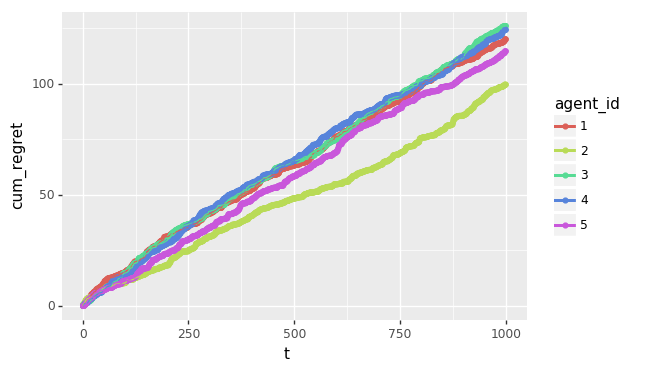

<ggplot: (8730391566673)>


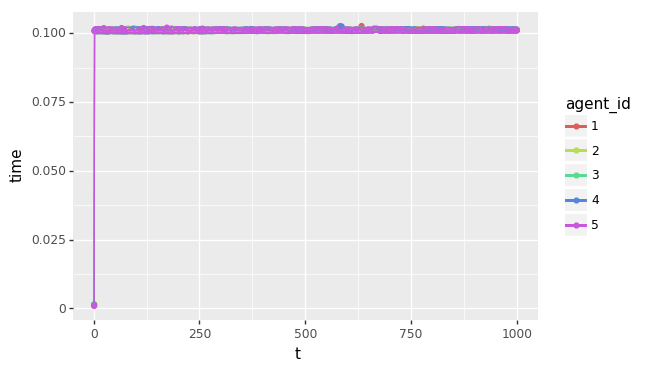

<ggplot: (8730335021749)>
theta [ 1.62434536 -0.61175641 -0.52817175 -1.07296862  0.86540763 -2.3015387
  1.74481176 -0.7612069   0.3190391  -0.24937038  1.46210794 -2.06014071
 -0.3224172  -0.38405435  1.13376944 -1.09989127 -0.17242821 -0.87785842
  0.04221375  0.58281521 -1.10061918]
Experiment: Step 0
 Sample: array([-1.65072127, -0.89055558, -1.1191154 ,  1.9560789 , -0.3264995 ,
       -1.34267579,  1.11438298, -0.58652394, -1.23685338,  0.87583893,
        0.62336218, -0.43495668,  1.40754   ,  0.12910158,  1.6169496 ,
        0.50274088,  1.55880554,  0.1094027 , -1.2197444 ,  2.44936865,
       -0.54577417])
 Steps taken: 0
 Sample: array([-0.19883786, -0.7003985 , -0.20339445,  0.24266944,  0.20183018,
        0.66102029,  1.79215821, -0.12046457, -1.23312074, -1.18231813,
       -0.66575452, -1.67419581,  0.82502982, -0.49821356, -0.31098498,
       -0.00189148, -1.39662042, -0.86131636,  0.67471153,  0.61853913,
       -0.44317193])
 Steps taken: 0
 Sample: array([ 1.810534

 Sample: array([ 0.76773708,  0.9037503 ,  2.49443582, -2.14059351, -0.67017009,
       -1.1898817 ,  0.90293386,  0.3211406 , -0.10193095,  0.19664503,
        0.21265068, -0.22041886, -2.15786963,  0.42552399, -1.09331407,
        1.59517948, -0.82311244, -1.18769119,  1.22087394,  1.11916143,
        0.30608048])
 Steps taken: 1317
 Sample: array([ 0.04261647,  1.24950539,  1.00522096, -0.73936855,  1.35103515,
       -0.09195515,  2.70891343,  1.11692774, -0.96094698, -1.02093726,
       -0.50878279, -0.26022612, -2.08173837, -1.4498859 ,  0.47520289,
       -0.3184402 , -0.51500291, -0.54212454,  0.08407075,  0.2457647 ,
        0.02784117])
 Steps taken: 1314
Experiment: Step 5
 Sample: array([ 0.48523257, -0.36961436, -1.04395618, -0.25393768,  1.03237291,
       -0.7891629 , -0.43888308,  0.99411932, -0.45675372, -0.18898795,
       -0.63927165, -0.61114468, -0.03170445, -0.27691441,  0.21010137,
        0.30079034,  0.31945777,  0.66925954, -2.17034287, -1.25442791,
        1.

 Sample: array([ 0.46174758, -1.2038719 , -0.32851361, -0.69891511,  0.97120962,
       -0.27795426, -0.48657386,  0.49140655, -0.14561684, -0.37321052,
        0.89467542,  0.28983665, -0.72180481,  0.22771947,  1.60144714,
       -0.01888225,  0.33582936, -1.28309368, -0.68486094,  0.18655144,
        1.65756455])
 Steps taken: 1195
 Sample: array([ 2.53167908, -0.883453  , -0.5717595 , -0.39113703,  0.37979081,
       -1.47620567, -0.41280816, -0.7240845 ,  0.43211227, -0.45657763,
        0.01002656, -1.52062984, -0.80874908,  0.27268067, -1.67654435,
        0.67270864,  0.12929798, -0.48723722, -0.92796284,  0.77674979,
       -1.22196699])
 Steps taken: 961
 Sample: array([-0.19514455, -0.96996909,  1.61497391, -0.61398882,  1.16279636,
       -1.2843695 , -0.29428255, -0.1717201 ,  0.57318289, -0.23275903,
       -1.13611077,  0.59581023,  1.09114523, -0.74955996, -3.20761099,
        0.36276635, -0.59504524,  0.34511399,  0.07157244,  2.58999218,
       -1.67344057])
 Steps ta

 Sample: array([ 0.27021509, -0.74162625,  0.93632026, -0.65243426, -0.17407331,
       -0.53345064,  0.83226163,  0.0955516 , -1.5203588 ,  0.68699451,
        0.64647204,  1.09275101, -0.08838705, -1.17162312, -1.37699236,
       -1.24372052, -0.41369033,  0.09337397, -1.08673943,  1.1909747 ,
        1.21801297])
 Steps taken: 988
 Sample: array([ 0.88154019,  0.43783879,  1.52882073,  0.16609802,  1.72782233,
       -1.35843452,  1.05856119, -1.22998929, -1.23483138, -0.82866884,
        0.05302005,  0.41184577, -0.13298751, -1.79634504,  1.03910665,
       -0.5131053 , -1.13479138, -0.51655277,  0.39942812,  0.48705828,
       -0.67131344])
 Steps taken: 1125
 Sample: array([ 1.07265709, -0.61582559, -0.77055199, -0.21292011,  0.93651424,
       -0.05988453, -0.62820657, -1.10025185,  0.25847531, -0.05179329,
        0.26881469, -0.79734324,  0.25716441,  0.76293957, -0.1083056 ,
       -0.68428368, -0.12945211, -1.37921224,  1.22603221,  0.30571329,
       -0.29081645])
 Steps ta

 Sample: array([-0.38372212, -2.04613468,  0.2616087 ,  0.97772257, -0.21759826,
       -1.41281012, -0.31459451, -1.73678492,  1.26838435,  0.16836296,
        0.29086207,  0.45673279, -0.11519251, -0.41667722,  0.25319423,
       -1.78398386, -0.64543026, -0.86385515, -2.71076979,  1.84048572,
        0.22643428])
 Steps taken: 1219
 Sample: array([ 0.6760134 ,  0.55865075,  0.50378218, -0.4597982 , -0.19542166,
       -1.12371763,  1.17912187,  0.04376458, -0.73765149,  1.59954861,
        0.55827628,  0.42312697,  0.17216795, -0.58211964, -0.11259571,
        0.5731194 ,  0.29947132, -1.08203868, -0.49220649,  0.69299656,
        0.0025861 ])
 Steps taken: 1234
 Sample: array([ 1.91593844e+00,  1.69668396e+00, -4.81407135e-01,  3.78334328e-01,
        5.94219831e-02, -2.89984539e-01, -1.04175867e+00,  4.36700025e-04,
       -6.57465506e-01, -6.58123962e-01, -7.05483191e-01, -1.28153212e+00,
        5.32820856e-01, -3.10946517e-02, -2.58861456e-01,  9.01564507e-01,
        2.7293033

 Sample: array([ 1.17419661, -2.1661428 , -3.38090371,  0.21148068, -0.24313709,
       -1.32971966,  0.32780621,  0.11246756, -0.13941612,  0.97209221,
       -0.99559536,  0.45569444, -1.63762122, -0.97556609, -0.62613093,
        1.01693669,  1.50690579, -1.88859522, -0.1655843 ,  1.90370717,
       -1.20804704])
 Steps taken: 1182
 Sample: array([ 5.63238207e-04, -8.84893875e-01,  9.37806807e-01, -7.06957475e-01,
        1.02758453e+00, -1.61062461e+00, -8.81582209e-01, -1.48578030e+00,
        2.42891048e+00, -2.23164269e-01,  4.84027693e-01, -1.31687323e+00,
       -6.18036063e-01, -5.32373406e-01, -7.56891462e-01, -2.28328965e+00,
        1.17870632e+00,  4.22850733e-01, -1.10841248e+00,  6.39375016e-01,
        3.04899342e-01])
 Steps taken: 1193
 Sample: array([ 0.67801164,  0.29248344,  0.26211213, -0.63019391,  0.83247068,
       -0.80931544, -0.05892756, -0.84149958, -0.27463102,  0.6861049 ,
        0.65150312, -0.61395583,  0.13774613,  0.28338492,  1.2085156 ,
       -0.

 Sample: array([ 1.03021385, -1.82275752,  0.40069163, -0.64037904, -1.24345937,
       -0.34473333, -0.15956859,  0.07579803, -1.7510549 , -0.28910374,
        1.36527228, -0.54213053, -0.33303266,  0.97821406, -0.40169407,
       -2.18258119, -0.09138361,  0.77651694,  1.00984429,  0.74996983,
       -1.01937963])
 Steps taken: 1152
Experiment: Step 29
 Sample: array([ 2.41414233, -1.75278761, -2.83539801,  0.15601942,  0.57817075,
        0.1888147 , -1.62900775, -1.87896909,  1.4956293 ,  1.4995372 ,
       -0.99551372, -1.06461398,  0.92586352,  1.36111559, -0.06638385,
       -0.10042108, -0.5835128 , -0.97193867, -1.33684262,  0.66028732,
        0.34051009])
 Steps taken: 1107
 Sample: array([ 0.59976895, -1.60723056, -0.35571582, -1.25139174,  0.54267217,
       -1.94012147, -0.01614928,  0.21035766,  1.20709134,  0.58293555,
        0.97892038, -1.35886367,  0.58211477,  1.05973585,  0.88330572,
        0.18023476,  0.08456264, -0.87959733, -1.89875217, -1.84612792,
        0

 Sample: array([ 2.21490629,  0.17784825,  1.2424988 , -0.10301556,  0.82645834,
       -1.16559901, -1.38190107,  1.25691941,  0.60456617,  1.31224553,
        0.04411572,  0.62566932, -1.5821804 , -1.80250206,  0.70027511,
       -0.15320975,  1.02284152, -0.87457981,  0.56727651,  0.4304935 ,
        0.83899077])
 Steps taken: 953
 Sample: array([ 0.54309826, -2.55740358,  2.41578616, -1.55516353,  1.67711068,
       -0.87391729,  1.33889191,  0.16773395,  1.01156937, -1.95683683,
        0.55656774, -2.52928526, -2.07806127, -0.25698709, -0.83712445,
       -0.62468686,  0.10708154,  1.20332612, -0.74558486, -0.58322158,
       -0.33814697])
 Steps taken: 987
 Sample: array([ 0.8082657 ,  1.41809982,  1.20237738, -0.15648931,  1.27499054,
       -1.17632022,  1.11961899, -1.60223758, -0.39762381, -0.96472214,
        0.1491906 , -1.60774413,  0.5950777 ,  0.18423451,  0.36635288,
       -2.26252015, -1.25491185, -1.74013002,  0.18799448,  0.20513784,
        0.60321896])
 Steps tak

 Sample: array([ 0.14688103, -0.06103746,  0.59147161, -2.51908946,  0.18889604,
       -1.51423848,  2.61908241,  0.47936632,  0.94231859, -0.33715351,
        0.73036084,  0.53967767,  0.73613457,  0.40971057, -0.05942542,
       -0.71193527, -0.90673157, -0.73549052, -1.45050731,  0.03823232,
        1.04567262])
 Steps taken: 986
 Sample: array([ 1.32281492,  1.94926779, -1.6297011 , -0.6280503 ,  0.85038981,
       -2.01384915,  1.95503468, -0.21285508, -0.17118132, -1.08664364,
        0.15880238, -0.10299725, -0.19818263,  0.92894312,  0.208759  ,
        0.65038625,  2.62173554, -2.01046852, -0.47549627,  0.75060795,
       -1.02250397])
 Steps taken: 981
 Sample: array([ 1.21687417,  0.1351426 , -0.57580208, -1.51408614,  1.20023688,
        0.39327987,  0.82519872, -0.64008171,  0.92974282, -0.41648648,
        2.02758233, -1.20233699, -0.84816813, -0.32478382,  0.81628959,
        0.24203766, -1.18659829,  0.72370967, -0.65334664,  0.1798603 ,
       -0.0955525 ])
 Steps tak

 Sample: array([ 1.61987032, -0.36835827,  0.54444289,  0.53995165,  0.0932704 ,
       -1.80708495,  0.31007768, -1.0980948 ,  1.0790858 ,  0.04450636,
       -0.43110627, -0.44635714,  1.0757339 ,  1.0240128 ,  0.19719271,
       -0.87412526,  0.15452303, -0.48281984,  1.6744255 , -0.43724506,
       -0.51410793])
 Steps taken: 973
 Sample: array([ 1.84449669,  1.31242282, -0.42807127, -1.23836273, -0.41138493,
       -0.5452989 ,  1.25893722, -0.78967738, -0.27817045,  0.32195779,
        1.89555575,  0.12695291, -0.12858478,  0.29314435,  1.24130697,
       -0.05362973,  0.16966251, -0.61882011, -0.86792464,  0.67673336,
       -1.19852936])
 Steps taken: 970
 Sample: array([ 1.83032042, -0.03874285,  0.04631045, -0.58532833,  0.03645081,
        0.36663943,  0.0463677 ,  1.91610276,  0.46493685,  1.81758238,
        0.33428216, -0.31093098, -1.16998023,  0.64008938, -0.32953327,
       -1.35014564,  0.60651475, -0.54868786,  1.28686832,  1.64321825,
        0.00367932])
 Steps tak

 Sample: array([ 1.49721667, -0.21298945, -0.09863332, -0.64176663, -0.8121375 ,
       -1.82193704,  0.77166535, -0.62018584,  0.92066477,  0.61560001,
       -0.74900131, -0.6165221 ,  0.17857271, -1.27150026, -0.93648409,
       -1.512425  ,  0.58541858,  0.1886875 , -0.09839608,  0.46398729,
       -1.12744045])
 Steps taken: 985
 Sample: array([ 0.80905319,  0.91948161, -0.17957507, -1.43150535,  0.97373704,
       -0.86808633,  1.98888901, -1.54921197,  0.265548  , -0.12176293,
       -0.32110421,  0.49280149, -0.33085024,  0.44585538,  1.38025645,
        0.55836175,  0.5674528 , -0.59051957, -0.02050799, -0.30028246,
       -0.78891676])
 Steps taken: 998
 Sample: array([ 0.50263799,  0.85920737,  1.29058324, -1.5591897 ,  0.58783143,
       -0.49760284, -0.33686701,  1.8677231 ,  0.50287611, -0.72212158,
        1.776085  , -0.2886121 , -1.05469001,  0.71332311,  1.2748815 ,
       -1.3110948 , -2.31829183,  0.78732255, -0.74642689,  0.63036924,
        1.62474066])
 Steps tak

 Sample: array([ 1.42813104,  0.26753347, -0.14985484,  0.79662665,  0.54958959,
       -0.6145776 ,  0.52985589,  0.55806135, -0.45961581,  0.35260528,
        0.27538925,  1.43781072,  1.93863855,  0.77840268,  0.2465806 ,
       -0.74118321,  0.04953257, -0.39394464,  0.30657697,  0.10565597,
        0.20967968])
 Steps taken: 973
 Sample: array([ 2.13085034,  1.6955286 , -1.66217624, -1.67289545,  2.0157275 ,
       -0.58488248, -0.12482543,  1.84370634,  0.19677937, -0.23641001,
       -0.9987866 , -1.69990302,  1.05299076, -0.56269342,  1.790518  ,
       -0.65841318,  0.81408482,  0.60641181, -0.9576591 ,  0.34326476,
       -0.32975034])
 Steps taken: 988
 Sample: array([ 0.74938125,  0.59253598,  0.60006063,  0.1902392 ,  1.88796789,
       -0.47314992,  0.6942881 , -0.36394008, -0.21269255, -0.00522834,
        0.64528475, -0.61088193, -1.44565862, -1.04981649,  0.37090093,
       -1.66000202,  0.01930814,  0.99992617,  0.7614881 , -1.15831732,
       -0.97496131])
 Steps tak

 Sample: array([ 1.15824164, -1.68028073,  0.73214027, -2.30248879, -0.14954221,
       -0.3418327 ,  0.83378276, -1.7876064 ,  0.47353243,  0.63652951,
       -0.46154591, -0.73188689, -0.08002294,  1.17280806,  1.80569172,
        0.01163846, -0.12495315,  0.53653825, -2.28116945,  1.82557152,
        0.7490946 ])
 Steps taken: 976
 Sample: array([ 1.18208592, -0.18311603,  1.14289392, -1.27681233, -0.48069808,
       -1.04790119,  2.74624575,  0.463649  ,  0.34734332, -0.31031731,
        0.37098163, -0.52443986, -1.14881661,  0.44642187,  0.15418484,
       -1.1574769 , -0.18931315, -1.3636456 , -0.74358967, -0.90624954,
       -0.08201105])
 Steps taken: 975
 Sample: array([ 1.34527871,  1.65075226, -0.84254659, -1.31731461,  1.49129758,
       -1.38414974,  2.66978117, -0.02158858,  1.01084612, -0.85180336,
        0.02599631, -0.88661773,  0.00485353, -2.09098447,  0.12195329,
        0.36407949,  0.04695039, -0.71044351, -0.54193483,  0.10318134,
       -0.67858858])
 Steps tak

 Sample: array([ 1.58709987,  0.0753655 ,  1.48022305, -0.06557739,  0.71788533,
       -0.46216788,  0.36550126, -0.17113734,  1.32358236, -0.79929739,
        0.06011898, -1.774831  , -1.1381751 ,  0.28109295,  0.81881506,
       -0.57018045,  0.52949184, -2.61944719, -2.09383857, -1.043986  ,
       -0.49144376])
 Steps taken: 982
 Sample: array([ 1.63216857,  1.4585361 , -0.81922045, -0.12050725,  1.91255877,
       -0.35850682, -1.09518911,  0.11055282, -0.14887069, -0.75304869,
        2.11835116, -2.70434666,  0.99808294,  0.99997882,  0.1501623 ,
       -0.5587701 , -0.9072711 , -1.21256406, -1.17480444, -0.79082443,
       -0.84521405])
 Steps taken: 983
 Sample: array([ 0.94525227,  0.62209155,  0.20269346,  0.9688223 ,  0.90173552,
        0.68315209,  0.19130749, -1.81843058,  0.02798818,  0.92290435,
        0.64650016,  0.55729017, -0.47740224, -0.28767873, -0.01364599,
       -2.08625558, -0.83572088,  0.81229585, -0.75669267,  0.39096581,
       -0.31033365])
 Steps tak

 Sample: array([ 1.64330609,  1.250951  , -0.89104589, -0.33160636,  1.16076384,
       -0.01681785, -0.15912368, -0.44831765,  0.10200115, -0.27915872,
        1.03946718,  0.24522106,  1.59864437, -0.50660786,  0.69214407,
       -2.98578973, -0.22138975, -0.86005038, -0.99462563,  1.61573254,
       -1.12457208])
 Steps taken: 979
 Sample: array([ 1.08550671, -1.29673641,  1.35256306,  0.76048756,  0.61870552,
        0.2664438 ,  1.17697792,  0.03740337,  0.23391509, -0.31826375,
        0.1302098 , -1.47737938,  0.23383172, -1.6950841 , -0.87081985,
       -1.00592359,  1.38467815, -0.39228669, -0.61816257,  1.56766655,
        0.22692525])
 Steps taken: 989
Experiment: Step 70
 Sample: array([ 1.50957464, -0.82434358, -1.533298  ,  0.82753896,  1.52710936,
       -0.23014744,  0.78489948,  1.0802717 ,  1.16943631,  0.61936906,
       -1.27768071, -1.30301089,  0.02225701, -1.88314456, -1.64901913,
       -1.21172752,  1.48139157, -0.91233127, -0.52700685, -0.81804804,
       -0.0

 Sample: array([ 2.43231189, -0.90933223,  0.00496906,  0.46490712,  0.31677452,
       -0.18162707,  1.17710519, -0.00758193,  0.14383235,  1.60946188,
       -0.35211077, -1.59103898,  0.45605406, -0.76879439,  0.30159746,
       -0.93795538, -1.38857643, -3.26030393,  0.16903505,  1.07641408,
       -0.92529407])
 Steps taken: 984
 Sample: array([ 1.41962546,  1.40171561, -0.39489293, -0.22638813, -0.82726251,
       -0.89874817,  0.12531486, -0.71455603, -0.76670853,  0.21391133,
       -1.20569171, -0.68644933,  0.75744582,  0.17695312, -0.09021778,
       -2.08910211, -2.56853532, -1.78106441,  0.16759708, -0.06675208,
        0.21211587])
 Steps taken: 989
 Sample: array([ 1.1949753 , -0.38531865,  1.21976868, -1.06934271, -0.78335575,
       -0.37183693,  0.60537732,  0.59808979,  0.67522464,  1.66072786,
        0.49638491, -1.98419316, -0.27187845,  0.52072952,  1.87944017,
       -0.34621447,  0.09325877, -1.28261766,  0.18290604,  0.36588868,
        0.19292724])
 Steps tak

 Sample: array([ 1.09179024,  1.34457203, -1.36293405, -0.06159451, -0.27778616,
       -2.12144239,  1.25941591,  0.91279893, -0.18352108, -0.65433481,
        0.38161931, -1.85469219,  1.3357661 , -0.69685503, -1.26394762,
        0.61571871, -0.78259706, -0.51837479, -0.66638441, -0.72042448,
       -1.78201835])
 Steps taken: 949
 Sample: array([ 1.23758631, -0.2892438 , -2.34463047, -0.08394327,  1.13715342,
        1.16122288,  1.41182467, -0.7840946 ,  0.68347773, -0.23652448,
        0.38702832, -1.23457191, -0.27054237,  0.06593803,  0.74900866,
       -1.11298397, -1.00113928, -0.75281964, -0.08411265,  0.54994718,
        0.53861037])
 Steps taken: 982
Experiment: Step 80
 Sample: array([ 2.25315316, -1.37671646, -0.20444578, -0.33668788, -0.44389258,
        1.6749767 , -0.45514634,  0.51641736, -0.33180038, -0.74614696,
        0.17113915,  0.1119681 ,  0.81995779,  0.02039935,  0.42240985,
        0.23929579,  0.5002296 , -0.28787704, -0.19481744,  0.35563434,
       -1.9

 Sample: array([ 0.63500926,  0.23984002,  0.77649852,  0.5987871 ,  1.14826683,
        0.91146451,  0.54669955, -0.36486388, -2.01592189, -1.83516166,
        0.4089045 , -0.78660787, -0.64329553,  0.0486125 ,  0.63800785,
       -1.08959364, -0.42188318, -1.29103781,  1.30975602, -0.72408022,
        1.32852908])
 Steps taken: 981
 Sample: array([ 2.14163618,  0.35309158, -0.21180122, -0.40540886, -0.09109199,
       -0.27618342,  0.62940954,  0.33617865, -0.74883729, -0.39049716,
        1.52785291,  0.14998462, -1.1769037 , -0.06795143,  0.26459288,
       -0.0686826 ,  2.32281311,  1.0414794 , -0.66355179, -0.6710844 ,
        1.31630445])
 Steps taken: 981
 Sample: array([ 1.65148023, -0.0876435 ,  0.98042524,  0.72810558,  1.50581183,
       -0.96933453, -0.87491543, -0.43756886,  0.3687016 , -0.38948106,
        1.14744006, -1.33777045, -1.06895555,  0.33386305,  1.52950496,
        0.09990115,  0.11667511,  0.89255649,  0.68591619,  0.79816861,
        0.67516465])
 Steps tak

 Sample: array([ 0.88791846,  0.25346924,  1.39982785,  0.29916743,  0.25786661,
       -0.37455165,  1.02223015, -1.30107139,  0.09783071, -0.53879758,
        0.26097971, -0.9127483 ,  0.26861013,  0.0181438 ,  0.6230938 ,
        0.51879528,  1.0112245 , -0.32110716,  0.26702364,  1.32629166,
        1.75680444])
 Steps taken: 984
 Sample: array([ 0.9169309 , -0.20938255, -1.00312182, -0.79411525,  2.15069162,
       -1.2543167 ,  1.56750604,  0.76100941, -0.23593499, -0.07784334,
       -1.24146498, -0.41877535,  0.06167931,  0.36155869,  1.2124844 ,
        0.31791297,  0.86873906, -0.37012422,  1.10063208,  0.47008492,
       -0.62235478])
 Steps taken: 983
 Sample: array([ 1.43099843,  0.77777327,  0.43820926, -1.41832839,  0.73548134,
       -0.88046988,  1.32075486,  0.18724876,  0.40071528, -1.69734845,
        2.5569949 , -1.53344904,  0.31415368, -0.54577984, -1.00454384,
       -1.05513176,  0.10388564, -0.34603059, -0.80403566,  0.33496704,
       -1.12449817])
 Steps tak

 Sample: array([ 2.22657668,  0.51731047, -0.36090685, -1.00654181,  0.87828296,
       -0.46836982,  0.00728913,  0.46709246,  0.36424475, -0.58092516,
        1.56215287, -0.855504  ,  0.19045456, -0.03157157,  0.20951351,
        0.02829832, -0.03863048, -0.36202478,  0.04218964,  0.21449841,
       -1.22344133])
 Steps taken: 976
 Sample: array([ 0.83838522, -1.95262436,  2.0302248 , -0.81204652, -0.68230762,
       -1.16098925,  1.65783352, -1.14265739, -1.06721936,  0.74890702,
        1.35421914, -2.39155592, -0.08551029,  1.20302777,  1.53138621,
        0.78861888, -1.84921533, -1.31358461,  0.3999593 ,  1.32947288,
       -0.49148638])
 Steps taken: 985
 Sample: array([ 0.75324168, -0.65973047,  0.59346336, -0.13551438,  0.36279102,
       -0.0751984 ,  0.02481989, -0.05681983,  0.04920987, -0.74462518,
        2.3492559 , -1.13264479,  0.23526342,  0.04634466, -0.3309917 ,
       -1.9228346 ,  0.21650702, -0.60718399,  0.99898106,  0.591995  ,
        0.59097342])
 Steps tak

 Sample: array([ 1.05810171,  0.33149171, -0.40742533, -1.14605743, -0.18260444,
       -3.13737689,  1.08868828, -1.15694734,  0.4897918 ,  1.25615603,
        0.07121208, -1.86081101,  0.15444272, -1.36776311,  0.44154472,
       -0.26362486, -0.7881138 , -0.21977274, -0.83848751,  0.06613636,
       -0.12560129])
 Steps taken: 980
 Sample: array([ 1.99904034,  0.41037331,  0.8171714 , -1.19625896,  0.6156331 ,
        0.0759377 , -0.15773312, -0.39824405, -0.74387975, -0.46809945,
        0.59999781, -0.20439423, -1.59490002,  1.12913094,  0.0452114 ,
       -1.17935216,  0.17224154, -0.52577314, -0.415483  ,  0.24646229,
        1.24175933])
 Steps taken: 987
 Sample: array([ 1.20908559, -1.32003407,  0.96145174, -0.47787217, -0.41677725,
       -1.62908899,  0.0189327 ,  0.05241554, -0.07082925, -1.42880392,
        0.96111276, -2.53347857,  0.5476963 ,  0.30303076,  0.07823386,
       -0.09802897, -0.14810559, -1.29797619, -0.55594318, -0.27916532,
        0.14131583])
 Steps tak

 Sample: array([ 1.1100997 ,  0.61718891,  0.29481464, -1.62661577,  0.82605614,
       -0.53196424,  0.7444049 , -0.32144308,  0.90167806, -0.1342687 ,
        0.43467609, -0.36166408,  1.99657766, -0.83791879, -0.41297591,
       -0.93086183, -0.23325293, -0.72982177, -1.23523006,  1.11454236,
        0.79527627])
 Steps taken: 972
 Sample: array([ 1.59117319,  0.81543075, -0.00742189, -1.25111371,  2.03263751,
        0.4187512 ,  0.80831785, -1.37872506, -0.68817914, -0.0558551 ,
        0.94298568, -1.15245989, -0.88700901,  0.14512794,  2.03452447,
        0.02537811, -0.60695377, -0.15800695,  0.33874503, -0.81795995,
        1.74450617])
 Steps taken: 988
 Sample: array([ 1.30696696,  0.8587034 , -0.79712227, -1.29286839,  0.25143812,
        0.64905279,  1.49313171,  0.65006312,  0.58385275,  0.30312911,
       -0.01264234, -0.89740486, -0.55503969,  0.81232051,  0.63695812,
       -0.74813926, -0.58901865, -0.78763721, -0.09496612,  1.11551758,
        0.12425182])
 Steps tak

 Sample: array([ 1.05459577, -0.91415288,  0.79980618, -0.59848818,  1.22156773,
       -0.61854801,  0.0847523 , -1.18671603,  0.7958673 , -1.88973441,
       -0.85077329,  0.11876463, -1.73655536,  1.24462626,  0.8975265 ,
        3.4835672 ,  0.29117705,  0.59940494,  0.43173399,  0.33242644,
        1.05929855])
 Steps taken: 978
 Sample: array([ 1.78444927,  0.90477079, -1.63090313,  0.67534962,  0.41165001,
       -0.74916335,  1.04418597,  0.61548028, -0.59317698, -1.19712159,
        3.39926466, -0.55598509, -0.18599159,  1.09178938,  1.47899821,
        0.20094359, -0.81181466, -1.55371722, -0.81352864,  0.69460161,
       -0.12741643])
 Steps taken: 985
 Sample: array([ 1.16880464,  1.45929831, -0.65890404, -0.70385693,  0.06688366,
        0.08967399,  0.51553105, -0.04656109,  0.06808797,  0.27122498,
       -2.332439  , -1.37169969, -0.44315669,  0.02084807,  1.21512363,
       -0.12384825, -1.54698944, -1.44212732,  0.21857492, -0.0359283 ,
       -0.03169348])
 Steps tak

 Sample: array([ 1.32441725, -0.90170995, -0.01202369,  1.04133646,  0.96932628,
       -2.13743639,  1.80915318,  0.12513445,  1.30687982,  0.53963648,
        2.12115628, -0.32739324, -1.62196873,  2.1591815 ,  0.11217207,
        2.04013302,  0.62058054, -2.45924962, -0.12572957,  0.34508448,
        0.03248452])
 Steps taken: 975
 Sample: array([ 1.11798158e+00,  1.09746677e+00,  6.82097359e-01, -6.62744353e-01,
        3.15274518e-01,  9.25533392e-01,  8.52892281e-01, -4.33813519e-01,
       -1.29434073e+00,  1.48296730e-01, -3.45171109e-01, -1.00964962e+00,
       -6.66670815e-01,  3.29874181e-01,  5.96801304e-03, -2.26540101e+00,
       -1.25316799e+00, -1.66408585e-03, -6.93882616e-01, -1.99950381e-01,
        7.67657031e-01])
 Steps taken: 970
 Sample: array([ 1.33595085, -1.37563085,  0.8398055 ,  1.617876  ,  0.26224327,
       -0.4998491 , -0.50597189, -1.05723091,  1.34442776,  1.45554662,
        0.6499656 , -1.25060102, -0.26894255, -1.84978466, -0.08179498,
       -0.64

 Sample: array([ 1.98828237, -0.03066125, -0.54948935, -1.65734598, -0.72480588,
       -0.77265495,  0.54989847, -1.04482802, -0.77478214, -0.27680816,
        0.28876169,  0.23267696,  0.65488229, -0.12810145, -0.38785219,
       -0.82742469, -1.23082048, -0.37824377,  1.45905861,  0.58304577,
        1.56231029])
 Steps taken: 973
 Sample: array([ 1.9504863 ,  1.07089488, -0.43280058, -0.1403741 , -0.07714523,
       -0.86190853,  1.24025031, -0.10049771, -1.01896986, -0.49697006,
       -0.04276427, -0.43502352,  0.4987631 ,  0.22406887,  0.25083345,
       -0.00571423,  0.01359718,  0.14204347, -0.14828752,  0.55492268,
       -0.15749255])
 Steps taken: 983
 Sample: array([ 1.28907787, -0.11798653, -0.1881776 ,  0.54571188,  0.61191342,
        0.12977745,  0.04033604, -1.09973531,  1.77616357,  0.08367279,
        0.12360732, -1.37140109,  0.72836885, -1.1310856 , -0.53931967,
       -0.64431843,  0.51030735, -0.44729956,  1.16332262, -1.67222877,
        0.25007253])
 Steps tak

 Sample: array([ 1.99505529,  0.61879924, -0.42506404, -0.06694998,  0.69365371,
       -0.72137519,  0.15501988,  1.11978445,  0.49164824,  1.16386535,
        2.62830332, -0.95637188, -0.39943313, -0.02272117,  2.2449495 ,
        0.93332141,  0.40199334, -0.05395281,  0.33971461,  0.39149217,
       -0.56628909])
 Steps taken: 977
 Sample: array([ 1.01666393, -1.68168416,  0.59205534, -2.16875818,  0.27954363,
        0.64986635,  0.90547758, -0.2617344 , -0.37246224,  0.13114447,
        1.29485355, -0.4781638 ,  0.75703279,  0.77497452,  1.46844444,
        1.85371413,  1.27020255, -0.73174425, -0.84320618, -0.1708692 ,
        0.68330155])
 Steps taken: 986
 Sample: array([ 1.54549646,  0.96055716, -0.78222508, -0.91612061,  0.01604479,
       -1.31324586, -0.33059425,  1.59445955,  0.6951419 ,  0.5196072 ,
       -0.46395307,  0.42211313, -0.61734004, -0.87050397,  1.62863681,
        0.1270844 , -1.43191354, -1.38541112,  0.21392539,  1.26435178,
        0.8647584 ])
 Steps tak

 Sample: array([ 0.92744124, -0.96514238, -0.03912689, -0.48301475,  1.99873066,
       -0.77874411, -0.24077387,  0.08899614,  0.30490872, -0.16539465,
        0.82257414, -2.05250187,  1.49684001, -0.01142518,  1.21138625,
       -1.08693739,  0.28847584,  0.72578348,  0.10458685,  0.35815705,
       -0.42915564])
 Steps taken: 985
Experiment: Step 129
 Sample: array([ 1.65045986,  0.53427804, -0.611568  , -1.32124282, -0.14494266,
       -1.67618793,  0.5383655 , -0.60103091,  0.99281542, -0.57405564,
        0.09348492, -2.31207143, -0.61536252, -0.83816851,  0.77226167,
       -1.1461835 , -1.72539079, -1.27622441, -1.1288438 ,  0.06854962,
       -0.36232881])
 Steps taken: 996
 Sample: array([ 1.23321243,  0.61994659,  0.84203682, -0.93032971,  0.41637258,
       -0.30966105,  0.84518719, -2.20972149, -0.1983944 ,  0.18691984,
        0.13353686, -0.76094127,  1.61867878, -0.63968746,  0.57301721,
       -1.25395902,  0.36165969, -0.40336453,  0.68780874, -0.34254202,
        0.

 Sample: array([ 1.75288023, -0.29700061,  2.06051589,  0.35634749,  1.21433114,
       -1.23358908,  0.63857117,  1.36827758, -1.54564161, -0.0463778 ,
        0.74836819,  1.56257575,  1.1738578 , -0.3705338 , -1.82086728,
       -1.63038647, -1.04841809,  0.66797316,  0.09010212,  1.45440723,
        0.93578855])
 Steps taken: 974
 Sample: array([ 0.84992182, -1.61351681,  0.93726876, -0.91141339, -0.71741489,
       -2.53882898, -0.70914211,  0.7918693 ,  0.25064029, -0.5666636 ,
       -0.11425519, -1.65782541, -1.42071559, -0.19582802, -0.74061199,
       -0.87219237,  0.01846224,  1.78741531,  1.27706275,  1.33342541,
       -1.44482619])
 Steps taken: 984
 Sample: array([ 2.19566936, -0.21614578, -0.31054919, -0.52956902,  1.01388048,
       -0.79865109,  1.29001788,  0.49024285, -0.88799569,  0.20739633,
        1.18247969,  0.85792586, -1.40103727,  0.8638991 ,  0.62274562,
       -0.1318569 ,  0.22380086, -0.39221537,  1.39464539, -0.02963903,
        2.08274652])
 Steps tak

 Sample: array([ 1.01430434, -1.42916916, -1.36937796, -1.30765749, -0.37079   ,
       -0.57734817, -1.70727083, -1.49519817,  0.35617739,  0.46549569,
        0.74992539, -1.10547616,  0.7654791 , -0.52368139, -0.22743422,
        0.12481832, -0.61352839, -0.96070576,  0.15080164, -0.41374762,
       -1.21988584])
 Steps taken: 958
 Sample: array([ 2.00133142,  0.44226168, -0.33127435, -1.18981609,  0.80635065,
       -0.37883529, -0.05538008, -1.16720276, -0.5314781 , -0.35190197,
        0.69223886,  0.31397163, -0.42108184,  0.38352185,  1.06618046,
        0.10080419,  1.36661968, -0.08330495, -0.49327259,  0.89776691,
       -0.43876748])
 Steps taken: 950
 Sample: array([ 1.67275733,  0.14179704, -0.52276601,  1.73455684,  1.67225495,
       -0.85025344, -0.73401621, -0.87805119, -0.36471279, -1.01119744,
        0.07992138, -1.14437499, -0.61530176, -0.94724945,  0.16388405,
       -1.22191658, -1.16820422, -0.28984726,  0.06012643, -1.56573749,
        0.85340655])
 Steps tak

 Sample: array([ 1.66817009,  0.32020612,  0.74788187, -1.40893763,  0.88960136,
        0.41435712,  2.07086809,  0.16945871, -0.26842226, -0.58830278,
        0.22609497, -0.04192179,  1.30165815,  0.30853018,  0.20612847,
       -0.7234345 ,  0.18294387, -0.73093205, -0.92043858, -1.10399191,
       -0.46970164])
 Steps taken: 954
 Sample: array([ 2.25152253, -0.65831098, -0.63971731,  0.29010687,  0.28129593,
       -1.96703011, -0.69592772, -0.81061467, -0.03175408, -2.39410906,
        0.92659488, -1.25603546,  0.77466273, -0.18433223,  1.60747586,
       -1.06591717, -0.74220005,  1.77268827,  1.6682221 ,  1.46885719,
       -0.70342836])
 Steps taken: 980
 Sample: array([ 1.38807555e+00, -7.23312047e-01,  5.07851123e-01,  1.33721512e+00,
        1.74524647e+00, -2.23923560e+00, -2.03377155e-02, -2.04270254e+00,
        1.60617480e+00,  1.33864003e+00, -5.30376034e-01, -1.53373207e+00,
       -1.58832155e+00,  8.56144650e-01,  8.87797635e-01, -1.12038185e+00,
       -1.48411857e

 Sample: array([ 1.15098977, -0.61544137, -0.23303025, -2.20141398, -0.97154781,
        0.7627697 , -0.19876773, -0.12075584, -0.77353045,  1.47944725,
       -1.2747089 , -0.29675417,  0.47965332,  0.61263912,  1.51884779,
        0.20567828, -0.33879059, -1.43892078, -1.63311711, -0.16168806,
       -1.63402031])
 Steps taken: 978
 Sample: array([ 1.01792018, -0.28386857,  0.08196042, -1.27301743,  0.53383605,
        0.52464205,  0.7901633 , -2.26553874,  0.69566808,  0.98297548,
        0.99759403, -0.42707577,  0.65464976, -0.12695981, -0.04869249,
        0.07752592, -0.41766198, -0.83762638, -1.54554417,  0.8706825 ,
       -1.26256777])
 Steps taken: 986
 Sample: array([ 1.58027908,  0.57186953,  0.41486651,  0.20044714, -1.65984332,
        0.49523577,  0.82737654,  0.54352786,  0.92924187, -1.83080366,
        0.123426  , -0.92988349, -0.14423513, -0.98140576, -0.08742015,
       -2.13681395, -0.14641852,  0.72899947, -0.21497328,  0.19516195,
       -0.52965549])
 Steps tak

 Sample: array([ 0.92912796, -1.16585752,  0.23779838, -1.51387765,  0.74066302,
        0.74492531,  0.62212055, -0.12412497,  2.14181803, -0.12112802,
        1.33534852, -0.28658037,  1.4907669 , -2.33473045, -1.82148008,
        0.18767619, -0.86278562, -0.87263477,  0.92653941, -0.00556648,
       -1.75381426])
 Steps taken: 980
 Sample: array([ 1.50197399, -1.08543372, -0.93378577, -0.35940554, -0.55645319,
       -0.19354295,  0.78617521, -0.49825079, -1.94287783, -1.26140321,
        0.46766784, -0.58520714,  0.15103249,  0.58462234,  1.42887409,
        0.66321558,  1.31580777, -0.9580289 , -0.80047215, -1.37842801,
       -0.35146506])
 Steps taken: 985
 Sample: array([ 1.00620153, -0.98376064,  1.86090231, -0.06612544,  0.2043216 ,
       -1.24464897,  0.9812263 ,  0.11715307,  0.06505043, -0.4914828 ,
        1.31274519, -1.67045656,  0.80939404,  0.08100495,  0.80865726,
       -0.24814797,  0.31830691, -0.95996868, -0.00287269,  1.63610745,
       -0.24039529])
 Steps tak

 Sample: array([ 1.57269897, -0.72861072,  0.79657568, -1.44169376, -1.04613092,
       -0.78906083,  0.19418451, -0.61071597, -1.58183736,  1.26887875,
       -0.14281792, -0.29206877, -0.03376209, -0.34345555, -1.18394479,
        0.49648341, -1.14172268,  0.12576508, -0.69684454, -0.71088081,
        0.75972583])
 Steps taken: 725
 Sample: array([ 1.71592594, -0.09379555,  0.50307923, -0.04125087, -0.10753958,
       -0.62671368,  1.78311625, -0.11683858,  0.43291731,  0.47385822,
        1.29171629, -0.70498444,  0.46974347, -1.60958991, -2.36681576,
       -3.08109468, -0.02579209, -0.10302086,  0.29930293, -0.36738888,
        1.01005043])
 Steps taken: 732
 Sample: array([ 1.24247153,  0.33617246,  1.35574403,  0.68315763,  0.82783603,
       -1.0852697 ,  0.0778666 , -0.24943175, -1.09809877,  0.39473326,
        0.00349326, -0.84474341,  1.23723858, -1.21603074, -0.14706693,
       -0.36938155, -0.82832925,  1.43610605,  0.16956285,  0.32271565,
       -0.54291794])
 Steps tak

 Sample: array([ 1.26201322,  1.06924362, -1.59653679,  0.33231899, -0.23738417,
       -1.13832386,  0.84906312,  0.17906231, -0.13567421, -0.14763404,
        0.85494531, -0.57603335, -1.52882401,  0.40869557,  0.18046052,
       -0.23538725, -1.56609567, -1.44353621, -0.49344825,  0.28280903,
       -1.08032103])
 Steps taken: 974
 Sample: array([ 1.18744638, -0.41626293,  0.51770886, -1.62349012,  1.2362594 ,
       -1.39379408,  1.54227441, -0.86561023, -0.17323178, -0.27667475,
        1.84365857,  0.6206845 ,  0.05671807, -1.48721577,  0.5682882 ,
       -1.2620629 ,  0.91719329, -1.03145014, -0.26673205,  0.27449176,
        0.80625231])
 Steps taken: 979
 Sample: array([ 1.69896165, -0.48246836, -1.02320704, -0.50045791,  2.89492326,
       -0.81832867,  0.26021593,  0.49443276, -0.70008736,  0.40520705,
       -1.15172659,  1.37058941, -0.2648587 ,  1.35552371,  1.07378135,
       -0.59482246,  2.06129679, -1.23767442, -0.22429492,  1.02565164,
        0.83648844])
 Steps tak

 Sample: array([ 1.1963147 ,  0.01076059, -2.12785222,  0.67745455,  1.42743286,
       -1.59178467, -0.36588775, -0.68652249,  0.83682583,  0.33679846,
        0.01231332, -0.11142043, -1.18917373, -0.24830653,  0.45377708,
        0.23452409, -1.10683293, -0.79466987,  1.92119887,  0.59092416,
       -1.14350492])
 Steps taken: 979
Experiment: Step 169
 Sample: array([ 1.66014499e+00,  5.55484114e-01, -1.29567133e+00, -4.03874518e-01,
       -9.70265388e-01, -2.10572205e-01,  1.56590267e+00,  1.91554407e-01,
        7.26813932e-04,  3.82359672e-01,  1.79040362e+00,  5.74927578e-01,
        3.56408814e-02, -2.73482408e-01, -9.26809215e-01, -6.10160300e-01,
       -4.47445972e-01,  1.71539897e+00,  2.23988823e-01,  3.90970724e-01,
       -1.97510036e-01])
 Steps taken: 977
 Sample: array([ 1.20465193,  0.0843375 , -1.03633227, -0.42757689,  0.77602797,
       -1.43315794,  1.36626414, -0.74716376, -0.29711411,  0.7216078 ,
       -0.59275701, -1.3174667 , -0.31484061, -1.00512918,  0.6

 Sample: array([ 1.99079194,  1.47513117, -0.8007033 ,  0.03456861, -1.12368663,
       -0.34887758, -1.79780223,  0.37090984, -0.43590054,  0.72488021,
        0.29646129,  0.24019782, -0.14887334, -1.6246275 ,  1.18509546,
       -0.10858904, -0.4662078 , -0.37289118,  0.93290377,  0.39859659,
       -1.19719713])
 Steps taken: 873
 Sample: array([ 1.36551574,  0.32397646, -0.02187203, -0.00778791,  0.11565675,
       -0.18262563,  1.0463469 , -2.47730216, -0.70686158,  1.17047103,
        0.79303913, -0.55274654, -0.19521124,  0.78065319,  2.19602665,
       -0.60126489, -0.2739524 , -0.78711853,  1.05515311,  0.4187087 ,
       -0.87904277])
 Steps taken: 888
Experiment: Step 174
 Sample: array([ 2.66109233,  0.24094473, -2.33947959, -0.01735758, -1.1432378 ,
       -0.05371095,  0.03685315,  1.19148905,  0.05589687,  0.41261061,
       -0.61354463, -0.05052186, -0.20235989, -1.3631137 ,  1.67710199,
       -1.19530473,  0.0045608 ,  0.15592226,  0.01931667,  0.56667106,
        2.

 Sample: array([ 0.43148403,  1.35351575, -0.77635312, -0.4358863 ,  1.53919968,
       -0.52360918,  0.82048598, -1.88465228, -1.83312837,  1.88886907,
       -0.34337728, -0.11878152, -0.87011764, -0.31839202,  0.18380526,
        0.03462421,  1.75692826, -0.13975992,  0.62689284,  0.97992001,
        0.67854212])
 Steps taken: 950
 Sample: array([ 2.28508801, -0.16631282,  0.13751297,  0.05765875,  0.65664992,
        0.68885978, -0.06304563,  0.41263661,  0.53474028,  1.43821054,
       -0.39937012, -1.12821854,  0.60936042, -1.07619069, -0.11321353,
       -2.32256902, -0.3791377 ,  0.93168871,  1.54157924,  1.55293448,
       -0.40900764])
 Steps taken: 958
 Sample: array([ 1.52216178,  0.49537176,  1.22747053,  0.50687007,  0.18797755,
        0.89155909, -0.01269232, -0.62111631,  0.92692064, -1.02365038,
        1.95811429,  0.12686255, -1.05113687, -1.18050683,  1.25911258,
       -0.38430915, -0.28013326,  0.9164613 ,  1.14427376,  0.56284763,
       -0.42886025])
 Steps tak

 Sample: array([ 1.55053866, -0.29586435, -0.35882656, -0.22284895,  0.14957164,
        0.10725899,  0.74234619, -1.44165698,  0.78729099, -1.2737625 ,
       -0.36819125, -0.40126022,  0.41054893, -0.64817205,  0.66003835,
       -0.92178281, -1.07289805,  0.44061614,  0.43209425,  1.16148086,
       -1.09738997])
 Steps taken: 979
 Sample: array([ 1.73436878, -0.22779579,  1.67532475,  0.29178785,  0.59514178,
       -0.25235364,  0.62352438, -0.94282834,  1.96646963,  0.72369762,
        0.6066285 , -0.55576999,  0.22029813,  0.05229959,  0.69285313,
       -0.20283602,  0.47014638,  0.5185971 , -0.34652154,  0.43168078,
       -0.77437137])
 Steps taken: 979
Experiment: Step 184
 Sample: array([ 1.88738412e+00,  6.25152233e-01,  1.23847651e+00, -1.43524622e+00,
        2.83035081e-01, -2.28241451e-01,  2.94317434e-01, -9.02923251e-01,
        3.11853429e-01, -3.85839939e-01, -1.52594422e-01,  3.21318945e-01,
       -4.36195165e-01, -4.12421505e-01,  6.31098355e-01, -7.18008928e-01

 Sample: array([ 0.8964075 , -0.02782696,  0.45529007, -0.51559933,  1.26362489,
       -0.23269341,  0.48580803,  0.27993095,  0.07717877,  1.03487577,
       -0.01712442, -1.33366105, -0.21256558, -0.83341666,  0.56325846,
        0.12609114,  0.73215434, -0.01193438, -0.48271213,  0.75408096,
       -0.81674325])
 Steps taken: 971
 Sample: array([ 2.3568591 ,  0.84470293, -1.8021939 , -0.22994025, -0.14022526,
        0.91033231, -0.02139162, -0.03215775, -1.23106763, -1.37102395,
        0.87043422,  0.3111812 ,  0.76289459,  0.70077148, -1.24359863,
        0.03843572, -0.07333755,  0.51383151, -0.39271268, -0.32998296,
        0.12592499])
 Steps taken: 974
 Sample: array([ 1.23918829, -0.87453543,  1.86679706, -1.23679422,  2.03475421,
       -0.39734376,  0.57129657, -1.25709836,  0.70278617,  0.28413092,
        1.51218414, -0.80300264, -0.36566963, -1.3564525 ,  1.01287572,
       -0.35603073, -0.275642  , -0.39676983, -1.37443438, -0.35528109,
       -0.33382238])
 Steps tak

 Sample: array([ 1.30806862, -0.82356409,  0.40829821,  1.05561779, -0.45509258,
       -0.80654863, -0.17734769,  0.15058443, -0.5452801 ,  0.27624568,
        1.54773637, -1.33209366,  0.6463847 ,  0.13721222,  0.05141019,
        0.9070431 , -1.57676375,  0.08186654, -0.52294349,  0.96359622,
        0.2852805 ])
 Steps taken: 970
 Sample: array([ 1.37275187,  0.58261553,  0.11546029, -0.28459254,  1.1304552 ,
       -0.47503293,  1.50312052, -0.59512828,  2.06677869,  0.37911565,
        0.26982998,  0.47006633, -0.0681287 , -0.95162989,  0.90329369,
       -0.7173119 ,  0.16128694,  0.40388868, -0.67903237, -0.23280101,
       -0.58732691])
 Steps taken: 983
 Sample: array([ 1.29409655,  0.17198467,  1.01775033,  0.12599301, -1.19893279,
       -2.34519208, -0.30069428, -0.75107154, -0.88790927,  0.12401175,
       -0.1805528 , -2.30919537,  1.2914749 , -0.05807263,  0.13850226,
       -0.64001378,  0.83807978, -1.37689635, -0.50958934,  0.09649073,
        1.74669185])
 Steps tak

 Sample: array([ 2.05722657,  0.61009471, -1.52897629,  1.32268066, -0.23745061,
       -0.46932703,  1.06317619, -0.94758819, -0.5377976 ,  1.50095889,
       -0.39482345, -0.52619691,  0.32704468,  1.93998036,  1.00052127,
       -0.59888931, -0.18377925,  1.1195475 ,  0.13813685, -0.02659974,
        1.92225814])
 Steps taken: 973
 Sample: array([ 0.58342921,  0.4130389 , -1.01977597, -0.40961617,  1.01411289,
       -1.93622991,  0.94573991, -0.39282005, -0.12291034, -0.41391923,
       -0.41609206, -1.46520972,  0.28560173, -1.45618964, -1.36990192,
       -0.44038663, -0.61404138, -1.85572526, -0.1313284 ,  0.3013729 ,
       -0.50648844])
 Steps taken: 982
 Sample: array([ 1.8994865 ,  1.05166101,  0.32284107, -1.34460918,  0.34309052,
       -0.26873673,  1.82190582, -1.11877963,  1.0209997 , -0.222542  ,
       -0.75780609, -0.45691557, -0.7180092 , -0.19344274, -0.28864722,
       -0.24877026,  1.08220136, -0.4650709 , -1.18235629,  0.50368059,
        0.81583068])
 Steps tak

 Sample: array([ 1.90695111, -0.82547999, -1.81185107, -0.43873203, -1.24416818,
       -1.16520828,  2.07951713, -1.0993467 ,  0.39850159, -0.71265461,
       -0.12958272, -2.11127024,  0.45832303, -0.17963248, -0.76377998,
       -1.72323868, -0.85111968, -0.48081297, -0.04745665,  1.25210213,
        1.38971824])
 Steps taken: 964
 Sample: array([ 2.49236764, -0.39962802, -0.13266537, -0.13306939,  0.82737243,
       -1.16511628,  1.4454644 ,  0.05186975, -0.40382569,  0.30684834,
        0.14420059,  1.85790975,  1.45156438,  0.29053528,  1.18106159,
       -0.38074875, -0.1332942 , -0.54465049,  0.74983681,  0.83478769,
        0.12115324])
 Steps taken: 984
 Sample: array([ 1.89586826, -0.40166023,  0.44103413, -1.92078139, -0.23484394,
       -0.69208035, -1.53570554, -1.22167588, -1.31846157, -0.34239187,
        1.53214064, -0.34488385,  0.96076709, -0.62121898, -0.67106619,
       -0.58321955,  0.61131349,  0.5164697 ,  0.28657644,  0.69367819,
       -0.91673522])
 Steps tak

 Sample: array([ 1.85239935,  1.21632995, -0.79853958, -0.03033464, -0.12999945,
        1.64654203, -0.38159295, -0.24547491, -0.38199621,  0.54823066,
        1.43253677, -0.43360126, -0.70360207,  0.1368898 , -0.36935286,
       -0.77863372, -2.1382793 ,  0.13315732, -0.69710017,  1.16993632,
       -1.30034546])
 Steps taken: 975
 Sample: array([ 1.55095343, -0.46237779, -1.0308322 , -1.21136142,  1.40197362,
       -0.78442455,  2.16826772,  0.69080304, -0.90794072,  2.5269792 ,
        1.57774809, -1.12495201,  0.0094805 ,  0.38749013, -0.18400882,
        0.16362362,  0.97871297, -0.40586999,  1.24823787, -0.0122202 ,
        1.60720592])
 Steps taken: 976
 Sample: array([ 2.00557309, -0.04864012, -1.20562272,  0.30217495,  1.15169432,
        0.37678265, -0.03506274, -1.04418544, -0.37200631,  0.40511114,
        0.89002113,  1.44511239, -0.92609024,  0.55649396,  0.29154802,
       -0.10376796, -1.21921096, -0.09414324, -0.34576911,  0.28757854,
       -0.36531565])
 Steps tak

 Sample: array([ 2.52492993, -0.59577737, -0.10523945,  0.28779275,  0.67183403,
        0.14292279,  0.8416788 , -1.12447862, -1.55837573,  0.52600281,
       -0.37100226,  0.28573404,  0.9436829 ,  0.32172604,  0.80786384,
       -0.12006107, -0.31093236, -0.98117792, -1.05488345,  0.97048387,
        0.37762881])
 Steps taken: 976
 Sample: array([ 1.90920676, -0.21088797, -0.19057296,  0.90295221, -0.45564148,
       -0.74012819,  0.35191269,  0.7816054 ,  1.01208091,  0.76378884,
        0.0853273 ,  0.91456855,  0.24857582,  0.23970717,  0.9385515 ,
       -0.55049116,  0.75626202,  0.46207785,  0.64893867,  0.24089894,
        0.3540507 ])
 Steps taken: 977
 Sample: array([ 1.49659178,  0.85621644,  0.70950382,  1.39259891,  0.14238619,
       -0.53600397, -0.68489553,  0.09447172,  0.14928148, -1.38859923,
        0.39548915, -0.04022107, -0.21671884,  0.13742001, -0.10291964,
       -1.48664393,  0.28840651, -1.34008145, -0.46831393, -0.46686772,
        1.5938662 ])
 Steps tak

 Sample: array([ 1.5838969 , -0.60524617, -0.93110002, -1.67741602,  0.36537088,
       -0.70128064, -0.52194463, -1.05290965,  0.45470714,  1.03117435,
        0.84781228, -0.50083977, -1.60152236,  0.40936111,  2.25495116,
       -0.5606242 , -0.30495374,  0.13293268, -1.17317705,  0.29940778,
        1.66979091])
 Steps taken: 960
 Sample: array([ 1.50416751,  0.53140268, -0.60233772,  0.04913211,  0.19114419,
       -0.52814294,  0.91911068, -0.26381126,  0.28859885, -0.63455321,
       -0.50424104, -1.01734579,  0.46719121,  1.76881857,  0.00358554,
       -0.56485524, -1.09741816, -0.53874408, -0.72215527,  0.52089618,
       -0.41911744])
 Steps taken: 983
 Sample: array([ 2.53771708, -0.58058493,  0.83689809,  0.9218712 ,  0.20666787,
        0.0100784 ,  1.834683  , -0.72094469,  1.2134561 ,  0.47775143,
       -0.50183075,  0.52065602, -0.1611296 , -1.60870731,  0.53884378,
        0.2113515 , -0.2551931 , -0.19047349, -0.06697548, -0.12817753,
       -1.7813512 ])
 Steps tak

 Sample: array([ 1.89903937, -0.0536595 , -1.40337853, -1.69193321,  2.12381832,
        0.08652158, -1.63119044,  0.74497321,  1.57360676,  0.18527134,
       -0.61087167,  0.09056872, -0.24877357, -0.28588558, -0.34321996,
       -0.57194826,  0.40332477,  0.17348685,  0.77030091, -0.45850093,
       -0.20603364])
 Steps taken: 975
 Sample: array([ 2.61062914, -1.70683633,  1.49002374, -1.35537476,  0.20833113,
       -1.73194225,  0.04536472, -0.10760767, -0.69653985, -0.04169711,
        2.54867242, -1.25142197, -0.7994042 , -0.53260276, -1.02675972,
       -0.41866684,  0.09614923, -1.89867593,  0.05236491,  0.39440371,
       -0.09879053])
 Steps taken: 986
 Sample: array([ 1.90080251,  0.32436419, -1.42241387,  0.80918935,  0.87056412,
       -0.40965812,  0.79411379, -0.91926229, -0.39039366, -1.51465779,
        2.88042289, -0.98992537,  0.9252373 ,  0.367072  ,  0.36437801,
       -0.06301553, -0.94950607, -0.25305918,  0.20798608,  0.08924208,
        1.20720497])
 Steps tak

 Sample: array([ 1.37215631, -0.07898411, -1.88117997,  0.28599636,  0.84967604,
       -0.96432893,  0.79091452,  0.76277623, -0.46574407,  0.68778581,
       -0.13573874, -0.84915604,  0.31268623,  0.03476325,  0.69397891,
        0.66052674, -1.60129745, -0.72523471, -0.03071461, -0.38666497,
       -1.13928286])
 Steps taken: 728
 Sample: array([ 1.74042872, -1.93971769, -0.17582694,  0.21969503,  1.22153105,
        0.01272128,  1.05731541,  0.23166637,  0.55885796, -0.30824101,
       -0.77544605, -1.67739689,  0.57769141, -0.93579745,  1.34592357,
       -1.6520245 , -0.95947347,  0.3781103 , -1.45917974,  0.69865409,
       -0.40668464])
 Steps taken: 726
 Sample: array([ 1.94355552e+00,  2.28446325e+00, -1.00663861e+00, -2.51132441e-01,
        2.12230143e-03, -5.78361313e-01,  9.34537723e-01,  1.36873371e-01,
        1.92842723e-01, -1.11024669e+00, -3.90832539e-01,  3.39814063e-01,
       -5.73948381e-01,  7.07192743e-02,  9.09543047e-01, -1.00432080e+00,
       -9.24487117e

 Sample: array([ 1.42187819, -0.93712135, -0.22765879, -0.92506141,  1.03853094,
       -0.23617574,  0.70627013, -0.54945683, -0.94571651, -0.24673036,
        0.76877235,  0.43466623,  0.22022184,  0.17930152, -0.07849805,
       -0.2404283 , -0.25988423, -0.41463126,  0.62035952, -0.36073342,
        1.27928063])
 Steps taken: 971
Experiment: Step 233
 Sample: array([ 2.09466196, -0.2804169 ,  0.26524102, -0.2314871 , -0.27487156,
       -1.38761707,  1.13308479, -1.17499585, -0.51188377, -0.75217949,
        0.0956551 , -0.40576442, -1.64511003,  0.26503725,  0.59669883,
        0.4668072 ,  0.49868513,  1.20075087, -0.16392002, -0.79030053,
        1.23180999])
 Steps taken: 984
 Sample: array([ 2.99073847, -1.21114071, -0.40677497, -0.51154596,  0.03722969,
       -2.22036293, -0.10032983, -0.47552332, -1.39110123, -0.06217075,
       -0.5338146 , -1.5039315 , -0.29029498, -0.10354881,  0.16913438,
        0.62186403,  1.54428045, -0.55982801, -0.01590512,  0.28267003,
        0.

 Sample: array([ 1.33551293,  1.64288444, -0.23308479, -0.65726351,  1.18073542,
        0.29754621,  0.86604914, -0.30356014,  0.88852941, -0.70728858,
        0.97904176, -1.34843269, -0.82481475,  0.25829982,  1.32423717,
       -0.36935349,  0.52953382,  0.11379521, -0.30810198, -0.73607733,
        0.22963916])
 Steps taken: 974
 Sample: array([ 2.53098532, -0.42269661, -2.11324311,  0.58853995,  1.63013761,
       -0.13866555, -0.61859405,  1.07507214,  1.16961623,  2.09030562,
        1.71757071, -0.56826934, -0.74479015, -0.93080822,  1.61292976,
       -0.71534824, -0.92177833, -2.1924745 , -0.05938317, -0.00830899,
       -0.65416663])
 Steps taken: 980
 Sample: array([ 1.44199259,  1.61103379,  0.98892281,  0.0274288 , -0.06418872,
       -0.3833164 , -0.05643171, -0.60138429,  0.26813877,  0.76137931,
        0.47669055,  0.81044195,  0.50499584, -0.21121425, -0.06254379,
       -2.92700403, -0.56410345,  0.32685108, -0.40406458,  0.93545613,
       -1.24846596])
 Steps tak

 Sample: array([ 1.95087322, -1.95421629, -1.37434834, -0.4904434 ,  0.73292836,
        0.10560344,  0.44384303, -1.46166125, -1.12303907,  0.82605977,
        1.33962668, -1.79287214,  0.55537856,  0.52133283,  0.25171549,
       -0.33712079, -0.24741888,  1.30908295,  0.35703578,  0.1001346 ,
        1.21782385])
 Steps taken: 975
 Sample: array([ 1.52103825, -0.21225868, -0.30755539, -0.18464064,  0.25312272,
        0.77411409,  1.95757849,  1.10953451, -0.54726882,  1.38229942,
       -0.46182572,  0.8147502 ,  2.15995556,  1.06716881,  2.04779589,
        0.49031298,  0.05604265, -0.11941138, -0.56038352,  0.9021053 ,
       -0.60048096])
 Steps taken: 988
 Sample: array([ 2.05540392,  0.9607132 , -1.31603681,  0.13096792,  0.47994882,
       -0.22766018,  0.60549012,  1.61254131, -1.59721799, -0.12607859,
       -0.27593947, -2.12113897,  1.3287914 ,  0.51253228,  0.16546377,
        0.36648553,  0.32415717, -0.41694135,  0.91859407,  0.16207702,
       -0.26864278])
 Steps tak

 Sample: array([ 1.57080812, -1.57724848, -0.01927545, -1.25068816,  1.13844397,
       -1.07367325,  1.51434887,  0.19562899,  1.10508326, -0.93858606,
       -0.22303899, -2.3183738 ,  1.62851336, -0.87421589,  1.81176855,
       -0.13693211,  0.80304734, -1.30398529,  1.98803048,  0.16790279,
       -1.03329505])
 Steps taken: 951
 Sample: array([ 1.5882593 ,  0.34499729,  0.41163541, -0.13649606,  1.2230948 ,
       -1.95303966,  0.56296487, -0.62993249, -0.34514082,  0.14229805,
       -0.45401561,  0.16355728, -0.23214179,  0.58383218,  0.03771972,
        1.08902492, -0.26147742, -0.11614425,  0.36562851,  0.77725414,
       -0.7638341 ])
 Steps taken: 955
 Sample: array([ 2.71037056, -0.20073592,  1.2202167 ,  0.28001079,  1.5839603 ,
       -0.87966506,  1.60201772,  0.59770555,  0.50383922, -2.12824783,
        0.49902015,  0.12344822, -0.14717705,  1.00023457, -0.34719091,
       -0.7334735 , -0.51995472, -1.40294792,  0.51179152, -0.18259724,
        1.19234667])
 Steps tak

 Sample: array([ 1.79934795, -1.2088037 , -0.36610731,  0.49362166, -0.41366197,
        0.68348548,  0.84971499, -1.4495966 , -1.03886042,  1.15941975,
        0.46298422, -1.25209763,  1.05780062, -0.64711122, -1.27729927,
       -1.63087364,  0.32866057,  0.06982436, -0.30805875, -0.61437892,
        0.78788407])
 Steps taken: 971
 Sample: array([ 1.72026518,  0.01333418,  0.7795134 ,  0.38961943,  0.31872256,
       -0.51865608,  1.36153303,  0.09876375, -0.04279324,  0.59951717,
       -0.89412618, -0.2400573 , -1.52149765, -1.09407436, -0.25321287,
       -1.32034106,  0.49661602, -0.95002499, -0.05215107,  0.41105212,
       -0.99189841])
 Steps taken: 979
 Sample: array([ 1.79494936, -0.62262077, -0.69481446,  0.11362824, -1.25973272,
       -0.10130097,  0.46805001, -0.80882631, -0.71619323,  0.64708468,
       -0.61882244, -1.3104161 ,  1.31957643,  0.76346875,  0.26759897,
       -0.77766218,  1.04212552,  0.63785744, -0.52694043,  0.52743417,
       -0.03939044])
 Steps tak

 Sample: array([ 1.79222591, -0.5976705 , -0.68468757, -2.86793284,  1.02738287,
       -0.16333117,  0.86744535,  0.14678185,  0.44637294,  0.98047045,
        1.50050712,  0.26644923,  0.12350144,  0.68745979, -0.17717835,
        0.59987766, -1.62282271,  0.10814433, -1.99480269, -0.53879784,
       -0.03520161])
 Steps taken: 966
 Sample: array([ 1.73036788, -0.09396627,  0.6295835 ,  0.73222948,  1.1626986 ,
       -0.17245145,  0.59196616, -2.04964418,  0.86519459, -0.51716921,
        0.37803402, -0.57339179, -0.11325046, -0.5400988 ,  1.44545813,
       -0.29558436, -1.46447343, -0.4309073 ,  1.18874029,  0.63482899,
       -0.13832814])
 Steps taken: 971
 Sample: array([ 1.62554256, -0.1525234 , -0.39393286,  0.50662526, -1.31484515,
       -0.39884641,  1.98257229,  1.14260447, -0.4615581 ,  1.10548602,
        1.28704047,  0.08351624,  1.00448885,  1.22162598,  0.36896994,
       -0.06803124, -0.2315437 ,  0.30906764,  0.82851813,  0.58704562,
       -0.48139256])
 Steps tak

 Sample: array([ 1.54308788, -0.89115037, -0.52966656,  1.12165358,  1.00356103,
       -1.24386765,  0.85139609, -1.70449683,  0.74852216,  0.40030628,
       -0.6317121 , -1.2950706 ,  2.12447222,  0.81050025,  1.16931235,
        1.40283507, -0.30225152, -1.134916  ,  0.80005425,  0.08151922,
       -0.51627275])
 Steps taken: 968
Experiment: Step 263
 Sample: array([ 1.71550778, -0.47908168,  0.30258777,  1.15166444,  0.96793046,
       -0.59399437,  0.17777386,  0.68281273,  0.475081  ,  1.18605793,
        0.58570647,  0.38616005,  0.83778574, -0.1658748 ,  1.09630678,
        1.27156108, -0.08996493, -0.42691307,  0.20304121, -1.0959627 ,
        0.53885525])
 Steps taken: 977
 Sample: array([ 1.56577436, -0.01291819, -0.74727227,  0.96205495, -0.13945494,
       -0.06458967,  0.42820219, -0.34109713,  1.15859567,  1.05389873,
        1.43363085, -1.63738357,  0.73917468, -0.3366749 , -0.00298992,
        0.27677885, -0.54228262, -0.64265522,  0.62890964, -0.92743775,
       -1.

 Sample: array([ 6.84648806e-01, -4.26755506e-01, -4.25410821e-01,  5.20302545e-01,
        1.13840382e-03,  1.86846112e+00, -3.19420365e-01,  8.18723677e-01,
        3.86075951e-01,  8.04913069e-01, -2.20692006e-01, -1.14483307e+00,
        2.26449851e-01,  1.01670069e+00,  1.56431853e+00, -1.46127586e-01,
       -3.94913365e-01,  2.67002452e-01, -1.91031248e-01,  4.91723874e-01,
       -2.14118328e-01])
 Steps taken: 964
 Sample: array([ 1.4804743 , -0.88460551, -1.06895097, -1.51423286,  0.03327528,
       -3.0940222 ,  0.57020039, -0.71389655,  0.05891833,  1.02067988,
       -0.24943633, -1.35819732, -0.12593282,  0.69010878,  2.42257258,
       -0.27889072,  1.93068768,  0.69395716,  0.87830208,  0.77719007,
       -0.42698975])
 Steps taken: 952
 Sample: array([ 1.54570183, -0.43137301, -0.97011231,  0.16690265,  1.00374701,
       -0.50388774, -0.00898019, -0.26741893,  1.06855935,  1.45085515,
        0.30512778, -0.71180488,  0.18183995,  0.6048898 ,  0.08571227,
       -0.26

 Sample: array([ 2.03150937, -0.49267201, -0.49930366,  0.19877031,  0.04472321,
       -0.87203009,  1.00918137, -0.80458509,  0.77051529,  0.00580857,
        0.92207306,  0.5151959 ,  0.0376388 , -1.11253443,  0.77377233,
       -1.50569819, -0.90257913,  0.98940684,  0.13166375, -0.01542187,
       -0.67705119])
 Steps taken: 963
Experiment: Step 273
 Sample: array([ 2.05414066,  0.54789242, -1.00967882,  0.03111184, -0.27629069,
       -0.38728143,  0.2415687 ,  0.35934561, -0.3599186 ,  0.71980022,
        0.15696721, -1.05574378,  0.24905985, -0.15415853,  0.47276147,
       -0.74695037,  1.09489782, -0.69233245, -0.56997546, -1.77896883,
        0.41130189])
 Steps taken: 969
 Sample: array([ 1.14552023, -2.12294452, -0.10331764, -0.16406156,  1.98954113,
        0.0244286 ,  2.09847657,  1.11407103, -0.25576134, -0.1791476 ,
        0.58808711, -0.33875097,  0.17439655, -0.75427995,  0.19497308,
        0.573574  , -1.63063   ,  0.94127419, -0.15939951,  0.62162858,
       -0.

 Sample: array([ 2.09849271,  0.11017289, -0.11895268,  0.86909897, -1.65801723,
       -0.05892581,  1.45836413, -0.71283284,  0.05917832, -0.55281212,
        0.92971175, -2.49446245,  0.81624403, -0.13245091,  0.62937811,
        0.04138618, -0.36421517, -0.11836987,  0.13223428,  0.58211564,
       -0.12006221])
 Steps taken: 928
 Sample: array([ 1.93214482, -0.62474435, -0.78397164,  0.93459751, -0.4949604 ,
       -0.50461906,  1.09445777,  0.55903971,  0.15656481, -0.19366311,
       -0.01075177, -1.08235434,  0.11844045,  0.48095464,  0.03439028,
       -0.47782301,  0.25492475, -0.09428274, -1.01589797,  1.05346988,
       -0.16630206])
 Steps taken: 969
Experiment: Step 278
 Sample: array([ 0.92678576,  0.50713542, -1.82073029, -0.37543402,  0.80084601,
       -0.71433592,  0.17281314, -0.18704169,  0.71825621, -0.57666919,
        0.19454432,  0.23057981, -1.05578561,  0.38940205,  0.74189007,
       -0.46431278,  0.03271449, -0.62206187,  0.60678318, -0.29016951,
       -0.

 Sample: array([ 1.44476459,  0.5278254 , -0.39922081,  0.42637325, -0.6064085 ,
       -1.52603433,  1.0474815 ,  0.09487754,  0.54290185,  0.63425287,
        0.3232653 ,  0.53210916, -0.21087854, -0.0174418 ,  0.65383598,
       -0.61741788, -0.73209277, -0.12182994,  1.02162695, -0.03824385,
        0.94936396])
 Steps taken: 932
 Sample: array([ 0.64395385, -0.15917439,  0.00501628,  1.42116374,  0.42093268,
       -1.48328401,  0.39308171, -0.16597354, -0.9229302 , -1.13346395,
        1.33173214, -0.53089843,  1.42766834, -1.52950063, -0.12796721,
        1.28391236,  0.65475076, -1.70562862, -1.35739566,  0.84362845,
       -0.80509527])
 Steps taken: 946
 Sample: array([ 2.25061813, -0.03468201, -0.16413777,  0.46879992,  1.38322936,
       -0.92022707,  1.37356865,  0.7478506 ,  2.30326924, -0.16235563,
        0.57601507,  0.2580629 ,  1.53316066, -0.49646087,  1.56915635,
        1.36290381,  1.20192273, -1.26594852, -0.45658705, -1.33270618,
       -0.95839671])
 Steps tak

 Sample: array([ 1.08576876, -0.61936302,  0.38951595, -0.93489069, -0.0251274 ,
       -1.58694788,  0.03581358,  0.3496944 ,  0.3048364 ,  0.61439696,
       -0.61142219, -1.34582327,  0.05296971,  0.91225543,  0.85951505,
        0.92463361, -0.9657637 , -1.5418043 ,  0.83023331,  1.39116349,
       -1.19225833])
 Steps taken: 923
 Sample: array([ 0.9159692 , -1.91758132, -0.76543103,  0.24253751, -0.16649796,
       -1.19212756, -0.44974047, -0.87903591,  1.01264388,  1.79871904,
        0.03914253, -1.52150995, -0.11132174,  0.42514663,  0.05440937,
        0.54818572, -0.60224639, -0.44217419, -0.22976232,  0.32915748,
        0.12051381])
 Steps taken: 942
Experiment: Step 288
 Sample: array([ 1.37639854,  1.1483127 ,  1.37601968,  0.25604797,  1.72191549,
       -0.53049578,  0.77678379,  0.16114628,  0.453912  ,  0.06627438,
       -0.04305011, -0.13137724, -0.90356541,  0.02768546, -0.41460307,
        0.23670498, -0.75689789, -0.20060813,  1.26800376, -0.44710441,
        0.

 Sample: array([ 2.29997518,  0.40034144, -1.99785116, -0.52051919,  1.41744418,
       -0.25543019,  0.56452831,  0.4396254 , -0.75497021,  0.75105545,
        0.98857059,  0.09072806, -0.33982475,  0.13128127, -0.86289633,
        0.71365642, -0.13672564,  1.42980583,  0.53522569,  1.1616507 ,
       -1.98925632])
 Steps taken: 927
Experiment: Step 293
 Sample: array([ 2.45351573,  0.28165893,  0.70111004,  0.17463123,  0.47508952,
       -1.2788688 ,  0.29543023, -1.14545756,  1.27828644,  0.70376809,
        0.95992272,  1.3360238 , -0.88685422, -1.48906361,  1.13070061,
       -1.91740856,  0.2478794 ,  0.43600916, -2.48862477, -0.45227686,
        0.11920484])
 Steps taken: 939
 Sample: array([ 0.58179606, -0.32780082, -1.36658156,  0.38846191,  0.34707116,
       -0.3043051 ,  2.12258118, -0.95480131,  0.18327779, -0.2580422 ,
        0.14819413,  1.09518087,  0.13296706, -0.47469209,  1.69608738,
        0.13350654,  1.39355082,  0.0440973 ,  0.984544  ,  0.0589205 ,
       -1.

 Sample: array([ 1.75403279,  2.18114214,  0.81353692, -0.31857108,  0.98060037,
       -1.42530538,  1.57877478, -0.70083716, -0.65850768,  0.29173027,
        0.60897327, -1.44036941,  0.00661488, -0.3018852 ,  0.73162471,
       -1.0854183 , -0.93277779, -1.01691132,  0.26147145, -0.55137918,
        0.4068924 ])
 Steps taken: 916
 Sample: array([ 0.61465694, -0.95214053,  0.44729201, -0.51225307,  2.10491533,
       -0.88824999,  2.21485118,  0.01972527,  1.72944833,  0.65336335,
        0.1294517 , -0.81713743, -0.41048743, -1.43616397, -0.05073309,
       -1.55064032,  0.06269713,  0.56792092, -0.85028415,  0.16255325,
        0.00977283])
 Steps taken: 901
 Sample: array([ 1.83770699, -1.26061936, -0.47175864,  0.02311166,  1.14407835,
        0.74414212,  0.14373475,  0.90414014, -1.31563154, -1.79579002,
        0.69061017, -0.22020707, -2.0077858 , -0.51717176, -0.20632186,
       -0.80660763, -0.02797716, -0.42608855,  0.05045807, -0.20781481,
        0.04940899])
 Steps tak

 Sample: array([ 1.14262165, -0.47897146,  0.25548579,  0.84673379,  0.55596206,
       -0.02569279,  0.52234901,  0.42666283, -0.97958682,  1.1655508 ,
       -2.01431557, -1.18565056,  1.41144208,  0.43482073, -0.40871627,
       -0.88594024,  1.9189    , -0.74019381, -1.62933863,  0.85301811,
       -0.43138909])
 Steps taken: 924
Experiment: Step 303
 Sample: array([ 1.39727865, -0.36593503, -0.37791416, -0.4942062 ,  0.76088003,
        0.40868402,  0.93584872, -0.81023495,  0.00300885, -0.73481428,
        0.53943698,  0.91587393, -0.11457657, -0.07981713, -0.19226788,
        0.2876021 ,  0.85131591, -0.42315079,  0.52331727, -1.6960097 ,
        0.31111128])
 Steps taken: 931
 Sample: array([ 1.95544307,  1.57585967,  1.89744948, -1.01366463, -0.58203332,
       -1.26301835, -0.22128525, -0.58240561, -0.73771218,  1.42303581,
       -0.52941603, -0.23280194, -0.99732964, -1.63961817,  0.99151501,
        1.18363422, -0.87497797,  0.61947651, -0.05654624,  0.87749963,
       -0.

 Sample: array([ 1.60386112,  0.15803333, -0.72227664,  0.20258831,  0.54668839,
       -0.52820006, -0.14442249,  0.03211669,  0.16703141, -0.5133675 ,
        0.82016445, -1.18796364, -0.68837133,  0.03433804,  0.7667865 ,
       -0.02811934, -0.63022745,  1.10709972,  0.39964564, -0.03058358,
        0.96492321])
 Steps taken: 928
 Sample: array([ 1.41117386, -0.79525095,  0.43551445, -1.2816743 , -0.78583585,
       -0.52118551, -0.52895467,  0.12577592,  1.25287366,  0.62322669,
        0.08228105, -1.11134066, -0.97297721, -1.24075154,  1.7567404 ,
        0.61558953,  0.37598411, -1.14503009,  1.18895417,  0.59235347,
       -0.16219611])
 Steps taken: 921
 Sample: array([ 1.46057656,  0.16043784,  0.14251537, -0.56388126, -0.37045063,
       -0.48798426, -0.84848425,  1.62607087,  0.0587628 ,  0.56487721,
        1.46614671, -0.10459066, -0.45900415, -0.91364545,  1.11516826,
       -0.89420272, -1.31652171, -1.17730407,  0.94143074, -0.51673099,
        1.5112988 ])
 Steps tak

 Sample: array([ 1.26773218, -0.61742368, -0.68691945,  0.85893447,  0.14810611,
       -1.75112116,  1.50395481, -0.69121513,  0.56912506,  0.40849404,
        0.06968179, -0.70058532,  0.60034528,  0.71138878,  0.61542838,
        0.20562764,  1.0249636 ,  0.89397526, -0.27495195, -0.60335532,
       -1.42850038])
 Steps taken: 919
 Sample: array([ 1.61945913,  0.27120458,  0.19151678,  0.44722733, -0.46147146,
       -0.01490336, -0.33841718, -1.99143141, -0.99324156,  0.31900667,
        0.9513311 ,  0.26919705, -0.17049725, -0.96865282,  1.67371924,
       -0.58726635,  0.17571362, -0.44303822, -0.24411508,  1.03198096,
       -0.63755322])
 Steps taken: 936
 Sample: array([ 2.21130776, -0.20280939, -0.46667585, -1.78292625, -0.6326204 ,
        0.67418685,  0.3767738 , -0.46177811,  0.09293295,  0.12865742,
        0.03103135, -1.23284337,  0.01655694,  0.01696723,  1.73987063,
       -0.36208795, -0.52133616,  0.44460316,  0.30947477, -0.35247443,
       -0.52427312])
 Steps tak

 Sample: array([ 1.66427503,  0.23322854, -0.27887213, -0.22915053,  0.19440904,
       -0.32080103, -0.22615783, -0.47679969,  0.29506639, -0.13368605,
       -0.15136513, -0.11066532,  0.94435384, -1.41939972,  0.74273313,
        0.01394577,  0.63322085, -0.34816236, -0.00685042,  0.72408928,
        0.23381208])
 Steps taken: 924
 Sample: array([ 2.24808588,  1.7976832 ,  0.67289622,  0.51090842, -0.90741752,
       -0.76995095, -0.88141922, -1.83236707, -0.25541574,  1.28111168,
        0.69220538, -1.75863333,  0.61534842, -0.84470749, -0.10140818,
       -1.17970337, -0.26543112, -1.34937767,  0.58088026,  0.4519411 ,
       -0.39212486])
 Steps taken: 932
 Sample: array([ 2.09265926,  1.72382484,  0.5759811 ,  0.04534845,  0.53067282,
       -0.93095346,  1.70335066, -1.33586067,  0.474698  ,  2.10243597,
        0.79969944, -1.0936413 ,  0.36711152, -0.46580616, -0.23486987,
       -2.08748883,  1.2430739 ,  0.58396367, -1.01449015,  0.3324048 ,
        0.20529875])
 Steps tak

 Sample: array([ 1.77821483,  0.45562244, -0.36118931, -0.37826609,  0.80218202,
       -1.48373345, -0.04145395, -0.9300303 , -1.31898647, -0.11097565,
        1.03545571, -1.06646225, -1.1072391 , -0.07708553,  0.125956  ,
       -0.4031737 , -0.70697706, -0.38479275,  0.28923524,  0.83604113,
        0.98926625])
 Steps taken: 915
 Sample: array([ 1.2540111 ,  0.56420766, -0.42143581,  0.11073739,  0.24941126,
       -1.88657891,  1.33134528, -0.21211146,  0.01798413, -0.80112949,
        1.28687678,  1.77049029,  0.24604791,  0.40040312,  0.33554765,
       -0.87431554, -2.3758108 , -0.63827988,  0.25745352,  1.15791466,
        1.11276102])
 Steps taken: 933
 Sample: array([ 1.96430723, -0.42611886,  0.45488029,  0.60181159,  2.01954253,
        1.20819317,  1.81142199, -0.57702586, -1.11537521,  0.52765585,
       -0.45382548, -0.76522705, -1.17338598,  0.23458314, -1.76241831,
        1.9226921 ,  0.62805245,  0.5925752 , -0.12227353, -0.01254656,
        1.96357823])
 Steps tak

 Sample: array([ 1.59878914,  0.00209862, -0.1367176 , -0.71281145,  1.00972315,
       -0.76106107,  0.49541859,  0.81680064, -1.30547236,  0.56207617,
        0.56400742,  1.50920681, -0.99094705,  0.22675679, -0.08277612,
       -0.46472596,  0.48298412, -0.1630385 ,  0.35285854,  0.22045647,
       -0.70621029])
 Steps taken: 908
 Sample: array([ 1.80515587, -0.57428862, -0.71984459,  0.00870834, -0.24127281,
       -0.07528401, -1.02108337,  0.42149234, -0.96641401, -2.07252142,
        0.01112277, -1.97797479, -0.40697024,  0.74636303,  0.67581748,
       -0.61634581, -1.13355633, -0.3970179 ,  0.13926716, -0.65201969,
       -1.21404148])
 Steps taken: 932
 Sample: array([ 2.38171314, -0.19188257,  0.25978224,  0.15016227, -0.42059909,
       -0.30685612,  0.54135685, -0.23579615, -0.47566923, -1.49894779,
        0.18420848, -1.540774  ,  0.7159898 , -0.83343507,  1.09029827,
        0.51446856,  0.15801657,  0.00886332,  0.48672207,  2.65518101,
       -1.05011478])
 Steps tak

 Sample: array([ 1.35644813,  0.0838037 ,  0.50747522, -1.31048736,  0.98467219,
        0.2381532 ,  1.78035413, -1.45963281,  3.13971005,  1.02486293,
       -0.49242737, -2.29695166,  0.20724418,  0.96544284,  0.46492244,
       -0.55233285,  1.53040733,  0.09461896,  0.7217815 , -0.27172332,
        0.81206897])
 Steps taken: 920
 Sample: array([ 1.48072038, -1.04693842,  1.86268836,  0.51734812,  1.69867386,
       -0.60555094,  0.96854409, -0.16755162,  0.0813526 , -0.43961186,
        1.23417079, -1.00755798, -0.52807799,  1.59007745,  0.69936893,
       -1.59453327,  0.94130578, -0.81712909,  0.50954123,  1.17423439,
       -0.36991239])
 Steps taken: 925
 Sample: array([ 1.42424648,  0.24244193, -1.14176558,  0.03289338,  1.05651082,
       -1.52499355, -0.73086607,  1.44973683, -0.46754903, -0.36570645,
       -1.3854023 ,  0.10783608, -0.4132162 , -1.00197697,  0.05546704,
        0.515855  , -0.11235472, -0.78602106,  0.63854307,  0.41492685,
       -0.79657363])
 Steps tak

 Sample: array([ 1.35044519,  0.91700089, -0.38638419, -0.91078144, -1.22612236,
       -0.68275299,  0.70437742, -0.17859505,  0.1423707 , -0.31673613,
       -1.15257153, -1.09483336, -0.17910984,  0.19333128, -0.03621178,
        2.1587868 , -1.95016261,  0.31792562, -0.70954094, -0.51934196,
        0.3560743 ])
 Steps taken: 917
 Sample: array([ 1.34598298,  0.40091025,  0.53504283,  0.10595403,  1.42192041,
        0.47137156,  0.92078021,  0.78697327,  0.17689072,  0.93123208,
       -0.36006823, -1.56552218, -0.08476626, -0.86479428,  1.67390636,
       -0.44449232, -0.26031558,  0.39822151,  0.01277091,  0.06020589,
       -0.16330076])
 Steps taken: 929
 Sample: array([ 1.70458142,  0.30935163,  0.65336693,  0.37697788, -1.51867956,
       -0.28947224,  0.60410542, -1.59015994,  0.11039806,  0.90409862,
       -0.02813308, -2.35772488,  0.18003449,  1.02875103,  0.58466704,
        0.27856478, -0.61566825, -0.7506624 ,  1.21657016,  1.5720977 ,
       -0.0811202 ])
 Steps tak

 Sample: array([ 1.26253418,  0.05655999,  0.63539434, -0.2828039 , -0.0375476 ,
        0.90993275,  0.7627021 ,  0.2911978 ,  0.18015644, -0.30979563,
        0.34142369, -0.64247125,  0.05041675,  0.07136454, -0.7970147 ,
        1.41728933, -1.11740445, -0.07934363,  0.23274554,  0.44890914,
       -2.61797225])
 Steps taken: 925
Experiment: Step 343
 Sample: array([ 1.51033672, -0.63063089, -0.57536717,  0.03826599,  0.44746943,
        0.87056548, -0.02149196, -0.09522088, -0.09166736, -0.13705666,
       -0.82273845, -2.18436994,  0.96689309, -0.42984762,  1.07103987,
        0.55414171, -0.80011482, -1.92616184, -0.38991437,  0.90675227,
       -0.30703084])
 Steps taken: 931
 Sample: array([ 1.40492057, -0.81799889,  0.7459108 , -0.97745827,  0.80257318,
        0.06301139,  0.81693574, -0.35474607, -0.88747612,  0.63077662,
       -0.70284277, -2.24540514, -0.2675809 ,  0.54119731,  0.03122249,
        0.9483215 , -0.53947759, -1.02282277,  0.76608601, -1.1769706 ,
        1.

 Sample: array([ 1.23468027, -1.10545792,  0.44101963, -0.96388616,  1.16947484,
       -0.96358354,  1.89145277, -0.16805934, -0.59551531,  0.38087133,
       -0.52417689, -2.12393443,  0.02593957, -0.30343316,  0.02657631,
       -0.2353054 ,  1.25883302,  1.0798127 ,  0.91405189,  1.07497821,
        0.74984397])
 Steps taken: 918
 Sample: array([ 0.81830345, -0.45869033, -1.62527923, -0.88167085,  0.93094114,
       -1.29131747,  1.17976156, -0.12925652,  0.06120433,  0.01407125,
        0.1136176 , -0.76143704,  0.36425639, -0.97155097, -0.02422635,
       -0.85252766,  0.6654163 , -1.1723356 ,  0.83937511, -1.72190384,
       -0.52533558])
 Steps taken: 930
Experiment: Step 348
 Sample: array([ 1.92202746, -1.07956514,  0.25979264, -0.21716437,  0.05956385,
        0.42382857,  0.71784969,  0.50128338,  2.80757301, -0.34043232,
        1.2604838 ,  1.05809701, -0.33618948, -0.39740579, -0.26245677,
       -1.72189037, -0.54331852,  0.05054603,  0.03014007, -0.2791606 ,
       -0.

 Sample: array([ 1.74877585,  0.96484319,  0.53588883, -1.30402975,  0.84536313,
       -1.61757483,  2.08614741, -0.6435048 ,  0.17901527, -0.23957884,
       -0.17184121,  0.03456013, -1.2766238 , -0.64317527, -0.40682146,
       -0.08551341,  0.35093289,  0.4068075 ,  0.97276334, -0.0627769 ,
        0.00518396])
 Steps taken: 893
 Sample: array([ 2.93445015, -0.83262404, -0.65148336,  0.25156163, -1.37661122,
       -1.12838844,  0.35056328, -0.66038364,  0.61002437, -0.50477927,
        1.34001649, -0.15930348, -0.20592792, -0.37504577,  0.16495466,
       -0.23246144,  0.55539249,  2.22624698,  0.57227119,  2.08400734,
       -0.33758611])
 Steps taken: 910
 Sample: array([ 1.03279282, -0.63880449, -0.97446997,  0.21282948,  0.38927885,
        0.01201296,  0.30616156, -0.10085771, -0.57464606,  0.2408515 ,
       -0.38528987,  0.01398178,  0.0319226 ,  0.31252126,  0.27458999,
       -0.07105893, -0.83384382, -0.34150528,  1.22581466,  0.65957015,
       -1.3345945 ])
 Steps tak

 Sample: array([ 2.07317189, -0.21786184, -1.17093316,  1.0605941 ,  1.76432113,
        0.39172086,  0.01178398, -0.33939385, -0.73348487, -1.22338775,
       -0.07164373, -1.74266358, -0.26248444,  0.75606822, -0.17774346,
        1.04001457,  0.08156687, -0.01987892, -1.10650177, -0.6499708 ,
       -1.4214806 ])
 Steps taken: 913
 Sample: array([ 2.25184899, -1.37516519, -0.75878885, -1.69098789,  1.38248906,
       -0.94177133, -0.28668053, -1.23078097, -3.64621417,  0.19840617,
        0.95266898, -0.25959794,  0.46614064, -0.59218854,  0.80319843,
       -0.81906637, -0.03549025, -1.17298245, -0.85625573,  1.32512431,
       -0.48948538])
 Steps taken: 911
Experiment: Step 358
 Sample: array([ 2.01898964,  0.24135414, -1.04572658,  0.48535008,  0.9415318 ,
       -1.87961485,  0.23841099,  0.68394983, -0.82891346,  0.95129727,
       -1.66352265, -0.20189462, -2.1017892 , -0.40859526, -0.13095299,
       -1.22977569,  0.71526035, -1.51048479, -1.19693875, -2.09977679,
       -0.

 Sample: array([ 1.48538306, -0.64113472,  0.09133732, -0.43572133,  0.26287813,
       -1.01885698,  1.9603783 , -1.4600117 ,  0.1142931 , -0.44823332,
        0.45977425,  0.17340144, -0.79124903,  0.30214909,  1.48344167,
        1.33324774,  0.41535634, -2.99815148,  0.23581454,  0.77907242,
        0.34880885])
 Steps taken: 878
 Sample: array([ 1.09064198,  0.5607382 , -0.69681672,  0.37731401,  0.5395273 ,
       -0.36139942,  0.75079323, -0.88151035, -0.72074959, -0.92422388,
       -1.24993158, -0.75474961, -0.56435631,  0.42632468, -1.07208277,
       -0.12997646, -0.70169785, -0.70766016, -0.06236151,  0.42557259,
       -0.57725752])
 Steps taken: 922
 Sample: array([ 1.53900404, -0.19320503, -0.18709353,  0.32291033, -1.39037045,
       -1.17048371,  1.26532999, -1.02589239, -0.19172593,  0.08923259,
        0.07593246, -0.73877916,  0.91629587, -2.09367792, -1.36516071,
       -0.10153151,  0.04377288, -0.70965718, -0.14247975, -0.14361731,
       -0.395263  ])
 Steps tak

 Sample: array([ 2.01895301, -1.17982739,  1.3196146 , -0.76317352, -0.9686352 ,
       -0.77262574, -0.51610496,  0.15906763, -0.53152688, -2.07484134,
        0.26238418, -2.16154573, -0.07476344,  0.12492017, -0.00402266,
       -1.0682784 , -0.18265419,  0.04114182, -1.51180366,  1.95496199,
        0.0300243 ])
 Steps taken: 917
 Sample: array([ 1.23592772, -0.51724214, -1.61179029, -0.62189439,  1.26462303,
       -1.71735754, -0.58375018, -0.19650094,  0.63783639,  0.60734544,
       -0.57028204, -0.73440949,  1.23141047,  0.20612643,  1.17646965,
        0.13474466, -1.00388312, -0.02938641, -0.77800565,  0.63590318,
       -0.58221055])
 Steps taken: 927
Experiment: Step 368
 Sample: array([ 1.20409513,  1.33618776,  0.8930555 , -1.38408084, -0.36918808,
        0.08467433,  0.27731803, -1.49843184, -0.28203485,  0.05595258,
        1.82756121, -0.78820986, -1.58251742,  0.49719148,  0.78775733,
        1.58862609,  0.59521747, -0.24256704,  0.99300704,  0.52226739,
       -0.

 Sample: array([ 2.45113196, -0.2823481 , -0.51528924, -0.91982318,  0.77913712,
        1.11052181, -0.60376338, -0.65413352, -0.91797354,  1.03704489,
        0.31073815, -2.57427862,  1.71335088, -0.23171438, -0.16910215,
        0.70169287, -0.55139934,  0.3863004 , -0.51607479, -0.75040904,
       -1.53379672])
 Steps taken: 899
Experiment: Step 373
 Sample: array([ 1.52496585,  0.35810743,  0.72641303, -1.58848652, -1.1047554 ,
       -0.45625009,  2.65768915,  0.61926279, -0.30102545,  0.39321197,
        0.55039478,  0.96573601,  0.54653182, -1.54954327,  0.67425825,
        0.67738154, -1.0088222 , -0.6793453 ,  0.70028977,  0.1023109 ,
       -1.36941788])
 Steps taken: 904
 Sample: array([ 1.36493553, -0.18424669, -1.24432686, -0.7213215 ,  1.02718869,
       -1.43965954, -0.34920445, -2.13605277,  0.99958796, -0.87850547,
        0.28251348, -1.44357701, -0.13102495,  0.32344018,  1.15748263,
       -0.02219027, -0.73864377,  0.58185578, -0.40477368,  1.14789015,
       -1.

 Sample: array([ 2.47229893, -1.47944259,  1.44743329,  0.28075059, -1.62142292,
        2.07226516,  0.55956373,  0.28614541,  1.05122309, -0.12931375,
        1.02577478, -1.18391496,  0.51184015, -0.86954446, -0.66971471,
        0.01738659,  0.33197583,  1.37549657, -2.34262324,  0.83233002,
        0.2910853 ])
 Steps taken: 915
 Sample: array([ 1.2804753 ,  0.74120447, -0.60569579, -0.71441002, -0.53565131,
       -1.40453564, -0.3031376 , -1.06359642, -0.38186076, -0.15576247,
       -0.25312427, -0.34536354, -2.1385999 ,  0.89228902,  2.07179902,
        0.19892309,  0.59821511, -0.84609042,  0.43702802,  2.2067017 ,
       -0.93589557])
 Steps taken: 917
Experiment: Step 378
 Sample: array([ 1.32965761, -0.12287575, -2.50517518, -1.66594617,  0.13366248,
        0.84580111,  2.15908728,  0.06083698, -0.31331182,  0.5132401 ,
        0.14065017, -0.21931848,  1.26019246,  0.70497929,  1.15131423,
       -1.07464387,  0.16094101, -0.79833502, -0.77539796, -0.09444551,
        0.

 Sample: array([ 2.04668374,  0.97099888, -0.45756099,  0.7406597 ,  0.66487981,
       -1.58374531,  0.15374953,  0.0808728 , -0.31292517, -0.71628225,
        0.78508351, -1.72337477, -0.32896154, -0.01868569, -0.09841571,
       -0.76401557, -1.40971725, -0.47515995,  1.10812465, -0.30013254,
       -1.6926625 ])
 Steps taken: 909
Experiment: Step 383
 Sample: array([ 1.61109519,  0.76982295,  0.37694933, -0.12263913,  0.73736002,
        0.17492036,  0.71309857, -0.14322314,  0.47631547,  0.74928223,
       -0.30468794, -2.12250033, -1.58664427, -0.61262234, -0.02283048,
        0.12324651, -0.43828559,  0.41992202,  1.20765108,  0.03512224,
       -0.64202418])
 Steps taken: 916
 Sample: array([ 1.72612613, -1.04147851,  0.7996465 ,  0.18458602,  0.26880958,
       -0.6193372 ,  0.47710724,  0.4084239 ,  0.92369967, -0.09652048,
        0.26135313, -0.17916953, -0.04975461, -0.03046202,  1.69511273,
       -1.03357997,  0.07464595, -1.11081681,  0.85221112,  0.12028637,
       -0.

 Sample: array([ 1.61834129,  0.54824133, -0.47898369, -0.25349982, -0.89297104,
        0.08195249, -0.52657815,  0.44830928,  1.43257579,  1.26238298,
        1.49880014, -1.1082061 , -0.40849601, -0.99844926,  0.91758404,
       -0.0950201 ,  1.10649064,  0.71963996,  0.14137942,  0.42600829,
        0.86664481])
 Steps taken: 911
 Sample: array([ 1.99280798e+00, -1.21093493e-02, -5.55712380e-01,  8.25746143e-01,
       -9.97030392e-01, -6.47911633e-01,  7.32079874e-01, -1.24755524e+00,
        1.61427831e-01, -2.17843585e-04,  7.91208065e-01, -4.61927937e-02,
        1.54042978e+00,  3.48108986e-01,  5.79880507e-01, -7.16229741e-01,
        8.13644076e-01,  1.29310684e+00, -2.71886488e-02,  5.16610778e-01,
       -1.24161732e+00])
 Steps taken: 917
 Sample: array([ 0.94460443, -1.05012391,  0.29516492,  0.3305431 , -0.06977737,
       -2.31269815,  2.42102435, -0.04183353,  0.36245997,  0.41258001,
       -0.1606793 , -1.06767198,  0.05640316,  0.08067083,  0.99368067,
        0.35

 Sample: array([ 1.38543045,  0.13691018,  0.19689581,  0.61659132, -0.11442531,
       -0.64640379,  0.74898409,  0.8341347 ,  0.4930229 , -0.23756489,
        0.68749496,  0.107163  ,  0.19068828,  0.56687704, -1.19002301,
        0.89956796,  1.1410675 , -1.14159305, -0.07320244,  2.08235901,
        0.21078241])
 Steps taken: 903
Experiment: Step 393
 Sample: array([ 1.84847478e+00, -1.37307466e+00,  4.13244598e-01, -3.38242227e-01,
        6.62216977e-01,  4.75562261e-01,  1.21668816e+00,  4.22123508e-01,
       -3.84213499e-01,  2.53177446e-01,  9.93526834e-01, -1.44266143e+00,
       -1.41064909e+00, -4.80892959e-01, -1.27234844e-01, -5.83262585e-01,
       -8.72421147e-02, -2.78878495e-01,  5.88206134e-01,  1.09858728e-03,
        9.11183750e-01])
 Steps taken: 909
 Sample: array([ 2.15113106, -0.23298671,  0.74464542,  0.11877209, -0.51382214,
       -2.59443153,  0.19469513, -0.83613505,  1.97816812,  0.76488608,
       -0.68546434, -1.1332931 , -0.12783421,  0.16408744,  1.3

 Sample: array([ 2.46126481,  0.13959212, -1.5211276 ,  1.48166523, -0.55856291,
       -1.18247055,  0.27249773,  1.1662981 , -0.38479853,  2.09946402,
        0.72099249, -0.85359708,  0.85765762,  0.27828835, -0.36877491,
        0.02380193, -1.27416265, -0.77364563,  1.36468093, -0.01073754,
       -0.20340587])
 Steps taken: 893
 Sample: array([ 1.46005566, -2.68073955, -0.97522779, -0.38673233,  2.17978482,
       -0.09112151, -0.31552277, -0.53202249, -0.15605866, -0.95110371,
        0.19151488,  0.37163696, -0.47551149, -0.04409004,  1.26711007,
        0.06138525,  0.41728125, -0.60801076,  0.80916782,  0.80318108,
        0.66450865])
 Steps taken: 919
Experiment: Step 398
 Sample: array([ 1.87275043, -0.4391806 ,  0.43193514, -0.68521371, -0.85200484,
       -0.19057057,  0.47619089,  0.02310625, -0.15043283,  1.86802078,
        1.1875364 , -0.43579319,  0.29078745,  0.47668143,  1.30823741,
        0.06829421, -0.72463341, -1.23871889, -0.74956743,  1.60920172,
       -1.

 Sample: array([ 1.85114994, -0.01334995, -0.62050288, -0.49210452,  1.41138905,
       -1.0964836 ,  1.78565667,  0.93591929,  1.07085952, -1.65654412,
        0.91278298, -0.76634726, -1.00079279, -0.88622181,  0.68519058,
       -0.37633595, -0.66355711,  0.68107459,  0.3591891 ,  1.33348761,
       -0.66182725])
 Steps taken: 906
Experiment: Step 403
 Sample: array([ 1.3490897 ,  0.70366343, -0.06525363, -1.05003197,  1.41727821,
       -0.61597932,  1.90015727,  0.48590972, -1.08152241, -0.63885862,
        1.16275086, -1.09107169, -0.09435094, -1.3931706 ,  1.35737735,
       -0.90895159,  1.37749918, -1.19840585, -0.2993457 , -1.41346061,
       -0.97457727])
 Steps taken: 898
 Sample: array([ 1.85701157,  1.17355   ,  0.00466621, -0.38609908,  2.42057091,
       -0.11727046,  0.85007586, -0.59361716, -0.42030723, -1.00324638,
        0.96786325,  0.37262326,  1.62523315,  0.31851046,  1.09075185,
       -0.10711551, -0.03868807, -0.57357834, -1.08816081,  0.30045784,
        0.

 Sample: array([ 0.64735364,  0.3969672 ,  0.76003298, -0.55920703,  0.15771712,
        0.21358413, -1.02290861, -0.51955785, -0.624794  , -1.12542958,
        0.33188932, -1.51095443,  0.01322107, -1.08307193,  0.05308135,
       -0.41149692, -0.44535629,  0.32796002,  1.40690091,  1.56600737,
       -0.66757188])
 Steps taken: 895
 Sample: array([ 1.81326919,  0.34290934, -0.95279102,  1.42631196,  1.74348853,
       -1.64944947,  0.27161115, -0.1476261 ,  0.35995301, -2.24689319,
        0.70538146, -1.14438613, -0.7130192 , -0.9819907 , -1.0432797 ,
       -0.85524973,  0.5478373 ,  0.60833902,  0.06158639, -0.01648096,
       -0.47004738])
 Steps taken: 917
Experiment: Step 408
 Sample: array([ 1.85589029e+00, -9.43309702e-01, -7.55035147e-01, -1.57886259e+00,
        9.71744889e-01,  5.35271360e-01,  2.59253644e+00,  1.49706546e+00,
        1.61543774e-01,  1.84478341e-03, -5.75321509e-01, -6.21497209e-01,
       -8.84952877e-01, -3.98647678e-01,  8.99034444e-01, -2.53406979e-01

 Sample: array([ 2.11642806,  0.97178589, -0.74184243, -0.73844428,  0.48947211,
       -0.56826541,  0.85940018, -1.15787084,  0.52656431,  1.62828584,
        1.51208847,  0.16776588,  0.98229927, -1.17980477,  1.13867966,
       -0.79327521,  0.42029858, -1.61582685,  1.40294229, -0.11818228,
        1.84184259])
 Steps taken: 908
 Sample: array([ 1.03414852,  0.02104206,  0.58646321, -1.37985609, -0.49220448,
       -0.48796905,  0.76551   ,  0.00932051,  1.08747118, -0.7287115 ,
       -0.37958502, -1.86655224, -1.61664816, -0.20951314,  0.48384191,
        0.65619949, -0.02738722, -0.97756087, -0.63101201, -0.03678406,
       -0.56532047])
 Steps taken: 870
 Sample: array([ 1.73996376, -0.18981117,  0.85317754,  1.44533998, -2.09969928,
       -0.32139418, -0.56890235, -1.00761462, -0.8554073 , -0.24189643,
        1.57213607, -0.08828503, -1.69222624, -0.45253187,  0.6686894 ,
       -1.19301042, -0.21165164,  0.01720151,  0.92626568, -0.00580979,
       -0.96915008])
 Steps tak

 Sample: array([ 2.1070947 , -1.53361962,  0.57746266,  1.14205802,  0.31045121,
        0.67956723, -0.17754727,  0.03300745,  0.33218361,  0.75899175,
        1.66848377, -1.24561728,  0.2774185 , -0.37170455,  0.4870162 ,
       -0.01450669,  0.63679413,  1.14630762,  0.29675628, -0.20637813,
       -0.69437939])
 Steps taken: 903
 Sample: array([ 1.94810856,  0.66067691,  0.95038512, -0.00968074,  1.78273992,
       -0.69437796,  0.53027813, -0.87592533,  0.34209167,  0.47059571,
       -0.67978673, -0.82844632,  1.05881069, -0.59250768, -0.87608752,
       -1.18165508,  0.71097066,  0.02984709, -0.84583114,  0.05468959,
        0.27126679])
 Steps taken: 914
 Sample: array([ 2.57304243,  0.07278115,  0.93371406, -0.90757062, -1.83828412,
       -1.07695103, -0.439864  , -1.72663162, -0.18937342, -0.99456564,
       -0.8308443 , -0.53324383,  0.69564629, -1.74290111,  1.55637859,
        0.76614099,  0.50284857,  0.73029196,  1.02461053, -0.4479108 ,
        1.28206189])
 Steps tak

 Sample: array([ 1.174255  , -1.36802131, -2.15145118, -0.73779371,  0.19259898,
        0.02080117,  0.91397236, -1.1742615 , -1.45413984, -0.43406724,
        0.15461333, -0.32979457,  0.13493566, -0.21570007,  1.78968939,
       -0.54867572,  0.6866227 , -1.40580015,  1.45622802, -0.47894056,
       -0.18804215])
 Steps taken: 902
 Sample: array([ 1.92696198, -0.57668274, -1.28837908, -0.06634801, -0.60470284,
       -1.51530583,  1.78203261,  0.07629886,  1.49579488,  0.07287344,
        0.60932276, -0.88533314,  0.5053044 , -1.05149705,  0.77261613,
       -0.94871611,  1.38300612,  0.32946961,  0.85983636, -0.35272972,
       -0.80755533])
 Steps taken: 911
 Sample: array([ 1.26530305,  1.02093259, -1.22975386, -1.14762502, -0.68040538,
       -2.69523947,  1.30902586,  0.12720338,  1.33996473,  0.71515158,
        1.70260395, -0.53950058, -0.50207165, -0.89726375,  2.83233026,
       -0.1999068 , -0.52510702, -0.42102679,  1.5625433 ,  0.12569313,
       -1.33442591])
 Steps tak

 Sample: array([ 1.76630141, -1.77025761, -1.24231427,  0.72707165, -0.19496405,
       -1.64888518,  1.69938586, -0.30047533, -0.47969021,  0.53335415,
        0.60265701, -0.13318177,  1.0645344 , -0.758655  ,  0.02538035,
       -0.1732166 , -0.02806328, -0.9914367 , -0.79675812,  1.19471089,
       -0.0201068 ])
 Steps taken: 890
 Sample: array([ 1.28296343, -0.30181063,  0.3148592 ,  1.04922543,  0.56959252,
        0.1943773 , -0.24004607, -1.36288406,  0.29000807, -0.3916516 ,
        0.70548395, -0.07756645, -0.30140016, -1.24032249,  0.08230021,
       -0.29733353, -0.34361365, -1.64248841,  0.81483151, -0.82279333,
        1.4575199 ])
 Steps taken: 888
 Sample: array([ 1.31982095, -0.63827844,  0.36909333,  0.92973362,  0.48405301,
       -0.53650964,  0.04887848,  0.30616109, -0.4212187 ,  1.40857716,
       -0.48809502, -0.73027472,  2.13254695,  0.2292398 , -0.10497279,
       -0.54696198,  0.0120139 ,  0.68222634,  0.05391081,  0.5063402 ,
        0.66175583])
 Steps tak

 Sample: array([ 0.77011167, -0.42823136, -0.8264358 ,  0.48469064,  0.89985603,
       -0.58335   ,  0.42327999,  0.13446543, -0.28328219, -0.30991599,
       -0.34277381, -1.18172377, -0.29975726,  0.27328834,  1.31435623,
       -0.51656926,  0.26669253,  0.76916531,  0.07770439, -0.72761208,
       -1.29069863])
 Steps taken: 900
 Sample: array([ 2.00324167, -1.11068572, -0.2769079 , -0.3861986 ,  0.3073498 ,
       -1.25100988,  1.265778  ,  0.02757186,  0.07508243,  0.43845382,
        1.08668055, -3.22555631,  1.11097994, -0.16839283, -0.82552894,
       -0.87982419, -0.22158868, -1.07865129,  1.02810497, -0.41544408,
       -0.82681136])
 Steps taken: 907
 Sample: array([ 1.73958427,  0.73997232,  0.00899204, -0.66963409, -0.86565452,
       -2.07465854,  0.89956627, -0.06616484,  0.1148421 ,  0.80533015,
        0.31311465, -0.97034291,  2.34670324,  0.33027791, -0.40112794,
       -0.2653407 ,  0.1945446 ,  0.44927345,  0.76484072, -0.45216717,
        0.67374073])
 Steps tak

 Sample: array([ 1.93394384, -0.30753958, -0.29731652, -0.7444208 ,  0.30185482,
        0.45323712,  2.42007797,  0.34206948, -0.66045905,  1.44992445,
        0.71907838, -0.34228973,  0.75497051,  0.17327869,  0.28579022,
       -0.93335821, -1.19862779,  0.63852966,  0.28170619,  0.72903692,
        0.83646836])
 Steps taken: 899
 Sample: array([ 0.84511539,  0.96122972,  0.77714915, -0.30743832, -0.57403105,
        0.70961772,  0.18816411,  0.44554518, -0.8556971 ,  0.67019062,
        0.44882421,  0.67535165,  0.30926356, -1.73948757,  1.52032681,
       -0.94487104,  0.05896154, -0.25946732,  0.74241206, -1.01671747,
        0.13711622])
 Steps taken: 911
 Sample: array([ 1.30300837, -0.102125  ,  0.41181298, -0.86240718, -0.31890439,
        0.29875697,  1.26426813,  0.02824198, -1.23774463, -0.61769068,
       -1.05030664, -1.80988394,  0.50009583,  0.64236382,  0.26897533,
        0.95469809,  0.36623348, -0.700592  , -0.1050771 ,  1.52211087,
       -0.97635875])
 Steps tak

 Sample: array([ 1.44373698, -1.36484493, -0.05941314,  2.22335318,  1.58340792,
        0.33366413,  1.77246872, -1.76058777,  1.06908176, -0.7443478 ,
        0.59644956,  0.36098915, -0.81641096,  0.16049994,  0.20124991,
       -0.61171007, -1.28067921, -0.35828356, -2.52266171,  1.10452627,
        0.56875318])
 Steps taken: 892
 Sample: array([ 2.5544101 , -1.92249311,  1.190764  ,  0.63455236, -0.12868195,
       -1.18616891,  1.70722217, -0.71499511,  0.00593256,  0.81080126,
        0.08764142, -0.79077832, -0.62643925, -0.20649572, -0.33996369,
       -0.66634765, -0.76808852,  0.85289063,  0.40030235, -0.13673306,
       -2.298906  ])
 Steps taken: 910
 Sample: array([ 1.16039362, -0.33931361, -1.11069483,  1.34746792, -0.06771192,
        0.1277529 , -0.42628734, -0.24528406, -0.61801538,  0.43985811,
       -0.36446425, -0.17327109,  0.19157581, -0.86657555,  1.55390926,
       -0.45572748,  0.72325064,  1.52689609,  1.2909688 ,  0.02724348,
       -0.61724877])
 Steps tak

 Sample: array([ 0.95232888, -0.49211309, -1.13221311, -0.44908497,  1.40676216,
        0.40622982,  1.02742234, -1.68623988,  0.84972778, -0.79961905,
       -0.08926841, -0.88928132,  0.09294036,  0.45421291, -0.96691353,
        2.04587346, -0.24116029, -0.58370186, -0.51641275,  1.54296461,
        0.57887811])
 Steps taken: 888
 Sample: array([ 0.63704136,  0.55895107,  0.52477953, -0.62979793,  0.0203974 ,
       -0.84745311,  0.27137206, -0.72120525, -0.11660805, -0.50871112,
       -0.50042059, -0.71319053,  0.7954611 ,  0.5135246 ,  0.62207197,
       -1.11576886,  0.14447527,  0.23654632, -1.08465269,  0.54388984,
       -2.00861496])
 Steps taken: 899
 Sample: array([ 1.3394151 , -1.39431436,  0.18859864, -0.58090382, -1.20238545,
        0.19632555,  1.56262534,  0.12568032,  0.09400926,  0.38574176,
        0.53254309, -0.99611878,  1.84039069, -2.49980855, -0.30167683,
       -2.08546777,  1.65297974, -0.73624619,  1.11325028, -0.39095322,
       -0.7738821 ])
 Steps tak

 Sample: array([ 1.9235482 , -0.18999887, -0.13800494, -0.59504734, -0.38860006,
       -0.55057076,  0.16792415,  1.79494745, -0.13057928, -0.07635478,
       -0.08317198,  0.50473629,  1.09255243, -1.28622664,  1.26870502,
       -0.22537515,  0.47095046, -0.02097707,  0.04549987, -0.37053109,
       -1.05374706])
 Steps taken: 880
 Sample: array([ 2.07949556, -2.40896269, -0.02212887, -0.87323123,  0.05670857,
       -0.5400945 , -0.46284125, -0.21046327,  0.01302507, -0.08521351,
       -1.10640323,  0.20480444,  1.4520156 , -1.35238011,  0.73758005,
        0.6775883 , -0.9181143 , -0.31743832,  1.09561421,  1.30795712,
       -1.53091491])
 Steps taken: 877
 Sample: array([ 1.61345823e+00, -6.84379773e-01, -5.06587598e-01,  1.35464073e+00,
       -1.99560010e+00, -1.22052219e+00,  2.60015815e+00, -2.09403476e-03,
        7.72433106e-01,  7.35340907e-01, -9.17515306e-02, -6.48774886e-01,
       -3.48200640e-01,  1.59252898e+00, -1.02740021e+00, -2.61680614e+00,
       -4.96005608e

 Sample: array([ 1.15837251, -0.67995416, -0.45287995,  0.72773501,  0.56660216,
       -0.2818674 , -0.55732197, -2.05886486,  0.85349634, -0.52128536,
        0.27549225, -0.51566666,  1.15730822, -0.31210743, -0.86322029,
       -0.72050832, -1.12984539,  0.7320958 , -0.11398562,  0.21195612,
       -0.2446387 ])
 Steps taken: 891
 Sample: array([ 1.80022886, -1.06401054, -1.5555363 , -0.54804612,  0.11776284,
       -0.76486234,  2.11051832, -0.25534905, -0.73215349, -1.26952892,
       -0.16369325, -1.74358969,  0.98777025, -0.13410258,  0.48031071,
       -0.92771931,  1.02285835,  0.3636958 , -0.17850194,  0.1482866 ,
        0.04389551])
 Steps taken: 902
 Sample: array([ 1.92107558,  1.29669109,  0.13756506, -0.77318956,  1.36517717,
       -1.60755795,  1.01581863, -1.47863957,  0.44510169, -0.57565341,
       -0.58615475, -1.08422054,  0.41917761, -1.78864246,  0.97869453,
       -0.59920851,  0.98452652, -0.16449185, -0.16235368,  0.72310012,
       -0.82388584])
 Steps tak

 Sample: array([ 0.94805436, -0.29505685, -0.22168122, -0.04516929, -0.37838988,
        1.33900054,  1.44045673, -0.16902243,  1.45765162, -0.43166308,
       -0.42962764, -1.86856127, -0.30186139, -1.33076148,  0.89717746,
       -0.49811821,  1.21694705, -0.6711882 , -0.53480155,  0.67373835,
        0.39749416])
 Steps taken: 884
 Sample: array([ 1.66062376,  0.74084148,  0.14623159,  0.16984536,  0.11376257,
        0.0613074 ,  1.14069334, -0.87534683,  0.13929109,  0.85318599,
        0.26994229, -1.07131556, -0.08367661,  0.07950609,  0.45946626,
       -0.38490601,  0.29294672,  1.30531119,  0.69749518,  0.95338134,
        0.16031748])
 Steps taken: 902
 Sample: array([ 1.01217957,  0.06085553, -0.42248191, -1.96586726,  0.31429773,
       -1.25597773,  0.5253447 ,  0.5007274 ,  0.23278855,  1.80934524,
       -0.23797834, -0.32199903,  0.85573929, -0.30487566,  1.10734376,
       -1.14074831, -0.28158163, -0.58416798,  0.3413862 ,  0.3303886 ,
        0.17444993])
 Steps tak

 Sample: array([ 2.03933719, -0.57281398,  0.06595983, -0.3043293 ,  1.10640954,
        0.02855436,  0.66491405, -1.25958904,  0.08353899, -0.67312444,
       -0.21723384,  0.61080764, -0.8561862 , -0.28711511,  0.24566943,
       -0.71758753, -0.53070807, -1.31653947, -1.23805591, -1.66542657,
        0.08316795])
 Steps taken: 887
 Sample: array([ 1.99728393,  0.36058227,  0.79869401,  0.38573946,  1.1361026 ,
       -0.8318652 ,  1.02742042, -1.28035361,  0.12255889, -0.20305106,
        1.57064071,  0.60208491,  0.95841305, -1.21036243, -0.33937227,
        0.86323581, -0.17650261, -0.77319211, -0.0372003 ,  0.08670442,
       -0.54956709])
 Steps taken: 898
 Sample: array([ 1.75027082, -2.19224318, -0.10671777,  1.47235725, -0.97087928,
        0.76007084,  0.48654893, -0.97819485, -1.53670996, -1.79418412,
       -0.75396414, -1.82457678,  1.00393518, -1.18863158, -0.34211698,
        1.08666885,  0.97965471, -1.83633694, -1.7411176 ,  0.76313026,
        0.10015155])
 Steps tak

 Sample: array([ 1.26767378, -0.08408036,  0.41496006, -0.983775  ,  0.12887078,
        0.21927773,  0.3379929 , -0.4610497 , -0.63751295, -0.64398385,
        1.8123051 , -0.88773686,  1.27414562,  0.3764738 ,  0.56661107,
       -2.02122061,  0.32378907, -0.12005549, -1.40069281, -0.63521619,
       -0.0628469 ])
 Steps taken: 890
 Sample: array([ 1.29541599,  0.72767353, -0.92451579, -1.7011773 ,  1.81668553,
       -0.46413754,  2.28810537, -0.02460773,  0.9055457 ,  0.54538887,
        1.02090489, -2.29865574,  0.46251727, -0.7388466 ,  1.08310417,
       -0.66161602,  0.24616541, -0.66089893,  0.00983113,  0.14304179,
        0.16819666])
 Steps taken: 904
 Sample: array([ 1.57095475,  0.03307865,  0.20561011, -0.07766477, -0.02228476,
       -1.83715478,  1.11005521,  0.20138157,  1.45712109, -0.456412  ,
       -0.42011317, -0.10627044,  0.65771817, -0.30955892, -0.58872531,
       -2.44346978,  0.49421456, -0.31957911,  0.57784826,  0.12595014,
       -0.12416935])
 Steps tak

 Sample: array([ 1.47279989, -1.08293837,  0.77340632, -1.07420336, -0.05012967,
       -0.66587636, -0.1050806 , -0.6635525 ,  1.60735856,  0.2778069 ,
       -0.55159338, -0.80749746,  0.40335215, -0.16082574,  0.7332506 ,
       -1.15189932,  1.38675443, -0.37043072, -0.6147652 ,  1.66531949,
        1.10269373])
 Steps taken: 878
 Sample: array([ 1.41370539, -0.09102041, -0.09523563, -0.73614655, -0.54309829,
       -0.9683893 ,  1.7961322 ,  0.35156576, -0.23699461, -1.45632951,
       -0.96162366, -0.17607284,  0.03054791, -0.84292911,  0.72856263,
        0.98093308,  0.52487153, -1.8464141 , -0.36903099,  0.94522787,
       -1.00062665])
 Steps taken: 907
 Sample: array([ 2.05727736, -0.01955165, -0.16211139, -0.61693736,  1.45256585,
       -0.23773246,  1.34591053, -0.13991399,  0.33656532, -0.77444866,
       -0.33070852, -0.67281878,  0.17224687, -0.43678024, -0.30374813,
       -0.16151001, -1.38532007,  0.32970904,  0.93180421, -0.2894348 ,
        0.36759228])
 Steps tak

 Sample: array([ 1.50101558,  1.01406562, -0.90845143,  0.81624717, -0.68570419,
       -1.08527431,  0.34516159, -0.58189659,  0.7471927 , -1.64418145,
       -0.6528745 ,  0.75272532,  0.40200348,  0.66496372,  2.01455779,
        0.02623694, -0.12506454, -0.44743849, -1.02078739, -1.24247856,
       -0.17536013])
 Steps taken: 887
 Sample: array([ 1.48447988, -0.32096242, -0.6825429 , -0.49176243, -0.60693501,
       -0.65622142, -0.18092722,  0.49510384, -0.74290777, -0.91939521,
       -0.95092908, -1.18186398, -0.61986805, -0.74378119,  0.93012879,
        0.15091353,  0.0431111 , -0.51216505, -0.7273626 , -1.13239375,
       -0.78888924])
 Steps taken: 902
 Sample: array([ 1.1070199 , -0.44039363, -0.00167948,  1.2085656 ,  0.62519919,
       -1.51167578,  1.04136592, -0.74565255, -0.69824997,  0.14711085,
        0.85386383, -1.13001979, -0.78368343,  0.87721719, -0.93934399,
       -0.30147806,  0.68401166, -0.21443947,  1.11989593,  1.2992875 ,
       -0.45099067])
 Steps tak

 Sample: array([ 1.61270786, -0.7738635 ,  0.3083935 , -0.24898656, -0.7815241 ,
       -0.29864212,  0.39027515, -1.14450884,  1.06394917, -2.21331395,
        2.06099547, -1.01467702, -1.4202631 ,  0.73927461,  0.5239083 ,
        0.0389935 , -0.56171382,  0.53685153,  0.24036998, -1.18557179,
       -0.64515428])
 Steps taken: 865
 Sample: array([ 1.28902652,  0.02815834, -0.52457111,  1.68690867,  0.34004128,
       -1.4094025 , -0.0675638 ,  0.68722891, -0.3293433 , -0.19461611,
       -0.022402  , -1.14837608, -0.47007132,  0.68945113, -0.00867414,
       -0.28681213,  0.55684018, -1.36869535, -1.3330427 ,  0.70317003,
        0.27042968])
 Steps taken: 895
 Sample: array([ 1.0792483 ,  0.43977439, -1.75839146, -2.58952726, -0.63611282,
       -0.54344159, -1.64506537, -0.93157169, -1.59605337,  0.43113395,
       -0.86628249, -0.3585421 ,  0.19865502, -0.71213821,  0.05779912,
       -1.18511036, -1.58629844, -0.32879019,  0.33041479,  0.52146289,
        0.00933916])
 Steps tak

 Sample: array([ 1.56704899, -1.22394611,  0.02146577, -1.66267743,  0.44518602,
       -1.98173522,  2.28135442, -1.10491635,  0.82880154, -0.35325329,
        0.11511141, -0.25755628,  0.6618387 ,  0.77631154, -0.01037641,
        1.58295592, -1.13047241,  0.06431735, -0.05757523,  0.70578988,
        1.70535567])
 Steps taken: 889
 Sample: array([ 2.3816596 ,  0.25447935,  0.18982717,  0.12824624, -0.07869806,
       -0.85899524,  0.78891245, -1.1097952 ,  2.32852092,  0.04983577,
       -0.07705643, -0.38277127,  0.84687163,  0.32608428,  0.18220563,
       -0.19085201, -0.57818075,  0.82997398,  0.42492001, -0.01377122,
       -0.400956  ])
 Steps taken: 901
 Sample: array([ 1.21749883, -1.91897913,  0.69454985,  0.85144727,  0.97550735,
       -1.16407556, -0.8563463 , -0.46720959,  1.05472486, -0.78182852,
       -0.16687081,  0.42560877, -0.2966921 , -0.97932041,  1.39990013,
       -1.46739769,  1.03920521, -0.89900657,  0.43968772,  0.31445144,
        0.07920654])
 Steps tak

 Sample: array([ 1.10971512, -0.53393634, -0.9053739 ,  0.60405557,  0.68115688,
       -0.01301789,  0.56542732, -0.46195468, -0.28992208,  1.59456833,
        0.7109588 ,  0.99926052,  1.57874845, -1.00262654, -1.04087719,
       -1.15584074, -1.4859232 ,  0.87632536, -1.21356591,  0.18144152,
       -0.12473496])
 Steps taken: 881
 Sample: array([ 2.34109358,  0.69793076, -0.72962118,  0.90241481,  2.46896701,
       -1.09089911,  0.62384191, -1.01364307, -0.721935  , -1.15345093,
        1.11788195, -0.0790615 , -0.58893484,  0.43357493, -0.2949417 ,
        0.20167842, -0.52295954,  0.25615428,  0.19550837,  1.22949501,
        2.31497423])
 Steps taken: 902
Experiment: Step 498
 Sample: array([ 1.06380791, -1.31277186,  0.87320246,  0.15191108,  0.04119796,
       -0.04618976, -0.63087653,  0.46210203, -0.7773281 , -0.29518293,
        2.1404549 ,  0.72589486, -0.14792084,  0.58416869,  1.14299642,
        0.05743474, -0.74026879, -0.64708936, -0.07443802, -0.23419944,
       -0.

 Sample: array([ 1.6369148 , -0.67990491,  0.68919616, -1.00246226,  0.17632962,
       -1.08742368,  0.65817549,  0.22967454,  1.24447528,  1.1272211 ,
        1.68715507, -1.34114817, -0.74654192, -0.45443851, -1.34888915,
        0.25115089, -2.27235448, -0.25107939, -0.57395349, -0.57238689,
       -0.28679198])
 Steps taken: 874
 Sample: array([ 2.30270549,  0.69251103, -0.6479794 , -0.41617181,  0.6728252 ,
        0.30953756,  1.45455682,  0.57549082, -0.20272082,  0.27581767,
        0.08990564, -1.0561285 , -0.03430162, -0.82363553,  0.0517065 ,
       -0.28670426, -0.64722514,  0.59334274,  0.3202854 ,  0.45777826,
       -0.87872724])
 Steps taken: 897
 Sample: array([ 2.05520075,  0.67017811, -1.39537472,  0.25109063, -0.99982335,
       -0.65991554, -0.37276007,  1.09694066,  0.06278642, -0.9955886 ,
        1.82305684, -1.2273789 , -0.80138352,  1.55068972,  0.1037483 ,
       -0.31836364, -0.29805789,  0.4930749 , -0.41024673, -0.31812541,
        0.38361816])
 Steps tak

 Sample: array([ 2.16402508,  0.82569938,  1.1072981 ,  0.07351935, -1.53517391,
        0.57748384,  0.40631157, -1.22241123,  0.96775765, -0.07646186,
       -0.73719506,  0.69675546, -0.65251204,  0.04401525,  0.60506526,
       -0.24450634, -0.00380953, -0.36548239, -0.38040123, -0.61557779,
        1.72966584])
 Steps taken: 835
 Sample: array([ 2.09978125, -0.26191492, -0.56216229,  0.45520136, -0.36976489,
        0.30013359,  0.85632765, -0.01356703,  1.13641491, -0.03927746,
        1.5928337 ,  1.34421442, -1.22462799,  1.02043183,  1.84591591,
       -0.10242797,  0.55804221, -1.80362902,  0.34865203, -0.61348116,
       -0.6491456 ])
 Steps taken: 886
 Sample: array([ 1.25528192,  0.54949857,  0.05449566, -0.62931207,  0.29803622,
       -0.24619878, -0.27830184, -0.70667678,  0.16542348, -1.76654509,
        0.34706376, -0.58988666,  0.55842417,  0.18026368,  0.84909982,
        0.51403053,  0.76062711,  0.34113056,  1.49482366,  1.44708005,
        0.45472522])
 Steps tak

 Sample: array([ 1.86210198e+00, -5.26255150e-01, -1.96322297e+00,  6.03461422e-01,
        7.17721408e-01,  3.53281272e-01,  7.08910306e-01,  2.25152964e-01,
        1.57939073e+00,  1.68695396e+00,  2.12967577e+00, -1.96335076e-01,
        3.81608566e-01, -5.15246330e-01, -4.81235359e-01,  1.47291089e+00,
       -1.65714691e-03, -2.02928705e+00, -4.47986464e-01,  5.62279020e-01,
        5.50277846e-01])
 Steps taken: 888
 Sample: array([ 2.55503276, -0.57278205, -0.29577415, -0.98125449, -0.56970024,
       -1.50173267,  1.32788659, -0.13826116, -0.84444784, -0.71644749,
       -0.38724704, -1.09063898, -0.61438486, -1.98995755,  0.47427565,
        0.17417959,  0.74038533, -1.7279533 , -0.60270959,  1.20032308,
       -1.12474834])
 Steps taken: 893
 Sample: array([ 1.98550562, -0.88762428,  0.50540284, -0.5684631 ,  0.54900117,
       -0.49136544, -0.4501581 ,  0.80371887,  0.31122899,  0.83420115,
       -0.5408698 , -0.16969229,  0.99071375,  0.59168429, -1.36697053,
       -0.34

 Sample: array([ 2.28433615,  1.41259309,  0.20758077,  0.42932591, -0.38425314,
        0.0379371 , -0.04439956, -0.54037373,  0.5350641 ,  0.7907455 ,
        0.99906536, -0.73462777, -0.30556114,  0.15113464, -0.04013759,
       -0.3688292 , -0.18431916,  0.19273976, -1.77250638,  0.74887938,
       -1.72860304])
 Steps taken: 879
 Sample: array([ 0.84435495, -0.22499788, -0.4121095 , -1.85931374,  1.43258278,
       -1.30062219, -1.03515657,  0.23476783, -0.63991061,  0.15019197,
       -0.28167651, -1.11978808,  0.2878051 , -1.35064106,  0.60598241,
       -1.44876467,  0.62062581, -1.1728248 ,  1.14851134,  0.81244471,
       -0.52773501])
 Steps taken: 894
 Sample: array([ 1.20889549,  1.30621569, -0.70863046,  1.34550393, -0.5216238 ,
        0.62251348, -0.34873962,  0.16646436, -0.98595324, -0.93614621,
        0.31133975,  1.11422917,  0.37217058, -0.03719823, -0.39059977,
       -0.17671984,  1.36243931, -0.5820253 ,  0.33511416,  2.16253092,
       -0.60341538])
 Steps tak

 Sample: array([ 1.55009416, -0.57940895,  0.24182381,  0.58155037,  0.89842481,
       -0.76682588,  0.80293171, -0.27469757, -1.03446555,  0.24438238,
        0.24366714, -0.10402476, -0.36728945, -0.50485101,  1.68209503,
        0.90174375, -0.74666074, -0.20293623,  0.44001625,  1.09787265,
       -0.43918089])
 Steps taken: 890
 Sample: array([ 1.0189202 , -0.38643175,  0.85338888, -0.63075512, -2.20335133,
       -0.66054305,  0.92170069, -1.16788466,  1.21870207,  1.40587201,
        0.64888322, -1.63657891,  1.01342542, -0.27990736,  0.53053656,
        0.63002338, -1.43507227, -0.38518031,  0.72088767, -0.02199675,
        0.28415865])
 Steps taken: 896
 Sample: array([ 2.7375433 , -0.32712082,  1.20225171, -0.04265304,  0.36910462,
        0.27787365,  1.27314213,  0.41700902,  0.28996843, -0.93690008,
        0.66476179, -0.11472612,  0.90550535, -1.30570263,  0.91522293,
        0.30685569, -1.20533986, -0.29158661, -0.05824814,  0.23972839,
        3.01247584])
 Steps tak

 Sample: array([ 1.80354223, -1.99592996, -2.24705452, -0.3422227 ,  0.78151973,
        0.60098505,  0.31086882, -1.32190946,  0.02187211, -1.97012532,
        1.66150959,  0.37527378,  0.03111599,  0.18596805,  0.5687293 ,
       -0.26621586,  1.91932153, -0.09167289,  0.39463762, -0.1978292 ,
       -0.16155258])
 Steps taken: 884
Experiment: Step 527
 Sample: array([ 2.00226101,  0.48653932,  1.34372209,  0.62852646,  1.69777349,
       -0.3567748 ,  0.98540763,  0.27864092, -0.8773584 , -0.66206575,
        1.17015747, -0.37891511, -0.28589962,  0.29567721, -0.43867201,
        1.0189975 , -1.34466266, -1.06556196, -0.39300527,  0.29006595,
        1.186856  ])
 Steps taken: 896
 Sample: array([ 1.54231578, -0.92029747, -0.4585671 , -1.32940493, -1.70688892,
       -0.0527017 ,  2.18182142, -1.44778355, -0.06466171,  0.76713894,
       -0.18243146, -0.73912194, -0.40934041, -0.41317973, -0.771167  ,
       -1.33158484, -1.75476126, -0.53598499, -0.3365463 , -0.95022237,
       -1.

 Sample: array([ 2.04425392,  0.4745154 , -1.13280177, -1.66367877, -0.6450425 ,
       -0.84063858, -1.43369458, -0.41130966,  0.23995402,  0.68511158,
        1.24210906, -1.5710434 ,  0.05590538, -1.00362871,  0.68682693,
       -0.03617281, -0.85300545, -1.27427891, -0.25804281,  0.78412234,
        1.10064381])
 Steps taken: 874
 Sample: array([ 0.56117059, -0.13289923,  1.16213607,  0.98234155, -0.69919176,
        1.56426912,  0.09471533, -0.6865388 , -0.5092139 ,  1.63595965,
        1.2899522 , -0.82472164, -0.30324119,  0.78638273,  0.86671327,
       -0.55939286, -0.05587332, -0.44373258,  1.41218313,  0.62097677,
       -0.67349372])
 Steps taken: 895
Experiment: Step 532
 Sample: array([ 1.17330314,  0.80485192, -1.29861683,  1.20310741, -0.09145124,
       -0.0323476 , -0.42234411,  0.92080468,  0.07925988,  0.54704178,
        1.52377227, -1.93846878,  0.3882382 ,  0.15512508,  0.76227763,
        0.32722186, -1.09167789,  0.5936595 , -0.73722887, -0.38216199,
        0.

 Sample: array([ 1.64291858,  0.52600992,  0.33240361,  0.15832564,  1.33725892,
        0.44677619,  0.48417937, -0.97946052, -0.26235148,  0.2719092 ,
        0.63328543,  0.50214769,  0.27615674, -0.4394481 ,  1.06987137,
        0.94011488,  0.71964304,  0.50501377, -0.46773255, -0.39055898,
       -0.89071484])
 Steps taken: 880
Experiment: Step 537
 Sample: array([ 1.11292455, -0.26787649, -0.99625434, -0.33567589,  0.9387985 ,
       -1.82589411,  1.21860733,  1.42622736,  0.59200046, -1.24880674,
        0.29833062, -2.14990878, -0.3074259 ,  0.20779234, -0.64345415,
       -1.50911803, -1.85537943, -0.52159216, -0.1983314 ,  0.31517953,
       -0.28475083])
 Steps taken: 893
 Sample: array([ 1.56305589, -0.77082647,  0.40456464,  0.39839676, -0.52963383,
       -1.06565608,  0.88617558, -0.65032362,  0.50110228,  0.72840003,
        0.3946163 ,  0.16910013, -1.09789104,  0.20248616,  1.28462209,
       -0.71307352, -0.00832625,  0.28588394,  0.45174262, -0.04459296,
       -0.

 Sample: array([ 1.11403617, -0.81689466, -0.36840365, -0.71843223,  0.71989546,
       -1.08020521,  1.40857877, -1.41347886,  0.1417414 , -0.9469638 ,
        0.95789331, -0.21134793, -1.11816128, -0.33793286, -0.3415501 ,
        0.95406407, -0.39439991, -0.07693806,  0.93858423, -1.28543485,
       -0.01677856])
 Steps taken: 869
 Sample: array([ 1.50163693, -0.20426335, -0.91969068, -0.73969398, -0.28852388,
       -0.88752275,  1.1545426 ,  0.74590672,  0.39531248,  1.62413279,
       -0.43700197,  0.17424615,  0.62525894,  1.35813305,  1.23348793,
       -0.13198703, -0.19697444, -0.18830852,  0.39433085, -1.22613168,
        0.43661965])
 Steps taken: 887
 Sample: array([ 1.07749165, -0.89014429,  0.64903582, -0.10049876, -0.84949755,
       -1.50138772,  0.16164652, -0.26316899, -0.54897824,  0.51284859,
        0.39119367, -0.28305167,  1.12356226, -0.44546219,  0.54418159,
       -1.72300648,  0.33746315, -1.36674477, -1.01649808,  0.37148486,
        0.94864707])
 Steps tak

 Sample: array([ 2.9963751 ,  1.30843404, -1.46569058,  0.1722416 , -0.58401916,
        2.08557041,  1.27238095, -0.49177808, -0.19015791, -0.59492986,
        0.84630244, -0.36008515, -0.73563493, -0.668463  ,  0.28663403,
        0.92550724, -0.10124597,  0.69728501,  0.60935275, -0.73788306,
        0.84368784])
 Steps taken: 868
 Sample: array([ 1.12353444,  0.30468613, -0.09201996, -0.69796985,  0.950884  ,
       -0.35316749,  0.62431862, -0.89989942,  0.61176901,  0.08450091,
        0.49673079, -1.19881749,  0.57608492,  0.09473285,  0.87597209,
        0.06879887, -0.760671  ,  0.15015578, -0.11876388, -0.31061362,
       -0.15808251])
 Steps taken: 891
 Sample: array([ 0.59396616,  0.72401067, -0.09585874, -0.88755019, -1.79547511,
       -0.14195853,  1.28729381, -0.07531559,  0.03880404, -0.46808422,
        0.62895462, -0.25137109,  1.6811995 , -0.84768528, -0.81633118,
       -0.53695588,  0.23860395,  0.27690057,  0.85750508, -0.35785806,
        0.76025671])
 Steps tak

 Sample: array([ 1.82835052,  0.08440463, -1.42558735,  0.13359206,  1.61221142,
        0.47121512,  1.30952877, -0.5188262 ,  1.87316801,  1.2815015 ,
        1.12322704,  0.23129468,  1.02998568, -1.96747732,  1.31820329,
        0.23055845,  0.31714092, -1.15235354, -0.05630149, -0.67046025,
       -1.30881361])
 Steps taken: 869
 Sample: array([ 1.30029535, -0.13354384,  0.08147426,  0.46782725,  0.1252092 ,
        0.64478737,  1.39429888, -0.54769012, -0.64881626,  0.53880645,
       -0.3573582 , -2.51762573,  1.4864346 ,  1.69043967,  0.74329456,
       -0.53576865, -0.34602808, -0.12797459,  1.12167913, -0.20786473,
        0.42014623])
 Steps taken: 888
 Sample: array([ 1.52026413, -1.6895809 , -0.74379825, -1.14057615,  1.18599311,
       -2.05790936,  2.84242345, -0.66877379, -1.27500605, -0.17670269,
       -0.60754346, -1.06273035, -1.32097717, -0.97480925,  0.35282239,
        0.10985757, -0.81197288, -0.0697479 ,  1.61263769,  1.45657241,
       -0.4889646 ])
 Steps tak

 Sample: array([ 0.95693456, -0.75549851,  0.20550975, -0.61488445,  0.70256927,
       -1.89861768,  1.48878125, -0.8497634 , -0.18697472, -0.1820079 ,
        0.40462371, -0.97795477, -0.07908648, -1.30082254, -0.68263696,
       -0.0225339 , -0.0875069 ,  0.25501649,  0.60703822, -1.46259367,
       -0.44027951])
 Steps taken: 881
 Sample: array([ 2.05672785,  1.29114902,  0.5250064 , -0.05395229, -0.24571205,
       -1.72754279,  0.55646579,  0.17923872,  1.47412426,  0.45081873,
       -0.25106758,  1.32678963, -0.82915439, -0.37592239, -0.43086174,
       -0.62577926,  1.98245897, -0.44127177, -0.48503137, -0.86667368,
        0.91667563])
 Steps taken: 887
 Sample: array([ 2.11422247,  0.4306107 ,  0.37472246,  1.25971787, -0.16233861,
        0.70840702, -0.06171944, -0.19991358, -0.94112712, -0.31088335,
        1.30347746,  0.79605333, -0.99623754, -0.3478614 ,  0.13445153,
        1.65982019,  0.86527837,  0.73204636, -0.7108551 ,  0.04946849,
        0.35390148])
 Steps tak

 Sample: array([ 1.57835934,  0.27605358, -0.10316106, -0.87302686,  1.04349219,
        0.65631028, -0.11726916, -0.77177503, -0.46489029,  0.13707909,
        1.61239293, -1.24195435,  0.67647011,  0.15189322, -0.3604421 ,
        1.483438  ,  1.30113135, -0.31670293,  0.60806195,  0.23541531,
        0.27661677])
 Steps taken: 882
 Sample: array([ 2.06778236, -0.47566072,  0.1533177 ,  0.51506009,  0.42587473,
       -0.32747491, -1.42128579,  0.1311762 , -0.24994391, -1.48336021,
        0.07441588, -0.55159389,  0.09069573, -1.56629247,  0.81469099,
       -1.4147507 , -0.07623677, -0.21117687,  0.03924124, -0.42648715,
        0.66226258])
 Steps taken: 877
 Sample: array([ 1.80442566e+00, -7.26453794e-01, -3.94763607e-01, -6.78515269e-01,
        4.10944605e-01,  4.01310810e-01,  4.63171133e-01, -1.91144337e-01,
        1.24241962e-01, -8.07600415e-01,  5.30158752e-01,  1.04023700e-03,
        2.32609272e-01,  1.06619683e+00, -1.61537468e-01, -3.54533904e-01,
       -3.80712225e

 Sample: array([ 1.42757242,  0.06927721,  0.08188766, -1.59458204, -0.31416914,
        0.75976885,  0.61522802, -0.28135293,  1.35205694, -1.12290686,
        1.41398441, -1.57930759, -0.98304154, -1.08625345,  0.58290771,
       -0.77505849,  0.33182889,  0.36528966, -0.32658282, -0.4815295 ,
       -0.69133222])
 Steps taken: 878
 Sample: array([ 1.93029292, -0.26908255,  0.01558717, -0.70922684,  1.45313194,
       -0.34283306,  1.67253985, -0.79137571,  0.05327996,  1.95886463,
       -0.48318201, -0.68925681,  0.78891709, -0.80693698,  0.38371769,
       -0.17564595, -0.39738833, -0.60409524, -0.74984632,  2.15207607,
       -0.63759062])
 Steps taken: 885
 Sample: array([ 2.63753674, -1.89715656, -0.62346061, -0.4871083 , -0.06410388,
        0.2120187 ,  2.26564752, -2.15497945, -0.71254376, -0.62949111,
        1.85070713, -0.12699183, -0.2409444 ,  0.38974387, -0.23056991,
        0.37192906, -0.21452951,  1.14349756,  0.89967759, -1.10573406,
        0.80351763])
 Steps tak

 Sample: array([ 0.5601411 , -0.4737522 , -0.02498291, -0.82528432,  0.40645191,
       -1.3746826 , -0.29132318, -0.51121655, -0.4543765 , -0.93314857,
        1.3244382 , -0.50487505, -1.50087873, -1.5797953 ,  1.50756566,
       -0.61425682, -0.18809047, -0.86197936,  0.40039372,  0.73063949,
        0.80101144])
 Steps taken: 857
 Sample: array([ 1.35613878, -0.69656261, -0.30082714,  0.26461069,  0.36213997,
        0.24502733,  0.76130779, -1.12268062,  0.69522526, -0.23781287,
       -0.44814492, -1.14367936,  0.81284497,  0.35327214, -0.04878026,
       -1.0846391 ,  0.29808406,  0.26345366, -0.52306219,  0.16888715,
        1.45133285])
 Steps taken: 884
 Sample: array([ 1.34735558, -0.80056412,  0.15968825,  1.07014315, -1.04755371,
        0.05968961,  0.5105178 , -1.39731847,  1.76409644,  0.2070121 ,
        1.41309042, -1.38622192,  0.70614528, -0.42460902, -0.63512393,
        0.58372163, -2.17503356,  0.01926841,  0.18930531,  0.41916966,
       -0.50820177])
 Steps tak

 Sample: array([ 1.37595383,  0.05255288, -1.16201028, -1.48487526,  0.41957686,
       -0.27874751,  0.62638179,  0.0077812 , -1.48720997,  0.66167949,
        0.9382789 , -0.40510228, -0.55671024, -0.80824172,  0.91678171,
       -1.07007077, -0.95728964, -0.48734568,  0.03064168,  0.77090555,
        0.67187663])
 Steps taken: 874
 Sample: array([ 1.16023596,  0.46689609,  0.07036197, -0.46287281, -0.35793917,
       -1.80025674,  0.51773186, -0.78328342, -0.25401175,  0.15006999,
        0.46979035,  0.0586746 , -0.48754303, -0.33834528,  1.18123693,
        0.10483171, -0.28800219,  2.56980715, -0.17330458,  0.79808981,
       -0.04879148])
 Steps taken: 881
 Sample: array([ 1.35702128,  0.09223454, -0.70581541, -1.32305862,  0.02771925,
        0.07079228,  0.8613939 , -1.18577227,  1.53376498,  1.51674334,
       -0.10047182,  0.05769058, -0.03651536, -0.01378454,  0.18882243,
       -0.57672334,  0.03963173,  0.56529728,  0.77879431,  0.5350871 ,
        0.60840171])
 Steps tak

 Sample: array([ 1.99594933,  0.35458574, -0.15687869, -1.45377837,  1.30367705,
        0.35772856,  1.10918777,  0.57712233,  0.67668034,  1.17241382,
        0.46093728, -0.07066984, -0.60310444, -0.51402847,  0.82758891,
       -0.48280478, -0.88333763, -0.5704229 ,  1.75576709,  0.03480291,
        0.68631128])
 Steps taken: 865
 Sample: array([ 1.03059053, -0.15036625, -0.31723194, -0.20341046,  0.77101176,
       -1.27711852, -0.20603842, -0.3140806 ,  1.4800944 ,  0.01144649,
        0.77085575,  0.54965618,  0.59956376, -2.21889961, -0.51440817,
        0.62683687, -0.49836827, -0.18327358,  0.07181197, -0.35621601,
       -1.36451253])
 Steps taken: 883
 Sample: array([ 1.60805969, -0.30165757, -0.41744613,  0.32793425,  0.0039507 ,
        1.43844062,  0.23466591, -2.07380036, -1.50134307, -1.34098235,
       -0.2902037 , -0.26686654, -1.3282737 , -0.07052633,  0.70558673,
       -0.10129376,  0.56306633,  0.94014462, -0.58039844, -0.39601801,
       -0.05731525])
 Steps tak

 Sample: array([ 1.339171  , -0.60122952, -2.1516881 , -0.55677466,  0.26284981,
       -0.74680674, -0.46360398, -0.3317023 ,  0.04498061,  0.08476857,
        0.98805818, -2.08889845, -0.59229998,  0.08765121,  0.41621815,
       -0.38079488,  0.01314797, -0.45113717,  0.14207586,  1.01522109,
       -0.91922323])
 Steps taken: 861
 Sample: array([ 2.44404258, -0.24609261, -0.84475607, -0.09482368,  1.77432352,
        0.65322501,  1.44034485,  0.65362122, -1.46818462, -1.85127573,
        1.41486026, -1.71012145, -0.66440714, -1.14586645,  1.70437729,
       -0.24627507,  0.54309865, -1.8549729 ,  0.75762016, -0.90204729,
       -0.30162112])
 Steps taken: 884
Experiment: Step 588
 Sample: array([ 1.63319408,  0.14156456, -1.12283052,  0.18493246, -0.9591375 ,
       -0.58357833,  0.39503889, -0.24147892,  1.18180744,  0.55955948,
        1.48550613, -1.36099892,  0.36163527,  0.05262041,  0.22510699,
        1.01066182, -0.6677441 ,  1.09368401, -0.24999988,  0.39840291,
        0.

 Sample: array([ 2.34678697, -1.67144108,  0.81950534,  0.09818665, -0.63197689,
        0.56119891,  0.21167735, -0.55440484,  1.05610215, -1.24963057,
        2.6649834 , -1.3600106 , -0.4479592 , -0.31785183,  1.80869044,
        0.03467566, -0.35964445, -1.42150571,  1.92918825, -0.75440248,
       -2.12071934])
 Steps taken: 875
Experiment: Step 593
 Sample: array([ 0.94739046,  1.04962887, -0.64803073,  0.23616416,  0.52894735,
        0.26036925, -0.46730621,  0.20666628,  1.04893445,  0.97745021,
        1.17642757, -1.49126546, -2.48585436, -0.54380018, -0.1138011 ,
       -0.15171497, -0.56306077,  1.26095266, -1.1297328 , -0.20526235,
       -1.72140595])
 Steps taken: 883
 Sample: array([ 0.73295046, -1.18044797, -0.30936555, -0.54922086, -0.71194342,
       -1.54810693,  1.11387016, -1.66635762,  0.10199407,  0.98258391,
        0.3850885 , -0.42514959, -0.17955124,  0.04651679,  0.94952742,
        0.03536066,  1.16966737, -0.00809203,  0.06778992, -0.32800309,
       -0.

 Sample: array([ 0.95072196, -0.13725804,  0.23930042, -0.93700796, -0.34152783,
       -0.51316414,  1.18047503,  0.04179351, -0.99772546,  0.58604329,
        1.00446814,  0.97922436, -0.68615842, -1.07186871,  0.81540035,
        0.66370365, -0.75585013, -2.40312538, -0.70526075,  1.4041089 ,
       -0.64838561])
 Steps taken: 866
 Sample: array([ 2.04082081, -0.79672333,  1.40949105, -0.64696055,  1.5338799 ,
       -1.92500109,  0.27324784, -0.08107068,  0.57359719, -0.33134959,
        0.45513259, -1.0199314 , -0.64822209,  1.05706485,  1.6478138 ,
       -0.86502922,  0.08495807,  0.1377091 , -0.28261564,  0.72755823,
       -0.24489066])
 Steps taken: 872
 Sample: array([ 2.20257046, -0.50523321, -0.8106549 ,  0.33767996,  0.29472255,
       -1.03879745,  0.75427478, -1.31366792,  0.55926626,  0.2547232 ,
        1.6104096 , -3.17682112, -0.38546656,  0.19350069,  0.17033708,
        0.14411213,  0.49987675,  1.05653487, -0.83537249,  0.30815846,
       -1.16787856])
 Steps tak

 Sample: array([ 2.76763266, -0.57431648, -0.29200772, -0.08881751,  0.33600933,
       -1.23791291,  1.06827079, -0.27789277, -1.04774209,  1.2294285 ,
       -0.34165342, -1.94487805,  0.96693673, -1.0998037 ,  0.69194087,
       -1.81901354,  0.19691299,  1.4244813 ,  0.37385892,  0.06209111,
        0.01395542])
 Steps taken: 872
 Sample: array([ 1.47748773, -0.98580442,  0.14229325, -1.0527919 ,  0.64563169,
       -1.03475151,  1.481279  , -0.00452392,  1.05466136, -0.59817959,
        1.84261009, -0.94303787, -0.81117691, -1.02329668,  1.22280057,
       -1.10026493, -0.02448698,  0.40731117, -0.31635284, -0.9004947 ,
       -0.1134247 ])
 Steps taken: 880
 Sample: array([ 2.49608072, -0.61023643,  1.19895381,  0.52042769,  0.17614561,
       -0.06999912,  0.9715944 ,  0.23454021, -0.33620302, -0.93452012,
        0.72506312, -1.88029295, -2.0199837 ,  0.34999524,  0.67973592,
       -0.13376791,  0.47050595, -0.02592105,  0.71578738, -0.51387373,
       -1.02756828])
 Steps tak

 Sample: array([ 1.27972283, -1.10192052, -0.26594391,  0.09927123, -0.33044433,
        0.36966011,  0.3516525 ,  0.80656912, -0.56534196, -0.56811353,
       -0.35650601, -0.25664293,  0.20480466,  0.63474044, -0.09476708,
       -0.5017362 , -1.16489266, -1.19085229, -0.3693749 ,  0.61940426,
        0.19330547])
 Steps taken: 866
 Sample: array([ 1.16842464, -1.273263  ,  0.37070374, -0.9397618 , -0.49823284,
       -0.2623334 , -0.0626659 , -0.74257716,  0.06108112,  0.52429892,
       -1.18931819, -0.37781379,  0.00812766,  0.79576511,  1.15675699,
        0.47148418, -0.55617371,  0.04362049,  0.37477192, -0.72884186,
        0.85747249])
 Steps taken: 877
 Sample: array([ 1.81323617,  0.4814815 , -2.17171338, -1.29168089, -0.44113167,
       -1.08595967,  1.17627211, -0.40971804,  0.35409485, -0.18237199,
        1.02105749, -0.86586678, -0.05798249,  0.55886378, -0.01262158,
        0.59223062, -0.03065825, -1.0329898 ,  0.3797537 ,  0.77306087,
        0.75391105])
 Steps tak

 Sample: array([ 1.08610995, -0.90725609,  0.51972447, -0.35568257, -1.17849966,
       -0.66543906,  0.76970683,  0.2862061 ,  0.22298128,  1.17422458,
        2.65175149, -0.7892902 , -0.30183706,  0.86369191, -0.2313598 ,
        0.1321235 ,  0.85581098,  1.79692925, -0.44794618, -0.02812824,
       -1.23456245])
 Steps taken: 844
Experiment: Step 613
 Sample: array([ 1.48621304, -0.92494181, -0.82217018, -0.29769466,  0.08448383,
       -0.65561019,  1.11625186,  0.36550092,  0.54275479,  0.61228451,
        1.44595399, -0.04088816, -0.3911347 ,  0.53096076,  0.64724812,
        0.5350298 ,  0.08262142,  0.69133381, -0.41873565, -0.71629106,
       -0.39589999])
 Steps taken: 879
 Sample: array([ 2.25698939, -0.45285841, -0.09870675, -0.67961816,  0.40746348,
       -1.48121156, -1.16913223, -0.86811322,  0.49393102,  0.75356211,
        0.65453202,  0.9608605 ,  1.62372659,  0.81099548, -0.35850266,
       -1.2884809 ,  1.03422849, -1.14307866, -0.12010775,  0.21858978,
        0.

 Sample: array([ 1.64046114, -0.19580495, -0.24299096, -0.35876948,  0.99016113,
       -0.14362288, -0.06358541,  0.99702899, -0.25657894, -0.01559665,
        1.49205984, -1.2938389 , -1.06245353, -0.67356326,  2.95702517,
       -1.38520605, -0.64809313,  1.01294382,  0.87175317, -0.07016167,
       -0.34960792])
 Steps taken: 862
 Sample: array([ 1.21604696,  0.27456949, -0.49497784, -0.7605304 ,  0.02886309,
        0.37836976,  1.3309202 ,  0.12240044, -1.20488833,  0.50339444,
        0.16206444, -1.28929928, -0.90157265, -0.65578505,  1.17583359,
       -0.10747225, -1.337692  , -0.27737097, -1.49595415, -0.53564551,
        0.11617357])
 Steps taken: 879
 Sample: array([ 2.12439269e+00, -8.97837131e-01,  2.78140274e+00, -1.22696501e+00,
        9.36656780e-02, -8.74911962e-01, -2.61718803e-01, -8.03570329e-01,
        4.74287468e-01,  8.04977287e-01, -6.81220944e-01, -2.09491747e+00,
       -2.68069117e-03, -9.01267067e-01, -1.61716309e-01, -1.05196332e+00,
       -8.14053089e

 Sample: array([ 2.00399679, -0.93374131, -0.39490682, -1.42158788,  2.05556732,
        0.14158685, -0.63278567,  0.37508662,  0.65959151, -0.2240103 ,
        0.27357754, -1.2786784 , -0.28067478,  1.25075164,  0.74715512,
       -0.10438356, -0.27778953,  0.41966933, -0.51177158,  1.03427558,
        0.25684025])
 Steps taken: 860
Experiment: Step 623
 Sample: array([ 0.66782152, -0.7468336 ,  0.08101098, -0.26667118,  0.5785918 ,
        0.207337  ,  0.80602141,  1.17961862, -0.66413249,  0.78602034,
       -0.3953069 , -0.76110168,  0.2117536 , -0.1250014 ,  0.41464068,
       -1.23188882, -0.91941842, -0.71785621, -0.14376297,  1.31791954,
        0.10424607])
 Steps taken: 881
 Sample: array([ 2.0976574 ,  0.12533605, -0.89677213, -0.92470174,  1.6340526 ,
       -0.23417393, -0.05061594,  0.10544574, -0.24343192, -0.18460568,
       -0.50342604,  0.83361221, -0.3547305 ,  0.13089568,  0.80017335,
       -2.61950094, -1.2389253 ,  1.92795216,  0.45090409, -0.83140873,
       -0.

 Sample: array([ 2.10376348, -0.1238982 ,  0.64355599, -1.82483972, -0.84054684,
        0.6312604 ,  0.76706557,  0.44256281, -0.09845671,  2.00092112,
       -0.8988293 ,  1.15229645, -2.14549981, -0.15237148, -1.19947999,
       -0.66968319,  0.19112481, -0.01460036, -0.00628183, -1.01695426,
        0.08046211])
 Steps taken: 863
 Sample: array([ 1.70606545, -0.99987758,  0.18093504,  2.04197133,  1.04667881,
        0.10173392,  1.51708329, -0.82523225,  0.01426479,  0.65580239,
        0.46164801, -0.82521408,  0.73469499,  0.04281679,  0.87924933,
       -0.10847909, -0.8301779 ,  0.20340546,  0.85284778,  0.27500056,
       -1.61212515])
 Steps taken: 874
 Sample: array([ 1.25651871, -1.15155006, -0.42077847, -0.6853171 ,  0.11142038,
        0.15407221,  0.45646765,  0.16841327, -0.17624215, -0.11126853,
       -1.33433963, -0.19105491, -0.2764338 ,  0.01464865, -0.46444283,
       -0.60275765,  0.16082652, -1.09993207,  0.88508662,  0.0015593 ,
       -0.09330392])
 Steps tak

 Sample: array([ 1.41358473, -1.32816676,  0.06178358, -0.44410467,  1.4106127 ,
       -0.66444047,  0.2417958 , -0.61744926,  0.70264102,  0.06039319,
        0.22860498, -0.21646084, -0.84114226,  1.70906092, -1.21075897,
       -1.29748337, -0.89054437,  0.15172905, -0.38511807, -0.01723492,
       -0.4189147 ])
 Steps taken: 868
Experiment: Step 633
 Sample: array([ 1.34395367,  0.65440886, -0.43884648, -1.93170938, -0.88089508,
       -0.02344089,  0.791881  , -1.20898097,  0.2170075 , -0.32800638,
        0.71556172, -0.00965799,  0.16775885, -1.03218096,  0.33713103,
        0.91302958,  1.25980152, -0.17070059,  0.04029168, -0.38097314,
       -0.3263782 ])
 Steps taken: 867
 Sample: array([ 1.26604857,  0.78147703,  0.35546663, -0.75356674, -0.15766129,
        0.82888179,  0.89152551, -0.51901776,  1.74407368,  0.54425386,
        0.31861114, -1.62486965,  0.04519045, -1.27125955,  0.9576087 ,
        1.11717221,  0.47207759, -2.31634114,  0.4096251 , -0.21834596,
       -1.

 Sample: array([ 0.55514079, -1.41558546, -1.88612865,  0.03144753,  0.15606716,
       -0.50105862, -0.02691736, -0.32546177, -0.38157293,  1.03780645,
       -0.23449334,  0.53187342, -0.49433823, -0.06427292,  0.75448161,
        1.17454167, -0.82336464,  0.67487142, -0.06435247, -1.14973416,
       -1.19229924])
 Steps taken: 862
 Sample: array([ 0.96504341, -2.17353189, -1.13598594,  0.08755364,  0.1219527 ,
       -2.13710672, -0.24937316,  0.37826271, -0.52075695, -0.28759635,
        0.86230351, -0.24875326,  2.03906186,  1.21577916,  0.06967343,
       -0.46494664, -0.05269578, -0.30059699,  0.14210434, -1.41314276,
       -0.85033332])
 Steps taken: 869
 Sample: array([ 2.31463295, -0.30515579,  1.03263006,  0.14880172,  0.6478525 ,
       -0.6197886 ,  0.16536833, -0.0382123 ,  1.39769357,  1.23003527,
        1.38579355,  0.25327419,  0.55437942, -1.31395532,  0.46901277,
       -1.27647098, -0.22667014, -0.77841836, -1.04011246, -0.1315664 ,
        0.36069889])
 Steps tak

 Sample: array([ 1.8080353 , -0.39794298,  1.38957774, -0.82479061,  1.13435548,
       -0.1898897 ,  0.8264616 ,  0.07176341, -0.59493668, -0.90921639,
       -0.59674336, -0.58930339, -1.2371472 , -0.08396685, -0.90675768,
       -0.8430049 , -0.13354961,  1.81280558, -0.3595829 , -0.58705611,
        0.23791241])
 Steps taken: 860
Experiment: Step 643
 Sample: array([ 1.56699353,  0.39169642, -0.55763103,  0.66302651, -0.20478506,
       -0.2958346 , -0.58290081,  0.89035271,  1.06259552, -0.15540703,
        0.09375388, -3.09703454, -1.01440152, -0.54295273,  0.16503294,
        0.59580247,  0.7750284 , -0.18376032, -1.78413449, -0.11137835,
       -0.77147891])
 Steps taken: 875
 Sample: array([ 1.48697275, -1.80361593, -1.45125835, -0.17589712,  1.81326364,
       -0.94260013,  0.73419006,  1.15184647,  0.54376704,  0.69579972,
        0.26926759,  0.07791149,  0.25343596, -0.50409637, -0.54755568,
        0.0019147 ,  0.25044695,  0.1200889 , -1.00114197,  0.59509279,
       -1.

 Sample: array([ 0.93002564,  0.44601394,  0.27695844, -0.5814614 ,  0.24230574,
       -0.07957952,  0.36693873,  0.17526895, -0.74670387,  0.06192109,
       -0.46894867, -0.58378799, -0.51950298, -0.36555027, -0.64173995,
       -0.30879458, -1.2092733 , -0.17725077, -0.90031726,  0.77264289,
       -0.45982285])
 Steps taken: 869
 Sample: array([ 2.11509999, -1.71248022, -0.12442964, -0.5029666 ,  0.53811355,
       -1.86873758,  0.32805959, -0.57233605,  2.33302127,  0.32132025,
       -0.51985201, -1.08640982, -0.9480044 , -0.47681402,  0.15596594,
       -1.3175293 ,  0.63321293, -1.28445084,  0.56425253,  0.40711658,
       -1.55433662])
 Steps taken: 875
Experiment: Step 648
 Sample: array([ 0.78271218,  0.35756895, -1.08668441, -0.22976851, -0.03707734,
       -1.03726134,  0.66574133,  1.30155439,  0.11609141,  0.10617864,
        1.53220386, -0.56607674, -1.13216449, -0.82307221, -0.06909316,
        0.67069964,  0.4027784 , -0.19075977, -0.57120024,  1.31911772,
       -1.

 Sample: array([ 2.57339197, -1.10698492, -0.32942474, -0.3712441 ,  1.05097521,
       -0.66510792,  0.48672566, -1.04014126, -0.069554  ,  0.60797642,
       -0.82708837,  0.22383418,  0.95100673, -0.78841589, -2.02037716,
       -0.14161727, -0.06887216, -0.73249197, -1.11187576,  1.86639932,
       -1.62946708])
 Steps taken: 772
Experiment: Step 653
 Sample: array([ 1.64862652,  0.0200667 , -1.66559845, -1.36374434, -1.18450906,
        0.78963577,  3.01764655, -0.07986422, -0.1056746 , -0.1354993 ,
       -0.09903173,  0.18454072,  0.84123923,  0.75635485, -1.55963965,
       -1.26816391, -0.74101733, -0.4444186 , -0.20738272,  0.4684905 ,
       -0.46880885])
 Steps taken: 785
 Sample: array([ 1.35989594,  0.0856429 ,  0.13216307, -0.32575853, -1.18443136,
        0.3760939 ,  1.19198726,  0.18038089, -0.17371199, -0.95517049,
        0.05494771, -0.34067619, -0.20486257, -0.09686434,  0.42823023,
        0.4765718 ,  0.54190894,  0.21860081, -0.12534657,  0.33033464,
       -0.

 Sample: array([ 1.46771432,  0.72946941,  0.52152061,  0.08116754,  0.11153554,
       -1.10108031, -0.32214321,  0.20280877, -0.14711276,  1.26300942,
       -0.04823667, -2.45770383,  0.49193952, -0.36733203,  0.44186528,
       -1.55813408, -0.79533074, -0.12687472,  0.13187087, -0.25965055,
       -0.46839262])
 Steps taken: 851
 Sample: array([ 2.10888872, -1.46754594,  1.9853223 , -0.44963164,  2.0327312 ,
       -1.29460268,  0.07454141, -1.40894026, -1.45798915, -0.45312609,
        0.48393519,  0.655486  , -1.0826266 ,  1.09903893,  0.6990736 ,
        0.7189172 ,  0.47063035, -0.8341972 , -0.67405615,  1.82594471,
       -1.11951486])
 Steps taken: 878
Experiment: Step 658
 Sample: array([ 2.02176968, -0.98505808, -0.83360283, -0.6409154 , -0.63020158,
       -0.09555601,  0.28294671, -1.1199652 , -0.3057274 , -0.16866769,
        0.5210751 , -1.14150225,  0.90353302, -0.470634  ,  0.62748833,
       -0.36849612, -0.23385294, -1.10428094, -1.09742976, -0.85453434,
       -1.

 Sample: array([ 1.24766326, -0.29055177,  0.84734171, -0.48340557,  1.45368631,
       -1.84377664, -0.41761563, -0.54759067, -0.85017572,  0.37988572,
       -0.42920208,  0.5498108 ,  0.16894696,  0.03682337,  0.44675329,
       -1.4167118 ,  1.33225854, -0.01207875,  0.13561215,  2.10661286,
       -0.14172423])
 Steps taken: 861
Experiment: Step 663
 Sample: array([ 1.07146449, -0.91033473, -0.08736306, -0.78529145,  0.64591325,
       -0.21998372,  0.62591572,  0.57924514,  1.24455396, -1.51635078,
        0.38371556, -1.67800143,  1.55764515, -0.27859325, -0.23032051,
        0.77214808, -0.91083064, -2.04760775,  0.37572102, -0.23802737,
       -0.52311508])
 Steps taken: 874
 Sample: array([ 1.5948319 , -1.04550355,  0.5467551 , -0.78930872, -0.21307318,
       -1.68084374,  1.62111113,  1.80013207,  1.87438116,  0.37741856,
        0.91038819, -0.51291036,  2.27669199, -0.28890412,  1.46424297,
       -1.68993836, -0.80874796, -1.14605536, -0.00759519, -0.80920697,
        0.

 Sample: array([ 1.32736708, -0.82462096, -0.5668628 , -0.87341269, -0.07678728,
        0.07854022,  0.25209082, -1.20812219,  0.16162794, -2.63982057,
        0.99680675,  0.26990979, -0.44278878, -0.59104249,  0.78719429,
        1.31335273,  0.51490389, -0.47837764,  1.24153261,  1.76333158,
        0.2523177 ])
 Steps taken: 862
 Sample: array([ 0.87019572, -0.18765134, -0.62261309,  1.37197376,  0.93903483,
       -2.17558375,  0.60482773,  0.32065799,  0.94488784,  0.43639807,
        1.17248421,  0.48057495, -0.40131285, -1.0733727 , -0.25748067,
       -0.00883111,  0.42579173,  0.83390267, -0.48280347,  1.565964  ,
       -0.85368499])
 Steps taken: 865
Experiment: Step 668
 Sample: array([ 1.67963451, -0.90353148,  0.03250483,  1.26505449,  0.61581154,
       -0.94619271,  0.49458126, -0.76498588, -0.89227735,  0.82388012,
       -0.6827531 , -1.01988226,  1.66715702,  0.94111285,  1.16030098,
       -1.608426  ,  0.3644391 ,  0.6609957 , -1.05706102, -0.66646965,
       -1.

 Sample: array([ 1.92089754, -0.83236413,  0.56587055,  0.34950443,  0.91738392,
       -1.53078829,  1.20755249, -1.68140112,  1.14428771,  0.29892656,
        0.02679315,  0.44791826,  0.94619316, -0.8036708 ,  1.76547024,
        1.22838324,  0.58156404,  0.30842785, -1.32939769,  0.11495455,
       -0.35477152])
 Steps taken: 867
Experiment: Step 673
 Sample: array([ 1.11999686,  1.20328127, -0.38192349, -0.4081192 , -0.02074478,
       -0.87520724,  0.30679587,  1.55248795, -0.27793319,  0.87741896,
        0.24670616, -2.70411974,  0.49067715,  0.60374331, -0.96458022,
       -0.24291765, -1.42722189,  0.36865453, -0.65552004,  0.78072107,
        0.15506316])
 Steps taken: 845
 Sample: array([ 2.26239221, -0.95397392,  0.8157575 ,  0.39340744, -1.15077827,
        0.3948095 ,  0.77233679, -0.66516196, -0.80789696,  0.71961093,
        0.07385416, -0.22117477, -0.30353289, -0.90919984,  0.47919362,
        0.57885846,  0.16363346, -0.39678717,  2.14373956,  1.75465865,
       -0.

 Sample: array([ 1.26969198, -0.20579533, -0.27855443, -0.6696619 , -0.52363696,
       -1.87773024,  1.16903861,  0.08062095, -0.62311112, -1.867033  ,
        0.50797392, -0.06505938, -1.06296595,  0.9218173 ,  1.50432161,
        0.12654288, -1.24745192, -0.36161149,  0.80158606,  0.68222523,
       -1.4702655 ])
 Steps taken: 867
 Sample: array([ 0.42110301, -0.04079682,  0.44858209,  1.20679966,  0.84468422,
       -0.92030415,  0.3200696 , -1.3180835 , -0.17713357,  1.08695424,
       -0.23350168, -0.01844237,  0.59053896, -1.48458041,  1.91502644,
        0.06571352,  0.88634499,  0.35853089,  0.47960717,  1.24307606,
       -0.39444323])
 Steps taken: 861
Experiment: Step 678
 Sample: array([ 1.56945633, -0.84928263,  1.2726095 , -0.05501622,  0.5487872 ,
       -0.71871097,  0.72149073,  0.82863921, -0.63083928, -0.6888962 ,
        1.48356351, -0.58233327, -1.12645472, -1.24169164,  1.15479064,
        0.51347801, -0.93682144, -0.25330156,  0.62720751, -0.76949826,
        0.

 Sample: array([ 1.36342267, -1.79997304,  1.43577837, -0.56423279,  1.21729636,
        0.09009629,  0.77854451,  1.13292345,  0.22209429,  0.47870422,
        0.48828523, -0.24858667, -2.28637657, -1.2964424 , -0.03377345,
       -0.29086412, -1.64905554, -1.35937687,  0.27492335, -0.12429367,
       -0.96200221])
 Steps taken: 863
 Sample: array([ 1.4974116 , -0.3991193 ,  0.23441076,  0.92621794, -0.33027109,
       -1.11801801,  0.72155991, -0.48410222, -0.75281205, -0.43408927,
       -0.20965212, -0.03442435,  0.19709842, -0.99132922, -0.15227919,
        0.16504999,  0.36541131, -1.08863405,  2.24165517,  0.80319331,
       -0.39395471])
 Steps taken: 871
 Sample: array([ 1.42630733, -1.05140022,  0.84491367,  0.73435543, -0.18073461,
       -0.81506709,  0.40124953, -0.80578158,  0.14092639, -1.16915135,
        0.34596865, -0.03743243, -0.53012355,  0.14733013,  0.23257361,
        0.20595648,  0.54634695,  0.19077666,  0.53597213, -0.78924885,
       -0.02555226])
 Steps tak

 Sample: array([ 0.87904209, -0.08098609,  0.74701516, -1.17981951, -0.79910601,
        1.1308125 ,  0.80062951, -0.1720293 , -0.43061309, -1.2578392 ,
        1.93312982, -0.07945543,  0.23011413, -0.10089798,  0.27059026,
       -0.69653183, -0.20290064,  1.18304347, -1.10021712,  1.38376529,
       -1.18860106])
 Steps taken: 770
 Sample: array([ 1.77865721, -0.29463443, -0.76902816, -0.56102845,  0.77026748,
       -0.53370464,  0.79064295,  0.50469666,  1.34618794, -1.76677935,
        1.07023434, -0.3922177 , -0.52468608, -0.23456264, -0.38642888,
       -0.29406158,  0.34703259, -1.83417608,  0.82258698,  0.34142086,
       -0.84672147])
 Steps taken: 781
Experiment: Step 688
 Sample: array([ 1.1845835 ,  0.06761705, -0.8843678 , -0.7635557 , -0.1711428 ,
       -0.21812189,  0.78060139, -0.84617984, -0.13319418,  0.32961367,
        0.20608094, -1.48805218, -0.13482801, -0.88034431,  0.06129421,
       -0.82004263, -1.57536964, -1.38916704,  0.92071602, -0.4917584 ,
       -1.

 Sample: array([ 2.04366996, -0.1266188 , -0.69862283,  0.19454273,  0.648901  ,
        0.2496399 ,  0.77715236, -1.55341201, -0.00538413,  0.91193111,
        0.0385386 ,  0.58642966, -0.37076609,  0.85182172, -0.82892879,
       -0.81502488, -0.18438499, -0.76432522,  0.77865549,  0.21076318,
       -0.0434597 ])
 Steps taken: 853
Experiment: Step 693
 Sample: array([ 1.19603695, -1.52878739, -0.13243657, -0.50206161,  1.15547795,
       -0.32586915, -0.78555926, -0.3923958 ,  0.83664889, -0.72136908,
        0.49576075, -0.40322542, -1.62759892, -0.56091496,  0.98298699,
       -0.88970138, -1.0112657 , -2.1489389 ,  0.54114192,  1.3246763 ,
       -0.54480963])
 Steps taken: 863
 Sample: array([ 1.97376824, -1.54932573, -1.23570439, -0.49609396,  0.04546866,
       -0.75707008,  1.35920051,  0.67244697, -0.58015932, -1.6205964 ,
       -0.10599644, -1.30839659,  0.08537398,  1.33817642,  1.30880787,
        0.3827326 , -0.98606875, -0.89647083,  0.94309256, -0.51989487,
       -0.

 Sample: array([ 1.3602995 , -0.33612023, -0.2642872 ,  0.36688084,  1.69405001,
       -0.32482689, -0.35920777, -0.7093158 , -0.85465197,  0.06108122,
        0.12492698, -0.8175098 , -0.48744076, -0.42923449,  0.78288392,
       -0.59267694, -1.80317168,  0.98890844,  0.01854708,  0.5096772 ,
       -0.63182335])
 Steps taken: 857
 Sample: array([ 2.18118085, -0.76120337, -1.43215629, -0.73486957,  0.03039921,
       -0.55701454,  1.86412489, -0.02504157,  0.38301152,  0.14159403,
        0.98544646, -1.41343214,  0.48216529, -0.01890957,  1.27379363,
        1.01332844,  0.55134579,  1.59518995, -1.19411157,  0.13459264,
        0.24491166])
 Steps taken: 869
 Sample: array([ 1.35091406, -0.54851407, -0.71966134,  0.75681237,  0.70163411,
       -1.17222343,  0.30835901, -0.57275569, -0.07852941, -0.26958711,
       -0.7748202 ,  0.48084347, -0.35118409, -0.21737343,  0.98864877,
       -1.11278556, -0.06859493, -0.76095579,  0.19686136,  1.20303608,
        0.0262039 ])
 Steps tak

 Sample: array([ 2.14017073, -0.91855785,  0.08998876, -0.08883894,  0.4808448 ,
       -1.23777766, -0.25244857, -0.97677588,  0.3486729 ,  0.72147933,
       -0.64686328,  0.84362035, -1.28329624, -0.02457716,  1.39541035,
       -0.82128712, -0.90568364, -0.96577311, -1.85453793,  1.09836104,
       -0.39827055])
 Steps taken: 859
Experiment: Step 703
 Sample: array([ 1.73876391, -1.7707979 ,  0.66209109, -0.09015697,  0.14047867,
       -0.14932817,  1.41099041, -0.60199788,  0.15627076,  0.61559444,
        0.57529395, -1.18296907, -1.39087818, -0.28273278,  0.79660699,
       -0.47973553,  0.73754691, -0.01056412, -0.03182942, -0.58545718,
        0.96065396])
 Steps taken: 870
 Sample: array([ 1.73898031, -0.81372686,  0.16788413, -2.17108969, -0.88345388,
       -0.3730179 ,  0.34993113, -0.18702081, -1.73169575,  1.10105634,
       -0.08934339,  0.16974602, -0.40101992,  0.50569843,  2.10309201,
        1.91621326, -1.73240081, -0.84089911, -0.56056367,  0.27571864,
       -0.

 Sample: array([ 2.25910362, -2.42295804,  1.61124574,  0.73916042, -1.63632518,
       -1.45549679, -0.27517564,  0.55595874,  0.52006211, -0.49743598,
        0.84948309,  0.38918393,  1.58184232, -0.37461738,  0.18572833,
       -0.44097304, -0.43663027,  0.78615737,  1.18265702,  0.83049791,
       -1.35769964])
 Steps taken: 709
 Sample: array([ 1.79634967,  0.27891428,  0.32145087, -1.52344231,  0.76248623,
       -0.59187771, -0.75537086, -0.67913434, -0.83844882,  0.87297238,
        0.86813269, -0.91039835,  0.07376845, -0.34851321,  0.01493199,
       -0.33199986,  0.92577264,  0.56269892,  0.63000282, -0.36085   ,
       -1.71080669])
 Steps taken: 861
Experiment: Step 708
 Sample: array([ 1.36601898, -1.17937271, -1.25492448, -0.57969269,  0.09302419,
        0.3427684 ,  0.78980228,  0.96510235,  0.03131125,  1.74259551,
        0.55431889, -1.067836  , -0.77742906, -0.79013653, -0.16554803,
       -0.53221132,  0.43426703,  0.62453315, -0.49075015, -0.24617115,
        0.

 Sample: array([ 1.12737707, -0.54364069,  1.66710725, -0.7422155 ,  1.71484798,
       -1.5359293 ,  0.15210066, -0.07091372, -0.3951309 ,  0.71552039,
        1.5344489 , -0.68069349,  0.15522168, -0.52127008, -0.79084076,
       -0.86262487, -0.14629603, -0.20463961,  0.12537511, -0.34621067,
       -0.86523289])
 Steps taken: 839
Experiment: Step 713
 Sample: array([ 1.79377554, -0.1014503 , -0.06363249, -0.77628767, -0.21129938,
        0.21614154,  1.47746731, -0.3141229 ,  0.53723632,  0.65265008,
        0.19320095,  0.14659567, -0.61531119, -0.63631256, -1.26311421,
       -1.05493729, -0.20720208,  0.53536986,  0.10027418,  0.63225149,
       -0.1278875 ])
 Steps taken: 868
 Sample: array([ 0.49263532, -0.77762592, -0.8540479 , -0.10921136,  0.35286106,
       -1.08887263,  0.73697276, -1.48118858,  0.2497972 , -0.50617178,
        0.28137902, -1.84680554,  0.70791535, -0.11766802, -0.78460667,
        0.50189798,  0.60650442, -0.61024509,  0.92073577,  1.21991142,
        0.

 Sample: array([ 1.29597825, -0.68944076, -0.94326649, -1.09600451, -0.1757607 ,
       -1.41458147,  0.59209352, -0.06850905,  0.58565835, -1.38533535,
        0.78074237, -1.92635341,  0.01171575, -0.50340235, -0.27432619,
        0.35777025, -0.02459978, -1.06678945, -0.17936075, -0.67331456,
       -1.06094305])
 Steps taken: 858
 Sample: array([ 1.72035383, -1.71810491,  0.91761303, -0.54412098,  0.08095802,
       -1.66877174,  1.16752412, -0.18958037,  0.46561528, -1.06388948,
        2.30228546, -0.13972012, -0.6463727 , -0.94692303, -1.4672639 ,
        0.1018571 , -0.52905079,  0.44124228, -0.84345041, -0.42662725,
       -0.81050438])
 Steps taken: 869
Experiment: Step 718
 Sample: array([ 1.04826393, -0.46143358,  0.32829937, -2.68747524, -0.85519838,
       -0.21265919,  0.80600556,  0.17349995, -0.48566193,  0.9986332 ,
       -1.50724457, -0.70583553, -0.04401405, -1.2290867 ,  0.51490405,
       -0.8671537 , -0.7422571 ,  0.75617487, -0.39450467, -1.07599899,
       -1.

 Sample: array([ 3.21340824, -0.91609873, -1.27966731, -0.79608005,  0.75892369,
       -0.17723882,  0.30708183, -0.53629908,  0.36513241, -0.37717346,
        0.28797666, -1.80718163,  1.15270807, -0.64657849,  0.09128469,
       -1.89534822,  0.17061934,  0.17484988,  0.07162201,  0.088384  ,
       -0.16323466])
 Steps taken: 860
 Sample: array([ 1.89343683,  0.4996886 ,  0.65834475, -0.28660671, -0.17718266,
       -1.34116667,  0.53613778,  1.49559691, -0.7348269 , -0.01937758,
        0.32933545,  0.48902252,  0.1964046 ,  0.18435734, -0.16631304,
        0.31456166, -0.09122553,  0.02972266, -0.78168932,  0.1872013 ,
       -2.10610009])
 Steps taken: 869
 Sample: array([ 1.61633739, -0.38337803, -0.68672111, -0.47186398, -0.81001315,
       -2.06333161,  0.19190801, -0.0303201 , -0.11738056, -1.47355947,
        1.29543913, -1.15670069,  0.51693327,  0.24925814, -0.4342874 ,
       -0.37615873, -0.26243952,  0.32791829, -0.20654516, -0.54138562,
       -0.50186926])
 Steps tak

 Sample: array([ 1.78785474,  0.22282208, -0.14624705, -0.3635391 , -0.7116461 ,
       -0.1697407 , -0.70120381, -0.92223369,  1.08915973, -0.66919028,
        1.50846472, -0.07346207,  0.29302712, -1.31377606,  0.81806783,
       -1.82853649, -0.33292579, -0.80261939,  1.03227566, -0.75947339,
       -0.38021759])
 Steps taken: 846
 Sample: array([ 1.33980208,  0.40255534, -0.15079889, -0.27704123,  1.18459391,
       -2.20992118,  0.41401895, -0.52813977,  1.35186897, -1.18455204,
       -0.42246291, -1.1356205 ,  0.50345038, -0.06181866,  0.93847755,
        0.23654081,  0.70255004,  0.87747627, -0.66318931, -0.6113973 ,
       -2.02741463])
 Steps taken: 867
Experiment: Step 728
 Sample: array([ 1.02179904, -1.89446375, -0.19903598, -1.35785703,  0.75127726,
       -0.94399817,  0.81918475, -0.44042971, -0.2724352 , -0.06082631,
       -0.36420495, -0.30282223, -0.19599417,  0.4778938 ,  0.42597605,
       -0.01930627,  0.77550988, -0.0053025 , -0.27752607, -0.86122669,
       -0.

 Sample: array([ 1.74811062,  0.39191891, -0.13168994, -2.37146038,  0.74758151,
       -1.59614528,  1.45392629,  0.52295841,  0.55074455,  0.06206635,
        0.26138363,  0.17594838, -0.76754067, -0.12449923,  0.42129546,
       -0.88758603,  0.22406851, -1.1080465 ,  1.332442  ,  0.04521403,
       -0.52416409])
 Steps taken: 855
 Sample: array([ 1.53660275, -0.74844961, -0.41727247,  0.00444261,  1.02323557,
       -0.6630253 , -0.01358812,  0.19862904, -0.84479185, -0.64164943,
       -0.52640232, -1.71117508, -0.8269702 ,  0.50554871, -0.19826219,
       -0.08614409, -1.14441933, -0.42248148,  0.67132241, -1.62365986,
        0.16384102])
 Steps taken: 869
 Sample: array([ 2.33328848, -0.58710444, -1.21878155,  0.04271679, -0.49234285,
       -1.87306228, -0.85864234,  0.17320439, -0.35285828,  0.16147299,
        0.06850704, -1.53425355,  0.73525978,  1.15226464, -1.64258918,
        1.47178876,  1.26686029,  0.78700908, -0.21367809,  0.21719027,
       -0.48494585])
 Steps tak

 Sample: array([ 1.54662286,  0.96214703,  0.06158158, -2.52536927,  0.25889092,
       -0.25395641,  1.35729934, -0.4637009 , -0.99516229,  0.05342997,
        1.49605498,  0.14703955,  0.10381194, -0.52579964, -0.78366815,
       -0.04131309, -1.02017035,  1.30577898,  2.00157397, -0.32475377,
       -1.29843668])
 Steps taken: 847
 Sample: array([ 1.63409199,  1.59782919, -0.5817335 , -0.20188739, -1.10844577,
        0.27963437, -0.16171032, -0.37003272,  2.40446025,  1.03765148,
        1.1652014 ,  0.48344071, -0.56150499, -0.62856919, -0.93869438,
       -1.49575837, -1.23405024, -1.23562507,  1.92582175, -0.23106984,
       -1.28239001])
 Steps taken: 861
 Sample: array([ 2.04934391, -0.38759707,  0.70818704,  0.42536391, -1.26521516,
       -0.7872967 , -0.43321986,  1.313019  ,  0.0455445 ,  0.42246646,
        0.16368938, -1.05803004, -0.46544783,  0.50386481, -0.75974932,
        0.84703468,  0.34224587,  1.02953848,  0.1956235 ,  0.36171082,
        0.23410066])
 Steps tak

 Sample: array([ 1.56978331,  0.23975366,  0.52658949,  0.88153964,  0.08955789,
        0.52767516, -0.62357905, -1.65199425,  0.84310823, -0.05555925,
       -0.92633384, -1.53059264,  0.12841344, -1.13282266,  1.90004894,
        0.31617479,  0.45595956,  0.1189398 , -0.17223806, -0.13858081,
        0.86956247])
 Steps taken: 856
 Sample: array([ 1.82747872, -0.52362473, -0.28977909,  0.47849736,  1.29849656,
       -0.67714363, -0.49188958,  0.26811938,  0.4320436 ,  0.16343275,
       -0.17586985, -0.21614881,  0.12666233,  0.40825652, -0.22657548,
       -0.63202648, -0.16957074,  0.03571481, -1.08927578, -0.55264678,
        0.15463167])
 Steps taken: 863
 Sample: array([ 1.29073493, -1.40878136,  0.0933159 , -0.87626577, -0.58280605,
       -0.63583911,  0.78341159,  0.26026446,  0.26996324,  0.6100136 ,
        0.9236016 , -0.88132963, -0.42303866, -1.67342805,  0.85477527,
       -0.54079824, -1.89370813,  1.50565504,  0.4688461 ,  0.87152607,
       -0.61958357])
 Steps tak

 Sample: array([ 1.83344718, -0.93401731, -0.29034906,  0.49725106,  0.78273701,
       -1.34919746,  1.62888576, -0.35057103,  1.07412932,  0.15655444,
        0.34900319, -1.60469276,  0.45099852, -0.8856171 , -0.9748164 ,
       -0.95702515, -0.74064368, -1.03913481,  0.47309308,  0.04939874,
       -0.70007919])
 Steps taken: 857
Experiment: Step 747
 Sample: array([ 1.76862475, -0.59493629, -0.12430475, -0.97440713,  0.25576034,
       -0.52770746,  1.56840936,  0.18496957, -1.50833139,  0.01596264,
        0.16524646, -0.24439742,  0.08438019, -0.00950614,  1.7358326 ,
       -0.78900383, -0.54337582,  0.25180841,  0.16115766, -0.39537975,
       -0.0562341 ])
 Steps taken: 867
 Sample: array([ 1.47084767, -1.68431047, -0.86605154,  0.09769258, -0.35069588,
       -1.7229824 ,  0.68253336, -0.7168201 ,  1.17356118,  0.16806049,
       -0.36454331, -1.99286162, -0.50422104, -0.25403508,  0.19250924,
       -1.40499757,  0.16817556, -0.80635417,  0.24020613, -0.39197319,
        0.

 Sample: array([ 1.78134116,  1.55248225,  0.06452153, -0.89532318,  0.5167695 ,
       -0.72785799,  0.7418429 ,  1.09723067,  0.61584744, -0.34008401,
        1.37753109, -0.48857956, -1.52060132, -0.13641087,  0.78387515,
       -0.27299543,  0.6423269 , -0.52074955, -0.53535898,  0.20485905,
        0.53807465])
 Steps taken: 855
 Sample: array([ 1.73410704, -1.85121889, -0.60980815,  0.06615215,  0.89603441,
       -1.56330671,  0.84078721,  0.27582058,  0.96344155, -0.08412719,
       -0.49403422, -1.67961596, -1.36198768,  1.3126084 ,  0.84631414,
       -0.73336745,  0.07722464, -0.05864798,  0.54075673,  1.55534255,
       -0.02100351])
 Steps taken: 863
 Sample: array([ 1.95912548,  0.56304191,  0.11977555, -0.07466544, -0.71727599,
       -0.750755  , -0.86354711, -1.34568124,  0.77408203,  0.20568816,
       -0.2614992 , -2.56163251,  0.09730241,  0.93596924,  0.0491706 ,
       -0.54215701, -1.56450369,  0.36487732,  0.05332465,  0.33899066,
        0.2692831 ])
 Steps tak

 Sample: array([ 1.79850045, -0.2747324 , -0.35099006, -1.39830445,  0.07178379,
       -1.03486044,  0.0434156 , -0.76389667, -0.78534873,  0.76935831,
        0.32350628, -0.01172879, -0.19055384, -0.53126907, -0.01251892,
       -0.46549212,  0.293646  , -0.13312546, -0.53063011, -0.43802292,
        0.21974738])
 Steps taken: 852
Experiment: Step 757
 Sample: array([ 1.47805093,  0.79323805,  0.32778284, -0.49659062,  0.81937166,
       -1.89216703,  0.39615016,  0.40674564, -0.0199099 , -0.48711761,
        1.52137477, -1.37325566, -1.38606087,  0.26406309, -0.42794591,
       -1.32996912, -0.64089996,  1.76717239, -0.66532944, -0.78626133,
       -1.24526043])
 Steps taken: 863
 Sample: array([ 1.08267926, -0.35559549,  0.59248491,  0.61463893,  0.60898835,
       -0.22491484, -1.45882194, -0.27825929,  0.50241088, -1.64856057,
        0.76356259,  0.52313122,  0.1295432 , -0.12774001,  0.43301322,
       -0.20678821,  0.07818926, -0.31511553,  0.83646984,  0.67606444,
       -1.

 Sample: array([ 1.46915096, -1.57447127, -0.00880409,  0.08073617,  0.00493697,
       -0.80285199,  0.70460162,  0.58861646, -0.52080711,  0.14764511,
       -0.7446772 , -1.29726102,  0.10670842, -0.62080537, -0.66134847,
       -0.52159112,  0.65340142,  0.92782047,  1.81613354,  1.41795593,
        0.31229894])
 Steps taken: 849
 Sample: array([ 1.92440808, -1.25331387, -0.86654806, -1.58813583,  0.90834302,
       -0.46081396, -1.34782331, -1.19173536,  0.84223857, -0.25221361,
        1.10682767, -1.48520114,  0.08956227,  0.17582725,  0.40122415,
        1.15858895,  0.62531991,  0.540357  ,  1.42555213,  0.4700248 ,
        1.06916761])
 Steps taken: 862
Experiment: Step 762
 Sample: array([ 1.42599957, -1.41264474, -0.76395199, -0.81100029,  0.14313188,
       -0.53690089, -0.24031926, -0.06572426,  0.43030878, -0.002209  ,
       -1.4896165 , -0.77249128, -0.14481311, -0.26732317,  0.14725404,
        1.23944941, -1.53310888, -0.51629957,  1.0064612 ,  0.54860255,
       -0.

 Sample: array([ 1.90026015, -1.7140878 , -0.38710641, -0.80341356, -0.43399861,
       -0.26737539,  0.0813222 ,  0.09054423, -0.54663453, -0.34949764,
       -0.79752351, -0.40349859, -1.10420262, -0.00496816, -0.69898523,
       -0.87458623,  0.18978669, -0.2973224 ,  1.31094405,  1.59800044,
        0.57032148])
 Steps taken: 639
Experiment: Step 767
 Sample: array([ 1.32921613,  0.3325629 ,  1.59192795, -1.14597415,  0.89175427,
       -0.00945159, -0.63883667, -0.7221799 , -1.58632858,  0.35833656,
        1.43266732,  0.20871537,  0.91101499, -1.69838804, -1.24617559,
       -1.20877343, -0.64386752, -0.11392492,  0.71561861, -0.97478887,
       -0.16469691])
 Steps taken: 847
 Sample: array([ 1.83292178, -1.25265455, -0.46144632, -1.73562178,  0.0230522 ,
       -0.86447479,  0.78446537, -0.05763976,  1.09343958, -0.1714768 ,
        0.67436196, -1.86593377,  0.59844774,  1.53514237,  0.60645531,
       -0.45195378,  0.31188118,  1.19545377, -0.30704351,  0.18454345,
       -0.

 Sample: array([ 0.7770761 ,  0.09722901,  0.28275747,  0.05697915,  0.6798867 ,
       -1.49689995,  0.68730156,  0.0590909 ,  1.07703079, -0.36836089,
        0.77719238, -1.53350906, -0.90554216, -0.06150638,  0.06590098,
       -0.25387969, -0.7284457 ,  1.61243599,  0.30302917,  1.44476113,
       -0.9484861 ])
 Steps taken: 847
 Sample: array([ 1.59209805e+00, -1.74130852e-01, -3.45741249e-01, -1.04468425e-01,
        2.84401332e-01, -3.91473752e-01,  1.17623852e+00,  1.58723006e-03,
       -8.85993298e-01,  2.93060173e-01,  1.17969488e+00,  3.66502575e-02,
        1.19585696e-01, -1.16837826e+00,  7.82107044e-03, -1.41336276e-01,
        4.74510703e-01, -1.43702065e+00, -1.18036980e+00, -1.29303165e+00,
       -1.02948354e+00])
 Steps taken: 857
 Sample: array([ 1.38230831, -1.02773362,  0.10438863, -1.43578909, -0.80349779,
       -1.74603556,  1.48535536, -1.55134629,  1.02969245, -0.45854567,
        1.23642602,  1.14583439,  0.84377496,  1.29551665,  0.87022323,
        1.88

 Sample: array([ 1.20150763, -1.29875608,  0.82533329, -1.37953883,  0.1922852 ,
       -1.10347915, -0.45630535,  0.1352621 ,  0.18628813,  0.23697446,
        0.03469666,  0.62389035, -0.83810266, -0.88469853,  0.04474103,
       -1.3361945 , -0.14836973,  0.96742412,  0.02474453, -1.11659251,
        0.21508934])
 Steps taken: 841
Experiment: Step 777
 Sample: array([ 2.49781079,  0.50987273,  0.19141691, -1.46017717,  1.27449647,
        0.77949793,  0.76564617,  0.93741218,  0.27837283, -0.95020286,
        1.20200699, -1.63303022, -1.47881162, -1.17219523,  0.46025407,
        0.96471197,  0.74930815,  0.06529233, -1.0811196 , -1.91605897,
       -0.18482029])
 Steps taken: 856
 Sample: array([ 1.28129149, -1.00316562, -0.34123748,  0.11263414, -0.45390272,
       -1.32382888, -0.49546387, -0.14099997, -0.39690808,  0.1509145 ,
        0.63533805, -1.54030048,  0.15355018,  0.82590011,  0.14190177,
       -0.88264589, -0.07761081,  0.7278616 ,  1.66255559, -0.62974137,
       -0.

 Sample: array([ 1.53079111, -0.3650481 ,  0.32512398, -1.07593686, -0.35483212,
       -0.10230538,  1.05802071, -0.32894195, -0.4998896 ,  0.0467651 ,
        0.96584269, -1.17206038,  0.83568691, -0.04492288,  0.93398254,
       -0.91037589,  0.12505838, -1.03774606,  1.16254108, -0.13527995,
       -0.27180223])
 Steps taken: 851
 Sample: array([ 1.97153122, -0.64005451, -0.79580456, -0.38703292,  0.03376176,
       -2.14538472,  0.18150482,  0.18396197,  0.8166928 ,  0.57214119,
       -0.19805434,  0.37656832, -0.58792683, -0.75100461, -0.1315912 ,
       -1.33317023, -1.56735532, -0.07662283,  0.43595395,  0.45544958,
        0.62447175])
 Steps taken: 860
 Sample: array([ 2.21843026, -0.34368148, -0.45615183, -0.59521796,  0.76254463,
       -0.13160229, -0.05594123,  0.5320822 , -0.18720409, -0.47203016,
       -0.1282355 , -0.27148732,  0.32505315,  0.7003755 ,  1.07333305,
        1.00867774, -1.44923129, -1.68298262, -0.75447601,  0.80825793,
        0.27615024])
 Steps tak

 Sample: array([ 1.74095287, -0.38803321, -1.17901112,  0.20588049,  0.30904656,
       -0.75929586,  1.72885674, -0.94043225, -0.12408634, -0.86294015,
        1.69071178, -2.03215241, -0.73642996, -1.60858382,  1.02680976,
       -0.57739538,  0.01205578,  0.55402711, -0.44328659,  1.29445588,
        0.74237003])
 Steps taken: 849
 Sample: array([ 1.86101927, -0.04407091, -0.35881971,  0.61513457,  1.06675407,
       -1.22832815,  1.46208291,  1.03553835,  0.10653653,  0.34661187,
        0.50863803, -0.45595732, -0.0536834 , -1.62557224,  0.49723118,
       -0.76512127,  0.37725397, -0.44391406, -0.73215223, -0.45948203,
       -0.98509148])
 Steps taken: 847
 Sample: array([ 2.60638674,  1.48367242,  0.35995518, -0.20235879,  0.1419804 ,
        1.21448043,  0.66885764, -0.17491708, -0.61600694,  0.31440045,
        1.23144198, -1.59906648,  0.84404067,  1.45748356,  0.43045808,
       -0.74562092, -1.05868613,  0.36821605, -1.62280942, -0.44377705,
       -0.04500628])
 Steps tak

 Sample: array([ 1.69462256,  0.25485899,  0.36027826,  0.53528652,  0.34360335,
       -1.61973376,  1.10006663,  0.27351127,  0.24249927,  0.16314077,
        1.24088515, -1.23477158,  1.0211935 , -0.67322219,  2.0379289 ,
       -0.40224396, -0.60916518,  1.45305008, -0.54473734,  1.64776369,
        0.26277821])
 Steps taken: 846
 Sample: array([ 1.09653199, -0.44586118,  0.8590419 ,  0.02639187,  0.65633686,
       -0.5477474 ,  1.87431487,  0.34709569, -0.66787084, -1.10869552,
        2.18498005,  0.60915068, -0.3789659 ,  0.30249972, -0.54366123,
       -0.52548236, -0.63352008, -0.97590026,  0.86798454, -0.31350906,
        0.12272421])
 Steps taken: 849
 Sample: array([ 2.10348426,  0.21050956,  1.16212429, -0.9866738 , -1.72373339,
       -0.42972163,  1.99546905, -0.28699806, -1.66015619,  0.39175463,
       -0.47403377, -0.85787937,  0.26842751, -0.724808  ,  0.1776923 ,
        0.07445708, -1.50038678, -0.39930803, -0.5426323 ,  1.53433609,
        0.15052253])
 Steps tak

 Sample: array([ 0.62950662,  0.26766433, -0.76441901, -0.34466375,  1.55503699,
       -0.79306404,  1.37742182,  0.81964311, -1.07779715, -0.3695524 ,
        0.86056787, -0.41022288, -1.64006762, -0.08339313, -0.35565665,
       -1.71674689, -0.92489313, -1.53140086,  0.77653619,  1.22349085,
       -0.90305459])
 Steps taken: 832
Experiment: Step 797
 Sample: array([ 1.48033213,  0.02536306, -1.53045631,  0.1132968 , -0.32545397,
        0.28958771,  0.48501021, -1.32854275,  1.61426052,  0.22094051,
        1.22634918,  0.23741191,  2.36297154, -0.53813979,  1.9616166 ,
       -0.31251028, -0.31129378, -0.27115864,  0.59115999, -0.64189061,
       -0.22650007])
 Steps taken: 853
 Sample: array([ 2.66199784,  0.0852318 ,  0.84036872, -1.20717914,  0.74095274,
       -0.55633388, -0.06069556, -0.58638848,  1.13003269,  0.48846378,
       -0.71253748, -0.14692445,  0.46301097, -1.39399623,  0.77923514,
       -0.60627913,  1.07890624, -0.25807846, -1.3050662 , -0.653867  ,
        0.

 Sample: array([ 1.79083936,  0.07778866,  0.08644339, -0.59997117, -0.78552966,
       -1.40274224,  0.04907127, -0.40530754, -0.61025983,  0.58319705,
       -0.3514255 , -0.29440199, -0.01932527, -0.42808759,  1.08137546,
        2.1226703 ,  0.47846432, -0.97312728, -0.38437438, -0.90413957,
        0.54576365])
 Steps taken: 845
 Sample: array([ 1.45292349,  1.61968146,  0.57682592, -0.11089791,  0.37976681,
       -0.23025035,  0.92875983,  0.27546959, -1.13895054,  0.51672218,
        0.73838018, -0.30648397,  0.39106773, -1.51762842, -0.47926507,
       -1.30423505, -0.85679542, -0.69191754,  0.39998356, -1.67908024,
       -0.22048264])
 Steps taken: 852
Experiment: Step 802
 Sample: array([ 1.61249312,  0.23815696, -0.66227392,  0.72757016,  0.29895517,
       -1.58314558,  0.09268642, -0.63131602, -0.58614455, -0.99947467,
       -0.17186985,  0.60927814, -1.30764034,  0.97846247, -1.33064411,
       -0.23388733, -0.5723814 , -0.14332609, -1.30270232,  0.16622084,
       -0.

 Sample: array([ 2.36566785, -1.76629628,  0.19760174,  0.60033284, -0.93044943,
       -1.29198387,  0.30844725, -0.07155723,  0.84270269,  1.58468941,
        0.49481762, -2.31980782,  1.41247383, -1.19908198, -1.31975215,
        1.07524282, -0.46006859, -1.7300526 ,  1.27905679,  1.48467902,
       -0.83124973])
 Steps taken: 845
 Sample: array([ 0.87127365, -0.59208516,  0.73698945, -1.24655372,  0.02778274,
       -0.31216924,  0.90118443,  0.71304607,  0.54981809, -0.67628348,
       -0.15148841, -0.790704  ,  0.04972095, -0.63637531, -1.30942299,
       -1.40036604,  0.31535241, -0.39980589, -0.4169786 ,  1.01846082,
        0.37651651])
 Steps taken: 854
 Sample: array([ 1.79842135, -0.28780806, -0.1422858 , -0.47715161,  0.65957862,
       -2.56782139,  2.05697871, -0.29635211, -1.28920719,  0.64070571,
       -1.32539605, -0.7888829 ,  0.38722578, -0.69307556, -0.10006505,
       -2.38865192, -0.42109402, -0.17458744, -0.037257  ,  0.56323862,
       -0.4778048 ])
 Steps tak

 Sample: array([ 1.47704417, -0.04782543, -1.89772205, -0.19446744,  0.91609234,
       -0.35897139,  1.41597158, -0.11904112,  0.32764848,  1.61905581,
       -0.66215252, -0.93667372,  1.71446337, -0.04812462,  0.77774296,
       -0.86396699, -0.5469939 , -1.68147729, -1.69215169, -0.39361565,
       -0.47532425])
 Steps taken: 842
 Sample: array([ 2.44851512, -1.64678707,  0.1470872 ,  0.82925173,  1.39078032,
       -0.61866169,  0.90073705,  0.85675313,  0.23902073, -0.59119425,
        0.65543018, -0.69699451,  0.4357689 , -0.40646307, -0.31923581,
       -0.43628232,  0.09787341, -0.0891054 ,  0.25553005, -0.03329805,
        0.17042221])
 Steps taken: 848
Experiment: Step 812
 Sample: array([ 1.64413651,  0.17863932,  1.06989773, -0.6586546 , -0.69495437,
        0.94235988,  0.41586971, -0.22732728, -0.42765224, -0.37603026,
        1.51485061, -1.1361223 ,  0.0226218 ,  0.36243538,  1.17417696,
       -0.48455693, -0.75021804,  0.15830839,  1.08159043, -0.4252477 ,
       -1.

 Sample: array([ 1.9110939 , -2.60018199, -0.20331522, -0.15239779,  1.62816977,
        0.72966872,  0.98249521,  0.85969174, -0.34340815, -0.38399155,
        0.38709115, -1.52968044, -0.34238919, -1.32208067,  1.28018423,
       -0.6945567 , -0.45228208, -0.00437284,  0.02909291,  0.03610201,
       -1.20104766])
 Steps taken: 845
Experiment: Step 817
 Sample: array([ 1.92547082, -0.50800834,  0.5507081 ,  0.42926845, -1.87459348,
       -1.53671441,  0.62310505,  1.02050188,  0.64403987, -0.06660342,
       -0.44069135, -0.60654447, -1.85556976,  0.15508995,  0.2068968 ,
       -0.39599305, -0.66121433, -0.21696614, -1.04873189, -0.11857603,
       -0.88593511])
 Steps taken: 840
 Sample: array([ 0.76199892, -0.52562657,  0.39782939,  0.54090955, -0.92975537,
       -0.21662398,  1.30598536, -0.10321848,  1.17313335, -0.22262753,
        1.53774603, -0.99975471,  0.57276543,  0.12791392,  0.84722586,
       -0.01045587, -1.88435558, -0.78192403,  1.31507916, -1.45765174,
        0.

 Sample: array([ 1.66259337,  0.58009079, -0.64590648,  0.38558409,  0.28849422,
       -0.77580808,  1.3203753 ,  0.00412964, -0.57878662,  0.4418151 ,
        0.40409089, -1.05300316,  0.03238175, -0.09816415,  0.55463071,
       -0.33454128, -1.97897481, -0.02709033,  0.29465332, -0.57219164,
        0.72533393])
 Steps taken: 836
 Sample: array([ 2.30520628,  0.10924067, -0.03278204, -1.84697229,  1.28609736,
       -0.10327318, -0.2116255 , -0.68880704, -0.66054359,  0.21784018,
        0.20514544, -0.96981879,  1.40010062, -0.769297  ,  0.03949588,
       -0.12437262,  0.94307661, -0.95282395, -0.53001953,  1.1530107 ,
        0.27789018])
 Steps taken: 851
 Sample: array([ 2.21285977,  0.41888339, -0.41344153, -0.07340176, -1.1778084 ,
       -0.28963555, -0.44736045, -1.22260333,  0.27589252,  1.05191027,
       -0.27771928, -0.08238632, -1.35103681, -0.7637498 , -0.2490605 ,
        0.46346974, -1.79449146,  1.00209721, -0.20348865, -0.54769001,
       -0.53096397])
 Steps tak

 Sample: array([ 1.9919309 , -1.10692514, -1.49666979,  0.1779114 , -0.36053564,
       -0.53574181,  1.06388646, -0.73158718, -0.07999331, -0.52104168,
       -0.96423803, -1.189826  ,  1.25743096,  0.81681936,  0.79712568,
       -1.41773441, -0.56917965, -0.17417075, -0.85637019, -0.06604174,
        0.84620579])
 Steps taken: 846
Experiment: Step 827
 Sample: array([ 1.0916192 , -0.09448357,  0.13787372,  0.15604266, -0.54585059,
        0.38902273,  1.67783569,  0.27930665,  0.28409802,  0.86806335,
        1.12062727, -1.21549993, -0.7799075 , -0.38391536, -0.02349853,
        0.68557951,  0.19369912,  1.78264669,  0.94089768, -0.03221856,
        0.14753949])
 Steps taken: 852
 Sample: array([ 1.28278841, -0.79339054, -0.8136489 ,  0.5043038 ,  0.18164927,
       -0.82029623,  0.10526502,  1.00808505, -1.57758138,  0.11960502,
        0.40113344, -0.35221738,  0.65835072,  0.99233067, -0.35954385,
       -0.00310118,  1.26811015,  0.52914054, -0.56674945,  0.40140487,
       -0.

 Sample: array([ 1.50768862,  0.29994804, -0.52551129, -0.03645159,  0.21004459,
       -1.82835553, -0.0550364 ,  0.58787203, -1.07831598,  0.11760331,
       -0.11476103,  0.78662492,  0.0940193 , -1.08793526,  0.51150276,
        0.197057  , -0.54327318, -1.04848215,  0.22303722, -0.22874423,
       -0.64208272])
 Steps taken: 843
 Sample: array([ 1.39921445, -1.31762826, -0.35702571, -0.72915641,  0.25084604,
       -0.47788735, -1.07436654, -1.01532395,  0.73501879, -0.31306028,
        1.28066532,  0.04346646,  0.29405686, -0.64048353,  1.70523512,
       -0.62702313, -0.17594388,  0.11620791,  0.30523755,  0.80919832,
        0.14981412])
 Steps taken: 842
Experiment: Step 832
 Sample: array([ 1.75796293, -0.5100642 , -1.43325778, -1.09934224,  0.5223516 ,
        1.5763979 ,  0.55740129,  0.07292386,  0.7742434 , -0.49413791,
        0.8109656 ,  0.14966132,  0.34482254,  1.30801154, -0.50443536,
        0.10533872, -0.34200763, -0.16612583, -0.21261446, -0.77587326,
       -1.

 Sample: array([ 2.17936297,  0.57932838,  0.95838951, -1.15062264,  0.68305352,
        0.32493855,  0.88409531,  1.7966518 ,  0.46722357, -0.53069773,
        0.71705799,  1.2364816 , -0.41707854, -2.00460566, -0.50838997,
       -0.6487558 , -0.71338199, -1.61133886, -1.45043787, -0.53945291,
        0.41978442])
 Steps taken: 841
 Sample: array([ 2.38332565,  0.58699822, -0.26220708,  0.69645807,  0.86069298,
        0.04204335,  0.10989618,  0.40174216,  0.08909299, -0.24070395,
        1.26448025, -0.78829832, -1.17167836,  0.71151278,  2.12738582,
       -0.03960033, -0.90126076, -2.54059264,  0.78805667,  0.7410025 ,
        0.26844508])
 Steps taken: 847
 Sample: array([ 1.52063188, -1.16276889, -0.13092957,  1.36106992,  1.27372983,
       -0.46861555,  0.7829083 ,  0.64199878,  0.36051822, -0.80887248,
       -1.07171813, -0.61799829, -1.09444631, -0.6546501 ,  0.14041004,
       -1.71125369,  0.41268358, -0.65858687,  0.49773274, -0.38886509,
        0.9979714 ])
 Steps tak

 Sample: array([ 1.24114084, -0.73754914,  0.44588052, -1.92927619, -0.21451764,
       -1.90627799,  1.54147862, -1.21237808,  0.91292284,  0.23758012,
       -0.02449719, -0.96060931, -1.06894432, -0.83341206,  0.53886934,
       -0.52735778,  0.63376939, -1.45351916,  0.328962  ,  1.37029331,
       -0.2448096 ])
 Steps taken: 846
 Sample: array([ 1.00714291, -1.18268184,  0.89353566,  1.12774605, -1.10398567,
       -1.02968494,  1.16323455, -0.33895463, -0.17770763,  0.97913638,
        0.84830595, -1.79530482, -0.19407632, -0.2803511 , -1.1929045 ,
       -1.03094723, -0.48907637, -0.40748782, -0.20831428, -0.59520159,
        0.52175863])
 Steps taken: 852
Experiment: Step 842
 Sample: array([ 1.55615916, -2.4258485 , -1.25098825, -0.31066232, -0.7132947 ,
        1.54298006, -0.90391216, -0.5047947 , -0.06744008,  0.53544346,
        0.52113607, -0.25622405, -1.18521894,  0.34731669, -0.29741305,
       -0.89687556, -1.62297865, -0.06133795, -0.80612763,  0.36942453,
       -1.

 Sample: array([ 1.34484047, -1.26814375,  0.46917397,  0.39581175,  0.09582202,
       -0.02187129,  1.15538979,  1.34141449,  0.93416245, -0.24872787,
        0.12175734, -0.64834535, -0.82540917,  0.54294466, -1.30497155,
       -0.08846493, -0.9074713 , -1.23087037,  0.76449059, -0.13223752,
       -0.0106618 ])
 Steps taken: 844
 Sample: array([ 2.2552987 ,  0.21403994,  1.29041241, -0.23542771,  0.03024351,
       -0.46765133,  0.60408288, -0.71906674,  0.7318786 ,  0.48507893,
       -0.46025456, -1.08687727,  0.3619847 , -1.77146032, -0.20773553,
        0.44572303, -0.05554735, -1.17831166, -0.20368083, -0.9374226 ,
        0.92158275])
 Steps taken: 852
 Sample: array([ 1.09224678, -0.80047808,  0.61425283,  0.42213753,  0.70324593,
       -0.26685457,  0.937126  ,  1.19890533,  1.14267424,  0.57978968,
        0.34420902, -0.23487969, -1.92327482, -0.51574666, -0.34204388,
       -0.4174267 , -0.26536468,  0.09339436, -1.50960648, -0.59730874,
       -0.1806852 ])
 Steps tak

 Sample: array([ 1.29973491, -0.19077032, -0.82144879, -1.41821221,  0.31456791,
       -2.75590382,  0.65638211,  0.14941378, -0.1177276 ,  1.88482509,
        0.54819879, -0.63888529,  0.59179166, -2.33359569, -0.46165688,
       -0.67604441,  1.01920172, -0.04488955,  0.27171681, -1.01999249,
       -0.99053082])
 Steps taken: 833
 Sample: array([ 1.84001915, -0.55149203,  0.86271269,  0.25176879, -0.29085159,
       -0.67054677, -0.40104298, -0.31375352, -1.44652668, -0.77303823,
       -1.28260142, -0.65609124, -0.80998389, -2.14355028,  1.25774878,
       -0.36094293, -0.60368994,  0.13221084, -1.85087901,  1.144883  ,
        0.63963071])
 Steps taken: 843
 Sample: array([ 2.18638709, -0.95103668,  1.88616216,  1.22982079, -0.83010719,
       -2.98278085,  0.90097288,  0.76139943,  2.01146174,  0.86737715,
        1.25083724, -0.89399104, -0.05126165, -0.56039457,  0.8039222 ,
        1.5597883 , -0.77097433, -1.05468945,  0.15848134, -0.05460958,
       -0.96696933])
 Steps tak

 Sample: array([ 0.92839111, -0.32750313,  0.30318535, -1.38029832, -0.21173619,
       -0.60083851,  0.51979439,  0.89774861,  0.16020533,  0.44417222,
       -0.91941831, -3.46291697, -0.51683873, -0.95495268,  0.33812778,
        0.82825696, -0.24028368, -0.5254798 , -0.46582861,  0.23258294,
       -0.94121248])
 Steps taken: 843
 Sample: array([ 1.27223743,  0.25332231,  1.77058594, -0.68835812, -0.25040203,
       -0.72882635,  0.96260004, -2.01363434,  0.30701927,  0.42835621,
       -1.52586614, -0.66790747,  0.51970316, -0.54151778, -0.34247711,
       -1.8408647 , -0.55468486, -0.50732827, -0.62904692, -0.32657697,
       -0.09622969])
 Steps taken: 853
 Sample: array([ 1.40785501, -0.52534542,  1.77114305, -0.85738939,  0.004817  ,
       -1.3975338 ,  1.10966749, -0.68160379, -0.10064519, -0.10900897,
        0.29143502, -0.04154835, -1.85123117, -0.53692381, -0.12417535,
        0.07673958, -0.23752365,  0.4054557 ,  0.03374878,  0.78713399,
       -0.82108718])
 Steps tak

 Sample: array([ 2.51172137,  0.33082309, -0.07181767,  0.19605972, -0.10705066,
       -1.25557044,  0.76128457, -0.18649453,  1.51923153, -0.02146856,
        0.35376636, -0.19221745,  1.85524763,  1.42865825, -0.60403891,
       -1.36438239, -1.41857509,  0.54345472, -1.13660362, -0.10468986,
        0.10798026])
 Steps taken: 824
 Sample: array([ 2.03140092,  0.37072271,  1.09492528, -1.3106766 , -0.15479736,
       -0.31366088,  0.35399436,  0.52941718, -0.41789315, -0.45736484,
       -0.81221825, -1.22622636, -0.47681739, -0.66873932, -0.2562614 ,
       -0.3958138 , -0.80480715,  0.75410387,  0.35308447,  0.13713421,
       -0.80389426])
 Steps taken: 847
Experiment: Step 862
 Sample: array([ 1.11910335, -0.61210735,  0.32351033, -0.83934046,  1.09475283,
        1.13696599, -1.10247966, -1.08608099,  1.26493086, -0.75701423,
        2.08327534, -0.06455296, -0.29364857,  0.52871377,  0.51876853,
       -2.13141161, -1.56091326,  0.8115137 , -0.37841075,  0.71741666,
       -0.

 Sample: array([ 2.54892758, -0.08764435,  0.54473527, -0.57213575, -0.74751773,
       -0.61142427,  1.33796926,  0.51947957, -0.40982205, -0.22623682,
       -0.5974316 , -1.3026317 , -0.74269416,  0.24043596, -1.20483486,
       -0.9321565 , -0.87638014, -1.07851112,  0.79532326,  0.35155477,
       -0.27554091])
 Steps taken: 843
Experiment: Step 867
 Sample: array([ 2.65518665,  0.34470867,  0.4356488 ,  0.19959284, -0.0149437 ,
       -0.43389564,  0.4469661 ,  0.88145972,  0.00535255, -1.19757718,
       -0.78383021, -0.11313122,  0.97652889,  0.05195884,  0.92479507,
       -0.63534491, -0.75654464, -0.6783914 ,  0.45015486,  1.34688912,
       -0.93308613])
 Steps taken: 852
 Sample: array([ 1.75090414,  0.04217696, -0.41697452, -0.26313087,  0.48789205,
       -1.01726546,  0.12546622, -0.51004134, -0.44100408, -0.82068449,
       -0.15747107, -2.85394812, -1.00876747,  0.77489491, -0.36018098,
        1.07999638,  0.6127186 , -0.47262151,  0.01291589,  0.74792897,
        0.

 Sample: array([ 1.75839016, -1.17244406, -0.12981624, -0.39009265, -1.1286152 ,
        0.44811488,  1.85297997,  0.4334621 ,  0.52876745,  1.01626843,
        0.12820558, -0.04945233,  0.10201726, -0.74679993,  0.05668873,
        0.25543858, -1.52712245, -0.20017902,  1.51894542, -0.28867194,
       -0.57975857])
 Steps taken: 829
 Sample: array([ 0.80189721,  0.20516948, -0.62294636, -1.81779798, -0.95474124,
       -2.22788164,  0.70510921,  0.27682507,  0.30019866,  0.49363418,
       -0.17395029, -1.38726411, -1.06355667, -0.55755995,  0.61823544,
       -0.80589687, -0.47347744, -0.19195614,  1.10197697, -0.86346786,
        0.10715091])
 Steps taken: 840
 Sample: array([ 2.35072217e+00, -1.60452563e+00, -1.29269990e+00,  1.80914728e-03,
       -1.39729227e+00,  5.56198833e-01,  1.38994157e+00,  6.96438296e-01,
        6.95880173e-02, -2.22045436e-01, -6.11133030e-01, -8.22344150e-01,
       -8.62200670e-01,  5.91281359e-01, -6.64445106e-01, -2.82291765e-01,
        4.34821307e

 Sample: array([ 1.64713300e+00, -5.04751536e-01, -6.65830079e-01, -1.56516341e+00,
        1.04518177e-01, -2.82145058e+00, -1.16381530e-01,  1.14974574e-01,
       -7.72308965e-03,  8.51667428e-01,  5.67411779e-01, -1.61718362e+00,
       -2.37124527e+00, -6.12915150e-01,  5.41445652e-01, -1.82861266e-03,
       -8.97402399e-01, -1.84551418e+00, -7.63549122e-01,  3.99790296e-01,
       -8.06274179e-02])
 Steps taken: 841
Experiment: Step 877
 Sample: array([ 1.48777992,  0.32242776, -2.03163797,  0.0580936 ,  1.04651176,
       -0.86487283,  1.87768907, -0.03790042, -0.97913165,  0.31327705,
        1.38866557, -2.01186061, -0.43429479,  0.69024672,  0.06758535,
       -0.58468003, -0.08771407, -1.39066536, -0.13656591,  0.76763576,
       -0.42799049])
 Steps taken: 838
 Sample: array([ 2.234715  , -0.6241704 , -0.90818274, -0.64830844, -0.59160464,
       -0.14370336,  0.38660778, -0.88945177, -1.24001854,  1.31173456,
        0.90140251,  0.17087727, -0.46088646, -0.26941724, -0.1

 Sample: array([ 0.64719   ,  0.6256005 ,  0.7662705 , -0.77539289,  0.35372268,
       -1.75649652,  0.38203899, -1.2713436 ,  0.00396806,  0.78942033,
        0.80414937, -0.15625689,  0.89514718, -1.59382424, -0.056376  ,
        0.36608831,  0.11428273, -0.31212005, -0.72215229, -0.72919379,
       -1.67546208])
 Steps taken: 836
 Sample: array([ 0.91622962, -1.61479163, -0.22669265, -0.3452497 , -0.05651306,
       -2.31271541,  0.53547827, -0.62277927,  0.25444299,  1.00729382,
        1.26768411, -1.53378682, -0.98201996,  0.51639371, -0.6499777 ,
        0.22330509,  0.26040668,  0.16125566,  0.5466819 ,  0.75750879,
       -1.56407272])
 Steps taken: 852
Experiment: Step 882
 Sample: array([ 1.80798952, -0.53358095,  0.18401864, -0.64028946, -0.9740197 ,
       -0.88007035, -0.34189031,  0.7629821 , -0.25610038, -1.19349166,
       -0.67303284,  0.68378309,  1.54154188, -0.18233365, -0.96810914,
        0.41979093, -0.19028305,  0.35807842, -0.69678533, -0.69994967,
       -0.

 Sample: array([ 2.03902032,  0.42696473,  0.31691752, -1.33040593, -0.13074101,
        0.54769606, -1.83475353, -0.71456838,  0.87330587,  1.23304222,
       -1.15221534,  0.03123734, -0.71194582,  0.08503967,  0.2061281 ,
        1.28859094,  0.50410841, -0.48558948,  0.27111233, -0.51288297,
       -0.99794327])
 Steps taken: 842
 Sample: array([ 1.82819748e+00,  2.42560235e-01, -1.36946506e+00, -4.97872966e-01,
       -8.47845188e-02,  1.12993167e-01, -1.93843392e-01, -1.18012450e+00,
        3.89785843e-01, -1.16369931e-03,  3.13478457e-01,  4.27180936e-01,
        6.27386966e-01, -7.48519115e-02, -2.33569619e-01, -7.06261454e-01,
        3.41366204e-02, -1.40938536e+00,  5.50994500e-01, -8.04743883e-02,
       -1.29871301e+00])
 Steps taken: 842
 Sample: array([ 2.3343278 , -0.92665403, -0.96911933,  0.36712195,  1.11763595,
       -0.55693539,  1.73771317,  1.15904941, -0.31597232,  0.36167067,
        0.41959517, -0.99722477, -0.40998527, -1.04800999, -0.37091085,
       -0.81

 Sample: array([ 1.84118958,  0.13621913,  1.22540855, -0.12240965,  0.09621442,
       -2.21775349,  0.77812675, -0.62696844,  0.24277132,  0.787793  ,
        1.27769116, -0.14363837, -0.26371528, -0.5359582 ,  0.16086308,
       -0.64613692,  0.00737091, -0.65538637, -0.58161031,  0.75032109,
        0.81675065])
 Steps taken: 838
 Sample: array([ 1.15923907, -0.37287952, -0.48873528, -0.63830117,  1.76006107,
       -2.04977933,  0.89559343,  0.624561  , -0.26913735,  0.98110411,
        0.29921982, -0.82203681, -0.13790811,  1.75508544,  0.83365745,
        0.45779904,  1.61635321,  0.44741349, -0.04453785,  0.86606739,
       -0.62630986])
 Steps taken: 850
 Sample: array([ 1.21191469e+00, -7.11819654e-02,  5.77772522e-01, -4.63529396e-04,
       -2.32383309e+00, -2.77641483e-01,  1.19890404e+00, -6.45016327e-02,
        7.32130671e-02, -2.73885791e+00,  5.45105598e-03,  1.77815218e-01,
        4.82331465e-01, -6.11448659e-02, -2.93699554e-01, -4.10818605e-01,
       -9.27051818e

 Sample: array([ 2.06193153, -0.84897222, -0.05016949, -0.40739608,  1.0183108 ,
        0.22020659, -0.27728064, -1.10248141,  0.17376027, -0.19308187,
       -0.31714569, -0.27319426,  1.29739482, -0.4988143 ,  0.72218792,
       -0.16099957, -1.23751404, -0.22401371,  1.41475638,  0.97694285,
        1.73255513])
 Steps taken: 835
 Sample: array([ 1.9368201 , -0.36492669, -0.16779554, -0.36059131, -0.38271381,
        0.44481729, -0.94024824, -1.68066532, -0.28661547, -1.20158529,
        0.80490426,  0.11290513, -0.82256162, -0.18356557,  0.5289978 ,
       -0.18172755, -1.08263217, -0.73115792,  0.85358981,  0.48076062,
       -0.27586666])
 Steps taken: 845
 Sample: array([ 1.56675149, -0.34109846,  0.02981666, -0.28932506, -1.0260224 ,
       -0.52322277, -0.3887502 ,  0.03083982,  0.51124645, -0.24205169,
        0.65233719,  0.4175837 , -0.615715  , -1.32654506,  0.56021271,
       -0.31915114, -0.17758008,  0.52231421, -0.46076831,  0.79762834,
        0.10120924])
 Steps tak

 Sample: array([ 1.79947784,  0.90856591,  0.44772925, -0.56717612,  0.787822  ,
       -2.82081294,  0.34257847,  1.06145972,  0.07876935, -1.42432809,
       -0.14665655, -0.97565525, -0.1219862 ,  0.16619157,  0.53512761,
        0.55998744,  1.04398166, -2.21617299,  1.30310943, -1.09330938,
       -2.02738656])
 Steps taken: 848
 Sample: array([ 1.13588513, -0.03791083, -2.17993222, -0.6571673 , -0.47492444,
       -0.98473265, -0.11361427,  0.38022053,  0.75168001,  0.08602288,
        1.63212467, -0.26215968,  0.19676987, -1.86584158,  0.41779943,
        1.2698065 , -0.09180169,  1.99371091, -0.67992811, -0.52228967,
       -1.15067993])
 Steps taken: 856
 Sample: array([ 0.78854286, -1.35318048, -1.55063249,  2.54024306,  0.37924439,
       -0.37906899, -0.4280182 ,  0.62737392,  0.09877485, -0.20366158,
        1.401253  , -1.58419219,  0.16596407, -1.50451998, -1.66971956,
       -0.928809  ,  0.92051762,  0.0736364 ,  0.0634598 ,  0.8456655 ,
       -0.12782981])
 Steps tak

 Sample: array([ 1.98771704,  1.03687466, -0.42009351, -0.78978066, -1.00042764,
       -0.88588185, -0.38964759, -1.29517525, -0.93819611, -0.41033087,
       -0.14305084, -1.10766555, -0.59744637,  1.22381285, -1.50161662,
        0.11478728, -0.8462384 , -0.21892735,  0.48629287,  0.58931872,
        1.2117397 ])
 Steps taken: 843
 Sample: array([ 1.82150149e+00, -1.16320693e-01, -5.32651351e-02,  3.72045847e-01,
        6.13954884e-01, -1.99685832e+00,  4.03375978e-01, -9.92254033e-01,
       -7.87371037e-01, -9.04477988e-01, -5.21920027e-01, -2.06676376e+00,
       -9.66227883e-01, -2.93835597e-01, -3.96879677e-01, -9.96542461e-01,
        5.17412071e-01,  8.77010106e-01,  6.57264265e-01, -7.30795538e-01,
        1.91734227e-03])
 Steps taken: 854
 Sample: array([ 1.52447424, -1.2704939 , -0.32594041, -0.29675815, -0.46703292,
       -1.72084414,  0.28464326, -1.17237103,  0.73899659, -0.49783261,
       -0.62932178, -0.97420276,  1.14678583,  0.14726014,  1.12928129,
       -0.53

 Sample: array([ 1.01283623, -0.46957512, -0.01000648, -2.07556185,  0.94614192,
       -0.38570369,  1.84213703,  0.86318027, -0.19058477, -0.27509012,
        0.65760204, -0.06118227, -0.62799211,  0.47680134, -0.26504952,
       -1.05032318,  0.34162004, -1.21390719, -0.1765978 ,  0.12118255,
        0.58345608])
 Steps taken: 841
 Sample: array([ 1.56803774,  1.35372889, -0.42428411, -0.09197968,  0.71855086,
        0.15559382,  0.06860689, -1.33264747,  0.16737836, -0.50630006,
        0.13659205, -0.55171161, -0.61954209, -0.81644285,  0.2248845 ,
       -1.39771966, -0.23690777, -0.30532984,  0.79263919,  0.33575432,
        0.49898172])
 Steps taken: 851
 Sample: array([ 1.53395269, -0.06830238, -0.15737388, -1.62703305, -0.87715748,
       -0.7876776 ,  1.51944592, -1.76040234, -0.73553355,  1.64730303,
        0.73333553, -1.32634106,  0.89329451,  1.92530801,  0.02233026,
        0.67630024, -0.79650363, -0.44501383, -0.2505417 ,  0.52713389,
        0.93042752])
 Steps tak

 Sample: array([ 1.41260554,  0.23948979, -0.13396725,  1.05255907,  0.47632706,
        0.48864165,  1.53977983, -0.04578914, -0.89692863,  0.97402078,
        0.47591583, -1.2830579 , -0.49268224,  0.27804637,  0.56765607,
       -0.10145266, -0.99533367, -0.99543795, -0.4324063 ,  0.08624742,
       -1.09125234])
 Steps taken: 844
 Sample: array([ 1.98931688,  0.25985405, -1.50283123, -0.79191908, -1.02642276,
       -1.30178775,  0.22787266,  0.20341424, -0.66001467, -1.36420409,
       -0.41568769,  0.61334787, -0.49993778,  1.34877727,  0.52699838,
       -0.39378044, -0.23018442,  0.36456678, -1.39857906, -0.89614707,
       -0.04495935])
 Steps taken: 842
 Sample: array([ 0.8927137 , -1.25731065, -1.20168752,  0.49999758,  0.94423884,
       -1.0561241 , -0.71626644, -0.92517261,  0.13054896, -0.22875499,
        0.41968384, -0.26027159,  0.67498362,  0.26978414, -1.0751687 ,
       -0.82976869, -0.81151994, -1.184373  , -1.07559449,  0.40570813,
        1.05574662])
 Steps tak

 Sample: array([ 1.53826186, -0.02467345,  0.48151539, -1.15567726,  0.60378492,
        0.26128925,  0.86892998, -0.54544628, -0.09232496, -0.17608397,
        1.78731846, -0.86340853,  0.39809553, -1.39325013,  1.14405526,
        1.00678507,  0.03941546,  0.50151516,  1.43151256,  0.08398996,
        0.20824337])
 Steps taken: 824
 Sample: array([ 2.59991488, -0.12063607,  0.83414296,  0.49452796,  0.90507845,
       -1.10937105,  2.46763955, -0.41119111,  0.16016376, -1.02720816,
        0.17581953, -0.27352216,  0.57193607,  1.91672871, -0.47875406,
       -0.20861041, -0.64595813, -1.01105437, -1.35337884, -2.00583586,
       -1.21994815])
 Steps taken: 846
 Sample: array([ 1.92511219, -0.72392291, -0.19247802,  0.03323481,  0.68476919,
       -0.54681107, -0.40933014, -1.25015952, -0.74911537, -0.68204501,
        1.19067473, -0.22142371, -0.46630438,  0.43498896, -0.13491   ,
       -0.81328611,  0.17383026, -0.11420032, -1.51735988, -0.07493243,
       -0.39541377])
 Steps tak

 Sample: array([ 2.15891727, -1.55781044, -1.00584832,  0.67653882,  0.4350027 ,
       -0.86772594,  2.63854505,  0.78008897,  1.22530094,  0.48715456,
       -1.33752817, -0.63851779, -0.71043392, -1.02527168,  0.84477412,
       -0.94527104,  1.4072345 , -0.98715161, -0.67539563,  0.47391323,
        1.16116651])
 Steps taken: 841
 Sample: array([ 1.21502602, -1.29205953, -0.00576808, -0.17910796,  1.16533913,
       -1.84432135,  0.08763011, -0.91453386, -0.71186214, -2.17106034,
        0.34756278, -0.31639121,  0.94002899, -1.63510044,  0.00698418,
       -1.47508302, -1.54685927,  0.84805475,  0.80417576,  1.25112298,
        0.71816754])
 Steps taken: 834
 Sample: array([ 1.15391563, -0.08074873, -0.06198446,  0.60879035,  0.41165356,
       -0.00632175,  0.10957812,  0.28335432, -0.84541678, -0.13302363,
        1.31126774,  0.36195982, -0.62832003, -0.47578377,  0.65264855,
        0.20069763,  0.81656836,  0.35665901, -0.26879287,  0.67849557,
       -0.35416739])
 Steps tak

 Sample: array([ 1.56900321, -0.47754252, -0.72200524, -1.3271348 , -0.66008309,
       -0.30181564,  1.99993395,  0.39202048, -0.0352964 , -0.26545587,
       -0.94160215, -0.65095811,  0.53235796,  0.36504282,  1.24618754,
       -0.66555883,  0.4028882 ,  1.01114377, -0.20599835, -1.00972818,
        1.19752669])
 Steps taken: 844
 Sample: array([ 1.38306885, -0.8140559 , -0.590938  , -1.29234437,  0.44102678,
        0.56129903,  1.61801044,  1.5454325 , -0.18550941,  0.18653173,
       -0.36892355, -0.83855756, -0.43836404, -1.25307595,  0.23571819,
       -1.25796622,  0.91807222, -0.53352573,  0.42236249,  0.83305546,
        1.075682  ])
 Steps taken: 850
 Sample: array([ 2.51763177, -0.64061125, -1.05747728, -1.32551704, -1.17714218,
       -1.25452297,  0.51353022, -0.76223015, -0.40508591,  0.6999671 ,
        1.15970879, -0.27088108,  0.92264883,  0.79021872, -1.00698067,
       -0.72990008,  1.53875686, -1.46942181, -0.76827924, -0.0743651 ,
       -0.01921143])
 Steps tak

 Sample: array([ 1.48272449,  1.13286164,  0.40273168, -0.04946935,  0.98115857,
       -0.2048916 ,  0.38629268,  0.04128438, -1.62228096, -0.63377712,
        1.2531462 ,  0.2649788 ,  0.03659712, -0.30422274,  0.38995486,
        0.48544694,  0.92764458, -0.3528857 ,  0.05675974, -1.89458536,
        1.08090894])
 Steps taken: 831
 Sample: array([ 1.91040868, -0.51959857,  0.36260815,  0.63616085,  0.07783326,
       -0.6268352 ,  0.20689293,  0.17665111,  1.13757541, -0.71438503,
        0.9293998 , -0.29559859, -0.38915029,  0.00980727, -0.59033489,
       -0.21354213, -0.686976  ,  0.77485757, -0.65182932, -0.65115574,
       -0.97285423])
 Steps taken: 851
 Sample: array([ 1.33340163,  0.92118569,  0.21474186, -0.53686175, -0.18899051,
       -0.64791379,  1.83436236, -1.61887629,  1.18642626, -0.47675355,
       -1.44426686, -1.07223521, -0.35493179,  1.2363887 , -0.49329918,
       -1.00155861, -1.18897086, -0.34624916, -0.2908554 ,  0.73671503,
       -2.14033847])
 Steps tak

 Sample: array([ 1.70458362, -0.9187437 , -0.95438327,  0.0531716 , -1.57082771,
       -1.34735612,  1.34239696,  0.40027798,  1.09546236, -0.40198076,
        0.57596344, -1.32754349,  0.34361194, -0.59964896,  0.45802521,
       -1.73421102,  0.67896309, -0.8117439 , -1.21686586,  2.10881504,
       -1.35271301])
 Steps taken: 833
 Sample: array([ 1.58217625, -0.30290927, -0.05016706, -0.47465379, -0.48732468,
       -0.04496183,  0.41947948, -0.87063024,  0.3055275 ,  0.60833321,
        0.25623001, -0.82069972, -0.41758103,  0.55367649,  0.20873711,
        1.15092033,  1.13290237,  0.36498083,  1.14932143, -0.33990976,
        1.04688844])
 Steps taken: 853
 Sample: array([ 1.96770145,  0.2757149 ,  0.56228104,  0.49685221, -0.33591791,
       -0.79264591, -0.24197732,  1.68352795,  1.75095816, -0.97949295,
       -0.5147849 , -1.32484827, -0.31399289, -0.71922153,  0.6799501 ,
        1.0388811 ,  0.113453  , -0.19725127,  0.29383246,  0.45245508,
       -0.75719169])
 Steps tak

 Sample: array([ 2.20895328,  1.8926704 , -0.56742839, -1.5596036 , -0.92799019,
       -0.7420179 ,  0.9297109 ,  0.35965218, -1.54219752, -1.54367136,
        0.62961402, -1.62198153,  1.57171712,  0.8329375 , -0.20787517,
       -0.31798615,  1.16430752, -0.46334404,  0.13935024, -1.42521318,
       -0.4634555 ])
 Steps taken: 841
 Sample: array([ 1.88856708,  0.7756934 ,  1.05273182, -0.16022637, -0.42482863,
       -1.02585254,  0.38913912, -1.10844218, -0.07694265, -0.09863955,
        1.44293117,  0.65484504,  0.78369362,  1.33430576,  0.83384613,
        0.86450394,  1.13070869, -0.58226898,  1.70719332, -0.10299385,
       -0.69977936])
 Steps taken: 852
 Sample: array([ 1.27537753, -0.82703677,  0.42599046, -2.24509754,  0.4284572 ,
       -0.0724332 ,  0.97810096,  0.7722917 ,  0.49876296,  0.64614865,
        1.60502429,  0.21299733, -0.12705746, -0.37202078,  0.61409703,
        0.01428621,  0.4075269 , -0.92393896, -0.97767564, -0.30492024,
        0.94837626])
 Steps tak

 Sample: array([ 1.29035206, -0.70625467, -0.05928009, -0.17930727,  0.05002025,
       -0.69315905,  0.47387738,  1.387904  ,  0.64418279,  0.6080523 ,
        1.32543882, -0.12852485,  0.45731839, -0.21765752,  0.2591455 ,
       -1.84945173, -0.39242347, -0.54830033,  0.38964756,  1.26701653,
       -0.71026095])
 Steps taken: 839
 Sample: array([ 9.02250538e-01, -1.45610335e+00, -3.24899126e-02, -1.37208975e+00,
        9.91050651e-01, -5.42119015e-01,  2.32837706e-01,  4.93256940e-01,
       -8.47414698e-01,  1.37108557e-03, -7.92471245e-01, -8.89069929e-01,
       -2.16323862e+00, -5.94278103e-02,  3.16808795e-01, -2.23245112e-01,
       -1.02425556e+00, -1.58124123e+00,  3.52282129e-01,  1.04768617e+00,
        6.92276396e-01])
 Steps taken: 846
 Sample: array([ 2.19361796, -0.15895095, -0.16599174,  0.06910421, -0.53556242,
       -0.56383954,  0.37543474, -1.7148956 ,  0.42552783, -1.33948689,
       -1.45376085,  0.0731731 , -0.98498156, -1.09277425,  0.65651719,
        1.12

 Sample: array([ 2.54357589, -0.07449605, -0.3042596 ,  0.19805484, -0.07233571,
       -0.89155467,  0.27662678, -0.75760048,  0.86414913, -0.23554031,
       -0.48858762, -1.34516912,  0.42344807,  0.03287367,  0.49009764,
       -0.07062674, -0.75156902,  0.38806208, -0.44617811,  2.06520953,
       -0.07867424])
 Steps taken: 841
 Sample: array([ 2.16419972,  0.91209383, -0.12787532,  0.16201819, -0.70748365,
       -0.54980216,  1.00019673,  1.10890542,  1.347711  , -0.84166615,
        0.37519598, -0.65898842, -1.05903184,  0.16938209,  1.46003397,
       -0.56466341, -0.25347353,  2.52460976, -0.48687921,  0.49907042,
       -0.44309407])
 Steps taken: 850
 Sample: array([ 1.55655155, -0.70373008,  1.25399126, -0.99194929,  0.21877872,
       -2.55703508,  0.66871061,  0.43766644, -0.18853782, -0.32728733,
       -0.26118818, -0.43578066,  1.09855777, -0.67681944, -0.18160136,
       -0.98491985, -0.30149408,  0.96633972,  1.27580224, -0.82768551,
        0.03647464])
 Steps tak

 Sample: array([ 1.44571731e+00,  2.20674145e-01, -2.61041660e-03, -1.15910301e-01,
       -5.42548505e-01, -7.30364397e-01,  2.11255108e+00,  1.50604213e-01,
       -6.49136319e-01, -6.29594797e-01,  7.41488965e-01, -8.08648854e-01,
       -4.70140262e-01, -1.80490598e-03,  1.71389327e-01, -2.08576332e+00,
       -1.26543613e+00, -2.10646814e+00,  4.25324209e-01,  8.54246652e-01,
       -9.42232528e-02])
 Steps taken: 818
Experiment: Step 961
 Sample: array([ 1.95404444,  1.26643524,  0.76882312, -0.30872744, -1.35572757,
        0.15241835,  0.34303241,  0.57420937,  1.24998638,  0.22084627,
       -0.32816947,  0.0453663 , -1.12599539,  0.49094045,  0.77591438,
       -0.02932865, -0.41552751,  0.79468147,  1.03270714, -0.1700518 ,
       -0.66952407])
 Steps taken: 848
 Sample: array([ 2.07457855, -0.00935809, -0.8901916 , -1.33821754,  0.74925711,
       -0.7812269 ,  0.80949969, -0.03342024, -0.44268234, -0.70768429,
        0.09305983, -1.23087198,  0.26433774,  0.19993044, -0.0

 Sample: array([ 1.61583504,  0.64782714, -0.51139873, -0.5885068 ,  1.98002453,
       -0.94968967,  0.1961973 , -1.6255175 ,  0.31110057,  0.93156559,
       -0.56373472,  0.30586783,  1.63605179,  0.0348817 ,  0.71231197,
        0.00768664,  0.46046087, -0.09628522, -1.45973764,  0.98612098,
       -0.56069668])
 Steps taken: 833
 Sample: array([ 1.82607838,  0.3654619 , -0.05561764, -0.3854037 ,  0.57231176,
       -0.83489116,  0.67033795, -0.61794189,  0.11688637, -0.06562989,
        0.21604496, -0.03837196,  0.0729617 , -0.69466179, -1.56673267,
       -1.40906342,  0.22062486, -0.64137196,  1.70126829,  1.34549289,
        0.61664016])
 Steps taken: 848
Experiment: Step 966
 Sample: array([ 0.87258891,  0.8399073 , -0.1521128 , -1.10637136, -1.27999884,
       -0.62003732,  0.209469  ,  0.39740854, -0.09881084, -1.06718671,
       -0.34076922, -0.23193333,  1.49191338, -0.62171016,  1.8693661 ,
       -0.45340789, -1.0181442 ,  0.00399831, -0.90686193,  1.0928732 ,
       -0.

 Sample: array([ 1.66135223,  0.16139435,  0.89376451, -0.13938739,  0.91445251,
       -0.96206479,  1.5227123 , -0.14163654, -0.50670998, -0.65404331,
        0.57549466, -0.35576687, -0.33054674, -0.08123524,  0.67831767,
       -0.06517465, -0.2103919 , -1.85007657,  0.81342214,  0.35326682,
        0.44591018])
 Steps taken: 839
Experiment: Step 971
 Sample: array([ 1.46650091, -0.67692193,  0.13339809, -0.52331935,  1.33428136,
       -0.83069433,  0.08597183,  0.10425912,  0.69840082, -0.07283546,
        1.34723175, -1.91036493,  0.55084612, -0.72194197,  1.03612783,
       -0.82543316, -0.31286861,  1.30035841,  0.63566844, -0.08925864,
       -0.05684308])
 Steps taken: 855
 Sample: array([ 1.68253249, -0.64872628,  0.12643586,  0.14338458, -0.88724696,
       -0.83178856,  0.94311117,  0.54452919,  1.17142229, -0.01210114,
       -0.17656563, -0.96812037, -0.06313095, -0.58913234, -0.40935552,
        0.24062601, -0.61377977,  0.51923877,  0.37259035, -0.32612689,
        0.

 Sample: array([ 1.68125975,  0.16167536, -1.39882627,  0.40498144,  0.09339249,
       -0.64796912, -1.08191665, -0.15623465,  0.16962158,  0.01398684,
        0.27597334, -1.29679782, -0.35413911, -2.01412671,  0.94730197,
       -1.12741017, -1.00772984, -0.0109728 ,  0.73011782,  0.362966  ,
       -1.13552628])
 Steps taken: 820
 Sample: array([ 2.01203196,  0.63069542,  1.05489093, -0.89936466,  0.2591162 ,
       -0.03384417,  0.51027908,  0.01259576, -1.1161134 ,  0.40842208,
        0.08379338, -0.81481358, -0.12226628, -1.13063498,  0.5844985 ,
        0.20701539, -0.83568829, -0.05425112,  0.04366759,  0.31181125,
        0.03274492])
 Steps taken: 840
 Sample: array([ 1.14359126, -0.24883459, -0.17222927, -0.79939448, -0.61424807,
       -1.30556156,  0.33363045,  0.09513571, -0.97674606,  0.16595014,
        1.25959849, -1.04202055,  1.38747919,  0.04141411,  0.20616308,
       -0.17450585, -0.53117362, -1.0966082 ,  0.45041584, -0.78795099,
        0.85702747])
 Steps tak

 Sample: array([ 1.19112894,  0.14797777,  0.4770847 , -1.09323774,  0.06552664,
       -0.15853523,  0.6660707 ,  0.87187071,  1.34049546, -0.87106761,
       -0.18102569, -0.35399514, -0.10752251,  1.03187295, -0.16242331,
       -0.86109915,  0.66381633, -0.50815716,  1.01180787,  0.61067963,
        0.89626379])
 Steps taken: 833
 Sample: array([ 1.82113034, -0.87427187,  0.56104001, -0.32111174, -0.61034624,
       -1.7025201 , -0.95875013, -1.23694549, -0.21629494,  1.03702235,
        0.64870714, -1.03633536, -0.41172219,  0.30066374,  1.66912002,
       -0.33061691, -0.55681467, -0.58374469,  0.11394701, -0.38883275,
        1.49738875])
 Steps taken: 849
 Sample: array([ 1.40487714, -1.12441689, -0.08843871,  0.21622682, -0.58682406,
       -1.05174831,  1.10224577,  0.02997561,  1.53153013,  0.06653048,
        0.55112309, -1.92423134, -0.84131477, -1.19070037,  0.49442782,
        0.79959905, -1.37102004, -0.01016791, -0.39171709, -0.79639495,
       -0.41502884])
 Steps tak

 Sample: array([ 1.07242229, -0.9869146 , -0.62434248, -0.48662411,  1.61703145,
       -0.45660109,  0.00847607, -0.12691852, -0.52300529,  0.69283062,
        0.46759901, -1.39647397, -1.2099601 , -0.36972417,  0.80296188,
       -1.35560745,  0.54985827, -0.10841679, -0.62705128, -1.00328481,
       -0.27348891])
 Steps taken: 833
 Sample: array([ 1.61509485,  0.12493783,  0.26850114, -0.85734607, -0.11810128,
       -2.12623001, -0.60693039,  0.62381991,  0.29959361,  0.14751562,
       -0.7405623 , -0.18053122, -1.2887466 , -1.65183587, -0.01417919,
       -0.06524772,  0.37570533, -0.46499882, -0.06401017,  0.63596738,
        1.70522495])
 Steps taken: 846
 Sample: array([ 1.81813403,  0.27369385, -0.96856721,  0.02448204, -0.69718922,
        0.19407876,  0.89056495,  0.500205  , -1.50976379,  0.08161744,
        0.33331953,  0.2597288 ,  0.16690218,  0.30471309,  1.10246186,
       -0.15415338, -0.55703521, -0.05980135, -2.10910588,  1.48454789,
       -1.27876829])
 Steps tak

 Sample: array([ 1.84701758, -1.17668821,  0.03403281,  0.4780051 , -1.22414527,
       -1.79847484,  0.95265385,  0.75010087, -1.15388789,  0.49681873,
        1.01315206,  0.37497895,  0.70284728,  0.3651607 ,  0.88994529,
       -2.68144534, -0.57715964,  0.42661846, -0.248651  ,  0.40399927,
       -0.12473864])
 Steps taken: 836
Experiment: Step 991
 Sample: array([ 1.01382501,  0.2866242 , -2.46349584, -0.47350501, -0.53760418,
       -0.76012388, -0.30810692,  0.08095382,  0.08630719,  0.02503054,
        0.31447817, -1.05164949,  1.15907522, -1.06913149, -0.54417872,
        0.0453879 , -0.1213507 , -0.11441189,  0.35500727,  0.34591099,
        0.10304618])
 Steps taken: 844
 Sample: array([ 1.32341247, -0.1028154 , -1.10976593, -0.8857505 ,  0.46334492,
       -0.55162651,  0.35944926, -1.41781455,  0.06511363,  0.60457662,
       -0.13783522, -0.55769788,  0.1707565 ,  0.1735709 , -0.12345258,
       -0.28890432, -0.32585394,  1.0360514 , -0.23461816,  1.28503452,
        0.

 Sample: array([ 1.52313471,  0.94928111,  0.60031722, -1.45584098,  0.37726987,
       -0.95767223,  1.59284258, -1.31916779, -0.68894468,  0.31393561,
        0.62650767, -1.30862021, -0.2957561 ,  0.24913467,  0.02634866,
       -0.4453399 ,  1.18377625,  1.28250083, -0.95295151, -0.77253346,
        1.20270104])
 Steps taken: 837
 Sample: array([ 2.1972766 , -1.43868295,  0.01308662,  0.05111383,  0.58075515,
       -0.76746101,  0.31926934,  0.75367685,  0.86518898, -1.31492903,
        1.48704934, -0.41883205,  0.6827889 , -0.47488297,  0.46548413,
        0.16463974,  0.61145794,  0.15896178,  1.31192732, -0.71618659,
       -0.02166639])
 Steps taken: 846
 Sample: array([ 1.58684854, -0.76149103, -0.32115917, -0.59606641,  1.11617494,
       -0.18136887,  1.56685559, -0.38449965, -0.31282203, -0.05008203,
        0.48648925, -0.39939513, -0.81555482, -0.58415198,  0.39798963,
        2.38259478, -0.3004525 , -0.48593452,  1.46344408,  0.94885814,
       -0.04850839])
 Steps tak

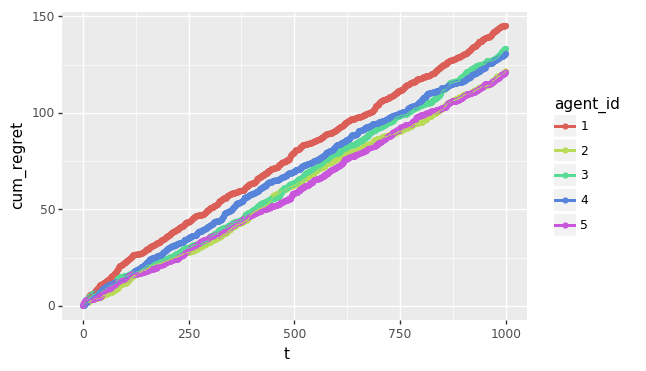

<ggplot: (8730389672821)>


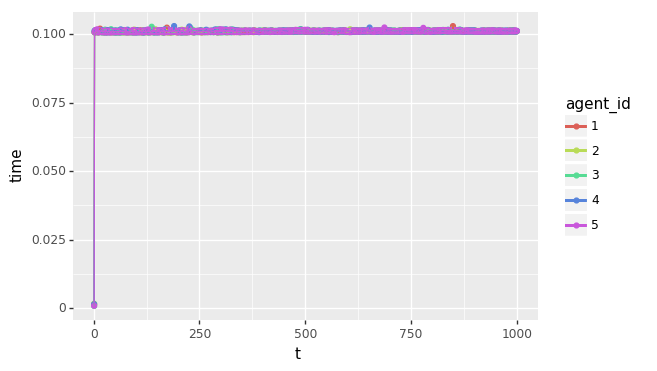

<ggplot: (8730389935849)>
theta [-0.41675785 -0.05626683 -2.1361961   1.64027081 -1.79343559 -0.84174737
  0.50288142 -1.24528809 -1.05795222 -0.90900761  0.55145404  2.29220801
  0.04153939 -1.11792545  0.53905832 -0.5961597  -0.0191305   1.17500122
 -0.74787095  0.00902525 -0.87810789]
Experiment: Step 0
 Sample: array([-1.85040397,  0.33048806, -0.31569321, -1.3500021 , -0.698171  ,
        0.2399512 , -0.55294944,  0.29952681,  0.5526637 , -0.84044301,
       -0.31227067,  2.14467809,  0.12110558, -0.84682875,  0.06046245,
       -1.33858888,  1.13274608,  0.37030484,  1.0858064 ,  0.9021794 ,
        0.39029645])
 Steps taken: 0
 Sample: array([ 0.97550941,  0.19157365, -0.66220901, -1.02351498, -0.44817482,
       -2.50545813,  1.82599446, -1.71406741, -0.07663956, -1.31756727,
       -2.02559359, -0.08224538, -0.30466658, -0.15972413,  0.54894656,
       -0.61837549,  0.37879447,  0.51325144, -0.33484413, -0.28351952,
        0.53842426])
 Steps taken: 0
 Sample: array([ 0.05725

 Sample: array([ 1.20327844,  1.08606706,  0.17368804, -1.44196118,  0.7594634 ,
        0.30974317,  0.01455717,  0.95958285, -0.22052898, -1.76613987,
        0.94528605, -1.11228011, -0.40634206, -0.8896377 ,  0.86067423,
        0.21865545, -0.95223574,  0.17249659, -1.15019209,  1.20740641,
       -1.76066097])
 Steps taken: 1312
Experiment: Step 5
 Sample: array([-1.63016501,  1.01942748,  1.02044232,  1.11758858, -1.31582822,
        1.59983666,  1.7371221 , -1.05940016,  0.73860472, -1.09830661,
        1.10546055, -1.31486386,  1.57084293, -1.50022648,  1.09459826,
        1.82100303, -2.64718272, -1.98457266,  1.30451215, -0.57925482,
       -0.81637162])
 Steps taken: 1315
 Sample: array([-1.88105796, -1.6567065 , -0.61390275,  1.84235356, -1.23728696,
       -0.40613433,  0.11125456, -0.32703624, -0.28947404,  0.7045743 ,
        2.39877102,  0.19969402,  0.07723637, -0.3957438 , -0.28236442,
       -2.25564474, -1.2952905 ,  0.04496508, -0.8511877 , -1.41377609,
        0.

 Sample: array([ 0.59183025,  0.2662749 , -0.63768561, -0.15734304, -0.88515085,
       -1.22927751,  0.30263204,  0.15841815, -1.02481442, -0.09169673,
       -0.25302098,  0.68147834, -0.17820895,  0.92400166, -0.51138809,
        0.6780771 , -1.3486072 , -0.42009088, -0.52922853, -1.63326633,
        0.05908662])
 Steps taken: 1266
 Sample: array([ 0.49685403, -2.09880474, -0.87794333,  1.21278734, -0.67185076,
        1.10794729,  0.81027793,  1.31435465, -0.71754701,  0.05125035,
        0.93964218,  1.71765613,  0.12681625,  0.32139389, -0.76323728,
       -0.18874313, -0.44468962, -0.56193671,  1.5590331 , -0.7569547 ,
       -0.36531228])
 Steps taken: 1266
 Sample: array([-0.30394193, -0.19114795,  0.85734977,  0.62218974, -0.285472  ,
       -2.05075306, -0.37499211, -1.26630053, -0.83831078, -1.2150101 ,
        2.32266259, -0.32766262,  0.11596376, -0.37269031, -0.23664008,
       -0.48340525, -0.15020434,  1.96332909,  0.7618794 , -0.41398374,
       -0.11400336])
 Steps t

 Sample: array([-1.79934789, -1.99476886,  0.90802194,  0.01685209, -0.15027621,
        0.70760686,  0.43121354,  0.3639907 , -1.35296684, -0.41114999,
        1.91586334,  1.43261385, -0.64387162, -1.50235131, -1.53222825,
       -1.02197426,  0.29864609, -0.11451338,  0.93444712,  1.44763386,
        1.59065745])
 Steps taken: 1224
 Sample: array([-1.26038804,  1.11022796,  0.06722577, -0.10164948, -0.96031944,
       -1.27079031, -1.14542278,  1.70764951,  0.4801174 , -1.30725308,
       -0.66116321,  0.33437502,  1.03434514, -1.39680079,  0.00412636,
        1.04517191, -0.8459194 ,  0.50624827,  1.66591451, -0.25310022,
       -1.28975686])
 Steps taken: 1230
 Sample: array([-1.25426268, -0.77424353, -0.85243174,  1.25294268,  0.28854387,
       -2.0176747 ,  0.87219918,  0.15186727, -1.49132303, -0.05207269,
        1.58461043,  0.03865266, -1.15448776,  0.62355596,  0.12665629,
       -0.82422094,  1.50882391,  0.11814961,  0.4805847 ,  0.34999577,
       -0.42967927])
 Steps t

 Sample: array([-1.25598464,  0.67392329, -1.06714489,  1.16977208, -2.34346093,
       -0.54018163, -0.84590936, -1.53969287, -3.16389882, -0.73938603,
        0.37492051, -1.19306368, -0.54810288, -0.81125083, -0.69709505,
       -0.88716945,  0.0982946 ,  0.75900331, -1.40572941, -0.90440114,
       -0.0643681 ])
 Steps taken: 1213
 Sample: array([-1.34482142, -1.31022545, -0.06570743,  1.00646775, -0.05799112,
       -0.83585832, -0.37465862,  0.19244883, -0.60832173,  0.46948058,
        0.47251603, -0.7583832 , -0.71396872, -0.10101303, -3.05450972,
       -1.61625789,  0.73342295,  0.28319771, -0.20847696, -0.2819318 ,
        1.23492012])
 Steps taken: 1216
 Sample: array([-0.27636326,  2.46009953, -0.55726758,  0.53904809, -2.74703993,
       -1.28276064, -0.17723794, -0.75829854,  1.39142525, -0.21038113,
       -1.30029732, -1.55676127,  0.81779669, -1.82715503,  0.68694594,
       -0.879029  , -0.49149306, -1.44794812,  0.51363174, -1.63785024,
        0.69141153])
 Steps t

 Sample: array([-0.27606665, -0.1154609 , -0.0417977 ,  1.36923281,  1.13014514,
       -0.95059902, -0.62887829, -1.40311878, -0.71170404, -1.47521352,
        0.97335584,  1.12122758, -0.24766351, -1.10045193, -0.98678111,
        2.7541076 ,  0.27845992, -0.82159929, -0.99667592,  1.33743388,
       -0.25181943])
 Steps taken: 1164
Experiment: Step 25
 Sample: array([-0.75570808, -0.10632267, -1.08768868, -0.54000205, -1.20265995,
       -0.21502343,  0.71546189,  0.57739215,  0.622348  ,  0.46773754,
        0.58474124,  2.2166943 ,  0.19293047, -1.70351837,  0.11437607,
        2.17340512, -1.03836859,  0.82876525, -0.62756004,  1.36724775,
       -0.81770322])
 Steps taken: 1156
 Sample: array([ 0.1930845 , -1.16736509, -0.38951642, -0.62076991, -0.25767857,
        0.51903173, -1.27231393,  0.39573699,  0.23050109, -0.68206153,
        0.63920716,  2.17680089, -0.98572234,  0.89848134, -0.20777338,
       -0.20735788,  1.9786421 ,  0.01993617, -0.8179265 , -0.00605774,
       -0

 Sample: array([-0.82033293, -0.37575216, -1.16184595, -0.91960709,  1.85916606,
       -0.34536621,  1.99268355,  1.16347814,  0.90538793,  0.2616447 ,
        0.47285768, -0.47834515, -0.1513134 ,  0.37095562,  1.38644435,
        1.05857324, -0.20140731,  0.461429  ,  0.16747609,  0.18832904,
        0.92230121])
 Steps taken: 1128
 Sample: array([ 0.18283664,  0.43745517, -0.24250522,  0.96851255, -0.08515993,
        0.16931391, -0.80555246, -1.01718189, -0.25011139,  0.13113349,
        0.99113827, -0.23837732,  0.03184445, -1.84200624, -0.54074706,
        0.03995991, -1.22825098,  1.44814993,  0.43840933,  0.10604178,
       -1.0774907 ])
 Steps taken: 1139
Experiment: Step 30
 Sample: array([ 0.42219273,  1.16137059,  0.57207841, -0.72163761, -0.366554  ,
       -1.21347329, -0.86877364,  0.72190247, -1.0340268 ,  1.12474061,
        0.91579253,  1.08467403, -0.32118562, -0.18429753,  0.627658  ,
        0.54831395, -0.34133167,  0.60751319, -0.08221546, -1.44478161,
        0

 Sample: array([ 0.6031722 ,  0.94919377,  1.70002602,  0.58231477, -1.67502964,
        0.09673474, -0.33145625, -0.18958659, -0.82426918, -0.69809564,
        1.47063764, -0.28664216, -0.55145291, -0.34285477,  1.06265292,
       -0.377819  ,  1.01332908,  0.64484966,  1.00515044, -1.57136114,
       -0.39576458])
 Steps taken: 980
 Sample: array([ 0.30450938, -0.17098059,  0.60903533,  1.77334771,  1.00416624,
        0.54765428,  0.82005173, -0.14934114, -0.11019701, -1.3986943 ,
       -0.04080751, -0.1445478 ,  0.42828148,  0.47732293,  0.92336162,
        0.99789044,  0.58228422, -0.18410391, -1.31470893,  0.43514652,
       -0.21848056])
 Steps taken: 987
 Sample: array([-0.21435096, -0.84393514, -0.79388925,  0.1221222 , -0.39204062,
       -1.053855  , -0.47449203,  0.07945082,  0.43259373, -1.39493892,
       -0.19754276,  0.63552712, -1.35576522, -2.02817091, -0.18942155,
        0.32098047, -2.45532019,  0.79572464, -2.25172948,  0.69421596,
       -1.21421918])
 Steps tak

 Sample: array([ 0.01592758, -1.39488173, -1.69109512,  0.3878137 ,  0.60884061,
       -0.98452778, -0.71397188, -0.92790014,  0.1571095 , -0.53270006,
        0.99415906, -0.65312695, -1.18561425,  0.86582591, -0.57068006,
        0.31615084,  0.88750858,  0.1677833 , -1.08201483,  0.68943257,
        0.84724312])
 Steps taken: 984
 Sample: array([ 0.27414929,  0.42811469, -0.87462252, -0.53794296,  0.08416823,
       -1.33027619, -0.21979434,  0.34526079,  0.33077394,  0.01663956,
        1.30655881,  0.66949115,  0.36485462, -0.54261976,  0.53363779,
       -0.95626276, -0.29223089, -0.33883838,  0.34630589, -0.16861572,
       -0.40406581])
 Steps taken: 980
 Sample: array([ 0.20593055, -0.3079699 , -1.56071975,  0.4245363 ,  0.42982238,
       -1.04109852,  1.33728169, -0.48036292,  0.29239896, -1.4172456 ,
       -0.08374147,  1.08477907, -1.46541122,  0.84605664, -1.12213789,
        0.19836922, -0.5537597 , -0.47865078, -0.43944851, -0.34627032,
       -1.03029678])
 Steps tak

 Sample: array([-0.71180528, -0.25252734,  0.34423111,  0.92123162, -1.43607723,
       -0.98832355, -2.3446667 , -0.37190214, -1.78501028,  0.435575  ,
        1.59158347,  1.27562105,  0.8527249 , -1.24446214,  1.31782369,
       -0.04502098,  0.04349277,  0.44694704, -1.13372426, -0.14770186,
       -0.80590642])
 Steps taken: 944
 Sample: array([-1.29985548, -1.18536166, -2.46141466,  0.39182506, -0.43126322,
       -0.1379767 ,  1.14515594, -3.14984129, -1.58619324, -0.04678395,
        0.90855581,  1.92747756,  0.633124  ,  1.32429138, -0.61077176,
        0.41801562,  0.78698566,  1.04641639, -0.15200381,  3.13269619,
       -0.40796656])
 Steps taken: 952
 Sample: array([-0.74197965,  1.02761053, -0.41641463, -0.63401232, -0.67126737,
       -1.00111004, -0.04419737,  1.0017251 ,  0.39136788,  0.68529484,
        1.20171618,  0.73691719, -0.07748376, -0.210712  ,  1.84670244,
       -0.53838486,  1.06081908,  0.85507339,  0.89820901, -1.80484099,
       -0.76712896])
 Steps tak

 Sample: array([-0.76026634, -1.63641335, -0.66218344,  0.39584299, -0.47327914,
       -0.43487524, -0.35045624, -0.41730143,  0.02538688,  0.99397956,
        1.26812683, -0.59358956, -0.59266627, -0.17672782,  0.10241137,
       -0.87748078,  0.37106099, -0.72536128,  0.24298436,  0.74529188,
       -1.11059591])
 Steps taken: 982
 Sample: array([-0.10957157,  0.72587631, -0.30541652, -1.74839528, -0.87812789,
       -0.69254481, -1.27977273,  0.24379001,  1.03044636, -0.48518987,
        1.05737275,  1.15812373, -0.76162771, -0.26130768, -0.26357248,
       -1.39742082,  0.54360401,  1.17919126,  0.03449431, -0.996143  ,
       -2.22591747])
 Steps taken: 976
 Sample: array([-0.69655393, -0.07435038, -1.62916534, -0.19755832, -0.41716756,
        0.03054496, -0.90982544,  0.39107001, -0.09710801, -1.53653631,
        0.35518645,  1.82565352,  0.13047559, -1.25437447,  0.94636091,
        0.94255207, -0.88991722,  0.76328523, -1.64403027,  0.94862921,
       -0.59498154])
 Steps tak

 Sample: array([ 0.48604855, -3.11790907, -1.62712052,  0.40034028, -1.77067006,
       -0.54838744, -2.10978284,  0.02571151, -0.40256443, -0.08634905,
       -0.60236738,  1.74825908, -0.48138764,  0.37346944,  1.2433715 ,
        0.15476441, -1.45707423,  0.35789964, -1.58393853,  1.53964312,
       -0.29680519])
 Steps taken: 973
 Sample: array([-0.58354475, -1.7577942 , -0.45441245, -0.46077259, -0.41052948,
       -0.67346911, -1.07602213, -0.79395452, -0.88208424, -0.03930527,
        0.99070729, -0.21167486, -1.5790971 ,  0.18469705, -0.84308257,
       -0.11172761,  1.13287056,  2.14095215,  0.07094094,  1.02925591,
       -1.3301074 ])
 Steps taken: 981
 Sample: array([ 0.55698535, -0.63179872, -2.04683282, -0.59868499, -1.23473769,
       -1.36166604,  0.62838168, -1.99162296, -0.21651932,  0.41084985,
        0.48666438,  2.23630163, -0.3206552 , -0.33831601,  0.86293384,
        1.00407105,  0.39831814,  1.42650953, -0.42190937, -1.7878956 ,
       -1.02379788])
 Steps tak

 Sample: array([-0.40006169,  0.13245509, -0.49498138,  1.68175509,  1.36339554,
       -0.54229865, -0.29806596, -0.42955114,  0.10523674, -0.93768916,
        0.72893952,  1.81240175, -0.38340918, -0.53678529, -0.02574428,
        0.36183596,  0.50243708,  0.95055996, -0.97957411,  0.38676302,
       -0.77112224])
 Steps taken: 971
Experiment: Step 59
 Sample: array([-0.55767039, -0.77075999, -0.70615306,  1.41656687, -1.12413324,
       -1.73123797, -1.51594768, -0.7522906 ,  0.07413111,  0.47644915,
        1.38954477, -0.47096318, -1.26337226, -1.20515694,  0.10241776,
        0.68177149, -0.23908169,  0.94232682, -0.6975698 ,  0.34709113,
       -0.52746201])
 Steps taken: 942
 Sample: array([-1.26669491, -1.2607138 ,  0.70352236,  0.4703059 ,  0.60319679,
       -0.48865775,  0.51510965, -0.65359571, -1.3856806 , -0.84886611,
        1.83168989,  0.35670535,  1.032955  ,  1.02548021,  0.08185624,
       -0.16795357,  0.62268926,  0.39739945,  0.08650921,  0.42910051,
       -0.0

 Sample: array([-0.43447342, -1.16807056,  0.22622887, -0.11195541, -1.97592785,
       -1.07997928, -1.18440106, -0.34760073, -1.31706121, -0.87840729,
        0.99221269,  1.33216135,  0.87659406, -0.5157143 , -0.2536673 ,
       -1.19701509, -1.02098264,  0.01090474, -0.4789641 ,  0.32938317,
        0.55751916])
 Steps taken: 938
 Sample: array([-1.03792351e+00, -2.64215225e-01, -1.32737265e+00,  1.25291991e+00,
       -1.48139372e+00,  3.86742441e-01,  9.05484536e-05, -4.02927637e-01,
       -1.37915121e+00, -4.85440663e-01, -4.30642653e-01,  1.90212471e+00,
       -9.98243350e-01,  3.66708550e-01, -7.49912073e-02,  3.92830186e-01,
       -1.07493843e+00,  1.81287103e+00,  1.32603647e-01, -9.30839295e-01,
       -6.69286658e-01])
 Steps taken: 959
 Sample: array([ 0.03722432,  0.93883325, -0.96718394, -0.61045805, -1.19267062,
       -0.99427971, -0.775347  , -0.55801326,  0.74911151, -2.24234556,
        1.56233569,  1.10255544,  0.07984241, -0.21974463, -0.36553894,
        0.31

 Sample: array([-0.17844196,  0.49922117,  0.45855922,  0.05243878, -0.48180558,
        0.41508947, -0.5527057 , -0.90883698, -0.67834709, -1.34918328,
        2.19221073,  2.20973672, -0.10868222, -0.25246671, -0.34096917,
       -0.541724  ,  0.52496885,  2.99975351, -0.40333464, -0.31995963,
        0.23852113])
 Steps taken: 970
Experiment: Step 69
 Sample: array([-0.37915842,  0.13825012,  1.03456391,  0.66322744, -1.28710632,
       -0.11241773,  0.40035166,  0.14339889, -0.33845183, -1.04919796,
       -0.24900014,  2.08570874, -0.35386148, -0.5216155 ,  1.0154434 ,
        0.32199092, -1.3614649 ,  0.72993676,  0.83959531,  0.44276653,
       -0.11114527])
 Steps taken: 985
 Sample: array([-0.46905697,  0.28604123, -2.18591618,  0.70033977, -0.20579961,
        0.85766222, -0.64913037, -0.06647591,  0.5742165 ,  1.01553098,
        0.53762861,  0.74116015,  0.2601135 , -1.61871702,  0.15067564,
        0.18762362,  0.79953929,  0.02999096, -0.38984104,  0.81451848,
        0.4

 Sample: array([-0.43730907, -0.0662638 , -0.8217855 ,  0.49307729, -0.41581744,
       -1.3055948 ,  1.61006742,  0.37897778, -0.83617754,  0.05424427,
        0.95008002,  0.40203744, -0.38057266, -1.10124419,  1.19323635,
       -0.31266624, -0.59288465, -0.66303856, -1.93923471, -0.22100087,
        0.03980691])
 Steps taken: 976
 Sample: array([ 0.0546885 , -0.58483729, -0.69493455,  0.92942365, -0.79263568,
       -1.89765941, -1.38671597,  0.14277091,  0.38137236, -1.82724816,
       -1.18904142,  0.26675627,  0.32363851, -0.28983533,  0.94356023,
       -0.5949909 , -0.45023349,  0.72456659,  1.95466112, -1.05336979,
       -1.04154416])
 Steps taken: 974
 Sample: array([-0.40899525,  0.62371431, -0.74785897,  0.21063275, -1.87749764,
       -1.88330165, -0.42887552, -0.26666943, -0.39693765,  0.50851989,
       -0.5185431 , -0.63717458, -0.74755526, -0.42032698,  0.18306841,
        0.42875192,  0.3657195 , -1.74995424, -0.25579763, -0.34523945,
       -0.56907684])
 Steps tak

 Sample: array([ 0.62883439, -0.4469507 , -0.32058126,  1.1766936 , -1.51622278,
       -0.53908613, -0.82708063, -0.6224385 ,  0.79953697, -1.3946707 ,
        1.01084972,  1.58345263, -0.07827733, -0.23284493,  1.25764116,
       -1.03852643,  0.41403191, -1.36298909,  0.4260403 , -0.3921278 ,
       -0.64132541])
 Steps taken: 973
 Sample: array([ 0.53183287,  0.82259843, -1.78741417, -1.41222397, -0.10611525,
       -0.70014026,  1.84331557, -0.74918477,  0.52090321, -0.14585961,
       -0.04596013,  0.85800415, -0.79850255,  1.35529943, -0.20731003,
       -1.05547807, -0.90432381,  0.91205094,  0.82449327, -0.83275105,
       -1.07561508])
 Steps taken: 971
 Sample: array([-0.20075807,  0.58402384, -0.28439583,  0.93460109, -1.16023774,
       -0.69110097,  1.11412381,  0.97079787, -0.24285506, -1.81712532,
        1.69459681,  2.4762813 , -1.11316735, -1.5292502 , -1.63461079,
        0.26473687,  0.74214588,  0.9626923 ,  0.67824452,  0.29868137,
        0.11547767])
 Steps tak

 Sample: array([ 0.21035954,  1.22828507, -1.68641789,  0.66702908, -2.20483594,
       -0.48719654,  0.13795719, -0.70519515,  0.46452758,  0.97904598,
       -0.80210568,  0.29478755, -0.73052602,  0.13899889,  0.50790575,
       -0.42775649, -0.45834048,  1.15417405,  0.89998416, -1.6166453 ,
        0.0794598 ])
 Steps taken: 970
 Sample: array([ 0.09678894, -0.19904836, -2.17281613,  0.22737225,  1.23049797,
       -0.9748158 , -0.38532937,  0.12155916, -0.72012512,  0.28446793,
        0.68255661, -0.07602955,  0.49883548,  0.54892592,  0.14529048,
       -0.4307346 ,  0.35008683,  1.64083797, -0.48451774, -0.69300581,
       -0.54016295])
 Steps taken: 978
 Sample: array([ 0.71261746,  0.46048665, -2.03371697, -0.04603593,  0.43394636,
       -0.97291799, -0.30507789, -0.43215815, -0.47117038, -0.90778003,
       -0.18758555,  0.22747272,  0.39258185, -0.27319808,  0.26622313,
       -0.66417427, -0.84054042,  0.98646516, -0.66365564,  0.36106065,
       -0.76286606])
 Steps tak

 Sample: array([ 0.07191592,  0.53547253, -2.22861606,  1.5332969 , -0.07050957,
       -0.69794539,  1.16560668,  1.13312768, -0.05486033, -0.05236157,
       -1.08025409,  1.28361371, -0.13050499,  0.1418127 ,  0.87097332,
       -1.25538908,  0.45516163, -0.22643836, -1.11421656,  0.41480064,
       -0.61625899])
 Steps taken: 969
 Sample: array([ 0.55558722,  0.80842055, -0.61278155, -0.51713849, -0.60205975,
       -0.60128719, -0.58130003, -1.10969351,  0.41088817, -2.34274447,
       -0.15066912,  2.71348233, -0.31127381, -0.11504428,  0.77370765,
       -0.69344881, -0.2442657 ,  0.11851638, -1.37047824,  2.20548153,
       -0.96147073])
 Steps taken: 977
Experiment: Step 90
 Sample: array([ 0.37728397, -0.49638223, -0.61901722,  0.50871468, -1.42333621,
       -0.04149248, -0.66956665, -0.502353  , -1.58237803,  0.64237676,
        0.28257616,  1.19929801,  0.2382893 , -0.30384726,  0.27784057,
       -0.26004956, -0.58045647, -0.53015649, -0.21288346, -0.62289811,
       -0.8

 Sample: array([-0.07908799,  0.38273356, -0.28435629, -0.13829716, -1.60863322,
        0.37703441,  0.27986259,  0.30301034, -1.31424825,  0.55600243,
       -1.38306475,  1.4086148 , -0.79935949, -0.66371993,  0.88135814,
        0.06727769,  0.15485293,  0.42917301, -0.82709535,  0.57436902,
        0.90332805])
 Steps taken: 975
Experiment: Step 95
 Sample: array([ 0.51069796, -1.64005249,  0.51709782, -0.38331417, -0.97409553,
       -0.48952567, -0.73276657, -1.55325019, -0.98297865, -2.37759561,
       -0.81515426,  1.14074083,  0.66599708, -1.40927337,  0.26978542,
        0.33895888, -0.32771586,  0.86062913,  0.21943534,  0.87081242,
        0.39330464])
 Steps taken: 981
 Sample: array([-0.31469712, -0.69955774, -1.19644523,  0.24869154,  0.53653925,
       -0.6241493 ,  0.15703753, -1.55518595, -1.31148932, -0.17774894,
        0.16103587,  1.3295415 ,  0.37691522, -0.34950231,  0.8492631 ,
       -0.96311499, -1.07783389, -2.55543105, -1.07866221,  0.33217361,
        0.3

 Sample: array([ 0.16555943, -0.63960894, -1.25918097, -0.29456461, -0.5124948 ,
       -0.63270112,  1.35081504, -0.45826403,  1.89708529, -0.28452575,
       -0.02565201,  0.59843285,  1.35063073, -0.56833129,  1.34038949,
        0.87612407, -0.74096997, -0.65244071, -0.30596324, -0.0557697 ,
       -0.03491533])
 Steps taken: 959
 Sample: array([-0.30847316, -0.42578952, -0.08726099,  0.37120946, -1.06395329,
       -0.71422808, -0.36044993,  0.86356002, -0.04926927, -0.79399262,
        0.18890158,  1.40961603, -0.26414976, -1.43590808,  0.59868018,
        0.21658176, -0.42608446,  0.79890368, -0.61537836,  0.42870579,
       -0.54350224])
 Steps taken: 979
Experiment: Step 100
 Sample: array([-0.35787891, -0.92209128, -0.58019303, -0.11740065, -0.96096887,
       -0.50055622, -0.30574015,  0.01814226, -2.00539261, -1.25965407,
       -0.60510153,  0.35655009,  0.4742621 , -0.45872605, -0.01045448,
       -0.06693452, -0.46445003,  0.24476001, -0.67677944, -1.03621471,
       -0.

 Sample: array([ 0.28117659,  0.45217587, -0.68702479,  1.56220871,  0.27778347,
       -1.44662782, -0.99742522, -0.56712355, -0.18382807, -0.82619445,
        0.15225629,  2.1057771 , -0.76580658, -0.33890693,  0.57569112,
       -0.75575983,  1.18938073, -0.30808743, -0.78049737,  0.12828777,
       -1.45557114])
 Steps taken: 975
Experiment: Step 105
 Sample: array([ 0.40489102,  0.2425341 , -0.25064035, -0.51012188, -0.80047697,
        0.6614877 , -0.85232207, -0.36636352, -1.2373037 , -0.93707431,
        0.21710464,  0.98088662,  1.33038084, -0.68544364, -0.69069562,
       -1.06232122, -2.37829885, -0.06310229, -1.12885645,  0.01088312,
        0.0792295 ])
 Steps taken: 989
 Sample: array([ 0.23833902,  1.27679481,  0.70526452,  2.76485559, -1.61088357,
        0.76048903, -0.05486393,  0.50657922,  0.61482446, -0.43845048,
        0.26543664,  1.32552607,  1.85595422, -0.61040489, -0.63820501,
        0.90150811, -1.09618267,  0.19035661, -0.03411969, -0.16466443,
        0.

 Sample: array([-0.37056398,  0.5619598 , -1.17533497,  0.55112895, -1.35566763,
       -0.8065952 , -1.1371108 , -0.01234744, -2.14234438, -0.80596982,
       -0.51771067,  1.72893464,  0.08977334,  0.85899824,  1.15849029,
        0.15785078, -0.05278695, -1.87671295, -1.52546638,  0.23276213,
       -2.24178798])
 Steps taken: 966
 Sample: array([ 0.23371044,  0.44069839, -1.13775809, -0.45173438, -2.2754838 ,
       -0.66458715, -0.04489856, -0.15526252, -1.90582639, -1.05881733,
        1.48620728, -0.11902785, -0.45304754, -0.48348235,  0.7004252 ,
        0.62379475, -0.135855  ,  0.15052753,  0.35764912,  0.73154777,
       -0.6325852 ])
 Steps taken: 987
 Sample: array([-0.27677542,  0.1703554 , -0.84542813, -0.42778225, -1.15179601,
       -1.06938421, -1.28361204, -0.7597278 , -0.67135169, -0.78936331,
        0.46348469,  0.90346621,  0.79167052,  0.59412108,  1.54103942,
        0.50320991, -1.14779021,  0.87228401, -0.20942096, -1.00074591,
       -0.54142612])
 Steps tak

 Sample: array([ 0.45733819,  0.30857335, -0.53496689,  0.68449852, -0.49912775,
       -0.44576734,  0.72374454, -1.32698561, -0.63411731, -0.47767803,
       -0.17902318,  0.74873373, -1.07879319, -0.28733271, -0.03536094,
       -1.30977608,  0.42843604, -0.30502717, -0.49727316, -1.44224918,
       -0.1962861 ])
 Steps taken: 976
Experiment: Step 115
 Sample: array([ 0.41401702,  0.38321257, -0.04703512, -1.46507785, -2.58223607,
       -0.96050359,  0.63860736, -0.05127379, -0.40820825, -0.23715783,
        0.40919697, -0.69339584, -0.48986283,  1.7704704 , -0.11321486,
       -0.22006001,  0.05347871, -1.96797995, -0.69498466,  1.22796291,
       -0.90485974])
 Steps taken: 985
 Sample: array([ 0.48027058, -0.58748478, -0.11037249,  1.06432978, -0.40892029,
        0.15539306,  0.45329501,  0.14102866, -0.41243261, -1.16478019,
        0.11063301,  1.78092837,  0.95954633, -1.33501278,  0.168356  ,
       -1.64325196, -0.30201596, -0.47035312, -0.85533877,  0.61233397,
       -0.

 Sample: array([ 0.2018516 , -0.66661315, -0.45103452,  1.16573583, -0.24594692,
       -1.41532066,  0.36407582, -0.61482294,  0.84044473, -0.29974919,
        1.0240752 ,  0.87084774,  1.93163467,  0.4731372 , -0.22225233,
       -0.88655117,  0.69752465,  1.23643458,  0.15781213,  0.50215821,
        0.6986942 ])
 Steps taken: 958
 Sample: array([ 0.70015066,  0.31897339, -1.11227866,  2.07664451, -0.15192797,
        0.52371517, -0.84195309, -0.29527343,  0.93385489,  0.44176828,
       -0.20442813,  2.48657376,  1.35300474,  0.03623705, -1.46924997,
       -0.3549009 , -0.98827589,  1.68100266, -1.91084861, -0.20613406,
        0.26845801])
 Steps taken: 974
Experiment: Step 120
 Sample: array([-1.19362029, -0.06587387, -1.32414435,  0.97368584, -0.43852226,
       -0.74776606, -1.70656417,  1.12231963, -0.13549343, -2.43816497,
       -0.70037889,  0.46177982, -0.44661314,  0.41300691,  0.1993668 ,
        0.80447627,  0.59207523,  1.3018145 , -0.89446897, -0.86496671,
       -1.

 Sample: array([ 0.62991065,  0.81790375, -1.22472514,  0.09558514, -1.30689451,
       -0.70797869, -0.62610626, -0.18471755,  1.12145711, -1.45836902,
        0.06036333,  1.5767426 , -1.31646801, -0.21909279,  0.21891275,
       -0.40096994,  0.82930903, -0.75645849, -0.89402693,  1.09703219,
        0.72133344])
 Steps taken: 966
Experiment: Step 125
 Sample: array([ 0.36983159, -0.85846009, -1.77500478,  1.0121236 , -1.93405489,
        0.3423601 , -0.17340727,  0.08794942, -2.72567583, -1.40809056,
        0.49910377,  1.79390485, -0.95446873, -0.41773159,  0.82929193,
       -0.97614204,  0.08733616, -0.59672774, -0.56496393,  1.89189695,
       -0.51943758])
 Steps taken: 981
 Sample: array([ 0.29517534,  0.27331633, -2.11550774,  0.41825959,  0.91027303,
       -0.24657948,  1.18364582, -0.18615118, -0.49031516,  0.82733148,
       -0.03017407,  0.04912553, -1.69974034, -0.17864268, -0.52168124,
       -0.46189992, -0.79463644, -0.03565674, -0.01243052, -0.59236283,
       -0.

 Sample: array([-0.78392247, -0.52954855, -1.48886949,  0.82166306, -0.09514767,
       -0.12096842,  0.67057478,  0.15779835,  0.76004818,  0.43917398,
        1.16796484,  0.99860189,  0.88071999, -1.19192165,  0.62556667,
       -0.24193739, -0.2164538 , -0.93078762, -0.36603009, -0.25401209,
       -0.2851897 ])
 Steps taken: 963
 Sample: array([ 0.69522058, -0.8898591 ,  0.87566905,  0.65916066,  0.73880259,
        0.09788713,  1.23822724, -2.03062531, -0.04360781,  0.09603496,
       -0.69475649,  1.57118916,  1.52574448,  1.59376113,  0.23900568,
       -1.93696284,  1.10841967,  0.33144328, -1.32708562, -0.4481541 ,
       -0.1126725 ])
 Steps taken: 984
Experiment: Step 130
 Sample: array([ 0.88460254,  0.71148982, -0.85425995, -0.14509891, -1.45177976,
       -0.17757841, -0.71825145, -0.05441463, -0.52634247,  0.57941022,
        0.60734039,  1.26456672, -0.48366671, -0.68194204,  0.4552822 ,
       -0.47830554, -0.07536773,  0.73878901, -0.58947205, -0.19211992,
       -0.

 Sample: array([-0.82551742,  0.09298242, -0.98395152,  0.01729673, -0.27284051,
       -0.87816352, -0.30987578, -0.1155831 , -0.43596108, -1.57497668,
       -1.34689378,  2.39882344, -0.24117127,  0.67147728,  1.1763322 ,
       -1.19301333,  1.30856519, -0.46721342, -1.55604746,  0.1867538 ,
       -1.08760951])
 Steps taken: 979
Experiment: Step 135
 Sample: array([ 0.19559188, -0.41319296, -0.76574089,  0.65959221, -0.84254914,
       -2.06488981,  0.1072302 , -1.49400125, -0.46647966, -1.58233684,
        0.91788158, -0.84334594, -0.63289549,  1.4152218 , -0.09963917,
       -0.94762751,  1.0855456 , -0.1807344 , -1.70508448, -1.00449167,
       -0.90656044])
 Steps taken: 978
 Sample: array([ 0.26078249, -1.73055419, -0.78690334,  0.96465885, -1.87484646,
       -0.20881798,  0.94813065, -0.1262797 , -0.56595911, -0.32571875,
        1.79396103,  0.17512046, -0.12363033, -0.26104147, -0.10922576,
        0.17100565, -0.26611961, -0.93150594, -0.0574854 , -0.21302677,
       -0.

 Sample: array([-0.2169023 , -0.90316272,  0.17171028,  0.12710903, -1.44021645,
        0.00667706,  0.23941407, -0.35632746, -0.38442125, -1.66753747,
        1.94854824,  1.12335599,  0.17737221, -0.77940302, -1.25811657,
        1.19822641,  1.28391432,  0.17633634,  0.01305779,  0.11272539,
       -2.63325152])
 Steps taken: 976
 Sample: array([ 0.91454205,  0.73119449, -0.46651624, -0.17262263, -0.20304038,
       -0.60457619,  0.01777316,  0.08836601,  0.66825739, -1.04705111,
        1.17609981,  0.94560162, -0.04497293, -0.85943523,  0.20251228,
       -0.58169572,  0.06813171,  0.96446131,  0.83661931, -0.14087549,
       -0.27686169])
 Steps taken: 978
Experiment: Step 140
 Sample: array([-0.09991127, -1.22199047,  0.07259718,  2.31710152,  0.21823005,
       -1.0494876 , -0.92018172, -0.91679156,  0.02032075, -1.09622628,
        1.2657641 ,  1.09417886, -0.74052329, -0.03504473, -0.35856086,
        0.14705638,  0.9407882 ,  0.8416828 , -0.3898108 , -0.75047139,
       -1.

 Sample: array([-0.10548677, -0.10455323, -0.0794519 ,  0.34143956, -1.61619159,
        0.58213444,  0.21443397, -0.04281315,  1.60593045, -0.45204735,
       -0.32408172, -0.0275711 ,  1.34964199,  0.23265348,  0.8406664 ,
       -0.85872375,  0.61945049,  0.75557556,  0.90446343, -1.2133665 ,
       -0.58428161])
 Steps taken: 957
 Sample: array([ 0.027273  , -0.71464937, -1.11450575, -0.11987096, -0.07090902,
       -0.97030494, -0.50413775,  1.03891718,  1.31010737,  0.01081407,
       -0.03338132,  0.95956077,  0.85664988, -1.62034532, -0.69248886,
        0.25660322,  0.66177461,  1.21981228, -1.82147383,  1.10974724,
       -0.45220242])
 Steps taken: 982
 Sample: array([-0.64830423,  0.88664706, -1.30956186,  0.87806503,  0.53671365,
        0.03375097, -0.3340051 ,  0.8962293 ,  0.13782691, -1.46547387,
       -0.83736321,  3.58980284, -2.89310169,  0.48734462,  1.15106691,
        0.47989537, -0.10910384,  0.3828313 , -0.93121399, -0.47898819,
       -0.94840648])
 Steps tak

 Sample: array([-0.1708956 , -0.75958784, -1.91473664,  2.11761208, -0.80346782,
        0.33180009,  0.51376077, -0.16072149, -0.36295614, -0.58473325,
        0.502286  , -0.90932191, -0.43206963,  0.87665345,  0.8301899 ,
        1.39836722,  0.02097611,  0.70807495, -1.57851396,  0.43177167,
       -0.22157482])
 Steps taken: 970
 Sample: array([-0.23151372,  0.71006194, -0.89146086,  1.50904274, -0.6196373 ,
        0.65641496,  0.01964991, -0.88593896, -0.13372436, -0.06773159,
       -0.60732692, -0.44496521, -0.46318567, -0.30361587, -0.22944466,
       -0.89229641,  0.1788819 , -0.39128056, -1.48797824,  0.91964863,
       -1.26487342])
 Steps taken: 981
Experiment: Step 150
 Sample: array([ 0.69540742, -1.18014913, -0.78694334,  0.9489536 , -0.92868035,
        0.33724544,  0.07184753, -0.65554205, -0.5799101 ,  0.34664675,
       -1.23146601, -0.2635372 ,  1.04582728, -1.7375428 ,  0.52504894,
       -1.86147645, -1.34093949, -1.35216538,  0.72500408, -0.18448658,
        0.

 Sample: array([-0.3726155 , -0.52759975, -1.30207432,  2.38495703, -0.27169492,
        1.07588961,  0.02655155,  0.00723349,  0.05479595, -0.2959005 ,
       -1.39286794,  2.21705904, -0.99963439, -0.43294769,  0.82256511,
       -1.20830537, -0.80084816,  0.10975111, -1.8403241 , -1.22055533,
       -0.28313022])
 Steps taken: 979
Experiment: Step 155
 Sample: array([ 0.07234722, -0.84515662, -1.30053138,  1.32353475, -0.9603272 ,
        1.10106782,  0.01673889, -0.50197967, -0.87003319,  0.91944343,
       -1.02966956, -0.04839979, -0.29058799, -0.58899955,  1.18727076,
       -1.18836234, -0.27873039,  0.14931773, -0.86548138, -0.06000247,
       -1.64942711])
 Steps taken: 979
 Sample: array([-0.10312071, -0.06562143, -0.84767675,  1.21014854, -0.71086363,
        0.41525079,  0.91476878, -0.35791943,  0.2349906 ,  1.08328996,
        1.23538222,  1.20917854, -1.13409355, -1.13505266,  0.06071767,
        0.3966913 , -0.85486748,  0.14759329,  0.34803569, -0.8407946 ,
       -0.

 Sample: array([ 0.16503022, -0.46182673, -1.13092905,  0.67932301, -3.0370265 ,
       -1.06380542, -0.55855064,  0.27661939,  0.38057556, -0.04583055,
        0.2964065 ,  1.45270277, -0.72081561, -1.55310606, -1.00372485,
        0.03002084, -0.65505008, -0.39349212,  0.15901104,  0.19373487,
       -1.71781859])
 Steps taken: 956
 Sample: array([ 0.09888447, -0.24775187, -0.80623407,  1.2899174 , -0.55704115,
       -1.37206539, -0.12538179, -0.72799163, -0.2098975 , -1.96094106,
        0.29740525, -0.67417232,  0.5962301 , -0.03715366, -1.06741911,
       -0.14693343, -0.01982708, -0.18107457, -0.36919496, -1.69680605,
        0.31439007])
 Steps taken: 971
 Sample: array([ 0.01708759, -0.61741355, -0.98116496, -0.40654954, -1.20518907,
        0.29925821, -0.2963717 , -2.19322896, -1.14509745, -0.13028652,
        0.06581811,  0.35366552, -0.79756565, -0.62918645,  0.96299352,
        0.37895841, -0.80395384,  1.0105272 , -0.83644283,  0.80498543,
       -0.41198209])
 Steps tak

 Sample: array([ 0.30997917, -0.54669187, -0.61655975,  1.21456881, -0.54691666,
        0.26855738, -1.10674666, -1.80454492, -1.34620534, -1.04146941,
        0.49190008,  0.08249998,  0.42857628, -0.70769643, -0.13440988,
       -0.64567884,  0.99296128, -0.18256849,  0.75868774, -0.13320667,
       -1.72675442])
 Steps taken: 970
 Sample: array([ 0.3078385 , -0.62859799, -1.37325629,  1.28519357, -1.01209601,
       -0.79349566, -0.48575145,  0.09171058, -1.04118793,  0.78882139,
       -0.60752195, -0.90591849, -0.69079236, -0.11397753,  0.02757755,
       -0.38935414, -0.12826812, -1.29961885, -1.20156744,  0.44698731,
       -0.87721093])
 Steps taken: 981
 Sample: array([-0.17615261, -1.64243154, -1.07510987,  0.6624976 , -0.63242929,
       -0.98446871, -0.31248647, -0.2563106 , -1.30922424, -0.97267967,
       -0.33938011, -0.7655753 ,  0.70705981, -1.59171818, -0.71065882,
        0.69079566, -0.6850216 ,  0.41995637,  0.25103882, -0.01081754,
       -1.27810974])
 Steps tak

 Sample: array([-0.11200489, -0.7887569 , -0.75899922, -0.16864805, -1.94205044,
        0.88675849,  0.03567048, -1.21321241, -1.35724594, -0.73901872,
        0.65612259, -1.51412101, -0.1941704 ,  0.4637773 , -0.22884114,
       -0.29484812, -0.4861759 ,  1.09579813, -1.88893349, -1.01403776,
       -0.77178331])
 Steps taken: 971
 Sample: array([-0.08525907, -0.40512947, -0.46319672,  0.57992507,  0.04397711,
       -0.13037274, -1.15017654,  0.74468457,  0.69521048, -1.24329489,
        0.84741001,  0.96606873, -0.37144075, -0.10790393, -0.66175191,
       -0.55524723, -0.3567278 ,  1.08955826,  0.44094508, -0.93992352,
        0.31301118])
 Steps taken: 958
 Sample: array([ 0.6529007 , -0.12224505, -2.53144934,  0.60434985, -0.6698872 ,
       -0.41508681, -0.23916994,  1.14473673, -1.8415169 , -0.57019404,
        0.26446892,  1.09400814, -1.80684323, -0.82816837, -0.07730037,
       -0.06280984,  0.211148  ,  0.78808829, -0.87315502, -0.70977101,
       -0.32094056])
 Steps tak

 Sample: array([ 1.17821022, -0.47110197, -1.11806528,  1.9272582 , -1.8664305 ,
       -0.15455299, -0.17800694,  0.6375046 ,  1.71201998,  0.00574132,
       -0.52466003, -0.21365664, -0.64165927, -2.3272727 , -1.49521047,
        1.01712201, -0.57874258, -0.32647227, -0.72885554,  0.55834282,
       -0.73779592])
 Steps taken: 970
Experiment: Step 175
 Sample: array([ 0.77624947, -1.06243218, -0.39932644, -0.23359856, -1.60821273,
       -0.10462934, -1.08131042,  0.22505079,  1.02301061, -1.01771292,
       -0.20771699,  1.52578489,  0.73662524, -0.55201597, -0.7770416 ,
       -0.31031716, -0.49501395,  1.90987201, -1.94623915,  1.46360394,
       -1.02517747])
 Steps taken: 979
 Sample: array([ 0.07545798, -0.61419256, -0.48121955,  1.15231968, -0.55261304,
        0.43310763, -0.66396951,  0.26987018, -1.00181589, -1.12347841,
       -0.22791497,  1.04196927, -0.84317622,  0.97969797, -0.23719625,
        0.74104005, -0.50483744,  0.6739114 , -0.95281943, -1.05049425,
        0.

 Sample: array([-4.78876803e-01,  9.09167040e-01, -1.91264227e+00,  3.15256319e-02,
       -7.40840129e-01, -3.82283038e-01,  4.33898379e-01, -5.33290783e-01,
       -7.45160867e-01, -1.90127374e-01, -2.25719296e-01,  1.04929325e+00,
        5.93113462e-01, -1.80293265e-03,  3.16478048e-01, -5.68868826e-01,
       -2.46301184e+00,  3.84176425e-01, -1.89396462e+00,  7.20809926e-01,
       -7.54093120e-01])
 Steps taken: 961
 Sample: array([-0.11685953, -1.00851742,  0.11589457,  1.13988688,  0.77733916,
        0.24267394, -0.36802139, -0.09397088,  0.05252322, -0.37809808,
       -0.0976896 ,  0.01584345, -1.14916281, -0.87428208,  1.10847472,
       -0.58011836,  1.00746197,  0.04436302, -0.8168564 ,  0.16343299,
        0.44529537])
 Steps taken: 978
Experiment: Step 180
 Sample: array([-0.11821132, -0.23758332, -0.51826642, -0.20361598, -0.64174554,
        0.47063873, -0.80005485,  0.09639828,  0.77839091,  0.13133852,
       -0.51253692,  1.78738807,  0.18638628, -1.38592671, -0.3

 Sample: array([-0.56409179, -1.23610091, -0.04392506,  0.94886921, -2.31234519,
       -0.0877589 ,  1.80126058, -0.67679636,  1.49303237,  0.14647832,
        1.54891336,  0.85043877, -1.00754122, -2.09509384,  0.37942088,
       -0.59822297, -0.64728658, -1.24491019, -0.14089698,  0.45323026,
        0.40499442])
 Steps taken: 965
 Sample: array([ 0.19532239, -2.06876941, -0.07997216,  0.06779247, -1.04699638,
       -0.35778535, -0.02042734, -0.10011844,  0.08031544,  0.10381522,
        1.0601772 ,  0.45836069,  0.64326119,  0.08067468,  0.99510254,
       -0.3859553 ,  0.03929862,  1.42795057,  0.55706146, -1.57272067,
       -1.04588945])
 Steps taken: 964
 Sample: array([ 0.25751339,  0.94526249,  0.15116171, -1.51468209, -0.92530154,
       -0.89494111, -0.34399766,  0.67181601, -0.15066607,  0.85287313,
       -0.09897707,  0.68972801,  0.39663206, -1.1167582 , -0.47432651,
       -0.18321445,  0.99071185, -0.20351143, -1.3411441 ,  0.0426289 ,
       -0.65321076])
 Steps tak

 Sample: array([-0.11370354,  0.28868537, -0.92450918, -1.7274957 , -1.2821094 ,
        1.39112584, -0.66996071, -0.76855796, -0.189048  , -0.90408786,
        0.60321512,  1.00463844, -1.01068086,  0.11643221, -0.28109634,
        0.49432613, -0.75071232,  0.34700756,  1.03567025,  0.95892036,
       -0.96870688])
 Steps taken: 961
 Sample: array([ 0.5108709 , -1.28741218,  0.31270861, -0.33356356, -1.18138899,
       -1.24589945,  0.06609951, -0.07025316,  1.63776877, -1.31831649,
       -0.56143885,  1.86070358, -0.99970132, -0.87220289,  0.6873128 ,
        0.24096541, -0.53110568, -0.85914648, -0.75106295,  0.60799634,
       -0.89955593])
 Steps taken: 973
Experiment: Step 190
 Sample: array([ 0.53621432, -0.69759448, -0.11088179,  0.26906436, -0.04762533,
       -1.81699593,  1.17928669,  0.64830205,  0.44195601, -0.6965735 ,
        0.22989293,  1.75416798,  0.09715034, -0.54745287, -0.38989367,
       -1.38575657, -1.20925757, -0.98055458,  1.88984336, -1.22758561,
        0.

 Sample: array([ 0.12367951, -0.43017236, -2.16814843, -0.66376951, -0.9196785 ,
       -1.78800486, -1.28106168, -0.21941057, -0.5971633 , -0.58595742,
        1.7442599 ,  1.10808186, -0.19910148, -1.00087577, -1.55583911,
       -0.68996709,  0.34923064,  1.2392524 ,  0.9599892 , -0.50229753,
       -0.01415694])
 Steps taken: 966
 Sample: array([ 0.05602445,  0.39100832, -1.37119537,  1.50926492,  0.31217193,
        0.49724625,  0.83568872,  0.0998391 , -0.3036877 , -0.82497135,
        1.34662402,  0.7373792 ,  0.56023113, -0.45270133,  0.94643262,
       -0.50154355,  0.2740528 ,  1.96233754, -0.08841262,  1.42048973,
       -0.5528548 ])
 Steps taken: 975
 Sample: array([-0.57166926,  0.99160939, -1.00084429,  1.16524473, -1.57533259,
       -0.92585394, -1.04502876, -0.1628222 , -0.3724106 ,  0.62982194,
        0.0990497 ,  0.94071127, -0.64141599, -0.66969853,  0.73481295,
       -1.04249208,  0.03523186,  0.03415251, -1.84233063, -1.85777084,
       -1.01404314])
 Steps tak

 Sample: array([ 0.19813188, -0.21161632, -0.87842849,  1.69777894, -0.07874566,
        0.51543514, -0.03978847, -0.16553352, -0.3570936 , -1.60983049,
        1.08257958,  0.66944882,  0.68819537, -0.02276544, -1.78226321,
        0.26627941,  0.47752638,  1.36623202, -1.94426403, -2.01812849,
       -1.02581808])
 Steps taken: 927
 Sample: array([-0.35075655, -0.83464493, -2.57485992,  0.85451643,  0.17025407,
       -0.43840656, -0.22818182, -0.48417818, -0.25011996, -0.70448268,
        1.52422585, -0.48358025, -0.53995163, -0.81392825, -0.20997244,
        0.04621918, -1.132529  ,  0.58450275,  1.42128416, -1.45061157,
       -1.81153384])
 Steps taken: 973
 Sample: array([ 0.36059019,  0.9366432 , -0.46601901,  0.67737677, -0.41677132,
        1.36281378,  0.88465101,  0.46894237, -1.59383951, -1.67649551,
       -0.45358379, -0.13637507,  0.01741855,  0.7827069 , -1.83395079,
        0.58220339,  1.23188298,  1.57222319,  0.33195735, -2.00476671,
       -1.52647781])
 Steps tak

 Sample: array([ 1.07444396,  0.34887966, -0.62028147,  0.0439212 , -0.29709257,
       -0.05822869,  0.80753016, -0.73617529,  0.133702  ,  0.58007805,
       -0.52366944,  1.39990653,  1.1772995 ,  0.34725355,  1.79187532,
       -1.45138211, -1.05577769, -1.14319251, -0.99104906, -0.92279059,
        0.44997491])
 Steps taken: 966
 Sample: array([ 0.01286202,  0.28150329,  0.45584432,  1.72438649, -1.11371256,
       -0.66520395, -1.32782501, -0.00585386, -1.11834581, -0.07316856,
        1.80613049,  1.98727583, -1.47593706, -1.00030318, -0.30670653,
       -0.12023848, -0.01116686, -0.03921574,  0.82484159, -0.72699021,
       -0.15610676])
 Steps taken: 976
 Sample: array([-5.44029189e-01, -1.34635830e-01, -2.23972390e+00,  1.66486214e+00,
       -1.49689265e+00, -1.65483347e+00, -5.37431218e-01,  1.92623307e-03,
       -7.08331259e-02, -6.82804043e-01, -3.71454096e-01, -4.22197795e-01,
        3.60892559e-01, -1.27071902e-01,  1.77726557e+00, -3.00267985e-01,
       -1.57697790e

 Sample: array([ 0.52786664, -0.28995747,  1.24505486,  0.8105844 , -1.92963655,
        0.45543961,  0.54507255, -0.93582015, -1.25932944, -1.12094781,
       -0.07657811, -0.18755269,  0.68211253, -0.16979967,  0.18718109,
       -0.86998355,  0.55163726,  1.06166719,  0.74319002,  0.85732438,
       -0.61504059])
 Steps taken: 967
Experiment: Step 209
 Sample: array([ 0.34308635, -0.25210334, -0.67644383, -0.34070156, -1.2365889 ,
       -0.74819839, -0.8764099 , -0.30362023,  0.17188626, -0.75584422,
       -0.02390518,  0.52535994, -0.37757956, -1.34018047, -0.08650086,
       -0.46291291, -0.25535309,  1.45431086, -0.50912519,  0.10466803,
       -0.24030149])
 Steps taken: 977
 Sample: array([-0.02644135,  0.28021734, -1.97281886, -0.18482732, -1.59516972,
        0.05575806,  0.46864315,  0.39408037, -0.3728154 , -0.61518947,
        0.32894206,  1.26396618,  1.09619495, -1.98604318,  0.6478722 ,
       -0.05244083, -0.39535774,  0.06323735, -0.09145061, -1.2433534 ,
       -0.

 Sample: array([ 0.32630146,  0.23110037, -1.92831091, -0.25767759, -1.12106415,
       -0.95859553,  0.29154738, -0.61682523,  0.07547775,  0.61157954,
        0.26991023,  0.30453661, -0.95061781, -0.75904509,  0.84645952,
        0.45521129, -0.14185452, -0.46260539, -0.31544867, -0.3731474 ,
        0.5897435 ])
 Steps taken: 960
 Sample: array([ 0.31783278,  0.83077203, -0.48514959,  0.63078637, -1.31574097,
       -0.55920582, -0.84813752, -1.26902758, -1.38740381,  0.79344524,
       -2.05026886, -0.48608179, -0.56329986, -0.54945386, -0.66675938,
        0.0362361 ,  0.52645204, -0.07182599, -0.23553584,  0.20270247,
        0.67801721])
 Steps taken: 969
Experiment: Step 214
 Sample: array([ 0.60905308, -0.50483463,  0.38010985,  3.01616502, -2.09719084,
        0.38639267,  0.98264877, -0.82659348,  0.93140487, -0.62653894,
       -0.07441793,  0.69565462, -0.54258763,  0.01509178, -0.09885905,
        0.58753563,  0.63514456,  0.83474819, -0.78531656,  1.00669173,
        0.

 Sample: array([ 0.03509003, -0.19085394, -0.37106744,  0.09997362, -0.64526636,
       -1.6652418 ,  0.60601069, -0.50176183,  0.39927936, -1.10663462,
        1.27541073,  1.58441739,  0.45065045,  0.51073834, -0.95746533,
        0.30814832, -0.50544041,  0.09084735,  0.34379368, -0.33963455,
       -0.5800416 ])
 Steps taken: 969
Experiment: Step 219
 Sample: array([ 0.14350179, -0.98312465, -1.05169885, -0.29775614, -1.00108719,
        0.18744742, -0.9609792 ,  0.65836649, -0.62513255, -0.37171055,
        0.09364118, -0.14340446, -0.78614725, -0.81220808, -0.64239503,
       -0.40282964,  0.054627  , -0.77401001, -0.21451064,  0.83743481,
        0.16285995])
 Steps taken: 972
 Sample: array([ 0.1354882 , -0.61050496, -1.17272284,  0.40028074, -0.05283298,
       -0.39608332,  0.05972536, -1.24000127,  0.98067482,  0.47427188,
        0.70695886,  1.32807876, -0.33344387, -0.44636229, -0.25255871,
       -0.5218323 ,  0.80704714,  1.17612474, -1.97824275, -0.51019421,
        0.

 Sample: array([ 0.04072195,  0.16020575, -1.12542804, -0.17437082, -1.96116698,
        1.05529603, -0.36812958, -0.74555391, -1.48265339, -0.95711512,
       -0.31772832,  1.1057859 , -0.00920833,  0.44119339,  0.0543382 ,
        0.60684733, -0.44645986,  0.54899756, -1.32484342, -0.58391372,
       -0.90156945])
 Steps taken: 939
 Sample: array([ 0.06842834, -0.46834362, -0.06476496,  1.72568655, -0.26030118,
        0.31754056,  0.27956263,  0.22755408,  0.13290353,  0.47872978,
        0.35839584,  1.08866295, -0.5144081 , -0.19391791, -0.0341999 ,
       -0.82278663,  0.01220723, -0.66685296, -1.11335733,  0.06297538,
       -1.22521273])
 Steps taken: 981
 Sample: array([-0.25216584, -0.04655243, -1.52489043,  0.42411693, -1.31726174,
       -0.34489786,  0.52930135, -0.0516147 , -0.56772515, -1.3928527 ,
       -0.00426566,  1.21800089,  0.29910113,  0.34588085,  0.33316924,
        0.07634332,  0.73180891,  1.29732888, -0.02563976,  0.37291122,
       -0.5337207 ])
 Steps tak

 Sample: array([-0.22548529,  0.61384643,  0.83408395,  2.26546348, -0.1955219 ,
        0.37397448, -0.04460229, -0.13263014, -0.92904492, -0.22194323,
       -0.43313337,  0.86322778, -0.69931615, -1.17988272, -0.50087527,
       -0.88646075,  1.03952616,  0.62362605, -0.94960573, -0.45241112,
       -0.14785533])
 Steps taken: 939
 Sample: array([-0.15980303,  0.05175286,  0.16436785, -1.01069966, -0.18539921,
        0.09742918, -0.92573776, -0.61647253,  0.27855717,  0.10683092,
        0.52116468, -0.29044513, -0.33425364, -0.56026808, -0.25294601,
       -1.96337453,  0.02688811, -0.03498757,  0.71800853,  0.77349775,
       -0.45201863])
 Steps taken: 974
 Sample: array([-0.37380903,  0.10555572, -0.96389773,  0.70188544,  0.09066206,
        0.12981302,  1.66351891, -0.62791956, -0.32121719, -0.36786882,
       -0.44080071, -0.46498979,  0.53062604, -0.23639099,  0.52999984,
        0.77857327,  0.97756634, -0.63598539, -1.82437286, -0.78073606,
       -0.94407659])
 Steps tak

 Sample: array([ 0.19919665,  0.07234511, -0.41253774,  1.27830096, -1.59860692,
        0.72794215,  0.61293675, -1.17075131, -1.11250628, -0.62417814,
       -0.91804801,  0.9940307 ,  0.52481433,  0.2254819 , -0.28059562,
       -0.85012056, -0.44137543,  0.14976843, -0.7125471 , -0.60195619,
       -0.01857507])
 Steps taken: 958
 Sample: array([-0.05057204,  0.27206509, -0.52506331,  2.50572125, -0.94882864,
       -0.49281911, -0.49604941,  0.92825513,  0.55830597,  1.24809964,
        0.24083337,  1.04563326,  0.43207355,  0.34728389,  0.21105795,
       -0.64544578, -0.33648306,  0.23104086,  0.06228429, -0.82226061,
       -0.24639461])
 Steps taken: 978
 Sample: array([ 0.27179319,  1.9002311 , -2.48316513, -0.05913971,  0.11447517,
       -0.0576118 ,  0.89174384,  0.7983016 , -0.24725964, -0.72280836,
        0.41029584,  0.79445893, -0.85218233, -0.33505486, -0.00337161,
        1.41551912,  1.16634592,  0.4201278 , -0.64882557,  0.17904256,
       -0.04708473])
 Steps tak

 Sample: array([-0.7271005 ,  0.3413647 , -1.12264527,  0.96758426, -0.95735978,
       -1.64915523, -0.37234107, -0.27806133, -0.63188601, -1.14899016,
        0.11880693,  1.40913151,  0.3967501 , -1.23167367,  0.26010535,
       -1.22862711,  0.34725373, -0.96209962, -0.35330567,  1.09825981,
       -0.62012903])
 Steps taken: 963
Experiment: Step 239
 Sample: array([-0.03400581,  1.8197192 , -0.73872387,  0.07354198, -1.27536177,
       -0.37822524, -0.77297981,  0.16969904, -0.4493383 , -1.47670186,
       -0.21133526,  0.57401326, -1.01475495, -0.30647446,  0.31704745,
        1.4849638 , -0.16320671, -0.11187903,  0.48560024,  1.06564632,
        0.46199313])
 Steps taken: 979
 Sample: array([-0.22914649,  0.29919364, -1.67165509,  0.87411326, -1.30755824,
        0.44758396, -0.42924622,  0.24043226, -0.16963562,  2.02933985,
       -1.07801308,  0.60964131, -0.25737448,  0.05357807, -1.58476117,
       -2.07437779,  0.98601762,  0.57264173, -0.93731572,  1.0198978 ,
        0.

 Sample: array([-0.43022133, -1.9416139 , -1.04681703,  1.09100603, -0.86477469,
       -0.55945515,  0.72828185, -0.07404479, -2.32100836, -1.18561189,
       -0.15326687,  0.93956793, -0.50182807,  0.35158738, -0.32051418,
       -1.45180414, -0.86205788,  1.28032926, -1.43282426,  0.02766394,
       -1.84773016])
 Steps taken: 864
 Sample: array([-1.28655638e-01,  1.72110084e+00, -2.00770573e+00, -9.19258180e-01,
       -1.65387926e+00, -1.10781240e+00, -1.02919419e+00, -9.15659392e-01,
        2.86500652e-01, -1.28873705e+00, -1.54382600e+00,  2.26507271e+00,
        1.43953998e+00,  1.32690795e-03,  9.75796455e-02,  2.06787394e-01,
        3.36318988e-01,  4.30863444e-01,  1.06988593e+00, -7.50042763e-01,
        8.73758087e-03])
 Steps taken: 867
Experiment: Step 244
 Sample: array([-0.04226867,  0.6382382 ,  0.24279963,  0.22486803, -1.48976651,
        0.65964028, -0.38290889,  1.17430449, -1.497043  , -1.84163181,
        0.51370737, -0.2643136 , -2.15752376, -0.33206836,  0.5

 Sample: array([ 0.36903915, -1.03672707, -0.91035119,  0.23898236, -1.72325489,
        0.56441442,  0.84715729, -1.73291014,  0.43517943,  0.20506475,
        0.83281393,  1.34363311, -0.56123835,  0.54866871,  0.83458335,
       -2.07806409,  1.61253526,  1.23502452,  1.03300142, -0.71136029,
       -0.14058842])
 Steps taken: 967
 Sample: array([-0.20657231, -0.1506434 , -1.21001422,  1.248608  , -0.29868516,
        0.2389149 , -0.38524465, -0.29231141,  0.96248037, -0.07867856,
        0.73014013,  1.5966688 ,  0.33173007,  0.27436715, -0.08958256,
       -1.18326213, -0.92661554,  1.08864037, -0.86038294, -0.21897739,
        1.4678053 ])
 Steps taken: 971
 Sample: array([ 0.40244274, -0.76535842, -0.29646551,  0.65291774, -0.47681216,
        0.24912832,  1.66532463, -1.17204345, -0.49946198, -1.18330483,
        0.13291057,  0.55724285,  1.10894356, -0.27688662,  1.23808738,
       -1.54266133,  1.99609487,  0.57426888, -0.85504134,  0.79753995,
       -1.26543801])
 Steps tak

 Sample: array([ 0.22007133, -0.64084454, -2.00386381,  0.14186494,  0.52744283,
        0.57380073,  0.74726916, -0.2510688 , -0.84471172, -0.75520228,
        0.33532871,  0.22611672, -0.3305774 ,  0.00893131, -0.1328991 ,
       -0.32125842,  0.17283843, -0.24380334, -0.13528025, -0.65448098,
        0.10311098])
 Steps taken: 962
 Sample: array([ 0.33264417,  0.51596582, -0.92304384,  0.46509136, -0.46291404,
       -0.45110945,  0.15784899, -0.91016394, -1.09109358, -0.57862632,
        0.15905089,  0.25170763, -0.28273619, -1.15440519,  1.01157108,
       -0.62644977,  0.05299805,  1.93581196,  0.14879418, -0.27308335,
       -0.70527653])
 Steps taken: 963
Experiment: Step 254
 Sample: array([ 0.84648367,  0.5869618 , -1.51995971,  1.09391805, -2.33419113,
        0.23990374,  0.86912862, -0.003394  , -0.28044686, -1.27417313,
        0.48113706,  0.87148704,  1.2589068 , -0.3748641 ,  1.07749684,
       -0.66625277, -0.87918014,  0.07135484,  1.54486961, -0.62306191,
       -0.

 Sample: array([ 0.46543678,  0.4089207 , -0.72388173, -0.35556972, -2.572457  ,
       -0.59650204, -1.03685902,  0.67893727,  0.20822179, -1.67755224,
       -1.01343554,  0.62290582, -0.61544349,  1.18419715,  0.40193903,
       -0.29963611, -1.34685788, -0.3624367 , -1.67206182, -0.60092963,
       -0.38356905])
 Steps taken: 967
Experiment: Step 259
 Sample: array([ 0.16910989, -0.20751131, -0.71578927, -1.13881805, -0.4781798 ,
       -1.27665047, -0.01291536, -0.77705077, -0.70465827, -0.9999608 ,
        0.45197477, -0.17221365, -0.42698652, -0.53840663,  0.1314522 ,
       -0.76446033, -0.49511542, -0.1402165 ,  0.40698567,  0.21072091,
       -2.35441538])
 Steps taken: 970
 Sample: array([ 0.19683813, -0.29403496, -0.53419136,  1.20537712,  0.0550727 ,
       -0.17735277,  0.3358992 , -2.16132039,  0.35637305,  0.70947027,
        0.07117428,  0.12252715,  0.21460914, -1.43534089,  0.80162102,
        0.02912355, -0.40676048, -0.21001391,  0.04862795,  0.38800497,
        0.

 Sample: array([ 0.45980627, -0.61844177, -1.37557088, -0.13597947, -1.46432438,
        0.0425343 ,  1.53466422, -0.17173952,  1.36593391, -1.30608218,
       -0.48721617,  0.895295  , -0.80686139, -1.34257447,  0.61607481,
        0.70339541, -0.23883977, -0.05015181, -1.23339821,  0.1776397 ,
       -0.16367037])
 Steps taken: 934
 Sample: array([ 0.55040142, -1.00700986, -1.39671032, -0.30048177, -0.14970821,
        0.3017231 , -0.82150142,  1.31955819,  0.56833368,  0.13427995,
       -0.70126123,  0.57573567,  0.33407057,  0.27681541,  0.26685465,
        1.0696658 , -0.94399102,  0.9426975 , -0.46584127, -0.52398662,
        0.17793772])
 Steps taken: 973
 Sample: array([-0.42511244, -0.93463843, -1.51448542,  0.63439365, -2.26812953,
       -1.10553554,  0.07936116, -0.9588822 ,  1.52407207,  0.87044003,
        0.27702472,  0.52197394,  0.85983955, -0.36431096,  1.05533854,
       -0.34780434, -0.6237161 ,  0.93712585,  0.3872448 ,  0.22928002,
        0.21429152])
 Steps tak

 Sample: array([ 0.42192468,  0.13380257, -1.52911898,  0.68813053, -0.86560095,
        0.10829341,  0.7414309 , -0.47521479,  0.39800028,  0.22150428,
        0.59986136, -0.14031952,  0.62147673,  0.7336674 ,  1.0604765 ,
        0.0421058 ,  0.70141984,  0.41605049,  0.02322712, -0.0234967 ,
       -0.22532938])
 Steps taken: 960
 Sample: array([-0.00326743,  0.03304558, -0.89728525, -0.13045251, -0.78574805,
        0.6321678 ,  0.32039182,  0.78375753, -0.37056366, -0.83392235,
        0.27687565,  1.82983   ,  1.25275178, -0.85687043, -0.23651444,
       -0.56052915, -0.94747691, -1.23263693, -0.05188876, -0.34924925,
       -0.19059823])
 Steps taken: 970
 Sample: array([-0.37651578,  0.00564129, -1.53667641,  0.14048899, -1.17800568,
       -0.29362092, -0.57836319,  0.14744481, -1.94766288, -1.35307121,
       -0.53558757,  1.82860231, -1.96155968, -0.37588583,  0.61861093,
       -0.75177098, -0.67435869, -0.6314402 ,  1.00131586,  0.21450124,
       -0.34883729])
 Steps tak

 Sample: array([ 0.51608024, -0.88186031,  0.40082951, -0.3210046 , -0.52574766,
       -0.86226579,  0.86152894, -0.04871424,  0.06503882, -1.25773227,
       -0.94281168,  0.82701878, -1.80547457, -0.92509617, -0.4192604 ,
       -0.26247546,  0.55188587,  0.94947518,  1.59095089, -1.45933049,
        0.0914535 ])
 Steps taken: 960
 Sample: array([ 0.52638021,  0.01076001, -1.12925163,  0.47550267, -0.92198431,
        0.35182   , -0.5143167 , -0.30507817, -0.09661528, -1.39827934,
        0.61394372,  1.13362205, -1.16512756, -0.87092108,  1.24288981,
       -0.90559859, -0.09140385, -0.25965107,  0.06948137,  1.04648322,
       -0.05070279])
 Steps taken: 963
 Sample: array([ 0.49897828, -0.77481036, -2.37218422,  0.84556486, -1.3654715 ,
        0.5154336 ,  0.36487539,  0.86121227, -0.52760555,  0.29588303,
       -0.49782389, -0.64465451,  0.91648853, -1.12751079,  0.46124911,
       -1.4180114 ,  1.76906409,  0.09629442,  0.78442323, -0.00989577,
       -1.81045934])
 Steps tak

 Sample: array([-0.09457563,  1.874185  , -0.08834199,  0.42546281, -0.67020154,
       -0.31592006,  0.36298656, -1.7291958 , -0.93713073,  0.21431298,
        0.63319456,  0.74529551,  0.71709969, -1.13508757,  0.56353281,
       -0.11274922, -0.0618867 ,  0.93744975,  0.09212228,  0.34688896,
        0.30256864])
 Steps taken: 934
Experiment: Step 279
 Sample: array([-0.36453665, -0.74845233, -1.05550523, -0.73724757, -1.90970711,
       -0.41952083,  0.4971305 ,  0.85662918, -0.10213901, -2.17309194,
        0.15131709,  1.0281711 , -0.1292756 , -1.82262436, -0.17542501,
        0.48586044,  0.29399792,  0.44631628,  0.90794496, -0.7469555 ,
       -0.93833488])
 Steps taken: 935
 Sample: array([ 0.01563359,  0.07719603, -2.63780669,  1.66836172, -0.98019531,
       -0.66509889,  2.48412825, -1.1965504 ,  1.07409087, -1.5665057 ,
        1.74198224,  0.73665776, -1.99034618, -0.47037661,  0.63793077,
       -0.26922323, -0.27077919,  0.83336965, -0.23607627, -0.9614486 ,
       -0.

 Sample: array([ 0.24571767,  0.24998186, -0.43072754,  1.10357954, -0.91894022,
        1.08700248,  0.32779496,  0.42053834, -1.4210857 , -0.83020975,
        1.11075337,  0.15000484,  0.78272675, -0.80287709,  0.84221353,
       -1.98558675, -0.14435144,  0.85572168, -0.77452611,  0.43072619,
       -0.25294925])
 Steps taken: 910
 Sample: array([-0.18645738,  0.91866406, -1.37135662, -0.24217897, -1.0022602 ,
       -1.58875314,  1.00184564, -0.64054855, -1.42184351, -0.65088645,
        1.19862317,  1.05315623, -0.15896898, -0.53398561, -0.21312302,
       -0.38022466, -0.3997502 , -0.23011379,  0.11945821,  0.41806635,
       -0.48023116])
 Steps taken: 940
Experiment: Step 284
 Sample: array([-0.27164177, -0.49055666, -1.85288068,  1.01515082, -2.32248946,
        0.56448774, -0.50211801, -0.16536198, -0.04674538, -1.76623448,
        0.15463821, -0.35667379,  0.02149847,  0.03585036, -0.1463465 ,
       -1.03782363,  0.79249511,  1.25908698, -0.44181606, -0.02193574,
       -1.

 Sample: array([ 0.12998143,  1.11136966, -0.6036762 ,  1.28740382,  0.11240687,
       -0.4660681 ,  1.05321759,  0.31022774, -0.42941227, -1.0021191 ,
       -1.80353846,  1.49446798, -0.11504916, -2.07412937,  0.16625362,
        0.38308008, -0.71683299, -0.49800776, -0.71946754,  1.45278612,
       -1.08875189])
 Steps taken: 926
Experiment: Step 289
 Sample: array([-0.7489536 , -0.42692227, -0.32825045,  1.20061714, -2.28362579,
       -1.42287302,  1.25205158,  0.28449789, -0.07933907, -0.19318054,
        1.07450513,  2.4051563 , -0.82984211,  0.68126993,  1.4815695 ,
       -0.86853672, -1.02929899, -0.38764351,  0.57570572, -1.02366314,
       -0.269033  ])
 Steps taken: 932
 Sample: array([-0.4266108 , -1.12478407, -1.52196198,  2.09192017, -0.45432584,
       -0.93708116, -0.58489277,  0.43084516, -1.35294862, -0.36652777,
        0.73104663,  0.0225348 , -0.88355418,  0.46567076,  1.5402053 ,
       -1.62591421, -0.09133322, -0.54729078, -0.13477396, -0.07461452,
        0.

 Sample: array([-0.44981694, -1.83592625, -1.38492032, -0.73655784,  0.65367175,
       -0.35813161,  1.4027101 , -0.43284169,  0.09192546, -1.00041997,
        1.39381169,  0.30573482, -1.4412182 , -0.65607877, -0.10099236,
        1.67503502,  0.5450456 ,  0.02937574,  0.62322079,  1.85323386,
        0.19430387])
 Steps taken: 924
 Sample: array([ 0.61524313, -0.83293751, -1.09846261, -0.31304629, -2.09760202,
        0.15662476, -0.89126073, -0.77224554, -0.60679877,  0.84638798,
        0.58397526,  0.18866404,  0.78035934, -1.11739956, -0.87144977,
       -0.84864745,  0.06700777, -0.44705073,  0.22936141,  0.01439486,
        0.3596519 ])
 Steps taken: 925
Experiment: Step 294
 Sample: array([ 0.039064  , -0.48206795,  0.05334934,  1.49056794, -1.0602617 ,
        0.1878426 ,  0.43366926, -1.13354904, -0.95353347,  1.15642318,
        1.45726478,  0.09409434, -0.86254079, -0.52161677,  0.60169758,
       -0.20795617,  0.79554043, -0.48849543, -0.94477415, -0.4798013 ,
       -0.

 Sample: array([-0.13899857, -1.00767628,  0.11821787,  0.34363673,  0.00976427,
       -0.85306667, -0.67193147, -1.7872999 ,  0.91972316,  0.08442583,
       -0.15860073,  0.09600416, -0.50209172, -0.21328552,  0.19258814,
        0.0897587 ,  0.36542834,  0.23415652, -0.12007483, -0.12954424,
        0.46336442])
 Steps taken: 906
 Sample: array([ 0.2774993 , -0.30916164, -1.36550262,  1.21567659,  1.29995291,
        1.09347398,  0.65286443,  1.69785309, -0.01075864, -1.4866313 ,
        0.8000993 ,  0.26002186, -0.70409283, -0.15163942, -0.21995036,
        0.9718718 , -1.3071574 ,  0.94160785, -1.68126279,  1.27770424,
       -0.77194407])
 Steps taken: 909
 Sample: array([ 0.80860365, -1.19182496, -0.54751439,  0.96274266, -1.7974188 ,
       -0.67477492,  0.52932413, -0.66051376,  0.69712612,  0.64491042,
       -0.71629354,  1.1191237 ,  1.04350883, -0.55427533,  0.7014538 ,
        0.63227901, -0.0084736 ,  0.42689243, -0.54804578,  0.2383719 ,
       -1.13455587])
 Steps tak

 Sample: array([-0.07087048, -0.76503133, -0.50859232,  1.88927364,  0.18217821,
       -0.365334  ,  0.58769547,  0.80347614,  0.24936906,  0.14952029,
        0.98101345,  1.43394612,  1.16970454,  1.2568418 , -0.72083868,
        1.24497819,  0.99626298,  0.9516053 , -1.83221094,  0.96842115,
       -0.89412743])
 Steps taken: 923
 Sample: array([ 0.85976987,  0.41686571,  0.80930749,  1.69674496, -0.63186096,
       -0.52054377, -0.54659388, -0.84361202, -0.64886455,  0.49254388,
       -0.98003604,  0.74345792, -2.04636074, -0.98629594,  0.6961996 ,
       -0.5444529 , -0.20457061, -0.15527593, -0.80571619, -0.16814683,
        1.62072455])
 Steps taken: 932
Experiment: Step 304
 Sample: array([-0.20312028, -0.41393186, -0.49443266,  0.90161987, -2.15021863,
       -0.18694336,  1.4285031 ,  0.55186912,  0.36148917, -0.15396668,
       -0.72164856,  0.3178847 , -0.9234296 , -0.87640733,  1.45131225,
        0.11388407, -0.47313943, -0.16833823, -1.02727579, -0.69284983,
        1.

 Sample: array([ 0.58281582, -0.77861954, -0.56174232,  0.22599638, -1.58756804,
       -0.68667892,  1.53837308, -1.13707338, -0.52567057, -1.05392525,
        0.30780435,  0.090589  ,  0.16533372, -0.72214835, -0.48450772,
       -0.81571667,  0.07739298, -1.08246032, -0.39778325, -0.94989262,
       -0.94911523])
 Steps taken: 910
Experiment: Step 309
 Sample: array([-1.15556678,  1.49796081, -2.66889038,  1.30386701, -0.36931278,
       -0.65251486,  0.70826746, -0.65171401, -0.52187139, -1.37957296,
       -0.44780449,  1.61331947, -0.01992519, -0.90771244,  1.44027913,
        0.57821536,  0.87905305, -0.38945579, -0.96606363,  0.47674914,
       -0.58353109])
 Steps taken: 931
 Sample: array([ 0.56199563,  0.69227269, -0.04538721,  1.438325  ,  0.27507547,
       -0.22770271, -0.56185775,  0.14920924, -0.40929797, -1.56143521,
       -0.43537724,  1.21940105,  0.18285271, -0.3137757 , -0.0421652 ,
       -0.10932131, -0.44658203,  0.41050337, -0.91234137,  0.23728428,
        0.

 Sample: array([ 0.94508039, -0.62180057, -0.2721086 ,  0.23700134,  0.45886174,
       -0.196271  ,  0.71939324, -0.37492787, -1.36919429, -0.37565948,
        0.83407207, -0.09446802,  1.76571741, -0.46150013, -0.38671584,
        0.1756807 , -1.82539123,  0.58221991, -0.216547  ,  1.40506837,
       -0.36630899])
 Steps taken: 926
 Sample: array([ 0.06767678, -2.60644471, -0.85320411, -0.09429242, -1.3418179 ,
       -1.20408349, -0.60345038, -0.77754954, -1.70460226, -0.95820431,
       -0.1405521 , -0.36186099, -0.1098334 , -0.03812921, -1.16365693,
       -1.48719176,  0.65069578, -0.02462347, -1.57775471,  0.46281099,
       -0.26841344])
 Steps taken: 932
Experiment: Step 314
 Sample: array([ 0.19955033,  1.90683902, -1.31836809,  0.10149197, -0.04818796,
       -0.57034683, -0.10358766, -0.79194502, -0.95662959, -0.55812146,
       -0.74771493,  0.27637898,  0.83512945, -0.6005312 ,  0.69620467,
       -0.30863056, -0.03524375, -1.14591792, -1.87074364,  1.18511685,
       -0.

 Sample: array([ 1.11209549,  0.24043275, -0.95328383, -0.24128919, -1.05142962,
       -0.47935564,  0.50612587, -0.09001661, -0.55416726, -1.03744345,
        0.77407391,  0.47377026,  0.20237227, -2.73408134, -1.74028362,
       -1.05174977,  0.19574809, -0.11392684, -0.80600616,  0.1886791 ,
        1.04189858])
 Steps taken: 918
Experiment: Step 319
 Sample: array([ 5.65701567e-01, -4.86112658e-01, -7.22920782e-01, -2.39018078e-01,
       -1.55662684e+00, -1.70902961e+00, -8.00259959e-02,  3.32049575e-01,
       -4.99859820e-04, -5.19308816e-01, -3.05188124e-01,  4.88166148e-01,
       -1.34314399e+00,  1.79949364e+00,  8.46737494e-01,  1.18457470e-01,
       -1.02522404e-02,  5.11158189e-02,  1.24027158e-01,  9.52455086e-01,
       -1.13420041e+00])
 Steps taken: 927
 Sample: array([ 0.00456385,  1.94745525, -0.98872259,  0.25894441, -2.57267442,
       -1.97841035, -0.02655273, -0.21064439, -0.46506353, -0.49798263,
        0.98132407, -0.22197095, -0.67771334,  0.85065704,  1.4

 Sample: array([ 0.34785185, -1.01533146, -2.63487045,  1.1710492 , -0.88815556,
       -0.63700452, -0.40460108, -1.14145486, -0.06414413,  0.47453619,
        0.89575225,  0.95533009,  0.28771908, -0.89833083,  0.79249906,
       -0.99017434, -0.12651453, -0.4491581 ,  0.17792451, -2.72421516,
        0.42985985])
 Steps taken: 917
 Sample: array([ 0.51164587,  0.50240755,  0.37980686, -0.13819579, -1.67381486,
       -0.74351307, -0.99956585, -0.79896178, -1.01394386,  1.29329879,
        1.39885906,  1.90987957,  0.72690886, -0.25398115,  0.24311739,
        0.71703613,  0.70955965,  0.17766252, -1.18502244, -0.30377465,
       -0.05563148])
 Steps taken: 925
Experiment: Step 324
 Sample: array([-0.71698228, -0.8615799 , -0.06473356,  2.09867707, -0.95911973,
       -0.4969248 ,  0.52472159, -0.18275325, -0.31314776,  0.60579871,
       -0.15974323,  1.408432  , -1.85356234, -0.54162945, -0.13419137,
       -0.84061409,  0.4962088 , -1.08112209, -0.12414684, -0.12756202,
       -1.

 Sample: array([-0.2133001 ,  1.27032205, -0.72341243, -0.65932313, -1.44161863,
       -0.7132744 ,  0.1078977 , -0.88050568, -0.0824849 , -0.35904933,
        1.57301264,  2.3897151 ,  0.27679059, -1.02627484, -0.74885385,
       -0.6018924 ,  0.02000783, -0.32223691, -0.57551196,  0.66739167,
       -0.32064262])
 Steps taken: 905
 Sample: array([ 0.91225316, -0.86312008, -0.63843319, -0.97340668, -0.72241086,
        0.06607074,  0.38418491,  0.00549815, -0.56752978,  0.24706409,
       -0.38759254, -0.63795006, -2.73271438, -0.31883274, -0.26260372,
       -0.66377906,  1.55941794, -0.89153756, -1.06050411,  0.10936729,
        0.1349594 ])
 Steps taken: 918
 Sample: array([ 0.19910972,  0.31504019, -1.67092699,  0.61634279, -0.08431715,
       -0.79155816, -0.66231132, -0.8127703 , -0.83852436, -1.0367959 ,
        0.12224425,  0.85058168,  0.87425699, -0.18422158,  0.89614001,
       -1.45212629, -1.09119617,  1.11279915, -1.61074385, -0.39555443,
        0.36652445])
 Steps tak

 Sample: array([ 0.15709222,  0.32940326, -0.36491736, -0.09430941, -0.7287723 ,
        0.56749858,  0.93555266, -1.89651776, -0.12650226, -0.93414389,
        1.22307572,  1.01899553, -0.53285374,  0.80320493,  0.69951346,
       -0.20196871, -0.69332016, -1.02869233,  0.29997123,  0.27206307,
        0.16830491])
 Steps taken: 916
 Sample: array([ 1.05061942, -0.56019604, -1.16914821,  1.32391421, -0.20582509,
       -0.86904189,  0.88838878, -0.65770762,  1.13897037, -0.40345839,
       -0.22710289, -0.48886705,  0.06575032, -1.38051223, -0.76641228,
        0.35586349,  0.09846184,  0.78566012, -0.72810931,  0.53224902,
        0.87487913])
 Steps taken: 903
Experiment: Step 334
 Sample: array([ 6.11504817e-01,  4.41382752e-01, -1.47350189e+00,  1.80096806e-01,
       -6.66508832e-01, -5.19013542e-01, -3.08446927e-01,  9.64635907e-01,
        1.17738079e-01,  8.06763953e-01,  2.59704511e-01, -5.96295264e-01,
        2.70554345e-01, -2.75467879e-04,  3.40229149e-01,  4.87165948e-01

 Sample: array([-0.15052004,  0.22128844, -0.39279152, -0.89106354, -0.63265711,
        0.12750455, -0.80417199, -0.40562453, -0.30617713, -0.90422012,
       -0.2208762 ,  1.1526387 , -0.9409635 , -0.49891479,  0.18902543,
       -1.3809445 , -0.18438378,  1.44570962, -0.56100997, -0.56484192,
       -0.0820468 ])
 Steps taken: 913
 Sample: array([ 0.32871486, -1.51260238, -0.45014742,  0.49796602, -0.37654385,
       -2.11046258,  1.15363548, -0.85536371,  1.06198598, -0.10926187,
        0.04847517, -0.12270482,  1.99527617, -0.49701604, -0.99741058,
       -0.27319896, -1.13647782, -0.17899209, -0.49605001, -0.21221849,
       -0.21097404])
 Steps taken: 913
 Sample: array([ 3.49248449e-02,  2.68102979e-01, -1.18579326e+00,  8.30777321e-01,
       -8.50383064e-01, -8.45903715e-01, -3.63568704e-01, -1.96737883e+00,
       -6.15474805e-01,  1.08607613e-01,  1.12789530e+00, -1.44348703e-03,
       -3.69994932e-01, -6.91131384e-01, -2.00987573e-01,  3.10784044e-01,
       -3.75817389e

 Sample: array([ 0.70116177,  0.27712001, -1.39498831,  0.40838861, -1.08427442,
       -0.63047908, -0.00567857,  0.41579878,  0.19561483, -0.94190677,
       -0.17704225,  1.008307  , -1.82180713,  0.04795058, -0.89909717,
       -0.2340045 , -0.71215329, -0.06643028,  0.3478333 , -0.66341981,
       -0.11895648])
 Steps taken: 918
 Sample: array([ 0.03963416,  0.10570024, -0.32112729, -0.01360532, -1.49703137,
       -1.37663456, -0.74796207, -0.45331617, -0.35559553,  0.26375331,
        1.1374275 ,  1.11058027,  0.15351765, -0.35867693, -0.35808832,
        0.42009241, -0.84705746,  0.35980502, -0.56447007,  0.81348216,
       -0.15864447])
 Steps taken: 912
 Sample: array([ 0.1426567 , -0.04670589, -2.07273078, -0.12490364, -0.33108626,
        0.24024612,  0.6866875 , -1.24817478,  0.52182898, -1.16649729,
        1.94748102,  0.75598126, -0.27739553, -0.55365348, -0.20738446,
        0.30411657,  0.19436058,  0.90819023, -0.44999626, -0.7591303 ,
       -0.45283736])
 Steps tak

 Sample: array([ 0.80563254,  0.08581319, -1.97219668,  0.98730068, -1.21613436,
       -0.34721481, -0.24628205,  1.2473461 , -1.35515807, -1.04636346,
        0.1724645 ,  0.77227918,  0.56962948, -1.22369317,  1.98606393,
        0.20852144, -0.05096354,  0.27957587, -0.31090563, -0.5397186 ,
       -1.31401596])
 Steps taken: 908
 Sample: array([ 0.28742096,  0.09967834, -0.3314128 ,  0.09940528, -0.9652938 ,
        1.30022744,  0.47696214, -0.23994299,  0.11401096, -0.09750753,
       -0.20172925,  0.2799098 ,  0.31986717, -0.58811172,  0.23658362,
       -0.66848172,  0.81691936,  0.67277768,  0.92097939, -0.27290621,
       -1.07328411])
 Steps taken: 918
 Sample: array([ 0.52384868, -0.08036078, -0.72388966, -1.83402249, -1.12590832,
        0.32294159, -1.61658802, -1.44388545, -1.71016238,  1.86290234,
        1.32394101,  0.98543891,  0.02358553, -1.76777591,  1.00415201,
       -0.7300399 , -0.24318937,  1.10837187, -0.24266155, -0.60814843,
       -1.0043838 ])
 Steps tak

 Sample: array([ 4.52425819e-02,  5.67508649e-01, -1.36555021e+00,  2.39916890e-01,
       -9.32621358e-01, -5.05964251e-01,  8.44683414e-01, -1.67984226e-01,
        7.99449880e-01, -1.12517137e+00,  1.99251309e+00,  2.19240330e+00,
       -1.87247202e-01, -1.07289302e-01, -8.16873134e-01, -1.07065170e+00,
        3.00854329e-01, -1.85297040e-01,  1.82029796e-03, -3.03081827e-01,
       -7.09092687e-01])
 Steps taken: 902
 Sample: array([ 0.11355284,  1.72990251, -1.42812477,  0.52045457, -0.13838001,
       -0.4513695 ,  0.9470952 ,  0.70033053, -0.58308345, -0.29286617,
       -0.81599674, -0.07170923, -0.38672907,  0.19282265,  0.05718929,
        0.61928225, -0.5957698 ,  1.5671144 , -0.14613128,  0.06199881,
       -0.04919281])
 Steps taken: 909
 Sample: array([ 0.09671355, -0.90926615, -1.15847829,  0.29389312,  0.0439472 ,
       -1.97521795,  1.5143779 ,  0.73466886, -0.71253045, -1.70316382,
        0.79056991,  1.27467643, -0.49402539, -0.46356857,  0.15775137,
       -0.82

 Sample: array([ 0.03713796, -0.31954314, -2.4681099 ,  0.11696111,  0.35230837,
       -0.12992572,  0.67264144,  0.35362898, -1.59453403, -0.69704167,
        0.29924161,  0.73833997, -0.88732972, -0.47057048, -0.52773727,
        1.23031299,  0.7730597 , -1.08005521, -1.17493665, -0.5767426 ,
       -1.0026462 ])
 Steps taken: 897
 Sample: array([ 0.28773405, -0.24955997, -0.78780618,  0.20148977, -0.93337154,
        0.84036823, -0.8510739 , -0.62951616,  0.4390636 , -0.50556316,
       -0.5517971 ,  2.09315023, -1.80128205, -0.09331949, -0.00578909,
       -0.30787643,  1.08039553,  0.27640523,  0.79841458,  0.58040139,
        0.95976426])
 Steps taken: 919
 Sample: array([-0.31939848,  0.2632507 , -1.6285648 , -0.56345956, -1.9886028 ,
        0.31475307,  0.63623318,  0.0078295 ,  0.19773714, -1.06577864,
        0.50116674,  1.68646008, -0.69462897, -0.79364904, -0.22026196,
       -0.24361418, -0.60822953, -0.81822202, -1.30553985, -1.23043686,
       -0.22000975])
 Steps tak

 Sample: array([ 0.61559353,  0.37289438,  0.19076774,  1.3206103 , -1.42447478,
       -0.65577181,  0.43961106,  0.13484806, -1.30101268, -1.79836297,
       -0.01870263,  2.06356004,  0.8931538 ,  0.23316463, -0.65903427,
        0.11653344,  0.01226894,  0.63975404,  0.30250363,  0.3638753 ,
       -0.96669573])
 Steps taken: 906
 Sample: array([-0.44545058,  0.30438851, -0.87962461,  1.04351904, -0.4761475 ,
       -0.46068089,  0.3670746 , -0.16752054, -0.99564366, -1.66334349,
        1.35569717,  1.4670595 ,  0.38073903, -0.74869345, -0.49183096,
        0.13795307,  0.20913243, -0.04546725, -0.60428675,  0.8666073 ,
       -0.61523697])
 Steps taken: 915
 Sample: array([ 0.52417073, -1.30704175,  1.69793477, -0.01526484,  0.42293971,
       -1.09006627, -1.01389717, -0.58834533,  1.3794467 , -1.75910515,
        0.36504363,  1.62590854,  0.47990086, -0.73994863,  0.69863821,
        0.78820859,  0.44533563,  0.42480116, -0.34875744, -0.97289138,
       -0.34023846])
 Steps tak

 Sample: array([ 0.6461359 ,  0.17794311,  1.08844096,  0.12075822, -1.14758481,
        0.47098684,  0.85808206, -1.64953803,  0.18188364, -0.94274712,
        1.74128356,  1.28486399,  0.37090563, -1.10313891, -0.64193288,
        0.770685  ,  0.07340643, -0.91956885,  2.314495  , -0.16654596,
        0.45840541])
 Steps taken: 912
 Sample: array([ 0.49517176, -0.52342565,  0.32341343,  0.68468653, -0.24377163,
       -1.15026773,  1.51183426,  0.69819349, -1.12297093, -0.47028514,
        1.1781599 ,  1.10196163, -0.07027179, -1.88865855,  0.48917736,
        0.59640241, -0.42947203,  0.40764854,  0.01747779, -0.80647162,
        1.376237  ])
 Steps taken: 921
 Sample: array([ 0.08909312,  1.27209799, -1.21348485,  0.26272887, -0.16897646,
       -0.42521947, -0.89664835,  0.68419201,  0.02249232,  0.30117788,
       -0.66619019, -0.17746359,  0.517036  , -0.6424784 , -0.21941033,
       -2.41103472,  0.60832701,  0.92535382, -0.19545303, -0.58476284,
       -0.73105744])
 Steps tak

 Sample: array([ 0.27362614,  0.39550437, -1.44576685, -0.31693719, -1.31984351,
        0.37685068, -0.66294996, -0.40499335, -1.0297517 ,  0.19162048,
        0.20866627, -0.23531983, -1.16158818,  0.67353775, -0.4555643 ,
       -0.59657953,  0.53560338,  0.21250987, -0.30279234, -0.35936819,
        1.25352544])
 Steps taken: 874
 Sample: array([ 0.2871667 ,  0.7795502 , -2.68987821,  0.78520187, -1.18194299,
        1.18525668, -0.96250195, -0.61348777, -1.4022369 ,  0.86935255,
        0.45551052,  1.11808935,  0.41460567,  0.72278822,  1.00721391,
        0.59164505,  1.0310011 ,  1.43028067, -1.55203801,  0.30117206,
       -0.34140564])
 Steps taken: 889
 Sample: array([ 0.36616899, -0.55769962,  0.06816533,  0.05996786,  0.17042417,
       -1.86621135, -0.463029  , -1.50589177, -0.9829269 ,  0.44478731,
       -0.38630332, -1.58628719, -0.34515017, -0.72319118, -0.77462968,
        0.71668269,  0.54698177,  0.51962543, -0.36338507,  0.25517498,
       -0.97092411])
 Steps tak

 Sample: array([ 0.46210366,  0.37417594,  0.56158524,  0.75686663, -0.15567625,
       -0.46935644,  0.98380786, -0.67765525,  0.48766696, -0.60152491,
        0.3556055 ,  0.84042037,  0.36699489, -0.82279452,  1.14075871,
       -0.69450314,  1.32777783,  1.36868592, -0.38656636,  0.06473425,
       -0.45337028])
 Steps taken: 904
 Sample: array([ 0.8684016 , -0.728004  , -1.99228428,  1.2508372 , -0.03829417,
       -0.50573863, -0.77013216,  0.00933249, -0.48316927,  0.06824469,
       -0.19935315, -0.44369859,  0.4940572 , -0.11326495, -0.44088298,
       -0.6323019 ,  0.19121693, -0.49801955,  0.67709569, -1.49723252,
        0.81737786])
 Steps taken: 909
 Sample: array([ 0.3752393 , -0.24581268, -1.4857961 ,  0.30132223,  0.50459749,
        0.59177476,  0.55582468, -0.4727706 , -1.31560845, -0.20672924,
       -0.15373572,  1.36850293, -1.09932584, -1.62586973,  2.01437006,
       -0.89221591, -0.67741314,  0.27923161, -0.6846641 , -0.40363048,
        1.14241758])
 Steps tak

 Sample: array([ 0.27202986,  0.6886919 , -0.3615247 ,  0.33292579, -1.32673579,
       -0.50570304, -0.68076445, -0.93395191, -0.10692612, -0.18042597,
        1.10687373,  1.09625088,  1.33339479, -1.41169117,  0.60625338,
       -1.42285559, -0.01806368, -0.6012813 , -0.64378942,  0.63389969,
        0.88735768])
 Steps taken: 905
Experiment: Step 383
 Sample: array([ 0.66280302,  0.90356315, -0.03426013,  0.47925908, -1.11162461,
        1.21301049,  0.10115579, -0.33391033, -2.29640975, -0.20393807,
        0.06664107,  0.27680236, -1.5386257 ,  1.40453329,  0.14358   ,
        0.04661308, -0.68065384,  1.08863003,  0.45387917,  1.7717869 ,
       -0.79901108])
 Steps taken: 911
 Sample: array([-0.10887008,  0.74490485,  0.30583958,  0.34978953, -0.67557419,
        1.70558922,  0.55981259,  0.46470271, -0.40800722, -0.68230613,
        0.47395052,  1.39039169,  0.0027301 , -0.53064594, -1.20548002,
       -0.84272389,  0.72796218,  1.20247528, -0.58579435,  0.08094876,
       -0.

 Sample: array([ 0.50559274, -0.19776736, -0.17312544,  0.96060709, -1.59060305,
       -0.7545312 ,  0.88480706, -0.64334132, -1.83881373, -1.39459878,
       -0.38434274,  1.12360746, -0.10989585, -0.95284822,  0.31505286,
        0.55358811, -0.31153345,  1.6649626 , -0.46811934, -0.63983563,
        0.39611208])
 Steps taken: 901
 Sample: array([ 0.4806102 ,  0.37563717,  0.1400196 ,  0.79069593, -1.57082773,
        0.05607892,  0.72450738, -0.92538287, -1.22398729, -0.82286252,
       -0.52549125,  0.98048387,  1.62797634, -0.66077672,  0.81684611,
        0.90773737,  0.33862867,  1.17396217, -1.74842099, -0.06981714,
       -0.34230354])
 Steps taken: 906
 Sample: array([-0.05290512,  0.60969257, -2.08404299,  0.14753845, -1.58709366,
       -0.6433903 , -0.80197831,  0.55835268, -0.52855837,  0.52007939,
       -0.87292558,  1.48493805, -1.04975277,  0.09214274, -0.34989073,
       -0.48532876, -0.75848187, -0.71858326, -0.74617774, -0.81991712,
       -0.78062427])
 Steps tak

 Sample: array([ 0.94526342,  0.73470747, -0.24430353, -0.10195611,  0.00869609,
       -0.0913848 , -0.33183609, -0.2296282 , -0.81347883, -0.42618658,
        0.12068381,  0.18302432,  0.1680862 , -1.72035371,  0.356079  ,
       -1.08100748, -0.54849838, -0.42842192, -0.50448411,  0.75565694,
       -0.60851995])
 Steps taken: 907
Experiment: Step 393
 Sample: array([ 0.276686  , -0.13006994, -1.54313214, -1.04280736,  0.01500569,
       -0.12820911,  0.97928596, -1.16366235, -0.55227099,  0.43962007,
       -0.20606557,  1.12742481,  0.1064338 , -0.39020723, -0.76467537,
       -0.24544227,  0.44322009,  0.21011883,  0.06532271,  0.28494495,
       -0.90509074])
 Steps taken: 911
 Sample: array([-0.24246957, -0.93802068, -1.1420831 ,  0.6921961 , -0.02019414,
       -1.42442181, -1.83173788, -0.44372371, -0.23327669,  0.10919976,
        0.93882437,  1.03139244, -0.07529492, -0.71553297,  1.37966472,
       -0.60440727, -1.23731529,  0.4342885 , -1.28496586,  0.72970307,
       -1.

 Sample: array([-0.05567422,  0.15843179, -1.25931281,  0.91497022, -0.65029058,
       -0.48308948, -0.84829108, -0.45297607, -1.34381608,  0.81915507,
        0.06267963,  0.50828568,  0.83551179,  0.35446824,  0.65422147,
       -0.48218165, -0.79839264, -0.62903761,  0.31155617, -0.44032722,
       -0.15748193])
 Steps taken: 907
 Sample: array([-0.16461232,  1.44382478, -1.12541986,  1.36108236, -1.46910511,
        0.57394321, -0.64094388, -1.16738112,  1.20592413,  0.58388493,
       -0.39486822,  1.30049642,  1.16226093, -0.90049791,  0.8452339 ,
       -1.04797597, -0.08385396, -0.61315313, -0.55371046,  1.77200269,
        1.10708121])
 Steps taken: 907
Experiment: Step 398
 Sample: array([ 0.37006188, -1.88579215, -0.26870134, -1.14236668, -1.19578552,
       -1.02342552, -0.2747175 ,  0.7166005 , -0.7534466 ,  1.11394427,
       -0.11292157,  0.22536607, -0.58702055,  1.91483738,  1.85407427,
       -0.20938629,  0.33782518,  1.85960958, -0.25737582,  0.96437213,
       -0.

 Sample: array([ 0.05799958,  0.03739637, -1.48329903, -0.36104467, -0.88484164,
       -1.63006575, -1.00882217, -0.26478699,  0.4906326 , -0.46524559,
        0.97293005,  0.79839767, -0.21808543, -0.80294128, -0.92544651,
        0.43384456, -0.12190552,  0.10568878, -0.17873623,  0.54795072,
       -0.20573256])
 Steps taken: 902
Experiment: Step 403
 Sample: array([ 0.07127936, -1.06296021, -0.83036191,  0.2453236 , -0.55323058,
       -0.16713335, -1.26045881, -0.72267867,  0.68817037, -0.83128909,
        1.45459047,  0.08610079, -0.17699484,  0.08158523, -0.52190231,
        0.33204729, -1.42003772, -0.54231114,  0.90330151, -0.96272909,
       -0.95601321])
 Steps taken: 915
 Sample: array([-0.35410269,  0.17964367, -0.23058734, -0.41756857, -0.85226372,
       -0.53968213,  0.32721813,  0.0959845 , -0.17987045,  0.76174994,
        0.3950976 ,  1.07714128, -1.79093843, -1.40553479,  0.41273617,
        0.0682041 ,  1.2355613 , -0.33130106, -0.1115843 ,  0.13540933,
       -0.

 Sample: array([ 0.63280861,  0.81127909, -1.13998508, -0.91102555, -1.64737653,
        1.56822793, -1.36813147, -1.43896465, -0.20631145, -0.21988211,
        0.88191531, -0.08075361, -0.30220916, -2.06499063, -0.80546718,
        0.10768225, -0.4780037 , -0.8495274 ,  0.18444465,  0.23338285,
        0.75232377])
 Steps taken: 895
 Sample: array([ 1.01836578,  0.14352175, -0.36782241, -1.24483492, -0.58705185,
        0.43129156,  0.47357311, -0.34161605,  0.32851117, -1.09223647,
       -0.83716947,  0.15175713,  0.83429518,  0.92112226,  0.85115146,
        1.0708648 ,  0.36130897, -0.9410906 ,  0.8464935 , -0.07036   ,
        1.57687508])
 Steps taken: 913
Experiment: Step 408
 Sample: array([ 0.02768728, -0.58442731, -1.8481249 , -0.61142924, -1.33253234,
        0.41901162, -1.32149266,  0.23674494, -1.4187931 , -0.33723314,
        0.79771061,  1.16264289,  0.69205604, -0.37001166,  0.66962959,
        0.14248226,  0.25989579,  0.97475963,  0.42500948,  0.07300782,
        0.

 Sample: array([ 4.11445490e-01, -1.17884191e+00, -1.58212506e+00,  2.95825482e-01,
       -1.25226694e+00, -9.44506980e-01, -1.01505007e+00,  1.30905807e-03,
       -1.35893528e+00,  4.35162527e-01,  1.36984177e-01,  1.38542395e+00,
       -7.53915895e-01, -1.22209035e-01, -2.61601410e-01,  1.02226352e+00,
       -7.06985282e-01,  6.49270415e-01, -3.77845016e-01,  4.65767934e-01,
        1.39111157e+00])
 Steps taken: 891
 Sample: array([ 0.1368144 ,  0.25828335,  0.32494246,  0.48881064, -1.22206792,
       -1.02397544, -0.24336481, -0.74416648, -1.31297431, -0.04471786,
        1.09395196,  0.75336048, -0.76979735, -0.35735006, -0.65600494,
        0.52281868, -0.5722475 ,  0.33162431, -0.83998856, -0.4204398 ,
       -1.45553937])
 Steps taken: 892
 Sample: array([-0.48655102,  0.43516615, -0.38399177, -0.50880499,  0.29487717,
       -1.79818074, -0.6129798 , -0.50721689, -1.13298038,  1.00088358,
        0.84812641,  1.41582209,  1.27319875,  0.33316354,  0.45718187,
       -0.62

 Sample: array([ 0.29897537,  0.79525769, -2.14614609,  0.50216217, -0.75897887,
        0.99259123, -0.28840771, -0.64028698, -0.97913069, -0.94510542,
        1.42263661,  1.18130621,  0.28310283, -1.3460961 , -0.25881027,
       -1.4557358 ,  0.39535719,  2.40950317,  0.06325035,  0.91841008,
        0.16552705])
 Steps taken: 894
 Sample: array([ 0.47720218,  0.24314865, -1.20067705,  0.27759331,  0.11637022,
       -0.70935129, -0.3310234 , -0.50560574, -2.10299467, -0.17263199,
        0.23886623,  0.27384246,  1.52241457, -0.72295548, -0.39340312,
        0.13354405, -0.35909755,  0.45592818, -0.01183973,  0.82308035,
        0.23944781])
 Steps taken: 898
 Sample: array([ 7.70668439e-01,  5.22494381e-01, -2.37038968e-02,  8.16367973e-01,
        1.25659878e+00, -1.39137291e-03, -1.02686261e+00, -7.83888369e-02,
       -1.46194181e+00,  2.33921734e-01,  1.81393483e-01, -1.37733667e-01,
        1.06849527e+00, -4.39899239e-01,  6.46471245e-02, -6.74557396e-01,
        6.55084114e

 Sample: array([-0.64983003, -0.56687662, -0.1100577 ,  1.47548867, -0.14155068,
        0.63435425, -0.05616956,  0.47126076, -0.42530216,  0.19876355,
       -0.65964044,  0.39227042, -0.15073508,  0.60568284, -0.85794873,
       -0.54393775, -1.01988527, -0.50775389,  0.35437841,  0.72901916,
        0.03435665])
 Steps taken: 897
 Sample: array([-0.07194876, -0.66119601, -0.26545876,  0.58229616,  0.57789273,
       -1.40287466, -0.90663838,  0.01017347, -0.33409392,  0.29119353,
        0.74981458,  1.23019811, -0.01788402,  0.02817132,  0.46675503,
        0.21101368,  1.06789989,  0.23283229, -1.64395737, -1.49074216,
       -0.4231284 ])
 Steps taken: 883
 Sample: array([ 0.52200628, -0.40702643, -0.62978697,  0.2284288 , -1.38836324,
       -0.18731542, -0.91366694, -0.14373408, -0.23238312, -0.33841378,
        0.46409433, -0.49479574, -0.14515053, -0.98070082,  0.87069482,
       -1.09247036, -0.90542069, -0.95184017, -0.96301142, -0.37365588,
       -0.60708076])
 Steps tak

 Sample: array([ 0.3494034 ,  0.25088043, -0.2561923 , -0.31020122, -0.37204436,
       -0.22571312, -0.53331145,  0.61224275, -0.21117915, -0.69595069,
       -0.46800979,  0.10041129, -0.39564207, -1.36254926,  0.01937766,
       -0.38785856, -0.04812924, -0.35944379,  0.05491052,  0.3675159 ,
       -0.10222005])
 Steps taken: 896
Experiment: Step 427
 Sample: array([ 0.24780385, -0.19509878, -0.05512802, -0.13300324, -1.04880278,
        0.00894019,  0.38863143, -0.81401517,  1.6479539 , -1.24225362,
       -0.10817512,  1.79223109, -0.29319723, -0.4532448 ,  0.29485467,
       -0.17243467, -1.15605723, -0.5375933 , -0.36131465, -0.72446688,
       -0.50131475])
 Steps taken: 901
 Sample: array([ 0.35860717, -0.6177594 , -2.99307114,  1.62794957, -1.19233739,
       -0.29272014,  0.67566142, -2.63384357,  0.4671472 ,  0.06999398,
       -0.83086602,  0.8367899 ,  0.2347446 , -0.98218537, -0.99708041,
       -0.96697911, -0.41386943, -1.20924957,  0.14397432,  0.5504677 ,
       -1.

 Sample: array([ 0.54928172, -0.30977619, -0.59980363, -0.70199488, -2.14997011,
        0.08147875, -0.63638014, -0.95600848, -1.02969752, -0.60416078,
        0.95629062,  0.77489431, -0.60652864,  0.88918117, -0.36864957,
        0.03996532, -0.81973458,  1.22364948, -0.84212458, -1.59926249,
        0.97168557])
 Steps taken: 896
 Sample: array([ 0.24701979,  0.4729811 , -0.36192462, -0.04121426, -0.56564639,
       -0.09199859,  1.1483075 ,  0.30938026, -1.2486892 , -0.89916484,
        1.75120563,  0.48785642,  0.37231116, -0.891844  , -0.53907935,
       -0.37401115, -2.13526711,  0.66262824, -0.34711029,  0.97497979,
        0.87003515])
 Steps taken: 906
Experiment: Step 432
 Sample: array([ 0.38355814,  0.36263516, -1.35141917, -0.26323066, -0.45060961,
        0.81472096,  0.1098938 , -1.54399531, -0.41419375, -0.3073017 ,
        0.93948163, -0.39250114,  0.55579751, -0.28700009,  0.59750148,
       -1.70690059, -0.31146073,  0.11793678, -0.65770961, -1.09884922,
        0.

 Sample: array([-0.09188182,  0.82843113, -1.39124101,  0.75541998, -1.16439534,
        0.39245942,  1.26427393, -0.31739632,  0.04311151, -0.57605481,
        0.27224206,  2.46368982, -0.35176948, -1.18363777,  0.77792351,
        1.73039732,  0.43553981,  1.02254566,  0.44590601,  0.32280157,
       -0.57732093])
 Steps taken: 901
Experiment: Step 437
 Sample: array([-0.37337483, -0.41966599, -0.54639282,  1.18907668, -1.83774755,
       -1.49276716,  0.71398163, -1.88130507,  0.23364531,  0.18371756,
        1.21639934,  0.33708688, -0.04472854, -0.53486744, -0.48721897,
       -1.5274788 ,  0.77130051,  0.17750007, -0.88117166,  0.54044068,
       -0.21002745])
 Steps taken: 904
 Sample: array([-0.30872495, -1.34080027, -0.97175199, -0.60033781, -0.19417172,
       -1.141022  ,  0.73413656, -1.2977908 ,  0.19923488,  0.56844303,
        0.26248236,  0.28532145,  0.89985746, -0.18200013,  0.79683223,
       -0.69096443, -0.34479853, -0.04418988, -0.52868411,  0.58376891,
       -0.

 Sample: array([-0.2126697 , -1.18490475,  0.18196774,  1.29164707, -1.13848617,
       -0.14564317,  0.5119259 , -0.38703731, -1.52717015, -0.35630679,
        2.12025235,  1.39416341,  0.02868376,  1.00493453, -0.64027845,
        0.11009001,  1.04572838,  0.27237044, -0.58925315, -0.01898786,
       -0.90495302])
 Steps taken: 893
 Sample: array([ 0.64789843, -0.31451633, -0.785643  , -0.85077335, -0.86463235,
        0.6050076 , -1.15410479,  0.09629438, -0.10534695, -0.45202511,
       -1.52210753,  1.8629563 , -0.6834765 ,  0.94232478, -0.01331234,
       -0.79528815,  1.03876632, -1.20565311, -0.64298281,  0.43122361,
        0.49245446])
 Steps taken: 897
Experiment: Step 442
 Sample: array([-0.13289279,  0.1961144 , -0.47157828,  1.32571808, -2.34939927,
       -0.61389816,  0.15961239, -0.09769702, -0.29512037, -0.91328246,
        0.65340171,  2.15298127, -0.00560333, -0.20792394, -1.02924179,
        0.64638381,  1.16315636, -0.338718  , -0.19529347, -0.42901737,
       -0.

 Sample: array([ 0.16184681, -0.94251824, -0.85250808, -0.4528741 , -0.92145108,
       -0.56341409,  1.55371377, -0.65777549,  1.24793735,  0.8068385 ,
        0.74722106,  0.72234488,  0.60835371, -0.82500501,  0.636871  ,
       -0.38418819,  0.03503531, -0.71329713, -1.14946972, -0.82528537,
       -1.82987597])
 Steps taken: 894
 Sample: array([-0.18396763, -0.10159551, -1.94439086,  1.1832386 , -1.11563513,
        0.1687505 ,  0.78967404, -0.32364524, -0.99043783,  0.2796681 ,
        0.72843303,  2.05151399,  1.61439973,  1.20662453, -0.85009886,
        0.27571277, -0.03857967,  0.94987682,  0.8364349 ,  0.56778659,
       -0.14225059])
 Steps taken: 899
 Sample: array([ 2.68062496e-01,  5.88316775e-01, -1.09991321e+00,  6.33681889e-01,
        7.86446360e-01, -6.94515965e-01, -1.97740586e-01, -6.95615681e-01,
       -1.66786468e+00, -1.26967326e+00, -5.34515427e-01,  3.93153912e-02,
        1.28302668e+00,  3.74056711e-04,  4.30613069e-01, -1.40694694e+00,
       -1.61407694e

 Sample: array([-0.28250603,  1.2992915 , -1.80647148,  0.61822267, -0.27243143,
        0.62255245,  1.23811737, -0.85656062, -0.88571602, -0.13069701,
       -0.25376936,  0.38069443,  0.15633276, -1.51196239,  0.26743874,
        0.49181923, -1.29200733,  0.05959474,  0.59181492,  0.18533139,
       -0.91574316])
 Steps taken: 887
 Sample: array([ 0.50172608,  0.51384132, -0.79205439,  0.79628966,  0.17808044,
        0.75100501, -0.02649309,  0.70939063, -0.97924518, -0.81600915,
        0.33538964, -0.24236702, -0.97205017, -0.71254233,  1.16326286,
       -1.10507862, -0.47468503, -0.13045319,  0.17811039, -0.69293468,
       -0.47717152])
 Steps taken: 895
 Sample: array([-0.41941862, -1.18796219, -0.84096959, -0.61726427, -0.90474989,
        0.15954054,  1.29827245, -0.69609869, -0.65824654, -0.42089872,
        0.31318574,  0.87081292, -0.27145262, -0.61727183, -0.2592697 ,
       -0.18931129, -0.63452556,  0.97889576,  0.28011984,  0.81209969,
        0.15118844])
 Steps tak

 Sample: array([-0.6033817 , -0.57329445,  0.07758099,  0.39174272, -1.6915344 ,
        0.72859251, -0.11633909, -0.93462464, -1.05991698, -0.47833208,
       -0.9214001 ,  1.95136359,  0.300815  , -0.31486678,  0.01842183,
        0.51063937, -0.41061011,  0.67076127,  0.82245376,  0.48338804,
       -0.32267233])
 Steps taken: 888
 Sample: array([ 0.91237431,  1.51432822, -2.56478866, -0.1419198 , -0.57093141,
        1.36373253, -0.33503158, -1.57537451,  0.01042329,  0.34885377,
       -0.19731677, -0.4724971 , -0.28895212, -0.97600795, -1.08295547,
       -1.73092639, -1.04562699, -0.82985499, -1.12039187, -0.02116043,
        1.2532283 ])
 Steps taken: 896
 Sample: array([-0.24011549,  0.25697994, -1.62090953,  0.72139363,  1.45905311,
       -1.12680469,  0.32740755,  0.20980676, -1.04154224, -0.55432618,
        1.33951962,  1.08988305,  0.58970598, -0.34176298, -0.78214956,
       -1.36105588,  0.96425338,  1.72112945, -1.39776492,  0.97914708,
       -1.53157459])
 Steps tak

 Sample: array([ 2.86452516e-01,  6.43136259e-02, -1.85450418e+00,  9.94723290e-01,
       -5.65875635e-01,  4.54110948e-01, -1.18423204e-03,  8.19478522e-02,
       -4.57966186e-01,  3.64047821e-01, -2.08593601e-01,  1.70327615e+00,
       -2.74397079e-01, -1.60925962e+00, -7.15988142e-01, -1.12063332e+00,
       -4.14243130e-01,  1.93003659e-01, -7.32027654e-01,  5.29278334e-01,
        3.60606725e-01])
 Steps taken: 889
 Sample: array([ 0.25075377, -0.78863787, -0.27940391,  0.29350103, -1.77028838,
       -0.32137777, -0.726     , -0.57134793, -0.56628166, -0.99811953,
        0.3709631 ,  1.01794971, -1.59611251, -0.17710843,  0.86198149,
       -0.8155407 , -0.20396944,  0.62210785,  0.24771459,  0.6185799 ,
        0.66458123])
 Steps taken: 902
 Sample: array([ 0.64686134,  0.02484779, -0.85909821,  0.03516907, -1.1022    ,
       -0.5512704 ,  0.85585568, -0.95156362,  0.61857602, -2.08646647,
        0.40639155, -0.61284448,  0.74954045,  0.60951433, -1.11062726,
       -0.14

 Sample: array([-0.07110711, -0.94727832, -0.86793365,  1.00089311, -1.00290896,
       -0.56905962, -0.57135196, -1.34646407, -0.94301131, -0.29569378,
       -0.20993644, -0.08628997, -0.90624436, -0.73721285,  0.48065443,
        0.98371262,  0.23625905, -0.82305163, -0.60343726, -1.11724352,
       -1.8218143 ])
 Steps taken: 887
 Sample: array([ 0.37441974,  0.19184563, -1.69124926, -0.10022173,  0.34386932,
       -0.02593998,  0.46260565, -0.47223296, -1.35741924,  0.65619557,
        0.41175554,  1.30137266, -0.07830348, -0.62481377,  0.17926145,
       -0.42728861,  0.21923784,  0.38367112, -0.79951087,  0.83480603,
        0.96816735])
 Steps taken: 899
 Sample: array([ 0.00857948,  0.34243067, -1.37076776,  0.62985218,  0.18633605,
       -0.7771905 , -0.87491538, -1.50756431, -0.09697979, -0.17151204,
        1.41073461,  0.0707719 , -1.22383663, -0.12370961, -0.26349306,
       -0.78035723, -0.00641688,  0.2999837 ,  0.45064413,  0.47968118,
        0.08061371])
 Steps tak

 Sample: array([ 0.81875125, -0.23374261, -0.19985211, -0.9013618 , -0.4157193 ,
        1.32867328, -0.51233189, -0.98216303,  1.56160513, -0.59763088,
       -0.12685972,  1.48867277,  0.01617153, -0.56369277,  0.95525941,
       -1.27832939, -0.89761273,  0.95144477, -0.02302713, -0.31481396,
        0.57914513])
 Steps taken: 883
 Sample: array([ 0.10329408, -0.00683337, -1.5289945 , -0.12495624,  0.88864308,
       -0.28728548,  1.70586045, -0.1076699 ,  0.15715529,  1.65032586,
        0.00355388,  2.10631427, -0.23473098, -0.53868532, -0.50638049,
        0.81808003, -0.37333312,  0.16756525, -1.21979066, -0.64949749,
       -1.21131663])
 Steps taken: 898
 Sample: array([-0.02992355,  0.15134763, -1.00656505,  1.04464464,  0.06009789,
        0.98522874,  0.33915271, -0.16287647, -0.28695108,  0.04422314,
        1.09381843, -0.19393571,  1.70581711,  0.01185058,  1.24892525,
       -0.7974261 , -0.01177649, -0.18936208,  1.55634167, -0.89351894,
        0.52366365])
 Steps tak

 Sample: array([ 0.10620047,  0.06424418, -1.38783999,  0.08510324, -2.22438047,
       -0.31049676, -0.60563221, -0.90997861, -0.4799101 , -0.87758062,
       -0.64689407,  1.01174395, -0.76508508, -0.19684121,  1.88935669,
       -0.41286891,  1.0606712 ,  0.41489861, -0.70807354,  0.42154433,
       -1.32172145])
 Steps taken: 891
 Sample: array([-0.0170033 ,  0.71003115, -1.88758138,  0.04004546, -0.18872016,
       -0.71739718, -0.54974017, -0.68328061,  0.23062187,  0.70474179,
        0.48075956, -0.24832006, -0.62325338,  1.02512897,  0.28015362,
       -1.80281887,  0.10620818, -0.25837075,  0.3172617 , -1.80328927,
       -1.50964173])
 Steps taken: 889
 Sample: array([ 0.81420626,  0.1889514 , -0.15513808,  1.50105025, -0.88183312,
       -0.29755101,  0.25479923,  0.41290106,  1.08840169, -0.0724899 ,
        1.32095024,  0.57680217, -0.63883118, -0.97094599, -0.82016013,
       -0.5500185 ,  0.620282  ,  1.27075246, -0.08013347, -0.02274155,
       -0.48480843])
 Steps tak

 Sample: array([ 0.69038088, -0.77687371, -0.78500494, -0.61431214, -0.25716993,
        0.92081954,  0.08599756, -0.50786946, -1.14695353,  0.20217034,
       -0.60609805,  0.79917855, -1.20797802,  0.43117561,  0.57146869,
        0.22483651,  1.29381729, -1.58901453, -0.03839578, -0.09496443,
       -0.63981532])
 Steps taken: 877
 Sample: array([-0.07964221, -1.53850035, -0.02201871,  0.83096162, -0.51746603,
       -0.67136534, -0.72000142, -1.05352314,  0.5599244 ,  0.10959774,
        0.1991876 ,  1.13589049, -0.63710906, -1.91169479,  1.83717638,
        1.0748114 , -0.50049896,  0.76666387,  0.04712487,  0.06526226,
       -0.64270404])
 Steps taken: 883
Experiment: Step 482
 Sample: array([-0.26199677, -1.20083921, -0.69111223, -0.53645714, -1.45568162,
        1.1781296 ,  0.91930563, -0.35565361, -0.15662037, -0.26579386,
       -0.0160006 ,  1.55710213, -0.80633586,  0.56281871,  0.1678783 ,
       -0.64676311,  0.52346324,  0.186152  ,  1.09975549, -0.08712702,
        0.

 Sample: array([ 0.27353543,  0.62185463, -0.66588641,  1.08687889, -0.75695139,
       -1.415399  , -0.41669265, -0.96015726,  0.15168314, -1.28808211,
        0.52058403, -0.28776605, -0.8776436 , -0.08652794,  1.2476471 ,
       -0.62004075, -0.01956721,  0.20691695, -0.3799227 , -0.65568608,
       -1.45028622])
 Steps taken: 883
 Sample: array([ 0.81757065,  0.3134568 , -2.68475737,  0.4604873 , -1.67403726,
       -0.18771636,  1.99544273, -0.49626991, -0.34670623,  0.42794447,
        1.42790904,  1.35856367,  0.49361414,  0.49773671, -0.42985531,
       -0.97431352, -0.2854249 ,  0.50519324,  1.7653702 , -0.05268064,
       -0.67737709])
 Steps taken: 893
 Sample: array([ 0.47480335, -0.11189761, -0.66277914,  1.43988551, -1.51040217,
       -0.97814743,  2.14341158,  0.81244917, -0.00282398, -1.05767433,
        1.24575959,  0.91005482, -1.35508762, -0.19927589,  1.80537639,
       -1.17832785, -0.81619976,  0.87572446, -1.30190637,  0.37929161,
        0.28161401])
 Steps tak

 Sample: array([ 1.03731041,  0.78800302,  0.69648884,  1.5123704 , -0.47824268,
        0.81861008,  0.27664457, -0.10045223,  0.27697381,  0.12975006,
        0.87179547, -0.03580163, -1.58218474, -0.43937706,  0.5375031 ,
       -0.38152785,  2.02309944,  0.17792946, -0.82486707,  0.07752477,
        0.08199224])
 Steps taken: 882
 Sample: array([ 0.40298141, -1.12872926,  0.65343053,  1.4398721 , -0.04685184,
       -1.46942642,  0.03994272,  0.91060225,  0.13608796, -0.99566455,
       -0.8622002 , -0.55081275, -0.50147863,  0.27418955,  0.20533442,
       -0.90114756,  1.29579967, -0.40720056,  0.45620508, -0.04272381,
       -1.4666578 ])
 Steps taken: 880
Experiment: Step 492
 Sample: array([ 0.61654222,  0.34527607, -0.84646832, -0.58201563,  0.16798299,
        0.08454792,  0.71383879, -0.82859082, -0.12417699, -0.67227216,
        0.85693828,  0.81650256,  0.17395898, -0.34004078, -0.1540889 ,
       -0.29711459,  0.5191269 ,  1.62330046,  0.23527593, -0.6073391 ,
        0.

 Sample: array([ 0.35925606, -0.26172277,  0.05083164, -1.38629054,  0.40335915,
       -0.81843709, -0.83048223, -1.52400934, -0.49759492, -0.16493215,
        1.34317851,  1.17412638, -0.51624769, -0.66824589,  2.87642306,
        0.71950649, -0.77723708,  0.82911231, -0.53410412, -0.60725862,
        1.12082645])
 Steps taken: 874
 Sample: array([-0.45590269, -0.4340666 , -1.86099329,  0.4021804 , -0.04398732,
       -0.63567746, -0.37522833, -1.27250222, -1.07756298, -1.19228387,
        1.45618928,  1.21509056,  0.64567076, -1.22106971,  1.37526213,
       -0.26912878,  0.83184941,  0.17843716, -0.4900025 , -0.34590133,
       -0.06675297])
 Steps taken: 889
 Sample: array([ 0.07595319, -0.6999572 , -1.86840515,  0.23903481, -1.05197781,
       -1.67343268, -1.39903371,  0.03375431, -1.54966839,  0.25406874,
       -0.06425718,  1.32501963,  0.7930766 ,  0.4075433 , -0.27871271,
        1.95179303, -0.05337451, -0.52556404, -1.84448431,  1.11245945,
       -0.14372961])
 Steps tak

 Sample: array([ 0.7120722 ,  0.16070652, -2.04749145,  1.20316   ,  0.06987415,
       -0.07977474, -0.60895808, -0.11861267,  0.55495948, -1.25284764,
       -0.50806416, -0.82319753,  0.76563357,  0.24786902, -0.34024282,
       -0.02337713, -0.25716214,  1.55049245, -0.47293056,  1.17042823,
       -0.91944029])
 Steps taken: 872
 Sample: array([ 0.16191322,  2.12567695, -1.52808743, -0.14191003, -2.2080507 ,
        0.41061046,  0.12663586,  0.3035242 , -1.57282472,  0.16488646,
        0.72763453,  0.86379246, -0.94139097, -0.3648093 ,  1.09355547,
        1.02967936, -0.93354189,  1.11883888, -0.62616527, -0.40055639,
        0.92853513])
 Steps taken: 883
 Sample: array([ 0.36031512, -0.21198096,  0.11383973,  0.10302228,  0.74861551,
       -0.85556304, -0.25989088, -0.09826529, -0.52432817, -0.95315955,
       -0.51154674,  0.58847588,  0.02066218, -0.59253535,  0.4901783 ,
        0.12993412,  0.9725791 ,  0.77158734, -1.08273759, -0.28822217,
       -0.3347328 ])
 Steps tak

 Sample: array([ 0.66033194, -0.08890239, -0.67520362,  0.69710407, -1.98143929,
        0.47129039,  0.4005466 , -0.90532587,  0.53411744,  0.18278181,
       -0.2155348 ,  2.03384958,  1.28602259, -0.00887417,  0.06870789,
       -1.39737301,  0.49498175,  2.30219539, -1.70298292, -0.13117349,
        0.42184754])
 Steps taken: 858
 Sample: array([ 0.31096015,  0.20260851, -0.09640567, -0.84556061, -0.40961256,
       -0.68061638,  0.59655243, -0.92607216,  1.02728797,  0.83948169,
        0.1703737 ,  0.99235648,  0.28104089, -0.30525772,  1.97243141,
       -0.09936336,  0.81194461,  0.87805187, -0.67936383,  1.04163947,
       -1.1195956 ])
 Steps taken: 890
 Sample: array([-0.42786427, -0.0978646 , -1.62731045,  1.01808541, -1.52268117,
       -0.79628746, -1.20694886,  0.29063697, -0.98717588, -1.05051921,
       -0.48723028,  2.6813665 , -0.58512685, -0.76979837, -0.0698767 ,
       -0.84397402, -0.07030737,  0.82676151, -0.92268093, -1.09908426,
        0.56968132])
 Steps tak

 Sample: array([ 0.31800432,  0.70156126, -1.19391051,  0.29540755, -0.58638163,
       -0.07952193,  1.76968224, -0.00833294,  1.49457413, -0.78728401,
        0.51546784, -0.26927756, -0.33611196, -0.10125053,  1.49674121,
        0.14261396, -1.02925823, -0.09976956, -0.9793263 ,  0.05737584,
        0.56870445])
 Steps taken: 882
 Sample: array([-0.11258104,  0.84207514, -0.14405856,  0.82680732, -0.52191839,
       -0.31668745,  0.52965274, -0.70157705, -1.05651662, -1.00281294,
       -0.15057334,  1.42852615,  1.31004897,  0.4216898 ,  0.0273899 ,
        1.09174431,  0.01049984, -0.08154554, -0.65724587,  0.55186463,
       -0.7643704 ])
 Steps taken: 889
Experiment: Step 512
 Sample: array([-0.16107574,  1.55565515, -1.42998557,  0.72143849, -1.16815139,
        0.85884341,  0.50807693, -1.20022328, -1.25042403,  0.70557842,
        1.15121738, -0.52012266,  0.26990183, -1.03950265,  0.49328437,
        0.23754795, -1.01320217,  0.95141708, -1.52064149,  1.04121739,
       -0.

 Sample: array([ 0.40891392,  0.46728581, -0.22745269, -0.07627315, -0.68138443,
       -1.48271431, -0.77438574, -0.65987133, -0.49458663, -1.21646909,
        0.05533557,  2.20927789,  1.12917757, -0.62801395, -0.21527839,
       -0.68688308, -0.93789928,  1.00684052, -0.93822566, -0.67860059,
        0.23226883])
 Steps taken: 880
Experiment: Step 517
 Sample: array([-0.35730377,  0.3616233 , -0.89728601,  1.77495423, -1.9139818 ,
        0.45023787,  0.95848147, -1.03046206, -0.3222172 , -1.37161357,
       -0.66302755,  0.33157182,  0.0697845 ,  0.84916517, -0.46021751,
       -0.75954969,  1.43095271, -0.42494505, -0.80032449, -1.50157358,
       -0.48509322])
 Steps taken: 885
 Sample: array([ 0.13606065, -0.33456764, -0.25587301,  0.18122815,  0.03910197,
       -0.49893887, -0.30220486, -0.79260162,  1.12679324, -0.15016833,
        0.31561617,  1.17451826, -0.6475006 , -0.40370583, -0.56111115,
       -0.93499414, -0.41503183,  0.44081342, -0.30292287, -1.8455531 ,
       -0.

 Sample: array([ 0.18199589, -0.75309578, -0.33072239,  0.92273323, -1.63065344,
        0.63993928, -0.19116062, -0.0146837 , -1.62123185, -0.0832185 ,
        0.08929885,  2.03194452,  0.40665198, -0.57303466, -1.7382144 ,
        0.54063908,  0.01763175,  1.52106008,  0.78841457, -1.26705134,
       -0.00866604])
 Steps taken: 868
 Sample: array([ 0.0819522 ,  0.13773412, -2.03971061,  1.04619932, -0.45484089,
       -0.50999284, -0.02635487, -1.02007988, -0.03797374, -1.19099404,
        0.24439759, -0.22148033, -0.59790311, -0.54559629,  0.61664926,
       -0.84357436,  0.22494761,  1.64704558, -1.45965952,  0.91263745,
       -1.79519381])
 Steps taken: 872
 Sample: array([ 0.12890072, -0.60337926, -0.04295323, -0.21895659, -0.49452685,
       -0.96475184,  0.1498364 ,  0.36090867, -0.84649248, -2.1183301 ,
       -0.7354763 ,  0.0560511 , -0.69461312, -0.53758871,  0.01945255,
       -1.96755991, -0.60048052,  1.23105669, -0.45635151, -0.04536901,
       -1.33795869])
 Steps tak

 Sample: array([ 0.16717401, -0.04447609, -1.44739387,  1.70507171,  0.36249516,
       -0.86853792,  0.02184061, -1.2382706 , -0.08917414, -0.73793796,
       -1.61297639,  0.60365622,  0.73323467, -0.75963858,  0.61979809,
       -0.57643242,  0.32661865,  0.87192418,  0.47081678, -0.2581332 ,
       -0.20917772])
 Steps taken: 850
 Sample: array([ 0.68993647,  0.99556139, -0.66052032,  1.28586566, -0.56083652,
        0.73668255,  1.28285818, -0.58279534,  0.82243599,  1.13589624,
        1.07318891,  0.32161145,  0.41495604,  0.19669469,  0.38090184,
       -0.6114031 ,  0.26231519,  0.36479882,  0.13791968, -0.20270068,
       -2.16937246])
 Steps taken: 878
 Sample: array([ 0.31236577, -0.46277942, -1.50636619, -0.54622527, -0.16657664,
       -0.62748217,  0.14566066, -0.04528988, -0.6590184 , -0.20415298,
       -0.39501302,  0.9841257 ,  0.06609468, -1.14290758, -0.98124455,
        0.34740657, -1.21764595, -1.11445263, -0.79070405,  0.49569166,
       -0.36209046])
 Steps tak

 Sample: array([ 0.65950915,  0.30693155, -1.26177953,  0.29709315, -0.33229499,
        0.08196332,  1.4862674 , -0.14290877,  0.02460061,  0.38778856,
       -0.42721455,  0.63467051, -1.45013211, -0.84072087, -0.66034549,
       -1.44447059,  0.9336259 ,  0.36993995, -0.92352021,  0.35081909,
       -0.34697369])
 Steps taken: 784
 Sample: array([-0.11752027, -1.19953014, -2.22924615,  0.99092231,  0.06404553,
       -0.04222336, -0.78753197,  1.20598169,  0.06584786, -1.86796312,
       -0.4076483 ,  1.41285181, -0.6138374 , -0.04186486, -0.65101641,
       -0.93629142, -0.17294507,  1.45282834,  0.24452456,  0.69446237,
       -1.25906096])
 Steps taken: 819
 Sample: array([ 0.90047852,  0.27187282, -1.17133141,  1.87879303, -1.26961292,
        0.52438741,  0.74711502,  0.14985726,  0.01508718, -2.97506334,
       -0.62785814,  0.54012542,  0.06813448, -0.14683793,  0.17735592,
       -0.38463017, -1.61057805, -0.17359588, -0.12202421, -0.22635818,
       -0.37387911])
 Steps tak

 Sample: array([ 0.82329975,  0.18739624, -1.19258166,  0.25676752,  0.45191356,
       -1.84872397,  0.88278926, -0.27360018, -0.09158077,  0.43825697,
        0.00504735, -0.03126017,  1.11800097, -1.56755787,  1.02435755,
        0.11860241,  0.67081885, -0.04614749, -1.32024687, -0.53852741,
        2.45699601])
 Steps taken: 873
 Sample: array([-0.64181614, -0.13175664, -0.70524055,  2.67546685, -2.50027365,
       -0.56515096,  0.01762053, -1.25053466, -0.844697  , -0.61087146,
        0.42831809, -0.42518669, -0.10164387,  0.17619422, -1.6835398 ,
       -0.18906094, -0.87302034,  1.16011615, -0.6899857 ,  0.30343255,
        0.64547192])
 Steps taken: 883
Experiment: Step 538
 Sample: array([ 1.07728189, -0.12743438,  1.08216146,  1.38346523, -0.78402925,
       -0.08641055,  1.79559701, -2.07407651, -0.11437071, -0.04989688,
       -0.52189016,  0.73245166, -0.59346256, -0.61788998,  0.29022462,
       -0.75637231,  1.22551791,  2.38870875,  1.2973377 , -0.21458938,
       -1.

 Sample: array([ 0.72101612, -1.29119923, -0.86075146,  1.04453233, -1.79566857,
        0.7656303 , -0.44833352, -0.79137451,  0.91143074, -0.2270315 ,
        1.26230663,  0.73863032, -1.35872886, -0.4759143 , -0.99061814,
       -0.32659057,  0.20540232,  0.77381481, -0.55378118, -0.13515017,
       -1.60512585])
 Steps taken: 854
 Sample: array([-0.614092  ,  0.50193761, -1.1880237 ,  0.44639216, -1.10081107,
        0.08398822,  1.56450567,  0.28313946, -2.43324074, -0.35724124,
        1.07587686, -0.63753543,  0.18766827, -1.70435915, -1.25691923,
       -0.40935955, -2.52686158, -0.66170125,  1.12736364, -0.37887385,
       -1.04347528])
 Steps taken: 874
 Sample: array([-0.68639149,  0.14532773, -1.36703927,  0.33190844, -1.7389789 ,
       -0.11873806, -0.37879253,  0.44411042, -0.12364751, -1.01223824,
        0.6732616 ,  0.71829641,  0.10513447,  0.15856279,  0.11740194,
       -1.28855103,  0.86798073,  0.91148201, -1.35237256, -1.41318355,
       -0.07747664])
 Steps tak

 Sample: array([ 0.85719997,  0.23027458, -1.15580345,  1.1657132 , -0.81901579,
        0.14246339, -0.3402555 ,  0.11742183, -0.2207323 , -0.67865903,
       -0.14102526,  0.53926647, -0.50136411,  0.39135579, -1.44611967,
       -0.14467695,  0.69599352,  0.90853418, -0.51820258,  0.46978363,
       -0.84550665])
 Steps taken: 877
 Sample: array([ 0.06006799, -0.38522845, -0.87657927,  0.11050809, -0.02103796,
       -0.10128271,  1.18013767,  0.23053978, -1.5654536 , -0.79935707,
       -0.47958843,  1.28726502, -0.7158304 ,  1.06532144, -0.46379846,
       -0.49856427,  1.39084336,  0.00992214, -0.37934288, -0.07083839,
        0.04554808])
 Steps taken: 882
 Sample: array([ 0.021324  , -0.66770704, -0.0325699 , -0.23389619,  0.27760338,
       -1.29265553,  0.37659489,  0.99297038,  0.06975912, -0.88270649,
        1.52146258,  0.35259657, -0.94053765,  0.34945698, -0.54706378,
       -0.83510161,  1.32529155, -0.40017026,  0.33589753, -0.24356878,
       -0.10949512])
 Steps tak

 Sample: array([ 0.80260159, -0.87572064, -1.26616563,  1.34672574, -0.68961977,
       -0.76830903,  0.05018426,  0.10113215, -0.39712268, -1.57971789,
       -0.62764718,  1.20075637,  0.16641236, -0.43149506,  0.59278   ,
       -0.08714175,  0.63251465,  0.13637703,  0.95985332, -0.8160114 ,
       -0.15049962])
 Steps taken: 879
 Sample: array([-0.1154866 , -0.3313262 , -1.36909589,  0.54022478,  0.17385077,
       -0.36142556, -0.43702644, -0.85717617, -0.80607227, -0.56980219,
       -0.9812924 ,  0.36478782,  0.54946396,  0.7712124 ,  0.63265601,
       -0.13471133,  0.10348428,  0.40957595, -1.62925573,  0.2400141 ,
        1.18528057])
 Steps taken: 884
 Sample: array([ 0.08208767, -1.16383645, -0.37595897,  0.26282705, -1.80572958,
       -0.58941234,  0.29803417, -0.63266328, -0.77339616, -1.08686908,
       -0.26962265,  1.64123499, -1.98847919, -1.13313376, -0.35462336,
       -1.00283151,  1.21211773, -1.5239848 ,  0.93453716,  1.06287466,
       -0.2866153 ])
 Steps tak

 Sample: array([ 1.02229192,  0.02927777, -0.92797347, -0.3237264 ,  0.05390549,
       -0.5252454 ,  0.04958304,  0.18751495,  0.77070913,  2.2392252 ,
        0.17327225,  0.04856753,  0.78744335,  1.42328966,  0.44218859,
       -0.83174618, -0.58778772, -0.40607209, -0.4404719 ,  0.07388895,
       -0.52218148])
 Steps taken: 875
 Sample: array([-0.2237148 ,  0.6881413 , -0.86965548,  1.90223287,  0.97541896,
       -1.11410461,  0.01313658,  0.61168189, -0.21528055, -0.5887621 ,
       -0.13017151,  2.00131872, -0.22999743,  0.42825063, -0.16750178,
       -0.19772969, -0.44124557, -0.92562486, -1.48951832,  0.7410472 ,
       -0.55439172])
 Steps taken: 885
Experiment: Step 558
 Sample: array([ 0.44357858, -1.29411224, -0.94253931,  1.43076035, -1.1028716 ,
        0.23021728,  0.08893895, -0.55711339, -0.06333066,  0.23902906,
        0.22043041,  0.27589973,  0.13938174, -2.42644568, -0.08446273,
       -1.56963769, -0.30651443, -0.30977819, -0.35932837, -0.26276698,
        0.

 Sample: array([-0.39334033,  1.27243457, -0.84040793,  1.38724229, -0.89335916,
       -0.6333741 , -1.51848198, -0.70047622, -0.70987139, -1.26616573,
       -0.04370584,  1.59122604,  0.21503301, -0.03902851,  0.09823943,
       -0.75608785, -1.00889811, -0.78883142, -0.2778426 ,  1.11005903,
       -0.15665546])
 Steps taken: 873
Experiment: Step 563
 Sample: array([-0.09533032,  1.90069731, -1.60868851,  0.3863337 , -1.26486218,
        0.68974727,  0.78534282, -0.03431643, -0.84809772, -1.75199375,
        0.40050951,  1.32071384,  1.87186353,  0.35909956, -0.24826165,
       -0.00274669,  0.91532345,  0.63715116, -0.92981217, -0.38200516,
       -0.49729692])
 Steps taken: 887
 Sample: array([-0.0746259 ,  0.62044059,  0.07434495,  0.01694343, -1.08992185,
        1.29362285, -0.26925123, -0.54365989, -0.04268216, -0.83365781,
        0.64270721, -0.00759742,  1.57056571, -0.85336126, -0.33905694,
       -0.80230623, -0.73581401,  1.78600869, -0.94260164, -1.35999302,
       -1.

 Sample: array([ 0.35543358,  0.28248487, -1.21487438,  0.99448294, -0.11547711,
       -0.49186193,  1.14106711,  0.6482806 , -2.33201011, -0.78758006,
        1.1356278 ,  1.43452641, -0.19745474,  0.24708348,  0.66586835,
        1.12145182,  0.3949039 ,  1.10376922,  0.36839022, -1.07420668,
        0.71965805])
 Steps taken: 875
 Sample: array([-0.72277467, -0.16674497,  0.34410561,  1.15056454, -0.69503313,
       -0.25389349, -1.11768276, -0.34104366, -1.64327831, -1.13575042,
        0.62370941,  1.11040422, -1.07412339, -1.29796614, -0.13682613,
       -0.43171971, -2.20351718, -1.3247824 , -0.68222646,  1.40618006,
       -0.22388291])
 Steps taken: 880
Experiment: Step 568
 Sample: array([ 0.50993914, -0.67057679, -1.73622991,  1.2806719 , -1.25631182,
        0.53948715, -0.02665478, -1.2205736 ,  0.29248521, -0.07064451,
        0.97864049,  0.23415997, -0.0515724 , -1.39692875, -0.03581368,
       -0.84730525,  0.38077374,  1.29804142,  0.93197447, -0.16959816,
       -1.

 Sample: array([ 0.22829573,  0.290353  ,  0.8097793 ,  0.72685835, -0.42723214,
       -0.07768969, -0.63094181, -0.57478979, -0.42200576,  0.23462376,
       -0.28028288, -0.21308029, -1.4390336 ,  0.12105663,  0.65752871,
       -0.59162638, -0.28994243,  0.7533447 , -0.98534073,  0.3491681 ,
       -0.06526967])
 Steps taken: 861
 Sample: array([ 0.66346237,  1.18451122, -0.76488312, -0.21238321, -1.16258357,
       -0.6359891 ,  1.250021  , -0.93049267, -0.14383677,  0.05476943,
        0.75782647,  1.15198365, -1.77482924, -0.69619095, -0.32521133,
       -0.12378479,  0.06346235,  1.1706545 ,  0.59931928,  0.3666508 ,
       -0.65573427])
 Steps taken: 866
 Sample: array([ 0.07381365,  0.1012446 , -0.166679  ,  0.7681871 , -0.38898085,
       -2.42957577,  0.48347595, -0.91108147,  1.78257688,  1.60307456,
       -1.107699  ,  0.55987242, -1.31134667, -0.36949442,  0.04070419,
        0.74436697, -1.13520607,  0.99875106,  0.08080578, -0.8996948 ,
        0.22336025])
 Steps tak

 Sample: array([ 0.50660482, -0.18038688,  0.01661785,  2.07571247,  1.20701606,
       -0.16982066, -0.05543053, -0.05041083, -1.7306673 ,  0.5127749 ,
        0.42706764, -0.39504442, -0.37574654, -1.21717917, -0.22205412,
       -0.0543187 ,  0.00569077,  0.7651758 ,  0.7838541 , -0.98164987,
        0.1115864 ])
 Steps taken: 870
 Sample: array([ 0.62825564,  0.39362772, -1.41490431,  1.20751782,  0.13784786,
        1.77577853,  0.43700446, -0.32675635, -1.60281615, -0.24956506,
       -0.29068332,  0.59565475,  0.9647913 , -0.83981815,  0.29241033,
        0.87853738, -0.28658306, -0.00669806, -1.15884608,  0.18162442,
       -0.04413515])
 Steps taken: 878
 Sample: array([ 0.91579737,  0.61314497,  0.59100145, -0.97321801, -0.43480726,
       -1.04620445,  0.60731637, -1.21460295, -2.02824225, -0.20494226,
        0.1838748 ,  1.2367093 , -0.58433114,  0.35586827,  0.57509271,
        1.14255675, -0.93032537, -0.15105961, -0.44086293, -0.23649831,
       -0.23610813])
 Steps tak

 Sample: array([-0.41037838,  1.47863927, -0.53827684,  0.17844615, -1.94940718,
       -1.62326339,  0.51813819,  0.14902664, -0.03747335,  0.4770301 ,
        1.58156219,  0.70779567,  1.63033309,  0.13833591,  0.33221379,
       -0.26749548,  0.00773357,  1.54375897, -1.51944113,  0.33928507,
       -0.57772667])
 Steps taken: 867
 Sample: array([ 2.05644531e-01, -9.13761702e-01, -4.41882030e-01,  8.02706118e-04,
       -1.29281988e+00, -2.03386556e+00,  1.09206209e+00, -6.46832782e-01,
        9.83308521e-03, -1.15975832e+00, -9.01865282e-01,  4.89025000e-02,
        6.55677138e-01, -2.70122914e-01,  4.86280086e-02,  1.83068363e+00,
        3.37593037e-01,  1.19982903e-01,  5.96119439e-01,  8.20226048e-03,
       -6.08646421e-01])
 Steps taken: 876
 Sample: array([-0.56969436,  0.85395295, -1.85379284, -0.14929124, -0.37189409,
       -1.18588219,  0.13988215, -0.4427068 , -1.25001451,  0.29773047,
        0.01673721,  2.03844866,  0.88250463, -1.09085008,  1.25867401,
        1.08

 Sample: array([ 0.10742777, -0.46399764, -0.25514005,  0.45228466, -0.30024859,
       -0.68161822,  0.07132705, -0.33383204, -0.5589478 , -0.77430769,
       -1.39701983,  1.65971024, -0.23482136, -0.47441839,  0.53670726,
       -1.36647192,  0.22657758, -0.47937498, -1.45057244, -1.03390586,
       -1.56048478])
 Steps taken: 873
 Sample: array([ 0.7503546 ,  1.35808193, -0.84987276,  0.3092224 , -0.67032859,
        1.33899397, -0.79853399, -1.48444721,  0.16109943,  0.27851002,
        0.17679851,  1.81387787, -0.3952765 , -0.01151043,  0.41084984,
       -1.05345932, -1.87417459,  1.6040959 , -1.05124059, -1.49579532,
        0.167073  ])
 Steps taken: 875
 Sample: array([ 0.17231204,  0.05221023, -1.70175091,  1.51807744,  0.53723042,
       -0.07980145,  1.66129583, -0.32570129, -1.09850685, -1.8168709 ,
       -0.23502654,  1.7028003 , -1.81609809,  0.60174639,  0.15176935,
        0.90139939, -0.0593201 ,  0.35832736,  0.54704808, -0.16272433,
       -1.15009151])
 Steps tak

 Sample: array([ 0.58427208, -1.0481362 , -0.43660176,  0.13490327, -0.9272731 ,
       -0.37309559, -1.29341781, -2.46442421,  0.48446229,  0.36714339,
        0.16516913,  2.7872282 , -0.31046826, -0.42347389, -0.29805437,
       -0.44973476, -0.57858819,  1.45598953,  0.46127023, -0.22105027,
       -0.84044558])
 Steps taken: 870
 Sample: array([-0.05686593,  0.77459331, -0.37448098,  1.28110333, -0.33751764,
        0.11149722,  0.51554042,  0.16149652,  0.47112148,  0.7441407 ,
        1.31837023,  1.10412588, -0.59590611, -0.42230525, -0.65610629,
       -0.50276259, -0.46831716, -0.00297976, -0.51184306,  0.16569734,
       -1.05526204])
 Steps taken: 878
 Sample: array([-0.07038778, -0.84499176, -1.02997208, -0.08155669, -0.42487733,
       -0.83286577, -1.44170729,  0.51026582,  0.64710949, -0.43123753,
       -0.36520227,  1.14586937, -0.12663002, -0.00592699,  0.23902232,
       -0.32858413,  0.35894077,  0.40929693, -1.81760411,  0.39729   ,
       -0.32420661])
 Steps tak

 Sample: array([ 0.89799577, -1.11523231,  0.52917965, -0.01583149,  0.15300102,
       -0.52804558, -0.92361997, -0.73431783,  0.44488802,  0.51262703,
        0.59146629,  0.29139198, -0.09591082, -1.07493503, -0.49941549,
       -1.42277734,  0.25047291,  0.47411696, -0.18404904, -0.75623255,
        0.38131144])
 Steps taken: 857
 Sample: array([ 0.06863292,  0.94286367, -1.54829107, -0.08586664, -0.36510789,
       -0.09064965,  1.17879595,  0.25424515,  0.19669544, -2.25204881,
       -0.2883867 ,  0.4744968 , -0.69609514, -0.64828072, -0.13708337,
       -0.40976664, -0.32766557,  0.72096166,  0.37324488,  0.76218982,
       -1.06288178])
 Steps taken: 876
 Sample: array([ 0.10917636,  0.89489317, -0.78877468,  1.63188858, -0.85055359,
        0.71364264,  1.13147934, -0.37559372, -0.0729902 , -0.36357067,
        0.34923885,  0.25836672, -1.08312494, -0.69744426,  1.2662152 ,
        0.18978233,  1.69992292, -0.24079527,  0.11664239, -0.83510322,
        0.92394027])
 Steps tak

 Sample: array([ 0.5255965 ,  0.26046763,  0.09439504,  0.02051601, -0.28640278,
        0.71250945, -1.10292986,  0.41295429, -0.81571585, -0.98722577,
       -0.65175484,  0.26071752, -0.15509353,  0.64755986, -0.27930298,
       -0.52993169,  0.18664565,  0.07150365, -0.89308521, -0.0287885 ,
        0.15194212])
 Steps taken: 860
 Sample: array([ 0.01777149, -0.44995412, -1.62087744,  0.88052195, -1.5799701 ,
       -0.67979319,  0.26964293,  1.21138405, -1.33600664, -1.02556374,
       -0.4019018 ,  0.88084895, -0.92577761, -2.14053411,  0.98433223,
       -0.64171829, -0.46678471,  1.42362625, -0.69294908, -0.71237405,
       -1.08215266])
 Steps taken: 868
 Sample: array([ 0.51548568, -1.8037241 , -1.47283305,  0.71493902, -2.09321972,
       -1.05648317, -0.14517329, -0.26306294, -0.00956192, -0.45354231,
        0.4131404 ,  0.35337845,  1.23777388,  0.04789772,  1.03824788,
       -0.27363571, -0.50735554,  1.4375883 , -0.39883162,  0.32216027,
       -0.67888497])
 Steps tak

 Sample: array([ 0.42130018, -0.46030676, -0.25316847, -0.17353859, -0.19010224,
       -0.08122804, -0.13469571, -0.74901256,  0.0389111 , -0.59704567,
       -0.26798411,  0.44778211,  0.43677003,  0.11918209, -0.27133848,
        0.43248926, -0.27048956,  1.3507906 ,  0.36646972, -1.42298104,
       -0.35792461])
 Steps taken: 861
 Sample: array([-0.27348395,  0.12979564, -0.95578168,  0.84671988,  0.10451104,
       -0.20614004, -0.67288822, -1.10334758, -0.50923393, -0.78017363,
        0.931684  ,  0.00255331,  0.76388241,  0.75031541, -0.10027226,
       -1.20641956,  0.21703044,  2.5262948 , -1.27699462, -0.53516449,
       -1.22102659])
 Steps taken: 871
 Sample: array([ 0.21674375, -2.45680892, -1.04935728,  0.05896598,  0.22848716,
       -0.4084897 ,  1.85581522,  0.18320231, -0.55949141, -0.07879626,
       -0.32377464,  1.14093018,  1.35036793, -0.09622121,  0.9103554 ,
        0.36347067,  0.47786492,  0.15097114, -1.06155899,  0.00763674,
        0.2748054 ])
 Steps tak

 Sample: array([ 0.71975053,  0.22427663,  1.57059355, -0.01364986,  0.23719261,
        0.02745494,  0.71577656, -0.0156792 , -0.05353164,  0.29405263,
       -1.38169371,  2.06981635, -0.19568788, -1.1858784 ,  0.28831518,
        0.26146424, -0.29120742, -0.3136349 , -1.66334569,  0.33719893,
       -0.9312253 ])
 Steps taken: 863
 Sample: array([ 0.41947612,  0.31377132, -0.42875983, -0.13730481, -0.54029818,
       -1.68877821, -1.28266433, -0.73032983,  0.75751485, -0.09372305,
        0.97477804, -0.2496918 ,  0.05069883, -0.14690392, -0.57832762,
       -1.86214994,  0.05982491,  0.10404576,  0.41277457, -1.06583369,
        0.42449098])
 Steps taken: 857
 Sample: array([ 0.52288622,  1.89731008, -0.72812143,  0.49531763, -1.05258428,
       -0.84687461,  0.30512689, -1.12329909, -1.19744628,  0.89721668,
        0.14746305,  1.50659959, -0.46860566,  0.11105531,  0.43797433,
       -1.11103205,  0.12494392,  1.14181471,  0.95756814, -0.13113943,
       -0.26285972])
 Steps tak

 Sample: array([ 0.26804198, -0.62135089, -1.32499523,  0.57197168, -1.25597794,
       -1.14792875,  1.05734472, -0.02876128,  0.70173148, -0.38745908,
        0.46471151,  1.52977792,  0.07053019,  0.5532698 ,  1.33632412,
       -0.17208371,  0.38559523,  2.0206009 ,  0.14005956, -0.48433031,
        0.78062436])
 Steps taken: 866
Experiment: Step 617
 Sample: array([ 0.01141452, -1.07956424, -0.86677338,  0.9673973 , -0.42443119,
        0.5844458 , -0.06145285, -0.62150598,  0.72399467, -0.47479408,
       -0.19175439, -0.10693899,  0.04607962,  0.5328165 ,  0.47198598,
       -1.03416947, -0.00188751,  0.74621629, -0.23471261, -0.0289202 ,
       -0.80521755])
 Steps taken: 871
 Sample: array([ 0.14146053, -0.56090032,  0.70816557,  1.81582636, -1.4433049 ,
       -1.69441232,  0.15038413, -1.01758478, -0.42758414,  0.16411496,
        1.37710371,  0.75672946,  0.6354206 ,  0.39017786, -0.70006493,
        1.0305013 ,  0.61925784, -0.11224797, -0.49182448,  0.28565633,
       -1.

 Sample: array([ 0.14327711, -0.09468689, -2.29008811, -0.75993178, -1.07411491,
       -1.75597676, -0.5461078 , -0.82779576,  0.72917905, -1.20264867,
        0.46823503, -0.31202129,  0.85250741,  1.17848294,  1.67085711,
       -1.00617303,  1.00081466,  0.26595078,  0.62394455, -0.65686193,
       -0.01935792])
 Steps taken: 851
 Sample: array([-0.47293289, -0.75406494,  0.48909046,  0.12465237,  0.45628757,
       -0.82129064,  1.32879851, -1.47665597, -0.90497386, -1.05155853,
        1.00691525,  1.791157  ,  0.37207416, -1.35968644,  0.41235293,
       -0.23678206,  0.26631856, -1.71103694,  1.39543757, -0.10273517,
       -1.42065016])
 Steps taken: 868
 Sample: array([ 0.42451805,  0.58034689, -0.63455514,  0.96452762, -0.27014909,
       -1.23214981, -0.0106449 ,  0.0231507 , -0.12298588,  0.68594034,
        1.30857897,  0.05937031, -0.26115582, -0.43802909,  0.6474502 ,
       -0.33141101,  0.51186319,  0.21073172,  0.2524591 ,  0.76552684,
       -1.47184895])
 Steps tak

 Sample: array([-0.21187428, -1.4909039 , -1.31974787,  0.63927671, -0.12330454,
        0.6157882 ,  1.02751505,  0.089849  , -1.15795066,  0.54133211,
       -1.20465045,  1.19477614,  0.83831822, -1.80500686, -0.32817153,
       -0.80104857, -0.66457896,  0.55441733,  0.72631389,  0.79286908,
       -0.45711075])
 Steps taken: 861
 Sample: array([ 0.46952768, -1.17788277, -0.28279435, -0.82225329, -0.31122181,
       -0.3393544 , -0.54089988, -0.48459589,  0.09818207,  0.26976218,
       -1.45553906, -0.98023273, -0.44984297, -1.67032231, -1.16137176,
       -0.88397815, -0.45823884, -0.07886268, -0.15866673, -1.28780882,
        0.6545741 ])
 Steps taken: 870
 Sample: array([-1.01647871e-03, -6.27554832e-01, -5.92906619e-01,  2.96349226e-01,
       -4.94377312e-01, -2.15935467e-01,  9.26762346e-02, -5.00096487e-01,
        7.88800974e-01,  2.15594440e-01,  5.26632611e-01,  1.13702670e+00,
        9.52231294e-01,  2.59057219e-01, -9.78496017e-01, -2.59998511e-01,
        2.24213966e

 Sample: array([ 0.19689576,  0.01576715, -0.40716951, -0.07522929, -0.49177638,
       -0.25650574,  0.27194209, -0.73604939,  1.42704227, -1.81789223,
        1.46203233,  0.31488097,  0.17131259,  0.50997618,  0.23782059,
        0.97189967, -0.65026909, -0.52459418, -0.01196538, -0.19055569,
        0.92695806])
 Steps taken: 863
 Sample: array([ 0.05796492, -0.44081622, -0.72327038, -0.05358365, -0.40076974,
       -1.25332071,  0.69817847, -0.16710706,  0.70150301, -0.87635574,
       -0.73868323, -0.66633679,  0.10878174, -0.39904621, -0.50238897,
       -0.75765301,  1.34883325,  1.10024108,  0.11261851, -0.64258531,
        0.63336108])
 Steps taken: 849
 Sample: array([ 0.56326069,  1.77229304, -0.5661802 ,  1.0984082 , -0.58207298,
       -0.12838049,  0.65330085,  0.26878218,  1.61423659, -0.02091731,
        0.73027846,  1.24749049,  0.27199131,  0.70890768, -0.29662499,
       -0.27756593, -0.36211299,  1.22440538, -0.17180891, -1.49587969,
        1.17261576])
 Steps tak

 Sample: array([-0.00715605, -0.33367718, -1.56914682,  1.08796537, -0.4739144 ,
       -0.58453473, -0.37185964, -0.41359291, -0.5140707 ,  0.80235194,
       -0.10436993,  0.39114655, -0.32543686,  0.40098629,  0.62668005,
       -2.2431347 ,  0.83224729,  2.64660114, -0.99556277, -0.37210205,
        0.54681853])
 Steps taken: 853
Experiment: Step 637
 Sample: array([ 0.01288633,  1.15534522, -0.47871487,  0.28757867, -0.8967762 ,
        1.26002667,  0.39257227, -0.54925557, -0.46848707, -0.39779742,
       -0.63363517,  1.98376202, -0.68559104, -1.27660157, -2.12802712,
        1.01266922,  0.6359875 ,  0.42749194, -0.33541255,  0.34074881,
        0.12373181])
 Steps taken: 867
 Sample: array([ 1.13386129,  0.25456504, -1.44179044,  0.89929603, -1.36976753,
        0.32461377, -0.39563371, -0.26218285,  1.01462012,  0.01188006,
       -1.00522162,  0.10356386,  1.46309384, -0.33371106, -0.54583723,
        0.22993187, -0.01812884, -0.61093881, -1.08906124, -0.80353538,
        1.

 Sample: array([ 0.5145365 ,  0.56480231, -2.24051966,  0.21451446, -0.81946318,
       -1.02823748,  0.62840152,  0.43053886,  0.45118368, -0.1423852 ,
       -0.25432094, -0.42418435, -0.03951725, -0.61698811, -0.54601211,
        0.13475022,  0.58816211,  0.72584695, -1.43307199,  0.13331894,
       -0.79112168])
 Steps taken: 854
 Sample: array([ 0.1918003 ,  0.52902729, -0.16222659,  0.60758526, -1.12224852,
       -1.41614249, -0.93754421, -1.20729889,  0.1301954 , -0.33897871,
        0.33310118,  1.49431444, -0.13301995,  0.38132662,  0.17158951,
       -0.41774793,  1.79554656,  0.66197369, -0.84493562,  0.17187249,
       -0.38368567])
 Steps taken: 860
Experiment: Step 642
 Sample: array([ 0.28934495, -0.01044082, -1.29326988,  1.65359381, -1.9773023 ,
       -0.0507069 ,  1.1184002 , -1.66793039,  0.29117052,  0.31745469,
        1.41102819, -0.19231404,  0.86119041, -0.80921794,  0.01803662,
       -0.52475054, -0.34043296,  0.77030755, -0.06493105, -0.30624337,
       -0.

 Sample: array([-0.34277639,  0.67954883, -1.07376202, -0.73998181, -0.69522757,
       -0.94872158,  0.19735083, -0.16475176, -1.23025207, -0.05826774,
        1.92604347,  0.84004606, -0.10367027, -0.20468385, -0.22682333,
       -0.54773656, -0.44705073,  1.71339386, -0.87360403,  0.42026778,
       -0.19399459])
 Steps taken: 854
Experiment: Step 647
 Sample: array([ 0.05248515, -0.76719281, -0.86108455, -0.81315255, -0.35753552,
       -1.26200388,  1.19982093,  0.77648654, -0.88746071, -0.59665326,
        0.16741217,  0.74315719,  0.53866154, -0.61656396, -1.16821649,
       -1.59792478, -0.65724513, -2.01767026,  0.28023652,  0.51811208,
       -0.83026098])
 Steps taken: 867
 Sample: array([-0.12621186, -0.05719208, -0.0979764 ,  2.19655563, -1.87825238,
       -0.10852732, -0.60568616, -0.38489134, -0.73762923, -1.22163911,
        0.80139049,  1.82958334, -0.34181082, -0.63936116, -0.12960227,
       -0.64316587,  0.4023551 ,  0.27501305, -1.27298701, -0.71876862,
        0.

 Sample: array([ 0.46767003, -1.60214314, -0.23384913, -0.34222778, -1.71702606,
       -0.78839033, -0.66922026,  0.65177461, -0.27984778, -1.12667343,
       -0.28838469,  0.24605624, -0.29198196,  0.38545003, -0.368575  ,
        0.2630442 ,  1.74655619, -0.41974439, -0.47827483, -1.16913923,
        0.66326975])
 Steps taken: 851
 Sample: array([ 0.94136147, -0.5762005 , -0.61362459,  0.95808078, -0.06783719,
        0.31294341, -0.03534511, -1.12147409, -1.29207514,  0.13623407,
        0.97257445,  1.68309744,  1.07251341,  0.24326772,  1.31195915,
        0.4624683 ,  0.0185969 ,  0.6247551 , -0.69908459, -0.65893866,
        0.11668926])
 Steps taken: 853
Experiment: Step 652
 Sample: array([ 0.25477458, -1.0884431 , -0.18916189,  1.17629056, -0.7734868 ,
        0.03949549, -0.2965619 , -1.25124938,  0.77862368, -0.91135569,
       -0.35764499,  0.85541294, -0.20795793,  0.75011706,  0.22400819,
       -0.9067348 ,  0.08262344, -0.65734452,  0.14036063,  0.94212537,
       -0.

 Sample: array([ 0.53910064, -1.10683264, -0.59662911,  0.58282655, -1.54844147,
       -0.22944093, -0.75620123,  0.61971995,  0.37766438,  0.55337367,
        0.15852071,  0.60336284,  0.61907893, -0.34174037,  0.31985297,
       -0.80158096,  0.18322937, -0.49702416, -1.43016505, -1.44817887,
       -0.03251926])
 Steps taken: 845
 Sample: array([ 0.96447491, -0.64469586, -0.63922317,  1.04782166, -0.96987811,
       -1.38532087,  0.74339632,  0.50355767,  0.34888451, -0.947504  ,
        0.54811066,  0.41129   , -0.12061363,  0.68333091,  0.29113832,
        0.24663851,  0.07600515,  1.59039077, -0.17714972, -0.75337083,
       -0.11134608])
 Steps taken: 854
 Sample: array([-0.51265068,  0.81683354, -0.82498409,  0.51249354, -0.85160437,
       -0.16807762, -0.63291307, -0.42579312, -0.40445939, -0.18551565,
        1.26701886,  1.53555204,  0.56763733, -0.29675887,  1.50909732,
        0.07099101,  0.867644  ,  0.10892445, -1.08109417, -0.84303099,
       -0.91957492])
 Steps tak

 Sample: array([ 0.39097663,  0.72257238, -0.90053331,  2.03925473, -0.91681353,
       -0.2648    ,  0.45320444,  0.82076291,  0.9147206 , -0.45675198,
        2.45016373,  1.10940009,  0.35891817,  0.11695363,  1.07585222,
       -0.24163743, -0.09585037,  1.78332967, -0.09173043,  0.09580468,
        0.51558086])
 Steps taken: 849
 Sample: array([ 0.58926371,  0.57810537, -0.39788926,  0.27867797, -0.8707281 ,
       -1.54919371, -1.19389624, -0.96856542, -1.6328172 , -0.59124998,
        0.48887232,  0.41420891,  0.45006048, -0.3414598 ,  0.3834713 ,
        0.27707266,  0.02714587, -0.77672702, -1.90023385, -0.13067302,
       -0.56042149])
 Steps taken: 868
 Sample: array([ 1.29092478,  0.23944249, -0.25591176,  1.84259824,  0.10127362,
       -0.36097292,  1.05184248, -1.21630148, -1.24064188, -0.12049068,
        0.39003452,  0.59067411,  0.99077334,  0.53078741,  0.71286717,
       -0.59881585,  0.69726522,  0.53890301,  0.18814162, -0.54533412,
       -0.60034222])
 Steps tak

 Sample: array([ 0.26301554,  0.56477392, -0.98344468, -0.34023109, -0.37727458,
        0.79898686,  1.13571674,  1.22320502, -1.70899696, -1.54434893,
        1.44763115,  0.94758754, -1.14166968,  0.04016385,  0.13637866,
       -0.57413019,  0.66085507, -0.08230902, -0.30817475, -1.11018028,
        0.01880796])
 Steps taken: 851
 Sample: array([ 0.30231851,  0.27546169, -0.54995204,  0.69098266, -0.18335529,
       -1.27247091,  0.64342675, -1.79208122,  0.5301789 ,  0.03540788,
        0.42975477,  1.33324772,  0.12501387, -1.5135199 ,  1.11241881,
       -0.18963441,  0.48966849,  0.67121409, -0.25307934, -0.20628801,
       -0.71325007])
 Steps taken: 858
 Sample: array([-0.0438675 , -0.82752093, -0.60332107,  1.3764936 , -0.65306197,
       -0.59641452,  0.21522106, -0.10335621, -0.31142187,  1.58228487,
       -0.0601233 ,  1.82776205, -0.90943214, -0.27066525,  1.02483176,
       -1.05060619, -0.14815401,  0.64205673,  0.87474378, -0.00216259,
        0.86434813])
 Steps tak

 Sample: array([ 0.29354682,  0.43746351, -0.34342447, -0.77452395, -2.48140078,
       -1.2309286 ,  0.57509869, -1.09452327, -0.75924927, -0.18329883,
        0.75315268,  0.82590352,  0.88266379,  1.22887176, -0.77926477,
        0.08696669, -0.23310539,  0.78264402,  0.79187112,  0.75620978,
       -0.81869863])
 Steps taken: 853
 Sample: array([ 0.32672335,  0.02590322, -2.31121284,  1.78972847, -0.38293465,
       -0.6667778 , -1.20167115, -2.31524173, -1.39215105, -0.18826495,
        0.03673737,  0.47052653, -0.76924174, -1.58789311, -0.97143526,
        0.23526141, -0.32390449, -0.58704101,  0.204172  , -0.48451031,
       -0.64712817])
 Steps taken: 860
 Sample: array([ 0.62034059,  1.22201534,  0.20027682,  0.48586476, -0.38588337,
       -0.56447735,  1.07483701, -0.17643255, -0.01182877, -0.8300013 ,
       -0.48109725,  1.1802655 ,  0.0525545 , -0.09256323,  0.08054925,
        0.54806077, -1.17984242,  1.07227654,  0.05877909, -0.08769228,
       -0.13105987])
 Steps tak

 Sample: array([ 0.26553812,  1.21362641, -2.51188258,  1.09819037, -1.61022851,
       -0.87185244,  0.96105347, -2.35476209, -0.15990158, -0.52390554,
        0.08048468,  1.7215975 , -1.31569854,  1.02659324,  1.46390371,
       -0.76070659,  1.55359308, -0.64237985, -1.68297505, -1.37136553,
        0.29889238])
 Steps taken: 852
 Sample: array([-0.28285812,  0.03559057, -1.19074928,  1.65097409, -0.38621325,
        0.49733311, -0.32882045, -1.42225018, -0.0264768 ,  0.3128686 ,
       -0.30819118,  1.24520179,  0.64477678, -1.5055197 ,  0.6044595 ,
       -0.29382218, -0.01358002,  0.33582071,  0.76576031, -1.50553273,
       -1.84757378])
 Steps taken: 863
 Sample: array([ 0.6926152 , -0.09598564, -0.84135386,  1.22370861, -0.00567852,
       -0.49966258,  0.21379412,  0.36948644, -0.45098094,  1.012864  ,
        1.02581538,  0.85190447, -0.59737989, -1.14406356,  0.09940633,
       -1.87684531,  0.02314367,  0.31363028, -1.04405358, -0.57813729,
        0.29463592])
 Steps tak

 Sample: array([ 0.43700349, -1.66468149, -0.04005648,  0.45581512,  0.28820994,
        0.24068611,  1.27838736, -1.13225609, -0.23927895, -0.92135783,
        0.98576754,  0.94643072, -0.06458549, -0.98741016, -1.03783049,
       -0.7674355 , -0.56758263,  1.51273474,  0.68741971,  0.03089116,
       -0.10709826])
 Steps taken: 843
Experiment: Step 681
 Sample: array([ 0.31228565,  0.06377879, -0.84678829,  1.1828576 , -0.75802323,
       -0.8461687 ,  0.64363521, -0.96693375, -0.22429773, -0.65096628,
        1.75796249,  0.75190071, -0.74143849,  0.4821557 ,  0.42569835,
       -1.11685088,  0.46562113, -0.32421886,  1.54978431,  0.58495606,
       -0.30548972])
 Steps taken: 866
 Sample: array([ 0.0221536 ,  1.01113415, -0.81835707,  0.48454828, -0.75894477,
       -0.22298404,  0.83139219, -0.31066666,  0.53138191,  0.66487103,
       -1.14017609, -0.12704432,  0.84949137, -0.93707487, -0.66237398,
       -0.35332542, -0.99286199,  1.49553997, -0.96836844, -0.41742325,
       -0.

 Sample: array([ 0.72389504, -0.67003035, -0.48806068,  0.82188487, -0.59508502,
       -0.51171913,  0.1188746 , -0.15814156,  0.14053496,  0.0298254 ,
       -0.08643861,  0.79264886,  0.65706029, -0.43552656, -0.1988755 ,
        0.0797874 ,  0.49209508,  0.4416885 , -0.45561704, -0.29482955,
       -0.95788785])
 Steps taken: 853
 Sample: array([-0.02252618, -0.0301433 , -0.28988871,  0.93684239, -0.17137204,
        0.40516224, -1.13612197, -2.96149454, -0.71245133,  0.81840528,
        0.57476042, -0.29902868, -0.56257012, -0.01214641, -0.74092021,
       -0.76676798, -0.27032486,  1.31545574, -1.35921608, -0.27563944,
       -0.33593843])
 Steps taken: 864
Experiment: Step 686
 Sample: array([-0.67882446,  1.25711199, -1.28563598,  0.38275443, -2.00326348,
        0.91124586,  0.66984307, -1.16949103,  0.03867014, -1.16777684,
        0.21211676,  2.61798569,  0.39709548, -0.35438426,  0.5245176 ,
       -1.38461631,  0.29414376,  1.30154747,  0.79536205,  0.24962453,
        0.

 Sample: array([ 0.42124024,  0.11442445, -2.06852406,  0.04070662, -1.34819625,
        0.42997234,  1.13009946,  0.63402841, -0.87208325,  0.33837773,
       -0.25539994,  0.71798664, -0.18427625, -0.28107259,  0.97226877,
        0.57908604, -0.42423716,  0.08479343, -0.3786471 ,  0.09432018,
       -0.54842111])
 Steps taken: 837
 Sample: array([ 0.75230784,  0.43039924, -0.82032329,  0.40167702, -0.2958323 ,
       -0.51439685,  0.09649018, -0.60058503, -0.77743345,  0.78569515,
        0.54428331,  0.68075846,  0.40437885,  0.56762559,  0.21035978,
        0.48103159,  0.32818518,  0.01027825,  0.32162895, -0.93130835,
        0.17465793])
 Steps taken: 861
 Sample: array([ 0.39362787,  0.79511313, -0.57263322, -0.28335067, -0.06996131,
       -1.05093415,  1.31787588, -1.90751878, -0.87507462, -0.53920331,
        0.10602436, -0.09840938, -0.32676696, -1.05914444, -0.18142724,
       -1.36474043, -0.01055101,  0.81971745, -0.3223952 ,  1.77199016,
        0.63158733])
 Steps tak

 Sample: array([ 0.07841601,  0.87659517, -0.7680114 ,  1.53548619,  0.24201375,
       -1.63101351, -0.05675635,  0.21270012, -0.40961868, -1.04692828,
        0.74679892,  0.78769732,  0.86053417,  0.09687167, -0.42928137,
       -0.61278525, -0.18935415, -0.23987234,  0.53067024,  0.9069367 ,
       -1.65523362])
 Steps taken: 850
 Sample: array([-0.36363196, -1.33111531, -1.27043975,  1.05536027,  0.64355497,
       -0.66955436,  0.36486115, -1.19277181, -0.99926412, -0.20644845,
       -0.77987152,  1.3396799 , -0.25127669, -2.15954919, -1.05378901,
       -0.88540222,  0.4141323 ,  0.3707221 , -0.34047261,  0.42645965,
       -1.91352831])
 Steps taken: 852
Experiment: Step 696
 Sample: array([-0.2040931 , -0.41635396, -0.50566805,  0.47391535, -1.76845804,
       -0.05478357,  1.16637345, -0.4162227 , -0.23506572, -0.69250291,
        1.19662144,  1.3176058 ,  0.27126241, -0.01546509,  0.17265101,
        0.53506267, -0.56485996,  0.48401311,  0.74370264,  0.61845289,
        0.

 Sample: array([ 0.64218337, -0.13811808, -0.54949691, -0.52359472, -1.5665488 ,
        0.13958904, -0.61938106,  0.65195134, -0.30214833, -0.19767344,
        1.49872116,  1.90039526,  0.22331206,  0.04195105,  0.87335749,
        0.2539311 ,  0.90648008, -0.54938257,  0.36982417, -1.29042602,
       -0.82801271])
 Steps taken: 842
 Sample: array([ 0.21648745,  0.35071023, -0.51990822,  0.08369318, -0.63846656,
       -0.39690361, -0.27015881,  0.23703958,  0.13192889, -0.36331593,
        0.03557049,  0.79001678, -0.20057158, -1.53655664, -0.13220906,
        0.53720885,  0.50570539,  1.05801247, -1.27988267,  0.45221285,
       -1.87166429])
 Steps taken: 865
 Sample: array([ 0.99728207, -0.99372493, -0.8620956 ,  0.08737229,  1.30688216,
        0.62765812,  0.7737894 ,  0.51238805,  0.73098593, -1.83810273,
        0.56700667,  0.40936769,  0.38196542, -0.33005637, -1.15607472,
       -1.18765561,  0.68845516,  0.03391533, -0.38206373,  0.71155476,
       -0.60405307])
 Steps tak

 Sample: array([ 0.22132853, -0.1394217 , -1.45880304, -0.56399232,  0.27922173,
       -1.43214305, -0.83397044, -0.30011579, -0.04081126, -0.23660715,
       -0.09723043,  1.73574839,  0.97935954,  0.60921401,  0.76662385,
       -0.66009705, -0.64555188,  0.36734552,  0.59340038,  0.32786774,
       -0.67551234])
 Steps taken: 844
 Sample: array([ 0.1252494 ,  0.32968644, -0.53571699,  0.75206646, -1.05576678,
       -1.49174418,  0.02449099, -0.204666  , -0.07443847,  1.71569247,
        0.65862659,  1.47336107, -0.51637813, -1.05194091,  1.37362002,
        0.70018861, -1.01220755,  1.04737285, -1.25352241,  0.37308818,
        0.67587785])
 Steps taken: 857
 Sample: array([-2.58348666e-01, -1.08119404e-01, -5.34075549e-01,  8.08089322e-01,
       -1.33674324e+00, -1.31314652e+00,  7.50047846e-01,  5.57477854e-01,
       -1.14456260e+00, -7.13920291e-02,  7.99174905e-01,  1.67452537e+00,
        8.51592778e-01,  1.60409173e-02,  3.16170004e-01, -3.51723390e-04,
       -7.16135801e

 Sample: array([ 0.163104  , -0.74067112,  0.49970036,  0.60635523, -1.13797759,
        0.87672924, -0.56954171,  0.23397959, -1.62227608, -1.7959975 ,
       -0.34433128,  0.9277926 , -0.68606852, -0.86502726, -0.62111236,
       -0.21062169, -0.43250603,  0.23321808, -0.22477084, -0.08993992,
       -0.10256001])
 Steps taken: 848
 Sample: array([-1.46338196e-01, -3.08828208e-01, -1.30302523e+00,  6.66473493e-01,
       -4.34414433e-01,  4.81396109e-01,  1.20621432e-03, -1.49060043e+00,
       -6.41876046e-01,  1.03092221e+00,  9.84218652e-01, -8.08629774e-01,
        1.10172433e+00, -1.59185909e-01,  4.14476220e-02, -1.44306091e-01,
       -7.84283894e-01,  1.04599575e+00, -6.82383884e-02, -3.88375624e-01,
       -1.56128748e-01])
 Steps taken: 863
 Sample: array([ 0.56788262, -0.39224315, -0.99213394,  0.88546201, -0.38447661,
       -0.73075527,  0.41465108, -0.12037676,  0.40138787,  0.21989732,
       -0.50763557,  1.48736231,  0.23675858, -0.52645308,  0.08366671,
       -0.09

 Sample: array([ 0.30376887,  0.23343207, -1.64697543,  0.78100839, -1.51666661,
       -0.77375283,  1.45444543, -1.42570326, -0.03385831, -0.36882712,
        0.40864365,  0.48332646,  1.49824873,  0.01283711, -0.37614071,
       -0.31435603,  0.63322473,  0.07422287,  0.13620773,  0.68457997,
        0.71731283])
 Steps taken: 851
Experiment: Step 715
 Sample: array([ 0.53829618,  0.24227079, -0.50787848, -0.25206814, -1.17187794,
        0.23742153,  2.0441659 , -0.35376618,  0.64707063, -1.31903705,
        0.6365233 ,  0.6914729 , -0.07094512, -0.63690449,  1.58321991,
       -0.92303866,  1.09687432, -0.34696335, -1.34490501, -0.67366079,
        0.58200827])
 Steps taken: 852
 Sample: array([ 0.20055281,  0.55414427, -0.29605339,  0.4387578 , -1.83338091,
       -0.60641522, -1.27087543, -0.1762375 , -0.14698539, -0.42070431,
       -0.62951938,  0.91532044,  1.34439773,  0.70873806,  1.01296728,
        0.42725088, -1.47422762,  0.00354289,  0.39615549, -1.23950965,
        0.

 Sample: array([-0.11461889, -0.43084194, -0.76431783,  0.94964306, -1.2634411 ,
       -0.73987   ,  1.14774068,  0.26617447, -0.16627395, -0.08216768,
       -0.04400424,  0.28240623, -0.85908325,  0.70020908,  0.33373259,
        0.76028826, -0.26193781,  0.00912467, -1.10687181, -0.29362202,
       -0.74438346])
 Steps taken: 844
 Sample: array([ 0.03312446, -1.04271433, -0.40612621,  1.04964696, -1.0143222 ,
       -0.81448125,  0.32233164, -1.14435333, -0.47131237, -0.46021777,
       -0.25198897,  0.09734216,  0.14146931, -0.29319719, -0.07834709,
       -0.82574915, -0.54852393,  1.05497539, -1.30957081,  0.06350248,
       -0.61905532])
 Steps taken: 859
 Sample: array([ 0.15793091,  0.72214203, -2.00490545, -0.19470884, -0.51700062,
        0.74339981, -0.97009455, -0.75123752,  0.08272373,  0.17916474,
        1.06406581,  0.28350871,  0.68737827,  0.08008929,  1.60929501,
       -0.6847716 , -0.08678912,  0.50625854, -0.36485302,  0.74320662,
       -0.90599854])
 Steps tak

 Sample: array([ 0.50128638, -0.2269354 , -0.86901317,  0.96006526, -1.28230627,
       -1.88812474,  0.58744282,  0.20391505,  0.55991686,  0.0136769 ,
        1.25764369,  0.53805355,  0.06535716, -1.65236026,  0.38759524,
        0.91509277, -0.21334279,  0.79295329, -0.34605528, -0.99945955,
        0.33680716])
 Steps taken: 843
Experiment: Step 725
 Sample: array([ 0.94770213, -1.58922442,  0.0333546 , -0.02696935,  0.09183404,
        1.06950984,  1.73479608, -0.55782727, -0.67763737, -0.96746864,
       -0.04810929,  0.72993183,  0.37508487, -0.08090093, -0.09093581,
       -0.39461959,  0.36495135,  0.03400722, -0.549784  , -0.23833397,
       -0.06532712])
 Steps taken: 851
 Sample: array([ 0.25123683,  0.32821819,  0.09749102,  0.82298839, -0.97223411,
        0.39533763, -0.7734111 , -1.18625161, -1.23158227,  1.26000232,
        0.18053505,  1.13163689,  0.85707014,  0.57635435,  0.47926208,
       -0.13550524,  1.23264552,  1.00008225, -0.09635052, -1.90446139,
        1.

 Sample: array([-2.97728477e-01, -5.58725440e-01, -8.42055427e-01,  1.87731611e+00,
       -3.11267211e-04, -6.29382151e-01,  6.83496353e-01, -3.35616245e-01,
       -1.13379482e+00, -5.62169949e-01,  1.10718853e+00, -3.70638699e-01,
       -9.29131024e-02,  4.60729887e-01,  2.62098462e-01,  8.47579680e-01,
        1.28159333e-01,  8.64614760e-01, -1.21259288e+00, -9.78454925e-01,
       -4.52460850e-01])
 Steps taken: 845
 Sample: array([ 0.89601409,  0.48648026, -1.45717867,  1.34960488,  0.27202928,
       -0.65276649,  1.13898337, -0.74495784, -1.90491293,  1.68823596,
       -0.26676232, -2.06106709,  0.16788301,  0.49320321, -0.41523467,
       -0.66362655,  0.48688361,  0.0337794 , -0.19952844, -0.96593439,
       -0.56742581])
 Steps taken: 834
Experiment: Step 730
 Sample: array([ 0.88207553,  0.12434481, -0.1805461 ,  0.24329752, -0.61983641,
       -0.00455925,  1.41239012, -1.14379524, -1.00433909, -1.21753235,
        1.33132572,  1.44201558, -0.9810194 ,  1.31752496, -0.7

 Sample: array([ 2.61874064e-01,  4.94036468e-01, -3.94872244e-01,  1.09860093e+00,
       -2.90529865e-01, -1.67169947e+00, -9.19247305e-01, -6.33937545e-01,
        5.04142301e-04,  1.25202227e+00, -5.92145137e-01, -6.03859374e-01,
       -1.29715895e-02, -1.79136469e+00, -1.86313218e-01,  7.63635003e-01,
        1.52644783e+00,  4.46951812e-03, -8.67043270e-01,  7.25126902e-01,
        3.14452050e-01])
 Steps taken: 848
 Sample: array([-1.34761766e-01, -6.43654161e-01, -4.24407830e-01,  4.71323239e-02,
       -1.15402961e+00,  7.42751711e-02, -7.08591880e-01, -1.78136379e+00,
        2.57332413e-01,  7.59395633e-04,  8.99738432e-01,  1.94517329e+00,
       -3.95711615e-01, -6.98588227e-01,  1.17400229e+00, -1.40154367e+00,
       -1.77355947e-01,  7.85264980e-01, -1.14092153e+00, -1.02972299e+00,
       -6.94564695e-01])
 Steps taken: 857
 Sample: array([ 0.35601187, -0.2355573 , -0.83331364,  0.79585455, -1.14164822,
       -0.2840971 , -0.36699095, -1.17352396, -0.97956265, -0.371

 Sample: array([ 0.28725776,  0.01281467, -0.26674027, -0.58766703, -0.43997898,
       -0.4520069 ,  0.35782478,  0.19189227, -0.9945666 , -0.75187549,
       -0.45873501,  1.61297683,  1.13334628, -2.50266762, -0.64762805,
        1.61269535, -0.31033233,  1.20763421, -0.62141858, -0.00460571,
        0.08356742])
 Steps taken: 852
 Sample: array([ 0.19837253,  1.76658025, -0.74433902, -0.60570031, -1.36622784,
       -0.32174289,  1.26232258, -1.51093221, -0.26527792,  1.25813121,
       -1.00127833, -0.3427701 ,  0.09187916, -0.92149074,  0.57061456,
       -1.63518826, -0.31296318, -0.08061116,  0.72369409, -0.52274382,
       -0.89862117])
 Steps taken: 832
 Sample: array([ 0.43110536, -0.3130847 , -1.47409075, -0.23099376,  0.25872474,
        1.32133989,  0.53871614, -0.23501038, -0.44799043, -1.51959333,
       -0.45555596,  1.02379196,  0.02082222, -0.57800703,  0.71801145,
        0.2853894 ,  0.53270304,  0.46147912, -0.28246833, -0.77977838,
       -0.98118435])
 Steps tak

 Sample: array([ 0.97380307, -0.17812544, -2.08626538,  0.54471925, -0.25887907,
        1.15892863,  0.3442088 , -0.9190725 ,  0.31473213, -0.08493898,
       -0.65598397,  0.80165835, -0.64744159, -0.90113893, -1.00731611,
        0.71935375, -1.17410687,  0.25128266, -0.21886698,  0.09224497,
       -0.09102571])
 Steps taken: 847
 Sample: array([-0.46020962,  1.80848358, -1.86506002,  0.89801067, -0.85377437,
        1.03776536,  2.11819534, -0.28651175, -1.87735611, -0.99444777,
        1.33504721,  0.10721502,  0.24492499, -0.40999601,  0.35059164,
        0.66558983, -0.57554655,  0.14421446, -0.51989033, -0.58462918,
       -0.21136396])
 Steps taken: 854
 Sample: array([ 0.18564706,  2.41375201, -2.1258607 ,  0.06088596, -1.52281148,
        0.94808013,  0.21178093, -0.06272276, -0.02082282, -1.05531546,
        0.2027572 ,  1.75043817, -1.78187133, -1.18852974,  1.80847279,
       -0.31865914, -1.07356393, -1.79743779, -1.3600254 , -0.74419998,
       -0.41304964])
 Steps tak

 Sample: array([-0.3619771 , -0.22124211, -0.05695078,  0.60531865,  0.02869642,
       -1.76925463,  0.23720978, -1.0534887 , -0.24621036,  0.07263385,
       -0.17540932,  0.91772086,  0.02880015,  0.2974659 ,  0.2540477 ,
       -0.93735985,  0.41859536,  0.06767647, -0.25370059,  0.27582947,
       -1.60551487])
 Steps taken: 841
 Sample: array([ 0.06342667,  0.94698939, -0.66507768, -0.19526147, -1.51554812,
       -0.85875782, -0.68955184, -0.81080546, -1.00451221, -1.16923357,
       -0.51153347,  0.96198759,  0.58296615,  0.96448647,  1.73172786,
       -0.74150734,  0.38464935,  0.02839199, -0.56332189,  0.58760369,
       -0.3069042 ])
 Steps taken: 854
 Sample: array([ 0.35351238,  0.66714263, -1.43174087, -0.97651545, -0.79082737,
       -1.44672511,  1.88878103,  0.43560037, -1.06317921, -1.54139662,
       -0.11382233,  1.10939116,  0.19699222,  0.56526931,  0.44062418,
        1.74820944, -1.70944069,  0.34740309,  0.33039132, -0.60539261,
       -1.34594249])
 Steps tak

 Sample: array([ 0.06403233, -0.75224189, -0.48895707, -0.13341312, -1.75833431,
       -0.62397152,  0.61128292, -0.52963151,  0.11018293, -1.43362569,
        1.78523934,  1.96458499,  0.44081026, -0.44730332,  0.87030249,
       -1.36455592,  0.5557456 ,  0.09802472, -1.70918806, -0.20340898,
       -1.12737199])
 Steps taken: 845
 Sample: array([-0.0069127 ,  0.44260191, -0.75174368,  1.6030946 , -1.2870854 ,
        0.62182383,  1.12483643, -0.4639357 , -0.43310955, -1.10659449,
       -0.69361613,  0.24918784,  1.14928681, -0.9433136 ,  0.62287018,
        0.03522199,  0.21383145,  1.36511672,  0.81445054,  0.74925948,
       -0.60670182])
 Steps taken: 854
 Sample: array([ 0.06415189, -0.05538924, -0.95920815,  1.31335889, -0.8445027 ,
        0.08311368,  0.33260361, -1.15296578, -0.30086069, -0.00219074,
        0.8852206 ,  1.60403698,  0.45441022, -0.52617927,  1.66726631,
       -0.25567022, -0.910269  ,  1.03856389, -0.74018712,  0.6521467 ,
        0.95207156])
 Steps tak

 Sample: array([ 0.81070502,  0.68282064, -0.65799226,  0.13686445, -1.1066395 ,
       -0.50212056, -0.36218084, -1.36984338, -1.1959773 ,  0.65573481,
       -0.06012808,  1.22536993,  0.41391395,  0.51081531, -0.90045422,
       -0.18457829, -0.45302457,  0.83290613,  1.54144545,  0.31422563,
       -0.61486934])
 Steps taken: 842
Experiment: Step 759
 Sample: array([ 0.1536644 ,  0.54793192, -0.77347857,  1.20854955, -1.26334933,
        1.84327844,  0.66660272, -0.10344655,  0.42779076, -1.18939956,
        0.40480718, -1.50741783, -1.72197969,  0.12047773,  0.80527053,
        0.04432313, -1.53789384, -0.77607653,  0.40430756, -0.25900766,
        0.16340428])
 Steps taken: 850
 Sample: array([ 0.25784557, -0.19010697, -1.66333102,  1.42632487, -1.46705492,
       -0.90306091, -0.91056594,  0.32740901, -1.22720703,  0.73025319,
        0.01867716,  0.49888532,  0.41019688, -1.1490198 ,  0.31030456,
        1.13048199, -1.38518471,  0.26650713,  0.40492325, -0.4656871 ,
       -0.

 Sample: array([ 0.71195668,  0.38876915,  0.3656383 ,  2.37098156, -1.59429105,
       -0.25054937,  0.37526921, -1.30277723,  0.20263411,  0.14075857,
       -0.26843023,  1.47335572,  0.0673487 , -1.15649487, -0.54291969,
        0.00590318,  0.88212214,  0.19422831,  0.6403057 , -0.28203968,
       -0.47114596])
 Steps taken: 842
 Sample: array([-0.54494712,  0.02820728,  0.22740744,  0.78687361, -0.44085991,
       -0.0691974 ,  0.09110281, -1.33626001,  1.28977295,  0.39936756,
        1.13554791,  0.59724189, -1.82041878, -0.66969105,  0.29767085,
       -0.54392784, -0.33342148,  1.68633676, -1.92067108,  0.01655132,
        0.58803634])
 Steps taken: 838
 Sample: array([ 0.10327894, -0.23155869, -1.51073828,  1.18737801, -0.07084992,
       -0.14062964, -1.45202425, -1.32691294, -0.80199782,  0.487487  ,
       -1.94347976,  2.31350735, -0.00846914,  0.82495249, -0.17372485,
       -0.37904026,  0.90559218, -0.52303984, -0.55229906, -0.82397456,
       -0.68773625])
 Steps tak

 Sample: array([ 0.89129021,  1.18716439,  0.13177737,  0.40630105, -0.92597534,
       -0.69596534, -0.272977  , -0.43499006, -1.17224751,  0.4890667 ,
       -0.02470204,  0.38128611,  0.85362843, -0.31730384,  0.47568976,
       -0.55095551,  0.4136536 ,  0.57441486,  0.55554362,  0.01439664,
        0.20845246])
 Steps taken: 848
Experiment: Step 769
 Sample: array([ 0.52059562,  0.10582308, -0.93393886,  0.24819079, -0.88237898,
        0.19882959, -0.00288407, -1.07849693,  0.90628702,  0.34740839,
        0.44648255,  1.56554941,  0.58635482, -1.184084  , -1.20673594,
       -0.39346594, -0.71026045,  0.32609921, -0.37244623, -0.66736815,
       -1.55881349])
 Steps taken: 844
 Sample: array([ 0.47246972, -0.45228013,  0.7925195 ,  2.51250928,  0.69322703,
       -1.14602034,  0.21614736, -0.52628093, -0.12123625, -1.55325912,
        0.38591937, -0.06693838, -1.63887331, -0.52360225,  0.30482167,
       -0.73500709,  0.58379261, -0.48062242,  0.47519396, -0.53316954,
       -0.

 Sample: array([ 0.61609463, -0.58181974,  0.3359295 ,  1.87149229, -1.54420902,
        0.6088718 , -0.20696574, -1.78954713, -1.02017609,  0.37635559,
       -0.18910541,  0.96415952, -0.38973102,  0.33893794, -0.60893501,
       -0.07114537, -0.44038718, -0.51034601, -0.47008607, -1.50103396,
        0.3652857 ])
 Steps taken: 841
 Sample: array([-0.08033878,  1.4512474 , -0.90528466,  0.537729  , -1.41930554,
       -0.78268071, -0.81121191, -0.47712912,  0.20452725, -0.37887871,
       -0.94053489, -0.68416723, -0.08939113,  0.24514478,  1.84014574,
       -0.73564519, -0.24492546,  0.35565214, -0.85610567,  0.41652087,
        0.5553244 ])
 Steps taken: 853
Experiment: Step 774
 Sample: array([ 0.49821689, -0.28489837,  0.43681015,  0.50436166, -0.22706112,
        1.02750818, -0.16583121,  0.4216957 , -0.77441012, -1.10568008,
        0.8902048 , -0.14385739, -0.59355018, -0.74520591, -0.11745063,
        0.24850031,  0.43214783,  0.94990206,  0.81066294, -0.14318921,
        0.

 Sample: array([ 1.26534264e-03,  2.54785405e+00, -1.15945890e+00,  5.03124413e-01,
       -3.05066040e-01, -1.56887130e+00,  2.04169946e+00, -1.37562661e-01,
       -1.70685510e+00,  1.60992917e+00,  1.44770968e+00,  1.17401620e+00,
       -7.73455907e-02, -8.15893065e-01, -8.12879470e-01,  9.67989150e-02,
        1.27951162e+00,  2.38787160e+00,  8.02365675e-02, -1.03493146e-01,
       -1.06035622e+00])
 Steps taken: 845
 Sample: array([-0.2978139 , -0.04956596,  0.75976807,  1.65934059, -0.03189316,
       -0.69101043,  0.10621667, -0.69318934, -0.75694252, -0.27309762,
        0.31872187,  1.95776503,  0.01193109, -1.42963122,  0.88383009,
       -0.76842169,  0.28639237,  0.16069427, -1.43718496,  0.28643761,
       -0.71496829])
 Steps taken: 849
 Sample: array([-0.30244967,  1.74456578, -0.22322505,  0.32945011,  0.47366987,
       -1.27006694,  1.65001231, -1.7299097 , -1.01407745, -1.50178515,
        1.08823168, -0.06883113,  0.21800037, -0.08260159, -0.63538443,
        0.22

 Sample: array([-0.12964703, -0.99673694, -2.26634693, -1.16217603, -0.55992854,
       -0.85838821,  0.13994065, -0.51207659, -1.08568931, -0.78904038,
       -0.26476103,  1.34336769, -0.11127451, -2.09084691,  0.88252947,
       -0.51802669, -0.64700713, -0.55187843, -1.25539434,  0.86662008,
       -0.85184176])
 Steps taken: 834
 Sample: array([-0.39157532,  0.23401561, -1.16124375,  1.80397451, -0.51547818,
       -1.04100093,  1.50918173, -1.01155747, -0.48823582, -0.15045186,
        0.11910714,  0.71292453, -0.66126164,  0.15238897,  0.36385566,
        0.15635095,  0.76476875, -0.28012375,  0.47741215, -0.07806337,
       -0.3662392 ])
 Steps taken: 841
 Sample: array([ 0.12557836,  0.74678288, -1.00582607,  1.55952389, -0.07208015,
        0.01142112, -0.866781  , -0.81730585,  0.15942934,  0.6745151 ,
       -0.98664221,  0.09795375, -0.25010007, -0.79849788,  0.13583019,
       -1.03825501, -0.71162228,  0.55403181, -0.32660158, -0.83787681,
       -1.3196552 ])
 Steps tak

 Sample: array([ 0.25500154, -0.53259405, -0.10895748, -0.37348285, -0.62301103,
        0.36962604, -0.35380204, -0.59702297, -1.0111116 , -1.7364241 ,
       -0.04832375,  1.49437696,  0.13902009, -1.09431326,  0.1297339 ,
        0.6376601 ,  0.55533988, -0.23907488,  0.08785401, -0.84282921,
       -0.48447832])
 Steps taken: 838
 Sample: array([ 0.42353361,  1.22562983, -0.70037241,  1.07469565, -0.69315544,
        0.954651  ,  1.32356022, -0.07034941,  1.07489799, -0.12713145,
        0.61784074,  0.64323777,  0.53343553,  0.75069909,  1.10309906,
       -0.23171511, -0.16029911, -0.67606036, -1.4105895 , -0.22947045,
        0.64595974])
 Steps taken: 835
 Sample: array([ 0.19695484, -0.31257533, -0.85018473,  0.95468857, -0.1154108 ,
        0.09391726,  2.11648764, -0.58679866,  0.61087086,  0.29392211,
       -0.61324837,  0.40634078, -1.76756488,  0.38450522, -0.83495182,
        0.5001738 , -0.24323742, -1.48124213, -0.97050573, -1.90838536,
       -0.95068704])
 Steps tak

 Sample: array([ 0.78557175,  1.03811474, -1.32152715,  0.98146163, -0.47810651,
        0.09515438, -0.63202098,  0.50800812, -0.15192457,  0.53200998,
       -0.30877703,  0.04421048,  1.25604782,  0.42427468,  1.38280862,
        0.74173114, -0.21742509, -0.59888657, -0.69164701, -0.1481479 ,
        0.49586445])
 Steps taken: 826
 Sample: array([-0.77260246,  0.88667745, -0.9664359 ,  0.52629009, -0.5628683 ,
       -0.51029416,  0.6621532 , -1.46203262,  0.41477356, -0.26998415,
        0.33817145,  1.96116429,  0.20488619, -0.21570893, -0.43078305,
       -1.75070521, -1.38621081,  0.79032709,  0.88085807, -0.36973192,
       -1.09513534])
 Steps taken: 847
Experiment: Step 794
 Sample: array([ 0.24493429, -0.90245451, -1.31525382,  1.16857813, -0.26923713,
       -1.21234029, -0.17089071, -0.89702831, -1.10063093, -0.51159293,
       -0.77838226,  0.05538346,  1.53129593, -0.51697921,  2.02720982,
       -1.59995364, -0.32585437,  0.07542332, -0.51504101,  1.31986047,
       -0.

 Sample: array([ 0.08013247,  0.24758789,  0.30854726,  0.82233733,  0.1904407 ,
       -0.83632531,  0.14196133, -1.16023138,  0.12343796,  0.1105555 ,
        1.80001852,  0.5091441 ,  0.69464018,  0.61481598, -0.1468285 ,
        0.030458  , -0.45305353, -0.2849436 , -0.27842389, -0.28964465,
        0.53748273])
 Steps taken: 839
Experiment: Step 799
 Sample: array([ 0.33119322, -0.87856851, -0.0474233 ,  0.63633935, -1.64550292,
        0.67235169, -0.31264521,  0.03137314, -0.79913867, -2.16168199,
        0.05832991,  0.78725298,  0.08796108,  1.17393857, -0.78833356,
       -0.73175265, -0.15632332,  0.18870734, -0.21987204,  0.23456158,
       -0.75304004])
 Steps taken: 843
 Sample: array([ 0.43323457, -1.09887927, -0.13575577, -0.03376564,  0.17357342,
        0.15023849,  0.08895491, -2.35542501, -0.65723223,  0.18253222,
        0.54503035,  0.34865785, -0.17768407, -0.89297125,  0.56872942,
        0.0971099 ,  0.24533066, -0.19191275,  0.42617367, -0.2251334 ,
       -0.

 Sample: array([ 0.51694635,  0.33602611, -1.10002761,  0.05524171, -1.78547328,
        0.86790738,  1.27661906,  0.89910834, -1.25429595, -0.70555896,
        0.24459629, -0.60825573, -0.42729441,  1.03762994,  0.33451802,
        0.75165649,  1.27154474,  1.30021654, -0.4194163 , -0.78940437,
       -1.2946613 ])
 Steps taken: 822
 Sample: array([ 0.20164477,  1.31818209,  0.53148461,  0.772635  , -1.66071575,
       -1.22744612, -0.62602091, -1.16505214, -0.16594058,  0.27096753,
        0.28826593, -0.29312759,  0.2936099 ,  0.32660342, -0.39066033,
        0.36998687, -0.67168029, -0.24202467, -1.5590335 , -0.75224528,
        0.12592609])
 Steps taken: 842
Experiment: Step 804
 Sample: array([-0.17364977,  0.95647949, -1.0495325 ,  0.06784785, -0.95031655,
       -1.08435024,  1.00099946, -1.00493292, -0.77747995, -1.18420803,
        0.44422027, -0.27376076,  1.44756071, -0.20962534,  0.31836234,
        0.97185985,  0.79093832,  1.08497661, -0.87481082, -1.24381469,
       -0.

 Sample: array([ 1.2595481 ,  0.47814673, -1.95373914, -0.72159326, -0.38312929,
        0.75702229, -0.41092668, -0.02512646, -0.96136376,  0.47328363,
       -1.08869437, -1.06010787,  1.27013728, -0.25520212, -0.65310858,
       -1.04244465,  1.19569381,  0.17374297, -0.57316118,  0.3373605 ,
       -0.93027398])
 Steps taken: 827
 Sample: array([ 7.96279393e-01, -1.53362955e-01, -3.93404540e-01, -4.89912080e-01,
        9.39360617e-01, -3.58212357e-01,  2.86340103e-01,  1.63833032e-01,
        6.46396304e-01, -5.39889989e-01,  1.27517415e-01,  5.04692055e-01,
        7.55558682e-01, -4.61482493e-04, -4.05514800e-01,  3.93247403e-01,
       -4.11613505e-01,  6.64655299e-01, -2.37690300e+00, -1.45995878e+00,
       -6.11270149e-01])
 Steps taken: 840
 Sample: array([ 0.33668766,  0.20294838, -1.34337429,  0.36563521, -0.05564281,
        0.82501122,  0.78878066,  0.39262751, -0.42812968,  1.26097953,
       -1.10563147,  0.64508202,  0.19086944,  0.82156688,  1.0070685 ,
       -0.56

 Sample: array([ 0.07730166,  0.31455804, -0.40513252,  1.89402071,  1.20001304,
        0.77701183,  0.53702937,  1.11721687, -0.07791466,  1.24442169,
        0.67177562,  1.77083797, -0.35118087, -0.8101708 ,  0.2371042 ,
       -1.39606682, -0.01289989,  0.79825677,  0.26078563, -0.70131103,
        0.83576758])
 Steps taken: 831
 Sample: array([-0.26220731, -0.24759043, -0.74238182,  1.24134994, -1.43428983,
       -0.46932936, -0.51997627,  0.16615905, -0.73949115, -1.81653989,
        0.2314788 ,  0.28087937,  0.87347481, -1.38083118,  0.50535801,
       -0.12947675,  1.05685049, -0.29806909, -0.62833206,  0.6293719 ,
       -0.6575453 ])
 Steps taken: 842
 Sample: array([-0.06718771, -0.57748169, -1.30983628,  1.98729905,  0.01215546,
        0.03448833,  0.72412522, -0.19090643, -1.70350427, -0.86525917,
        0.0900467 ,  0.17978659,  0.05580327,  0.40004543,  0.59312575,
       -0.161953  ,  0.21165806, -0.58225634, -0.6257551 ,  0.61954182,
       -0.57975181])
 Steps tak

 Sample: array([ 0.04130076, -0.5179117 , -2.64340089,  0.56112654,  0.19354629,
        0.29731558, -0.32814523,  0.37639679,  0.07668774, -0.32546061,
       -0.65737943,  0.12747223,  0.15551384, -0.44739053, -0.00290945,
       -0.79742661,  1.05228696, -0.1148936 ,  0.57228995,  0.11477935,
       -2.34553226])
 Steps taken: 820
 Sample: array([ 0.2194895 , -0.69153921, -2.27428848,  0.91538685, -0.68255613,
        0.24760101, -0.16537143, -1.11982795, -1.11089771, -0.98668425,
        0.05348432,  1.2700008 , -0.36700973, -0.0657271 ,  0.0641338 ,
       -0.33046454,  0.58723012, -0.21537079, -0.87817342, -1.09904697,
        1.10228002])
 Steps taken: 841
 Sample: array([ 0.18481094,  0.12708855, -0.85526687,  0.54093151, -1.87041361,
       -0.84721625, -0.78121625, -0.04379142,  2.00950252,  0.38602082,
        0.20282465,  0.10690137,  0.58432646, -0.40277304, -1.27218371,
        0.10470295,  0.33712373,  0.12193431, -0.69438403, -0.72404385,
       -1.4937497 ])
 Steps tak

 Sample: array([ 0.68307733,  0.74754372, -1.93571326, -0.14786464, -0.49968898,
       -0.91939755,  0.70707655,  0.01080521, -0.15480321, -0.07456256,
        0.60404997,  0.59739263,  0.01362624, -1.05639926,  0.54944313,
       -0.11879547,  1.25219057, -0.23179206, -0.31693978,  0.1476146 ,
        0.21947032])
 Steps taken: 839
Experiment: Step 823
 Sample: array([ 1.03296336, -0.4351371 ,  0.00721575,  0.54034734, -0.41605952,
        0.71037758, -0.06559982, -0.87916817,  0.22058949,  0.51007148,
        0.27886103, -0.84661895, -0.41595786,  0.10097413,  0.30191431,
       -0.88408437, -0.10457119, -0.45880531, -0.05118917, -0.03310949,
       -0.66034263])
 Steps taken: 845
 Sample: array([ 0.1995474 ,  0.08650676, -1.28080526,  0.4239574 , -0.64332146,
       -0.04559454,  1.02337961, -0.01483454,  0.38266422,  0.15367703,
       -0.67905499, -0.62901894,  1.45431272, -0.58696695,  0.88185582,
        1.56827834,  0.7037238 ,  0.61822615, -0.61921946,  0.80887077,
       -1.

 Sample: array([ 0.70140617, -0.6380735 ,  0.21831621,  0.5915695 , -0.38184549,
       -0.00453977,  0.03869947, -0.31329308, -0.38007379, -2.31690356,
        0.79549699,  0.488901  , -0.53514107,  0.94008542,  1.17905219,
        0.67641203,  0.15557421,  0.34185792, -0.42671708, -1.20836874,
       -0.30363456])
 Steps taken: 836
 Sample: array([ 0.35104145, -0.18310518, -1.96871914,  0.68002037, -0.87037492,
       -1.29418065,  0.94463748, -1.22228463, -0.15498407,  0.5614028 ,
       -0.50186347,  0.85503406,  1.28298905, -1.13179635,  0.73648581,
       -0.31306993,  0.26525449,  0.20027829, -1.17370567, -0.57670682,
       -0.46328065])
 Steps taken: 839
 Sample: array([ 0.54924737, -0.21052265,  0.17784196, -0.03580248, -0.40735716,
       -0.09960075, -1.75100052, -2.02654201, -1.46753767, -0.2687988 ,
       -1.22049288,  2.54131586, -1.48721429, -0.99975055,  0.7296064 ,
       -0.62255285, -0.21336438,  0.80096905, -1.41374167,  0.85451402,
       -0.42556669])
 Steps tak

 Sample: array([ 0.94534443,  0.28214327, -0.0966062 , -0.09664633,  0.57358548,
       -0.68748671,  1.17295479, -0.38447092, -0.28131565, -0.27845507,
        0.95267785,  0.32351543,  0.48024971, -0.75785085,  0.26863656,
        1.07733789, -0.60343193,  0.73318882,  0.78814088, -1.22210007,
       -0.0347446 ])
 Steps taken: 834
 Sample: array([ 0.05542045, -0.2205234 , -0.44944205,  1.57067896,  0.41097678,
       -1.16244996, -0.47167241,  0.06874027, -0.86844127, -0.36435248,
       -1.0480609 ,  0.21309446, -0.07249407,  0.4701846 , -0.3432488 ,
       -1.34066505,  1.32261389, -0.28193804, -0.87182941, -0.4274448 ,
       -0.92551448])
 Steps taken: 841
 Sample: array([-4.08994723e-02,  1.15355176e+00, -2.09947927e+00,  1.08843301e+00,
       -3.54494932e-01, -1.89406320e+00,  1.47741473e+00,  1.04627337e+00,
       -2.26582378e-03, -1.84277782e+00, -3.37085264e-01,  7.96774459e-01,
       -6.85871679e-01,  1.03405384e+00,  4.23723679e-02, -1.23839750e+00,
       -2.23448051e

 Sample: array([ 2.47419233e-01, -9.12485992e-01, -9.36198342e-04,  1.48562733e+00,
       -9.00323632e-01,  3.11788011e-01, -1.10656070e-01, -6.07989156e-01,
        4.53727210e-01,  9.27922744e-01, -1.33950727e+00,  3.85516916e-01,
       -9.86375507e-01,  1.69266231e-01,  1.03876398e+00, -2.63883345e-01,
       -2.12907663e-01,  1.07064285e+00,  4.28021661e-01, -1.45826950e+00,
        3.98993800e-02])
 Steps taken: 833
 Sample: array([ 0.05044379, -1.24116456, -0.86722219,  0.47512619, -0.09056048,
        1.37566833,  0.11322153, -0.49016409, -0.47147803,  0.54222089,
       -0.23207588,  1.12773005, -0.11245829, -0.36481844, -1.47216669,
        0.22188975, -0.63747436,  1.0480206 , -0.6111056 ,  0.71228392,
       -1.93006742])
 Steps taken: 834
 Sample: array([ 0.13995903, -0.26418813, -0.45423589,  1.51923069,  0.48251946,
       -1.04936115, -0.09369232, -1.76901568, -0.08555905,  0.82729067,
       -0.74233202,  0.68032567, -1.22248132, -2.46139877, -0.11790611,
       -0.77

 Sample: array([ 0.80044084, -0.03946657, -1.76847973, -0.20006143,  0.6560787 ,
       -1.42258295,  1.30085948, -0.50526037,  0.89935458,  1.27135554,
        0.27066512,  1.46920909, -0.02629643, -0.22167395,  1.10631422,
       -0.42864262, -0.15071007,  0.90648346, -0.37816073,  0.24454966,
       -0.65787238])
 Steps taken: 830
Experiment: Step 843
 Sample: array([-0.41854062, -1.87071905, -1.53167753, -0.07425995,  0.46812767,
        0.52342923,  1.34895288, -2.03039676, -1.57083908,  0.51818533,
        0.1000555 ,  1.34861127, -0.39090725,  0.85521923,  0.94843024,
       -0.19527573, -0.89966653, -1.46417687, -0.41190197, -0.43624   ,
       -2.2602002 ])
 Steps taken: 840
 Sample: array([-0.01288692, -0.24386522, -1.39599661, -0.22488753,  0.33522361,
       -0.33585284,  0.53536274,  0.67159856, -0.37281468, -1.0957925 ,
        0.99556777,  1.08348485, -0.5492209 , -0.0741342 , -0.66552617,
        0.16871899,  0.74596106,  0.83102959, -0.67605309,  0.45358355,
        0.

 Sample: array([ 1.13447176,  0.27494188, -1.12478562,  0.64252579, -0.3530657 ,
        0.80663756,  1.05903401, -0.14109156, -0.56467748, -0.26805911,
        0.5170233 ,  0.31566256,  1.15991096, -0.3595335 , -0.07414805,
       -0.02190169,  0.98563732, -1.30603797,  0.82604748,  0.87075307,
       -0.14281731])
 Steps taken: 833
 Sample: array([ 0.31856289, -0.01664716, -0.62167865,  0.58858162,  0.29388675,
       -1.76290715, -0.52162687,  0.26296864,  0.29591718,  0.34422199,
        0.50002896,  1.19873062, -0.26336555, -0.53626977, -0.96725608,
       -0.67918674,  0.11238465,  0.24185579, -0.3324817 , -0.25159871,
       -0.99170548])
 Steps taken: 832
Experiment: Step 848
 Sample: array([ 0.6678986 , -1.32613658, -1.24194389,  1.81607661, -1.84810995,
       -0.13817372, -0.36275952, -0.6646972 , -0.89210092, -0.05552093,
       -0.84720669,  2.34203201,  0.97525388, -0.18092817,  0.766131  ,
       -1.84251532, -0.6349524 ,  0.26560443,  0.4683431 ,  2.50514097,
        1.

 Sample: array([ 0.42909499,  0.3951624 , -1.59607812, -0.03472577, -0.0175191 ,
       -1.87101021, -0.38023335, -1.26178847, -0.36516385, -0.16671712,
        1.74749341,  1.64194032,  0.51443678, -1.55112787, -0.37449534,
       -0.58185829,  0.73491075,  0.76884581,  0.14618167,  0.18084416,
       -0.18333412])
 Steps taken: 829
Experiment: Step 853
 Sample: array([ 0.05503435, -1.7510399 , -1.92790782,  0.48934588, -0.94798294,
       -1.66857907,  0.72419482, -0.98804253, -0.30182054, -0.16265151,
       -0.22607723,  1.95633902,  0.05399803, -0.19164843, -0.24742094,
        0.19534561, -0.67360418, -0.25784452, -0.09076574, -1.23719122,
       -1.48182566])
 Steps taken: 831
 Sample: array([-0.50597275,  0.3244926 , -1.38198234,  0.93639757,  0.41092496,
       -0.19846023,  1.72592968, -1.6649111 , -0.28736126, -0.01314857,
        0.84125855,  0.88235672,  1.76087976, -0.51497587,  0.18829509,
       -0.00395992, -0.98973448, -0.59646867, -0.87979705,  0.84557315,
       -0.

 Sample: array([-0.03497697,  0.77366292, -1.29407202,  1.17551216, -1.86020228,
       -0.29311172, -0.01386325, -1.56647159, -0.05120199, -0.83106219,
        1.37170944,  1.04612904, -0.19099387, -0.38083278, -0.00624674,
        0.28012336,  1.52845554, -0.66255637,  0.57932987,  0.50548563,
       -0.41645297])
 Steps taken: 831
 Sample: array([-0.10351684,  0.97923433, -0.27857567,  0.59978559, -0.7681163 ,
       -0.30464526, -0.71805921, -1.50071624,  0.2886447 , -1.21467913,
        0.03911539,  0.54358875,  0.88247151,  0.217422  ,  0.95721332,
       -0.26630267,  0.32536741, -0.48711442, -0.40099504,  0.62752483,
       -0.67235953])
 Steps taken: 834
Experiment: Step 858
 Sample: array([ 0.42696734, -1.39621981, -0.151884  ,  0.42485014, -0.07288296,
       -0.98997098, -0.69495297, -0.96466017,  0.17051323,  0.00916298,
        0.36779545,  1.5516416 ,  1.41072948, -1.00767789, -0.39165974,
       -1.03578818,  0.74466458, -0.20735761, -0.34276402, -1.4166331 ,
       -0.

 Sample: array([ 0.71613184,  0.84855295, -0.59833535,  1.38513501, -0.72036174,
       -0.79513892,  0.35642911,  0.22991717, -0.08035227, -1.1377807 ,
        0.23872958,  0.7596448 ,  0.91998574, -0.00625848,  0.17165339,
        0.17777804, -0.27401634,  0.71030435, -0.47045749,  0.43928388,
        0.64198191])
 Steps taken: 828
Experiment: Step 863
 Sample: array([ 0.77103293,  0.28206021, -1.10521689,  0.62718997,  0.82343548,
       -0.92974489, -0.57229832, -0.63162317,  0.13458914, -1.10784148,
        0.50209774,  1.3311232 , -1.46537311, -0.42848463, -0.45413503,
       -0.32904332, -0.29266029,  0.53337309, -0.45291247, -0.74567326,
       -0.67518569])
 Steps taken: 835
 Sample: array([ 0.85512605,  0.12042117, -0.99540709,  0.32071045,  1.2542819 ,
        0.59465583, -0.38387665, -0.81671393, -0.08295695, -0.45492013,
        0.61049508,  0.77047692,  0.15271749, -0.35400342, -0.67647235,
        0.042204  ,  1.21626555,  1.46375023, -2.50434542, -1.81090329,
       -1.

 Sample: array([ 0.24838948,  0.27962952, -0.51233418,  0.98001865, -0.99398711,
       -0.09198494,  0.00337104, -1.31192745, -0.40887403,  0.22599595,
       -1.13673039,  1.62682226,  0.55904599, -1.52079834, -0.45864184,
        0.72339763,  0.06965718, -0.0876338 , -0.47844868,  1.46346709,
       -1.10637469])
 Steps taken: 820
 Sample: array([ 0.46409972,  0.82929129, -0.34234453,  1.01098983, -1.49517641,
       -0.62429382,  0.43425697, -1.22544373, -0.87291872, -0.23442356,
        0.06438858,  1.58723245, -0.18939505,  0.34804614, -0.43888089,
       -0.48666398,  0.734452  ,  0.22786232,  0.23337846, -1.74033142,
        0.1214518 ])
 Steps taken: 832
Experiment: Step 868
 Sample: array([ 0.3768434 , -1.51516368, -1.2022668 ,  0.07294356, -0.43661127,
        1.14343729, -0.67033846,  0.23412373, -0.3739498 , -0.74608151,
       -0.10719582, -0.04785529, -0.03187194, -0.73321342,  1.4721944 ,
       -0.87907017,  0.22680662,  0.35460349, -0.65101792,  0.18537588,
       -1.

 Sample: array([-0.0319971 ,  0.11559965, -0.07163041,  1.48135768, -0.29828657,
       -1.69154221,  0.80545666, -0.70770925, -0.78107476, -0.80005951,
        0.28961509,  1.12777864,  0.4702726 ,  1.03027673, -0.59582241,
       -0.20840011,  1.59640068, -0.07533146,  1.69658952,  1.68459877,
        0.48010507])
 Steps taken: 814
Experiment: Step 873
 Sample: array([ 0.77480614,  0.77233046, -0.56160871,  0.40591524, -0.38529506,
       -0.56725128,  0.74665889, -0.52505805,  1.45910901, -1.34787544,
       -0.27799221,  0.89873489,  1.11348288,  0.29645314,  0.86246002,
       -1.82549307, -0.23269894,  1.43207689,  1.64071335, -1.04691769,
       -0.57458956])
 Steps taken: 835
 Sample: array([ 0.25676075,  0.09732599, -0.47577336,  0.42874367, -0.8305303 ,
       -1.13566752,  0.12436299, -1.27369859,  1.83552563, -1.05582014,
       -0.42214492,  0.42896996,  0.08284642, -1.71526822,  1.15105922,
        0.27029879,  0.00670631, -0.90218653, -0.24273019,  0.80694403,
       -0.

 Sample: array([ 0.24637375,  0.19433846, -0.9395687 ,  0.19669597, -1.36077476,
       -0.82228335,  1.27449077, -0.70530125,  0.23972639, -2.27548995,
        0.2137226 , -0.59939998, -0.0076667 ,  0.13213879,  0.81292318,
       -0.11391985, -0.12287507,  0.99168207,  1.07612695, -1.16430084,
       -1.49007433])
 Steps taken: 830
 Sample: array([ 0.55676454, -0.13127801, -1.33901897,  1.3837436 , -1.1979627 ,
       -1.62951562,  0.16111171, -1.92466272, -0.73280319, -0.37679878,
        0.10841692,  1.52602192, -0.58459468,  0.1854881 , -0.77195882,
       -0.57378773, -0.52853182,  0.87160497,  0.85460244,  0.46202276,
        1.17835993])
 Steps taken: 844
Experiment: Step 878
 Sample: array([ 0.46360864, -0.31626583, -0.45258378,  0.16399786, -1.32028302,
        1.7850231 ,  2.25967605, -0.43075031,  0.66368678,  0.35664502,
        0.20497004,  1.27839465,  0.64696151, -0.37971947,  0.61598407,
       -0.52371728, -0.39043034,  0.89824185,  0.5926095 , -0.8837069 ,
       -0.

 Sample: array([ 0.215074  , -0.0430755 , -1.47854047,  1.26303343, -0.05288902,
        0.6957324 , -0.2606977 ,  0.63078085, -0.13452039,  0.79753756,
       -0.23742973,  2.30907891,  0.12097317,  0.41323018,  0.01745285,
       -0.56003734, -1.25049693,  1.20028046,  0.09882824,  0.2690738 ,
        0.64745402])
 Steps taken: 820
 Sample: array([ 0.32412403, -1.5660957 , -1.21129128,  1.72382226, -0.40982428,
       -0.36523105, -1.20298801, -0.44439896,  0.20090619, -1.14041756,
        0.83257222, -0.23245596, -0.47839506, -0.43725112,  0.35703767,
        0.26435258,  0.1871481 ,  0.52852202, -0.81675369, -1.75226438,
       -0.88105938])
 Steps taken: 833
 Sample: array([-0.23408234, -0.15023457, -1.00858987,  0.59130268, -0.5113458 ,
       -0.73147711,  0.18977221, -0.48327046, -0.51228585, -1.02601978,
       -0.9921939 ,  0.69003658,  0.76261425, -0.18076108, -1.1666176 ,
       -1.02104083, -0.3655208 ,  0.96579901, -1.02019157, -0.16594856,
        1.07185573])
 Steps tak

 Sample: array([ 0.0839396 ,  0.68550161, -1.12663323,  0.60799569, -0.54055493,
        0.00625636, -0.45734088, -1.47137625,  0.29342119, -0.265492  ,
       -0.04296799, -0.03121574,  0.12248005,  0.33251281, -0.17909327,
       -1.10028808,  0.98020938,  0.61306166, -2.08208619,  0.74011784,
       -0.25218873])
 Steps taken: 835
 Sample: array([-0.17321944,  1.315005  , -0.31361577,  0.86807284, -0.73579563,
       -1.57160891,  0.37775612, -0.29948377, -0.83340558, -0.94628477,
        0.25955749,  1.40792806,  0.60791117, -1.09547696,  0.29596942,
       -0.08131768,  0.41820709,  0.18175199, -0.82815759, -0.7284278 ,
        0.79105004])
 Steps taken: 844
Experiment: Step 888
 Sample: array([-0.49834542, -0.55735103, -0.91832941,  1.14076728, -1.30753522,
        2.15133925,  0.97439938,  0.46564278, -0.51466272, -0.68544348,
        0.91973562,  0.5815079 , -1.36393257, -1.49501885,  0.52652947,
        0.31435443,  0.44197355,  0.87159773, -0.55445693,  0.13808224,
       -1.

 Sample: array([ 0.26962281, -0.68735942, -0.85570468,  0.26618576, -0.24312901,
       -0.41884538,  0.45676732,  0.09116223,  0.33628386,  0.61154959,
       -0.40650542,  1.16005191, -1.01090327, -0.88156933, -0.56999368,
       -0.28032028,  0.00774196, -0.12729736, -0.20008018, -1.36577421,
       -1.79461932])
 Steps taken: 827
 Sample: array([ 0.47258358, -0.23683791, -2.23636532, -0.6715033 , -0.18925135,
        0.72538206,  0.5773831 ,  0.61098703, -0.62026615, -1.07086813,
        0.02097701,  0.46124446,  0.70039549, -0.12223886, -0.14662779,
        0.25013328, -0.6232572 ,  0.16688962,  1.90204681, -0.23532488,
       -0.10720779])
 Steps taken: 841
 Sample: array([ 0.7471605 ,  0.20887999, -0.92722715,  1.36274358,  0.63633688,
       -1.25951478,  1.40421033, -0.35710758, -1.34860324,  0.11714012,
        0.9341506 ,  1.71157319,  0.41570559,  0.75363671, -0.36857193,
       -0.16122963,  0.56971297,  0.81203938, -1.24123816, -1.38341382,
        0.68875132])
 Steps tak

 Sample: array([ 0.57324419,  0.1789075 , -2.71552114,  0.76189499, -0.31398672,
       -0.6382121 ,  0.56691076,  0.01312673, -0.1918766 , -0.41075848,
       -0.44663234,  2.09734921,  1.44306066,  0.70762217,  0.50587481,
        0.18022276,  0.89795842,  0.61567329,  1.22528547, -0.54931074,
       -1.54936945])
 Steps taken: 830
 Sample: array([ 0.73290306,  0.99686989, -0.27555917,  0.93295357, -0.27929889,
        0.51559945,  1.3147469 ,  0.33779044, -0.31041152, -0.1589737 ,
        0.35870459,  3.02013513, -0.50016072, -0.64944775,  0.28997429,
       -0.68522843,  1.47061071, -0.96009464, -1.21452418, -0.31959491,
        0.45715957])
 Steps taken: 829
Experiment: Step 898
 Sample: array([ 0.15563881,  1.15629048, -1.71028544,  1.57067095,  0.92075062,
        1.16291677,  0.32866906, -0.87291416, -0.26508431, -0.69226103,
       -0.1773632 ,  2.2670906 ,  0.61210849, -0.59799209,  0.39225212,
       -1.13889999, -0.69541854,  0.30248181, -1.41258588, -0.60582889,
       -0.

 Sample: array([ 0.20945685, -0.5219348 ,  0.7117363 ,  1.39749425, -1.85426526,
        0.70095562, -0.01850662,  0.60714759,  0.99206916, -0.13727916,
       -0.93555773,  1.5717105 ,  1.08311213, -0.39286291,  1.21402786,
        0.48295999,  0.54097363, -0.84971501, -0.12518222,  0.5782864 ,
       -1.67843613])
 Steps taken: 826
Experiment: Step 903
 Sample: array([ 0.20205771,  0.72549458,  0.12617761,  1.53071416, -1.01970359,
       -0.04935366,  0.19595344, -0.35519753, -0.21158646, -2.30730903,
       -0.88167579,  0.63862176,  1.60233382, -0.55585164,  0.08454323,
        0.4062013 , -0.04804438, -0.96308069,  1.36800931,  0.23621062,
       -0.30018836])
 Steps taken: 847
 Sample: array([-0.55753273,  0.37257148, -0.12401737,  1.14045817, -1.55531765,
        0.36449664, -1.58199075, -1.6650833 ,  0.70962913, -0.46616491,
       -1.16051251,  0.89359964,  1.75773642,  0.1667468 , -0.55285551,
        0.07471763, -0.40575449,  1.44671473, -1.845297  , -0.17911333,
       -0.

 Sample: array([ 0.47306354,  0.66096828,  0.40085041, -0.22617781, -1.06800178,
        0.56734021,  1.14413893, -0.47504502, -0.14615091,  0.38539357,
        0.00189892,  0.97105579,  0.9734062 , -0.52314952,  0.73493987,
       -0.46390161,  1.05909658,  0.31914591, -0.28260434, -0.71396992,
       -0.89601315])
 Steps taken: 834
 Sample: array([-0.3398837 , -0.94447282, -0.82485545,  1.33572115, -1.21148119,
        0.51396934, -0.77009696, -0.40280039,  0.85538919,  0.13044125,
        0.16128373,  1.93015142,  0.45531373, -0.54135861, -0.04764965,
        0.73752748, -0.53082847, -0.286945  ,  0.924693  , -0.75738817,
       -1.07920209])
 Steps taken: 842
 Sample: array([-0.1211538 ,  0.45589128,  1.21526221,  0.34965334,  0.54528838,
       -0.74434813,  0.03959086, -1.81362824, -0.34426358, -0.62642891,
        1.89581099,  0.98351843, -0.57958523,  0.3718575 ,  1.60578086,
       -0.22282688,  0.03316147,  0.60304382, -1.14587283, -0.12701593,
        0.73815619])
 Steps tak

 Sample: array([-0.21846607, -0.64611666, -0.72999055,  0.22906993, -1.3548049 ,
       -0.40968877,  0.36549521, -0.38100611, -0.05966802,  0.4616365 ,
       -0.40204959, -0.58831081, -0.40060744, -1.2512078 ,  0.81225889,
       -1.41970152,  0.4903251 ,  1.0337403 , -0.77075793, -1.51707628,
       -0.62643439])
 Steps taken: 838
Experiment: Step 913
 Sample: array([ 0.31624538,  0.11734735, -1.19927311,  0.26329359,  0.23825881,
       -1.48878508, -0.30686563, -0.09634823, -0.09111518, -1.51674255,
        1.30020864,  1.32075258, -0.04152593,  0.88720229,  0.5797766 ,
       -1.42986615, -0.30310159, -0.2606595 ,  0.22073187, -0.49330204,
       -0.90485038])
 Steps taken: 846
 Sample: array([ 0.35966486,  1.77071899, -0.5313949 , -0.07023729, -0.46118539,
        0.13047105,  1.57450425,  1.16911788,  0.51705585, -0.00626241,
        1.16593953,  0.10304477,  0.10693903, -1.70757045, -1.04918035,
        0.74208537,  1.24219947,  0.84003591,  0.27954738, -0.32094986,
       -1.

 Sample: array([-0.46297856,  0.40873842, -1.99415844,  0.29928031, -0.79496852,
        0.84567793,  0.58979739, -0.96474975,  0.09626692,  0.93614582,
       -0.5947115 , -0.16928708,  1.14574626, -1.66893319, -0.00798939,
       -0.2922528 , -0.23783433,  0.34415943, -1.43121483,  0.33660789,
       -1.61104985])
 Steps taken: 836
 Sample: array([-0.16260544,  0.57228431, -0.34943156,  0.28962602, -0.63741296,
       -0.68123087,  0.25820362, -1.76913738, -0.36017542,  0.47409543,
       -0.54246598,  0.64555786,  0.19963811,  0.22127494,  1.11421505,
       -0.41462105, -0.04655174,  0.24408096,  0.24969358, -0.89210046,
       -0.64534115])
 Steps taken: 848
Experiment: Step 918
 Sample: array([ 0.61335225, -1.13746518,  0.47046331,  0.80885342,  0.11413685,
        0.60150253,  1.19892881, -1.1773617 , -0.76997883,  0.43993303,
       -1.24536017, -0.66869474,  0.02518438,  0.6608306 , -0.1894088 ,
       -1.44595142, -1.32079633,  0.51971021,  0.81600005, -1.95587856,
       -0.

 Sample: array([-0.09481771,  0.36773238, -0.64811572, -0.52252274, -1.49772813,
        0.12647349,  0.42687867, -1.04269856, -0.02662277, -1.34593499,
       -1.39034727,  1.42638897, -1.03820694, -0.13243829,  0.05581809,
       -0.83358322,  0.72543603,  0.49861219, -0.78089348,  0.22260596,
       -2.16161599])
 Steps taken: 823
 Sample: array([ 0.18258494,  0.33759309, -1.228309  ,  0.88377229,  0.06305669,
        0.20026299,  1.23950913, -0.399672  ,  0.23865528,  0.32163666,
        0.67487496,  0.56816533,  0.6035768 , -1.38047335, -0.62686161,
       -0.33053914,  1.00765004,  0.87339359, -0.44877614,  0.33771784,
       -0.3025707 ])
 Steps taken: 842
 Sample: array([ 0.09497447,  0.73087442, -0.08965557,  1.97445156,  0.07374075,
       -0.48425013, -0.13257555, -0.02600093,  0.22891513, -1.4164613 ,
        0.86010688,  2.59206184, -0.22223854, -0.22167721,  0.68736736,
        0.15233375,  0.15085987, -1.14261045,  0.54619952,  0.10578687,
       -0.38714461])
 Steps tak

 Sample: array([ 0.2225831 ,  0.38709903, -0.28179408,  0.88462701, -0.03991099,
       -0.51504832,  0.04476968,  0.29450895, -0.92188435,  0.07226082,
       -0.04054042, -0.14180577,  0.53696164,  0.63286251,  1.17999239,
       -0.84862845, -0.29402634,  0.11479531, -0.58593297,  0.80892894,
       -0.01240172])
 Steps taken: 828
 Sample: array([-0.75522303, -0.28358956, -0.30883584,  1.93819662, -2.45903839,
       -0.09545037, -0.94214186, -0.33797973, -1.21730808, -0.37418157,
        1.0544413 , -0.05060995,  0.10853338,  0.37464122,  0.9261548 ,
       -0.79625863, -0.21467659,  1.92119839, -0.27675016,  0.6107943 ,
       -1.48120174])
 Steps taken: 844
 Sample: array([-7.92899595e-04,  5.66952489e-01, -1.51135546e+00,  7.16983743e-01,
       -4.47170713e-01, -3.64308426e-01,  5.38457503e-01,  2.01240410e-02,
        2.46933186e-01, -8.82899405e-01, -6.84823314e-02,  1.16358154e-01,
        3.16153733e-01, -1.16968500e+00,  2.21590429e-01,  1.86272228e-01,
       -2.28795773e

 Sample: array([ 0.02093915, -0.34626882, -1.37864403,  2.09872608, -0.75054235,
       -0.26469115, -0.69618511, -0.41629005, -0.8295355 , -0.11741979,
        0.57505992,  1.24670115, -2.00295491,  0.36765134,  0.65737157,
       -1.47304946,  0.60187379,  0.44102261, -0.06827802,  1.10993746,
       -1.41964891])
 Steps taken: 833
 Sample: array([ 0.47000012, -1.09428254, -0.14502094,  1.53296656,  0.06325289,
        0.33884567, -1.22245182, -0.29448342, -0.9863858 , -0.03796701,
        0.23798635,  2.33518675, -0.66600396, -0.00295415, -0.35779732,
       -0.84434063, -0.5212919 , -0.93219142, -1.29789915, -0.34598262,
       -0.68576944])
 Steps taken: 849
 Sample: array([ 0.03719364,  0.19253455, -2.12328199,  1.86042646, -0.54609675,
       -0.65227058,  0.63090575, -0.2341052 , -0.25407057, -0.96374529,
       -0.70917047, -0.45526531, -0.73512959, -1.41715104,  1.02040481,
       -1.05373921, -0.51221707, -0.28719   ,  1.19185973, -0.81253951,
       -0.86315242])
 Steps tak

 Sample: array([ 0.3827558 , -0.13927607,  0.16807103, -0.70536891, -0.38143113,
       -0.993166  , -0.20011062, -0.33376422, -0.17239905, -1.25476108,
        1.67101301,  0.73604669,  0.89807457, -0.98972886,  0.8289394 ,
       -1.24225153, -0.50012564, -0.19631714,  0.1665196 ,  1.13366981,
       -0.82007855])
 Steps taken: 837
Experiment: Step 937
 Sample: array([ 0.15738612, -0.14809526, -0.57483901,  1.14711507, -0.64811942,
        0.3901403 ,  0.95836869, -1.22392917, -1.18476111, -0.00398508,
        0.32398562,  0.72885025, -1.30606488,  0.60281388,  0.40747734,
       -1.34610635,  0.50282228,  0.10574984, -0.53541332, -0.42400652,
       -1.23251487])
 Steps taken: 844
 Sample: array([-0.0679802 ,  0.03283458,  0.14626118,  0.84279905, -0.61190589,
       -0.42982052,  0.42505048, -0.2329531 , -0.7802791 , -0.34652691,
       -0.41510308,  1.59697843,  0.68511029,  1.33054038,  0.0833205 ,
       -0.98776056, -0.55361432, -0.02051279,  0.54212817, -0.66029735,
       -1.

 Sample: array([ 0.47646892, -1.54830636,  0.04084811, -0.26267548, -0.27639488,
       -1.4821593 ,  0.20673955,  0.9740377 , -1.26097024, -0.2010785 ,
        0.3874954 ,  1.10119156, -0.15233474, -0.7228586 , -0.22626317,
       -0.65456848, -0.23210716, -0.83604396, -2.1091198 , -1.39431672,
       -0.15686422])
 Steps taken: 831
 Sample: array([ 0.32488792, -0.11209605, -1.17174759,  1.14002904,  0.46165046,
       -0.369722  , -1.17966944, -0.94881209,  0.32875766,  0.30860565,
        0.1201036 ,  2.53593346, -0.65858394, -1.59239404, -0.05309439,
       -0.09081093, -1.47917627,  0.45651377,  0.33802205,  0.23844835,
        0.02367365])
 Steps taken: 842
 Sample: array([ 1.18668661, -0.10503133, -0.62124354, -0.28779192, -1.08400762,
       -0.12851891,  0.80626135, -1.67146101, -0.56694122, -1.26279187,
        1.33153278,  2.11969731, -0.35185834,  0.24540216, -0.51482461,
       -0.13252979,  0.62391881, -0.11087951, -0.1972981 , -0.61871208,
       -0.14246172])
 Steps tak

 Sample: array([ 0.04019224, -0.43987384, -0.14598711,  0.28496111, -0.99948488,
       -0.94865023,  0.74587852, -0.83451996, -0.95866011,  0.60455294,
        0.34147824,  0.82786102, -0.73307771, -0.00882289,  1.35187026,
       -0.04150936, -1.19141601, -0.13078609, -0.98526297, -0.54331172,
       -0.9251796 ])
 Steps taken: 834
Experiment: Step 947
 Sample: array([-0.05766021,  0.1172274 , -1.69476616,  0.52914774, -1.11322586,
       -1.26344181,  0.00992119, -0.57422341, -0.20914171, -1.02070696,
        0.63313086,  0.48993648,  0.92854389, -0.04786892, -1.41538809,
        0.42622928, -0.59513929,  0.73061374, -1.72228324,  0.22848268,
       -0.2301562 ])
 Steps taken: 832
 Sample: array([-1.29848832, -0.7310073 , -1.16142486,  0.0737129 , -0.59373306,
       -1.00196264, -1.0748615 , -0.22463965, -1.20522946, -1.13788914,
        0.14154861,  1.60512079,  0.51189704, -0.79024166,  0.0056996 ,
        0.13366247,  0.21623634,  1.84722057, -0.80042555, -0.13065429,
       -0.

 Sample: array([ 0.65372074, -0.73629148, -0.67625827,  1.67495737,  0.96006733,
        0.24037891,  0.82040922,  0.41731901,  0.75642322, -0.1250659 ,
       -0.64868842, -0.03652795,  0.02620215, -0.5336813 ,  0.43324044,
        0.04729663,  0.54402244, -0.97770868,  0.71610467, -0.55826153,
       -0.63218338])
 Steps taken: 835
 Sample: array([-0.35887126, -0.68322575,  1.282273  ,  1.07688767, -0.75132419,
       -2.09487742, -0.13164311, -0.62728344, -0.706202  , -0.66841734,
        0.17383633,  0.60981597, -0.23867891, -1.0270349 ,  0.01073139,
       -1.79161842, -0.92307459,  0.30403256,  0.18173315,  0.66691477,
       -1.47120072])
 Steps taken: 847
Experiment: Step 952
 Sample: array([ 0.00776935, -0.06073079, -0.40662773, -1.02004968, -0.47101154,
       -0.5660558 ,  0.35232196, -2.09326812,  0.15040298, -0.82117112,
        0.08563743,  0.24048901, -1.49176979, -0.39212778,  1.2981231 ,
       -0.83554727,  1.66501167,  1.6944069 ,  0.53382061,  2.00151732,
       -1.

 Sample: array([ 0.00803518,  0.475341  , -0.14463072,  0.59573824, -0.62107488,
       -0.57453044,  0.18079594,  0.60473954, -1.22919867, -1.49046953,
        0.1841796 ,  1.4844052 ,  0.91582069, -0.81381331, -1.21401257,
        0.88451144, -0.33487972,  0.86239587, -0.96442453,  0.40455   ,
       -0.25394608])
 Steps taken: 835
 Sample: array([ 0.36834895,  0.33043557, -1.91218163,  1.06619297, -1.63628284,
       -0.57837495, -0.06730201, -0.79937532, -0.34319707, -0.1138751 ,
        0.98590133, -0.88826718, -0.06857504, -1.27048988,  0.02983134,
       -0.52157368,  1.1304526 ,  0.01928563,  0.92731327, -0.68874225,
        0.16914356])
 Steps taken: 842
 Sample: array([-0.4705895 , -0.39395414, -0.19976237,  1.88278511, -1.05961582,
       -0.87572224,  1.51480061, -1.40527589, -1.48968172, -0.52689173,
        0.34489115, -0.21737258,  0.55694938, -1.04355124, -0.52183747,
        0.45405288, -0.73912449, -0.00790056,  0.98881749,  1.26300641,
       -1.1669966 ])
 Steps tak

 Sample: array([ 0.40245857,  0.50232798, -1.27690844,  1.33819127, -0.56587836,
       -0.42983475, -0.55743846, -1.65113138, -0.36526257,  0.8186629 ,
       -0.21106944,  0.42388639, -0.1266351 , -0.77595874,  0.01652808,
       -0.91385684, -0.51128903, -0.76654554,  0.36583866,  0.1913577 ,
       -0.70332211])
 Steps taken: 830
 Sample: array([ 0.51312981,  0.59411355,  0.151539  ,  0.75467484, -2.06565845,
        0.63439454,  0.47349072, -0.98750338, -1.33423324,  0.34388532,
       -0.01787099,  1.16798086,  0.33343113, -0.88390058,  0.53950333,
        0.95432179, -0.5579953 , -1.00701988, -0.79879077, -1.01001394,
        0.56722841])
 Steps taken: 835
 Sample: array([ 0.27720603, -0.76642634, -1.44600441,  0.54138027, -0.66252445,
       -2.05182303,  1.8575171 , -0.49295247,  0.98506319, -1.59991039,
       -0.67698597,  0.95647866, -0.16865076, -0.46301019,  0.64137605,
        0.42520459,  0.41415003, -0.30589731,  0.71578536, -1.51842697,
        0.24474623])
 Steps tak

 Sample: array([ 0.18789833, -0.57254261, -2.96873198,  0.5416745 , -0.91363204,
       -0.21424268, -0.46933785,  0.55579265, -0.02461975, -1.12661996,
        0.79019352,  0.29097213, -1.80211015,  0.18730311, -0.73047469,
       -1.05308783, -0.38519636,  1.57194894, -2.00968667, -0.02329421,
       -0.07650306])
 Steps taken: 834
 Sample: array([ 1.04752986, -0.42809773, -0.32387616,  0.87171453, -0.79170802,
       -0.88350686, -0.12961795, -1.16400431,  0.68358778,  0.17661194,
       -0.39307634,  1.59819129,  0.36663341, -0.09124029,  0.84704809,
       -1.16379356, -0.76037943,  0.78808073, -0.26738876, -0.51748019,
        1.12147603])
 Steps taken: 840
 Sample: array([-0.51612446, -0.11230251, -0.51196471,  1.43955831, -0.92550333,
       -0.16355985,  0.45202347, -0.68991393, -1.18747022,  0.4281514 ,
        1.41628535,  1.24066237, -0.20974432, -2.44875866,  0.14467446,
        0.71629568,  0.5671612 ,  0.13460463, -0.47448304,  0.35224878,
       -0.51542552])
 Steps tak

 Sample: array([-0.01626949, -0.26801988, -0.72197195,  0.91378852, -1.6255557 ,
       -0.6799583 ,  0.50462062, -1.97014986,  1.5916377 ,  0.24100378,
       -0.58325008,  2.8461317 ,  0.08599453, -0.57006112, -0.12100592,
        1.22930165,  0.01332247,  1.55852516, -0.94156082, -1.41895404,
        0.96053805])
 Steps taken: 832
 Sample: array([ 0.19255871, -1.02980056, -1.47066488,  1.55115605, -1.11107631,
       -1.75316759, -0.37093434,  1.17443289, -0.32106613,  0.85883356,
        0.59968653,  1.65056742, -1.12346217, -1.46791076, -0.7941515 ,
       -0.15979088,  0.50536597,  0.3739103 ,  0.34921737,  0.98113344,
       -0.41942629])
 Steps taken: 829
Experiment: Step 972
 Sample: array([-0.16334032, -0.02814577, -0.42056658,  1.61763177,  0.1196826 ,
       -0.68805597,  0.51602235, -0.75721261, -0.33453906,  1.71910104,
        0.42079788,  0.40405384,  1.24282217, -0.48585096, -0.59528117,
       -0.5584999 ,  0.62355109,  0.78479607, -1.64128102,  0.16576719,
       -1.

 Sample: array([ 0.54627265, -1.22945662, -0.25278566,  0.86173223, -0.9477224 ,
       -0.59143373,  0.95505448, -0.156629  ,  1.02887073,  0.29326765,
        0.82011245, -0.02421923, -0.6762134 , -0.58376054,  0.03565277,
       -0.42507671,  0.53226576, -0.75148371, -0.38605332, -0.32367219,
       -0.71571437])
 Steps taken: 774
Experiment: Step 977
 Sample: array([ 0.1128663 , -0.43831055, -0.81762304,  1.96968017, -0.80287837,
       -1.46677179,  0.01675213, -0.46002828, -0.15703942, -0.01007893,
        0.71909551,  1.64792468, -0.22954009,  0.0994149 , -0.09198182,
       -1.5038709 ,  0.98626594,  0.13548456, -1.29000158,  0.93007614,
       -0.16849342])
 Steps taken: 841
 Sample: array([ 0.681752  , -0.57716512, -1.26470288,  2.30143692, -0.21204355,
       -1.60171083,  0.21665176, -0.12169525,  0.51512221, -0.10345884,
       -0.85901441,  1.57228001,  0.61463902,  0.65033434,  0.72098164,
        0.6663753 , -0.52033594, -0.0707339 , -0.40687312, -0.18958778,
       -0.

 Sample: array([ 0.14050015,  0.14216947, -1.39094949,  1.41264049, -0.36785211,
        0.15878654, -0.05749641, -1.04526746, -0.96825967, -1.34369032,
        0.09983425,  0.73901993,  0.75862556, -0.25730666,  1.77520195,
       -2.0151121 , -0.29827527,  0.73217326,  0.14793702,  0.08371228,
        0.0921418 ])
 Steps taken: 838
 Sample: array([ 0.55695299, -0.25232798, -1.27530478,  1.84374558, -3.14769573,
       -0.88350729,  1.53459464, -0.33917328,  0.57041209, -0.35648888,
        0.15689641, -0.51142883,  0.25801629,  0.51728354, -0.01843664,
       -0.41649488,  1.0720005 ,  1.09301123, -0.16192135,  0.55716518,
       -0.6399062 ])
 Steps taken: 841
Experiment: Step 982
 Sample: array([ 0.17254943,  0.60590569, -0.89336675,  0.37958596, -1.309904  ,
       -0.08162968, -0.97261069, -0.48386682, -1.77304882,  0.76499662,
       -0.33497275,  2.93461672, -0.60201995,  0.64637968, -0.29424979,
        0.31800209, -0.12414084,  0.58700326, -1.36774203, -0.03660322,
       -0.

 Sample: array([ 0.41933144, -0.69651685, -1.98888269,  0.56842906,  0.28855973,
        0.52661589, -0.5025374 ,  0.05987654, -0.80452687,  0.63579445,
        0.02779907,  0.10088723, -1.8859559 , -0.35567471, -0.19236712,
       -1.27658691, -0.00849956,  0.06020252,  0.37987773, -1.853589  ,
       -0.03141786])
 Steps taken: 827
 Sample: array([ 1.71100567,  0.28203937, -1.13818442,  0.09889028, -0.75662168,
       -0.4596665 ,  1.6826351 , -0.53069061, -0.17320918,  0.59199814,
        0.20101738,  1.081995  ,  1.38724066,  0.18827417, -0.42022617,
       -1.93244649, -1.69881759, -1.59385248, -0.6576797 ,  0.18591227,
        0.09722822])
 Steps taken: 838
 Sample: array([ 0.06707609,  0.22354405, -0.96661402,  0.87603963, -1.31101955,
       -0.93365415, -0.14400386, -1.10211502, -0.23517152,  0.93517535,
       -1.08285042,  1.7834227 , -0.79959628, -0.02161459,  0.28270195,
        1.03842468,  1.33028333,  0.53082338,  0.73552604, -0.13307336,
        0.15684956])
 Steps tak

 Sample: array([ 0.54872991, -0.58770447, -0.64231481,  0.34150952, -2.4403835 ,
       -0.99569753,  0.14227653,  0.24468553, -1.64689682,  0.96266552,
        1.26475428,  1.9758592 , -0.73705305,  0.41919051,  0.24399728,
       -1.16439989,  0.68968926, -0.04953135, -0.4177369 ,  0.48893212,
        1.06086962])
 Steps taken: 830
 Sample: array([ 0.37326549,  0.7529115 , -0.35452696, -0.22288813, -1.86967814,
       -1.13063015, -0.21856291,  0.05540043,  1.11461151, -0.07908087,
        1.53251382,  0.43317483, -0.30864482, -0.40947618,  1.16039054,
        1.17373366, -0.15851214, -0.42905581,  0.10635153, -1.10770376,
        0.56833603])
 Steps taken: 836
Experiment: Step 992
 Sample: array([ 0.15085011,  0.7292739 , -0.5352961 ,  0.50903559, -0.5086492 ,
       -0.26926122, -0.58242251, -1.10663335, -0.36900059, -0.7849554 ,
       -0.61738975, -0.76893381,  0.72699754,  0.20811184, -0.18204125,
       -1.2224336 ,  0.33710385,  0.92572661, -0.90175083, -0.15440255,
        0.

 Sample: array([ 0.55402063, -0.38873415, -1.72490834,  0.27583005, -0.00729982,
       -0.4909986 ,  0.10554886,  0.16955748, -0.53129167, -0.36722847,
       -0.36383745,  1.28564971, -0.65785994,  0.12735318, -0.03654217,
        1.34723811,  0.03472465, -0.10195257, -1.41922625, -0.94166137,
        0.14056185])
 Steps taken: 775
 Sample: array([ 0.07068437, -0.72633515, -0.21437925, -0.38266948,  0.1078017 ,
        0.17779578, -0.27754128, -0.79326899, -0.94392142, -0.2668598 ,
        0.09175182,  0.0868915 ,  1.48783272,  0.13608508, -1.59217487,
       -1.63997706, -1.30635504,  0.01225712,  0.74365123,  0.34472761,
       -1.2705262 ])
 Steps taken: 815
 Sample: array([ 0.23734448,  0.42293556,  0.61374545,  1.80114344, -2.12830199,
       -0.39512764, -0.10509131, -0.64280337,  0.30198323,  0.10916414,
        0.40858824,  1.20044505,  0.17081382, -0.77544132,  1.87652447,
        0.15396013, -1.1977387 , -0.98552425,  0.11180466,  0.38155974,
        0.39525542])
 Steps tak

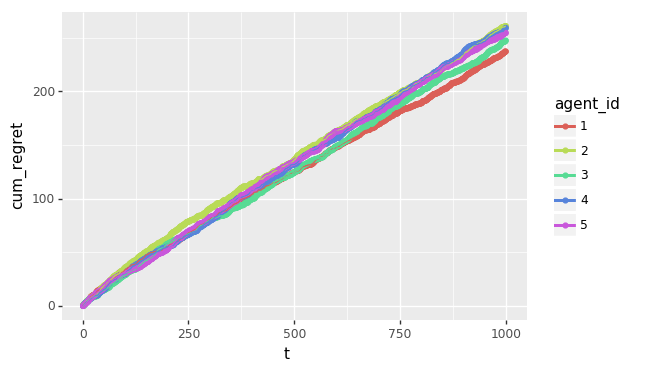

<ggplot: (8730334747121)>


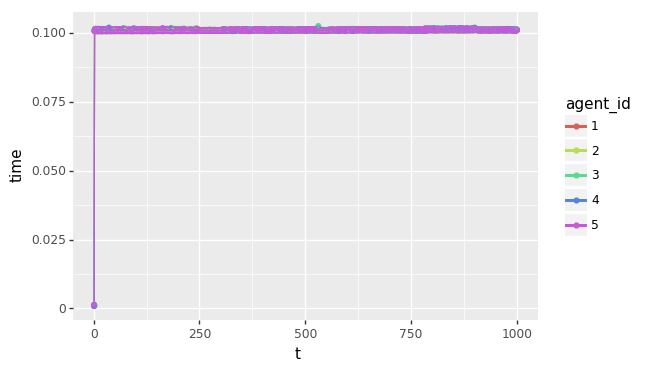

<ggplot: (8730334890773)>
theta [ 1.78862847  0.43650985  0.09649747 -1.8634927  -0.2773882  -0.35475898
 -0.08274148 -0.62700068 -0.04381817 -0.47721803 -1.31386475  0.88462238
  0.88131804  1.70957306  0.05003364 -0.40467741 -0.54535995 -1.54647732
  0.98236743 -1.10106763 -1.18504653]
Experiment: Step 0
 Sample: array([ 0.38825041, -0.38712718, -0.58722031,  1.91082685, -0.45984615,
        1.99073781, -0.34903539,  0.25282509,  1.08940955,  0.02392202,
        0.39312528, -0.2413848 , -0.47552486, -0.16577702, -0.64971742,
        1.63138295, -0.1676986 ,  1.7226692 , -2.68510868,  0.01842079,
        0.56195167])
 Steps taken: 0
 Sample: array([-0.29382124,  1.09465308,  0.63969236, -0.27460012,  0.43500926,
        2.81187838,  0.25199513,  0.29950233, -0.43999131,  0.13349704,
       -1.28926119, -0.19829026,  2.45758763,  1.06721555,  0.64142066,
        1.10392166,  1.88175499,  0.59358811,  2.07087853,  1.06979836,
        0.16651951])
 Steps taken: 0
 Sample: array([ 1.71947

 Sample: array([ 0.49892709,  0.76178368, -0.10259056, -0.53526799,  1.30940377,
        0.56003972,  0.0846136 , -0.12541826, -1.76546387, -1.46030039,
        1.51137843,  2.43198732,  3.50044393, -0.48723527,  0.05453654,
       -1.10291148, -1.85658961, -0.85775662,  0.83981836,  0.12853029,
        1.19144658])
 Steps taken: 1203
Experiment: Step 5
 Sample: array([-5.17799175e-04, -1.78703795e+00, -4.82577612e-01, -7.93121119e-01,
        7.49260307e-02,  2.27474035e+00, -1.40452990e+00, -3.86698431e-01,
       -1.02672868e+00, -5.87282905e-01,  2.82269882e-01, -2.60363763e-02,
        5.49282323e-01, -1.25883381e+00, -1.14944548e+00,  8.85862141e-01,
        1.10804144e+00, -1.07346113e+00, -1.88989869e+00,  2.41372905e+00,
       -8.03790575e-02])
 Steps taken: 1317
 Sample: array([ 0.9554967 , -0.6997018 ,  0.32626659,  1.2432723 ,  0.74763188,
        0.75285275,  1.21391608, -1.38707445, -0.22948333,  0.17109467,
        0.45239498, -0.0101525 , -1.04535271, -0.23117472, -0.4

 Sample: array([ 1.15611581, -1.92490894, -0.51988032, -0.96228796,  0.55435248,
       -1.57515657, -1.42479682,  2.1280918 , -1.27324041,  0.88494243,
        0.36910342,  0.24236602,  0.50544132,  2.49994706,  0.12336247,
        1.05896135,  1.04358291,  0.10925713, -1.0703468 ,  0.62187738,
        1.69367987])
 Steps taken: 1275
 Sample: array([ 1.61052086, -0.83121182, -0.15047131, -1.07205401,  0.3362928 ,
        0.45498606,  0.46284726, -0.28901769, -0.53765877,  0.35287257,
       -1.55224378,  0.96890202,  0.97372743,  1.47757427,  0.17306535,
       -1.10844039,  0.27735057, -2.88167811,  1.06075512, -0.39287819,
        1.57378095])
 Steps taken: 1280
Experiment: Step 10
 Sample: array([ 0.46938067, -0.90401433,  0.89006137, -0.66699817,  0.96570492,
        0.99715627,  0.30342609, -0.81296562, -0.46183586, -2.36191746,
       -0.20380516, -1.05899639,  1.02086116,  0.36563338, -2.21953975,
        0.58958649,  0.41895576, -0.15585842, -0.5873279 , -0.48478521,
        0

 Sample: array([ 1.07766535,  0.70857621,  2.81421461, -1.15502825, -0.2649151 ,
        0.45465591, -2.31011541, -1.27093838,  1.33095452,  0.95143504,
        0.85554294,  0.16167633,  1.1914766 ,  1.61294954,  0.77025693,
       -1.55413261,  1.43661588,  0.93299446,  0.11253858,  0.16470983,
        0.8130269 ])
 Steps taken: 1164
 Sample: array([ 2.02881657,  1.14321319, -0.62877828,  0.38731547, -0.10618975,
        0.99431285,  1.15297408, -1.4579515 , -0.23644777,  0.77131267,
        2.40215187,  1.29845063, -0.34477867,  1.05636078, -0.50607571,
       -1.16288622, -1.28273797, -0.97133144,  1.46678761, -0.71802965,
       -0.74486208])
 Steps taken: 1209
Experiment: Step 15
 Sample: array([ 1.16042851,  0.14453865,  0.3930304 , -0.73461543,  0.17320671,
        0.84299211,  0.04772118,  1.33264444, -0.47502955, -0.10491802,
        0.61350449, -1.66754441, -0.7121946 , -0.57626044, -1.40285433,
       -1.39669655, -1.14527254, -1.66792765,  0.52772837, -0.80246454,
       -0

 Sample: array([ 1.75299253,  1.21073041,  1.00966333, -0.1271175 ,  0.83980543,
       -1.02068143, -0.32363891,  1.49207133,  0.70676862, -0.58839064,
        1.52070494,  0.40638841, -0.97979905,  0.4769    , -0.4974278 ,
        0.90952445,  1.28424509,  0.24422589, -0.70227377,  1.52843837,
        0.13765376])
 Steps taken: 1197
 Sample: array([ 2.49267462,  0.38511809, -0.84071646, -0.62752091, -0.47911175,
       -0.73562238,  1.42221986, -0.34804209,  0.99566714,  2.17898321,
       -0.34455264,  1.35240855,  0.54607168, -1.16059121, -0.23352222,
        0.49968873, -0.33587795, -0.00385841, -0.72698688, -1.11396307,
       -0.30120888])
 Steps taken: 1231
Experiment: Step 20
 Sample: array([ 1.58410514,  0.59031566,  1.07929764,  0.42787348, -0.38107101,
       -0.35426241, -0.80051553, -1.07747909, -0.21075485,  0.24076006,
       -0.43757933, -0.14563811,  0.92550092,  1.00966019, -0.87145666,
       -0.690342  , -0.07965481, -0.70635898,  0.53708024,  0.64755821,
       -0

 Sample: array([ 1.55479173,  1.64249677,  0.9462426 , -1.7833467 ,  0.1885711 ,
        0.53481369, -0.83926774, -0.50516115, -0.25541559,  0.04017116,
       -0.09079459,  0.65464084,  0.42972412,  0.46580834,  0.31750597,
       -0.40115183,  1.57788935,  1.36249597,  0.44668864, -1.56609255,
        0.77220546])
 Steps taken: 1182
 Sample: array([ 0.98435177, -0.46042984, -0.56083111, -0.52315265, -0.0613291 ,
        1.25069353,  0.00877085, -0.71316725,  0.47826541, -0.76689889,
       -0.22080505,  0.4696316 ,  0.17240041,  0.22206607, -2.52588016,
        0.41931545, -1.67761292,  0.11589027,  0.21470237,  0.40980512,
        0.28761086])
 Steps taken: 1188
Experiment: Step 25
 Sample: array([ 1.0586722 , -2.55063005,  1.93272054, -0.76960503, -0.26076331,
       -0.36285159,  0.20204523, -0.50097989, -0.67492967,  0.14993155,
       -0.50560353, -0.44196465,  1.32379141,  1.23477478, -0.64146276,
       -0.73807603, -0.07952858,  0.88396583,  0.50442394, -0.42861791,
        0

 Sample: array([ 1.59184348, -0.46453308,  0.10979466,  0.84287759, -0.69161541,
        1.67486302, -1.21217526,  0.15606087,  0.28343437, -0.16028828,
        0.13948231, -0.13695333,  0.43575628,  0.4208974 , -0.51818873,
        0.16490947, -1.05415341, -0.43132402,  0.29170606, -2.65144394,
       -0.20998686])
 Steps taken: 1137
 Sample: array([ 1.4666972 ,  0.55508805,  0.93523952, -0.90410846,  0.43397273,
       -0.06642208, -1.20776049, -2.33961453,  1.08625932, -0.86999299,
       -0.19283936, -1.37417678,  2.11870863,  0.64758659,  0.57910951,
        0.27686473,  1.43455435, -0.54545622, -1.10649888, -1.17145189,
       -0.36756767])
 Steps taken: 1158
 Sample: array([ 1.98170625, -0.99036852,  0.57986944, -1.60072947,  1.48127996,
       -0.46476191,  1.28303422, -0.84658787,  1.2314744 ,  0.85757771,
        1.29131431,  1.77623371, -0.39302911, -0.04238551, -1.4433694 ,
        0.18171474,  0.08823281, -1.7513772 , -0.9707083 ,  0.50101657,
        1.31163035])
 Steps t

 Sample: array([ 0.65168539, -0.68624555, -0.12763173,  0.61767679, -1.36402597,
       -0.06831976, -0.16306283, -0.28391316,  0.33337762,  0.53724154,
        0.16294676, -0.11050891,  2.44646703,  1.0689496 ,  1.0158826 ,
       -1.0558636 , -0.1101345 , -1.22481671,  1.05939827, -1.30641859,
        1.0595772 ])
 Steps taken: 973
 Sample: array([ 1.31539497,  0.02483152,  0.61889703, -2.01094163, -0.53912932,
        0.45290419,  0.0984728 , -0.65024361,  0.29415125,  0.40403445,
        0.20961556, -0.0809403 ,  0.84973805,  0.41420965, -1.26020458,
        0.27237553, -0.45343443, -0.60712011,  0.28369717, -0.32352972,
        0.26524917])
 Steps taken: 955
Experiment: Step 35
 Sample: array([ 1.28756511, -1.43566309,  0.26626574, -1.01228829,  0.63101506,
        0.68079227, -0.09577778,  0.66113756,  0.95892391,  1.37920362,
       -0.3376279 ,  1.23526617,  1.42673721,  0.92363729, -1.23129817,
       -0.45678357,  0.49122512, -2.15517484,  0.89159931,  0.58778042,
       -1.3

 Sample: array([ 0.57902182,  0.30047537,  0.39916947, -0.33672254, -0.28367396,
        0.95395722,  1.51197533,  1.52112734,  0.75566721, -0.66560188,
        0.79808538, -0.2858728 ,  0.53918796, -0.49851531, -1.4353257 ,
       -0.25079207, -0.44929611, -1.60952839,  0.51421411, -1.69256106,
       -0.73036165])
 Steps taken: 984
Experiment: Step 40
 Sample: array([ 0.33750127, -2.23762265, -0.81183164,  0.17743701,  0.14789789,
        0.23316995, -0.60203866,  0.57072825, -0.22923034, -1.03917662,
        0.6299787 ,  0.21735849,  1.88393272, -0.62288031, -0.7893652 ,
       -1.03456385, -0.03028725, -0.7630947 , -0.27101614, -0.30338074,
        0.25765979])
 Steps taken: 980
 Sample: array([ 2.37800523, -2.02020092,  0.56873139, -0.82323369, -0.82471072,
        1.8722976 ,  1.85912279,  0.47067271,  0.49173732, -1.53639921,
       -0.77097972, -0.64799598,  0.04630291,  0.56264821, -0.61755772,
        0.03282658, -2.69015176,  0.24775532,  0.63020784, -0.24418805,
       -1.4

 Sample: array([ 1.800732  , -0.86176395, -0.22520966,  0.2629668 ,  0.0219942 ,
        0.04084462,  0.91236364, -1.69923421, -0.00830478,  0.02061502,
       -1.63461411, -0.32820817, -0.72811692,  0.81096068,  0.91244559,
       -1.06962546, -0.26844528, -1.4652184 ,  0.68063781, -1.3907957 ,
        1.14205642])
 Steps taken: 981
 Sample: array([ 1.52621836,  0.02287116, -1.53275426, -0.98265412,  0.80298621,
        0.13767155,  0.66128177,  0.44073608,  0.16414475, -0.88432682,
        0.47909896, -0.83083264, -0.9650934 , -0.4455695 , -0.82279153,
       -0.250225  , -0.38019853, -0.14964084,  2.22117119, -1.49333094,
       -1.47259502])
 Steps taken: 855
Experiment: Step 45
 Sample: array([ 2.23363344, -1.10762906,  0.24462783,  0.02994072, -0.1461527 ,
        0.57579846, -0.65740511, -0.01018346, -1.42892913, -0.06433574,
        0.49098558, -1.7971166 ,  2.12305459, -0.37173032,  2.10793522,
       -0.50953283, -0.15285157,  0.44742847,  1.26547617, -2.15640906,
       -0.9

 Sample: array([ 1.59663915, -0.67771237, -1.91382698,  0.44687783, -0.54613397,
        0.62818471, -1.03649014,  0.44190223,  0.76488257,  1.57276065,
        0.7988905 ,  0.0138362 ,  1.13625685,  0.55976995, -1.25895054,
       -1.20884639, -0.62083614, -0.34708991,  0.66376974, -1.03770998,
        0.81018204])
 Steps taken: 978
Experiment: Step 50
 Sample: array([ 1.43306782,  0.4599204 ,  0.87373523,  1.39776605,  1.22010299,
       -0.13163581, -0.67773589,  0.05154159,  0.04187021,  1.22744024,
       -0.564679  ,  0.44466734,  0.34837855, -0.31865817, -1.21393543,
       -0.69092209, -0.2537936 ,  1.00193106,  0.51473614, -0.49534086,
       -0.96728671])
 Steps taken: 974
 Sample: array([ 2.14026262, -0.37921605, -0.68547758, -1.66203299, -1.00739173,
       -0.42322995,  0.60619351, -1.06910087, -0.29530535,  0.52885922,
        0.34621412, -0.76875302, -0.15609931,  2.56293614,  1.98663495,
        1.3437709 ,  0.97944272, -1.89155183, -0.67667485,  0.08750874,
       -1.1

 Sample: array([ 2.16888254,  1.13980053, -0.32941757,  0.01446652, -1.74591442,
       -1.37740298,  0.09988354, -0.85494609, -0.23380072,  0.24748114,
       -1.92722604,  0.5157788 ,  0.51211202,  0.04276813, -0.16940017,
       -2.10373289, -0.49394617, -0.29840155,  0.32848436, -0.86792303,
        0.77557323])
 Steps taken: 970
 Sample: array([ 1.99438556, -0.60959629, -0.02973266,  0.14806801,  0.15410537,
        1.60845981,  0.18850925,  0.09307318,  1.33474414, -0.49330079,
       -0.31371606,  0.50979942,  1.37074633, -0.08489965,  1.57288507,
       -0.71012224, -0.11727676, -0.86435649,  1.25433737, -0.6681816 ,
        0.49212793])
 Steps taken: 991
Experiment: Step 55
 Sample: array([ 1.22819164, -2.11556497,  1.57317579,  0.3413495 , -1.3221561 ,
        0.41328724,  1.7685133 ,  0.71201945, -0.27202483, -0.96508402,
       -1.19040252,  0.37841203,  0.93055821,  2.03228518,  0.46396068,
       -0.55663342, -0.24325663, -1.73222589,  0.33832173,  1.01743815,
       -2.4

 Sample: array([ 1.32697618, -0.03229739,  0.57968782, -0.75576407,  1.69898592,
       -0.11356334,  1.15142968, -1.12663492, -0.12072823, -0.27588548,
       -0.07064493,  0.34540653, -0.48410092,  0.58748916, -0.92751771,
       -0.36022821, -0.72002301, -0.95791951,  1.1103291 , -1.33191874,
       -0.25675711])
 Steps taken: 979
Experiment: Step 60
 Sample: array([ 1.26172454,  1.90006569, -0.8980899 ,  0.593447  , -1.0481425 ,
        1.54749215, -1.08513627,  0.17047146,  1.42944777, -0.20225821,
       -2.95998863, -0.39864382,  1.20119573,  0.04344128, -0.2524025 ,
       -1.36010408,  0.12142173,  0.37119132, -0.36389443, -0.23643429,
       -0.64678571])
 Steps taken: 987
 Sample: array([ 2.0057546 ,  0.29735355,  0.75569323, -1.16205536,  0.36504425,
        2.57164177,  0.18139821, -0.07568487, -0.665438  , -1.61670252,
       -0.74382868,  0.71139398,  0.9719275 ,  0.13138035, -1.50995295,
       -0.63887251,  2.3854465 , -0.97147464,  0.67841617,  0.06772161,
        0.1

 Sample: array([ 1.13182898,  0.93647644,  0.10178854,  0.09966714,  1.29743479,
        1.01503234, -1.39963029,  0.1811065 , -0.13912326,  0.13097124,
       -0.7212232 ,  0.53735881,  0.575415  ,  0.49457753,  1.21969967,
       -0.56220358, -0.85278792, -1.5765272 ,  1.57103792, -1.92556721,
        0.47738568])
 Steps taken: 984
 Sample: array([ 0.76631381,  0.42397665, -1.06255548, -0.83764013,  0.12649476,
       -0.80476163,  0.6558223 ,  0.96616217, -0.52161527,  0.44836968,
       -1.31381786, -0.93736143, -0.35293589,  0.94606296,  0.74899237,
        1.01049558,  0.05561461,  1.08750685, -0.25229338,  0.04904216,
        1.92622026])
 Steps taken: 992
 Sample: array([ 1.91047368, -2.11588715, -0.74151084, -0.34360208,  0.37787309,
       -0.5235786 , -0.67968088, -1.47071519,  0.27543537,  0.16437255,
        1.77347228,  0.30820982,  0.2433966 , -0.34864477,  0.34415855,
        0.23741991, -1.01775226, -0.78112511, -0.44710301,  0.17103598,
       -1.11388093])
 Steps tak

 Sample: array([ 1.56029105, -1.77492066, -0.33284416, -0.94645961,  1.4617449 ,
       -0.54278949,  1.00107809, -0.68034701,  0.62339387, -0.74723472,
       -0.15646336,  0.49059571,  0.57778502, -0.03525052, -1.645126  ,
        0.2330401 , -1.01286343, -2.04193568,  1.05113831, -1.5722256 ,
       -2.15932676])
 Steps taken: 982
Experiment: Step 70
 Sample: array([ 1.26628469, -1.10045955, -0.97673514, -0.40213864,  0.89912717,
        0.95100069, -0.67516153, -0.54404322,  1.15372642,  1.83959185,
       -0.63521662, -0.97191211,  1.69149536,  0.05011833,  0.25519478,
       -1.5297262 ,  1.69550785,  0.01076667, -0.27715759, -1.70949622,
        0.18045445])
 Steps taken: 993
 Sample: array([ 2.34837676,  1.22805357, -1.0157424 , -1.46907362, -0.0952341 ,
        1.51907941, -0.25464578, -0.27743944, -0.80842573,  0.75110432,
        0.92977611,  1.22832524,  0.53796068,  1.47480894,  0.66209792,
       -1.36341388,  0.37842174,  1.2241395 , -0.04129624,  1.30585746,
       -0.6

 Sample: array([ 1.3681931 ,  0.37230362,  1.32649956, -0.15929054,  0.02252737,
        0.24591346, -1.03243042,  0.98490589,  0.10446119, -0.60474555,
        0.15453381,  0.62336984, -0.32715295,  0.01858656,  0.11402996,
       -0.04088678,  0.73815471, -0.28978971,  0.68398961, -0.62554443,
       -1.42967629])
 Steps taken: 981
 Sample: array([ 0.97003352,  1.34594086, -1.60703092, -0.37721517,  1.56788367,
        0.26752537,  0.19565691, -1.09556294, -0.66809243, -1.26571721,
        0.24661731, -1.28390928,  0.47461551,  0.83355516, -0.2154704 ,
        0.36168507, -0.16690091, -1.24039559,  0.38690966, -1.49566666,
        0.49677631])
 Steps taken: 978
Experiment: Step 75
 Sample: array([ 1.07956275,  1.39605152,  1.01027152,  0.49479818,  0.59030624,
        0.87668566,  0.52298168,  0.1366598 ,  0.62739882,  0.53332056,
        0.85943207, -0.03082327,  0.34223506,  0.78640489,  1.02403125,
       -1.31276446,  0.77945238,  0.00223995,  0.64652725, -1.13550842,
       -0.4

 Sample: array([ 0.990358  ,  0.25720827,  1.05465293, -0.44660586, -0.96131998,
        1.10612434, -1.23378398,  1.48849227,  0.25785591,  0.02613587,
       -0.56384645, -0.71642129, -1.06687269,  0.4038054 ,  0.6256337 ,
        1.30095273, -0.51668368,  0.44891404, -0.92179301, -1.0657481 ,
       -1.07118349])
 Steps taken: 976
 Sample: array([ 1.25939553,  1.4799257 , -0.52188587, -1.63503572,  0.10472824,
        1.07086999,  1.50989832,  0.68319316, -0.43822169,  0.37110902,
        0.61248394, -0.77969345,  1.04393352,  1.8191067 , -1.03809016,
       -0.32819425,  0.50126169, -1.9587758 , -0.61971589, -0.65499577,
       -0.42706788])
 Steps taken: 986
 Sample: array([ 0.97881609,  0.01813619,  0.23495425, -0.17332518,  0.42843194,
        0.65614574,  0.60794989, -1.31566895,  0.45979364, -0.81490708,
        0.63054093,  1.53559134,  1.28949551,  0.14560614, -0.37279072,
        1.66012918, -0.02824262, -0.09023055, -0.249271  , -0.79747729,
        0.16997122])
 Steps tak

 Sample: array([ 2.52700244, -0.31045771, -0.53222094,  0.02073724,  0.0476361 ,
       -0.74532567,  0.94819613,  0.03613264, -0.06067074, -0.32373356,
       -1.68591263,  0.94257534, -1.18580792,  1.33500362,  0.7787911 ,
       -0.03183561,  1.58581353, -0.84504289, -0.44169468,  0.25927061,
        0.35829041])
 Steps taken: 981
 Sample: array([ 0.85093166,  1.17636924, -1.19388039,  0.29869079, -0.39342546,
        0.1678033 , -0.25099879,  1.30663714,  0.59845508,  0.44599829,
       -1.39796382,  1.12160111, -0.72433391,  1.6886542 , -1.06894263,
       -1.56200226,  0.78135241,  0.55579497,  0.25344029, -1.40265099,
       -0.27035371])
 Steps taken: 987
 Sample: array([ 1.9874967 ,  1.4565471 ,  0.47828742, -0.9203491 ,  1.35988257,
       -0.01317497,  1.00739389,  0.75407947,  1.01513043,  1.66400885,
       -1.24993097,  0.20582206,  0.31892908,  2.25481864,  0.98979944,
       -0.01732559,  1.34593129,  0.85457084,  0.04815511, -1.84374719,
        1.22199553])
 Steps tak

 Sample: array([ 2.06025311, -0.45835414,  0.12345364, -0.92617547,  1.40674295,
        0.53836786, -1.15316247,  1.58494193,  0.86568487, -2.4932853 ,
       -1.69181176, -0.66843781,  0.33347227,  1.13056101, -0.0651179 ,
       -2.02184651,  0.00309345, -0.62603625,  0.1419917 , -1.02171069,
       -0.46919706])
 Steps taken: 981
 Sample: array([ 1.77161163, -0.65786778,  1.49416713, -1.05546027, -0.00636392,
       -0.16905066, -0.42074815, -1.40847131, -1.12494092,  1.96070639,
       -0.20114598,  1.35629567,  0.64307454,  1.57458751,  0.16251076,
        0.96238656,  0.66938138, -0.46685384, -0.8644415 , -0.28767026,
        1.64193443])
 Steps taken: 987
 Sample: array([ 0.76553694, -0.72267999, -0.60028096, -1.42563508,  0.40042087,
        0.74112917, -0.35663958, -0.81818249,  0.35392976,  0.76968064,
       -1.06657948,  0.0171013 ,  2.75145124,  0.50773804,  0.36538655,
       -1.07215166,  0.44329938,  0.31135529, -1.08056631,  0.46417378,
       -0.76704487])
 Steps tak

 Sample: array([ 2.2968662 , -0.77938429, -0.2107029 , -0.43746178,  0.76706084,
       -1.02030138,  1.97092623, -0.49353588,  0.35051304,  0.44586777,
       -0.77615397, -0.8573634 , -0.35876928,  1.45267214, -0.83432668,
       -0.39976521, -1.03108827, -0.35564664,  1.32235129, -0.42262641,
       -0.1318641 ])
 Steps taken: 976
Experiment: Step 94
 Sample: array([ 1.56577082,  0.55176126,  0.85598119, -1.41650199,  0.0163014 ,
        1.60308184,  0.00395552,  0.08743145,  0.49843775, -1.04335724,
       -0.14277554, -0.49014677, -0.18331386,  0.48000726, -0.34862786,
        1.50126535,  0.1590654 ,  0.21717816, -0.29428783, -0.63569539,
       -0.19799868])
 Steps taken: 984
 Sample: array([ 1.73312354,  0.22942673,  0.0853495 ,  0.72783626, -0.82161375,
       -1.34323244, -1.32221326, -0.24686215, -0.58629624,  0.96709442,
       -1.94049389, -0.65375282, -0.07423477,  2.39167253, -0.83127249,
        1.3532465 ,  0.08691914,  0.07441045, -0.79787445,  0.79195674,
        0.8

 Sample: array([ 1.40211888, -1.70323707, -0.04996242, -1.58808511, -0.06271669,
        1.19397682, -0.80611116, -1.33413387, -1.03728193, -0.11137854,
       -0.82608107,  0.50114576, -0.21609226,  1.15748367, -0.01664412,
        0.95412931,  1.24122619,  0.01349432, -0.12434834, -1.86909924,
        0.57619969])
 Steps taken: 982
 Sample: array([ 1.97858688,  1.06980263, -0.75102252, -0.89582423,  1.78626944,
       -0.01433263, -0.25255619,  0.03807273, -0.18294261,  0.06651186,
       -0.60056337, -0.51832608, -1.45140418,  1.46116767,  0.42184731,
       -0.7622734 ,  1.17040643, -1.57107138, -0.78926835, -0.67365507,
       -0.30311944])
 Steps taken: 990
 Sample: array([ 1.13425355, -0.41554004, -0.60712354, -0.28362351,  0.25264868,
        0.27454138,  0.58894674, -0.74439848,  1.67675397,  0.65921207,
       -1.94325775,  0.6100865 , -0.31970801,  1.77125697,  0.23950454,
       -0.0693215 ,  0.30288541, -0.59079698,  2.18150796, -1.47023185,
       -2.0185285 ])
 Steps tak

 Sample: array([ 1.33562018,  0.61186863, -1.67033256, -1.90040828, -0.59665852,
       -0.48579782, -0.03482394, -1.4056514 ,  1.06726141,  0.38334807,
       -0.1124459 ,  0.68943013,  0.51322397,  0.63810429, -0.13595694,
       -0.85910894, -0.28561723, -0.32178226,  1.19257748,  2.29882105,
       -1.21341959])
 Steps taken: 979
Experiment: Step 104
 Sample: array([ 1.37379412, -0.35097636, -1.78845099, -0.9761545 ,  0.30419395,
        1.85011452, -1.05650079, -1.06808762,  0.15627589,  0.96755944,
       -1.45477611, -0.70804774,  0.675091  ,  1.01383185,  0.97746921,
       -0.0054487 , -0.61777646,  0.16937754,  0.83702775, -0.62275342,
       -1.4292505 ])
 Steps taken: 991
 Sample: array([ 1.23519808,  1.6181991 , -0.10460044, -0.97720811, -0.15780857,
       -1.51024676, -0.1148369 , -0.86969058,  0.85180586,  0.2326621 ,
       -0.34728801, -0.69916229,  0.297056  ,  2.21368445,  0.34979857,
        0.9489227 ,  1.47576499,  0.82118652, -0.45314397,  1.34352308,
       -0.

 Sample: array([ 0.88275101,  0.72885744,  1.43728896, -1.11685479, -0.95523831,
       -0.05151753,  1.50558905, -0.21428293,  0.51427081,  0.73529311,
       -0.82731299, -0.55950745,  0.15556851,  2.29782237, -1.23102889,
       -0.05519961,  1.46794681, -0.7477788 , -0.51765446, -0.95815353,
        0.06165113])
 Steps taken: 981
 Sample: array([ 2.08605982,  0.22675347, -0.54531089, -0.25531812,  0.5312765 ,
       -1.2788207 ,  0.28709382, -0.26558672,  0.69562831,  0.82696944,
       -0.55433828, -0.56731624,  1.0429834 ,  0.23329151, -0.15249435,
        0.09862699, -1.56701169, -1.36284315,  0.50911178,  0.85633684,
       -0.67260721])
 Steps taken: 992
Experiment: Step 109
 Sample: array([ 1.98416348, -0.48625925,  1.06523959, -1.09921143, -0.88878834,
        0.04455197,  0.91545155,  0.17761393,  0.05577168,  0.58024063,
       -0.49149009,  0.06982081,  0.71124119, -0.34936571, -1.23840255,
       -0.08102096, -0.87262122,  0.20830903, -1.08136321, -1.08745954,
        0.

 Sample: array([ 0.89030292,  0.12692163,  0.8613555 ,  0.53360725, -0.10844516,
       -0.87043076,  0.0826839 , -0.08988531,  0.27204986, -0.03922996,
       -0.44321146,  0.96126907,  0.25600153,  0.79049886,  0.13461946,
       -1.24315686, -0.64791808, -1.0060131 ,  0.57562498,  0.76099603,
       -0.90187939])
 Steps taken: 985
Experiment: Step 114
 Sample: array([ 1.73363258, -0.24608461, -0.4457384 ,  0.51855402, -0.4440472 ,
        0.56602124,  1.00734165, -1.20427209, -1.13548449,  0.04519893,
       -0.53558658, -0.83746138, -0.51593919,  1.49213326,  0.46592547,
        0.38919453,  0.13441508, -0.93999136, -0.18863423,  1.64456263,
       -0.22192695])
 Steps taken: 984
 Sample: array([ 1.30334897e+00,  4.04110877e-01, -2.67275467e-01, -2.84438314e-01,
        1.92576153e-01, -4.37188251e-01,  1.83295410e-02,  3.58261414e-01,
        1.62467369e-03,  1.11247451e+00, -4.15845888e-01,  4.04798490e-01,
       -7.32528129e-01,  1.57333380e+00, -3.85728768e-01,  2.52180007e-01

 Sample: array([ 1.65503913,  0.16978231,  0.62130699, -1.44206609, -1.22745386,
        0.66864565, -1.29386797, -0.48814988, -0.79540678,  0.65565262,
       -1.04877087,  0.75873469,  0.3026233 ,  0.15445129, -1.70442884,
       -0.00660496,  0.34185019, -0.41399526, -0.2761592 , -0.53743876,
        1.75184081])
 Steps taken: 976
 Sample: array([ 1.95861709,  1.66183294,  0.0486288 ,  0.76459136,  1.06110333,
        0.1062855 ,  0.5870982 ,  0.08994308, -0.34576679, -0.56198209,
        0.46531314,  0.21845163,  1.73557016, -0.93673048, -0.0667808 ,
        0.00929351, -0.40353308, -1.1308598 , -0.40930572,  0.16054776,
       -0.46430078])
 Steps taken: 984
Experiment: Step 119
 Sample: array([ 2.02761966,  1.22419012, -0.94717377, -0.21283489, -0.70614708,
        1.03974894, -0.51026595,  0.4523813 ,  0.3754331 ,  1.35720886,
       -1.64658415,  0.6456274 ,  1.28685013, -0.03335825, -1.59037506,
        0.61729107, -0.34124315, -0.73391279, -0.32870944,  1.51735705,
       -0.

 Sample: array([ 1.64393814,  0.46375393, -1.7455594 , -1.48461593, -0.2336045 ,
       -1.24102394,  0.19178856, -0.42023859,  0.65064649,  0.20730058,
       -0.07311647, -1.04176954,  0.42468485,  0.7677114 ,  0.80685076,
        0.88946928,  0.23252847, -0.79020442,  1.52365043, -1.64946722,
       -2.21027997])
 Steps taken: 976
 Sample: array([ 2.31716691, -1.5852206 , -0.36219747, -1.27640489, -0.84026007,
       -0.39103644,  0.35837225, -0.40716167, -0.93332223, -0.59803044,
       -0.78606656, -0.58165903,  0.71626386,  2.61337661,  0.22001453,
       -0.17315374, -1.97542779, -1.24175296,  0.89176642, -0.22682357,
       -0.38638834])
 Steps taken: 988
 Sample: array([ 1.85930964, -0.5392165 ,  0.95638196, -0.24802786, -1.60726563,
       -0.82583066, -0.27301927,  1.40389031,  0.14430008, -1.13290423,
        0.22739896,  0.75937919,  0.79488291,  0.7529608 , -1.27367217,
       -1.04981141, -0.92868412, -1.13848168,  0.83303217, -0.698927  ,
       -1.2731532 ])
 Steps tak

 Sample: array([ 1.09117213,  1.40285359,  0.10373992, -0.91487589,  0.0931387 ,
        0.15395357,  0.42956325, -1.99712433, -0.13883508, -1.31746495,
       -1.01896744,  2.56728259, -0.34316151, -0.20041271,  0.15971348,
       -0.85601827,  0.65694357, -0.43114737, -1.13767037, -0.25141924,
       -0.47966477])
 Steps taken: 969
 Sample: array([ 2.08815457,  0.30111876, -0.81587412, -0.90789712, -0.57921698,
        0.31219035,  1.50988413, -0.3935055 ,  0.53966896, -0.32997695,
        0.11266553,  0.10721749,  0.89509477,  1.29299728,  2.12143686,
       -0.58884415, -0.56576594, -1.70356272,  1.18698189,  1.18128735,
        0.28801197])
 Steps taken: 976
 Sample: array([ 1.37723573,  0.09842797, -0.68511925,  0.50384224,  0.21136247,
        0.36347257, -0.12674762, -0.16791904,  0.67049649,  1.28103587,
       -0.5135872 ,  0.03555688,  0.38798102,  1.73501198, -0.09528449,
        0.27646471,  0.76830802, -2.35892114,  1.56912491,  0.08949034,
        1.52173793])
 Steps tak

 Sample: array([ 1.50415664, -0.28141274, -0.77300944, -1.35527915,  0.88177592,
       -0.91022904, -0.88160309, -0.55510893, -0.65309747, -0.50649507,
        0.83487648,  0.77190496,  1.62037976,  0.71679131,  0.53918844,
       -0.58505339, -0.04381854, -1.44548682,  1.04384581, -0.66608198,
       -2.1228223 ])
 Steps taken: 978
 Sample: array([ 2.70986867,  0.69062179,  0.04491   , -1.7384561 , -0.73016284,
        0.51484831, -1.23639599,  1.11024431,  0.43043052,  1.14760819,
       -1.64923871,  0.74055336, -1.16190847,  1.29593828, -0.43793339,
       -0.6134619 , -1.55671682, -0.39741637, -0.24950293,  1.29978538,
       -0.57833334])
 Steps taken: 984
 Sample: array([ 1.70386377,  0.58460339,  0.37171435, -0.9997907 ,  1.36622487,
       -0.8510039 ,  1.13475119, -0.59947918, -0.10118622,  1.30576162,
        0.41924636,  0.09107008,  0.13865339, -0.3017709 ,  0.23572206,
       -1.80413603, -1.54227525,  0.38069393,  1.28467622, -0.02980458,
       -0.84863316])
 Steps tak

 Sample: array([ 2.86983518, -1.64545004,  1.15401393, -0.23429435, -1.0379409 ,
       -0.01261429,  0.88197914, -1.242264  ,  0.19406253,  1.81827111,
        1.13539454, -0.06138384,  1.28204654,  1.20783976,  0.25055351,
        0.46858105,  0.05069507,  1.28568623,  2.11457916, -0.00809107,
       -0.87889994])
 Steps taken: 976
 Sample: array([ 0.76887147,  0.85800318,  1.3179304 ,  0.94345777, -0.4355989 ,
        1.07652306,  0.0250809 , -0.65155524, -0.0975902 , -0.48429111,
        0.09728236, -1.00221629, -0.74356353,  1.87135894,  0.85795776,
       -0.42746287, -1.01711909, -0.24702247, -0.80389686, -1.00453313,
        0.90069419])
 Steps taken: 984
 Sample: array([ 0.07137955, -0.48524609,  1.17770386, -1.17833555,  0.28359477,
       -1.00477672,  0.11192428,  0.27982874,  0.72221439,  0.61130463,
        0.51606085, -0.92963206, -0.1600908 ,  2.00361613, -1.17896466,
        0.27577401, -1.08778501, -2.44667007, -1.04776589,  0.33091212,
        1.32371555])
 Steps tak

 Sample: array([ 0.65319867,  0.33447561,  1.22052379,  0.78308083,  1.57830477,
       -0.25785939,  0.41891512, -0.36156997, -0.96222222, -0.86733404,
        0.28868697,  0.33524917,  0.06473121,  0.23599071, -0.7539725 ,
       -0.27630627, -0.02670518, -0.96199044,  1.33026886, -1.94020729,
       -0.9576236 ])
 Steps taken: 971
 Sample: array([ 1.15299869,  0.35390059,  0.25158778, -0.54128581, -1.59725779,
        0.83967109,  0.47018961, -0.88851403, -1.10091353,  0.5427687 ,
       -0.41361487,  0.07184549,  0.31417527,  1.18955173, -1.54174143,
        0.21125918, -0.49230221, -1.13642007,  0.36273783, -1.22997906,
       -0.78602587])
 Steps taken: 980
 Sample: array([ 0.59719546,  1.21682225, -0.25074322, -0.62502598, -0.12123473,
        0.08922852,  0.19346276,  0.36558814,  0.63282461, -0.09366269,
       -0.81104208, -0.22219287,  0.32281645,  0.37055732,  1.57511012,
        0.03088094,  0.41375285, -0.4617054 ,  0.74894265, -0.61050074,
       -1.0705289 ])
 Steps tak

 Sample: array([ 1.03835863,  0.61665207, -0.32995888, -0.4245877 ,  0.64057793,
        0.31171481,  0.01377653,  0.29219854, -0.88546619, -0.23312415,
       -0.10566737,  0.54096622,  1.07920403,  0.38879958, -0.3803203 ,
        0.31976348, -0.69115065, -1.47532403, -0.16636096, -0.97175293,
       -2.0057618 ])
 Steps taken: 974
 Sample: array([ 1.31630028,  0.53816975,  0.87931764, -0.00668002, -0.43107117,
        0.51838958,  0.24013771,  0.44770916,  1.00687453, -1.18104214,
       -0.08095957, -0.04568373, -0.18151468,  0.95790343,  0.52080852,
       -2.12537661,  1.00079041, -1.74855839, -0.7483221 , -1.52418318,
       -1.39251326])
 Steps taken: 983
 Sample: array([ 0.54652218,  1.39239674,  0.74638178, -0.1697281 ,  0.08565227,
       -1.30492535, -1.18003168, -0.29158308,  1.29292807,  0.32477081,
       -1.80383606,  0.48749845,  1.0618628 ,  0.66856608, -0.5320179 ,
        1.13030625,  0.3359992 , -0.11135459,  1.51787763, -1.74685854,
        0.71051572])
 Steps tak

 Sample: array([ 2.7513944 , -1.51460163,  1.18982993,  0.20714723,  0.33388486,
       -0.00588315,  0.61680614, -0.79625886, -0.72919799, -1.11930989,
        0.49500955, -0.3764848 ,  1.17478674,  0.89220603,  0.0277197 ,
       -0.03904304,  0.611271  ,  1.01465363,  0.52134161, -1.01687973,
        0.41575962])
 Steps taken: 980
 Sample: array([ 1.91154598,  0.24900596, -0.91880104, -0.0431499 , -0.30642053,
       -0.68862221, -1.57433133,  0.36083007,  0.64985979,  1.36691977,
        0.04546324,  0.48292899, -0.77620406,  1.16479736,  0.03378056,
       -0.45989115, -0.2822226 ,  0.45510326,  1.12802257,  0.12359786,
       -1.35060376])
 Steps taken: 991
 Sample: array([ 1.0409397 , -0.23053353, -0.78883046,  0.55655195,  0.32651689,
       -0.6045299 ,  0.37749397, -1.34014752, -0.65783595, -0.19082097,
       -0.46438901,  0.07749565,  0.94276053,  1.32017235, -0.48901388,
       -0.26870061, -1.14513769, -2.3922148 , -1.79534265, -0.0775456 ,
       -1.28436567])
 Steps tak

 Sample: array([ 2.00635816, -1.27283299, -0.00237296,  0.74207563,  0.11462993,
       -1.39148045, -0.47344595,  1.14663474,  0.29605144,  0.45005405,
       -0.0783829 ,  0.81309099,  0.08777214, -0.10141432, -1.75670091,
        0.53180068,  0.07297154, -0.33373908, -0.76965682, -0.49321475,
       -1.53945579])
 Steps taken: 978
 Sample: array([ 1.92860096,  1.1730528 , -0.88902143, -0.86745537, -1.08990013,
        0.04866705,  0.44828464, -1.53599326, -1.32061912, -0.16762898,
        0.40909736,  1.95882202, -0.70313834,  1.92615351,  0.38647827,
       -1.04566782, -0.82182722,  0.13932705,  1.82643239,  0.33083686,
       -0.02769047])
 Steps taken: 984
 Sample: array([ 1.35931805, -1.26395927, -0.02349655, -0.72384972,  0.6953305 ,
        0.02684937,  0.55291449, -1.64161664, -0.02522962,  0.45138351,
       -0.52928336, -0.02590497, -0.19282729,  0.14558706,  0.10531752,
       -1.26726352,  0.50384962, -1.05650502,  0.7768148 ,  0.69673049,
        0.08019769])
 Steps tak

 Sample: array([ 1.71630254, -0.96029382,  0.50861315, -0.1488578 ,  0.26727469,
        1.10392931, -0.31059731, -2.16118869,  0.4605759 ,  1.19627891,
        0.74613091,  0.54153835,  1.60602141,  0.72964329,  0.37686008,
        0.67107893, -1.2881317 ,  0.22936214, -0.22913747, -0.87019679,
        1.13702939])
 Steps taken: 985
 Sample: array([ 1.87824642, -1.41807887,  0.17591709, -1.34435545, -0.96590188,
        0.95352932, -1.51157856,  0.1563348 ,  0.88483626, -0.00859263,
        0.34589978,  0.62641206,  0.20813062, -1.13956395, -0.71910475,
        0.41370821,  0.40313129,  1.50737659, -1.07119836,  1.07509377,
        0.98132029])
 Steps taken: 987
 Sample: array([ 1.78197034, -0.16760348,  0.63377144, -2.39986813, -1.16763524,
        0.29649051,  1.44947466, -0.03577828,  0.47330918, -0.00998974,
       -0.43326594,  0.46525472,  1.07902353,  1.98462623, -1.19007091,
        1.09980877,  0.46475917, -2.18106129,  0.35469905, -0.1978113 ,
        1.22013011])
 Steps tak

 Sample: array([ 1.53012109,  0.21813873,  0.95078588, -0.58592521,  0.85229042,
       -0.56494872,  0.59464564,  0.07220098,  0.58176179,  0.09027215,
       -0.81049261,  0.66580069,  0.89753322,  1.85394036, -0.13895145,
       -0.05642185, -0.82141698,  0.04578771, -0.35060107, -1.13265907,
        0.14196555])
 Steps taken: 1011
Experiment: Step 168
 Sample: array([ 1.21614354, -0.38497582, -1.07443937, -1.02456488,  0.89743605,
       -0.55679329, -0.04092295, -1.75099839, -0.96897191,  0.85170478,
       -0.91010721,  1.06366223, -0.34692378, -0.44255829, -0.76137318,
        0.61217971,  0.75022829, -1.57590107,  0.56623918, -1.25642246,
       -0.41458881])
 Steps taken: 1017
 Sample: array([ 1.7556772 ,  0.33149305, -0.57235408, -0.12866847, -1.16187048,
        0.13586353, -0.17098166, -0.41962998,  0.11030765,  0.56937139,
        1.67112236, -0.13238269, -0.03782846,  0.45593705, -1.17315856,
        0.7916526 , -0.71544043,  0.49014946,  0.47099787,  1.12909215,
       -

 Sample: array([ 0.83442228,  0.85277378, -0.71212963, -0.15501386, -1.20581807,
       -0.2552096 ,  0.45453998, -1.05513207,  0.08213664,  0.9242524 ,
       -0.63069978, -0.45768241,  0.88037035,  1.12414039,  0.6045147 ,
       -1.01906745, -0.4238896 , -1.37509073,  0.92454729, -1.97499914,
       -0.05440959])
 Steps taken: 973
 Sample: array([ 1.05608612, -0.0757041 , -1.3224543 , -1.24896402, -0.61346376,
       -0.2351171 ,  0.35391185,  0.4295013 ,  0.20105835,  0.67893366,
       -1.28569425,  0.03356346,  0.41577005,  0.8728459 , -0.76278994,
       -0.94350517,  0.03885535, -0.47324875,  0.50319267,  0.45572197,
       -1.61043313])
 Steps taken: 984
Experiment: Step 173
 Sample: array([ 1.88666383, -1.09282391,  2.37097995, -1.0263108 ,  0.62449645,
        0.02761416,  0.90327654,  0.89319462,  0.192306  , -0.25678986,
        0.6059194 ,  0.38452805, -0.380431  ,  0.83974835,  0.31695412,
       -1.46387583,  1.23243852,  0.06509981, -0.05342805, -1.42157998,
       -1.

 Sample: array([ 2.9030825 , -0.34294693, -1.02570799,  0.3008197 ,  0.60644463,
        0.10953891, -1.25208005, -0.76657186,  0.33295922, -1.12821847,
       -1.33260503, -0.9576785 ,  0.93307383,  1.47754143, -0.28474981,
        0.42844156,  0.43574381, -1.31095708, -0.16884837, -0.48279134,
        0.41519989])
 Steps taken: 980
Experiment: Step 178
 Sample: array([ 1.99155407,  0.10939368,  0.50858427, -0.6636918 , -0.19501733,
        0.33732833, -0.42206683,  0.33467333,  0.22905145, -0.41665727,
        0.37708401, -0.11474649,  1.27521547,  1.75774672, -0.05460337,
       -0.71387283,  0.65742073, -1.23678684,  0.03395759, -0.41906958,
        1.62475764])
 Steps taken: 993
 Sample: array([ 2.88043452,  1.08337976,  0.18834954,  0.83841848,  1.80282312,
       -1.19951488,  1.59554885,  0.45930131,  1.29716762, -0.55041877,
       -2.42553927,  0.19953779, -0.08777119, -0.70438796, -0.38418537,
       -0.01736425, -0.90161499,  1.56748316, -0.86299627, -0.31147127,
       -0.

 Sample: array([ 1.16088848,  0.68514156, -1.94905503, -0.3783226 ,  0.26632955,
        0.74118159, -0.94608964, -0.37882247, -0.37451183,  0.43302042,
        0.53173346,  0.18753643,  1.29820213, -0.22481256,  0.01481525,
        0.03486538, -0.01745776, -0.23437385,  1.52568723, -0.74377334,
        0.45746827])
 Steps taken: 977
 Sample: array([ 1.76861671,  0.79242732, -1.21868918,  1.25693397,  0.20888664,
       -0.59863065,  0.97829331,  0.40705964,  0.5270989 ,  0.25846971,
       -0.80706827, -0.28698204, -0.66113207,  1.10957135,  0.53675162,
       -0.27685317, -0.4924978 , -1.09991344,  0.33643703, -0.45209174,
       -0.69674008])
 Steps taken: 980
 Sample: array([ 1.14957625,  1.23832721, -0.29839892, -1.31880608,  0.25203114,
       -0.93965043, -0.51881885, -0.4221445 ,  0.22798295, -1.45263233,
        1.83814834,  0.09487081,  0.89289115,  0.14903225, -0.64382581,
       -0.19738883,  0.6061319 ,  0.62018574, -0.20185142,  1.22743742,
       -0.26028124])
 Steps tak

 Sample: array([ 2.12416822, -0.20999768,  0.45843665, -0.67851687, -0.44509309,
        0.01312898, -1.33408976, -0.94638802, -0.4263442 ,  0.11216409,
        0.52602626,  0.84632343,  0.61485476,  0.74156045, -0.2105094 ,
        1.63787264, -0.23167231, -0.06995694, -0.2831438 ,  0.20628061,
        0.19901731])
 Steps taken: 976
 Sample: array([ 1.57938926,  1.8874643 ,  0.33224378,  0.20000829, -0.81368346,
       -0.10513504, -0.45348674,  0.13210601, -1.87306278, -0.45837295,
       -1.42324323,  0.76871791,  1.27698485,  1.10889671,  2.46865431,
       -0.12998205, -0.9135336 , -2.07392107, -0.34854024, -1.97682701,
        0.27977157])
 Steps taken: 989
 Sample: array([ 2.42014958, -0.79088119,  0.27626729, -0.8477868 ,  2.26533244,
        0.24692342,  0.38403496,  0.24487396,  0.63397634,  0.16316999,
        0.66911078,  1.09586147, -1.0159296 , -0.11475216, -0.53030873,
       -0.04246585, -0.5604636 , -0.51635299,  0.69129521, -0.25324653,
       -0.1045468 ])
 Steps tak

 Sample: array([ 0.70892014, -0.25680082,  0.64216073, -0.22514995, -0.31574919,
       -0.01614573, -0.86124022, -1.1633323 ,  0.11741426, -0.10686375,
       -1.2682265 ,  0.35961305, -0.11524621,  0.51034301, -0.93163596,
        1.66184917, -0.76932173, -0.92365914, -0.13197657, -1.56448188,
        0.07971364])
 Steps taken: 978
 Sample: array([ 1.42257913, -0.05948977,  0.94326478, -0.603765  ,  1.4794835 ,
        0.54658389, -0.85391808, -0.12044611,  0.66704195,  1.21388752,
       -0.16270701,  1.86834668,  0.78195352, -1.2495572 ,  0.64855011,
        0.04958514,  0.77531556,  0.04720362,  0.1667657 , -0.4027163 ,
       -1.47187599])
 Steps taken: 987
 Sample: array([ 0.67647997,  1.07440871,  0.85634067, -1.45573148,  0.1691216 ,
       -0.55524234, -0.75593541, -1.49905287, -0.49366316,  0.86901023,
       -0.75560839,  0.45402587, -0.79271917,  1.87011297, -0.05170167,
        2.00667343, -0.48742827,  0.16644495,  1.54201521, -0.18434391,
       -0.32164968])
 Steps tak

 Sample: array([ 1.42322664, -1.07279424,  0.04807899, -1.63266623,  0.91543623,
        0.06105452,  0.2185418 , -0.11881159, -0.42138996, -1.30550569,
        0.26204541, -0.53914768, -1.30589388,  1.73127511, -1.19798686,
       -0.22737147,  0.64934036, -0.15090626,  0.43294999,  0.48195891,
        0.39091619])
 Steps taken: 640
 Sample: array([ 0.42063297,  0.36995643, -0.67377705, -0.61138345, -0.50433409,
       -0.58103545, -0.16209533,  0.13986124, -0.9744174 ,  0.75892079,
        0.05783076,  0.09045024, -0.22398404,  1.9493843 , -0.44344878,
        0.07400779,  0.24723957, -2.02836441, -0.50918317, -0.1124625 ,
        0.5464823 ])
 Steps taken: 806
 Sample: array([ 1.67246249,  0.70009764, -0.38172583, -1.03030395, -0.67132919,
        0.70972498, -0.13943155, -0.95161153,  0.73505749,  0.86826972,
        0.29760713, -0.02963759,  1.86373136,  2.23010851,  0.64670732,
       -0.26110632, -0.49121551, -0.17590697, -0.44498605, -0.53916728,
       -1.40433979])
 Steps tak

 Sample: array([ 0.98704753, -0.53739672,  0.70686665, -1.32335591,  0.32429726,
        0.97435182,  0.90813033,  0.39436495,  0.64273246, -0.13595291,
       -0.41081517,  1.04583303,  0.83329111,  1.30205499,  0.4713486 ,
        0.47487256,  0.18201576, -0.58480048,  1.4129211 , -0.15447037,
       -1.22957661])
 Steps taken: 968
 Sample: array([ 1.87749276,  0.60543294,  0.70756064, -0.51333038,  0.37753681,
        0.26874076, -0.64538753, -0.34270205,  1.59912776,  0.41998981,
        0.83453773,  0.18609927,  0.37732877,  0.62620549, -0.28933234,
        0.84251549,  0.27465413, -0.96639758,  0.8238532 ,  1.46829645,
        0.36894742])
 Steps taken: 984
 Sample: array([ 1.82193538,  0.20935597, -0.23402577, -0.53103552,  0.3551492 ,
        1.23565514,  0.49030572, -0.64066055,  1.29601801,  1.12979661,
       -0.64233426, -0.47106129, -0.27849182,  0.07495309,  0.25569378,
       -1.71343135,  0.01194318, -0.90806413, -0.39249697, -0.76609039,
       -0.52828694])
 Steps tak

 Sample: array([ 0.92463554, -0.69416417,  1.07968546, -0.60697905, -1.451712  ,
       -0.21845187,  0.38233471, -0.70147496,  0.08223819, -0.88036043,
        0.26921265,  1.02676981,  0.87448092,  1.82291124, -1.14830902,
       -1.78154549, -0.50531399, -0.15902496,  1.64837107, -0.98272891,
       -0.31732518])
 Steps taken: 970
Experiment: Step 208
 Sample: array([ 0.89432802,  0.00887957,  0.19578253, -1.06322828,  0.37125392,
       -0.72689484, -0.53842794,  0.19449373,  0.29533175, -0.11196823,
       -0.24958424, -0.8148382 ,  1.96917789,  1.13268912, -0.75940748,
       -0.15563965,  0.21862314,  0.82245131, -0.36961916,  0.16549609,
       -1.08902248])
 Steps taken: 986
 Sample: array([ 2.46647598, -0.828776  , -0.18678005,  1.4715756 ,  1.64960399,
       -2.41424785, -1.5003338 , -1.20987077, -1.56872159,  0.10697421,
       -0.83808015, -0.46035799,  0.61900171, -0.32124242,  0.19078063,
       -0.46321435,  0.93924262, -0.52349567, -1.22535107,  0.2738385 ,
       -0.

 Sample: array([ 0.75966863,  0.99739266,  0.63240378, -0.78082573, -0.91649851,
       -1.06785949, -0.4416389 , -0.46466993, -1.65791934,  1.47633762,
       -2.10715166, -0.5300057 ,  0.29706836,  0.75367633,  0.29190437,
        0.03783735,  0.37787238, -0.71214475,  1.10811607, -0.57144426,
        1.39723927])
 Steps taken: 976
 Sample: array([ 1.84942236,  0.2080202 , -0.43391746, -0.7838945 , -0.88567162,
        0.5743677 ,  0.06159126, -1.32703174, -0.26883565,  1.08219905,
       -0.30278962,  2.14323652,  0.20085616,  1.78987212, -1.73961826,
       -0.98991185,  1.33989352, -1.1990137 ,  1.15929574,  0.21097034,
        0.59917214])
 Steps taken: 984
 Sample: array([ 0.61542493,  0.75573662,  0.17927756, -1.05359498, -1.46463672,
       -0.65262926,  0.70500206, -0.30390203,  0.86156259, -0.53730251,
       -0.17557657,  0.15066888,  2.12721128,  0.23181019,  1.88262737,
       -0.08317142, -0.43860889, -0.71796514,  0.4141695 , -0.56310064,
       -0.488288  ])
 Steps tak

 Sample: array([ 1.69725645, -0.39334514,  0.04615158, -1.53738552,  0.8898992 ,
       -2.00698257,  0.0807164 , -1.57238608,  0.15736104, -1.06615521,
        0.03741157, -0.40840301, -0.68731695,  0.70106755,  0.95462349,
        0.88779352,  0.41907807, -1.62064278,  0.58092386, -0.13088537,
       -0.69536996])
 Steps taken: 975
Experiment: Step 218
 Sample: array([ 1.24434699, -0.45421914, -0.02595945, -0.03829547,  1.45185303,
        0.91988313, -1.45827743,  0.30282364,  0.781669  ,  0.23205475,
        0.090439  ,  0.81481825,  1.09264374,  1.21999455,  0.7737356 ,
        1.49770016, -0.2750117 , -0.18296454,  0.61442492, -1.14697701,
       -0.25494309])
 Steps taken: 983
 Sample: array([ 2.12369953, -0.50521712,  0.14966477,  0.87473693, -0.38104671,
       -0.04127702,  0.59376592, -1.70527735, -1.80295777,  0.00243064,
        0.28512366,  0.94790975,  0.27549309,  0.1692741 ,  0.15932054,
       -0.62022861,  0.34213416, -0.7884593 , -0.44120573,  0.008019  ,
       -0.

 Sample: array([ 1.8965723 , -1.18033427, -0.01998702,  0.18558592,  0.01994796,
        1.02696957, -0.63176175, -0.77261123, -0.14248287,  0.28555408,
       -1.22357826, -0.23942995,  0.71734155,  0.63562474, -0.08381542,
       -0.37059958, -0.38682594,  0.07883586, -1.05295925, -0.99960058,
        0.9646104 ])
 Steps taken: 975
 Sample: array([ 2.52990222,  0.77547326, -1.86076955, -2.0750316 , -0.05074453,
        0.34376017, -0.30069636,  1.53252455,  0.15955687,  0.24339738,
        0.18813958, -1.14606474, -1.6371138 ,  0.11626184,  0.28212827,
        0.5257193 , -1.0855646 , -0.51880188,  0.46078982, -0.21959278,
        0.92559896])
 Steps taken: 986
 Sample: array([ 2.09298707,  0.37908882,  1.26803909, -0.73001669,  0.89452866,
        0.37020812, -1.29907604,  0.51449556, -0.52390541,  1.14248673,
       -0.84192464,  1.34583553,  1.49474605,  0.56226291,  1.78854681,
       -0.40565914,  0.31740738,  1.13988586, -2.04117219,  0.89620578,
       -0.09573403])
 Steps tak

 Sample: array([ 2.96968831,  1.71313842, -1.17181601,  0.67775914, -0.01110971,
        1.62416334, -0.72437751,  0.78523952,  0.10837559,  1.3849363 ,
        0.28748206, -1.63050952,  0.59427672,  2.15327239, -0.50071888,
       -1.16619756,  0.11484718, -0.98993084,  0.04839514, -0.7760093 ,
        0.56021108])
 Steps taken: 972
 Sample: array([ 1.5233639 ,  1.00102646, -0.89098294, -0.23865373, -0.44394806,
        0.28348361, -0.5313339 , -0.42112188, -0.42143346,  0.43860459,
       -0.78392515, -0.32219453,  1.11456566,  1.73650929,  0.20518894,
        0.38659154,  0.48020628, -0.99477673, -0.37451585, -0.74828385,
       -0.59825993])
 Steps taken: 984
 Sample: array([ 0.87247452,  1.75340161,  0.45869792, -1.30298168, -0.67998464,
        1.23932381, -0.01052045, -0.27449661, -1.03096419,  1.32160102,
       -0.17926549, -0.66768055,  1.87955932,  0.33403956, -1.77985446,
       -1.15269957,  0.56587094, -1.13753736,  1.54415987, -2.12442454,
        0.18110093])
 Steps tak

 Sample: array([ 1.63692662, -0.29860276, -0.42850126, -1.14743533,  0.17312958,
        1.12531831, -0.41367451,  0.49051589, -0.0370523 ,  0.60940785,
        0.15260591, -0.4061779 ,  0.00570735,  1.28578278,  0.01827056,
        0.57711038, -0.38737733,  0.03797448, -0.84705882, -0.44993591,
       -0.97052697])
 Steps taken: 968
 Sample: array([ 2.16823629, -0.47182671,  1.61523592,  0.77980741, -1.14473574,
        0.32369244,  0.28346833,  0.03356825, -0.49988822, -0.95407726,
       -0.06641027, -0.31410187,  0.39009894,  0.86649895,  0.75345077,
        1.00989559,  0.71345245,  1.39449347,  1.2822058 , -1.00472162,
       -1.77619407])
 Steps taken: 982
 Sample: array([ 7.79652473e-01,  3.98678088e-01,  2.73748293e-01, -9.29037208e-01,
       -1.17367926e+00,  4.77544345e-02, -1.14640952e-01,  4.53121409e-01,
       -2.42439731e-01, -2.19432841e-01,  6.14761908e-01,  6.36387218e-01,
       -2.84952424e-01,  1.38015967e+00, -3.04990971e-01,  5.64860583e-02,
        2.11474195e

 Sample: array([ 1.37660131,  1.33609796,  0.05611064, -0.60397067,  0.48039418,
       -1.05741069, -0.17991468,  0.28169148,  0.90271991, -0.6641839 ,
       -0.37775719,  0.85546692, -0.22939661,  1.28951883,  1.02868365,
       -1.01478788, -0.87528856, -0.01228406, -1.60573531, -0.04971274,
       -1.39100724])
 Steps taken: 966
Experiment: Step 238
 Sample: array([ 1.88208073,  1.21442068,  1.04385776, -1.17732397, -0.28915571,
       -0.36872455,  0.11006252,  1.30292569,  1.16378443, -0.78479459,
       -2.04015678, -1.08107393, -1.15041816,  1.40611349, -1.51088539,
        0.24037502, -0.31530587, -0.55105457, -0.81350532, -1.01471588,
       -0.649853  ])
 Steps taken: 986
 Sample: array([ 1.42889844e+00, -2.49292562e-01, -1.13903199e-03, -7.85285001e-01,
        1.35431727e+00, -4.30244084e-01,  5.78594705e-01, -6.55008864e-01,
       -1.29403588e+00,  2.10802150e-01, -7.64115285e-01, -2.63904185e-01,
       -9.21015985e-01,  1.45490103e+00, -4.17881191e-01, -3.30498034e-01

 Sample: array([ 1.71621237, -0.8719241 ,  0.69943137, -1.22883858,  1.97156485,
       -0.05812217,  0.00898873, -0.2907633 , -0.84862949,  2.44083283,
       -1.06993951, -0.07511855,  0.42260622,  0.091239  , -0.17061654,
        0.142268  ,  1.24386784, -0.55984466, -0.99817408, -2.24168915,
        0.62647206])
 Steps taken: 974
 Sample: array([ 1.54090543, -0.35144485,  0.58591262,  0.56162007, -0.16941725,
       -0.09960064, -0.08946648, -0.79767744, -0.50797935,  0.04454612,
       -0.68186009, -0.61261509,  1.12510137, -0.8752086 , -0.33197543,
       -0.5076468 ,  0.03618631, -0.3362704 , -0.19612662, -0.2865102 ,
       -0.23204258])
 Steps taken: 980
Experiment: Step 243
 Sample: array([ 2.29988351, -1.56696879,  0.69948098, -0.82147748,  0.71925299,
       -0.57484318,  0.53717708, -1.62113346,  1.06587999, -0.42609946,
       -0.31244658, -1.74734783,  0.74012243, -0.05742562,  0.09346198,
        0.11242826,  0.62314286, -0.05386899,  1.22971809, -1.56084696,
       -1.

 Sample: array([ 1.64578977,  0.50821382, -0.73016733, -1.17583218,  0.38691396,
       -0.51660475, -1.31907046,  0.47523751,  0.78800619,  1.04841815,
       -2.1935832 , -0.03962629, -0.24074307, -0.0258974 ,  0.54978087,
       -1.87159357, -1.13786145, -1.01099373,  0.4943016 , -1.31886741,
       -0.77390545])
 Steps taken: 974
Experiment: Step 248
 Sample: array([ 2.25310892,  1.06297828, -1.38459771, -0.04072124,  0.70306944,
        0.47112803, -0.17656447, -1.26016004,  0.13324156, -1.25454203,
       -0.27644564, -1.12259518, -0.22898234,  0.88306697,  0.12526306,
       -0.30518947,  0.17014773, -1.56324529,  0.73999613, -0.67052365,
        0.16922834])
 Steps taken: 984
 Sample: array([ 2.6243951 ,  0.48963924,  0.27041297, -1.17336779, -0.4251577 ,
       -0.47987365,  1.0854365 , -1.16806325, -0.54078183, -0.79708132,
       -0.97780097,  0.01071158,  1.1516579 , -0.39507562,  0.79942259,
        0.07868464,  0.91569025,  0.0852423 ,  0.67592805, -0.74724062,
       -1.

 Sample: array([ 0.90999304,  0.49343087, -0.01089373,  0.42472653,  0.02804883,
        0.62912277, -1.1945949 , -0.04718228,  0.70275628, -0.90228859,
       -0.77176314, -0.13637709, -0.48044937,  0.36280313, -0.68418665,
       -0.71230898,  0.9039864 , -1.1190955 ,  0.79493147, -0.54410572,
       -1.06370852])
 Steps taken: 971
 Sample: array([ 1.31182885,  1.44317005,  1.30785323, -1.16447051, -1.04541214,
       -0.8960876 ,  0.74980143, -0.56321781, -1.13966035, -0.53306088,
       -1.84190809,  0.90080984,  1.50262166, -0.34462795, -0.47301098,
        0.42302231,  1.49141883, -0.836628  , -0.0356426 ,  0.84292262,
       -0.28280024])
 Steps taken: 979
 Sample: array([ 2.15617446,  0.93874754,  0.12393199,  0.18249588, -0.5799338 ,
        0.17991737,  0.02131791, -0.66859812,  0.71351557, -0.32016209,
       -1.19839301,  1.5062959 , -0.13485849,  1.45256573,  0.80142062,
        0.2428003 , -0.84397567,  0.32588358,  0.19759499, -0.7437803 ,
       -0.04270903])
 Steps tak

 Sample: array([ 1.061493  ,  0.20362789, -0.058189  , -1.22132954,  0.34258932,
       -0.34847834,  0.53844625, -0.25220614, -0.20908529, -0.1474182 ,
       -1.31431732,  1.05446412,  0.67633987, -0.07586287,  0.06599562,
       -0.16937845,  0.17282455, -0.74721553, -0.75902821, -0.97669781,
       -0.28788464])
 Steps taken: 968
Experiment: Step 258
 Sample: array([ 1.64163879e+00, -1.20218205e-01, -2.88558124e-01,  1.15881270e-01,
        7.82076409e-02, -4.57881822e-01,  8.10029326e-01, -4.73704728e-01,
        1.08237391e+00, -6.83890936e-01,  6.91523899e-03, -2.97841930e-02,
        1.58611628e-03, -9.31945224e-01, -2.39620148e-01, -1.32823209e+00,
        1.38730063e+00,  3.06851125e-01, -8.58282015e-01, -6.59426268e-01,
       -1.01151891e+00])
 Steps taken: 978
 Sample: array([ 1.70784705, -0.5571384 ,  0.28404608, -1.62344236, -1.43601351,
        0.34813908,  0.70372712,  0.90905094,  0.18107665, -0.64096508,
        0.95929779, -0.10756541, -1.8248828 ,  0.3600021 ,  0.1

 Sample: array([ 1.17510405,  0.32881885,  1.50399511, -0.53385009,  0.52161064,
       -1.68230416, -1.81330275, -0.67143027, -0.56215745, -0.61362657,
       -0.08971911,  1.57650426, -0.44016895,  1.13610025, -0.02536753,
        0.15559062, -1.72637859,  0.28141345, -0.22921694, -1.65958197,
        0.50776329])
 Steps taken: 964
 Sample: array([ 1.65360527, -0.17193724, -0.20535266, -1.53178495,  0.1455834 ,
       -0.89149133,  0.56205817,  1.68110129,  0.24544765, -1.01294496,
       -0.0112598 , -0.02957221,  0.398774  , -0.78761205,  0.97264282,
       -0.93466408, -1.09971946, -0.82455632,  0.81909857,  0.23903785,
        0.37713524])
 Steps taken: 976
Experiment: Step 263
 Sample: array([ 3.02886962, -1.03829359, -0.31925641,  0.32169316, -0.56091951,
       -0.51986035, -0.25592474, -0.83557607,  1.60980172,  0.57138806,
        0.2704606 , -0.83023558, -0.09809292, -0.98816974, -0.87846274,
        0.09801994, -1.07006743,  0.19352731,  0.73329985, -0.21654494,
        0.

 Sample: array([ 1.65999433,  0.18661528,  0.10040065, -0.19994694,  1.1922197 ,
       -0.28213053, -0.28602537, -0.85979874, -0.32171741, -1.36952111,
       -0.38532805,  0.92321374, -0.03775717,  1.31839435,  2.09564831,
        0.2708406 , -0.11813074,  1.73030189,  0.51084177,  0.78654452,
       -1.20843371])
 Steps taken: 966
 Sample: array([ 1.31261705,  0.09647549, -0.56956726, -0.34366548, -0.386225  ,
        1.29917534,  0.52315719,  0.23258439, -0.96134731,  0.27587552,
       -0.64368354, -2.0408519 ,  0.43190242,  0.50171204,  0.46055301,
       -1.23864699, -1.88385876,  0.73812424, -0.10704953, -1.74954324,
        0.11314573])
 Steps taken: 966
 Sample: array([ 2.08809837,  0.95661118,  0.26832695, -0.51904684, -0.64860512,
       -0.37651212,  3.10394508,  0.24869942, -0.41943194, -0.27189244,
       -0.64721458, -1.6315128 ,  1.8105022 , -0.85302512, -0.77522838,
        0.43468619,  0.90775167,  0.87819256,  0.25692546,  0.70554777,
       -0.36898606])
 Steps tak

 Sample: array([ 2.16807427, -0.43589348,  0.63560239, -1.28115312,  0.22409719,
        0.39763656, -0.44091793,  0.20169528,  0.27092669,  0.2889133 ,
        0.72690019, -0.89258798, -0.22815291,  1.85834172, -0.03962325,
       -1.30792396, -0.4346565 , -0.40471023,  1.19637149, -0.94104099,
        1.01796449])
 Steps taken: 971
 Sample: array([ 1.22285016, -1.02593338,  0.89586852,  0.46148692,  0.85919875,
       -1.3488419 , -1.49301772,  0.03498326, -0.62679166, -0.63020657,
        0.08557698, -0.22491067,  0.26932877,  0.84334936, -0.91912426,
        0.23614621, -1.24606311, -0.47819504,  0.10855927,  0.78373735,
        0.58129742])
 Steps taken: 960
 Sample: array([ 1.23391412, -0.11737387, -0.15562799,  0.00915784,  0.44622293,
        0.16898588, -1.21497659, -0.28433748,  0.246498  , -1.54339258,
       -1.13221116,  1.50334878,  1.10813547,  0.19592434,  0.71692989,
       -0.8949829 , -0.34089891, -0.99293946, -0.10909379, -0.23461079,
       -1.41703604])
 Steps tak

 Sample: array([ 1.62053909,  0.54708748, -0.10515965, -0.63204654,  0.94187833,
        0.43233259, -2.44070807, -3.53026543,  0.38641399, -1.0738449 ,
       -0.12117701,  1.07201927,  1.23682687,  0.56029011,  0.13003202,
       -0.17073608,  0.13487   , -0.83906328, -0.49449596, -0.69410811,
       -1.28450097])
 Steps taken: 942
 Sample: array([ 2.36301736,  1.12304796, -0.79699874, -1.91552125, -1.41594734,
        0.57237649,  1.10738662, -0.33757464,  0.91146189,  0.46074406,
        0.05921177,  0.12485823, -0.70124145,  2.37421035, -0.30041592,
       -0.76369278,  0.90844325,  0.08628698, -0.0259361 , -1.5668248 ,
       -1.21366454])
 Steps taken: 971
 Sample: array([ 1.32720399, -0.3544399 ,  0.33420401, -0.43632796, -0.10098449,
       -1.41173406, -0.15379419,  1.23925068, -0.6758294 ,  1.63325234,
        0.46056336, -0.52615362, -0.01259225,  1.26279597, -0.65781614,
       -0.2535921 , -1.15799297, -1.57231051,  0.04447025,  1.04393322,
        0.14739145])
 Steps tak

 Sample: array([ 1.47048143,  0.43118966, -0.1032667 , -1.71393424,  0.1224757 ,
       -1.33768945,  0.46568067,  0.65063229, -1.30364753, -1.02927153,
       -0.36072184,  0.54981432, -0.44527851, -0.48681392,  0.67333835,
        1.26848117, -0.84354875, -0.29212989,  0.52074521,  0.43724845,
       -0.24415128])
 Steps taken: 942
 Sample: array([ 1.2548541 , -0.02486072,  0.92204698,  1.42224146, -0.83177296,
       -0.20636288,  1.16743728, -0.92122041, -1.10180126, -0.34937673,
        0.06664083,  0.94502461,  0.14357254,  2.38776229,  0.99667119,
        1.0093039 , -0.99450591, -0.80249707,  1.70854873, -0.13352844,
       -0.49107423])
 Steps taken: 947
 Sample: array([ 1.01217441, -0.50465038, -0.76499827, -1.11792246,  0.2611494 ,
        1.03639759,  0.68122162, -0.15276872, -0.4653041 , -0.52516168,
        1.30151078, -1.57980318,  1.37505917, -0.02101151, -0.1286106 ,
        0.007178  , -1.36485942, -0.05961884, -0.45227837, -1.69716058,
       -0.8025953 ])
 Steps tak

 Sample: array([ 1.90140723,  0.04125087, -1.30721839, -2.09772005, -0.02518835,
        0.5964845 , -0.70808735, -0.10942049, -0.23056657,  0.52089437,
        0.07140472, -0.0252476 , -1.03378165, -1.19810047,  0.86308726,
        0.46429546,  0.92472742, -0.04181855,  1.1341065 , -0.08494626,
        0.44493627])
 Steps taken: 933
 Sample: array([ 1.41060187,  0.84515258,  0.83870283, -0.09932975,  0.04578799,
       -0.6438822 , -0.50036813, -0.8370053 , -1.36615385,  1.17514225,
       -1.13160601, -0.63680056,  0.83428144,  1.58088506, -2.91827688,
        1.28163902, -0.27557018, -1.53403829, -0.22535295, -0.46436878,
        1.09435176])
 Steps taken: 930
 Sample: array([ 1.85917144,  0.92217312,  0.89701772, -0.47944628,  0.04957756,
        0.22356872,  1.10726214, -0.25549768, -0.37117478,  0.58010298,
       -0.58632085,  0.1497245 ,  1.40793693, -0.4981014 ,  0.66105697,
        0.44039538,  0.34379406, -0.3636094 ,  0.56504339,  0.3538077 ,
       -1.44622376])
 Steps tak

 Sample: array([ 1.66121444,  0.88306663, -0.359564  , -0.97791796, -0.00719756,
       -0.95624523, -0.07247389, -0.10733793, -2.3159528 ,  0.26387731,
       -0.86191113,  1.64046543,  0.05704343,  1.44259687,  0.34816673,
       -1.83674825,  0.24825518, -0.64101386, -0.14513119, -0.52178361,
       -0.15211236])
 Steps taken: 933
 Sample: array([ 1.74190365,  0.11531256, -1.73119862, -0.01028588, -1.10914322,
       -0.66010407, -0.1230147 , -0.41045301, -0.96728666,  0.28315079,
        0.42962818,  0.18383556,  0.84533007,  1.01625644, -0.59054349,
       -0.39593081, -0.38606244, -2.48778483, -0.58411225, -1.5493064 ,
       -0.82839618])
 Steps taken: 943
 Sample: array([ 2.07287392,  0.37778672,  0.06482514, -2.21784777, -1.58635228,
       -0.38718739,  0.65323362,  1.26279476, -0.75064101,  1.54054832,
        1.17689592,  0.48570688,  1.10823718, -0.24604717,  0.71886419,
       -0.33537727,  0.09716756,  0.41100621,  0.8901124 , -2.15265795,
        0.77045413])
 Steps tak

 Sample: array([ 2.00099966, -1.33529652,  0.46628818, -0.41929677,  0.87848539,
       -0.18418354, -0.76491225,  0.53915991,  0.49517593, -0.41970199,
       -1.68270761, -1.41684897,  1.15584135,  0.06467725,  0.4185182 ,
       -1.635398  , -0.45413298, -0.95890017, -1.45028634, -0.1157826 ,
        0.2216789 ])
 Steps taken: 925
 Sample: array([ 1.83122653,  0.17534978,  1.42203367,  0.4177612 , -0.56282039,
        0.08197754, -0.69052071, -0.71847864,  0.07572998,  1.06952891,
       -0.78438535,  0.47804214,  0.37126243, -0.1640755 , -0.08329949,
        0.8328289 ,  0.30758218, -1.03452252,  1.4141332 , -1.4810358 ,
        0.2767966 ])
 Steps taken: 943
 Sample: array([ 2.01856247e+00,  2.12781031e+00,  1.04282181e+00,  7.98971152e-01,
       -1.05641223e+00, -8.48444199e-01, -2.35205184e-01, -1.36623588e+00,
       -3.28490399e-01,  1.33106883e+00,  4.07902827e-01,  5.98186392e-01,
       -2.78953936e-01,  1.70598631e+00,  1.43001217e-03,  5.68693126e-01,
       -3.72639827e

 Sample: array([ 2.38598392,  0.42142889,  0.49780479,  0.26197442,  0.27669748,
       -0.98689708, -0.21497277,  0.18324019, -0.199051  ,  0.07472766,
        0.54560586,  0.30588319, -0.12410391,  2.25340366,  0.0091218 ,
        0.59736371, -1.43620796, -0.09005025,  0.94676471, -0.56213414,
       -2.40027693])
 Steps taken: 937
Experiment: Step 302
 Sample: array([ 3.09964466,  0.98989053,  1.75419004, -0.25279322, -0.42894207,
       -2.24609451,  0.10783937,  0.72454043, -1.73277152,  0.24256824,
        0.17937603, -0.56131424,  0.03207749, -0.96268987,  0.10942876,
        0.33805046, -0.20524545, -0.09587763,  2.07892502,  0.65972301,
       -0.32497021])
 Steps taken: 944
 Sample: array([ 1.23911345, -1.6706942 , -0.59988632, -1.3947371 ,  0.78402811,
        0.51244965, -0.14200826,  0.03901507, -0.24577702,  0.97757777,
        1.29985133,  1.23284719,  1.10748418, -1.45732488,  0.12544155,
       -0.5056347 , -0.55346296, -0.87280929,  1.27441954,  0.48212525,
       -0.

 Sample: array([ 0.79606316, -0.04836741, -1.19464132, -0.2148673 ,  0.18992353,
        0.26352067, -0.49469357, -0.99206318,  0.60072604, -0.54597967,
       -1.16767197, -0.81802074,  1.07664062,  0.50182439,  1.34305953,
        1.06371798,  0.14583751, -0.26752283, -0.35117878, -1.83930118,
       -1.47997013])
 Steps taken: 903
 Sample: array([ 1.59846732,  0.25052302,  2.05381701, -0.41510356,  2.41673354,
        0.96019308,  0.17265816,  1.15745782, -0.40925239,  1.7147371 ,
       -1.03956056,  0.50681743, -0.85577198,  1.9227691 ,  0.03545293,
        0.42475542,  1.30198452, -0.24645908,  1.1701412 , -1.04676647,
       -1.50721634])
 Steps taken: 942
 Sample: array([ 0.72555319,  0.55009733,  2.63512111, -1.21917294, -1.03697077,
       -0.98347382,  0.37825662,  0.09676852, -0.20820184, -0.02780326,
        0.28958766, -0.59458877,  1.22658579,  1.38432237,  1.44625365,
       -1.04823011,  1.28971806, -0.01393857,  0.45455524, -0.0403678 ,
       -0.65231139])
 Steps tak

 Sample: array([ 1.77122164,  0.19692963, -0.770119  , -0.59082721,  0.04083102,
       -1.64802969,  1.04138444,  1.01179198,  0.24137734,  0.57450253,
        0.55287386, -1.3936005 ,  0.07839642,  1.67420243, -0.7051691 ,
       -0.59261843,  0.80310972,  0.88418728, -0.15646273,  0.65939213,
       -0.43385816])
 Steps taken: 918
Experiment: Step 312
 Sample: array([ 1.32645145,  1.16032751, -0.09772662, -1.29587097,  0.63591897,
       -1.20172177,  0.19901532,  0.48098754, -0.46914602, -1.11421274,
       -1.99580914,  0.81040788,  0.50486932,  0.5139607 ,  1.05547564,
       -0.8379873 , -0.06739438, -0.47149409, -0.33653577,  0.11155536,
       -0.74400985])
 Steps taken: 912
 Sample: array([ 1.60795193, -1.13825571, -0.02000681, -0.06724822, -0.10750253,
        0.24746385, -0.08388341,  0.15063882,  0.95195413, -0.42581165,
       -0.40294473,  0.79834428, -0.46574399,  0.88766245, -0.10569191,
       -1.13557515, -0.17063991, -0.55087183, -0.31150117,  0.53973909,
        0.

 Sample: array([ 1.95513967, -0.55573725,  0.33364842, -0.33268522,  1.1327218 ,
        0.00545022, -1.2979069 , -0.95805807, -1.47366505, -0.40353447,
        0.78158142, -1.2336894 , -1.28449968,  0.82988007,  1.02506823,
        0.14622626,  0.03893123, -0.11226758,  0.59826701, -1.18770521,
       -0.7329912 ])
 Steps taken: 927
 Sample: array([ 2.01984107,  0.37125723,  0.79160594,  0.42635791, -0.01764979,
       -0.83809595, -0.54224885, -0.44729373, -0.08620646,  0.44878791,
       -0.29297668,  0.22701735,  0.90904294,  0.56380193, -0.99901012,
        0.20018819, -0.43842391, -0.89484708,  0.68268052,  0.11338142,
       -1.61905656])
 Steps taken: 933
 Sample: array([ 1.55480374,  1.38623666,  1.90031126,  0.74822588,  2.34156255,
       -0.88549287, -0.48531113,  0.18728361,  0.51341229,  1.14668543,
       -0.41541607, -0.28526128,  0.69980532,  1.52397164,  0.90222599,
       -0.51827692,  0.87446472, -0.31519929, -1.05974149, -1.55554508,
        1.11614675])
 Steps tak

 Sample: array([ 1.85423112,  0.2238446 , -0.19234709, -0.90053169,  0.01118884,
       -0.76374513,  1.0125845 ,  1.50269585, -0.80074752, -1.03083175,
        0.46598988,  1.04850476, -0.21390154, -0.53168728,  0.28783276,
        0.10937053, -0.31518687,  0.07787365,  0.24099125, -0.48377582,
        0.19100765])
 Steps taken: 930
Experiment: Step 322
 Sample: array([ 1.78141496e+00,  1.73360820e+00, -3.80566386e-01,  4.89153165e-01,
        1.03917674e+00,  9.55932172e-04, -6.49662780e-01, -1.19650745e-01,
       -4.32995790e-01,  1.43196812e-01, -2.72781560e-01,  6.18692432e-01,
        7.70633259e-01,  3.42167386e-01, -8.46222863e-01, -9.05020001e-01,
       -3.17184058e-01,  1.23482160e-02,  1.09779754e+00,  8.16794966e-01,
        2.43787923e-01])
 Steps taken: 937
 Sample: array([ 1.35057018, -2.1212094 ,  0.69359666,  0.78410794,  0.08204699,
       -0.56871908,  0.66094423, -0.09506447, -0.16635418,  0.74322045,
        0.95539336, -0.05067867, -1.10178608,  1.62083087, -0.6

 Sample: array([ 1.55016314,  1.28384138, -0.08694542, -0.70200664, -0.40048085,
       -0.61126747,  0.93093267, -0.02480092, -0.45564297,  1.11212421,
       -1.32862421,  0.21464942,  0.22681425,  1.15361048,  1.94273614,
        0.05086956, -0.3413688 , -1.1748097 , -0.57749885,  0.1622967 ,
       -1.46338197])
 Steps taken: 931
 Sample: array([ 2.05070622,  0.99772174, -0.64826747,  1.14030426, -0.8401005 ,
        0.4572596 , -0.80690979, -0.57557568, -0.76914308, -0.12421316,
        0.58313078, -0.54258634, -0.37838643, -0.20425663, -1.95066561,
        1.1775485 ,  0.79897302, -1.12327682,  0.53459713,  1.4188875 ,
       -0.49693387])
 Steps taken: 937
Experiment: Step 327
 Sample: array([ 1.86781884,  1.1587249 ,  0.34868806, -0.04335409, -0.87592563,
        0.1488742 , -0.44102446, -0.86760742, -0.38329276, -0.95670789,
       -0.59170978,  0.00339509,  1.00414447, -0.973964  ,  0.63721468,
       -1.69088147,  0.98856102, -0.10586322, -0.29732908, -0.96365949,
       -2.

 Sample: array([ 1.95811108,  0.98812741,  0.21835766, -2.00098283, -1.11210376,
       -0.18735794,  0.2387819 , -0.12332518, -0.5140792 , -0.8506546 ,
       -0.6229016 , -0.66888818,  1.07383021,  2.44308371,  0.50538743,
        2.40318977, -1.56084836,  1.43267203, -1.38025097,  0.09651155,
       -0.61631715])
 Steps taken: 928
 Sample: array([ 2.38882796, -1.15432823, -0.88293363, -0.27182153,  1.53328218,
        1.06437498, -0.83360061,  0.63557273,  1.97863071,  1.09862479,
        0.84113628,  1.46184745,  0.44160934, -0.26089388, -0.0051204 ,
        0.49460131, -0.30675152, -0.42415919, -0.31185477, -1.82152117,
        0.65447684])
 Steps taken: 935
 Sample: array([ 2.38648549,  0.62964663, -0.64214578, -1.4251331 ,  1.33036442,
       -0.10306233,  0.05141955, -0.17490225,  1.32289621,  0.65282873,
        0.55563144, -0.24433986, -0.27939045,  0.96871447,  0.14241174,
       -0.51049792, -0.7231999 , -3.26833742, -0.60611039, -0.21499669,
        1.31960426])
 Steps tak

 Sample: array([ 1.58821547,  0.49118379, -0.5553997 , -0.22742325, -0.35757454,
       -0.68568208, -0.77231607,  0.13373211, -0.67613879,  0.35655779,
        0.38850127, -0.11085079,  1.34861442,  1.81421323,  0.59860522,
        0.28103034, -0.31667992,  0.20573322, -0.12915803,  0.62132761,
       -1.67851593])
 Steps taken: 917
 Sample: array([ 1.5019252 , -0.14204031, -0.41224263,  1.10474235, -0.23836041,
       -0.75031179,  0.13160563, -0.11361604,  0.05471146,  0.43945317,
        0.59072805,  0.0646881 , -0.88110884,  0.81679812, -0.54110122,
       -0.83045615, -2.24882669, -0.54516772,  0.55750615,  0.01615932,
       -0.13358926])
 Steps taken: 937
 Sample: array([ 2.24724272,  0.88468978,  0.0548181 , -1.97969404, -0.08595351,
        0.85212394, -1.26297611,  0.16396578, -1.53292662, -1.08769642,
       -0.4393915 , -0.29269317, -1.55075893,  1.15102504, -0.32978349,
        0.87913863,  1.27384957,  0.10531596, -0.83860741,  0.13114404,
       -0.30103119])
 Steps tak

 Sample: array([ 1.92299427,  0.26000078, -0.32384327, -1.01142602,  0.27306379,
        0.58672694,  0.00349977,  0.27989689, -0.30291273, -0.83673625,
       -1.22502156,  1.19506845,  1.27470108, -1.90875552, -0.44139384,
       -0.30936795,  1.18433122,  0.96441347, -0.1068766 ,  1.30303451,
       -2.30765397])
 Steps taken: 917
 Sample: array([ 2.4355394 , -0.33155266, -1.21315265,  0.64313877, -0.15358244,
        0.14179541, -0.38819589,  0.90969824,  0.61070988,  0.66842072,
       -1.16725785, -0.15419039, -1.33522931,  1.0394703 ,  0.06878917,
       -0.19445571, -1.27947608, -0.22513876,  0.39910225,  0.85446007,
       -2.58523365])
 Steps taken: 934
 Sample: array([ 1.66688913,  0.18313549,  0.62647249,  0.88727553, -0.12024761,
       -1.45883911, -0.78013052, -1.39274516,  1.09730489,  2.47684583,
       -1.17975305, -0.04064149,  0.73728152,  1.17916195,  0.47599672,
       -0.13765461, -0.51366275,  0.41739179,  0.1817018 ,  0.25555105,
       -1.3569301 ])
 Steps tak

 Sample: array([ 1.015972  , -0.50669906,  1.32635435,  0.13208172, -0.0382845 ,
       -0.97463935,  0.71979426,  1.34586614, -0.96310996, -0.56695701,
        1.4191321 , -0.22213005,  0.41929206,  0.2192046 , -0.54105906,
       -0.75881858,  0.88188416, -0.14348922,  1.61796236, -1.08610014,
       -1.21711917])
 Steps taken: 917
 Sample: array([ 1.12598731, -1.12150501,  0.52368981,  0.55615014,  0.76868765,
        0.4251642 , -0.07562963, -0.78362002, -0.20892278,  0.34270968,
       -0.28159056,  0.56451545,  0.43941446,  0.03785214,  0.26876814,
       -0.41637576,  1.02960565, -0.31585482, -0.38820627, -0.11198511,
       -0.52053838])
 Steps taken: 934
 Sample: array([ 1.28934322,  0.54600857, -0.87662772, -0.79242498, -0.49841004,
        0.45121261, -0.28051709, -0.33762801,  0.33782302, -0.42989694,
        0.0538415 , -1.2705753 ,  1.06358226,  0.7466437 , -1.27037058,
        0.85641706, -0.74444885,  0.05259088,  0.1427232 , -0.8049209 ,
       -0.72141229])
 Steps tak

 Sample: array([ 1.41002698,  1.04081038,  0.31061403,  0.09070556,  0.58477847,
       -0.02735518, -1.56615497, -0.36313478,  2.36313903,  0.02529301,
       -0.33644284,  0.58169917, -0.05053614,  1.67965456, -0.27605901,
        0.25481484, -0.08478747, -1.17713452, -0.74185306, -0.15193372,
       -1.63760429])
 Steps taken: 916
 Sample: array([ 1.17734296,  0.46392974, -0.03662846,  1.25265802,  1.36469962,
        0.2241808 , -0.59167032, -0.96617022,  0.27344398,  0.76363044,
       -1.29981804, -0.67809965,  1.78028202,  0.12788721, -0.58093423,
        0.28384105, -1.833042  ,  0.42831775,  0.94779291, -1.36787759,
        0.25462316])
 Steps taken: 901
 Sample: array([ 1.85160107, -1.28019418, -0.31157184, -1.7008261 ,  1.17873748,
       -1.24628219, -0.50049108, -0.33977001,  0.19211569, -1.20312739,
       -1.2847112 ,  0.08425551, -0.07319089, -0.30052701, -1.70983256,
       -2.06500796, -0.77389203,  0.10001485,  1.17843287, -1.67602036,
       -0.06004662])
 Steps tak

 Sample: array([ 2.25705708,  0.55858774, -0.36044114,  1.13945199, -0.80125208,
        0.14005868,  0.43435764, -1.51627809,  1.49968235,  0.60002545,
       -0.00727645,  0.46833868,  1.28176863,  1.66051538,  0.03341394,
       -0.25852911,  0.22462469, -0.89380044,  0.07751618, -0.02222377,
       -1.09891023])
 Steps taken: 922
 Sample: array([ 1.25676513,  0.07581691,  0.08659147, -1.45590621,  0.21085674,
       -0.38385697, -0.56788237, -0.52516255, -0.09867138, -0.9887979 ,
       -1.52148228,  0.74945388,  0.12244558,  1.63479083, -0.56683849,
       -0.88101277, -0.96929223, -0.12537872, -0.64841327, -0.04181604,
        0.4905283 ])
 Steps taken: 929
Experiment: Step 357
 Sample: array([ 1.67018325, -0.21481918,  0.22619311, -0.74484586, -0.54316004,
       -0.00244683, -0.34251214, -0.52277356, -0.62008451,  0.4367621 ,
       -0.21059299,  0.41945116, -0.76777787,  1.15743176, -0.28849887,
       -0.04372808,  0.17984292, -0.70478533, -0.26189592, -0.61523476,
       -0.

 Sample: array([ 1.34161425,  0.43166782, -0.06691936,  1.67911306, -1.23865861,
        0.06760703, -0.2057035 , -0.28628273, -0.40132303, -0.04716572,
        0.70540648, -0.87130683,  1.09249599,  0.29216823, -0.21690119,
        0.17333926,  1.53366029, -0.35443603,  0.98451691,  0.09721681,
        0.30936528])
 Steps taken: 921
Experiment: Step 362
 Sample: array([ 1.98614257,  0.43651951,  0.57591903, -0.02652946, -1.7548678 ,
        0.39410507, -0.92627455, -1.83853252, -0.82512887, -0.98539636,
        0.16551498, -0.62576983,  0.24667797,  0.6670161 , -0.71910937,
       -0.21860997, -1.00569534, -0.77589283,  0.3193114 , -0.88242647,
        1.23255876])
 Steps taken: 929
 Sample: array([ 2.03473438, -0.56442061,  0.46493508, -1.93783899,  0.07880894,
        0.72125902,  0.40026288,  1.69483529, -0.52033311, -0.63673668,
        1.0081918 ,  0.05683163, -0.57338051,  1.83290413, -0.66957993,
       -0.45814611,  0.02998154, -1.22328505, -0.11552126,  0.42797976,
       -0.

 Sample: array([ 1.45972223, -0.05555478,  0.42550703, -0.32749565,  0.03425713,
       -0.34388153,  0.92134662, -0.18281618, -0.26656054, -0.80403499,
        0.81253665,  0.85458914, -1.21175234, -0.09777505, -0.47508973,
        0.53354152,  0.13753262, -0.63508883,  1.81316611,  0.38194161,
       -0.16055914])
 Steps taken: 906
 Sample: array([ 1.82412489, -0.28981252, -0.7914778 , -0.51180282,  1.45738722,
       -0.44196992,  0.98026732,  0.35344905, -0.0761268 ,  0.07791074,
       -1.2084627 ,  0.8012822 ,  0.34230315,  0.73116893, -0.82525538,
       -0.29673446,  0.74639194, -0.83856222, -0.25448414, -0.75793504,
       -0.7905141 ])
 Steps taken: 921
Experiment: Step 367
 Sample: array([ 1.26679912, -0.2016183 , -0.65624862, -1.33811636,  0.39226961,
        0.62766091,  0.73147744, -1.29969221, -0.07016919, -0.1923867 ,
       -1.47634943, -0.43995038,  0.96047032, -0.90328717, -1.07373595,
       -0.26374003, -0.09736945, -0.56504819, -0.49291242, -1.86690339,
       -1.

 Sample: array([ 1.27549966,  1.40214172,  0.65542567, -0.79341814,  0.86424491,
       -0.19912342,  1.74145851,  0.12460813, -0.10515855,  1.30691117,
       -1.89380144,  0.868122  ,  0.60311129,  0.51837023,  0.39501089,
        0.61598318, -0.06406572, -0.53330367, -0.12230659, -0.12710227,
       -2.34356676])
 Steps taken: 919
Experiment: Step 372
 Sample: array([ 1.24658756, -1.24303885, -0.0108076 ,  1.05558835, -0.74173354,
        0.25512266, -0.73114351, -1.04302398,  0.02418311,  0.8819888 ,
       -1.53283801, -1.4006653 , -0.73226113,  0.90072458,  0.25819153,
        0.65919584, -0.11410516, -0.96035782, -0.02244216, -2.01988325,
       -0.76087941])
 Steps taken: 927
 Sample: array([ 1.27420261,  1.99465374, -0.84859028,  0.97252439, -1.3111309 ,
       -0.14550376,  0.4120128 ,  0.75946206,  0.40221073, -1.53200324,
       -2.98507687,  1.8306733 ,  0.07304971,  0.13050281,  0.7760394 ,
       -0.2959552 , -0.52293328,  0.55043453,  0.72668692,  0.99885369,
       -0.

 Sample: array([ 1.10739821,  1.45415787,  0.06751823, -0.0927373 , -0.47181288,
       -0.12905079,  0.98671768,  0.02205852,  0.20053338,  0.44599064,
        0.47934164, -0.69364839,  0.0802689 , -0.15407139,  0.14966075,
       -0.30596315, -0.57002932, -1.25690124, -1.02140756, -0.42650788,
       -0.15686697])
 Steps taken: 918
 Sample: array([ 1.19499359, -0.12540305,  1.06665006, -0.16601244,  0.95880535,
        0.54442584,  0.63063938,  0.96139706, -0.88212471,  0.7417482 ,
        2.1303655 , -0.19119308,  1.58915601,  1.15044676, -2.22074121,
        0.44461193,  0.70576367, -1.13204296,  0.36795105,  0.02131819,
        0.16522039])
 Steps taken: 926
 Sample: array([ 1.63999017, -0.69957101, -0.15753889, -0.54732235, -0.17993654,
       -1.04796603, -1.06756146, -0.84892059,  1.32140567,  0.43324785,
        0.45482863, -0.92056654, -0.02499213,  0.99285342,  0.71111634,
        0.97785383, -0.57083046, -2.19769143, -0.69548226, -0.96456338,
       -0.27954304])
 Steps tak

 Sample: array([ 1.40691894,  2.00403763,  0.54611678, -0.7800561 , -0.17956386,
        0.22668688, -0.07647683,  1.02027186, -0.91991461,  0.85472621,
       -0.48319297,  1.05404583,  0.87264977,  2.15628892,  0.37433544,
        0.93407177,  1.71742923, -0.31709595, -0.22208987,  0.15167604,
       -0.45118105])
 Steps taken: 918
 Sample: array([ 0.9048219 ,  0.83152347,  0.66613599, -0.53376348, -1.10671167,
       -1.25974879, -0.04059249,  0.3287819 , -0.65060187,  0.18670927,
       -0.73124463,  0.06406137,  1.41657653, -0.02432678,  1.54828956,
       -1.19394078, -0.06193149, -0.06572827, -0.49162002, -0.23455947,
       -0.80418633])
 Steps taken: 927
 Sample: array([ 2.69951313e+00,  6.28958168e-01,  4.45025063e-01,  4.75200926e-02,
       -8.26871940e-01, -1.24695749e+00, -1.47542586e+00,  6.76986928e-01,
        9.43583482e-02, -1.10393966e+00, -4.94587879e-01,  8.85304081e-01,
        2.23383170e-03, -7.60391369e-01,  9.94353104e-01, -8.26772511e-01,
       -1.96742820e

 Sample: array([ 1.71654144,  0.2624093 ,  0.92951994,  0.32659141,  0.83366247,
        1.47618248, -0.2219756 , -0.66071745, -1.02514156, -1.07656025,
       -0.6972215 ,  0.53264413,  1.42512322,  0.83615714, -0.02199582,
        2.07147952, -0.93257244, -1.36370292,  0.89543063,  0.2536333 ,
       -0.72161065])
 Steps taken: 921
 Sample: array([ 2.70785113,  0.82771009, -0.16807006, -1.40654381,  1.34618818,
        0.40819231,  0.58979053, -0.37783622, -0.57035789, -0.02221752,
        1.25960992,  0.48350157, -2.07061921,  0.12005167,  0.17070018,
        2.14884251, -1.03661209, -0.65782985,  0.99562058,  0.02865442,
       -1.20368231])
 Steps taken: 919
 Sample: array([ 1.36168204,  0.34823241, -0.73543339, -0.80449958, -1.11610301,
       -0.22979767,  0.88076981, -0.00429592,  0.58676755,  0.54729887,
       -1.1679483 ,  0.51508842,  0.58413415,  0.53495108, -0.35828948,
        0.14292263, -1.16824227, -3.54396717, -0.21303237, -0.69086277,
       -0.91161853])
 Steps tak

 Sample: array([ 1.84108026,  1.12971642,  0.07888798,  0.80788741, -0.16341277,
       -0.80568607, -0.3999001 , -0.80972595, -1.25419964, -1.73878565,
       -0.01931443,  0.70518276, -0.33907241,  1.11929512,  0.03513913,
       -0.08563693, -0.96145879,  1.11331163,  0.67376514,  0.18482168,
        0.32769322])
 Steps taken: 554
Experiment: Step 392
 Sample: array([ 1.80741497, -0.49221621, -1.56625871, -0.63251968, -0.46897561,
       -0.63728926,  1.28730723, -0.49487674, -1.10078817, -1.01443628,
        0.08576441,  0.09366398,  0.20020497,  2.32851153,  0.74902795,
        0.67210781,  0.26474578, -1.57715967,  1.07080434, -0.90214954,
       -0.02744931])
 Steps taken: 736
 Sample: array([ 1.88436429,  1.09355964, -1.34657831,  0.79183946, -0.20403218,
        0.05428125, -0.66548622, -0.86418388,  0.88806141,  0.74204324,
       -0.41859079, -0.15185549, -0.14518558,  1.19084242,  0.17101999,
        0.42934342, -0.44795661,  0.04135367,  0.22147307,  0.41302879,
       -1.

 Sample: array([ 1.68606465,  1.51977268,  1.19615414, -0.21746674, -0.0686471 ,
       -1.13007966, -0.64814845,  0.02213275, -0.82251481, -1.18830068,
       -1.14748898,  0.73097706, -1.27705464,  0.2296434 ,  0.56293941,
        0.50089942, -0.75521683,  0.04148385,  1.10150066, -0.50123468,
        0.49037457])
 Steps taken: 916
 Sample: array([ 1.43649708, -1.27951342,  0.04734246,  0.43363786, -0.22262991,
       -0.9472944 ,  1.062154  , -1.13160481,  0.52236917,  0.26184274,
       -1.46265291, -0.83166785,  0.10181252,  1.2115338 ,  0.94018757,
       -0.60809279, -0.6773473 ,  0.44744957,  0.10427822,  0.34685646,
       -1.13009667])
 Steps taken: 926
Experiment: Step 397
 Sample: array([ 1.82996831, -1.0647526 , -0.53141447,  0.63088042, -0.02917372,
        0.89714947, -0.69643058, -0.4016715 , -0.29745565,  0.76335616,
       -1.75891833,  0.54819835,  0.90128657,  1.4184501 , -0.13555487,
       -0.41448848,  0.26137721, -2.55440127,  0.37692723, -0.03516972,
        0.

 Sample: array([ 0.68769553, -0.84070209,  1.77226798, -0.70993607, -0.94668875,
       -1.34007551, -0.68768316,  0.29105524, -0.45357527,  0.91670734,
       -0.24090595, -0.39043989,  0.33891313,  1.37743666,  0.04353008,
       -0.39495937, -1.32922634, -0.54972305,  0.14928702, -0.65056405,
       -0.9242283 ])
 Steps taken: 918
 Sample: array([ 1.18267261, -0.843868  , -1.09262339, -1.07254064,  0.91425332,
       -0.08251169, -0.15739286, -0.95556539, -0.62411701, -0.19697926,
        1.01977451,  0.6100364 ,  0.0522701 ,  1.67362225, -1.12915865,
        0.74569779, -0.55010986, -0.34276982,  1.41767728, -1.40728819,
       -0.86187747])
 Steps taken: 918
 Sample: array([ 2.44830559,  0.86382636,  1.0886081 , -0.11441421, -0.03782796,
       -1.16838896,  0.65732116, -0.04490873,  0.24960241, -0.82944729,
       -0.15636106,  1.36147003, -0.74450233,  0.18331745,  0.5360982 ,
       -1.06976599,  0.25781433, -0.30314651,  0.99503974, -2.1452874 ,
       -0.9760899 ])
 Steps tak

 Sample: array([ 1.90785475,  0.25698155,  0.26783802, -0.04806425,  1.20150734,
        1.78549624, -0.35132815, -0.54345973,  0.13924403,  1.59897622,
       -0.39607664, -1.7377867 ,  0.03733439, -0.06861513,  0.11709816,
        0.85007261, -0.64495491, -0.37238781,  1.01790783,  0.05359079,
        0.11803454])
 Steps taken: 917
 Sample: array([ 1.67501874,  0.06651596,  0.54992643, -1.42548062, -1.835467  ,
        0.05134839,  0.30139324,  1.20009862, -1.16369403, -0.05237686,
       -0.4963197 , -1.57002306,  0.27183843,  0.58264872, -0.30035563,
        0.54879134, -0.97572858, -0.88442772, -0.28626922, -0.92024904,
       -0.51332235])
 Steps taken: 924
 Sample: array([ 2.09653373,  1.54306536,  0.07082861, -0.7382624 , -0.20389236,
        2.58011818,  1.020054  , -0.80351128, -0.7182232 ,  0.13795761,
       -1.17715789, -1.41692044,  0.2939849 ,  0.58575118, -0.41815891,
       -0.44552435,  0.39789744, -0.70747376, -0.45884881,  0.62626267,
        0.61042321])
 Steps tak

 Sample: array([ 1.83283534, -0.87146642,  1.28615859,  0.3163887 ,  0.55049593,
       -1.92330776, -0.18085924,  0.6901673 ,  1.00537451,  0.49717949,
       -1.35624909, -0.40974108,  0.22718584,  0.41830701,  0.30587416,
       -0.26665108,  1.08349493, -1.76163779,  0.23857231, -0.85676244,
       -0.36107607])
 Steps taken: 914
 Sample: array([ 1.38982652,  2.09217068, -0.59906289, -0.22055787, -0.5470923 ,
        1.21302098, -0.54564259,  0.07536494,  1.11743953, -0.46673736,
        1.24659726,  1.18137829, -0.46917386,  1.01356915,  0.77203869,
        0.66590085, -0.33544593, -0.78770869,  0.69851863, -0.37442711,
        0.87656983])
 Steps taken: 922
 Sample: array([ 1.03951274,  1.12262305,  0.24135869, -0.23281631, -0.23205584,
       -0.2141041 ,  0.46718104, -0.87192145,  0.53806648, -1.02298475,
        1.01842451,  0.82939462, -0.11487744,  0.47764109,  0.07603064,
        0.2643592 , -0.92977944, -1.63433402,  0.282828  ,  0.49006512,
        1.54965004])
 Steps tak

 Sample: array([ 1.32914001e+00, -6.05699161e-01,  1.63635437e-01, -1.15275394e+00,
       -5.29266010e-01, -6.60488568e-01, -4.12397691e-01,  8.30488871e-01,
        4.54512824e-01,  4.02060124e-01, -8.36760405e-01,  1.43031061e+00,
       -2.04493527e-01, -1.02724632e-01, -1.41595899e+00, -1.60438094e+00,
        9.03662348e-05, -1.39293101e-01,  6.17102695e-01, -1.63622036e-01,
        2.48514047e-01])
 Steps taken: 911
 Sample: array([ 1.25843959,  0.5347728 , -0.67502865, -0.44518281, -0.76541667,
        0.53748448, -0.03849546,  0.53514741, -0.0567038 , -1.04315695,
       -0.57533476,  0.03052674,  0.73995007, -0.15052918,  0.45713468,
        0.1285337 ,  0.36381814, -1.35605199,  0.72744951, -1.62714598,
       -0.52286485])
 Steps taken: 896
 Sample: array([ 2.02098350e+00,  1.91285049e+00,  8.42760542e-01,  9.65468557e-01,
       -2.50629445e-02, -1.10455644e+00,  2.85871494e-01, -9.62988094e-01,
       -1.99857566e-01,  1.02307344e+00, -9.74420530e-01, -3.18445050e-01,
   

 Sample: array([ 0.76049192,  1.25061853, -0.6195359 ,  1.51097164,  1.39850117,
       -0.0833962 , -1.48084259, -0.48873423,  1.19016857,  0.63166512,
       -0.58152454, -1.33237123,  0.4943308 ,  0.31004339,  1.11644635,
       -0.67986954, -0.57622458, -0.70964192,  0.45616337, -0.979953  ,
       -1.37009181])
 Steps taken: 907
 Sample: array([ 1.37332051, -0.99190816,  0.01222363, -2.47772255, -1.62967724,
       -0.70586554, -1.01363944,  1.01014908, -1.36841242, -0.74433391,
       -0.28603679, -0.38240552, -1.02113077, -1.08021281, -0.85992611,
       -1.03354293, -0.53913832, -0.90610176, -0.6975684 ,  0.77490361,
       -0.29905039])
 Steps taken: 925
 Sample: array([ 1.56847653,  0.73693787,  1.40908768,  0.5681937 ,  0.67548313,
       -0.50391561,  0.16802995, -0.46415227, -0.36773661, -0.03018206,
       -0.811639  , -0.88308473,  0.87272958,  0.9903894 ,  1.15770366,
        0.98343197, -0.66624484, -0.84159143, -0.53211358, -0.84869407,
        0.81782157])
 Steps tak

 Sample: array([ 1.75469752,  0.91435097,  0.02606228, -1.12556943,  0.41016478,
       -0.50557815, -0.47070259, -1.2146869 , -0.45307793, -0.15472178,
       -1.47012177, -0.04899147, -0.00612022,  2.17740763, -0.55853914,
        1.33616024, -2.83315219, -1.2109109 , -0.34112299,  0.95285692,
        0.06327291])
 Steps taken: 908
 Sample: array([ 2.01208071, -0.47416379,  0.70582036, -1.4995829 ,  1.40043948,
       -1.18643489, -0.6357289 ,  0.01267526, -0.69744239, -0.80542596,
       -0.30871307, -1.19205622, -0.16423026,  0.74438696,  1.44831995,
        0.10003807, -0.10886631, -0.5160609 ,  1.19390124, -2.46247378,
       -0.23815363])
 Steps taken: 910
 Sample: array([ 1.58652229,  1.35602428, -0.64938852, -1.75078784,  0.09098836,
       -0.8581641 ,  0.03613316, -0.48520713,  0.04951948, -1.47978141,
        0.06065368,  0.84025976, -0.40170106,  0.58921745, -0.17141005,
       -0.05144386, -0.51029214, -1.1880444 ,  0.40743314,  1.08931287,
       -1.52922116])
 Steps tak

 Sample: array([ 1.41345808, -0.51667201,  0.6139138 ,  0.00436174,  0.28401073,
       -0.83481853, -0.00257514,  0.05564187,  0.7471522 ,  0.88666242,
       -0.50432938,  0.37450886,  0.59035842, -0.63623538, -0.12249132,
       -0.14214622,  1.80320236, -1.1815431 , -0.07085709, -0.02452993,
        0.37801866])
 Steps taken: 910
 Sample: array([ 1.87780639, -0.92181946, -1.84713706, -1.18880639, -1.51174662,
       -0.13770389,  0.27118758, -2.05409514,  0.94597255,  1.16872058,
       -0.35054123,  0.36619599,  0.31708975, -0.51602996,  0.54907451,
       -0.66742341, -0.56393603,  1.04091488, -0.37269558, -1.2028884 ,
        0.07027451])
 Steps taken: 922
 Sample: array([ 2.16911778,  0.05437914,  0.28095247,  0.33402503,  0.68283663,
       -0.6383238 ,  1.26038998,  0.19565122, -0.56062474,  0.7428877 ,
       -0.43597218,  0.97582787, -0.5934576 ,  0.44805596, -0.82560021,
       -0.84176848, -0.79298119, -1.57354855,  1.26196706, -0.39175484,
       -0.15965578])
 Steps tak

 Sample: array([ 1.75601358, -0.64057008,  0.9861974 ,  0.38978222, -0.27021538,
       -0.71353392, -0.63833205, -0.52491742, -0.75120243, -0.63186535,
        1.81777475,  1.06678027, -0.03496357,  0.36378594, -0.43702979,
        1.67025006, -0.59414777, -0.38633914, -0.3755788 , -0.5657422 ,
       -0.3364069 ])
 Steps taken: 909
 Sample: array([ 1.81729226,  1.55532512, -0.60756999, -0.39246087, -0.84122973,
       -0.51434067, -0.01258017, -0.03392698,  2.32668423, -0.48117361,
       -0.02382355, -0.50461955, -0.85250445, -0.18369125,  0.703637  ,
        0.13300863, -0.92812747, -0.99566454,  0.15150638, -1.20491035,
       -0.34143137])
 Steps taken: 922
 Sample: array([ 1.51691612, -0.37291654, -0.43460806, -2.07737684, -1.37509232,
       -1.14470954, -0.41021201, -0.02083921, -0.03992676, -0.03077192,
       -0.40229365,  0.40387368, -0.69335926,  0.37931618, -0.4226702 ,
       -0.47112536, -1.00776437, -0.84333747, -0.93912965,  0.26790769,
        0.73091924])
 Steps tak

 Sample: array([ 1.40808585, -1.39268546,  0.13669812, -1.70739748, -0.30093278,
        0.58895132, -0.61146251, -0.02013336,  1.19698197, -0.26724262,
       -0.68705465,  0.61891404,  0.13754283,  1.11527212,  0.94085628,
        0.65399308,  0.28739431,  0.03437805,  0.15731412, -0.96972488,
        0.05400194])
 Steps taken: 812
 Sample: array([ 1.8106321 ,  0.17365234,  0.41895277,  0.08005922, -0.606486  ,
       -1.11934549,  0.47358228,  1.2811839 , -1.18485948,  0.1446814 ,
       -1.05348772,  0.8103033 , -0.73851233, -0.18777176,  0.59386592,
        1.32559646, -0.45530419, -1.23666552,  0.83387494,  0.19177616,
       -0.1294926 ])
 Steps taken: 828
 Sample: array([ 1.04417892,  0.21449026,  0.13515094,  0.28609727, -0.95717939,
       -1.23126944,  0.48198432,  1.24516449, -0.08163051,  1.06379857,
       -0.34085065,  0.62014244,  1.33205778,  1.08706622, -0.05952243,
       -1.09449595,  0.32723391,  0.03747488,  0.53538301, -0.89574874,
       -1.04393602])
 Steps tak

 Sample: array([ 1.6801514 , -0.21154412, -0.09823853,  0.38778775, -0.40817306,
       -0.21479137,  0.56159051, -1.14813575,  0.83281762,  0.8136137 ,
        0.40097213, -2.05701703, -0.63019025,  0.11387286,  1.28988234,
       -1.33257033, -1.24536222, -0.06386741,  0.71591811, -1.6563464 ,
       -0.79861725])
 Steps taken: 909
 Sample: array([ 1.38436266, -0.63582498, -0.10662466, -0.22057024, -0.22120756,
       -0.48795042,  0.25861068, -0.0859683 , -0.42431929,  0.15570657,
       -1.82573287,  0.3389466 ,  0.58743037, -0.43362605,  1.04239421,
       -0.31265194, -0.27150544, -0.95295994, -0.65475817, -0.18948438,
       -1.67696094])
 Steps taken: 919
 Sample: array([ 1.90300121, -0.94683863, -0.92405822, -1.86080203, -0.17942221,
       -0.27300308, -1.39415818, -1.04951105, -0.27045076, -0.45261474,
       -0.91007429,  0.38311973,  2.04554679, -1.28075939, -0.08622641,
       -0.96607436,  0.02092571,  0.13623532,  0.74858652, -0.96817938,
        0.56733906])
 Steps tak

 Sample: array([ 1.34329501, -0.25048408,  0.76631136, -0.47578185, -0.25275316,
        0.53943402, -0.15202981,  0.75958679, -1.1505175 ,  0.43591851,
       -0.837761  ,  1.50526306, -0.46661813,  1.13489386, -0.14807208,
       -0.01903684,  1.32452508, -0.32613058,  1.69730568,  0.8577291 ,
        1.13376632])
 Steps taken: 911
 Sample: array([ 2.04397165,  0.51894312, -1.03495205, -0.23467184,  0.3426375 ,
       -0.80564747, -0.2054535 , -0.47427363,  0.11308329, -0.63470541,
        1.63669881, -1.19823933, -0.3110281 ,  1.82386793, -0.41098796,
        1.52635801,  0.62957192, -0.51314408,  2.01651918,  0.23144433,
       -0.75744749])
 Steps taken: 919
 Sample: array([ 1.19595547, -0.36527079, -0.33901266, -0.26992554,  0.96721979,
       -0.89071569, -0.06314644,  0.94655883, -0.86837554, -0.85541079,
       -0.39557016, -0.20663303,  1.47179674,  1.28855466, -0.6163904 ,
        1.14891313, -0.28162707, -0.62563887, -0.82810188, -0.75763005,
       -1.744358  ])
 Steps tak

 Sample: array([ 1.8798708 , -0.32928618,  1.66405853, -0.85994695, -0.57678258,
        0.85590775, -1.2349115 , -0.57748467, -0.66057976,  1.10347338,
        0.18894214, -0.50805027,  0.72456266,  1.82248025, -1.05301396,
        0.1357766 , -0.8235622 , -1.0249231 , -1.38022502, -0.82009484,
       -0.60412931])
 Steps taken: 901
 Sample: array([ 1.29508076,  0.96802822,  0.2869455 ,  0.12185005,  2.1255272 ,
       -1.04717813,  0.87755168, -0.02882535, -0.52413234, -0.15148483,
        0.92315315, -0.0524699 , -0.24627518,  0.51160304, -0.20217931,
       -1.37938819, -0.82430735, -0.904341  , -0.56834881,  0.04089151,
        0.65124042])
 Steps taken: 920
 Sample: array([ 2.44715433, -0.70734231, -0.15997711, -0.74630914,  0.44284828,
        0.20293071,  1.44956728, -0.35877275,  0.17575742, -0.14647814,
        0.30603243, -0.37171403,  0.835346  ,  1.04457445, -1.57073292,
       -0.34272376, -1.25446618, -1.86886018, -0.70941668,  0.12650553,
       -0.11549764])
 Steps tak

 Sample: array([ 1.70129042, -0.60550033, -0.47893163,  1.24732441, -0.40971933,
        0.99498382,  0.7585106 , -1.30459002, -1.25613815, -2.20985405,
       -0.55960164,  2.22969271,  0.26355244,  0.416316  ,  0.28832614,
        1.1322658 , -0.08264439,  0.75848359,  1.03488933, -1.28138719,
        0.64392778])
 Steps taken: 898
 Sample: array([ 1.33459174,  0.26855511, -0.39369043,  0.37902619, -0.05111235,
        0.56468072,  0.58564557, -0.29504258, -0.29953975, -0.56648157,
       -0.09984603,  1.61537162,  0.22241153, -0.48476514, -0.81062329,
       -0.15345516,  0.2357517 ,  0.09968012, -0.99190089, -0.65607769,
       -0.56881288])
 Steps taken: 919
 Sample: array([ 0.81091111,  0.92057005,  1.0949097 ,  0.02305829,  0.76645305,
       -0.52838237, -0.77558634, -0.2868511 , -0.28117781,  0.25152905,
       -0.0948248 ,  0.48521378,  1.13685557,  0.73364683, -0.5654089 ,
       -0.48946012, -0.59773618, -0.77867326,  1.69442834, -0.50105177,
       -1.65582293])
 Steps tak

 Sample: array([ 2.15267346, -0.01843519,  0.4970127 ,  0.17409586, -2.27019826,
       -0.12017021, -0.14203385, -1.39395051,  0.51160593, -0.69369453,
       -0.40284923,  0.89586923,  1.44125968,  0.70789494, -1.72709168,
        0.1023    , -0.03675387,  0.60169923,  0.71579723, -0.41040398,
        0.57651125])
 Steps taken: 905
 Sample: array([ 1.58642874,  0.42070956, -0.2969764 ,  0.58492934, -0.57088498,
       -1.66298003, -1.31081845, -0.59168978, -1.57043048,  0.03625635,
       -2.31963273,  0.55409503,  0.891796  ,  0.99631464, -0.80478721,
       -0.30577081,  0.44027078, -1.18365228,  0.65158551, -0.40605517,
       -1.60340985])
 Steps taken: 918
Experiment: Step 467
 Sample: array([ 1.40633313, -0.0852075 ,  0.28495987, -1.08422216,  1.90085578,
        0.50390259, -0.19576892, -1.0180156 , -0.69239503, -0.09209443,
        0.72111186,  0.31056158,  1.43740396, -0.58926462,  0.15044098,
       -0.7193772 ,  0.20645742,  1.6324165 ,  0.98530303, -0.32817712,
        0.

 Sample: array([ 0.4371469 ,  0.79374626, -0.17734791, -1.01757688, -1.11432434,
       -0.41246823,  0.15095949, -0.41498853,  0.87412008, -0.54491554,
       -0.5712735 ,  0.89202978, -0.87041499,  0.19562752,  0.66480895,
        0.8699986 , -0.25749799,  0.03013189,  0.59537422, -1.14214536,
        0.7645263 ])
 Steps taken: 908
 Sample: array([ 0.92314156,  0.46304745, -0.85864512, -0.23685044, -0.44453543,
        0.02862341, -0.31479196,  1.59540642, -0.28111243, -0.08516075,
        0.73042855,  0.99024669, -0.85487533,  0.35238193, -0.28130344,
        1.07418654, -1.98276986, -0.75073194, -0.33820467, -0.26450768,
        0.40536655])
 Steps taken: 916
 Sample: array([ 9.96703657e-01,  1.97253390e-01,  1.45866300e-01, -4.01532613e-01,
       -8.68758302e-01, -8.57043700e-01, -1.60553505e+00,  1.02737028e+00,
        2.07052996e-01,  9.21978642e-02,  8.20302103e-01,  6.37727436e-01,
        2.54297494e-01, -2.57954619e-01,  7.63923414e-02,  8.81400605e-01,
       -1.27944825e

 Sample: array([ 1.37581078,  1.8536774 , -1.12558004,  1.07851507,  0.74398272,
        0.49795366, -0.03973874, -0.4622238 , -0.3943501 ,  1.27206888,
       -0.68215977, -0.14249146,  1.13779116,  0.78913984,  0.68737791,
        0.3890522 , -0.89475849, -0.75379754, -0.53558603,  0.8046753 ,
       -0.49343713])
 Steps taken: 909
 Sample: array([ 1.38547445,  0.55633428,  0.92763074,  0.48877839,  1.28238618,
        0.82437286, -0.74057985, -0.31328099,  0.57770517,  0.36082451,
        0.21897867,  1.2322581 , -0.0191832 ,  1.18168107,  0.53388286,
       -0.6275217 ,  0.50215979,  0.07587714,  1.32234153, -0.9284882 ,
       -0.93196793])
 Steps taken: 914
 Sample: array([ 1.95612647,  0.41647318,  0.13065305, -1.8989869 , -0.17211845,
       -0.76402043, -0.28270363, -1.92298641, -0.28875462,  0.02692153,
       -0.17241223,  2.3602367 ,  0.5138556 , -1.19845328,  0.49324412,
       -0.73605478, -0.65661957, -0.94284513, -1.93024458,  1.11675616,
        0.89102487])
 Steps tak

 Sample: array([ 1.76941384,  0.49148131,  1.04027311,  0.02209933, -0.39642585,
        0.56038153, -1.26006414, -1.63827308, -0.82099936,  0.69962549,
       -0.14522415,  0.87443154,  0.82716895,  0.24326278,  0.22272407,
       -0.82296177, -0.76360333, -0.54161447,  1.49237312, -0.70396446,
       -2.07666533])
 Steps taken: 904
 Sample: array([ 0.83297561,  0.82601978, -1.77878032, -1.18796857,  0.38061592,
       -1.48205468, -0.35899101,  0.37083106, -0.46504562, -0.5460147 ,
       -0.23957   ,  0.54236967,  0.39859483, -0.66944197,  0.12737865,
       -0.59288003, -0.86249895, -1.4967437 , -0.26371946,  0.16509408,
       -0.47770173])
 Steps taken: 913
 Sample: array([ 0.72587816, -0.4018962 ,  0.1401569 ,  0.2144892 ,  0.42818122,
        0.3327328 ,  0.55995106,  0.48655889, -1.5305731 , -0.27287757,
        0.41881055,  0.48303639,  0.13612221,  0.91845864,  1.28483421,
        0.28027614, -0.6342959 , -0.8672858 ,  0.48289018,  0.06901709,
       -0.45383356])
 Steps tak

 Sample: array([ 1.52489034, -1.20999169, -0.66706647, -0.62886582, -0.43606646,
       -0.89102526,  0.10891563, -0.1183762 ,  0.60275402, -0.13172761,
       -0.5052331 ,  1.17684683, -0.20363022,  2.06254786,  2.50566748,
       -0.66082964, -0.74082528, -0.5753506 , -0.34748526, -0.39559622,
       -1.83078927])
 Steps taken: 903
 Sample: array([ 0.92853332,  0.49464178,  0.89843156,  0.79489438,  0.34398711,
        0.16781175, -0.89762688, -0.14869958, -0.50469128,  1.53960865,
       -0.18805072,  0.31834319,  0.28202737, -0.41529872,  0.77669484,
        0.07294991, -0.69667098,  0.10771341,  1.10445488,  0.50800892,
       -1.51686764])
 Steps taken: 916
 Sample: array([ 0.97956664,  0.64146591,  0.50836728,  0.5584026 ,  1.14404045,
        0.26066088, -0.69777475, -0.37811046, -0.06538781, -0.47637122,
       -1.24088844, -0.34499944,  0.79548883, -0.04787938,  0.36856838,
       -0.80667724, -1.40951726, -0.15957212,  0.12460866, -0.6775076 ,
        0.48594185])
 Steps tak

 Sample: array([ 1.3257133 ,  0.1189945 ,  0.18331938, -0.42713112, -0.85137812,
       -0.42139231, -1.94577737, -0.01183549, -0.46310726, -0.14321663,
       -0.18184361,  0.37228185,  0.18434164, -0.70686663, -0.26658827,
        0.33609422,  0.5561973 , -0.36382402, -0.51096948,  0.90337577,
        0.33690591])
 Steps taken: 903
 Sample: array([ 1.7584028 , -1.0317741 ,  0.77008276, -0.23803141,  0.47299359,
       -0.4016797 , -0.38952   ,  0.28903443, -0.57153644, -0.86375502,
       -0.42651075, -0.39226879, -0.19021935, -0.13831537,  0.09828709,
       -0.36673712, -1.67035644, -0.97668296,  0.67389191, -0.95260336,
        0.80156095])
 Steps taken: 915
 Sample: array([ 1.90788842,  0.43195028,  1.56619483, -0.92568533, -1.72598055,
        0.7561147 , -1.65229997,  1.5530129 , -1.10804894, -0.29923085,
       -0.60952531, -1.0100453 ,  0.21084771,  1.5346903 ,  0.80509891,
       -1.09749748,  0.92353924, -0.6386248 ,  0.85472085, -0.99532108,
        0.32386441])
 Steps tak

 Sample: array([ 0.9825351 , -0.44954332, -0.25389115, -1.62588884, -0.25120215,
       -0.71132279, -0.55160404,  0.30109641, -1.18735271,  0.63972956,
        1.57878672,  1.20138505,  1.49854464,  1.077868  , -0.26233991,
       -0.79116181, -0.74627801, -1.02200078, -0.53542949,  0.12081108,
        0.76940806])
 Steps taken: 903
 Sample: array([ 1.6423061 , -0.14452711,  1.11277525, -0.11429719,  0.46740577,
       -0.66636369, -0.56282962, -1.88436721, -0.7598016 ,  2.04988246,
       -1.20626836, -0.94970394,  0.53646489,  0.95742416,  1.31524232,
       -0.49767376,  0.28551468, -1.19622986, -0.64385584, -1.89573875,
       -0.30459972])
 Steps taken: 912
Experiment: Step 497
 Sample: array([ 1.97551623,  1.08920447,  0.58389592, -0.3802736 , -0.0953806 ,
       -0.4637826 , -0.88048605, -0.14148427, -1.82848924,  0.21639613,
       -0.3693101 , -0.22375589, -0.26734509, -0.69764338, -1.14787272,
       -1.01203847, -1.39253117, -0.01224362,  0.53923436, -0.40051635,
       -1.

 Sample: array([ 1.62192935,  0.96345478, -1.04886998, -1.79704937,  0.0294555 ,
        0.08057309, -0.9636491 , -1.05874832, -0.07736024, -0.68883784,
       -0.22568337,  0.19602474,  0.40080422,  1.5456759 , -0.1334272 ,
       -0.69382632,  0.06791697, -1.07877388,  0.85661135, -0.32323754,
        0.31688694])
 Steps taken: 904
 Sample: array([ 2.05110692,  1.29739218,  0.37002158, -2.47404901, -0.44058712,
       -0.36421805,  1.05103025,  0.17635485, -1.25897624,  0.8626513 ,
       -0.60383007,  2.0125485 ,  0.72838635,  0.08795048, -1.0371449 ,
        0.15054679,  0.35477496,  0.49263062,  0.01861965, -0.10631611,
       -0.07569159])
 Steps taken: 911
 Sample: array([ 1.39484292, -0.15819293,  0.05196479, -0.34676372,  1.06765912,
       -1.21982517,  0.42533474,  0.32215486, -0.02728362, -0.58353857,
        1.3566003 ,  0.06986062,  1.86793747,  0.28385239,  1.89319845,
       -1.25237485, -0.74242191, -1.1338573 ,  1.07189278, -0.19684088,
       -0.98656808])
 Steps tak

 Sample: array([ 1.02304472,  0.51788398,  0.46099194, -0.96494635,  0.16262618,
        0.45907284, -0.15603547,  0.61473276, -0.89093278, -0.65620324,
       -1.20645641,  0.93682647,  0.39261838, -0.64548699,  0.98779869,
       -0.00168155,  0.05053504, -0.51305063,  0.93933555, -1.32864269,
       -1.29656276])
 Steps taken: 900
 Sample: array([ 2.30337477,  1.09000637,  0.04384871,  0.10171665,  0.05637054,
        0.4583277 ,  0.09918418, -0.0511422 ,  1.23519966, -0.3368447 ,
        0.76882731, -0.54960228, -0.72007441,  1.13192287, -0.47451545,
       -0.08632454,  0.68105218, -0.07997288, -0.88307968,  0.30912967,
       -0.45842562])
 Steps taken: 912
Experiment: Step 507
 Sample: array([ 2.14489569,  0.72970546, -0.11445367,  0.65623941, -0.94596322,
        0.34158022,  1.49491857,  0.97287159, -0.03894205, -0.80490005,
        0.17027936, -1.31905086, -0.38760785, -0.20129613,  0.46427464,
        0.31156129,  0.88951881, -1.65162477,  1.23346197, -1.10814563,
       -0.

 Sample: array([ 1.68106411,  0.18292363,  0.45487848, -1.89753026,  0.08847506,
        0.31691374, -0.27152274, -0.56084668, -0.08830719,  0.05978619,
       -0.79508008,  0.2991629 ,  0.51848909,  1.85470955,  0.88383978,
        1.17555743, -0.57067522, -1.25720982,  1.40682375, -0.10841238,
       -1.18738836])
 Steps taken: 900
Experiment: Step 512
 Sample: array([ 1.29916301,  0.42737077,  0.40653711, -0.60591611, -0.35992091,
       -0.1822201 , -0.2927402 , -1.58699067,  0.7652305 ,  0.46319238,
        0.30534519, -1.09083467,  1.57175886,  1.39260245,  0.85388885,
       -1.89268254,  0.08055722,  0.13393708,  0.01221254, -3.31875465,
       -0.65482429])
 Steps taken: 906
 Sample: array([ 1.60385169, -0.25300927, -0.18846044,  0.26914614,  0.91720999,
       -0.52556431,  0.75394173,  1.14976471, -0.6027354 ,  0.4071191 ,
       -2.30235559, -0.64171634,  0.1623168 ,  0.12876477, -0.10354015,
        1.18076478, -0.14742126, -0.07453916, -1.11466868,  1.02129865,
       -0.

 Sample: array([ 1.32056188,  1.21076056, -0.17829846, -0.30033271,  0.5612292 ,
       -0.08166654,  0.07874976, -1.10608786, -0.98800977, -0.74629101,
       -0.53193984, -0.9472574 ,  2.078448  ,  1.06012109,  0.49530647,
       -0.67896102, -0.88048458, -1.14889689,  0.7277134 , -2.30825019,
       -1.24928351])
 Steps taken: 896
 Sample: array([ 1.96224445, -0.50567691,  0.26093887,  0.58084135,  0.28652514,
       -1.11515138, -0.30954374, -0.0861208 , -0.51854265, -0.71810277,
        0.19596139,  0.06621755,  0.40158663,  0.36511223, -0.17483406,
       -0.61680937, -1.12982358, -0.56952029, -1.10770079,  0.20644593,
       -0.38695089])
 Steps taken: 910
Experiment: Step 517
 Sample: array([ 2.4587141 , -0.10395103,  1.27383465,  0.26025724, -1.1047307 ,
       -1.10400762,  0.49056768, -0.09101633,  0.4660598 ,  1.01063831,
        1.82357595,  0.92275056,  1.50200803,  0.66714034,  1.32072443,
        0.70858823, -1.37375135, -1.2031857 ,  1.01663048,  0.01438371,
       -0.

 Sample: array([ 1.48233201,  0.81895861,  0.70880385, -0.68099178, -0.75557351,
        1.63002481, -0.71075627, -1.03555772, -0.82956313,  0.07369175,
       -1.26592502,  0.2617527 ,  1.58076546,  1.10722755, -0.96186324,
       -1.2257551 , -0.4939569 , -1.53533425,  0.7363123 , -0.88847914,
       -0.72903358])
 Steps taken: 900
Experiment: Step 522
 Sample: array([ 1.3650239 , -0.09911667,  1.10990176, -0.61958372,  1.03448185,
        1.63116757, -1.3152881 , -0.2526129 ,  0.02214932, -0.34145212,
        0.05632245, -0.19569984, -0.58214995, -0.98938932, -0.49729447,
        0.54746837,  0.34961101, -1.13771115,  0.84798122, -1.11804146,
       -0.57095317])
 Steps taken: 913
 Sample: array([ 1.27582499, -0.69231191, -0.19480871,  0.4261625 , -0.16650913,
        0.72505152,  0.42637018, -0.03207755, -0.34492837, -0.68888598,
       -0.20412458,  1.9171336 , -0.07716014,  0.82537326,  0.45955758,
        0.73616182,  0.62378032,  0.690368  ,  0.51086341, -0.35818021,
        0.

 Sample: array([ 2.27749051e+00, -1.34252354e-01, -1.00252762e+00, -7.57319749e-01,
       -7.11798941e-01, -9.90055357e-01, -8.36789147e-01, -1.11026009e-01,
       -7.45688069e-01, -1.78805139e-02, -5.65137230e-01,  6.96894678e-01,
       -1.38094242e+00, -1.49883560e-03,  2.13286129e-01, -1.15742361e+00,
       -4.48675742e-01,  3.06653912e-01, -3.93619485e-02,  9.46105518e-02,
        4.62839235e-01])
 Steps taken: 890
 Sample: array([ 1.54014958, -0.00238216,  0.6358612 , -1.64792676,  0.01382839,
        0.92023039, -1.36109145, -0.29100281, -1.76269444, -0.04014523,
        0.72029367, -0.44823832, -0.25991992, -0.63419804,  0.70797029,
       -1.12379553,  0.71817333,  0.31321648,  0.67520707,  0.1166504 ,
       -1.58831354])
 Steps taken: 905
Experiment: Step 527
 Sample: array([ 2.06375122, -1.04581796,  0.95663003,  1.06246712,  1.48000748,
        0.61684592,  0.90716967,  0.19304273, -1.2943019 ,  0.55569543,
       -2.24087291,  0.44907566,  1.00564131, -0.46278494, -0.6

 Sample: array([ 1.24831551,  1.77590759, -0.08906938, -0.71104303,  0.54187282,
       -0.89803342, -0.8346779 , -1.38017127,  0.19905865,  0.47011919,
       -1.07862327,  0.0809941 , -0.33249064,  1.43275775, -0.59620043,
        0.74323805, -1.02130593, -1.52221755,  0.21713456, -0.26416479,
       -1.48505872])
 Steps taken: 899
 Sample: array([ 1.20366943, -0.60722262,  0.25230668,  0.10721419, -0.11717269,
        1.10839216, -0.07954197, -0.87288507, -0.04518159,  0.07549301,
        0.19783546,  0.68702927,  0.61197738,  0.87155163, -0.90268243,
        1.77767983,  0.51738302, -1.06282218, -0.68137934, -0.13360557,
       -0.66003596])
 Steps taken: 906
 Sample: array([ 1.07373727,  0.48496934, -0.0817453 ,  1.0655576 ,  0.20053826,
       -0.34511167,  0.18710814,  0.14412707,  0.45032318,  1.30518337,
       -0.19536484,  1.41584153, -0.15950541, -0.00538763,  0.17110724,
       -0.07929504, -0.01119831, -0.70317082,  0.33182576, -0.40653944,
        0.69086904])
 Steps tak

 Sample: array([ 2.35919498,  0.69529934, -1.70680535,  0.52647915,  0.85424216,
        1.32091801, -1.26316515, -0.84090598,  0.45873579,  1.73927907,
       -0.44985403,  0.58753992,  0.85877587,  0.83239321, -0.62154374,
       -0.75271761,  1.01156964, -0.3602872 ,  0.16476045, -0.74989824,
       -1.13056737])
 Steps taken: 901
 Sample: array([ 1.65494663,  0.88108025,  0.10369246, -0.43738687, -0.24953713,
        0.83041381, -0.57164289,  0.19454809,  0.77388625, -0.41297318,
       -0.24289669, -0.91673795, -1.20010654,  0.65190071,  1.02182854,
        0.38105804,  1.25553955,  0.05440195,  0.70764363,  0.49842127,
       -0.55707427])
 Steps taken: 904
Experiment: Step 537
 Sample: array([ 2.05321793,  0.02981479, -0.03838869, -0.41069139, -0.16315155,
        0.90536925,  0.90751612, -1.36116627, -0.84402712, -0.48315614,
       -1.39270924,  0.82098399,  0.98364043, -0.25905923,  0.21817237,
       -0.60923994,  1.18276857, -2.5164467 ,  1.8154814 , -0.57579128,
       -0.

 Sample: array([ 2.29798247, -1.44023256, -0.03571296, -0.59825023, -0.15082799,
       -1.10067509,  0.39510848,  0.2722995 , -0.03396896,  0.936634  ,
        0.21873081, -0.53605604, -0.20181117,  0.22037471, -0.16855299,
       -1.76076685,  0.79132235,  0.32826615, -1.37784609, -0.87659932,
       -0.44986625])
 Steps taken: 900
Experiment: Step 542
 Sample: array([ 2.24771038, -0.69067314,  0.09627403,  0.05881931,  0.8842823 ,
       -0.8024967 ,  0.66481338,  0.65872405, -0.69773521,  0.01391645,
       -0.48038981,  0.89460818,  1.06472817,  1.51644724, -0.12856615,
        0.98417754,  0.26748442,  0.98220601,  0.22553096,  0.16811733,
       -1.39118066])
 Steps taken: 905
 Sample: array([ 0.80191448, -0.39992641, -1.18592841,  0.04422887,  1.09595257,
        0.6348329 ,  1.22083901,  0.31533037, -0.99467694, -0.40453364,
       -1.13463601, -0.95750052,  1.12564881,  0.9665977 , -0.80329284,
       -0.19139596,  0.96251882,  0.42948995, -0.34140317, -0.62922121,
       -1.

 Sample: array([ 2.05589539,  0.18737531, -0.4699641 , -2.65652773,  0.56453544,
       -1.87231163, -0.76925153, -0.2526961 ,  0.86203078, -0.12473873,
       -0.18922193,  0.04545548,  0.41381385,  0.09248418,  0.64811886,
        0.24400892,  1.44264338, -0.87552553,  0.19941591, -0.06426338,
       -1.4953623 ])
 Steps taken: 892
 Sample: array([ 1.67848772,  1.71491057, -0.14195636,  0.37418846,  0.41515236,
       -1.2488319 , -0.9994683 ,  1.29795858,  0.64497029,  1.31455061,
       -0.77337691,  0.10156554,  0.05960102,  0.40703264,  0.95220921,
        0.00739657, -0.11297058,  0.06251436, -0.18425283, -0.70989069,
       -0.63344731])
 Steps taken: 887
Experiment: Step 547
 Sample: array([ 2.87193019, -0.26904975,  0.74734723,  0.42062418, -0.44070973,
        1.61730176, -0.46171668, -0.36901318,  0.31147934,  0.26871475,
       -1.98636153,  2.31441368,  0.51106519,  0.08930069, -0.30987601,
        0.02588365, -0.82023604, -0.42903072, -0.98422686, -0.0417101 ,
       -0.

 Sample: array([ 0.95722868,  0.52578198, -0.24760844, -0.68630721,  0.57134861,
       -0.67306981, -0.10036037, -0.14203235, -0.75138218,  0.71718228,
       -0.11691396, -0.49368896, -0.87351921,  0.39222325, -0.75281339,
       -0.61344098,  0.06588181, -0.84917928,  1.02724292,  0.51607279,
       -0.67399508])
 Steps taken: 896
 Sample: array([ 2.41700329, -0.07879379, -0.22452452,  1.62633288,  1.08146786,
       -1.81614515, -0.6322626 , -0.85162808,  0.92070282, -0.30820753,
       -0.54220187,  0.60395312, -0.30177276,  0.63417972, -1.34101782,
       -0.82881658, -0.41551325, -1.73111491, -0.33830594, -1.63312914,
       -1.25694837])
 Steps taken: 900
 Sample: array([ 0.63050206, -1.00351145,  1.09911452,  1.20939993, -0.74152801,
        0.16246499,  0.07786561,  1.6161076 , -0.02344092,  0.14223419,
       -0.78961481,  1.47117702,  1.28939002,  0.50073291,  0.43504424,
       -0.83543339, -1.27942937, -1.25476857, -0.18470902, -0.37091084,
       -1.97842336])
 Steps tak

 Sample: array([ 2.17162387,  0.60346347, -0.87251884,  0.34593363, -0.08330258,
       -1.89609469, -0.27999836,  0.27510151,  0.58467605,  0.04825983,
       -0.45175939,  1.38471939,  1.4147462 ,  0.51592218,  0.80885331,
       -0.20493111, -0.12199937, -1.22724554,  0.6524895 ,  0.11467635,
       -1.05293911])
 Steps taken: 890
 Sample: array([ 1.30429101,  0.45291377,  1.09023514, -1.14690508,  0.21159011,
        0.23856506, -0.88156225,  0.61735021,  0.2868533 ,  1.26745595,
        0.59472725, -0.47711264,  0.56417873,  2.37686326,  1.89448155,
       -0.05766983,  0.69299932, -1.98454043, -0.0573918 , -2.03547981,
        0.22412694])
 Steps taken: 897
Experiment: Step 557
 Sample: array([ 2.29571508,  0.17521261, -0.83300646, -0.5303081 ,  1.08707067,
       -0.27541746, -0.61044742, -1.55673867,  1.00980368, -0.07134708,
       -0.91182995, -0.26748415,  0.33410885, -0.86653121, -0.61327969,
        0.65876306, -0.08956037, -0.99734105, -0.53936573, -0.64068957,
        0.

 Sample: array([ 1.38100661,  0.00527386,  0.05197681, -1.99126174,  2.49766298,
       -0.7439097 ,  0.64170135, -0.52537505,  1.16473385, -0.95831978,
        0.54023967,  0.80556273, -0.27898597,  0.54443097,  0.54935494,
       -0.34174435,  0.30777847, -1.53694992,  0.5395885 , -1.4772331 ,
       -0.01577523])
 Steps taken: 895
Experiment: Step 562
 Sample: array([ 0.69066285, -0.90263221, -1.60685843, -0.49370017, -1.03330445,
       -0.14743515,  0.37252499, -0.92446481,  0.64822983, -0.2361753 ,
        0.78507903,  0.73711979,  0.4497925 ,  0.19752016,  1.15152769,
        1.26310703, -0.51692059, -0.340168  ,  0.29855916,  0.67393267,
       -1.13314167])
 Steps taken: 903
 Sample: array([ 1.53898348e+00, -1.14898488e-03, -2.46870510e-01,  7.83012016e-01,
        1.78670032e+00,  1.56167170e-01, -1.78506286e+00, -7.73708331e-01,
        1.14631585e+00,  5.52773222e-01, -2.03778962e+00,  2.73503166e-01,
        1.07139344e-01, -2.47684124e-01,  6.03733108e-01,  2.48758577e-01

 Sample: array([ 1.92464853, -0.3739806 ,  0.028722  ,  0.32319344,  0.94958111,
        1.07072892, -0.68935619,  0.55998732,  0.78330502, -1.28214168,
       -0.2280497 ,  0.52680244, -0.91253296, -0.38087538,  0.54685015,
       -0.68786296, -1.36835767,  0.06332186,  0.09915918, -0.06274516,
        0.31940769])
 Steps taken: 888
 Sample: array([ 0.71950233, -0.86691042, -0.14939257, -1.00487715,  1.19130526,
        1.59552817,  0.50523927, -0.02828892,  0.07416161,  1.35418798,
       -2.69028987,  0.10458207,  1.78613402,  1.00436417,  0.3214829 ,
       -2.92517848,  0.5193469 , -1.12285575,  0.87516103, -0.66662046,
       -1.15340344])
 Steps taken: 895
Experiment: Step 567
 Sample: array([ 1.95350578,  0.13098352,  1.07398978,  0.35773994, -0.2863012 ,
        0.8542638 ,  0.23718181,  0.14440874, -0.85315503, -0.86815509,
        0.90369291, -0.19374872,  0.57230253,  0.67216971,  0.05634777,
       -0.59163041, -0.9851597 , -0.8907975 , -0.14519831, -0.12336033,
        0.

 Sample: array([ 0.72113098,  0.87306661, -1.51180973, -0.67804316, -0.95611005,
       -0.27802339,  0.05783946,  0.58940193, -1.88182223, -0.37695112,
       -1.69372686,  1.99089813, -0.57569277,  0.30179342,  1.41949867,
       -0.54234667, -0.35910224, -1.10987601, -0.50050211, -0.61346965,
       -0.91345616])
 Steps taken: 892
 Sample: array([ 1.7211644 ,  0.66872734, -0.26753857, -0.48541722,  0.5314307 ,
       -1.02679074, -1.17654339, -0.02190131,  0.17686087, -0.98900071,
       -1.09483987, -0.73726339, -1.39704548, -0.82040317,  0.1032186 ,
       -0.29591745, -2.06329041, -0.31142374,  0.76139304,  0.14177429,
       -0.31753249])
 Steps taken: 901
 Sample: array([ 1.30115856,  0.06004534,  0.06642523, -0.87663551,  1.26864804,
        1.05823793, -0.48826045, -0.24107781, -0.34727928,  0.37996074,
       -1.41071385, -0.13340341,  0.30222324,  0.27247941,  1.60275657,
       -0.30624106, -0.51981269, -0.80948394,  0.81698876, -1.61288703,
       -0.76040987])
 Steps tak

 Sample: array([ 1.97403153,  0.11435241, -0.07144828, -0.96604593, -1.23583371,
        2.20134178, -0.15427664,  0.78407298,  0.23087373,  0.46558271,
        0.56107592,  0.92569202,  1.29273364,  0.11000009, -1.27430597,
        0.0880303 ,  1.24045106, -0.5622752 ,  0.22505265,  0.06052428,
       -1.18886229])
 Steps taken: 896
 Sample: array([ 0.87826679,  0.49081498, -0.63513509, -1.49655284,  0.01017773,
       -0.05387796,  1.06662691, -1.22899408,  0.9910911 ,  0.13985845,
       -0.41536455, -0.95732329, -0.4568549 ,  0.17337903,  0.83440542,
       -0.41525268,  0.99411056, -0.66742443, -0.17504977, -0.31672208,
       -0.56793798])
 Steps taken: 899
 Sample: array([ 1.28659291,  3.42455526,  0.88234924, -1.36273862, -0.67439459,
       -0.33273319,  0.78814523, -0.69046178, -0.87384942, -0.1449497 ,
        0.06317095,  0.17267103,  1.95602411,  0.40913797, -1.08125071,
       -0.13237789, -0.40936478, -1.33822193, -0.85998064, -0.48449119,
       -1.93311004])
 Steps tak

 Sample: array([ 1.86797103, -0.32981189,  0.16213972, -0.49805594,  1.0751879 ,
       -1.30481161,  0.83978784,  0.18761951,  1.662993  ,  0.58352781,
       -0.92191406,  0.47869835, -0.59523355,  1.68912063,  0.61813773,
        0.57519533,  0.70374158, -1.07541593,  0.03440024,  0.07346071,
       -0.69945988])
 Steps taken: 881
 Sample: array([ 1.52683827,  1.44844872,  2.13601659, -0.90600351, -1.5089686 ,
       -0.05866052, -0.89003267,  0.69617562, -0.05166589,  0.5175543 ,
       -0.72748696, -0.6325893 , -0.06458179,  0.01569723,  1.02294494,
        0.81576715, -1.33526015, -0.36341124,  0.44452827, -1.66346166,
       -0.10096126])
 Steps taken: 894
 Sample: array([ 1.60027487, -0.44132901, -0.00492003, -0.46667769,  1.63603239,
       -0.67725432, -1.53175843,  0.39196445, -1.40060881, -1.88979675,
        0.36454122,  0.59316538,  0.90277331, -0.56791818, -0.44834719,
       -0.45299335,  0.64166581, -0.29861587,  0.57466469, -0.99218236,
       -0.00783309])
 Steps tak

 Sample: array([ 1.57293739, -0.89780056,  0.16796587, -0.3989677 , -0.01939302,
        0.24419221,  0.37052323,  0.47488045,  0.47532066, -0.38018842,
       -0.94278441,  0.17146756,  0.22613492, -0.01942583,  0.26653686,
       -1.55308878, -1.77068969,  0.08444204,  0.60394103, -0.62401967,
       -1.29669176])
 Steps taken: 890
 Sample: array([ 2.19279636, -0.69839776,  0.40545094, -0.7428351 ,  0.65277743,
       -1.33562993, -0.72669065, -0.7097744 ,  0.12930484, -0.37865207,
       -0.37225751, -0.28146692, -0.25337386,  1.28035496, -0.94976066,
       -0.1740485 , -1.35013857, -0.84963542, -1.19011022,  0.76487986,
       -0.4355168 ])
 Steps taken: 897
Experiment: Step 587
 Sample: array([ 1.40214354,  0.78945857, -0.02707345,  0.16774723,  0.52233632,
       -1.21574919, -0.31287057, -0.52274972, -0.06425689, -1.0243938 ,
        0.77774664,  2.42623078,  2.07438217, -0.13295109,  0.32808032,
        0.36322283, -0.15586559, -0.63815433,  0.43724956,  0.44163455,
        0.

 Sample: array([ 0.74495715,  0.75172463, -0.87908939, -0.46254678, -1.34772453,
       -0.74839992, -0.14518915,  0.97923499, -0.5574838 , -0.14717245,
       -0.76336379, -0.39954243,  0.19784208,  0.58955642, -0.06214646,
        0.69904432, -0.24563098, -0.80085676, -0.68025663, -0.59861166,
       -1.15518842])
 Steps taken: 887
 Sample: array([ 1.99359642,  1.77331643, -1.24615327, -0.54697396,  0.30594983,
        0.43253591,  0.47521743,  0.08017494,  0.98673583, -0.75464468,
        0.00596596,  0.52580313,  0.59556596,  0.9237901 ,  0.60601902,
        0.17780751, -1.26674911, -0.91557448, -1.2834627 , -0.24836822,
        0.31394327])
 Steps taken: 885
 Sample: array([ 1.30625673,  0.01853176,  0.84410618, -0.70760857,  0.87231752,
       -1.21829128, -0.24725431,  0.26795379,  1.23283596,  0.33027174,
       -0.01404357, -0.14657352,  0.99116731,  0.96848531,  1.24154666,
        0.25929614, -0.51900601, -2.00036802, -0.51953341, -0.20335495,
        0.51565801])
 Steps tak

 Sample: array([ 1.92409891,  0.96144123,  0.46976657, -1.26363706,  0.18313051,
       -0.80726097, -0.46314211, -0.76982859,  1.5728382 ,  0.79062648,
       -1.65358038,  1.61696037, -0.25692819, -0.02813073, -0.34133886,
        1.19739435, -0.11013258,  0.13448651, -1.34963268, -0.40568596,
        0.27925037])
 Steps taken: 886
 Sample: array([ 1.44316767, -0.00446944,  0.96744523, -0.03216668, -0.22506647,
       -0.70816451,  0.97093467,  0.73731621,  1.0790937 , -1.52236337,
       -1.17407932,  0.52902638,  0.6689533 ,  0.59622362,  0.2776418 ,
       -0.69130937, -0.57581087, -0.52635467, -0.02747715, -0.15524214,
       -0.60463317])
 Steps taken: 887
 Sample: array([ 2.26058131,  1.36441845, -0.5570233 ,  1.37196659, -0.50980573,
       -1.53603118,  0.38192872,  0.61790757, -0.06272505,  1.05216095,
       -0.16882688,  1.21522091, -0.06303923,  0.08152225,  1.46672309,
       -0.23855206, -0.41022843, -2.18997218,  0.78115808, -0.02327786,
       -1.27806397])
 Steps tak

 Sample: array([ 2.04115073, -0.96144745, -0.63624731, -0.20728018,  0.45430054,
        0.86901505, -0.1009729 , -0.42116058,  1.41006202,  0.06699959,
        0.5179975 ,  0.99119013,  0.54185756, -0.49670974, -0.13618428,
        0.68107576, -0.77148743, -0.52548189,  1.40722297, -0.14263954,
       -1.18807933])
 Steps taken: 889
 Sample: array([ 1.49443216, -0.16242771,  0.18345243,  0.91315291,  0.37409948,
       -1.08108619, -0.717133  ,  0.48331597, -1.05715328, -1.31300472,
       -1.07045218, -0.85000115,  0.33777927,  0.51219187, -0.19487789,
       -1.0174054 ,  0.27855363,  0.82158031,  0.64264048, -0.17510906,
       -0.33195413])
 Steps taken: 896
 Sample: array([ 1.86228778,  0.3018928 , -0.23964671, -0.74403698, -0.50843107,
        0.24272525,  1.20090987,  0.69671394, -0.27829483, -0.91899642,
       -1.10583654,  2.25006101,  0.53369918,  0.55354898,  1.2987864 ,
       -0.20336561, -0.4614428 , -0.30935196,  0.4656552 , -1.78471206,
       -0.53260799])
 Steps tak

 Sample: array([ 1.93682003, -1.07381848, -1.19948323,  0.31828966,  0.66236146,
        0.46129511,  1.2403489 ,  0.80159806,  0.24809843, -0.08578056,
        0.76777043,  0.47677719,  0.99247581,  0.42170093, -0.14697283,
       -1.14880505,  0.68323936, -0.18070451,  0.73193255, -0.22565884,
       -0.52630006])
 Steps taken: 889
Experiment: Step 606
 Sample: array([ 1.65852399, -1.02025257, -0.6824419 , -0.81125322, -0.55236983,
       -1.55397053, -0.12696633,  0.4549797 , -0.51837803, -0.56127359,
        0.00991892, -0.02648015, -0.65892801,  0.51407734, -0.30700319,
        0.4340423 , -1.04482353,  0.58159145, -0.07200611,  1.08363396,
        0.28214488])
 Steps taken: 896
 Sample: array([ 2.2187825 , -1.15989239, -0.0367226 , -0.38582839, -0.28807506,
        1.4013425 , -1.97403798, -0.17945739,  0.61712562,  1.81023352,
       -0.46706368, -1.40528926,  1.02940209,  2.39048129, -0.10461405,
       -0.22808759,  0.66740478, -0.59504715,  0.63769076, -0.77241299,
        0.

 Sample: array([ 1.31961343,  0.65225692, -0.45589134,  0.10784462,  1.51339337,
       -0.29415311,  1.06649115, -0.30662633,  0.03999192, -0.83334658,
       -2.38654317, -0.64981706, -1.28135058, -0.61524879,  0.36574563,
       -0.30550287, -0.31976795, -0.96246856, -0.23725215,  0.18160255,
       -0.43156828])
 Steps taken: 869
 Sample: array([ 2.18139429,  0.43121149,  1.3701375 , -0.55688767, -0.31384691,
        0.124206  , -0.2713082 ,  0.25351438,  0.89706907, -1.06016532,
       -0.67737552, -0.4026024 ,  0.01650665, -0.16584365,  0.22227262,
       -0.99657759, -0.14589339, -0.97332363,  0.34212602,  0.00701927,
        0.74454575])
 Steps taken: 892
Experiment: Step 611
 Sample: array([ 1.89769258,  1.47611264,  0.19092696, -0.57839219,  0.97312484,
        0.14799804,  0.44184856, -1.19255451,  1.38596592,  0.24777054,
       -0.35757971, -0.68559496,  0.01633525, -0.00659739, -0.07768014,
        0.01172963, -1.22979543, -1.90785593, -1.13997386,  0.83417257,
       -0.

 Sample: array([ 1.15839693, -0.0802876 ,  0.75306748, -0.4824614 ,  0.69990757,
       -0.8905196 , -0.7437029 , -1.50402725, -0.03842876,  0.96021376,
       -0.20362129, -1.47501837,  0.70612693,  1.95685621, -0.73873118,
        0.18344311, -0.9103279 , -0.16297128, -0.51601469, -1.32112912,
        0.17167228])
 Steps taken: 885
 Sample: array([ 1.86497824, -0.0361649 , -1.10350601, -0.64801595,  0.77104146,
       -0.9870746 ,  1.11222632, -1.88110693, -0.33446786, -1.13662107,
       -1.05303615, -0.22467913,  0.50065075, -0.49996576,  0.19683333,
       -1.20569964, -0.11810687,  0.13989983,  1.49672512, -1.62747399,
       -1.01981841])
 Steps taken: 888
 Sample: array([ 1.63840593, -0.19511704, -0.49713455, -0.97113632,  0.11375213,
        0.58747705, -0.01091268,  0.6825501 , -0.88665111, -1.6125264 ,
        0.03211007, -0.82918085, -0.55165003,  1.11652754,  1.64081382,
       -0.46696245, -0.1427559 ,  0.43220716,  1.18837641,  0.17682213,
        0.33934381])
 Steps tak

 Sample: array([ 1.98535689, -0.50153467,  0.93629234, -0.32967313,  1.18540397,
       -0.78131834, -0.82030394,  0.5675707 ,  0.48328213, -0.33423076,
       -1.11229521, -0.63952588, -0.39840518,  1.43539976, -0.60977874,
       -1.15682167, -0.21049651,  0.30384673,  0.23275193, -1.91695763,
        1.30631014])
 Steps taken: 887
 Sample: array([ 2.12318746, -0.63067167,  0.34914273, -0.52725381, -1.15257816,
        0.57184083,  0.58162788,  0.67915144,  0.84095289, -0.30938179,
       -0.23790648,  0.52552677,  0.64383913, -0.42682223,  1.01556183,
        1.45921782, -0.10616594,  0.17150739,  0.12557845, -1.78866925,
       -1.80345053])
 Steps taken: 896
Experiment: Step 621
 Sample: array([ 1.88472577,  1.39481894,  0.10934495, -1.93451489,  0.27173505,
       -0.10309949, -0.723545  ,  0.01869747, -0.35647786, -1.50670268,
        0.44433638, -0.82758067, -0.27308302, -2.02362115,  0.21507292,
       -0.52918818, -1.39277881, -0.39418824,  1.67288717, -0.06801701,
        0.

 Sample: array([ 2.42810567,  2.00516475,  1.84231519,  1.3004772 ,  0.47611016,
       -0.51560604, -1.25953682, -0.78060638,  0.07384832,  1.32149525,
       -0.00522203,  1.22576029, -0.09551299,  2.26815267, -1.3317344 ,
        0.0111854 ,  0.30704359, -1.12000808,  1.02412694,  0.67531603,
        0.57171986])
 Steps taken: 873
 Sample: array([ 1.92873436,  0.66951797,  0.74674307, -2.1548188 ,  0.43284968,
        0.71576131, -0.88064588, -1.35232663, -1.57495498,  1.66371267,
        0.45587295,  0.51668951, -0.0423194 ,  2.23292097,  0.65553347,
       -1.75247094, -2.06473876,  0.55503612,  0.58095352, -0.73761717,
        0.21626146])
 Steps taken: 890
 Sample: array([ 1.2830646 ,  0.05201105, -0.07227215, -1.57115219, -0.21546931,
       -0.27271981, -0.09175042,  0.00998017, -0.24555506, -0.29978964,
       -1.2031306 ,  0.57340162, -0.45878638,  0.55518233,  0.82932643,
       -1.05147102, -0.38779261, -0.18668123,  0.67915088, -1.72081064,
       -1.74584353])
 Steps tak

 Sample: array([ 1.70077288, -0.04037587, -0.33829773, -0.06902374, -0.97063474,
        1.11364885, -0.84121237, -0.99618656, -0.33775685,  0.57184053,
       -0.36505606,  1.19385807, -0.15044418, -0.70051287, -0.71531903,
        0.23263106, -0.19898713, -0.17124542,  0.57318952, -1.59494806,
       -2.01626858])
 Steps taken: 881
 Sample: array([ 1.30336959, -0.04730204, -0.2891847 , -1.5166625 , -0.78496441,
       -0.28588688,  1.03220018,  0.32640425, -0.76308499,  0.30408741,
       -0.77626116, -0.63728647,  0.75290489,  0.73817954,  1.43084456,
       -0.07256992, -1.73877253, -1.06047143,  0.63657155, -1.80128886,
       -0.97060831])
 Steps taken: 890
Experiment: Step 631
 Sample: array([ 1.84604126,  2.07947498, -0.87157711,  0.16092102,  1.65857291,
       -1.24322483, -1.17257895, -0.47973072, -0.64624956,  0.45181524,
       -0.78886703, -0.24131721,  0.00882155,  0.49827291, -0.05624683,
       -1.0974913 ,  0.43487074, -0.50304819, -0.26462368, -0.51804376,
       -0.

 Sample: array([ 1.23225823, -0.12885518,  1.56377895, -1.41860929,  0.27551253,
        0.29274466,  0.33172964,  1.28220691,  1.73349473, -0.68000791,
        1.10373515, -0.81963486,  0.56700214,  2.22345336, -0.82426569,
        1.39508928, -0.94781985, -1.25055505,  0.37685032, -0.29617766,
        0.1783764 ])
 Steps taken: 878
Experiment: Step 636
 Sample: array([ 2.61232736,  1.0143905 , -0.87116206, -1.24272482,  0.82321158,
       -0.59476431, -0.10713262, -0.95395541, -0.58638163, -1.55405032,
       -3.08947258,  0.86452827,  0.65352292,  0.6121118 ,  0.74600448,
       -0.38058815, -0.30148812,  0.97283363, -0.03700704,  0.22300693,
       -0.88426889])
 Steps taken: 881
 Sample: array([ 0.81721077, -0.32939776,  0.5081706 ,  0.80955814,  0.65746852,
       -1.65873394, -0.87186353, -1.33482455,  0.60006352, -0.35049426,
        1.23932412,  0.30491716,  0.77948743,  1.01241483, -0.19045657,
        1.43718073, -0.60905329,  0.03940644,  0.10100598,  0.65193223,
        1.

 Sample: array([ 1.38005837,  0.2289612 ,  0.25441015, -0.27552658,  1.29637128,
       -0.42937613, -1.08140796,  0.84056484, -0.49644938,  0.69757127,
       -0.61626793,  0.97133024, -0.43731585, -0.00745748, -1.00299972,
       -0.68817086, -0.28721827, -1.64210606, -0.11228146,  0.3430009 ,
       -1.94854712])
 Steps taken: 879
 Sample: array([ 1.56097027,  0.84395463,  0.73775063, -0.87222393, -0.49529995,
        0.14670347,  0.37289266,  0.34192548,  1.88597327,  0.44580718,
        0.3650938 ,  0.82126145, -0.23514349,  1.75137426, -0.20974483,
        0.07677124, -0.03273915, -0.52829398, -2.55917349,  0.36793599,
       -1.48597284])
 Steps taken: 886
Experiment: Step 641
 Sample: array([ 1.57679375,  1.33642486,  0.7584648 ,  0.32948301, -1.03339863,
       -0.65241219,  0.30198835,  0.25086036,  0.4248576 ,  0.51986461,
       -0.78210382, -0.32553205, -1.0823215 ,  1.89457502, -0.37494901,
        0.8858327 ,  0.01834099, -1.05909191,  0.40908961, -0.9473696 ,
        1.

 Sample: array([ 1.30783108, -0.50863812,  0.46531045, -1.4253495 , -0.02856677,
       -0.66850702, -0.70754238,  1.47361113,  0.60658774, -0.26952837,
       -1.14136488,  0.32496076,  0.41942559,  2.00687671,  0.12154579,
       -0.25311646, -0.28408361, -0.86321442, -0.69552733,  0.40229422,
       -1.4023338 ])
 Steps taken: 882
Experiment: Step 646
 Sample: array([ 1.86000205,  0.9066655 ,  0.05861699, -0.15214513, -1.01825634,
        0.40829168,  0.61620228, -0.20374622, -1.34090904,  1.64460837,
       -1.54724325, -0.39846314, -1.20047016,  0.50671327, -0.618744  ,
        1.24343819, -0.34367548, -1.06494305, -1.04369722, -0.64655455,
       -1.21139069])
 Steps taken: 890
 Sample: array([ 2.33169248, -1.10347054,  1.56582046,  0.08090438,  1.01976638,
        0.73274155, -0.80891411,  0.21133352,  0.94947084, -0.46135082,
       -0.38897581,  0.81022707,  0.26635086,  1.04188493,  0.79939795,
       -0.57812923,  0.10011759,  0.0447527 ,  1.29827081, -0.52813342,
        0.

 Sample: array([ 2.01488347, -0.50565272,  0.42407246, -0.58911851, -0.93986171,
        0.16908145,  1.29826262, -0.40346744,  0.07367833, -0.15203393,
        0.2884752 , -0.66579606,  1.40466782,  0.49781694, -1.34834939,
       -1.42194566, -0.49517445, -0.55491499,  0.69984882,  0.08316869,
       -0.07245566])
 Steps taken: 879
 Sample: array([ 1.44667221, -0.39835669,  0.98243106, -0.34282976,  0.68107067,
       -0.2405623 , -0.64973326,  0.33239133,  0.9621759 , -0.1226662 ,
       -0.59042206,  0.84074037,  0.76985345,  1.74252253,  1.27297815,
       -0.60039844,  0.10067067,  0.01602871,  0.91285756,  0.11086033,
       -0.68370205])
 Steps taken: 889
Experiment: Step 651
 Sample: array([ 1.93564969,  0.32155785, -1.72730087, -0.14370076, -0.54630435,
        0.59532832, -1.38018437, -0.0933704 ,  1.43174477,  0.87928039,
       -0.41848647,  0.80635738, -0.15778049,  1.02364118, -1.0821185 ,
       -1.31222175,  1.07682568, -1.31775338, -0.4970426 , -0.67436381,
        0.

 Sample: array([ 1.13834215, -0.86713067,  0.69352066, -0.27538212, -0.10899585,
        0.32095109,  0.4391344 , -0.6053476 ,  0.36282157, -1.8678578 ,
       -0.82625723,  0.56321821,  0.38481106,  0.93490435,  1.09759624,
        1.09585339, -1.10826093, -1.14875521, -0.63367286,  0.27652907,
        0.35425728])
 Steps taken: 881
 Sample: array([ 1.25648392,  0.71006877, -0.30701518, -0.52954759, -0.32194041,
       -0.06787364, -0.89172843, -0.15056437, -1.28554432,  0.7906047 ,
        0.88166412, -0.5355822 ,  1.43495708,  0.92515926,  0.46352876,
       -1.30150552, -0.84115948, -0.82637025,  1.64260005, -0.25112975,
        0.35452414])
 Steps taken: 885
 Sample: array([ 1.73317106, -0.0378338 , -0.15872054, -0.10631239,  1.07921657,
        0.19294926, -0.87360031,  0.14436047, -0.72039237,  0.47747678,
       -0.43265616,  0.03676161, -0.0743317 ,  0.57044025,  1.6952569 ,
       -0.3398817 ,  0.07109005, -2.49503348,  0.07712104, -0.46379908,
       -0.58852337])
 Steps tak

 Sample: array([ 2.0495761 , -0.14874226,  0.1879217 , -0.68822222, -0.8859264 ,
        1.12728487,  1.39347779,  0.94271128, -0.03841125,  0.24499379,
        0.53299896, -1.27064238,  0.52287009, -0.1063018 , -0.32434761,
       -1.66840169, -0.49230465,  0.48465396,  0.63013998,  0.24170811,
        0.88091818])
 Steps taken: 879
 Sample: array([ 1.43278521, -1.04440193,  0.85991245, -0.6979152 ,  0.02829056,
       -0.2599508 , -0.17448087,  1.53797658,  0.21483669,  0.61895477,
        0.43262325,  0.63395712, -0.18598474,  0.09334541,  0.71020687,
       -0.1788973 ,  0.15636327,  0.61984643, -0.20202091,  0.49650946,
       -0.63103113])
 Steps taken: 884
Experiment: Step 661
 Sample: array([ 1.96198508, -0.38086904,  1.94803797,  0.53280078, -1.20616241,
        0.19605906,  0.26683865, -0.19573519, -0.45634143, -0.90047881,
        0.19678766, -0.438955  ,  0.23381167, -0.05766446, -1.36362951,
        0.45995775, -0.396983  , -1.34424734,  1.03966061,  0.82365921,
       -0.

 Sample: array([ 1.14881409,  0.80589537, -0.59497303, -2.59513146,  0.63166196,
       -1.43350678,  1.19185887,  0.3672022 , -1.22307957, -0.12942369,
       -0.13381998, -1.33896587,  0.30096666,  0.22313119,  0.65645044,
       -2.2448795 , -0.4665547 , -0.08300053,  0.17142686, -1.60851912,
        1.33613741])
 Steps taken: 877
 Sample: array([ 1.24098283, -0.34402757,  0.43451485, -0.44781056,  0.78455424,
       -0.52037356, -0.95856425, -1.33044863, -0.72148339, -0.17614999,
       -1.05234036,  1.29445933,  0.36894404, -0.64722877,  0.61629359,
       -0.56370647, -0.66921424, -0.68102707, -0.62002611, -0.57409437,
       -0.26679958])
 Steps taken: 877
 Sample: array([ 1.36994775,  0.79860813,  0.80308446, -0.66485031,  0.47006771,
        0.5824566 , -1.29057685, -0.52482711, -0.49819535,  0.32158597,
        1.18464296, -0.18819961,  0.5924131 , -0.25700806,  0.77898365,
        0.60656781,  2.47970055,  0.14532111, -0.98642132, -1.00240919,
       -1.06280955])
 Steps tak

 Sample: array([ 1.62221061, -0.05056966,  0.29729714, -1.73752731, -0.93123859,
        0.74425366,  0.81825926,  0.50812426,  0.06806315,  0.25458101,
        0.81068616,  0.34341233,  0.71038546,  0.80587755, -0.53481257,
       -0.737991  ,  0.49811259, -0.27715155,  0.31561742, -0.81214993,
        0.09169632])
 Steps taken: 879
 Sample: array([ 1.92647613, -0.42428524, -0.00959255,  0.7802693 , -1.02197802,
        0.3584232 ,  0.23431563,  0.58591538, -1.65461192,  0.45046811,
        0.35914735,  0.63953657,  1.45552158,  0.16558785,  0.8739285 ,
       -0.02107213,  0.85568236,  0.3888933 ,  1.07643309,  0.02813284,
       -0.63562039])
 Steps taken: 889
 Sample: array([ 2.87323791,  0.99080681, -0.99624578,  0.04669156, -0.93097464,
       -1.48553964,  0.53136002, -0.83265229, -0.48842761,  0.18059679,
        1.30324486, -1.23523029, -0.11392002, -0.4553446 , -0.14380265,
       -0.86545814, -1.93841287, -1.43577446,  0.87933752, -1.34904311,
       -0.69494195])
 Steps tak

 Sample: array([ 1.3588614 ,  1.36238887,  1.84052367, -0.22810933,  1.03747287,
        0.1454489 ,  1.2983321 , -0.63465113, -0.31480222,  0.93264322,
       -0.9699763 , -0.04521735,  1.3676392 ,  1.83649499, -0.24244928,
       -0.96446848, -0.00193409, -1.46872424, -0.46572409, -0.71518518,
       -1.16809959])
 Steps taken: 877
 Sample: array([ 1.89627423, -1.77711677, -1.16295872, -0.16180746,  0.38439952,
       -1.82929402,  0.78483297, -1.48652085,  0.48963435,  0.67437219,
       -1.08963432,  0.83058159,  0.20130084,  0.47557158,  1.38134601,
       -0.14646236, -0.82802157, -1.64452798,  0.46235995, -0.13546212,
        0.56291811])
 Steps taken: 886
 Sample: array([ 0.91912906,  0.60898055,  0.48721644, -0.96429398, -0.1616526 ,
        0.12557242, -0.46343898,  0.95288741, -0.87285072, -1.76856663,
       -0.93240912,  0.20033513,  0.06566966, -0.6182123 ,  0.22713137,
        1.04028035, -0.61839466, -1.34515869, -1.17474143, -0.91944989,
       -0.79175853])
 Steps tak

 Sample: array([ 1.37083131e+00, -1.15759213e+00,  4.14733372e-01, -1.06774647e+00,
        1.01340065e+00,  1.60087195e+00,  6.36566645e-01,  7.78791214e-01,
        5.57859848e-01, -1.47577623e+00,  4.36413822e-01,  2.37689226e+00,
        1.42851667e+00,  9.42059243e-01, -6.59360382e-01,  7.98142178e-01,
       -4.23279844e-01,  8.49943410e-04,  1.22095864e-01, -1.14495689e+00,
        2.94881181e-01])
 Steps taken: 875
 Sample: array([ 1.86749842,  0.04081714, -1.27576524, -0.0474032 ,  0.4304429 ,
       -0.0249531 , -0.06505048,  0.86026899, -0.31821411, -0.5388531 ,
       -0.01182358,  1.73289008,  0.57883993,  2.08555774, -0.85020629,
        0.49401083, -1.24996369, -1.44376259, -1.0543329 , -0.75067058,
       -0.08086495])
 Steps taken: 882
 Sample: array([ 2.55998371,  1.28568677, -0.58088379,  0.98623774,  1.45080957,
       -0.76778133,  0.65476405, -0.30371189,  0.66739972, -1.01094781,
        0.66871445,  0.38393637, -0.66644647,  0.6546291 ,  1.00209783,
        0.65

 Sample: array([ 2.61034477,  0.99055773, -0.0587117 , -1.32894571,  0.7674886 ,
        0.04190679,  0.50069295, -1.03954488, -0.01024115,  0.58681068,
       -0.77181995,  0.44197103,  0.61939112,  0.62126229, -0.78772763,
        0.58543538,  0.74399829, -0.43003081,  2.12203753, -1.01245152,
        0.33588072])
 Steps taken: 870
 Sample: array([ 1.47958291e+00,  2.42050525e-01, -5.52304493e-01, -1.15349920e+00,
       -6.46147061e-01,  1.61869376e-01, -3.06687522e-01,  3.32124752e-01,
        1.60310983e-01, -7.91206094e-01, -8.80040833e-01, -4.61657258e-01,
       -6.94967067e-02, -2.04699482e-01,  3.99416528e-01, -5.93385722e-01,
        9.37114101e-01, -1.33137193e+00,  2.13220801e+00, -7.31537313e-01,
        1.20113678e-03])
 Steps taken: 884
 Sample: array([ 1.21767404,  0.8410396 ,  1.00367914,  0.39052028, -0.96116897,
        0.47223767, -0.75964056, -0.13547552, -0.50753855,  0.55954251,
       -0.00706945, -0.88736695, -0.26118602,  1.23445421,  0.81217872,
       -0.03

 Sample: array([ 1.43952573,  0.58220556, -0.23703963, -0.82711237, -0.03841837,
        0.88724128,  0.46461405, -1.17281647, -0.55055563, -0.34824591,
       -0.18364987, -1.05608929,  1.70706358,  1.5094206 ,  1.09530685,
       -0.70868668,  0.20923395, -1.65254874, -1.06946782, -0.38344407,
       -0.04803775])
 Steps taken: 874
Experiment: Step 690
 Sample: array([ 1.6922755 , -0.36400522, -0.61237153, -1.8257502 , -0.29417179,
       -1.14535565,  0.20335572,  0.45620652,  0.60302561,  0.3205293 ,
        0.02347563,  1.43695028,  0.82524608,  1.03433205,  0.01908315,
       -2.32292794,  0.32659952, -1.3356169 ,  0.27557202,  0.2264782 ,
       -0.3164641 ])
 Steps taken: 884
 Sample: array([ 1.16834196, -0.02167668, -0.36178899, -0.86124845, -1.20662123,
        0.16772106, -0.07626144, -2.52993339, -1.32804471, -0.47602961,
       -0.05609449,  1.81182687,  0.18291766,  0.38918493, -0.62511917,
       -0.32384849, -0.7939865 , -0.14970509,  0.63239612,  0.26438233,
        0.

 Sample: array([ 1.69420892,  0.55352565, -0.49497118, -1.90136031, -0.91221071,
       -0.26912324,  0.96240832, -0.87866255, -0.23061685,  0.87969783,
        0.78528488,  0.88523346, -0.81253644,  0.76783713, -1.35912307,
       -0.43810634, -0.62219348, -0.47088513,  1.21663734,  1.01857415,
       -0.18692753])
 Steps taken: 880
 Sample: array([ 1.81701096,  1.82041932,  0.08296867, -0.75579398,  0.34055411,
        0.50915713,  0.18037389, -1.34331965, -1.24234576, -0.41282168,
       -0.01194816,  0.13350319, -0.77480192,  2.12356273, -0.11719718,
       -0.1968585 ,  1.03601351,  0.57219658,  0.03383154, -0.28318244,
       -1.29300602])
 Steps taken: 887
Experiment: Step 695
 Sample: array([ 1.92047849,  0.80606466, -0.35899505,  0.3555865 ,  1.11456453,
        1.37405159, -0.76152082,  0.20357287,  0.66194211, -1.22539517,
       -0.19469102, -0.3284848 ,  0.03444459,  2.04887557,  1.72495288,
        0.04946676,  0.20217136, -0.03658304,  0.10734933, -0.22370156,
       -0.

 Sample: array([ 1.46676365,  0.41900405,  0.18184756,  0.02647233, -0.87208905,
       -0.31227132, -0.73610623, -1.2363529 , -0.01506917, -0.05800628,
       -1.24769841, -1.18955035,  0.28055908, -0.10210876, -0.77948979,
       -0.17636837,  1.64595554,  0.07716927, -0.58774739, -1.16877951,
       -0.23862766])
 Steps taken: 874
 Sample: array([ 2.01771815,  1.82315072,  1.46698043,  0.03764828,  0.37593564,
       -1.56998507, -0.5180948 , -2.06035338,  0.44362624, -0.03287045,
        0.29198552,  0.41681253, -0.43104932,  0.51350087, -0.2128135 ,
        1.99653718, -0.37175587, -0.63759625, -0.21425948, -0.15069214,
        0.83373057])
 Steps taken: 887
 Sample: array([ 1.96495372,  1.22013668,  0.94385633, -0.19694284,  0.761269  ,
       -0.41736821, -0.83549775, -0.38191231,  0.12614833, -0.99385711,
        0.07093396, -0.06834359, -0.99477639,  0.79313857, -0.84938865,
        1.65221609, -0.26037387,  0.7435609 ,  1.36768825,  0.10216022,
       -0.19215904])
 Steps tak

 Sample: array([ 1.94841642,  0.24494801, -0.80374741, -1.56149908, -0.01275226,
       -0.19058329, -1.45363847, -0.07318673,  0.47870087,  0.92671497,
       -0.30350639,  0.83144821,  1.27992699,  1.0104338 , -0.17694653,
       -0.10402783, -1.4617417 , -1.53034925, -0.49278579,  0.15325664,
       -1.21474773])
 Steps taken: 875
 Sample: array([ 1.74517681,  1.11729038,  0.57569588,  0.37744545,  0.31344523,
       -0.08599078,  1.28629811, -1.0865548 ,  0.57316906,  0.65113545,
        0.2437453 , -0.0946034 ,  0.94213434,  2.08820886,  0.31879003,
       -0.87916994, -0.51827726, -1.47488683, -1.11087079, -0.37560927,
       -0.72424585])
 Steps taken: 883
 Sample: array([ 1.18440611, -0.03118092,  1.38977207, -0.22395899,  0.14186965,
        0.04317784,  0.98456384, -0.31125192, -0.03838243, -1.36084765,
       -0.44044781, -0.18579744,  1.47722948, -0.24120207,  0.81603806,
       -0.13848934, -0.19079602, -0.40366758,  0.64978491,  0.76712563,
       -0.17317412])
 Steps tak

 Sample: array([ 1.6466929 , -0.54937972,  0.15875669, -0.16270626,  0.23404046,
        1.09694154, -0.42133261,  0.60625709,  0.57277502,  0.07482691,
       -0.25523576,  1.17913303,  0.81254884,  0.63475124,  0.54832119,
       -1.6061931 , -1.10967263,  0.95672898,  0.5072161 ,  1.6022824 ,
        1.86098728])
 Steps taken: 872
 Sample: array([ 1.54870232,  0.25719027,  1.91757732, -1.38302942,  1.09319607,
        0.85599864, -0.93138887, -0.77758822,  1.26613667, -0.08749783,
       -0.47857278, -0.3362278 ,  0.46522584,  1.08486715,  0.91286164,
        0.80075516,  0.17547244, -0.5966797 ,  0.10273107, -0.15602899,
        1.04325383])
 Steps taken: 885
 Sample: array([ 2.36481972,  0.60626248,  0.06372882, -1.50497813,  0.93633677,
       -0.67198835, -0.4239398 , -0.22146831,  0.66473016,  0.42939082,
       -0.02348227, -0.27556914, -1.24830429, -0.76466869, -0.40106558,
        0.15906452,  1.03330336,  0.03333518,  0.75876549, -0.80939639,
       -1.02989864])
 Steps tak

 Sample: array([ 2.86489344,  0.88211624,  0.55580414, -1.43802686,  1.04809984,
        0.69323115,  0.37726404, -1.2612694 , -0.38159609, -0.74317983,
        0.02452782, -0.87239782,  1.77198017,  0.66404827, -0.857911  ,
       -0.03201789,  0.68564335,  0.38211555, -0.0802978 ,  1.19611039,
       -0.29726736])
 Steps taken: 873
 Sample: array([ 1.79768451,  0.85627577,  0.04399077, -0.35959877, -1.37443014,
        0.15309997,  0.24664804, -0.43029843, -0.42927013, -0.18069177,
       -0.8487064 ,  0.00578291, -0.22034769,  0.2134056 , -0.86948347,
       -0.12567448,  0.66999085,  0.07582548,  0.62155492, -0.61066967,
       -1.27660084])
 Steps taken: 884
 Sample: array([ 1.56100502e+00,  7.91195586e-01, -8.72907184e-01, -4.70408178e-01,
        4.66726856e-01, -1.37597603e-03,  2.29367677e-01,  3.39181651e-01,
        3.24372536e-01,  1.70016148e+00,  4.56665733e-01, -1.26688291e+00,
       -9.16344837e-01,  1.02087973e-01, -1.60825619e+00,  7.55031186e-02,
        2.24605859e

 Sample: array([ 0.78961944,  1.12128006, -1.45398676, -0.82014553,  0.24683566,
        0.96743216,  0.99622228,  0.51593831,  0.38626145, -0.23627629,
        0.48667118,  1.07192592,  0.39271984,  0.38991753, -0.13729434,
       -0.36025484, -0.42594618, -1.09484325,  1.54729617, -1.59563892,
       -0.63380516])
 Steps taken: 872
 Sample: array([ 1.68337181,  1.73004675, -0.13141794, -1.35476285,  0.46284286,
       -0.42235028, -0.25758145, -0.31732388,  0.14264986,  0.09531347,
       -1.65254595, -0.51674856,  1.37938734,  1.25044105, -0.37130221,
       -0.16386049, -0.94678485,  0.32369366, -0.40460504,  0.14902087,
        0.42816715])
 Steps taken: 884
 Sample: array([ 1.32613356,  0.19464036,  0.49882375, -0.42753397, -0.75751646,
        1.00011128,  0.06333028, -0.03955604, -0.35770405, -0.67621408,
       -0.31866032,  0.16394864, -0.1489693 ,  0.86915815, -0.08425538,
        0.1240718 , -0.56950072,  0.43284717,  0.12785214,  0.11995065,
       -1.46242295])
 Steps tak

 Sample: array([ 2.13404157, -0.2130064 ,  0.71083924,  0.9622665 , -0.26124574,
       -0.56506637,  0.41126216,  1.93875781,  0.61557218, -0.62002121,
       -0.39118499,  0.44292864,  0.00949073,  1.2539717 ,  0.51660739,
        0.86922876, -0.06515927,  0.30079923, -0.68553337,  0.14163826,
        0.13992231])
 Steps taken: 879
 Sample: array([ 2.23387187, -1.00702099, -0.55316693, -0.28456554,  0.38653135,
       -0.12996859,  1.24443336, -0.76936583,  0.41231134,  0.4605154 ,
       -1.32456394, -1.76734308,  0.81946418,  0.08676569,  0.10009755,
       -0.64450295,  0.93423267,  0.30897341,  2.02702397, -0.5537412 ,
       -1.22374955])
 Steps taken: 883
 Sample: array([ 2.33819624,  0.21970915,  0.53717294, -2.63342901,  0.11263879,
       -1.36877908,  0.17387016, -0.72633576, -1.72761354, -0.78003297,
       -0.95951288,  1.12862731,  1.45048374,  0.82653208, -1.3690989 ,
       -0.71614201, -0.10190533,  0.19231737,  0.00601479, -1.32577557,
        0.8196296 ])
 Steps tak

 Sample: array([ 1.82806801,  1.35836172,  1.92119849, -0.54277253, -0.3931354 ,
       -0.18384022,  0.84388776,  0.88145955, -0.24563401, -1.0748565 ,
       -0.03888194, -0.66498524,  0.164545  ,  1.6636316 , -0.22454665,
       -0.42848626, -0.71698623, -0.65889051, -0.0320674 , -1.14047436,
        0.47000662])
 Steps taken: 873
 Sample: array([ 1.56009309,  0.82061135,  0.24680466,  0.29094738,  0.71028663,
       -0.16535191,  0.66225075, -0.06372549,  0.89682662,  0.84399778,
       -0.09618173,  0.72318048, -2.18892819,  1.75215212,  1.48516567,
        0.12418523, -1.32935343, -0.47653762, -0.17605994,  0.87715844,
       -0.5583158 ])
 Steps taken: 884
 Sample: array([ 1.33895319,  0.68978835,  0.18823647,  1.60171026, -0.38155563,
       -1.23602844,  1.21819109,  0.25330379, -1.94932139,  0.82171637,
       -1.20730451,  0.25934067,  0.51358789,  0.77809852,  1.28927188,
       -0.24910421, -0.43179794, -0.17038985, -0.06464636, -0.14851183,
       -0.71154589])
 Steps tak

 Sample: array([ 1.00977323, -0.60097087,  0.21295659, -0.71825827, -0.15671186,
       -0.89221079, -1.34320793, -0.25790573, -0.36526319,  0.8248901 ,
       -0.1128263 ,  1.66516695,  0.66592333,  0.19386854, -0.20541544,
        0.19089527,  0.00410899, -0.53461737, -0.19918419,  0.13928189,
       -1.04414408])
 Steps taken: 879
Experiment: Step 734
 Sample: array([ 2.20993534,  0.40791973, -0.46443861, -0.71303864, -2.73218246,
        1.45634113,  0.99745679,  0.01653568,  0.08183993, -0.97734044,
       -1.07845709,  0.94317154, -0.30959368, -0.34828481,  1.06959675,
        0.40036062,  0.98053814, -0.16764733, -0.06781966, -0.24586249,
       -0.68501047])
 Steps taken: 871
 Sample: array([ 2.40166398,  0.0487269 , -0.9045232 ,  0.24062495, -1.39972976,
        0.9917193 , -0.84831706,  0.90088809,  0.3544043 , -0.63014513,
        0.91009311,  1.25669587,  0.67074365,  1.12411031, -0.16167868,
       -0.26754504,  1.09235778, -0.07575303, -0.27008261, -1.09328082,
       -0.

 Sample: array([ 1.02666322,  0.2091172 , -0.71722425, -0.30371932, -0.62517415,
       -0.45617904, -0.78296748,  0.24220934, -0.64029149,  0.13178833,
        0.24932759,  0.57295823, -0.47673058,  0.43550725,  0.44719435,
        1.20940358,  0.74868206, -1.09408959,  0.92881992, -1.73529445,
       -1.54512371])
 Steps taken: 871
 Sample: array([ 1.10114124, -0.94082642,  0.65578943, -0.54862974,  0.49489826,
       -1.26312224,  0.2011091 , -0.86426175, -0.20438621,  0.30679039,
       -0.45280412,  0.34064699,  1.81053174, -0.49283932, -0.09986734,
       -1.52119406,  0.52723655,  0.1258864 ,  0.35912635, -0.26622209,
       -0.41115072])
 Steps taken: 889
Experiment: Step 739
 Sample: array([ 1.68658567, -0.17005287, -0.0148698 , -1.39287718, -0.50999946,
        0.06365575,  0.33338695, -1.20687126, -0.78103522, -0.01870351,
       -1.54047488,  0.26906284, -0.27955634, -0.25598718,  0.31786524,
        0.73242649,  0.8689724 , -1.00895204, -0.42765439, -0.48979515,
        1.

 Sample: array([ 2.28520527, -0.57708733, -0.49855297, -0.21361977,  2.5729193 ,
       -0.77086325, -0.4179672 , -0.11725699,  0.85398026,  0.90001096,
       -2.27670529,  0.36356999,  0.71560132,  1.06784835, -1.62490114,
       -1.85649475,  1.0789467 , -1.10352459,  1.22113276,  0.53065376,
       -2.93616696])
 Steps taken: 878
Experiment: Step 744
 Sample: array([ 2.06041575,  0.92221567, -0.97535457,  1.04290846, -1.73173045,
       -1.05652834,  0.00504538, -1.36233142, -0.40487508,  0.41640946,
        0.4177928 , -0.38762618,  2.11133833, -0.40848924, -1.33636236,
        0.31231175, -0.38855577, -0.98279192,  0.59947234,  0.03381749,
        1.68161002])
 Steps taken: 883
 Sample: array([ 1.49351479,  0.47196643, -0.18410257, -1.69275291, -0.50039517,
        0.52228303, -0.09833239,  0.27657337,  0.67195344,  0.21840058,
        0.5015379 ,  0.459868  ,  0.1932223 , -0.09970755,  1.23010687,
        0.43067996,  0.10006249, -1.94863928,  0.86681935,  0.03809456,
       -0.

 Sample: array([ 1.04833425,  1.02574402,  0.60725769, -0.23324498,  0.10269821,
       -0.23035968, -0.68643049, -0.10451816, -0.16954775, -0.38145177,
        0.58212033, -0.76496825,  1.73480953,  0.11132516, -0.35382609,
        0.24253082, -0.47258984, -1.389034  ,  1.36486884, -1.13320355,
       -0.98776671])
 Steps taken: 864
 Sample: array([ 2.24351424,  0.93705285, -0.66959852, -0.48408437,  1.39757677,
       -0.81206299, -0.49991889,  0.77646187, -0.48721037,  0.87917361,
        0.1083386 ,  0.4389558 , -0.41392547, -1.61797168,  0.13016985,
       -0.47892074, -1.26177721, -1.13756927,  0.68627264, -0.47884116,
       -1.48357763])
 Steps taken: 880
Experiment: Step 749
 Sample: array([ 1.38234642, -0.20588888, -1.63483744, -2.19838507,  0.33233542,
        1.01231135,  0.58257357, -1.13122414, -1.1018604 , -1.76417136,
       -0.37134715, -0.90914018,  0.02902867,  0.97640134,  0.72622839,
       -0.68476763,  0.85551092,  0.08532029,  0.37405546, -0.06076624,
       -0.

 Sample: array([ 1.32981967,  1.3387591 , -0.59377181, -0.41457348, -0.76969301,
       -1.45290796,  0.16542698,  0.71997111,  0.51748136, -0.02918747,
        0.89861058, -0.02970475, -0.07620168,  0.69584881, -0.52120167,
       -1.0169532 , -0.72229666, -0.55520871,  1.01658731,  0.36677609,
        0.13953596])
 Steps taken: 874
Experiment: Step 754
 Sample: array([ 2.20809421, -1.33910712, -0.99500356,  0.45977959, -0.35045443,
       -0.90029319, -2.62293012,  0.16074383, -0.35988068, -0.4403695 ,
       -1.23961661, -1.03964785,  0.23685493,  0.63760587, -1.47025032,
        0.57496654, -0.46544638, -1.40818792, -1.00771174, -0.05707229,
       -0.37149331])
 Steps taken: 882
 Sample: array([ 1.55621129,  1.04884297,  0.97901612, -1.51499282, -0.77554711,
       -0.11576236, -0.40787249,  0.44983725, -1.49478762,  0.01300953,
       -0.3953795 ,  1.01013092, -0.52482193,  0.22057493, -1.02592382,
        0.46720416,  1.09199126, -0.6318518 ,  0.30446064, -0.08054309,
       -0.

 Sample: array([ 1.18954358, -0.15571908,  0.17259905,  0.35009445, -0.72726278,
       -1.77469024,  0.79079991,  1.6319854 , -0.04918615, -0.50545333,
       -0.8979015 , -0.15372373, -0.15682916,  0.19713998, -0.23431302,
       -0.83068613, -1.71440948,  0.40865954,  0.95425447, -1.12952019,
       -0.70103989])
 Steps taken: 868
 Sample: array([ 1.5035405 ,  0.91863604,  0.45022096, -0.22055061, -0.43590327,
       -1.30372516,  0.1712661 ,  0.99619522, -1.99460723, -0.01894918,
       -0.43854836, -0.35557086, -0.2627219 ,  1.94824204, -0.68575871,
       -0.26791595, -0.93876474,  0.34271574, -0.32677034, -0.95785424,
       -1.45784786])
 Steps taken: 880
 Sample: array([ 1.35590012,  0.22935363,  1.49717178, -0.00559674,  0.1941934 ,
        0.33319122, -0.36756687, -1.8421404 ,  0.25336363,  1.87853455,
       -0.48688523,  0.28216507,  1.65042782,  0.50810148,  0.90613374,
       -1.0433595 , -0.40608003, -1.39430251, -0.62147763, -0.74906139,
       -1.34278526])
 Steps tak

 Sample: array([ 0.90233032, -0.08151735, -0.71925843, -0.04232495,  1.08451844,
        0.72878862,  0.0550049 , -0.59094793, -0.44270109, -0.04626528,
       -0.55499779,  0.33756522,  1.38777363,  1.74474134,  0.18787492,
       -1.43272994,  0.57035809, -1.43708307,  0.3185199 ,  0.58815122,
        0.41875286])
 Steps taken: 872
 Sample: array([ 0.64751766, -0.16672666,  0.19817605, -1.64299261, -1.28173538,
       -1.4153052 ,  0.01162283, -1.47916068, -0.57231733,  0.22997658,
       -2.39067211,  1.20385843,  0.65394137,  1.66763683,  0.79003948,
        0.30511616, -0.80194656,  0.00425821,  0.29695842, -0.94291777,
       -1.09525628])
 Steps taken: 880
 Sample: array([ 1.67119578,  0.50848583,  2.31973085, -0.58343811,  1.48093919,
       -1.07697832,  0.31259412,  1.08723538, -2.41899427, -0.2083955 ,
       -0.69090327, -1.73099783,  1.25398578,  1.41197143, -0.10633401,
        0.17057524, -0.55910211,  0.0572034 ,  0.02725917, -1.61456252,
       -0.12294749])
 Steps tak

 Sample: array([ 1.91902408,  1.2354063 ,  0.5569236 , -0.77409389, -1.0898532 ,
       -0.12738221,  0.18704169, -1.26944484, -0.69420755, -0.597564  ,
        0.46758222, -0.20814466,  0.66235592,  0.2775165 ,  1.34125997,
       -0.21583758,  0.75082527, -1.65536512,  0.21379037, -0.46769595,
       -0.0096806 ])
 Steps taken: 874
 Sample: array([ 2.15826297,  0.63955293,  0.59168089,  0.01227631,  1.716772  ,
       -0.9745369 , -0.74300608, -0.74550311, -0.65831314,  0.42028074,
        0.31157473,  0.41812564,  0.51093316,  1.28926844, -0.51602306,
       -1.48180093,  0.51923828, -1.09322866,  1.28235052, -1.565705  ,
        0.43007229])
 Steps taken: 880
 Sample: array([ 1.8140803 , -0.87261389,  0.32812906, -0.53362197, -0.31933605,
        0.34488398, -0.47864722,  0.25609973, -0.53902898,  1.07640111,
        0.37791925,  0.49236783, -0.75746915, -0.88654744, -0.57134415,
       -0.19144701,  1.95430209,  0.09787665,  0.04403053,  0.02851692,
        1.39400244])
 Steps tak

 Sample: array([ 1.35749121,  0.98561949,  0.12713324, -1.93936803,  0.91485148,
       -0.17128951, -0.61111568, -0.63556757, -0.34314038,  1.59576959,
       -0.98527449, -0.10481994, -0.23831645,  1.84305834, -0.40010896,
       -0.14465329, -1.44738254, -0.01628803, -0.07295953,  0.04281742,
       -0.73603636])
 Steps taken: 870
 Sample: array([ 2.2945004 ,  0.57910627,  1.11054099,  0.45259866,  0.19963779,
        0.3056913 ,  1.23373757, -0.65214052, -0.24718614, -1.17378926,
       -0.77727336, -0.55210122,  0.8733803 , -0.16927551,  0.26338524,
       -0.8690492 ,  0.83810486, -0.38750645, -0.56427096, -1.85110091,
       -0.27403878])
 Steps taken: 879
 Sample: array([ 2.06672343,  0.97438173, -0.30672641, -1.58035216,  0.1477552 ,
       -0.95768499, -0.13753041,  1.05151953, -0.45884051, -1.05703976,
        0.10338453,  0.99271175,  1.04311333, -0.53518909, -0.45420435,
       -1.58628037, -0.56703769, -0.64166251, -0.08013261, -0.35895842,
       -0.06542591])
 Steps tak

 Sample: array([ 1.13688748,  0.75108742,  0.40144644, -0.72691267,  0.15376662,
       -0.51449739,  0.44512933, -0.81159884, -0.27045968, -0.86120969,
       -0.36613783,  0.41118767,  0.74774894,  1.38736574, -0.17395518,
        1.28649896,  0.08358676, -0.10294391, -0.82680426, -0.10905233,
        0.10792287])
 Steps taken: 872
 Sample: array([ 1.61266212, -0.61105891, -0.99271074, -0.35539827,  0.46991124,
       -0.62314385, -0.90832112,  0.46585639, -1.10049897, -0.43277529,
       -0.91166593,  0.61125535, -0.89784351, -0.63309452,  0.58461096,
        1.0852699 , -0.21220559,  0.21374939,  0.52789255, -0.14824438,
       -1.12684238])
 Steps taken: 879
 Sample: array([ 1.56812697,  0.55479443,  0.05585633,  0.35364302, -0.57016485,
       -1.75381633,  0.75113657, -0.59324619, -0.49805704,  1.41930669,
       -0.82069058,  1.55272447, -0.15968641,  0.95897158, -0.76419997,
        1.60061685,  0.67563724, -1.06033797,  1.28215984, -1.16090814,
        1.007936  ])
 Steps tak

 Sample: array([ 2.29932931,  0.662852  ,  0.70031326, -1.91057435, -0.95168613,
        0.28002839, -0.36210653, -0.71257025, -0.89483286,  0.59193298,
        0.0715581 , -0.15766327,  0.91479737,  0.32885397,  1.25392311,
       -1.25725546, -0.0823559 , -0.67181295, -0.04119814, -0.26845939,
       -0.53195651])
 Steps taken: 870
 Sample: array([ 1.66067547,  1.32176502,  1.0705381 , -0.44617114,  0.15967887,
        0.82828046,  0.69771692, -0.66156987,  0.95115486,  1.33937781,
       -0.09038154, -0.59120767,  0.24314168, -0.57233511,  0.8528978 ,
        1.5379927 , -0.87357456, -0.99897294,  2.15501838, -0.15699291,
       -1.98338654])
 Steps taken: 878
Experiment: Step 785
 Sample: array([ 2.03688437, -0.27964516,  0.98371021, -1.48498274,  0.27629574,
       -0.24303246, -0.33937399,  0.60218394,  1.1521975 ,  0.92633624,
       -1.33176563,  1.27872208,  1.17526317,  0.08361403,  0.35049891,
        0.39570241,  1.01266611,  0.04680324, -0.84488073, -0.88769274,
       -1.

 Sample: array([ 1.20464035,  0.52345279, -0.23803783, -0.08858432, -0.64131312,
        0.64151152, -0.25659685, -1.52823954,  0.18570671,  0.22077789,
        0.77270185, -0.01234485,  0.20420185,  0.14415785, -0.50646282,
       -0.34763605,  0.37443459, -1.50667495, -0.89861511, -0.03388544,
       -0.83296692])
 Steps taken: 864
 Sample: array([ 2.07786061, -1.43871095,  1.53200336, -1.17899974,  0.47634831,
       -0.17197335,  0.06476314,  1.23201917, -0.24692891,  1.22271565,
        0.53281511,  1.7024899 ,  0.09076257,  0.19611253, -0.67698145,
        1.39216515, -0.89351615,  0.14201517,  0.03341632,  0.39757507,
        0.52040667])
 Steps taken: 875
 Sample: array([ 0.93273993, -0.06301764,  0.03051404, -0.76556216,  0.98490485,
        0.41630845, -0.00397743,  0.42919524, -0.70908876, -0.20504   ,
        1.40041783, -0.26466695,  0.73008086, -0.06972038, -0.44655696,
       -0.40749524, -0.68872423, -1.085735  , -0.19555723,  0.35208916,
       -1.84662169])
 Steps tak

 Sample: array([ 1.43451353, -0.40503963,  1.68372234, -1.02453453,  0.34944364,
        1.01665169,  0.43669796, -0.72798603, -1.14646086, -0.72896892,
       -1.04337631, -0.11076474,  2.18167833, -0.39521855, -0.03398212,
        0.7180995 , -1.06957089, -0.44704064, -1.03132002, -1.97062592,
       -1.08906384])
 Steps taken: 861
 Sample: array([ 0.84690677, -0.87122315,  0.18199303, -0.52496685,  1.294355  ,
       -0.57299105, -0.07681429,  0.24317257, -0.60540195,  1.26980414,
       -1.24104491,  0.06026556,  0.93685819,  1.49043434,  0.95745154,
        0.12444783,  0.91110244,  0.17941111,  0.10229048,  0.54029177,
       -1.03607126])
 Steps taken: 875
Experiment: Step 795
 Sample: array([ 1.98398966,  1.18495104,  0.15919954, -1.02828762,  0.61181627,
       -0.81048867,  0.61045402, -0.26324415, -0.60086239, -0.39122028,
       -0.22002588,  0.7343262 ,  0.07039589,  0.81031379,  0.0920396 ,
        0.09969368, -1.7394223 ,  0.56020178, -0.18752167,  0.44511753,
        0.

 Sample: array([ 1.32948584,  0.69768222, -0.54433025, -0.67566965,  1.33387883,
       -0.44551924, -0.68076353, -0.68616959, -0.57039086, -0.89691843,
        0.42226946,  1.29486909,  1.34234678,  0.57135735, -0.05424509,
       -0.26833401,  1.43972564, -1.28074095, -1.52843491, -0.41384937,
       -0.43492286])
 Steps taken: 863
 Sample: array([ 1.69127933,  1.3313195 ,  0.91836742, -0.11891934,  0.47474768,
       -0.69134692,  0.26430949, -0.97954058,  0.42180413,  0.25286946,
       -0.43641676,  0.85831659,  0.9083241 ,  0.58564005,  1.05444169,
       -0.53858037,  0.52058688, -0.41440665, -1.07791282, -1.05485287,
       -0.3204416 ])
 Steps taken: 872
 Sample: array([ 1.66141943, -0.01118757,  0.58749952, -0.17810817,  0.13669626,
        0.94410671, -0.80086754, -0.44077427,  0.15267279, -0.17355568,
       -0.10849122, -0.3481141 ,  0.95716731, -0.79669623,  1.19617599,
        0.19286323,  0.57379907, -0.31965067,  1.26209658, -0.96058398,
       -0.01621358])
 Steps tak

 Sample: array([ 1.50077823,  1.33869203,  0.20661856,  1.24840216, -0.76903932,
        1.92495601, -0.9967698 , -0.65649412,  0.67937296,  0.37938632,
       -1.87094269, -0.38101018, -0.56340588,  1.2145615 , -0.25240082,
       -1.08277739,  0.35293832, -0.14753395, -0.19915006,  0.10942235,
       -0.47824186])
 Steps taken: 866
 Sample: array([ 2.21769639e+00,  8.88485418e-01, -3.00932235e-01, -5.11447987e-01,
       -7.26760160e-01,  2.02794473e-01,  6.29901174e-01,  6.89636139e-04,
        9.96701060e-02, -4.32759955e-01, -5.76836276e-01, -8.99027410e-01,
       -6.34909025e-01,  6.13307726e-01,  1.28634664e-01, -7.65613259e-01,
       -2.42146111e-01, -8.83018903e-01,  1.01125258e+00,  2.81525975e-01,
       -5.01394882e-01])
 Steps taken: 871
 Sample: array([ 2.11621828, -0.36842738, -0.19570058, -1.71806314,  1.90963841,
       -0.29611779, -0.5238332 , -0.73647428,  1.06715915, -1.0224708 ,
       -0.8112153 ,  0.75055353,  0.02485916,  1.12230236,  0.37646813,
       -0.98

 Sample: array([ 1.25606428,  0.43324314, -0.01132207,  0.35334619,  1.01846289,
       -0.57232822,  0.73298887, -0.82572898,  0.10954288, -0.16752945,
       -1.52520989, -0.38489718,  1.03483344, -1.04057177, -0.62478661,
        0.49359901,  0.61157861, -1.75018461,  0.47074269,  0.39556324,
       -1.81783276])
 Steps taken: 860
 Sample: array([ 1.49625296, -0.66099889,  0.3867925 , -0.63734344, -0.75031514,
       -0.05789821,  1.50364453, -0.42011666,  0.18587864,  0.56234164,
        0.88099616, -0.41923298, -0.14851436,  0.30216661,  0.41541829,
        0.01009073, -1.58925612,  1.10754237, -0.59978364, -0.11054434,
       -0.36047781])
 Steps taken: 873
 Sample: array([ 1.35545632,  1.10653802,  0.48509346,  0.0901974 ,  0.21165103,
        0.27181735,  0.30927431,  0.44409894,  1.39462669,  0.30504437,
       -0.52465037,  0.41219319, -0.97347826,  1.5884957 , -0.47444506,
       -2.072541  ,  0.39184107, -0.73621318,  0.36470923,  0.79623895,
        0.80122965])
 Steps tak

 Sample: array([ 1.93002433, -0.39217815,  0.50100513,  0.27572875,  0.52449549,
        0.95112208, -0.56159061,  0.8185172 , -0.1314628 , -1.30259617,
        1.82869056, -0.39303364,  0.74151699,  0.50202525, -0.20997801,
       -0.03166171,  0.63904328, -0.31638106, -0.75097071,  0.27608696,
       -0.33424965])
 Steps taken: 863
Experiment: Step 814
 Sample: array([ 0.74181315, -0.05520722,  1.1929165 , -1.23174199,  0.33432009,
       -0.34795832, -1.00869347,  0.33628412, -0.86732354, -1.03664935,
       -0.45787877,  0.01444837, -0.31478157,  1.99175148, -0.12871236,
        0.65418535, -0.30811709, -0.60431236, -0.03333065, -1.38114294,
        0.40052796])
 Steps taken: 871
 Sample: array([ 1.56450222, -0.18333179,  2.08785579,  1.12433294,  1.3748983 ,
       -0.71738083, -0.52294349, -0.18989407,  0.3180216 , -1.75586115,
        0.78404313,  0.41191266,  1.72488158,  1.70108717, -0.59707656,
       -0.68015   ,  0.92874597,  0.41004662, -0.08509065,  0.47627027,
        0.

 Sample: array([ 2.36831425,  0.59951238,  0.96181684, -0.99857027, -0.81418199,
        0.70829545,  0.90449556, -0.33742364,  1.39879805, -0.14430794,
       -1.12158365,  1.27538334,  0.90545647,  0.52482187,  0.30316471,
        0.34778084,  0.74401655,  0.11520256,  0.85448698,  0.56548721,
        0.63461336])
 Steps taken: 863
 Sample: array([ 1.80777946,  0.50526775,  0.75178167, -0.74211616,  1.28124812,
       -0.65319531,  0.24176784, -1.10140871,  0.27549346,  0.03770327,
        1.15655757, -1.14663238,  1.14766771,  2.23732621, -0.15178251,
       -0.04014151,  0.13145573, -0.80465581, -0.58639581, -0.43538918,
       -0.84278521])
 Steps taken: 871
Experiment: Step 819
 Sample: array([ 2.17991455,  0.59208938,  0.58434488, -1.38967802,  1.10951038,
        0.04825063, -0.6850156 , -0.73066812,  1.03379147,  0.86200146,
       -1.36173211,  1.4826967 ,  0.56068214, -0.67632206,  0.76971775,
       -0.45112815, -0.79776147, -0.37489959, -0.73785726, -0.32843114,
        0.

 Sample: array([ 1.20286788, -0.36134018,  0.61418585, -0.65830908, -0.81471675,
       -0.68077106,  0.37695413, -0.19585753, -0.3053262 , -0.00423426,
       -0.16692623,  0.9430447 , -0.56089775, -0.23137157,  0.93645955,
       -0.34282109,  0.05910819, -0.4386659 , -0.15430565, -0.80049189,
        1.30807028])
 Steps taken: 864
 Sample: array([ 1.64863627,  0.69938643, -0.33067302, -0.10373697,  0.33168444,
        0.63102005, -0.20759236,  0.42965985,  0.68031493, -0.10694278,
       -0.42337467,  0.86207929,  0.94014609,  0.67643779,  0.0783757 ,
       -0.76027159,  0.00680248, -0.71967393,  1.61693313, -0.45815129,
        0.34238675])
 Steps taken: 855
 Sample: array([ 2.22976095,  1.95302312,  0.020631  , -0.93772576,  0.83758024,
       -0.64551194,  0.43742196,  0.58868895,  0.49727295,  0.97867229,
        1.14446681, -0.25938347, -0.26989193,  0.94367232, -0.21412186,
       -0.23491951,  0.25062917, -1.36479347,  0.07237969, -0.06741767,
       -0.82997682])
 Steps tak

 Sample: array([ 1.32049684, -1.09524763,  0.34369003,  1.08859769,  0.43210125,
       -0.66085429, -0.85269781, -0.35833682, -0.05721431, -0.86271018,
       -0.55070551,  0.03503208,  2.00756339,  1.53277534,  0.14454356,
        0.19130797, -0.48094694, -0.41775168, -0.68345899, -0.88747403,
        0.12812522])
 Steps taken: 863
 Sample: array([ 1.31318461,  0.30927589,  0.78792339, -1.73245828,  0.58205386,
        0.35669659,  0.76699972, -0.86332731, -0.13068312,  1.29505178,
       -1.59871012, -0.09210252, -1.11012769,  0.55488752,  0.32414496,
        0.00529077, -2.12590449, -1.63999719, -0.40382974,  0.16554631,
        0.59156851])
 Steps taken: 868
Experiment: Step 829
 Sample: array([ 1.61464544,  0.13246181,  0.3470264 , -0.95334314,  0.04782946,
        0.50504923, -0.74449481,  0.05406732,  0.49310958, -0.07879727,
       -0.7965445 ,  1.768038  ,  1.3684481 ,  0.74390873,  0.0901771 ,
        0.62627529,  0.51372915, -1.39892213,  1.57396116,  0.76746434,
       -0.

 Sample: array([ 1.41437176, -0.98123422,  0.72304548,  0.65557229,  0.50353771,
       -0.5122317 , -0.78271338,  0.71648068, -2.18942929,  1.52932354,
       -1.39819766, -0.07610572,  0.10508273, -0.2169477 ,  0.20362667,
       -0.84333903, -1.69726622, -1.24017709,  0.13539786, -1.5596537 ,
       -0.16757515])
 Steps taken: 854
Experiment: Step 834
 Sample: array([ 1.47868997, -1.37501358,  0.09165151, -0.08812877, -0.69106764,
        1.51141653, -0.86248559, -0.612089  , -0.78225734,  0.91356212,
       -0.0707107 ,  0.55223275,  1.15542337,  2.09030553,  0.88141137,
        1.24389826, -0.13705033, -0.61334323,  0.53666017, -0.5937053 ,
       -0.21571301])
 Steps taken: 874
 Sample: array([ 2.73785765, -0.81479402, -0.21202317,  0.45802177,  1.1419587 ,
       -1.46013807, -1.1965698 , -0.43065173, -1.42807951, -0.2582874 ,
       -1.11752975,  2.13190953,  0.52741868, -0.53463357, -0.06253903,
       -2.74154887, -1.04281487, -1.64353089, -0.82673272, -0.4785137 ,
       -0.

 Sample: array([ 1.98430344,  0.50537272, -0.38494264, -0.58570768,  0.37769804,
        0.45947592,  0.65157355,  0.22927543, -0.32867605, -0.69874965,
       -1.19786041,  0.38483991, -1.55971767,  0.84280457, -1.62305194,
        0.13178651,  0.8417846 , -0.51913746, -0.02036745, -0.0250654 ,
       -0.25250268])
 Steps taken: 861
 Sample: array([ 1.97158886, -0.19778139,  0.42662186,  1.14613252, -0.61670441,
       -0.29208955, -0.37842801,  0.08745215, -0.35595582,  1.8319351 ,
       -0.19517312,  0.4749129 , -0.79487209,  0.44842868, -0.8567955 ,
       -1.85071916, -1.17979645, -0.15166681,  1.80509764,  0.05467434,
       -1.52845147])
 Steps taken: 868
Experiment: Step 839
 Sample: array([ 1.28433418, -1.72255718,  1.09788511, -1.93734812,  1.10825876,
       -0.26030829, -0.69351949, -0.55253337,  0.72842919,  0.91117117,
       -0.60502999, -0.08865659,  0.06291462,  0.95238288,  0.82924899,
       -1.39950403, -1.65200563, -0.74480676, -0.86312546,  0.06252589,
        0.

 Sample: array([ 1.70977221,  1.59814882,  0.05578852,  0.62148037, -0.47971644,
        0.24027168, -0.33401592, -0.53902265, -0.77463394, -0.4051638 ,
       -0.10061555,  0.85878369,  0.91257185,  2.79424394,  0.92502536,
       -1.68700181,  0.04655741,  0.68608164, -1.26739234,  0.50180862,
        0.69229541])
 Steps taken: 859
 Sample: array([ 2.13277862,  0.65439262, -2.27671559,  1.33662093,  0.83524773,
        1.04449427, -0.38483128, -1.20172243, -1.03846325, -0.85496628,
        0.94755049, -0.34078764,  0.93384383, -0.1528806 ,  0.49866981,
       -1.56597724, -0.35244617,  0.81565474, -1.68229786,  0.44147208,
        0.3081875 ])
 Steps taken: 868
 Sample: array([ 1.73924514, -0.09916205, -0.66350795,  0.54026806, -1.90391227,
        0.67025972,  0.42879389,  1.2630207 ,  1.73223826,  0.71764436,
       -0.1225706 , -0.08438052,  0.765527  , -0.65615428, -0.54080352,
       -0.22290713, -0.21179345, -0.41249478,  0.14370103,  0.47750986,
        0.77781812])
 Steps tak

 Sample: array([ 1.84977448, -0.54856667,  1.17595292, -1.27104447, -0.34465893,
        0.31004393, -0.25610375,  0.64374835, -2.00023861,  1.75284592,
       -0.23093725, -0.81786193,  0.08721173, -0.35844201,  0.07873392,
        0.15989155, -0.29474813, -1.05782869,  0.96499205, -0.17074664,
        0.64916409])
 Steps taken: 825
 Sample: array([ 0.98114388, -1.23842046, -0.64281878, -0.68480828,  0.06159094,
       -0.4539761 ,  0.35151205, -0.80497078,  0.64005739, -0.29441162,
        0.73476353, -0.14882398,  0.84642554, -0.69018717, -1.49524213,
       -0.56176614,  1.43542301, -0.41076362,  0.39275465, -0.45698993,
        0.19450971])
 Steps taken: 869
Experiment: Step 849
 Sample: array([ 2.04961075, -0.36641895,  0.41598869,  0.77224587,  0.33981292,
        0.37503533, -0.10476179, -0.59977122, -0.04886983,  0.01778228,
       -0.72254135, -0.0992387 , -0.22191443,  1.48769558, -1.33484274,
        0.47969273,  0.01618797, -1.80302393,  0.74555992, -0.01589916,
       -0.

 Sample: array([ 2.21794737, -1.73024522, -0.00663944,  0.78562266, -1.93015843,
       -0.38237511,  0.38380386,  0.57544389,  1.59137992,  0.20704737,
        0.18269218, -1.11909165,  1.97730042, -0.19672347, -0.30153806,
       -0.76368587,  1.45708729, -0.8511878 ,  1.13913565, -0.35982008,
        0.42841933])
 Steps taken: 860
Experiment: Step 854
 Sample: array([ 1.59441847e+00, -3.01783101e-01, -5.87342731e-03, -9.67591417e-02,
        6.96629558e-01,  6.50861046e-01, -4.63829731e-01, -1.90925705e+00,
       -8.67558030e-01,  1.60970453e-03, -5.10278387e-01,  4.25576022e-01,
       -1.85164527e-01, -8.24095253e-02,  3.68314923e-01, -4.45480634e-01,
       -3.47397098e-01, -6.10069322e-01, -4.76445231e-01, -1.16550263e+00,
       -1.70472478e-01])
 Steps taken: 869
 Sample: array([ 1.94546116e+00,  1.55532887e+00, -6.28482079e-01, -1.14389783e+00,
       -3.97250313e-01, -1.23571521e+00,  1.12240003e+00,  7.43367174e-01,
        1.00452182e+00,  4.94164631e-01, -2.12397191e+00,

 Sample: array([ 1.97814899,  1.22819499,  0.65866809,  0.01045817,  0.11263903,
       -0.85751869, -0.47721315, -0.56546022, -0.20351259, -0.01239864,
       -0.14598887, -1.29611524,  0.95790916,  1.13365044,  0.59552497,
        0.72416632, -0.87064322, -1.35241804,  0.93014761,  0.53648012,
       -0.95403504])
 Steps taken: 857
 Sample: array([ 2.43839713, -1.05321742,  0.97492032,  0.13725714, -0.74227466,
       -0.43249094, -0.7274306 , -0.17988879,  0.01722272, -0.34217492,
        0.41725438, -0.39920624,  1.57785591, -0.03736278,  1.07957738,
       -0.90373381,  0.0265799 , -0.83032021,  0.23955977,  0.66753874,
       -1.15071952])
 Steps taken: 867
Experiment: Step 859
 Sample: array([ 0.73332185,  0.22355048, -0.96509072, -0.91434378, -0.04075962,
        0.67340835,  1.20778716,  0.26120041,  0.32416057,  0.29547721,
       -1.65275468, -0.12948051,  0.49061686,  1.08271081,  0.30042425,
       -0.0095576 , -1.46349215, -0.5213275 ,  0.85856041, -1.34768543,
       -0.

 Sample: array([ 0.86571726,  0.89318231,  1.02857224, -0.90583474, -1.01602342,
       -1.12885987, -0.78969173,  0.29330791, -1.07022215, -0.58668228,
        0.7571267 , -0.34194652, -0.23690791,  0.1460611 ,  0.91441561,
        0.06432577,  0.46187646,  0.16361893, -0.51945929, -0.96047434,
       -0.99598903])
 Steps taken: 861
 Sample: array([ 2.30567203,  0.87739167,  0.42058408, -0.38245624,  0.27856733,
        0.96978   ,  0.11432806,  0.45980523, -0.30744745,  0.93012433,
        0.07250702, -0.49905322, -0.10184638,  0.45106806,  0.45250629,
        0.09283082, -2.27510951, -0.68011323, -0.58842233, -0.29683028,
       -0.83133783])
 Steps taken: 869
 Sample: array([ 1.5555735 ,  0.81596192, -0.04886161, -0.3541573 ,  0.05141293,
        0.0690392 ,  0.06644001,  0.64314951,  0.77133316,  0.48313703,
       -1.47326875,  1.03775317,  1.41060097,  0.79129201,  2.34499737,
       -1.02445233, -1.02124262, -0.87234366,  0.61177737, -0.16015416,
       -1.27896436])
 Steps tak

 Sample: array([ 1.88486621,  0.6416331 ,  0.41729953,  0.71181929,  0.1586117 ,
       -1.35965062, -0.66824624, -1.13709843, -0.89081321,  1.22798855,
       -0.96193069,  0.35733757,  1.39206303, -0.36071806, -1.52336101,
       -1.59187126, -2.6765214 , -0.71576529,  0.62608959, -0.59448377,
        0.04767032])
 Steps taken: 857
 Sample: array([ 0.87972828,  0.39017339,  0.02617512, -0.2557474 ,  0.53948121,
        0.55021982,  0.48758852, -0.43554548, -0.42413859,  0.96025615,
       -0.26902383, -0.24166283,  1.1980678 , -0.18518627,  0.70867613,
       -0.09085333, -1.23413541, -1.23537302,  1.19073473, -0.24971731,
       -0.09353893])
 Steps taken: 866
Experiment: Step 869
 Sample: array([ 1.30833882,  1.631685  ,  0.18965672,  0.30146864, -0.71372129,
        0.47725995,  0.65164483, -0.11694169,  0.0281729 , -2.3789392 ,
       -1.90093118, -1.57141523,  1.98192165,  0.79195846, -0.12154376,
        0.41108062, -0.1848985 , -1.4886149 ,  1.19458852, -1.51169366,
       -0.

 Sample: array([ 1.11656777,  0.5031882 ,  0.83113252,  0.64954835,  0.78580575,
        0.36839854,  0.7234132 ,  0.9319979 ,  1.05102911,  0.39550701,
       -0.1888594 ,  0.01729666,  1.00368598, -1.21274141,  0.99079334,
        0.23891411, -1.48635092, -0.52460923, -0.29413176, -0.23935065,
       -1.12014388])
 Steps taken: 856
Experiment: Step 874
 Sample: array([ 1.87861064, -0.32887061,  1.03946847,  0.6894716 ,  0.55256493,
       -1.00415753, -0.23241437, -1.26797466, -0.54500156,  0.2940074 ,
       -0.99097466, -0.6323422 , -0.16910031,  2.38261063,  1.34443247,
       -0.54964874,  0.15655276, -0.40676502,  0.23024421, -0.46257236,
        0.43345784])
 Steps taken: 846
 Sample: array([ 1.01856112, -0.00646052,  1.25409939,  0.67522354,  0.8198344 ,
        1.41980359,  0.45347142, -0.56391836,  0.22409631,  1.98114317,
       -2.07271858,  0.93441713, -0.7010031 ,  1.38423856, -0.99528207,
        0.30210615,  1.30863993, -0.42156253, -0.59813154, -0.65781047,
       -0.

 Sample: array([ 0.74991159,  1.65065479,  0.12602597, -0.44080423,  1.24865169,
        0.38114145, -0.33933248, -0.22991244,  0.39537271,  0.38244796,
       -0.9960074 ,  0.75165652, -0.23549657,  0.39348377,  0.571901  ,
       -0.37588569, -0.99960929, -1.12173003,  0.11397805, -0.07861057,
        0.4457226 ])
 Steps taken: 855
 Sample: array([ 2.04858207,  0.04404483, -0.45345545, -0.52104625,  0.50246124,
        0.38360927,  0.55849923, -1.24488135,  0.89147737, -1.21223533,
        0.2588933 , -0.18415082, -0.12967931, -1.46790327, -0.07812142,
       -0.93273619,  0.51904213, -0.81652997, -0.33223565,  0.41726287,
       -1.08501269])
 Steps taken: 863
Experiment: Step 879
 Sample: array([ 1.13602787,  1.94859321,  0.98259557, -1.17030397,  1.12367175,
       -0.91652488, -0.94402907, -1.55471354,  1.51128799,  0.43078871,
       -2.19737719, -1.31572409,  0.65358937,  1.27257073,  0.14077045,
       -1.19735017,  0.52557692, -0.42900525,  0.1330483 ,  0.12293327,
        0.

 Sample: array([ 1.42777514, -0.25846634,  1.87467213, -1.2168733 ,  0.47947256,
        0.11731884,  1.19014348, -0.10297092, -1.09645224,  0.38954797,
        0.25771073, -0.77607374, -0.57672106,  1.98761456,  0.86669258,
       -0.89740904,  0.91596064, -0.24974371, -1.72999145, -0.35237322,
       -0.28292862])
 Steps taken: 847
 Sample: array([ 1.5998792 ,  0.9191747 , -0.16241022, -0.93297035,  0.30047499,
        0.20133214,  0.03433217,  0.36245306, -0.32392498, -0.30267282,
        1.33616514,  0.55769379,  1.05233974,  0.09452707,  0.11249051,
        0.74648267, -1.39906723, -1.99356405,  0.66819126, -0.25767356,
       -1.53241135])
 Steps taken: 866
 Sample: array([ 1.21022449, -0.52621592, -0.50956234, -1.10363296, -0.4176327 ,
        1.06425739,  0.65555698, -0.68553904, -0.36796289, -1.4834107 ,
       -0.03165063, -0.40510301, -1.37460316, -0.63261617,  0.41868252,
       -0.69626615,  0.49546379, -0.41558309, -1.03523057,  1.13687839,
       -0.42502676])
 Steps tak

 Sample: array([ 1.15706031,  1.38764117, -0.33071146, -0.76805321, -0.22639027,
        0.53956215,  0.28638467, -0.57373669,  0.74605774,  0.19957828,
       -1.07396017, -0.35869818,  0.59962748,  0.90105915,  0.62026392,
       -0.66736016, -0.89940766, -0.34732251,  0.28524599, -1.0115743 ,
       -0.02981592])
 Steps taken: 855
 Sample: array([ 1.59732444, -0.44607625, -0.1657116 , -0.5795226 ,  1.00744233,
       -0.3465975 ,  0.64264082, -0.5455228 , -1.45008236, -0.83153865,
       -1.11961223, -0.30425864,  0.68976017,  0.25255332,  0.04485793,
        0.17856085, -0.78604442, -0.01045502, -0.86572621,  1.80573063,
        0.60887295])
 Steps taken: 858
Experiment: Step 889
 Sample: array([ 1.62169225, -0.22771612,  0.44527419, -1.99125608, -0.30509934,
       -0.24570145,  0.48589409, -0.29978134, -0.27215768,  0.31201879,
       -1.68828483,  0.52340011,  1.75932614,  0.16044572,  0.2215272 ,
       -0.84568599, -0.78975323,  1.40964786, -1.00489883, -0.58996753,
        0.

 Sample: array([ 1.6122939 ,  0.12113377,  0.31561575, -0.66606761,  0.74764152,
        0.18492598,  0.62593334,  0.51533031,  0.80320981, -1.310695  ,
        1.45824562,  0.88333567,  0.3322283 ,  0.80110523,  0.67578146,
       -0.91503183,  0.09421925, -1.31314064, -0.98547414, -0.14252574,
        0.73966025])
 Steps taken: 855
 Sample: array([ 2.75131454,  1.79731093,  0.58429342, -0.44116964,  0.3544611 ,
       -0.56833986, -1.59793999,  1.74899369,  0.02832439, -0.69792368,
        0.30766168, -0.03635675,  1.99547085,  1.00731013,  2.17491772,
       -1.21785296,  0.45840495, -0.31117366,  0.60225869, -0.88225913,
        0.77919263])
 Steps taken: 856
 Sample: array([ 1.31397175, -0.05178122,  0.58949628, -1.19765769,  1.61183238,
       -0.26356951,  0.24279037,  0.03614451,  0.4592058 ,  0.55187687,
       -0.2446087 ,  2.0224902 , -0.30301118,  0.60852428,  1.22147792,
        0.01550749,  0.06163136, -0.3951208 ,  0.82728132,  1.04040453,
        0.12749412])
 Steps tak

 Sample: array([ 1.56588989,  0.54793409,  1.76897731, -0.83645741,  0.41406099,
        0.56448925,  0.36089323, -0.11794715, -0.54690694,  0.31284922,
        0.37290653,  1.08475469, -0.29283474,  0.4576182 , -0.33017614,
       -0.20656945, -0.64252169, -1.09543036,  1.25847051, -0.19546483,
        0.013487  ])
 Steps taken: 851
 Sample: array([ 1.53127841,  0.42212711,  0.95418808,  0.05581288,  1.9116819 ,
       -0.72139687, -0.91165482,  0.25873279,  0.08172233,  0.7713029 ,
       -2.43664875,  1.02043043,  0.09611281,  1.3086759 ,  0.32101887,
       -1.42891683, -1.62171751, -3.46590765,  0.95430681,  1.18362965,
       -1.3207356 ])
 Steps taken: 855
Experiment: Step 899
 Sample: array([ 1.47672656,  0.34475895,  1.19564753, -0.16120285,  1.19004896,
        0.08281221, -0.89114998, -0.29849808, -0.2385139 ,  0.03132595,
       -0.16792371, -0.8029658 ,  1.00066887, -0.44518976, -0.06036898,
       -0.66106804,  0.84448993, -0.38016143,  0.18208232, -0.77024602,
        1.

 Sample: array([ 1.58456678,  0.77385478,  1.2834861 , -0.43279119,  0.29734334,
        0.3082095 , -0.19260153, -0.32429454,  0.45265615, -0.90419624,
       -0.11821644, -0.93762099, -0.34127634, -0.1516242 , -0.99977551,
       -0.71743131, -0.06784438, -0.5328097 ,  0.75417357, -1.02034569,
        0.14924192])
 Steps taken: 859
 Sample: array([ 2.50150802, -0.21858995, -1.63866288,  0.19536836,  0.06473797,
       -0.42303553, -0.68110848, -0.78656471,  1.31389407,  1.27738659,
       -0.62313648,  1.11310057,  0.44457156,  1.25454817,  0.89615961,
       -0.40977111,  1.46972706, -1.73691501,  0.15170651,  0.5104177 ,
       -0.95496154])
 Steps taken: 861
 Sample: array([ 1.75272663,  1.13844904,  2.11075759, -0.0236176 ,  1.6316308 ,
        0.04435294, -0.8741055 , -0.15964994, -0.64518363, -0.12608071,
       -1.51426512,  0.30821003,  1.36904066, -0.76552249, -0.97268495,
       -0.17795681, -1.86508078, -0.83997258,  1.39420118, -0.08903097,
       -1.56005487])
 Steps tak

 Sample: array([ 1.70203438, -0.63571025, -2.04568669, -0.06945067, -0.19855204,
        0.6902594 , -0.99280185,  0.73207535,  1.48421464,  0.2433829 ,
        0.25445436,  0.69565514,  0.47768848,  1.00551387, -0.19007245,
        0.63880782,  0.56700612, -0.94230882, -0.89808441, -0.13993926,
        0.56073985])
 Steps taken: 851
 Sample: array([ 0.81250301,  1.36005559,  0.98568935, -1.09098514, -0.07321885,
       -0.74032897,  0.00969313, -0.35309221, -1.10056051, -0.01643814,
        0.10259286, -0.14677186,  1.11589976,  0.59819491, -1.13319698,
       -0.27485489, -0.20178364, -0.94095645, -1.02261453, -0.11171383,
       -1.07055634])
 Steps taken: 858
Experiment: Step 909
 Sample: array([ 1.70819173,  2.27087501, -0.37000563, -1.13996254, -0.05289081,
        1.07752712,  0.19444398, -0.52105895, -0.48372348, -0.06605153,
        0.41438315, -0.53976369,  1.00619219,  1.0896669 , -0.55163785,
       -1.20615936, -0.4961539 , -0.40587819, -0.67189951,  0.63147435,
        0.

 Sample: array([ 1.05379895, -0.0947849 ,  0.89204317, -2.20313058,  0.20686994,
        0.14913355, -0.5678818 , -1.12532049,  0.33541056, -0.47132603,
       -1.60576937,  0.83816303,  0.60622773,  0.69854645, -1.41867614,
       -0.51590616,  0.27555039, -1.2545915 , -1.61195825,  0.21643655,
        0.16433788])
 Steps taken: 853
Experiment: Step 914
 Sample: array([ 1.50142105,  1.04515701, -0.22770005, -0.15193214, -0.27506817,
       -1.49566345, -0.7647134 , -1.26782269, -0.04697666,  0.79036293,
        0.46641289,  0.62289671,  1.60254917,  0.02901769,  0.84674333,
       -0.50817146, -1.33218733, -1.02486018,  1.1402694 , -0.35333086,
       -0.78771296])
 Steps taken: 860
 Sample: array([ 1.08344472, -0.80683376, -0.57080975, -0.20605964,  0.98488252,
       -0.20632557,  0.35698908, -2.43723408,  0.34289461, -0.41831887,
        0.27590606,  0.57803556,  0.03446034,  0.3713315 ,  0.41239075,
       -1.10474483, -0.15530253,  0.19078697, -0.33954749,  1.07767515,
        0.

 Sample: array([ 1.73792555,  0.84281461,  0.28739099,  1.44205694,  0.94365069,
        1.29424879, -1.04279094,  0.44034675, -0.65081655, -1.25237418,
        0.05151952, -1.57327433,  0.26918387, -0.01476566,  0.42845193,
        0.36274822, -0.84691429,  0.63179703,  0.22776412, -1.80186614,
        0.58235537])
 Steps taken: 855
 Sample: array([ 2.16960762, -0.41248961,  0.52402282, -0.67526669,  1.52927833,
       -1.53214738, -0.31707185, -1.43917383,  1.55515337, -0.30397846,
       -0.53449773, -1.19761735,  0.66187842, -1.2326034 , -0.72150868,
       -0.08699937,  0.45336718, -0.85374267,  0.38847764,  0.37801637,
        0.56484958])
 Steps taken: 860
Experiment: Step 919
 Sample: array([ 1.50989327, -0.58612442, -0.66739464,  1.34852588,  0.56455488,
       -0.69366512, -0.55545536,  0.02900304, -0.04018268,  0.00183181,
       -0.20888981, -0.87172567, -1.43983255,  0.60297282, -0.66399749,
        1.0508591 , -0.14891637, -1.12428349,  1.81031225, -0.2867877 ,
        0.

 Sample: array([ 0.5754152 ,  0.53715986, -0.1762277 , -1.74632241, -0.03285098,
       -1.12654885,  0.10824383, -1.59496272,  0.49298109,  0.30714925,
       -0.56020218,  0.19071085,  0.80203274,  1.65040866, -0.56123021,
       -0.64564433, -1.11560499, -0.34813061, -0.44914283, -1.49448225,
       -0.94443024])
 Steps taken: 851
 Sample: array([ 1.78636869, -0.3395092 ,  0.77735462, -0.39576514,  0.24399077,
        1.17562851,  0.61432176,  1.10114907, -0.58194681, -0.00781145,
       -0.49742115,  1.54627566,  0.39741559,  0.75725261, -1.06420864,
        0.53551605, -0.05223211, -0.09638191, -0.58852056, -0.74946633,
       -1.28337616])
 Steps taken: 859
 Sample: array([ 1.8730589 ,  0.53425452,  0.2885859 , -0.06076632, -0.4943995 ,
        0.46815952, -0.88827246, -1.04298265, -0.47273226, -0.1073101 ,
       -0.85032344,  0.46525333,  1.21560724, -0.45764214, -0.80668927,
        0.36299709, -1.74507766,  0.11349538,  0.17253726, -0.20032277,
       -0.76041954])
 Steps tak

 Sample: array([ 2.09939527,  0.392655  ,  0.21166145, -0.09547783,  0.46974548,
       -0.54842739,  0.35841942, -0.53060083, -0.17607336,  0.42697156,
       -0.80314833,  0.37531379,  0.54239263,  0.2314254 ,  0.23337753,
        1.49721298,  0.95055054, -0.8619756 , -0.27963588,  0.34447356,
       -0.402183  ])
 Steps taken: 854
 Sample: array([ 2.22005702,  0.63172217, -0.75217555,  1.47033427, -1.64619699,
        0.40807621, -0.01926059,  0.79780184,  1.08377594,  0.51697997,
       -1.53037947,  0.45010846,  0.45688136, -0.20597593, -0.24873523,
        1.38858341,  0.01059987, -0.83430239,  0.32817141, -0.38395446,
       -0.20527975])
 Steps taken: 863
 Sample: array([ 2.15317633,  0.13277769, -0.29456598, -1.50395373, -1.20699798,
       -1.10291558,  0.06269283, -1.232335  ,  0.4675187 ,  0.75087969,
       -1.06248182,  0.71024395,  1.7379997 ,  0.94920538,  1.17853337,
       -0.46188916, -0.99606141,  0.69136989, -0.90103341, -0.64598701,
        0.44834769])
 Steps tak

 Sample: array([ 2.13629254, -0.34593269, -1.11785125, -1.62651562, -0.2859679 ,
       -0.94739894, -1.35020218, -2.21982999, -0.26470336, -0.00790319,
       -0.98596689, -0.91415448,  0.65414657,  1.33775202,  1.32086146,
        0.14266523, -1.32217947, -0.41291833,  0.34704639, -0.97342509,
       -1.62610002])
 Steps taken: 851
 Sample: array([ 1.32880118,  0.90300792,  0.58378526, -0.51688468, -0.71593457,
        0.27279247, -0.46066169,  0.15048605, -0.66348988,  1.24537663,
       -0.61716649,  0.17644075,  1.98151326, -0.89476253,  1.18994059,
       -0.79938644, -2.22903444,  1.42445315,  0.10637073,  0.04644582,
       -0.24010494])
 Steps taken: 861
 Sample: array([ 2.26780108,  0.24915726,  0.46602508, -1.45411981, -1.06262785,
       -0.88552588, -1.15367534,  0.72880137,  1.11660974,  0.00923408,
       -1.89959558,  0.97997845,  1.73869273,  0.95424574,  0.54597841,
        0.33205558,  0.45350932, -1.06239993,  0.81647734, -0.41306894,
       -0.88287056])
 Steps tak

 Sample: array([ 2.37406039,  0.99732244,  1.21145723,  0.64592809, -0.37358288,
        0.82204212, -1.16340273, -1.88545744,  0.45361392,  0.42301405,
       -0.52291692,  0.72475593, -0.56812715,  0.21930752,  1.15776836,
        1.3029683 , -0.55024431, -2.02002786, -0.14324737, -0.2743427 ,
       -0.44715638])
 Steps taken: 854
 Sample: array([ 2.23067135, -0.21591279, -0.12980592, -0.07804422, -0.21256857,
       -0.17694163,  0.0864123 ,  2.20138427, -0.648542  , -0.54900687,
       -1.78178296,  0.38647719,  0.26760761,  0.24430753,  0.62950772,
        1.75085324,  0.94805242, -1.4352344 ,  0.51563699, -0.10517711,
        0.56890819])
 Steps taken: 860
Experiment: Step 939
 Sample: array([ 1.65922604e+00, -8.12886143e-01, -1.85572660e-01, -2.43691169e-01,
        1.97223724e-01,  5.38415858e-02, -3.21784847e-01,  3.97995323e-01,
        2.04969969e+00,  7.85328778e-01,  6.28197932e-01,  7.98400737e-01,
        6.37928848e-01,  4.62790608e-01,  1.42752556e-01,  5.21267147e-01

 Sample: array([ 1.55673055,  0.74655557,  1.29217847, -0.70371138, -0.72373063,
        1.12188311, -1.54852083, -0.63695373,  0.83131539, -0.21711967,
        0.22045533,  0.6707008 ,  0.44709473, -0.23048072, -0.71712127,
       -0.66515882,  0.61143491, -0.27482526, -0.06783165,  0.02063643,
       -1.10703756])
 Steps taken: 851
 Sample: array([ 1.99689351, -1.11058939,  0.44575617, -0.70577716, -0.46397842,
       -0.58372372, -0.13334372, -0.81827403, -1.14055595, -0.69490669,
       -1.57995881, -0.23478722,  0.34151558,  0.26906024,  1.05075702,
        0.78436246, -0.71873098,  0.18780059, -0.18681098, -0.73551717,
        0.37236355])
 Steps taken: 856
 Sample: array([ 2.32066705,  1.20578232, -1.19294861, -1.46804013,  0.40362304,
       -0.48344502,  0.47023709,  1.05787406,  2.29019868,  1.66080162,
       -1.67998883,  0.50393924,  1.65377071, -2.1718755 , -0.614451  ,
        0.53582341, -0.97125923, -0.57912609,  0.95079968,  0.73209273,
       -1.4132695 ])
 Steps tak

 Sample: array([ 1.44431251,  0.28352962,  1.06050191, -0.76257252, -0.40964811,
       -0.4184013 , -1.4061284 , -1.30607585, -1.88059058,  1.16415664,
       -0.03801011,  1.11749465,  0.83598119, -0.92105515, -0.60081502,
       -0.10054107,  0.41345139, -0.2810562 , -1.19748393, -0.95329749,
       -0.79161681])
 Steps taken: 852
 Sample: array([ 1.19880428,  0.25807239, -0.80551959, -1.04359284,  0.23466482,
        0.02191298,  0.84082206,  0.53816553,  0.42789013, -0.15939908,
        0.40717719, -1.22858767,  1.44281925, -1.74605235, -0.6631158 ,
       -0.87032431, -0.43436   , -0.71843013,  0.24004798, -0.120609  ,
       -0.52455306])
 Steps taken: 855
Experiment: Step 949
 Sample: array([ 2.17390056,  1.46596738,  0.03385569, -0.66663101, -0.65169262,
       -0.51235581, -0.63546944, -0.84433733,  0.22572637,  0.52122778,
       -0.63412834, -0.60507992,  0.12291879,  1.67247806,  0.64343418,
       -0.52964636,  0.6508011 , -1.03835028, -0.42968822, -0.27235915,
        0.

 Sample: array([ 1.76202062,  0.1253036 ,  0.54548201, -0.60787393,  0.12761857,
        0.67548754,  0.24723152, -0.04613556, -0.45442868,  0.30871108,
        0.22539754,  0.39817697,  2.41070342, -0.50668496, -0.43022527,
        0.93579415, -0.38815515, -0.77047989, -0.22498116, -0.85920338,
       -1.25932681])
 Steps taken: 848
 Sample: array([ 2.31129776, -1.24067591, -1.32524441, -0.16776633, -0.08838254,
       -0.38024774,  0.72616163, -0.69625073, -0.60586102, -0.09149531,
       -0.13542526,  1.29558084,  0.57588925,  0.0876348 , -0.02216809,
       -2.02696744, -0.30171459, -0.46804236,  0.06745184, -1.87600136,
       -1.61009872])
 Steps taken: 856
 Sample: array([ 1.91097788,  0.19816948, -1.49215235,  0.25083698,  1.12618971,
       -0.5136446 ,  0.32222666,  1.03302199,  0.07882077, -0.87751131,
       -0.44171238,  0.33754871,  0.68670122, -1.67438028,  0.28295243,
       -1.08699588, -0.03167913, -1.6853832 , -1.43555708, -0.2080268 ,
       -1.12783946])
 Steps tak

 Sample: array([ 1.65636048,  0.41983657,  0.57916769,  0.61762842, -0.60093472,
       -0.38927967, -1.19951076, -0.06223472, -0.14351742,  0.52356634,
        0.38671674, -0.43542351,  0.04323883,  1.61953924, -0.27903935,
       -1.92935783,  0.27072382,  0.11441305,  0.7570895 , -0.54525821,
       -0.10169182])
 Steps taken: 844
 Sample: array([ 1.42587561,  0.45059311, -0.52513281,  1.22296575,  0.58511347,
        0.40408872,  0.94482402, -0.3002985 ,  1.42883592,  0.41557682,
       -0.95153693,  0.99996112, -1.21011301, -0.26262145,  0.57054897,
        0.90073887,  0.40348836, -0.66105975,  1.10505749, -0.99717469,
       -1.99434176])
 Steps taken: 849
 Sample: array([ 2.14204505,  0.96275034, -0.44345117,  0.26224293,  0.13630803,
        0.40340115,  1.37719889,  0.35325616, -0.82920462,  0.22545035,
       -0.79267424, -0.2656012 ,  0.28959112,  1.06842056, -0.87371501,
       -0.68069129,  0.58191724,  0.60417055, -0.07685661,  0.21639015,
       -0.27314464])
 Steps tak

 Sample: array([ 1.48150223, -0.43632406,  0.79433532, -1.63185652, -0.20065502,
        0.19733392,  0.49118794, -0.67777528, -1.34022478, -1.00771942,
        0.85823275,  1.19097162,  1.71598569,  1.18617053, -0.30507913,
       -1.06751182, -0.16532624, -1.67497461,  0.02218797, -0.83206787,
       -0.71145254])
 Steps taken: 846
 Sample: array([ 2.2396797 ,  0.72807386,  0.55753842, -0.53444405,  1.39841827,
        0.22827083, -1.16546652, -0.62521688, -1.37855771, -0.84679688,
       -1.0953953 , -0.26845428,  1.48751359,  0.20498943,  0.92969496,
       -0.38811778, -0.32189982, -0.63400799,  0.44826198,  0.32157976,
        1.53558102])
 Steps taken: 855
 Sample: array([ 1.58781401,  0.94152195,  0.85733151,  0.13203438, -1.55144064,
       -0.93678941,  1.48395348,  0.21552868,  0.53816898, -0.70833694,
       -0.69714007,  0.73848994,  0.23134374,  0.302508  , -1.4287755 ,
        0.30640968, -1.03458477,  0.21033661, -0.21129405,  0.33046247,
       -0.88636719])
 Steps tak

 Sample: array([ 1.91973325,  0.31067894,  0.43246252, -1.27001914,  1.72876416,
       -0.31998474,  0.92446168,  0.40431402, -0.81671118,  1.07175408,
        0.48329034, -0.23869616, -0.02552472,  0.58223051, -1.12314488,
       -1.4695737 , -0.69927816,  1.22490298, -0.71388474,  0.09018244,
       -1.27602694])
 Steps taken: 845
Experiment: Step 968
 Sample: array([ 2.02777356, -0.32960171,  0.51028724, -0.33237022, -0.60476903,
        0.80950388, -0.62501666, -1.07910087,  0.11703774,  0.52787096,
       -0.67712562,  0.48858913, -0.35531095,  0.62339163, -0.211172  ,
       -0.52783083, -1.47988755, -1.16267756, -1.35858668,  0.93510582,
        0.60318989])
 Steps taken: 852
 Sample: array([ 1.27930472,  0.62397457,  1.02498367,  0.22385895,  1.7849232 ,
        1.03803486,  0.10389738,  0.05739881, -0.82956256, -0.60903254,
       -1.75980422, -0.41821905,  1.09655527,  1.04256359,  0.15637246,
        0.26988068, -0.13658146,  0.37990222,  1.37062138,  0.18118535,
       -0.

 Sample: array([ 1.62087303, -0.30783319, -1.53522621,  0.24050693,  0.5245789 ,
        0.87330863,  0.05146318, -1.02638172, -0.67053703,  0.61256514,
       -0.03180494,  0.12763005,  1.2914142 ,  1.09873979, -0.51609703,
       -0.50742132, -1.16528555, -0.02426733, -0.37496551,  0.4136183 ,
        1.58207982])
 Steps taken: 843
 Sample: array([ 1.3327136 , -0.6260976 ,  0.98384989, -0.10564278,  1.44160945,
        0.30535704, -0.39449968,  0.05871645, -0.18916774,  1.48334728,
        0.76646797, -1.03119852,  0.48597788,  0.79531594, -0.82430354,
       -0.38857923,  0.19233861,  0.44170035,  0.1104748 , -0.27823454,
       -1.1031491 ])
 Steps taken: 855
Experiment: Step 973
 Sample: array([ 2.19973191, -0.25084902,  0.59189518,  0.5730171 , -0.89101336,
        0.04655253, -0.34067135, -0.97048714, -0.00444598, -0.1271809 ,
       -0.31775141, -0.38578844,  1.58193118,  1.35283034,  0.1439394 ,
        0.62312754,  0.3772842 ,  0.24004691, -0.58214664, -2.25586516,
       -0.

 Sample: array([ 1.73274469, -0.33334327, -0.6446106 , -0.13489444,  0.91068092,
        0.96797664, -0.95948919, -0.81595021, -0.39376212,  0.7695375 ,
        0.27448283, -0.20058312,  1.80592729,  0.88255865,  1.10650005,
        0.53712994, -0.27977937, -1.25677537,  1.45592031, -0.05400809,
       -1.42453269])
 Steps taken: 847
Experiment: Step 978
 Sample: array([ 2.18989982,  0.48042436,  0.60433108,  0.43440867,  0.03969559,
       -0.35932376, -0.15000171, -0.71765762,  0.72936673, -0.11446539,
       -1.52439918, -0.68262674,  0.16790155, -0.03442912, -0.81352346,
        0.09865931, -0.56109236, -1.05165268,  0.91177795,  1.20956228,
        0.5148618 ])
 Steps taken: 853
 Sample: array([ 1.25588538,  0.24023563, -0.89026073, -2.20838034,  1.17543474,
        0.01330504,  0.65151776, -0.72011548,  0.77341608,  0.08829551,
        0.18557839, -0.33685117,  0.10001811,  0.82364733, -0.43684657,
        1.42246338,  0.7818805 , -1.65209648, -0.32321929, -1.14633872,
        0.

 Sample: array([ 2.09182452,  0.52163628,  1.8308024 ,  0.54178249, -0.84608857,
        0.3559852 , -0.39427666, -0.48796534, -0.51691041, -1.2499172 ,
        0.70318039,  0.03795424, -0.52117283,  0.42953263,  0.31048041,
       -0.05232107,  0.84821346, -1.29296152,  1.43571402, -0.91319778,
       -0.0838302 ])
 Steps taken: 846
 Sample: array([ 0.77360865,  0.22613062, -0.23177995, -1.29451076,  0.45034185,
        0.48126783, -1.66633569, -0.87478045, -0.64067453,  1.27449767,
       -0.8962524 ,  0.35127235,  0.88005042,  1.20441595,  0.38239847,
       -1.86745074, -0.38873241, -0.40112368,  0.88826414,  0.80292185,
       -1.15961722])
 Steps taken: 845
Experiment: Step 983
 Sample: array([ 1.90274639,  0.60487701, -0.97341014,  1.12242859, -1.67396288,
        0.07794739,  0.90579481, -2.21028701,  0.33895469, -1.61344503,
       -1.70766794, -0.10143888,  0.69820227,  1.52345609,  0.35255878,
        1.74430937,  0.66676905, -1.02679995,  1.14963039, -0.82157739,
       -1.

 Sample: array([ 1.92840891,  0.41632457, -0.97277308,  0.03023223, -0.44922718,
        0.34402577, -0.96295802,  0.01639249,  1.88096309,  0.56599409,
       -0.55453416,  1.01498845,  0.76072922,  0.83197739, -0.40111698,
       -1.22702875,  0.12767669, -0.10496412, -0.33707787, -0.65145199,
        0.09083656])
 Steps taken: 834
 Sample: array([ 1.20319556,  0.8119313 ,  0.13735239,  0.18254289,  0.17638365,
        1.80962161, -0.3592361 , -0.77041602,  0.25310552, -0.05104004,
        0.51995793, -0.0414651 ,  1.74419649,  0.92988824,  0.15048927,
        0.54513044,  0.4322169 , -0.64805642,  1.30041707, -0.87337111,
        0.64882695])
 Steps taken: 853
 Sample: array([ 1.79236251,  1.17231089,  0.20517396, -0.91056846,  1.64685576,
       -0.18367682, -0.73240415, -1.20785043,  0.2978607 , -0.21995706,
       -2.00659829, -0.88168617, -0.01721769, -0.28737798, -0.27838067,
       -0.99329604, -1.59298757, -0.75498866,  1.6403077 , -1.3986972 ,
        0.65592963])
 Steps tak

 Sample: array([ 2.09718609,  0.36143229,  0.56473664,  1.1119404 ,  0.36115625,
       -0.45711373, -0.0855077 ,  1.00439754, -0.65589089,  0.13296369,
       -1.21195851,  0.89635906,  1.48513299,  0.83853624,  0.21653315,
       -1.32774874, -0.90894674, -0.88012926, -0.40721962,  0.01034022,
       -0.05621798])
 Steps taken: 845
 Sample: array([ 2.29490443,  0.0665541 , -0.38335812, -1.22900499, -0.21404771,
        0.9140537 , -1.3467931 ,  0.078495  ,  0.28859457,  0.11523346,
       -1.34645473, -0.62037532, -0.73109124,  0.52280829,  0.14876895,
        0.63911158, -0.44870093, -0.05947283,  0.17578123,  0.4300698 ,
       -0.87424687])
 Steps taken: 852
 Sample: array([ 1.53108808,  1.05998712,  0.31654289, -0.53234894, -0.18437369,
        0.15582811, -1.07593113, -0.84930735, -0.12676163, -0.06752749,
        0.14712389,  1.48137525,  1.1341088 ,  0.87188965,  1.19568435,
       -0.71958113, -0.16631705, -1.21128288,  2.11964549,  0.47604279,
        0.24546018])
 Steps tak

 Sample: array([ 1.9705513 ,  1.92768294,  0.96690061, -0.78757341,  0.32850451,
       -0.67410316, -0.17441468, -0.24063155, -0.77726378,  0.19650957,
       -0.47520751, -0.69226082,  1.06846761,  0.87500188, -0.41852124,
        0.95168427,  0.09943044,  0.55233215, -0.45469292, -1.06860595,
        0.01365916])
 Steps taken: 841
 Sample: array([ 1.55717803,  0.20514319, -0.10121981, -0.29768832,  2.28575822,
       -0.34780394, -0.30916197, -1.13397378, -0.16725546,  0.62391809,
       -0.47691077,  0.29245779,  0.86072289, -0.19478663, -0.56347239,
       -0.44029846, -0.28960873, -0.38451942,  0.8636036 , -0.149815  ,
        0.12317914])
 Steps taken: 847
 Sample: array([ 2.12428106e+00, -8.55514389e-01,  7.10767258e-01, -1.07988938e+00,
        4.32843193e-02,  4.75147735e-01, -5.58296355e-01, -7.80895876e-01,
       -5.79815634e-01, -1.68196395e+00,  2.19864486e-02,  3.72295560e-02,
        1.78647501e-03,  2.59895244e-01,  9.33668314e-01, -1.36144444e+00,
        9.06921700e

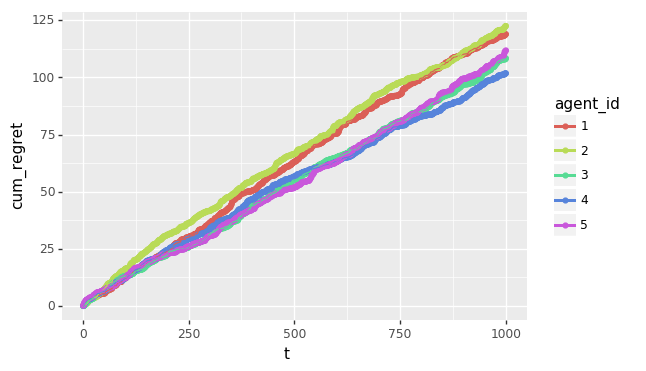

<ggplot: (8730334890773)>


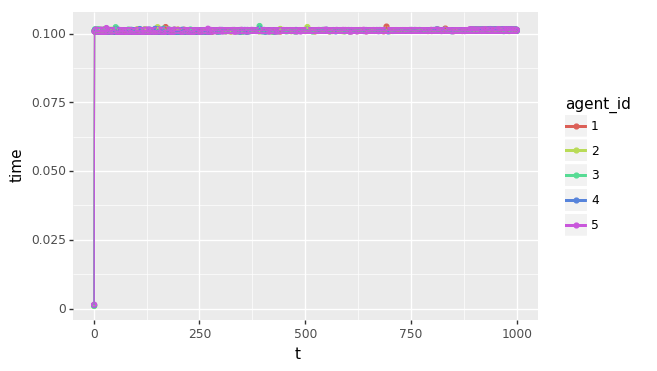

<ggplot: (8730334975921)>


In [8]:
hypers = list_prod([[0.2/2**n for n in range(5)], [32]])
results_list_sgld, df_list_sgld, cum_regrets_list_sgld, avg_regrets_sgld = hyperparameter_sweeps(make_sgld_agent, hypers, dim, var, 1000, 4, verbosity=verbosity)

In [9]:
print(cum_regrets_list_sgld)
print(avg_regrets_sgld)

[[119.97184442812822, 99.59197701869246, 125.9631732370845, 124.25066604288097, 114.58232622182531], [144.96406417793702, 121.43743700160316, 133.1131481187165, 130.62081852864657, 120.80769225968828], [237.2002860472674, 260.9893765279421, 247.46484996560102, 259.26979605650774, 254.56730785733805], [118.8441042519022, 122.43563696990371, 108.31050564966336, 101.7342441432334, 111.77039048268985]]
[155.24507473 151.11360688 153.71291924 153.96888119 150.43192921]


In [ ]:
hypers = [[0.2/2**n] for n in range(5)]
results_list_lgv, df_list_lgv, cum_regrets_list_lgv, avg_regrets_lgv = hyperparameter_sweeps(make_langevin_agent, hypers, dim, var, 1000, 4, verbosity=verbosity)

In [ ]:
print(cum_regrets_list_lgv)
print(avg_regrets_lgv)

In [ ]:
make_best_sgld_agent = lambda: SGLDTS(num_articles, dim+1, [0]*(dim+1), cov=None, 
                                        step_size=lambda t: hypers[0]/(1 + t * np.sqrt(dim*var)/dim),
                                        batch_size = lambda t: hypers[1],
                                        time=time_limit,
                                        n_steps=9999,
                                        init_pt=None, verbosity=verbosity)
make_best_sagald_agent = lambda: SAGATS(num_articles, dim+1, [0]*(dim+1), cov=None, 
                                          step_size=lambda t: 0.05/(1 + t * np.sqrt(dim*var)/dim),
                                          batch_size = lambda t: hypers[1],
                                          time=time_limit,
                                          n_steps=9999,
                                          init_pt=None, verbosity=verbosity)

make_best_langevin_agent = lambda: BasicLangevinTS(num_articles, dim+1, [0]*(dim+1), cov=None, 
                                              step_size=lambda t: hypers[0]/(1 + t * np.sqrt(dim*var)/dim), n_steps=9999,
                                              time = time_limit,
                                              init_pt=None, verbosity=verbosity)

In [ ]:
make_agents = [make_laplace_agent,
               make_pgts_agent,
               make_best_langevin_agent,
               make_mala_agent,
               make_best_sgld_agent,
               make_best_sagald_agent,
               make_mala_agent_untimed]
simple_compares(make_agents, num_articles, dim, var, n_steps, range(100,105), verbosity=verbosity):